# Tesco Large

In [131]:
#import necessary packages
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt 
%matplotlib inline
import datetime as dt
import statsmodels.api as sm 
import seaborn as sns
from scipy import stats
from sklearn.metrics import mean_squared_error
from math import sqrt

In [3]:
from IPython.core.interactiveshell import InteractiveShell
InteractiveShell.ast_node_interactivity = "all"

import plotly.graph_objs as go
import plotly.offline as pyo
import plotly.express as px

/anaconda3/lib/python3.7/site-packages/dask/config.py:168: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.

/anaconda3/lib/python3.7/site-packages/distributed/config.py:20: YAMLLoadWarning:

calling yaml.load() without Loader=... is deprecated, as the default Loader is unsafe. Please read https://msg.pyyaml.org/load for full details.



In [4]:
#import dataset - pladis products
mcv_dig_250g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large MCVTS DGSTVS 250G SNGL.xlsx")
mcv_dig_400g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large MCVTS DGSTVS 400G SNGL.xlsx")
mcv_dig_400g_twin=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large MCVTS DGSTVS 400G 2PACK.xlsx")
mcv_rt_300g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large RCH T MCVTS RCH T PLN 300 GM SNGL.xlsx")
mcv_rt_300g_twin=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large RCH T MCVTS RCH T PLN 300 GM 2 PCK.xlsx")

#import dataset - competitors products
tes_dig_400g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large (own label) TSC DGSTVS PLN 400 GM SNGL.xlsx")
tes_molly_400g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large (own label) 'TSC-MS-MLL'S-DGSTV-BSCTS PLN 400 GM SNGL.xlsx")
tes_rt_250g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large (own label) RCH T TSC RCH T FNGRS PLN 250 GM SNGL.xlsx")
tes_rt_300g=pd.read_excel("Final Pladis Dataset/Tesco Large/Tesco Large (own label) RCH T TSC RCH T PLN 300 GM SNGL.xlsx")



## Exploration of the dataset 

In [5]:
pd.plotting.register_matplotlib_converters()

In [6]:
#need original dataset
def basic_info(df):
    # look at data
    display(df.head())

    # look a shape of data
    display(df.shape)

    # look at data types. Ideally look at all rows. 
    display(df.dtypes)
   
    # display descriptive statistics
    display(df.describe(percentiles=[0.25,0.5,0.75,0.95,0.99]))
    
    print('Dataset has: ' + str(len(df.index)) + 'rows')
    
    print('Missing values:') 
    print(df.isnull().sum())
    
    print('Screen out distribution>100:')
    print(df[df.Distribution>100].count(axis=0))
    
    print('Screen out negative data: ')
    print(df[df.iloc[:,1:8]<0].count(axis=0))
    

In [7]:
#put corresponding dataset file into lists
mcv_list=[mcv_dig_250g,mcv_dig_400g,mcv_dig_400g_twin,mcv_rt_300g,mcv_rt_300g_twin]
tes_list=[tes_dig_400g,tes_molly_400g,tes_rt_250g,tes_rt_300g]
tes_large=[mcv_dig_250g,mcv_dig_400g,mcv_dig_400g_twin,mcv_rt_300g,mcv_rt_300g_twin,
           tes_dig_400g,tes_molly_400g,tes_rt_250g,tes_rt_300g]

In [8]:
#transform date format and extract time related variables
tes_large1=[]

for df in tes_large:
    df=df[:275]
    date_time = df['SDESC'].str[3:]
    date_time=pd.to_datetime(date_time, format='%d.%m.%y')
    df['SDESC']=date_time
    df=df.dropna()
    df.rename(columns={'SDESC':'Date'}, inplace=True)
    

    df['year'] = pd.DatetimeIndex(df['Date']).year
    df['quarter'] = pd.DatetimeIndex(df['Date']).quarter
    df['month'] = pd.DatetimeIndex(df['Date']).month
    df['week'] = pd.DatetimeIndex(df['Date']).week


    tes_large1.append(df)
    continue


#assign list name
mcv_dig_250g_origin=tes_large1[0]
mcv_dig_400g_origin=tes_large1[1]
mcv_dig_400g_twin_origin=tes_large1[2]
mcv_rt_300g_origin=tes_large1[3]
mcv_rt_300g_twin_origin=tes_large1[4]
tes_dig_400g_origin=tes_large1[5]
tes_molly_400g_origin=tes_large1[6]
tes_rt_250g_origin=tes_large1[7]
tes_rt_300g_origin=tes_large1[8]

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [9]:
#plot each variable in the dataframe, need original dataset 
def plot_data(dt):

# specify columns to plot
    values = dt.values
#   groups = [1, 2, 3, 4, 5, 6]
    
    # plot each column
    plt.figure()
    plt.figure(figsize=(23, 15))

    # for group in groups:
    plt.subplot(6, 1, 1)
    dt.groupby('Date')['Volume'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('Volume',y=0.5, loc='right')
    plt.subplot(6, 1, 2)
    dt.groupby('Date')['Value'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('Value', y=0.5, loc='right')
    plt.subplot(6, 1, 3)
    dt.groupby('Date')['Distribution'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('Distribution', y=0.5, loc='right')
    plt.subplot(6, 1, 4)
    dt.groupby('Date')['Promotional Distribution'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('Promotional Distribution', y=0.5, loc='right')
    plt.subplot(6, 1, 5)
    dt.groupby('Date')['£/unit'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('£/unit', y=0.5, loc='right')
    plt.subplot(6, 1, 6)
    dt.groupby('Date')['£/kg'].sum().plot(kind='line', figsize=(23,15), color="royalblue", linewidth=2)
    plt.title('£/kg', y=0.5, loc='right')

    plt.show()


### Preparation for Time Series Models

Apply time series models first: standard time series dataset (date, sales units...). Time series models only require date and sales data, and the models are able to capture the trend and seasonality on their own. It's convenient and straightforward to see the results.

We need to check the stationarity of the dataset first. By stationarity, it means:
- constant mean and variance

Tests to check stationarity:
1. Rolling Statistics
    -Plot the moving average or moving variance and see if it varies with time. More of a visual technique.
2. ADCF Test
    -Null hypothesis is that the TS is non-stationary. Compare t-stats and p-value to see if can reject the null or 
    not. 

In [10]:
#plot original dataset aucorrelation

#plot acf, pacf, original graph
from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
from statsmodels.tsa.stattools import adfuller

def tsplot(y, title, lags=100, figsize=(10,6)):
    '''Examine the patterns of ACF and PACF, along with the time series plot and histogram.
    '''
    fig=plt.figure(figsize=figsize)
    layout=(2,2)
    ts_ax=plt.subplot2grid(layout, (0,0))
    hist_ax=plt.subplot2grid(layout, (0,1))
    acf_ax=plt.subplot2grid(layout, (1,0))
    pacf_ax=plt.subplot2grid(layout, (1,1))
    
    y.plot(ax=ts_ax)
    ts_ax.set_title(title, fontsize=14, fontweight='bold')
    y.plot(ax=hist_ax, kind='hist', bins=25)
    hist_ax.set_title('Histogram')
    plot_acf(y, lags=lags, ax=acf_ax)
    plot_pacf(y, lags=lags, ax=pacf_ax)
    [ax.set_xlim(0) for ax in [acf_ax, pacf_ax]]
    sns.despine()
    plt.tight_layout()
    return ts_ax, acf_ax, pacf_ax

In [11]:
# stationarity check, only need values
from statsmodels.tsa.stattools import adfuller

def plot(data):
    
    dftest=adfuller(data['Volume'], autolag='AIC')
    dfoutput=pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key]=value
    print(dfoutput)
    
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')
    sales.head()
    
    #rolling mean and std in a yearly base
    rolmean=sales.rolling(window=52).mean()
    rolstd=sales.rolling(window=52).std()

    #static graph
    origin=plt.plot(sales, color='blue', label='Original')
    mean=plt.plot(rolmean, color='red', label='Rolling Mean')
    std=plt.plot(rolstd, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)

autocorrelation captures the series itself, and how it correlated with its own path. (yt and yt-1)
a correlation of a variable itself at different time is known as autocorrelation.

Large number of time series models require stationarity of the dataset because if the dataset is not stationary, it will hard for the model to capture the trend, which will affect the accuracy of the future predictions. 

In [12]:
#make the dataset stationary, only need values
def plot_transform(data):
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')
    
    series_transformed=sales.copy()
    series_transformed['Volume_transformed']=sales.diff(4)
    
    #rolling mean and std in a yearly base
    rolmean_diff=series_transformed['Volume_transformed'].rolling(window=52).mean()
    rolstd_diff=series_transformed['Volume_transformed'].rolling(window=52).std()

    #static graph
    origin=plt.plot(series_transformed['Volume_transformed'], color='blue', label='Original')
    mean=plt.plot(rolmean_diff, color='red', label='Rolling Mean')
    std=plt.plot(rolstd_diff, color='black', label='Rolling Std')
    plt.legend(loc='best')
    plt.title('Rolling Mean & Standard Deviation')
    plt.show(block=False)
    
    print('Results of Dickey-Fuller Test:')
    dftest=adfuller(series_transformed['Volume_transformed'].dropna(), autolag='AIC')
    dfoutput=pd.Series(dftest[0:4], index=['Test Statistic','p-value','#Lags Used','Number of Observations Used'])
    for key,value in dftest[4].items():
        dfoutput['Critical Value (%s)'%key]=value
    print(dfoutput)

## Overall Baseline Model

The algorithm uses the value at the previous time step (t-4) to predict the expected outcome at the next time step (t+1).

In [13]:
# baseline model. only need volume values
from pandas import DataFrame
from pandas import concat
from matplotlib import pyplot
from sklearn.metrics import mean_squared_error
 
def baseline_model(df):    
    # Create lagged dataset
    sales = df[['Date','Volume']]
    sales=sales.set_index('Date')
    values = DataFrame(sales.values)
    dataframe = concat([values.shift(4), values], axis=1)
    dataframe.columns = ['t-4', 't+1']
    print(dataframe.head(5))

    # split into train and test sets
    X = dataframe.values
    train_size = int(len(X) * 0.8)
    train, test = X[1:train_size], X[train_size:]
    train_X, train_y = train[:,0], train[:,1]
    test_X, test_y = test[:,0], test[:,1]

    # persistence model
    def model_persistence(x):
        return x

    # walk-forward validation
    predictions = list()
    for x in test_X:
        yhat = model_persistence(x)
        predictions.append(yhat)
    test_mse_score = mean_squared_error(test_y, predictions)
    test_rmse_score = sqrt(mean_squared_error(test_y, predictions))

    print('Test MSE: %.3f' % test_mse_score)
    print('Test RMSE: %.3f' % test_rmse_score)

    # plot predictions and expected results
    plt.plot(train_y)
    plt.plot([None for i in train_y] + [x for x in test_y])
    plt.plot([None for i in train_y] + [x for x in predictions])
    plt.show()

## Simple Exponential Smoothing

Simple exponential smoothing: forecast future values using a weighted average of all previous values in the series.
Exponential smoothing is an intuitive forecasting method that weights the observed time series unequally. Recent observations are weighted more heavily than remote observations.

This model does not require stationarity of a dataset, so we apply the model with original data first to see the accuracy. 

In [14]:
#extract volume column, only need volume values
from statsmodels.tsa.api import SimpleExpSmoothing
from pandas import DataFrame

def ses_model(data):
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')
    sales_origin=sales.copy()
    sales_origin=sales_origin.shift(4)
    sales_origin=sales_origin.dropna()
    train_size = int(len(sales_origin) * 0.8)
    sales_train_origin=sales_origin[:train_size]
    sales_test_origin=sales_origin[train_size:]

    print('Observations: %d' % (len(sales_origin)))
    print('Training Observations: %d' % (len(sales_train_origin)))
    print('Testing Observations: %d' % (len(sales_test_origin)))

    # then plotting it using different colors
    plt.plot(sales_train_origin)
    plt.plot(sales_test_origin)
    plt.show()
    
    for i in range(1,10,1):
        ses_pred_ori = sales_test_origin.copy()
        ses_ori_fit = SimpleExpSmoothing(np.asarray(sales_train_origin['Volume'])).fit(smoothing_level=i*0.1, optimized=False)
        ses_pred_ori['SES_Ori'] = ses_ori_fit.forecast(len(sales_test_origin))

        rmse_ses_ori=sqrt(mean_squared_error(sales_test_origin.Volume, ses_pred_ori.SES_Ori))
        print("RMSE for Simple Exponential Smoothing α= " + str(i*0.1) + " is: " + str(round(rmse_ses_ori,2)))

    #lowest RMSE with graph
    ses_pred_ori = sales_test_origin.copy()
    ses_ori_fit = SimpleExpSmoothing(np.asarray(sales_train_origin['Volume'])).fit(smoothing_level=0.1, optimized=False)
    ses_pred_ori['SES_Ori'] = ses_ori_fit.forecast(len(sales_test_origin))
    plt.figure(figsize=(8,4))
    plt.plot(sales_train_origin['Volume'], label='Train')
    plt.plot(sales_test_origin['Volume'], label='Test')
    plt.plot(ses_pred_ori['SES_Ori'], label='Simple_ES')
    plt.legend(loc='best')
    plt.show()


## Holt's Linear Model 

Holt's linear model can only capture the trend, not seasonality.

In [15]:
# apply the model, only need volume values
from statsmodels.tsa.holtwinters import ExponentialSmoothing
from statsmodels.tsa.api import Holt

def holt_linear_model(data):
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')
    sales_origin=sales.copy()
    sales_origin=sales_origin.shift(4)
    sales_origin=sales_origin.dropna()
    train_size = int(len(sales_origin) * 0.8)
    sales_train_origin=sales_origin[:train_size]
    sales_test_origin=sales_origin[train_size:]

    print('Observations: %d' % (len(sales_origin)))
    print('Training Observations: %d' % (len(sales_train_origin)))
    print('Testing Observations: %d' % (len(sales_test_origin)))

    aList=[]
    bList=[]
    cList=[]

    for i in range(1,10,1):
        for j in range(1,10,1): 
            holt_linear_pred = sales_test_origin.copy()

            sales_holt_linear_fit = Holt(np.asarray(sales_train_origin['Volume'])).fit(smoothing_level = i*0.1,smoothing_slope = j*0.1, optimized=False)
            holt_linear_pred['Holt_linear'] = sales_holt_linear_fit.forecast(len(sales_test_origin))

            rmse_holt_linear=sqrt(mean_squared_error(sales_test_origin.Volume, holt_linear_pred.Holt_linear))
            aList.append(round(rmse_holt_linear,2))
            bList.append(str(i*0.1))
            cList.append(str(j*0.1))

    min_rmse=aList.index(min(aList))

    print("Min RMSE for Holt Linear Forecasting α= " + str(bList[min_rmse]) + " and β= " + str(cList[min_rmse]) + " is: " + str(aList[min_rmse]))

    holt_linear_pred = sales_test_origin.copy()
    sales_holt_linear_fit = Holt(np.asarray(sales_train_origin['Volume'])).fit(smoothing_level = 0.1,smoothing_slope = 0.1, optimized=False)
    holt_linear_pred['Holt_linear'] = sales_holt_linear_fit.forecast(len(sales_test_origin))

    plt.figure(figsize=(8,4))
    plt.plot(sales_train_origin['Volume'], label='Train')
    plt.plot(sales_test_origin['Volume'], label='Test')
    plt.plot(holt_linear_pred['Holt_linear'], label='Holt_linear')
    plt.legend(loc='best')
    plt.show()
    

--------------

## Holt Winter's Exponential Smoothing Model


This model can capture both trend and seasonlity.

In [16]:
#only need volume values
def holt_winter_model(data):
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')

    sales_origin=sales.copy()
    sales_origin=sales_origin.shift(4)
    sales_origin=sales_origin.dropna()
    train_size = int(len(sales_origin) * 0.8)
    sales_train_origin=sales_origin[:train_size]
    sales_test_origin=sales_origin[train_size:]

    fit1 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='add').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit2 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='mul').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit3 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='mul', seasonal='mul').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit4 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='add', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit5 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='mul', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit6 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='mul', seasonal='mul', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)


    ax = sales_train_origin.plot(figsize=(10,6), marker='o', color='black', title="Forecasts from Holt-Winters' multiplicative method" )
    ax.set_ylabel("Volume Sales")
    ax.set_xlabel("Date")
    
    fit1.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-seasonal)').plot(ax=ax, style='--', marker='o', color='red', legend=True)
    fit2.forecast(len(sales_test_origin)).rename('Holt-Winters (add-mul-seasonal)').plot(ax=ax, style='--', marker='o', color='green', legend=True)
    fit3.forecast(len(sales_test_origin)).rename('Holt-Winters (mul-mul-seasonal)').plot(ax=ax, style='--', marker='o', color='pink', legend=True)
    fit4.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='yellow', legend=True)
    fit5.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='purple', legend=True)
    fit6.forecast(len(sales_test_origin)).rename('Holt-Winters (mul-mul-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='blue', legend=True)

    plt.show()

    rmse_winter1=sqrt(mean_squared_error(sales_test_origin, fit1.forecast(len(sales_test_origin))))
    rmse_winter2=sqrt(mean_squared_error(sales_test_origin, fit2.forecast(len(sales_test_origin))))
    rmse_winter3=sqrt(mean_squared_error(sales_test_origin, fit3.forecast(len(sales_test_origin))))
    rmse_winter4=sqrt(mean_squared_error(sales_test_origin, fit4.forecast(len(sales_test_origin))))
    rmse_winter5=sqrt(mean_squared_error(sales_test_origin, fit5.forecast(len(sales_test_origin))))
    rmse_winter6=sqrt(mean_squared_error(sales_test_origin, fit6.forecast(len(sales_test_origin))))
    print("RMSE for Holt-winter are:")
    print(rmse_winter1)
    print(rmse_winter2)
    print(rmse_winter3)
    print(rmse_winter4)
    print(rmse_winter5)
    print(rmse_winter6)


## Prophet 

In [17]:
!pip install fbprophet

You should consider upgrading via the '/anaconda3/bin/python -m pip install --upgrade pip' command.


In [18]:
from fbprophet import Prophet

Facebook developed an open sourcing Prophet. Facebook provides prophet model not only can take care of some outliers/unusual values, but also it can take care of missing values. It is almost able to fully automatically forecast the trend of the future time series. 

Prophet can deal with missing observations or large outliers, and can roll with the punches in relation to product launches or marketing pushes.

Built in Stan, which is really fast.

Prophet needs a very specific kind of dataframe for it to work on. What we need is:

Date column as ds & Value column as y.

In [19]:
dir(Prophet)

['__class__',
 '__delattr__',
 '__dict__',
 '__dir__',
 '__doc__',
 '__eq__',
 '__format__',
 '__ge__',
 '__getattribute__',
 '__gt__',
 '__hash__',
 '__init__',
 '__init_subclass__',
 '__le__',
 '__lt__',
 '__module__',
 '__ne__',
 '__new__',
 '__reduce__',
 '__reduce_ex__',
 '__repr__',
 '__setattr__',
 '__sizeof__',
 '__str__',
 '__subclasshook__',
 '__weakref__',
 '_load_stan_backend',
 'add_country_holidays',
 'add_group_component',
 'add_regressor',
 'add_seasonality',
 'construct_holiday_dataframe',
 'fit',
 'fourier_series',
 'initialize_scales',
 'linear_growth_init',
 'logistic_growth_init',
 'make_all_seasonality_features',
 'make_future_dataframe',
 'make_holiday_features',
 'make_seasonality_features',
 'parse_seasonality_args',
 'percentile',
 'piecewise_linear',
 'piecewise_logistic',
 'plot',
 'plot_components',
 'predict',
 'predict_seasonal_components',
 'predict_trend',
 'predict_uncertainty',
 'predictive_samples',
 'regressor_column_matrix',
 'sample_model',
 'samp

In [20]:
# apply basic prophet model, only need volume values
def prophet_model(data):
    prophet_data=data[['Date','Volume']]

    # prophet_data['Date']=prophet_data.index
    prophet_data.rename(columns={'Date': 'ds','Volume': 'y'}, inplace=True)

    #define train and test size
#     prophet_data=prophet_data['Volume'].shift(4)
#     prophet_data=prophet_data.dropna()
#     print(prophet_data)
    train_size = int(len(prophet_data) * 0.8)
    prophet_train=prophet_data[:train_size]
    prediction_size=int(len(prophet_data[train_size:]))
    
    # fit model - baseline model (dataset is not stationary) 用原本的数据预测的 没有预测未来时间段的
    model=Prophet()
    model.fit(prophet_train)

    # make prediction
    future=model.make_future_dataframe(periods=prediction_size, freq='W')
    forecast=model.predict(future)
    
    #plot result
    pd.plotting.register_matplotlib_converters()
    mod=model.plot(forecast)
    forecast_graph=model.plot_components(forecast)
    
    # checking the results
    fig, ax = plt.subplots(figsize=(8,4))
    plt.plot(forecast['yhat'])
    #plt.plot(cmp_df['yhat_lower'])
    #plt.plot(cmp_df['yhat_upper'])
    plt.plot(prophet_data['y'])
    plt.xlabel('Time')
    plt.ylabel('Weekly Sales Volume')
    ax.plot(forecast['yhat'], label='yhat', color='darkseagreen')
    #ax.plot(cmp_df['yhat_lower'], label='yhat_lower')
    #ax.plot(cmp_df['yhat_upper'], label='yhat_upper')
    ax.plot(prophet_data['y'], label='y', color='dodgerblue')
    ax.legend()
    plt.show()
    
    rmse_prophet=sqrt(mean_squared_error(prophet_data['y'], forecast['yhat']))
    print("RMSE for prophet model is: " + str(rmse_prophet))

### Prophet with Seasonal Related Parameters

we add other parameters because we want to capture the yearly peak pattern. We notice the seasonal pattern usually happened at the end of Dec. and April; thus, we will only focus on time around the two main holidays - Xmas and Easter.

In [65]:
# defined dataframe above, only need volume values 
def prophet_all_holidays(data):
    prophet_data=data[['Date','Volume']]
    prophet_data.rename(columns={'Date': 'ds','Volume': 'y'}, inplace=True)
    prophet_df=prophet_data['y']
    prophet_df=prophet_df.to_frame()
    prophet_df['ds']=prophet_data['ds']
    prophet_df.head(10)
    
    train_size = int(len(prophet_df) * 0.8)
    prophet_train=prophet_df[:train_size]
    prediction_size=int(len(prophet_df[train_size:]))
    
    model_season = Prophet(growth='linear', yearly_seasonality=True, holidays_prior_scale=10)
    model_season.add_seasonality(name='monthly', period=27, fourier_order=5)
    model_season.add_country_holidays(country_name='UK')

    # fit model
    model_season.fit(prophet_train)
    # holiday_prior_scale; seasonality_prior_scale, holidays

    # make prediction
    future_season=model_season.make_future_dataframe(periods=prediction_size, freq='W')
    forecast_season=model_season.predict(future_season)
    
    print(model_season.train_holiday_names)
    
    prophet_result=model_season.plot(forecast_season)
    
    fig=model_season.plot_components(forecast_season)
    
    # checking the results
    fig, ax = plt.subplots(figsize=(8,4))

    plt.plot(forecast_season['yhat'])
    #plt.plot(cmp_df['yhat_lower'])
    #plt.plot(cmp_df['yhat_upper'])
    plt.plot(prophet_df['y'])

    plt.xlabel('Time')
    plt.ylabel('Average Weekly Sales Volume')
    ax.plot(forecast_season['yhat'], label='yhat',color='darkseagreen')
    #ax.plot(cmp_df['yhat_lower'], label='yhat_lower')
    #ax.plot(cmp_df['yhat_upper'], label='yhat_upper')
    ax.plot(prophet_df['y'], label='y',color='dodgerblue')
    ax.legend()
    plt.show()
    
    forecast_season_df=forecast_season[['ds','yhat']]
    forecast_season_df.head()
    
    forecast_season_df['y']=prophet_df['y']
    forecast_season_df['sales_pred']=forecast_season_df['yhat']
    forecast_season_df['sales_origin']=forecast_season_df['y']
    print(forecast_season_df.head())
    
    rmse_prophet_log=sqrt(mean_squared_error(forecast_season_df['sales_origin'], forecast_season_df['sales_pred']))
    print("RMSE for prophet with all holidays is: "+ str(rmse_prophet_log))
    

/anaconda3/lib/python3.7/site-packages/pandas/core/frame.py:4025: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17                                Boxing Day (Ob

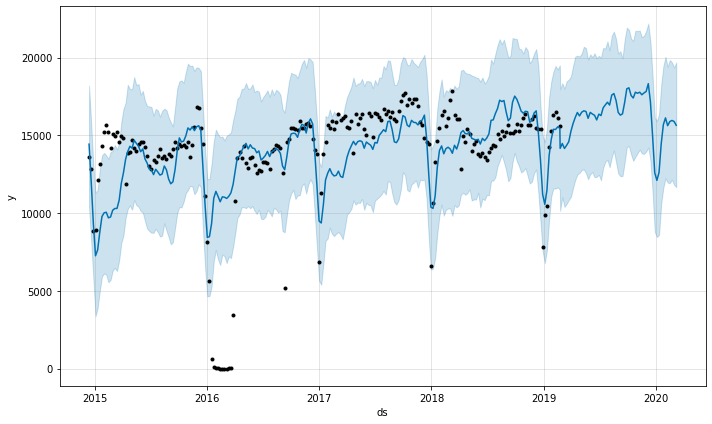

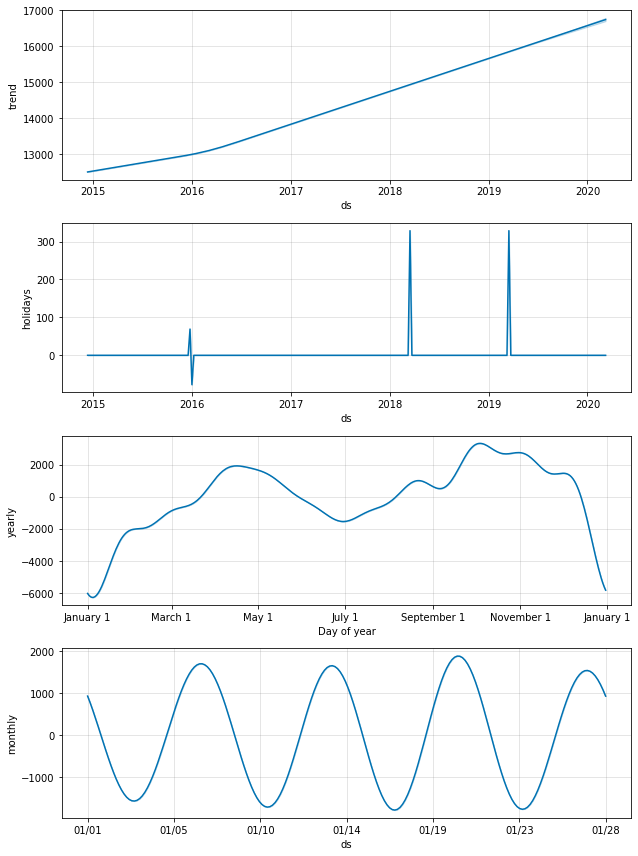

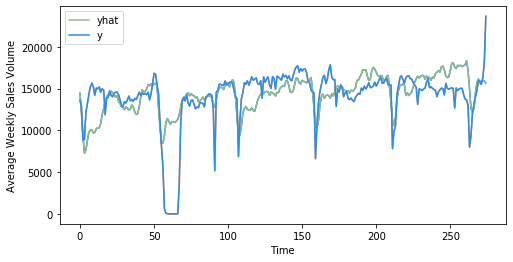

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy

/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



          ds          yhat        y    sales_pred  sales_origin
0 2014-12-13  14436.514111  13594.5  14436.514111       13594.5
1 2014-12-20  12016.211587  12849.5  12016.211587       12849.5
2 2014-12-27   9318.557895   8820.3   9318.557895        8820.3
3 2015-01-03   7254.132012   8919.3   7254.132012        8919.3
4 2015-01-10   7636.507474  12154.8   7636.507474       12154.8
RMSE for prophet with all holidays is: 2945.804805170052


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



In [66]:
prophet_all_holidays(tes_rt_250g_origin)

### Transformation and Only focus on Christmas and Easter

In [88]:
easter=pd.DataFrame({
    'holiday': 'Easter',
    'ds': pd.to_datetime(['2014-04-20', '2015-04-05', '2016-03-27', '2017-04-16',
                         '2018-04-01', '2019-04-21']),
    'lower_window': -5,
    'upper_window': 5,
})

christmas=pd.DataFrame({
    'holiday': 'Christmas',
    'ds': pd.to_datetime(['2014-12-25','2015-12-25', '2016-12-25', '2017-12-25',
                         '2018-12-25', '2019-12-25']),
    'lower_window': -5,
    'upper_window': 5,
})

holidays=pd.concat((easter, christmas))

In [91]:
#only need volume values and holidays
def prophet_two_holiday(data):
    prophet_data=data[['Date','Volume']]
    prophet_data.rename(columns={'Date': 'ds','Volume': 'y'}, inplace=True)
    prophet_df=prophet_data['y']
    prophet_df=prophet_df.to_frame()
    prophet_df['ds']=prophet_data['ds']
    print(prophet_df.head(10))
    
    train_size = int(len(prophet_df) * 0.8)
    prophet_train=prophet_df[:train_size]
    prediction_size=int(len(prophet_df[train_size:]))
    
    model_holiday = Prophet(growth='linear', yearly_seasonality=True, holidays=holidays, holidays_prior_scale=10)

    # fit model
    model_holiday.fit(prophet_train)

    # make prediction
    future_holiday=model_holiday.make_future_dataframe(periods=prediction_size, freq='W')
    forecast_holiday=model_holiday.predict(future_holiday)
    print(forecast_holiday)

    
    # holidays effect display
    forecast_holiday[(forecast_holiday['Easter'] + forecast_holiday['Christmas']).abs() > 0][
            ['ds', 'Easter', 'Christmas']][-10:]

    prophet_holiday_result=model_holiday.plot(forecast_holiday)

    fig2=model_holiday.plot_components(forecast_holiday)

    # checking the results
    fig, ax = plt.subplots(figsize=(8,4))

    plt.plot(forecast_holiday['yhat'])

    plt.plot(prophet_df['y'])

    plt.xlabel('Time')
    plt.ylabel('Average Weekly Sales Volume')
    ax.plot(forecast_holiday['yhat'], label='yhat',color='darkseagreen')
    ax.plot(prophet_df['y'], label='y',color='dodgerblue')
    ax.legend()
    plt.show()
    

    forecast_holiday_df=forecast_holiday[['ds','yhat']]
    forecast_holiday_df.head()

    forecast_holiday_df['y']=prophet_df['y']
    forecast_holiday_df['sales_pred']=forecast_holiday_df['yhat']
    forecast_holiday_df['sales_origin']=forecast_holiday_df['y']
    print(forecast_holiday_df.head())

    
    rmse_prophet_holiday=sqrt(mean_squared_error(forecast_holiday_df['sales_origin'], forecast_holiday_df['sales_pred']))
    print("RMSE for prophet with only Christmas and Easter week is: "+ str(rmse_prophet_holiday))
    

### Tesco Large - McVitie's Digestives 250g

In [396]:
basic_info(mcv_dig_250g_origin)

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,26252,6563.0,23366.0,97,0,0.890066,3.560262,2014,4,12,50
1,2014-12-20,28719,7179.8,25560.4,97,0,0.890017,3.560043,2014,4,12,51
2,2014-12-27,26468,6617.0,23557.3,97,0,0.890029,3.560118,2014,4,12,52
3,2015-01-03,19371,4842.8,17240.9,97,0,0.890037,3.560110,2015,1,1,1
4,2015-01-10,19424,4856.0,17286.2,97,0,0.889940,3.559761,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,20520.490909,5130.149455,18329.931636,80.490909,0.0,0.893456,3.573803,2017.083636,2.469091,6.414545,26.043636
std,4210.161155,1052.540572,3749.070151,14.825841,0.0,0.016671,0.066685,1.534371,1.140635,3.547767,15.490223
min,8867.000000,2216.800000,7880.100000,58.000000,0.0,0.857718,3.430872,2014.000000,1.000000,1.000000,1.000000
25%,17533.500000,4383.400000,15739.200000,68.000000,0.0,0.889881,3.559501,2016.000000,1.000000,3.000000,12.000000
50%,20591.000000,5147.800000,18365.200000,75.000000,0.0,0.890022,3.560074,2017.000000,2.000000,6.000000,26.000000
75%,23810.000000,5952.550000,21191.250000,97.000000,0.0,0.890830,3.563291,2018.000000,3.500000,9.500000,39.500000
95%,26623.900000,6656.010000,23905.710000,99.000000,0.0,0.899990,3.599945,2019.000000,4.000000,12.000000,50.000000
99%,29826.920000,7456.730000,26560.368000,99.000000,0.0,0.999802,3.999195,2020.000000,4.000000,12.000000,52.000000
max,34927.000000,8731.800000,31083.300000,99.000000,0.0,1.000000,3.999962,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

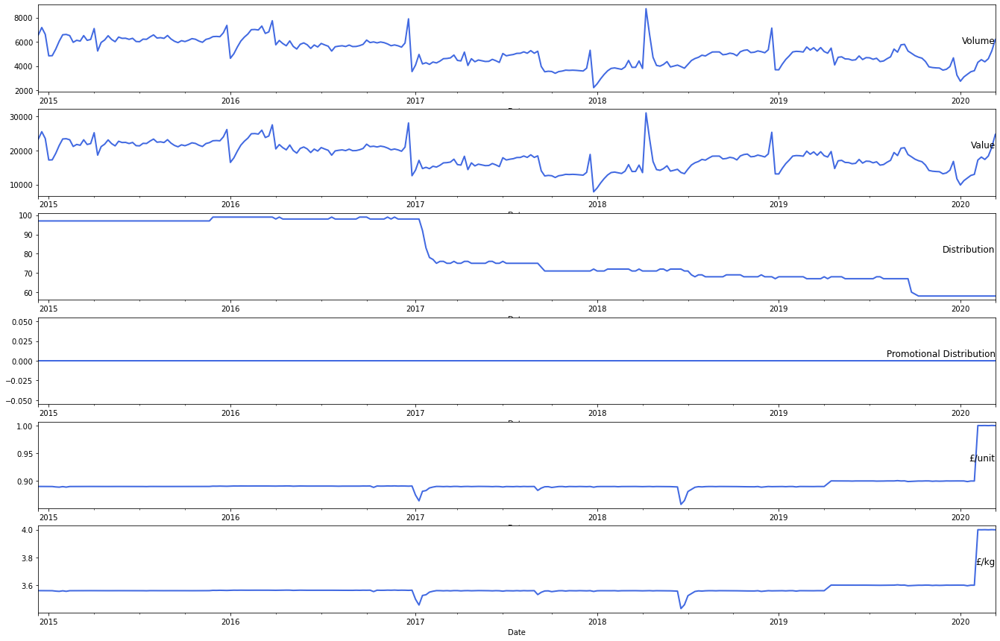

In [397]:
#plot each variable of the dataset
plot_data(mcv_dig_250g_origin)

(<matplotlib.axes._subplots.AxesSubplot at 0x7f535c160400>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f535bbd6a90>)

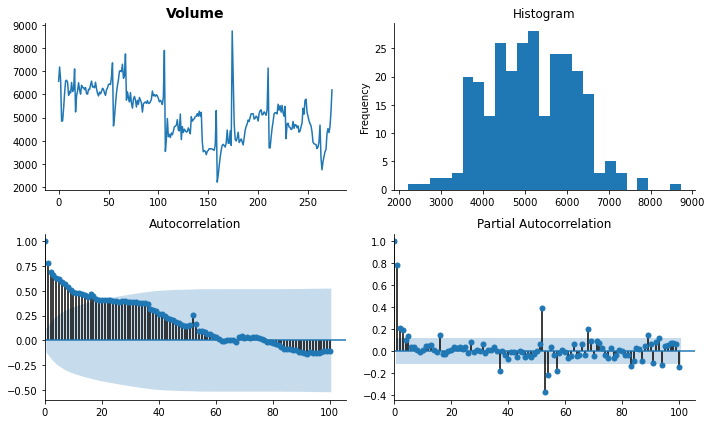

In [398]:
tsplot(mcv_dig_250g_origin['Volume'].dropna(), title=mcv_dig_250g_origin.columns[2], lags=100)


Test Statistic                  -2.635004
p-value                          0.085976
#Lags Used                       4.000000
Number of Observations Used    270.000000
Critical Value (1%)             -3.454804
Critical Value (5%)             -2.872305
Critical Value (10%)            -2.572506
dtype: float64


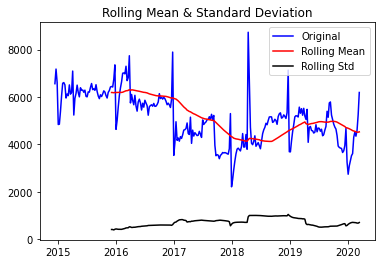

In [399]:
#check stationarity of the original dataset
plot(mcv_dig_250g_origin)

Autocorrelation captures the series itself, and how it correlated with its own path. (yt and yt-1)
a correlation of a variable itself at different time is known as autocorrelation. 

(<matplotlib.axes._subplots.AxesSubplot at 0x7f535ba76240>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f535b9a5898>)

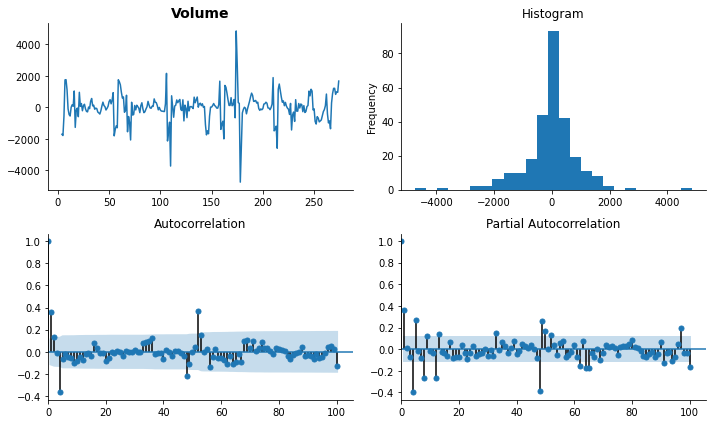

In [400]:
#plot stationary graph
series_transformed=mcv_dig_250g_origin.copy()
series_transformed['Volume_transformed']=mcv_dig_250g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_dig_250g_origin.columns[2], lags=100)


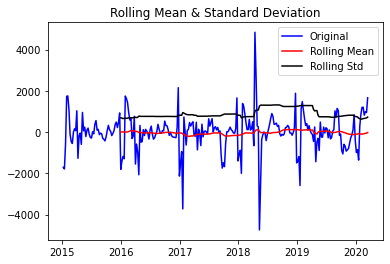

Results of Dickey-Fuller Test:
Test Statistic                  -5.536986
p-value                          0.000002
#Lags Used                      12.000000
Number of Observations Used    258.000000
Critical Value (1%)             -3.455953
Critical Value (5%)             -2.872809
Critical Value (10%)            -2.572775
dtype: float64


In [401]:
plot_transform(mcv_dig_250g_origin)

### Time Series Modeling Part

      t-4     t+1
0     NaN  6563.0
1     NaN  7179.8
2     NaN  6617.0
3     NaN  4842.8
4  6563.0  4856.0
Test MSE: 497173.396
Test RMSE: 705.105


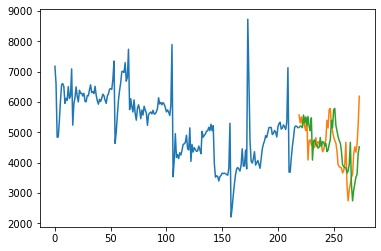

In [402]:
baseline_model(mcv_dig_250g_origin)

When we deal with a time series dataset, we need to check the baseline model before applying any other models. By baseline model, it means we use the value at the previous time step (t-4) to predict the expected outcome at time step at t. It provides a point of reference for all other model techniques.

### Simple Exponential Smoothing model

Observations: 271
Training Observations: 216
Testing Observations: 55


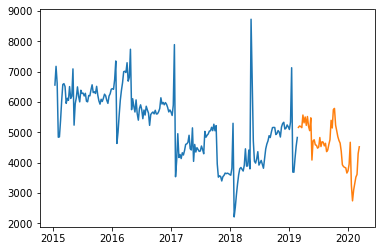

RMSE for Simple Exponential Smoothing α= 0.1 is: 742.44
RMSE for Simple Exponential Smoothing α= 0.2 is: 711.15
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 698.23
RMSE for Simple Exponential Smoothing α= 0.4 is: 696.87
RMSE for Simple Exponential Smoothing α= 0.5 is: 697.17
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 699.79
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 706.65
RMSE for Simple Exponential Smoothing α= 0.8 is: 717.0
RMSE for Simple Exponential Smoothing α= 0.9 is: 728.38


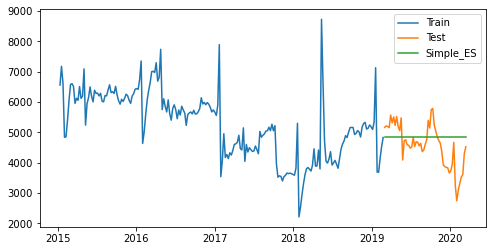

In [403]:
ses_model(mcv_dig_250g_origin)

Simple exponential smoothing: forecast future values using a weighted average of all previous values in the series.
Exponential smoothing is an intuitive forecasting method that weights the observed time series unequally. Recent observations are weighted more heavily than remote observations.

This model does not require stationarity of a dataset, so we apply the model with original data first to see the accuracy. 

### Holt's Linear Model

Holt's linear model can only capture the trend, not seasonality.

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.8 and β= 0.1 is: 609.18


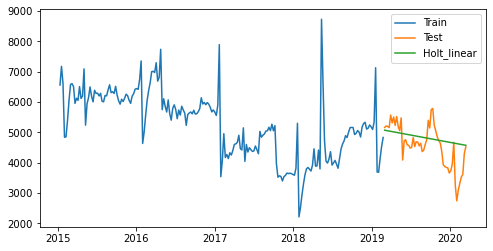

In [404]:
holt_linear_model(mcv_dig_250g_origin)

### Holt-Winter Model

This model can capture both trend and seasonlity.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

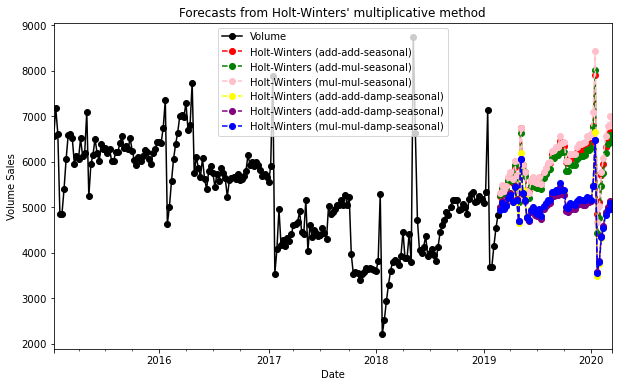

RMSE for Holt-winter are:
1643.2750190257825
1543.9275250555586
1756.3675088141833
793.1019206323773
772.2878932972977
793.6737178945676


In [405]:
holt_winter_model(mcv_dig_250g_origin)

Tried all three models with original value/unstationary dataset (without transformation). We can see that the RMSE is actually getting smaller. 

From Simple exponential smoothing: 1012
to Holt's linear: 898
to Holt Winter's: 738.

This can prove that holt winter's is the one that can capture more information than they other two models.

We also apply stationary data (after taking log and differencing) on holt's linear model. We get a small RMSE. Even though the exponential smoothing series models do not require stationarity, but non-stationary dataset results can be misleading, and it is essential to have stationary dataset for the model to capture the information.

### Prophet Model

Facebook developed an open sourcing Prophet. Facebook provides prophet model not only can take care of some outliers/unusual values, but also it can take care of missing values. It is almost able to fully automatically forecast the trend of the future time series. 

Prophet can deal with missing observations or large outliers, and can roll with the punches in relation to product launches or marketing pushes.

Built in Stan, which is really fast.

Prophet needs a very specific kind of dataframe for it to work on. What we need is:

Date column as ds & Value column as y.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


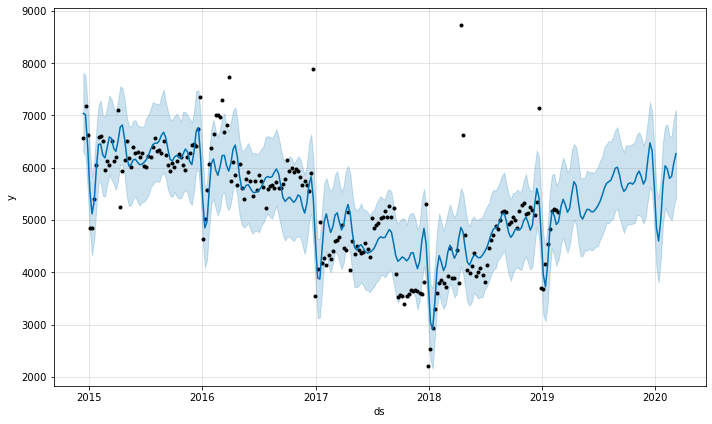

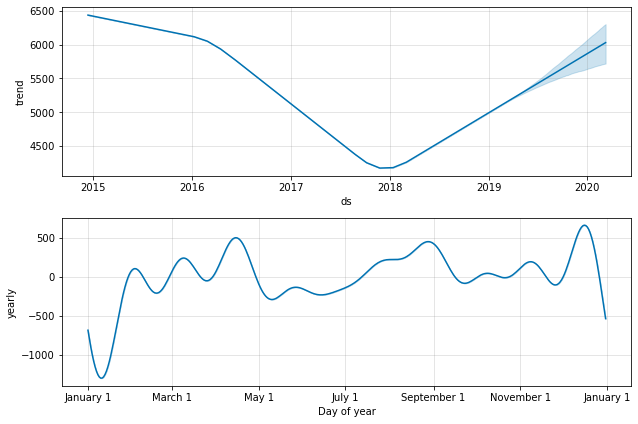

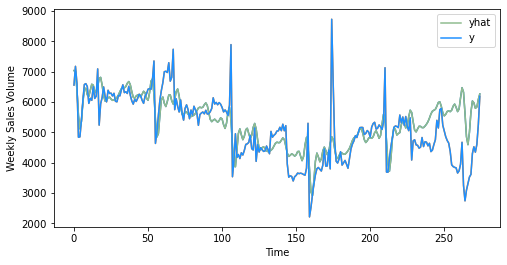

RMSE for prophet model is: 774.4738620997846


In [406]:
prophet_model(mcv_dig_250g_origin)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17                                Boxing Day (Ob

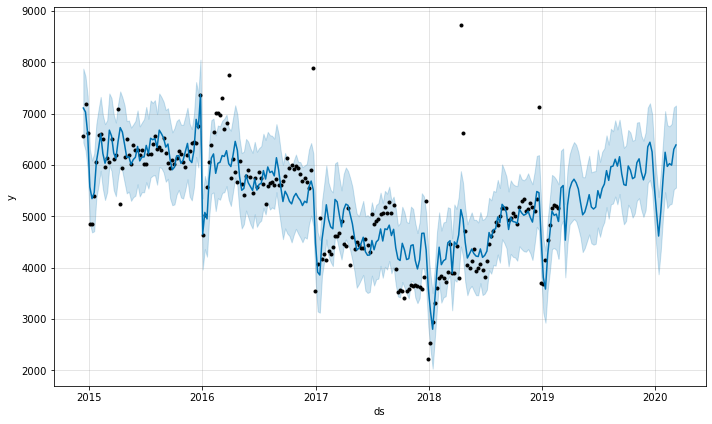

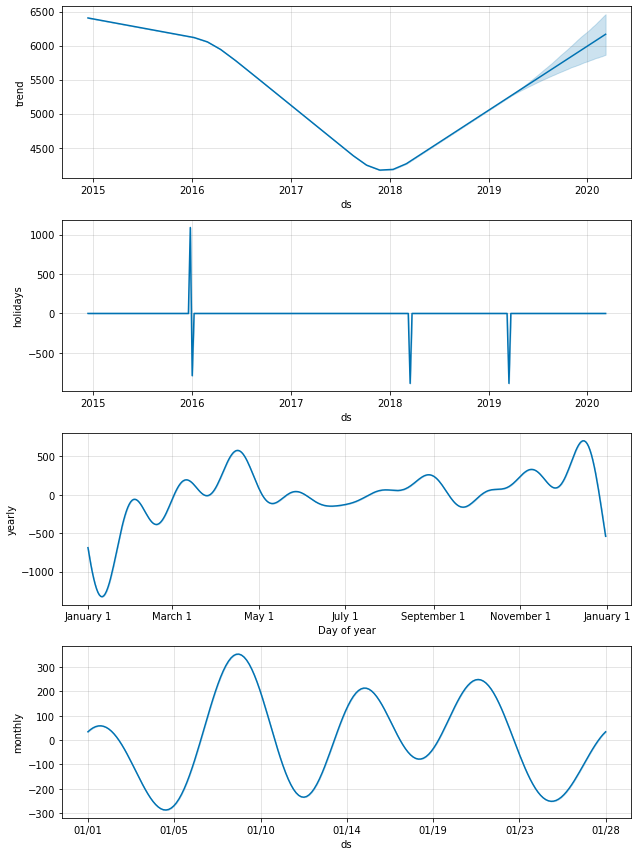

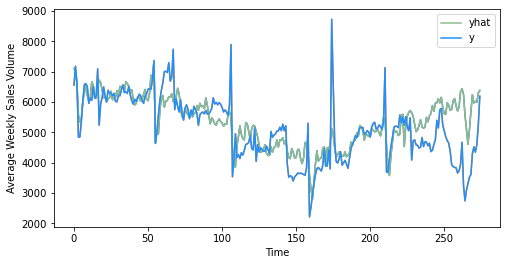

RMSE for prophet with all holidays is: 785.3572595830085


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [407]:
prophet_all_holidays(mcv_dig_250g_origin)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


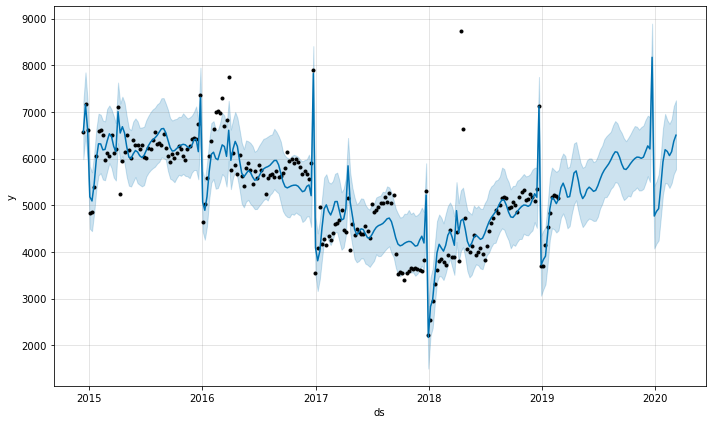

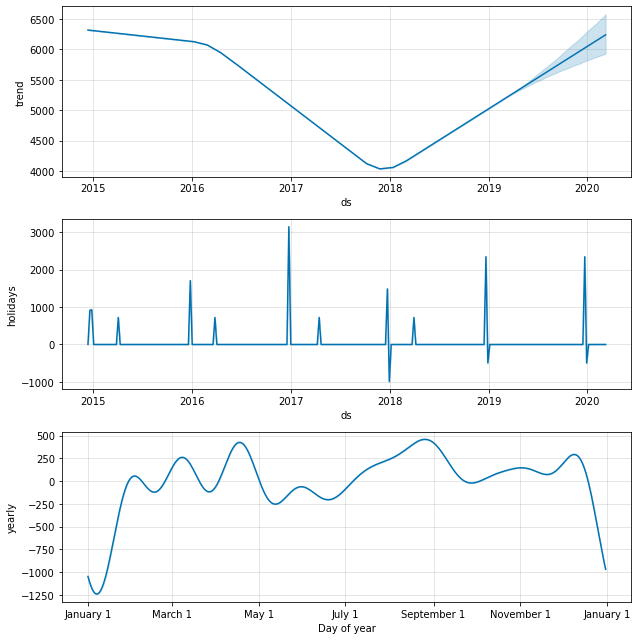

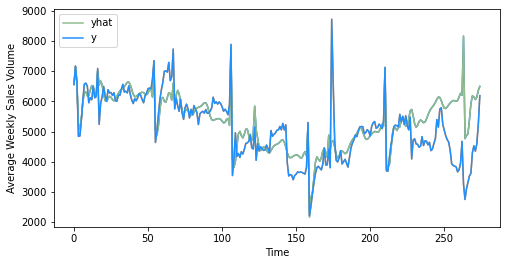

RMSE for prophet with only Christmas and Easter week is: 791.9603681886451


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [408]:
prophet_two_holiday(mcv_dig_250g_origin)

### Variables Analysis

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_250g')

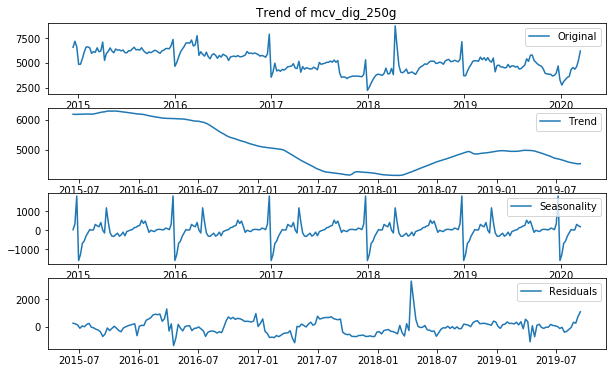

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g')

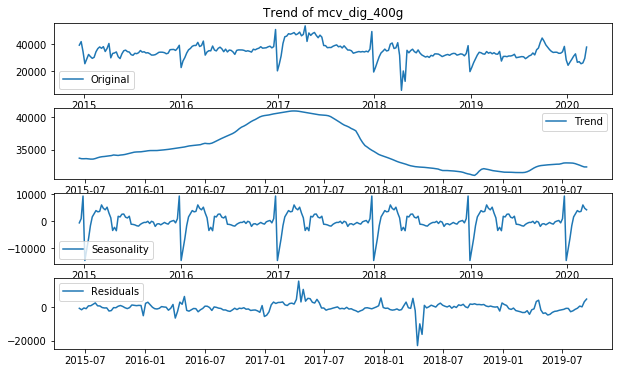

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin')

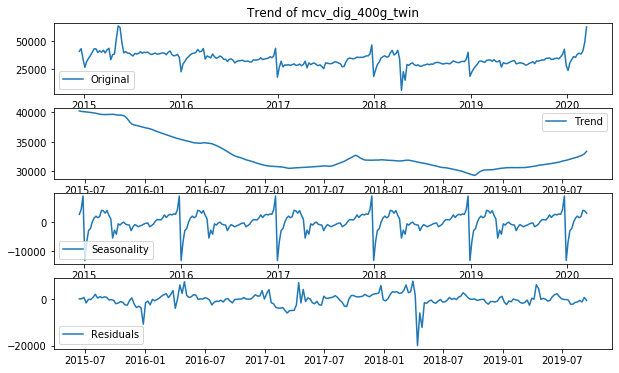

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g')

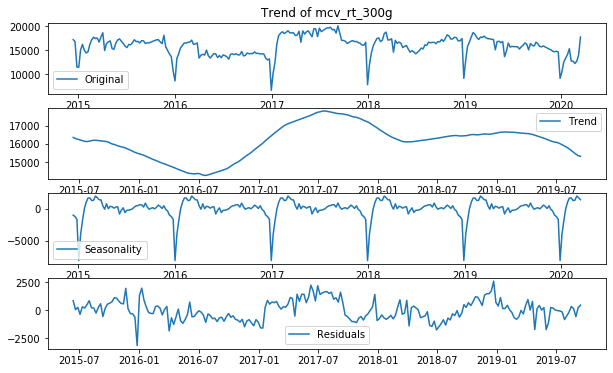

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin')

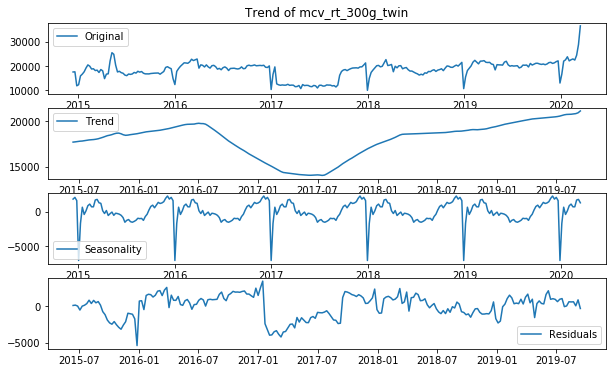

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

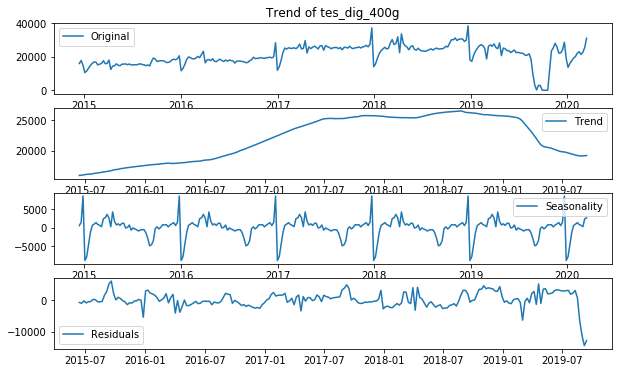

No enough datapoints for plotting the complete graphs


<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_molly_400g')

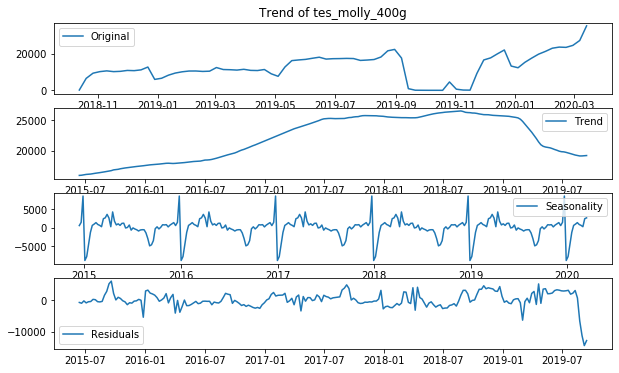

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

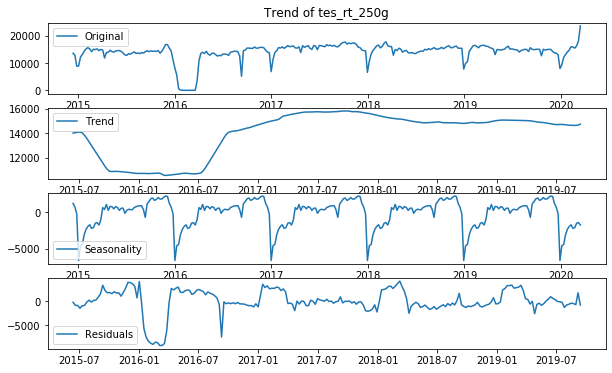

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

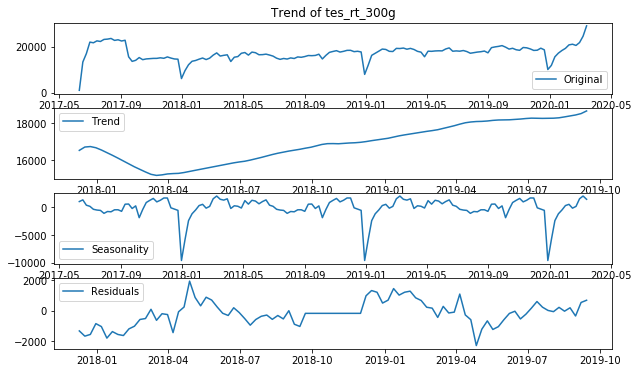

In [132]:
#decomposition for pladis products
from statsmodels.tsa.seasonal import seasonal_decompose

mcv_name=['mcv_dig_250g','mcv_dig_400g','mcv_dig_400g_twin',
          'mcv_rt_300g','mcv_rt_300g_twin','tes_dig_400g',
          'tes_molly_400g', 'tes_rt_250g','tes_rt_300g'
         ]
#tes_large1 contains original dataset, only transform the date

tes_large2=[]
i=0
for df in tes_large1:
    df=df.set_index('Date')
    df=df[['Volume']]
    df = df.dropna()
    tes_large2.append(df)
    
    try:
        decomposition=seasonal_decompose(df)
    except ValueError:
        print('No enough datapoints for plotting the complete graphs')
   
    trend=decomposition.trend
    seasonal=decomposition.seasonal
    residual=decomposition.resid

    plt.figure(figsize=(10,6))
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_name[i] )
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='best')
    plt.subplot(413)
    plt.plot(seasonal, label='Seasonality')
    plt.legend(loc='best')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='best')
    plt.show()
    i=i+1

mcv_dig_250g_volume=tes_large2[0]
mcv_dig_400g_volume=tes_large2[1]
mcv_dig_400g_twin_volume=tes_large2[2]
mcv_rt_300g_volume=tes_large2[3]
mcv_rt_300g_twin_volume=tes_large2[4]
tes_dig_400g_volume=tes_large2[5]
tes_molly_400g_volume=tes_large2[6]
tes_rt_250g_volume=tes_large2[7]
tes_rt_300g_volume=tes_large2[8]

#### Compare trends with Pladis product and competitors' product

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

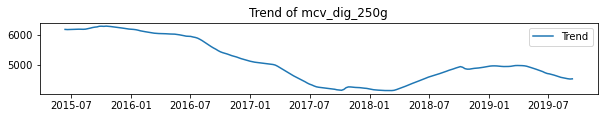

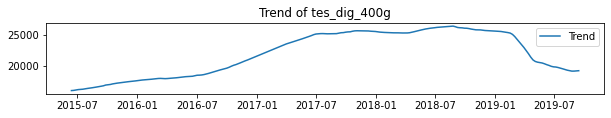

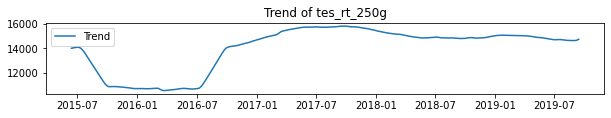

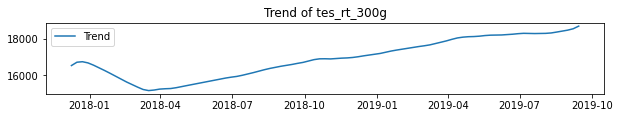

In [410]:
mcv_dig_250g_competitor=[mcv_dig_250g_volume,tes_dig_400g_volume,tes_rt_250g_volume,tes_rt_300g_volume]
mcv_dig_250g_competitor_list=['mcv_dig_250g','tes_dig_400g','tes_rt_250g','tes_rt_300g']
mcv_dig_400g_competitor=[mcv_dig_400g_volume,tes_dig_400g_volume,tes_rt_250g_volume,tes_rt_300g_volume]
mcv_dig_400g_competitor_list=['mcv_dig_400g','tes_dig_400g','tes_rt_250g','tes_rt_300g']
mcv_dig_400g_twin_competitor=[mcv_dig_400g_twin_volume,tes_dig_400g_volume,tes_rt_250g_volume,tes_rt_300g_volume]
mcv_dig_400g_twin_competitor_list=['mcv_dig_400g_twin','tes_dig_400g','tes_rt_250g','tes_rt_300g']
mcv_rt_300g_competitor=[mcv_rt_300g_volume,tes_dig_400g_volume,tes_rt_250g_volume,tes_rt_300g_volume]
mcv_rt_300g_competitor_list=['mcv_rt_300g','tes_dig_400g','tes_rt_250g','tes_rt_300g']
mcv_rt_300g_twin_competitor=[mcv_rt_300g_twin_volume,tes_dig_400g_volume,tes_rt_250g_volume,tes_rt_300g_volume]
mcv_rt_300g_twin_competitor_list=['mcv_rt_300g_twin','tes_dig_400g','tes_rt_250g','tes_rt_300g']

i=0
for product in mcv_dig_250g_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_dig_250g_competitor_list[i] )
    i=i+1
    

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

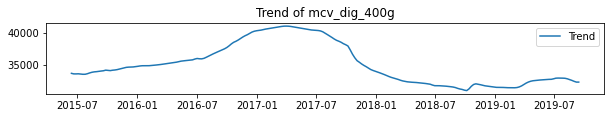

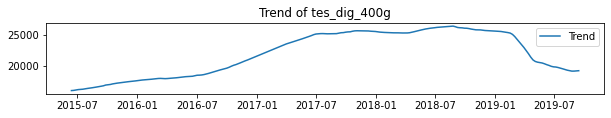

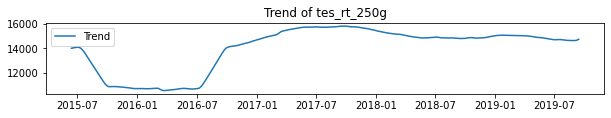

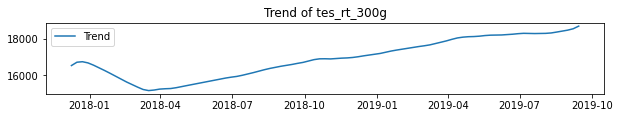

In [411]:
i=0
for product in mcv_dig_400g_competitor:
    decomposition=seasonal_decompose(product)
    trend_2=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_2, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_dig_400g_competitor_list[i])
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

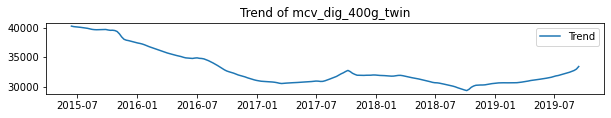

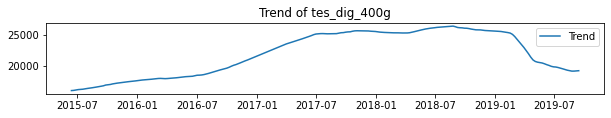

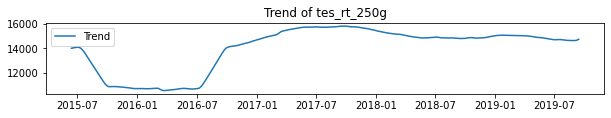

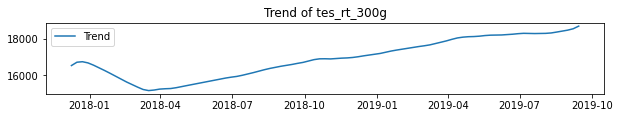

In [412]:
i=0
for product in mcv_dig_400g_twin_competitor:
    decomposition=seasonal_decompose(product)
    trend_3=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_3, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_dig_400g_twin_competitor_list[i])
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

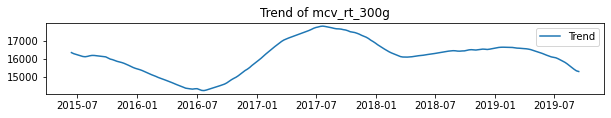

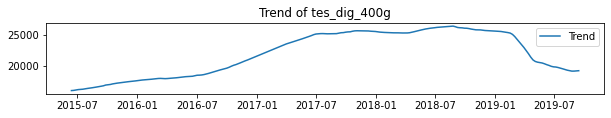

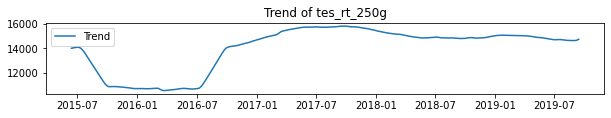

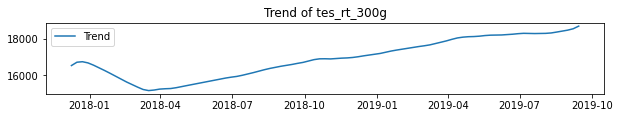

In [413]:
i=0
for product in mcv_rt_300g_competitor:
    decomposition=seasonal_decompose(product)
    trend_4=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_4, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_rt_300g_competitor_list[i])
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

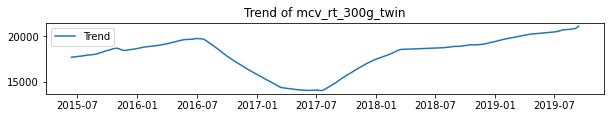

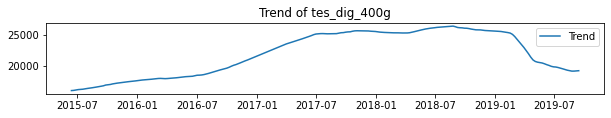

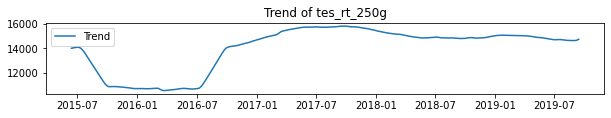

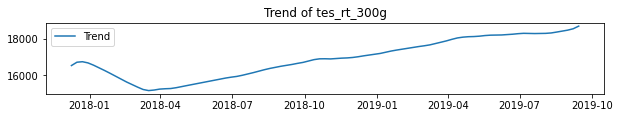

In [414]:
i=0
for product in mcv_rt_300g_twin_competitor:
    decomposition=seasonal_decompose(product)
    trend_5=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_5, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_rt_300g_twin_competitor_list[i])
    i=i+1

,mcv_dig_250g_trend,tes_dig_400g_trend,tes_rt_250g_trend,tes_rt_300g_trend
mcv_dig_250g_trend,1.000000,-0.866579,-0.886110,0.609020
tes_dig_400g_trend,-0.866579,1.000000,0.791993,-0.795277
tes_rt_250g_trend,-0.886110,0.791993,1.000000,-0.389964
tes_rt_300g_trend,0.609020,-0.795277,-0.389964,1.000000


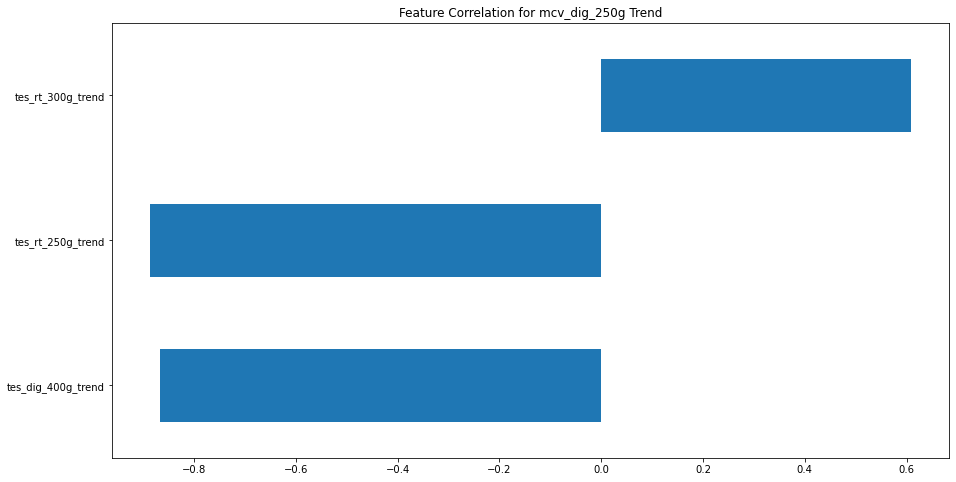

In [415]:
decomposition_1=seasonal_decompose(mcv_dig_250g_volume)
trend_1=decomposition_1.trend
trend_1=trend_1.to_frame()

comp_decomposition_1=seasonal_decompose(tes_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

# # datapoints are less than 104 observations
# comp_decomposition_2=seasonal_decompose(tes_molly_400g)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(tes_rt_250g_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

mcv_dig_250g_comp=pd.merge(trend_1,comp_trend1, how='left', on='Date')
# mcv_dig_250g=pd.merge(mcv_dig_250g,comp_trend2, how='left', on='Date')
mcv_dig_250g_comp=pd.merge(mcv_dig_250g_comp,comp_trend3, how='left', on='Date')
mcv_dig_250g_comp=pd.merge(mcv_dig_250g_comp,comp_trend4, how='left', on='Date')
mcv_dig_250g_comp.columns=['mcv_dig_250g_trend', 'tes_dig_400g_trend','tes_rt_250g_trend','tes_rt_300g_trend']

mcv_dig_250g_comp.corr()

#correlation graph
mcv_dig_250g_comp_corr=mcv_dig_250g_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
mcv_dig_250g_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_dig_250g Trend",legend=False, figsize=(15, 8))


,mcv_dig_400g_trend,tes_dig_400g_trend,tes_rt_250g_trend,tes_rt_300g_trend
mcv_dig_400g_trend,1.000000,-0.079756,0.073859,0.013966
tes_dig_400g_trend,-0.079756,1.000000,0.791993,-0.795277
tes_rt_250g_trend,0.073859,0.791993,1.000000,-0.389964
tes_rt_300g_trend,0.013966,-0.795277,-0.389964,1.000000


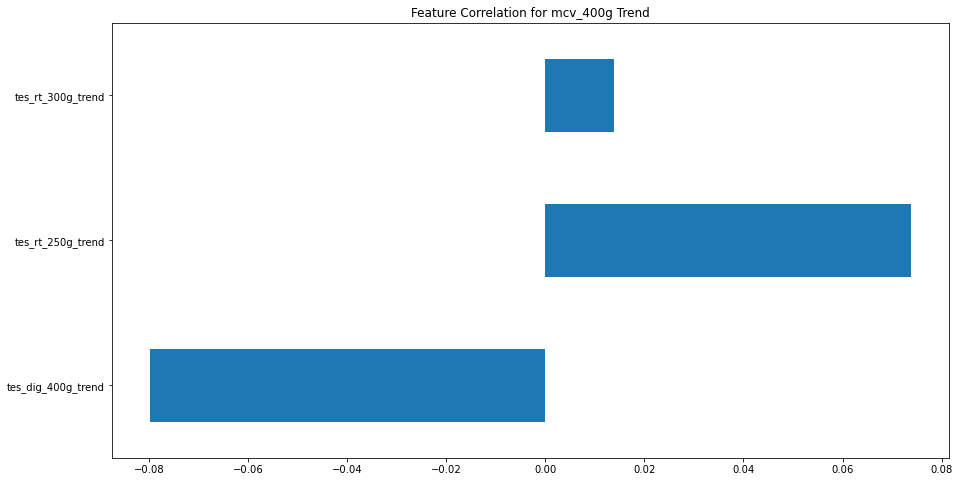

In [416]:
decomposition_2=seasonal_decompose(mcv_dig_400g_volume)
trend_2=decomposition_2.trend
trend_2=trend_2.to_frame()

comp_decomposition_1=seasonal_decompose(tes_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(tes_molly_400g)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(tes_rt_250g_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

mcv_400g_comp=pd.merge(trend_2,comp_trend1, how='left', on='Date')
# mcv_400g_comp=pd.merge(mcv_400g_comp,comp_trend2, how='left', on='Date')
mcv_400g_comp=pd.merge(mcv_400g_comp,comp_trend3, how='left', on='Date')
mcv_400g_comp=pd.merge(mcv_400g_comp,comp_trend4, how='left', on='Date')
mcv_400g_comp.columns=['mcv_dig_400g_trend', 'tes_dig_400g_trend','tes_rt_250g_trend','tes_rt_300g_trend']

mcv_400g_comp.corr()

#correlation graph
mcv_dig_400g_comp_corr=mcv_400g_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
mcv_dig_400g_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_400g Trend",legend=False, figsize=(15, 8))



,mcv_dig_400g_twin_trend,tes_dig_400g_trend,tes_rt_250g_trend,tes_rt_300g_trend
mcv_dig_400g_twin_trend,1.000000,-0.838641,-0.767722,0.159325
tes_dig_400g_trend,-0.838641,1.000000,0.791993,-0.795277
tes_rt_250g_trend,-0.767722,0.791993,1.000000,-0.389964
tes_rt_300g_trend,0.159325,-0.795277,-0.389964,1.000000


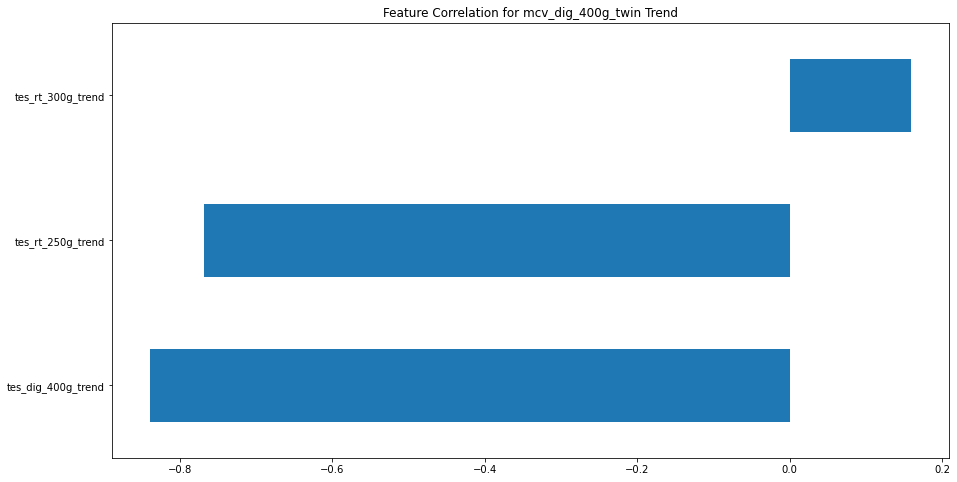

In [417]:
decomposition_3=seasonal_decompose(mcv_dig_400g_twin_volume)
trend_3=decomposition_3.trend
trend_3=trend_3.to_frame()

comp_decomposition_1=seasonal_decompose(tes_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(tes_molly_400g)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(tes_rt_250g_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

mcv_dig_400g_twin_comp=pd.merge(trend_3,comp_trend1, how='left', on='Date')
# mcv_dig_400g_twin_comp=pd.merge(mcv_dig_400g_twin_comp,comp_trend2, how='left', on='Date')
mcv_dig_400g_twin_comp=pd.merge(mcv_dig_400g_twin_comp,comp_trend3, how='left', on='Date')
mcv_dig_400g_twin_comp=pd.merge(mcv_dig_400g_twin_comp,comp_trend4, how='left', on='Date')
mcv_dig_400g_twin_comp.columns=['mcv_dig_400g_twin_trend', 'tes_dig_400g_trend','tes_rt_250g_trend','tes_rt_300g_trend']

mcv_dig_400g_twin_comp.corr()

#correlation graph
mcv_dig_400g_twin_comp_corr=mcv_dig_400g_twin_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
mcv_dig_400g_twin_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_dig_400g_twin Trend",legend=False, figsize=(15, 8))


,mcv_rt_300g_trend,tes_dig_400g_trend,tes_rt_250g_trend,tes_rt_300g_trend
mcv_rt_300g_trend,1.000000,0.675009,0.760581,-0.195562
tes_dig_400g_trend,0.675009,1.000000,0.791993,-0.795277
tes_rt_250g_trend,0.760581,0.791993,1.000000,-0.389964
tes_rt_300g_trend,-0.195562,-0.795277,-0.389964,1.000000


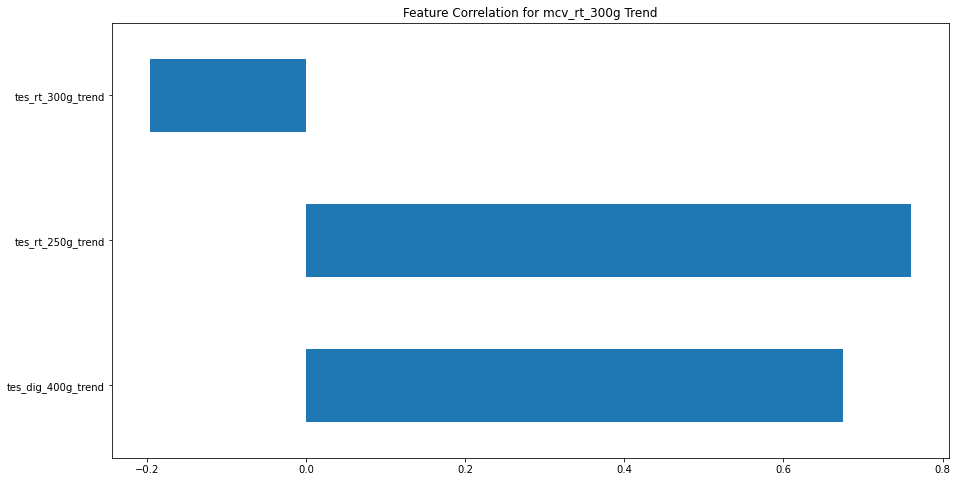

In [418]:
decomposition_4=seasonal_decompose(mcv_rt_300g_volume)
trend_4=decomposition_4.trend
trend_4=trend_4.to_frame()

comp_decomposition_1=seasonal_decompose(tes_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(tes_molly_400g)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(tes_rt_250g_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

mcv_rt_300g_comp=pd.merge(trend_4,comp_trend1, how='left', on='Date')
# mcv_rt_300g_comp=pd.merge(mcv_rt_300g_comp,comp_trend2, how='left', on='Date')
mcv_rt_300g_comp=pd.merge(mcv_rt_300g_comp,comp_trend3, how='left', on='Date')
mcv_rt_300g_comp=pd.merge(mcv_rt_300g_comp,comp_trend4, how='left', on='Date')
mcv_rt_300g_comp.columns=['mcv_rt_300g_trend', 'tes_dig_400g_trend','tes_rt_250g_trend','tes_rt_300g_trend']


mcv_rt_300g_comp.corr()

#correlation graph
mcv_rt_300g_comp_corr=mcv_rt_300g_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
mcv_rt_300g_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_rt_300g Trend",legend=False, figsize=(15, 8))



,mcv_rt_300g_twin_trend,tes_dig_400g_trend,tes_rt_250g_trend,tes_rt_300g_trend
mcv_rt_300g_twin_trend,1.000000,-0.299945,-0.394315,0.843504
tes_dig_400g_trend,-0.299945,1.000000,0.791993,-0.795277
tes_rt_250g_trend,-0.394315,0.791993,1.000000,-0.389964
tes_rt_300g_trend,0.843504,-0.795277,-0.389964,1.000000


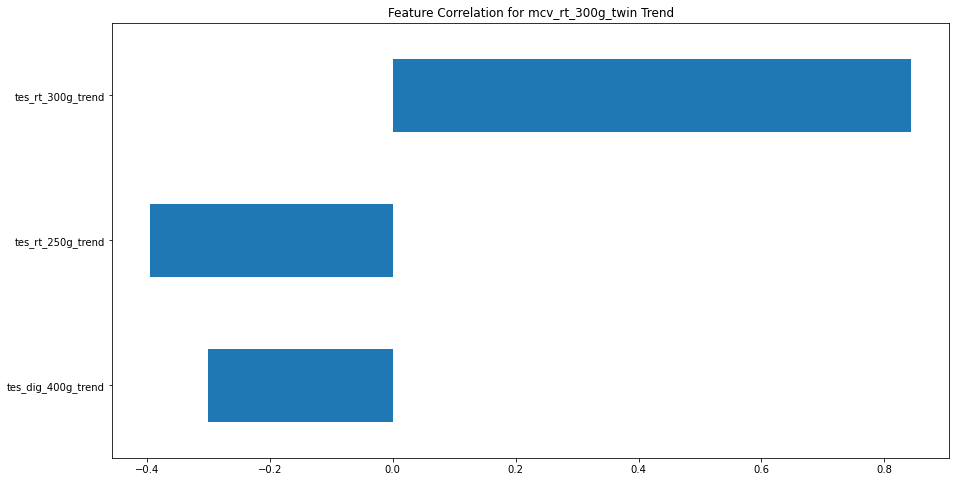

In [419]:
#mcv_rt_300g_twin trend correlation
decomposition_5=seasonal_decompose(mcv_rt_300g_twin_volume)
trend_5=decomposition_5.trend
trend_5=trend_5.to_frame()

comp_decomposition_1=seasonal_decompose(tes_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(tes_molly_400g)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(tes_rt_250g_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

mcv_rt_300g_twin_comp=pd.merge(trend_5,comp_trend1, how='left', on='Date')
# mcv_rt_300g_twin_comp=pd.merge(mcv_rt_300g_twin_comp,comp_trend2, how='left', on='Date')
mcv_rt_300g_twin_comp=pd.merge(mcv_rt_300g_twin_comp,comp_trend3, how='left', on='Date')
mcv_rt_300g_twin_comp=pd.merge(mcv_rt_300g_twin_comp,comp_trend4, how='left', on='Date')
mcv_rt_300g_twin_comp.columns=['mcv_rt_300g_twin_trend', 'tes_dig_400g_trend','tes_rt_250g_trend','tes_rt_300g_trend']

mcv_rt_300g_twin_comp.corr()

#correlation graph
mcv_rt_300g_twin_comp_corr=mcv_rt_300g_twin_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
mcv_rt_300g_twin_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_rt_300g_twin Trend",legend=False, figsize=(15, 8))



In [420]:
# #correlation graph
# mcv_rt_300g_twin_comp_corr=mcv_rt_300g_twin_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
# mcv_rt_300g_twin_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_rt_300g Trend",legend=False, figsize=(15, 8))



## Machine Learning Model

In [421]:
#extract own product variables: sales price distribution promotional week month quarter
def own_product_variables(x):
    x=x.set_index('Date')
    x=x[['Volume','£/kg','Distribution','Promotional Distribution','year','quarter','month','week']]
    return x

mcv_dig_250g_own_variable=own_product_variables(mcv_dig_250g_origin)
mcv_dig_400g_own_variable=own_product_variables(mcv_dig_400g_origin)
mcv_dig_400g_twin_own_variable=own_product_variables(mcv_dig_400g_twin_origin)
mcv_rt_300g_own_variable=own_product_variables(mcv_rt_300g_origin)
mcv_rt_300g_twin_own_variable=own_product_variables(mcv_rt_300g_twin_origin)


In [422]:
mcv_dig_250g_with_comp_1=mcv_dig_250g_own_variable
mcv_dig_400g_with_comp_1=mcv_dig_400g_own_variable
mcv_dig_400g_twin_with_comp1=mcv_dig_400g_twin_own_variable
mcv_rt_300g_with_comp1=mcv_rt_300g_own_variable
mcv_rt_300g_twin_with_comp1=mcv_rt_300g_twin_own_variable

In [423]:
def comp_variables(x):
    x=x.set_index('Date')
    x=x[['£/kg','Distribution']]
    return x

tesco_digs400g_price_dis=comp_variables(tes_dig_400g_origin)
tesco_rt250g_price_dis=comp_variables(tes_rt_250g_origin)
tesco_molly400g_price_dis=comp_variables(tes_molly_400g_origin)
tesco_rt300g_price_dis=comp_variables(tes_rt_300g_origin)

In [424]:
# compose competitors' variables as a list
competitor_list=[tesco_rt250g_price_dis, tesco_molly400g_price_dis, tesco_rt300g_price_dis, tesco_digs400g_price_dis]

variable_columns=['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                   'tesco_digs400g_price_kg','tesco_dig400g_distribution'
                  ]

In [425]:
# mcv_dig_250g product
# each variable with their competitors
# merge own product variables with four competitors' variables
for variable in competitor_list:
    mcv_dig_250g_with_comp_1=mcv_dig_250g_with_comp_1.merge(variable, how='left', on='Date')
    mcv_dig_250g_with_comp=mcv_dig_250g_with_comp_1
    
#drop all missing values
mcv_dig_250g_with_comp.columns=variable_columns
mcv_dig_250g_with_comp=mcv_dig_250g_with_comp.dropna()
mcv_dig_250g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,
2018-10-13,4850.3,3.559244,69,0,2018,4,10,41,2.241567,100,0.775123,14.0,0.999896,83.0,1.125344,99
2018-10-20,5179.0,3.558718,69,0,2018,4,10,42,2.241541,100,0.775011,57.0,0.999892,83.0,1.125224,99
2018-10-27,5293.5,3.557684,68,0,2018,4,10,43,2.241566,100,0.774954,57.0,0.999978,83.0,1.125292,99
2018-11-03,5335.8,3.558061,68,0,2018,4,11,44,2.241457,100,0.775021,57.0,0.999962,83.0,1.125552,99
2018-11-10,5111.3,3.557921,68,0,2018,4,11,45,2.241417,100,0.774982,58.0,0.999921,83.0,1.125193,99


In [426]:
# mcv_dig_400g product
for variable in competitor_list:
    mcv_dig_400g_with_comp_1=mcv_dig_400g_with_comp_1.merge(variable, how='left', on='Date')
    mcv_dig_400g_with_comp=mcv_dig_400g_with_comp_1
    
mcv_dig_400g_with_comp.columns=variable_columns
mcv_dig_400g_with_comp=mcv_dig_400g_with_comp.dropna()
mcv_dig_400g_with_comp.head()

,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,
2018-10-13,31698.0,2.501574,100,0,2018,4,10,41,2.241567,100,0.775123,14.0,0.999896,83.0,1.125344,99
2018-10-20,32629.2,2.501698,100,0,2018,4,10,42,2.241541,100,0.775011,57.0,0.999892,83.0,1.125224,99
2018-10-27,33110.0,2.501824,100,0,2018,4,10,43,2.241566,100,0.774954,57.0,0.999978,83.0,1.125292,99
2018-11-03,33014.8,2.501599,100,0,2018,4,11,44,2.241457,100,0.775021,57.0,0.999962,83.0,1.125552,99
2018-11-10,31830.0,2.501929,100,0,2018,4,11,45,2.241417,100,0.774982,58.0,0.999921,83.0,1.125193,99


In [427]:
#mcv_dig_400g_twin product
for variable in competitor_list:
    mcv_dig_400g_twin_with_comp1=mcv_dig_400g_twin_with_comp1.merge(variable, how='left', on='Date')
    mcv_dig_400g_twin_with_comp=mcv_dig_400g_twin_with_comp1
    
mcv_dig_400g_twin_with_comp.columns=variable_columns
mcv_dig_400g_twin_with_comp=mcv_dig_400g_twin_with_comp.dropna()
mcv_dig_400g_twin_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,
2018-10-13,29722.4,2.361640,98,0,2018,4,10,41,2.241567,100,0.775123,14.0,0.999896,83.0,1.125344,99
2018-10-20,30899.2,2.362333,98,0,2018,4,10,42,2.241541,100,0.775011,57.0,0.999892,83.0,1.125224,99
2018-10-27,32409.6,2.362053,98,0,2018,4,10,43,2.241566,100,0.774954,57.0,0.999978,83.0,1.125292,99
2018-11-03,31647.2,2.362421,98,0,2018,4,11,44,2.241457,100,0.775021,57.0,0.999962,83.0,1.125552,99
2018-11-10,31065.6,2.361049,98,0,2018,4,11,45,2.241417,100,0.774982,58.0,0.999921,83.0,1.125193,99


In [428]:
#mcv_rt_300g product
for variable in competitor_list:
    mcv_rt_300g_with_comp1=mcv_rt_300g_with_comp1.merge(variable, how='left', on='Date')
    mcv_rt_300g_with_comp=mcv_rt_300g_with_comp1
    
mcv_rt_300g_with_comp.columns=variable_columns
mcv_rt_300g_with_comp=mcv_rt_300g_with_comp.dropna()
mcv_rt_300g_with_comp.head()

,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,
2018-10-13,16893.0,3.328089,100,0,2018,4,10,41,2.241567,100,0.775123,14.0,0.999896,83.0,1.125344,99
2018-10-20,17493.9,3.330738,100,0,2018,4,10,42,2.241541,100,0.775011,57.0,0.999892,83.0,1.125224,99
2018-10-27,18264.9,3.335835,100,0,2018,4,10,43,2.241566,100,0.774954,57.0,0.999978,83.0,1.125292,99
2018-11-03,18000.0,3.332644,100,0,2018,4,11,44,2.241457,100,0.775021,57.0,0.999962,83.0,1.125552,99
2018-11-10,17365.2,3.329135,100,0,2018,4,11,45,2.241417,100,0.774982,58.0,0.999921,83.0,1.125193,99


In [429]:
#mcv_rt_300g_twin product
for variable in competitor_list:
    mcv_rt_300g_twin_with_comp1=mcv_rt_300g_twin_with_comp1.merge(variable, how='left', on='Date')
    mcv_rt_300g_twin_with_comp=mcv_rt_300g_twin_with_comp1
    
mcv_rt_300g_twin_with_comp.columns=variable_columns
mcv_rt_300g_twin_with_comp=mcv_rt_300g_twin_with_comp.dropna()
mcv_rt_300g_twin_with_comp.head()

,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,
2018-10-13,18062,3.15,98,0,2018,4,10,41,2.241567,100,0.775123,14.0,0.999896,83.0,1.125344,99
2018-10-20,19108,3.15,98,0,2018,4,10,42,2.241541,100,0.775011,57.0,0.999892,83.0,1.125224,99
2018-10-27,20010,3.15,98,0,2018,4,10,43,2.241566,100,0.774954,57.0,0.999978,83.0,1.125292,99
2018-11-03,19879,3.15,98,0,2018,4,11,44,2.241457,100,0.775021,57.0,0.999962,83.0,1.125552,99
2018-11-10,19467,3.15,98,0,2018,4,11,45,2.241417,100,0.774982,58.0,0.999921,83.0,1.125193,99


### Random Forest Regressor

In [430]:
def variable_lag(df):
    df=pd.DataFrame(df)
    X_lag=df[['£/kg','Distribution','Promotional Distribution',
             'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                   'tesco_digs400g_price_kg','tesco_dig400g_distribution'
             ]]
    X_lagged=X_lag.shift(4)
    non_lag=df[['Volume','year','quarter','month','week']]
    final_df=pd.merge(X_lagged,non_lag,left_index=True, right_index=True)
    final_df=final_df.dropna()
    return final_df

In [431]:
def variable_lag(df):
    df=pd.DataFrame(df)
    df['Original_Volume']=df['Volume'].copy()
    X_lag=df[['Volume','£/kg','Distribution','Promotional Distribution',
             'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                   'tesco_digs400g_price_kg','tesco_dig400g_distribution'
             ]]
    X_lagged=X_lag.shift(4)
    non_lag=df[['Original_Volume','year','quarter','month','week']]
    final_df=pd.merge(non_lag,X_lagged,left_index=True, right_index=True)
    final_df=final_df.dropna()
    return final_df

In [432]:
def input_var(var):
#     for var in final_var_list:
    X=var[['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
                 'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                   'tesco_digs400g_price_kg','tesco_dig400g_distribution'
              ]].values
    y=var['Original_Volume'].values
    return X,y

In [433]:
#train test split
from sklearn.model_selection import TimeSeriesSplit

def rf_regressor_mcv(X, y):
    splits = TimeSeriesSplit(n_splits=5)

    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler

        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        regressor = RandomForestRegressor(n_estimators=20, random_state=0)
        regressor.fit(X_train, y_train)
        y_pred = regressor.predict(X_test)
        print(cross_val_score(regressor, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
                 'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                                              'tesco_digs400g_price_kg','tesco_dig400g_distribution'
], 'importance': regressor.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of Random Forest Model",legend=False, figsize=(15, 8))

In [434]:
mcv_dig_250g_with_comp=variable_lag(mcv_dig_250g_with_comp)

In [435]:
mcv_dig_250g_input_X,mcv_dig_250g_input_Y=input_var(mcv_dig_250g_with_comp)

Observations: 27
Training Observations: 16
Testing Observations: 11
[-1.71740091e-02 -5.51019863e+01 -3.98991431e-01 -4.91279464e+01
 -3.24859043e+01]
Mean Absolute Error: 464.06454545454494
Mean Squared Error: 289635.64470909035
Root Mean Squared Error: 538.1780789934595
Observations: 38
Training Observations: 27
Testing Observations: 11
[-20.50512274  -9.86206262 -17.79624154   0.81336861  -0.58374327]
Mean Absolute Error: 511.1977272727276
Mean Squared Error: 283419.138261364
Root Mean Squared Error: 532.3712410164209
Observations: 49
Training Observations: 38
Testing Observations: 11
[ -3.51480289  -6.77908432   0.21486452 -15.41438048 -22.73285766]
Mean Absolute Error: 508.3418181818178
Mean Squared Error: 423125.7280318176
Root Mean Squared Error: 650.4811511733584
Observations: 60
Training Observations: 49
Testing Observations: 11
[ -0.12761238   0.08176242 -26.68435109  -3.08409422  -3.45623542]
Mean Absolute Error: 1577.892727272729
Mean Squared Error: 2810456.482140914
Root M

<Figure size 432x288 with 0 Axes>

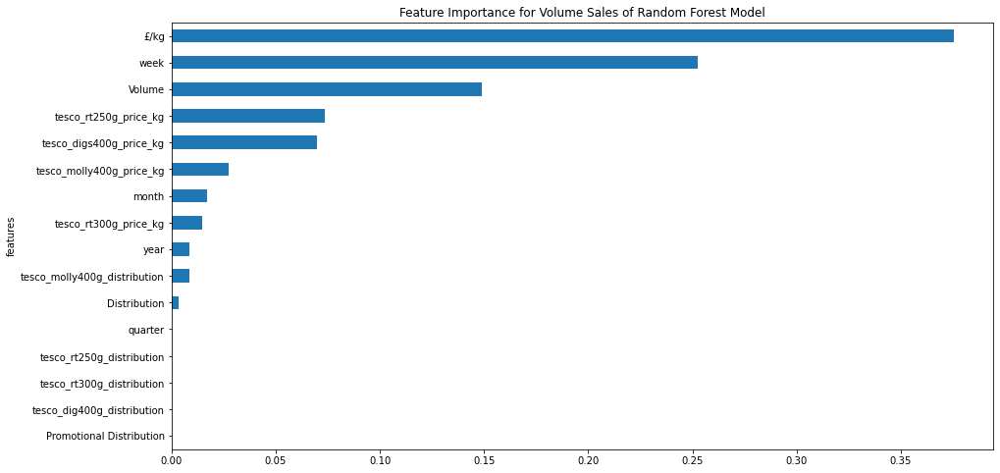

<Figure size 432x288 with 0 Axes>

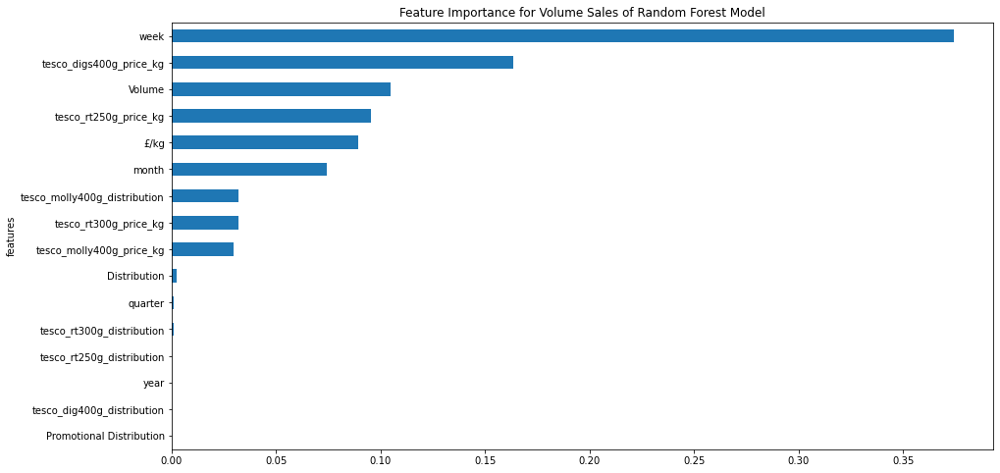

<Figure size 432x288 with 0 Axes>

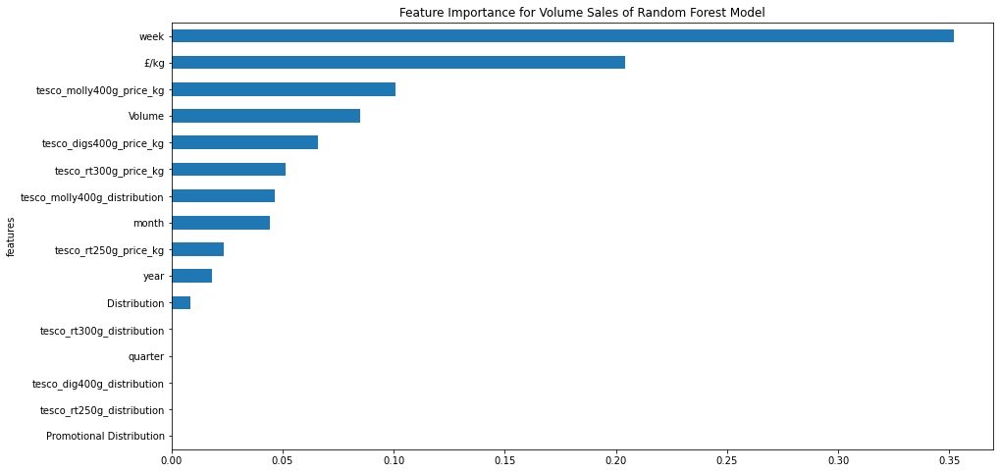

<Figure size 432x288 with 0 Axes>

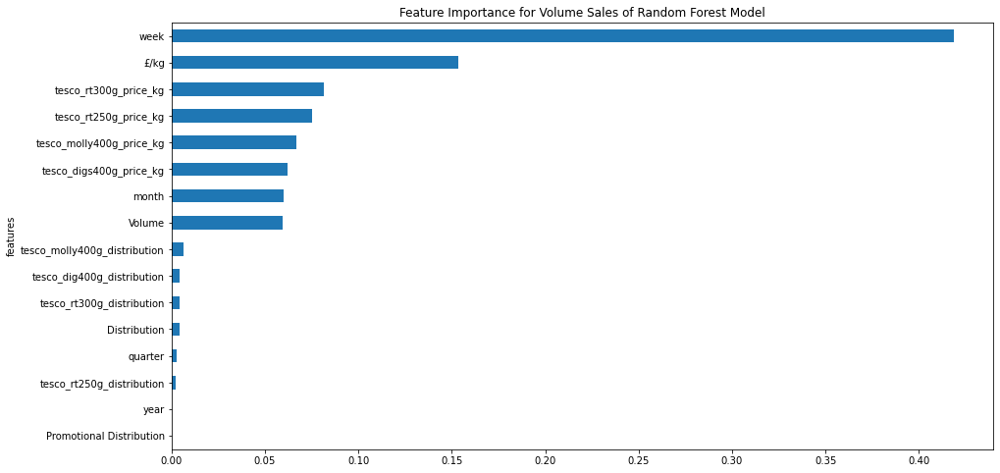

<Figure size 432x288 with 0 Axes>

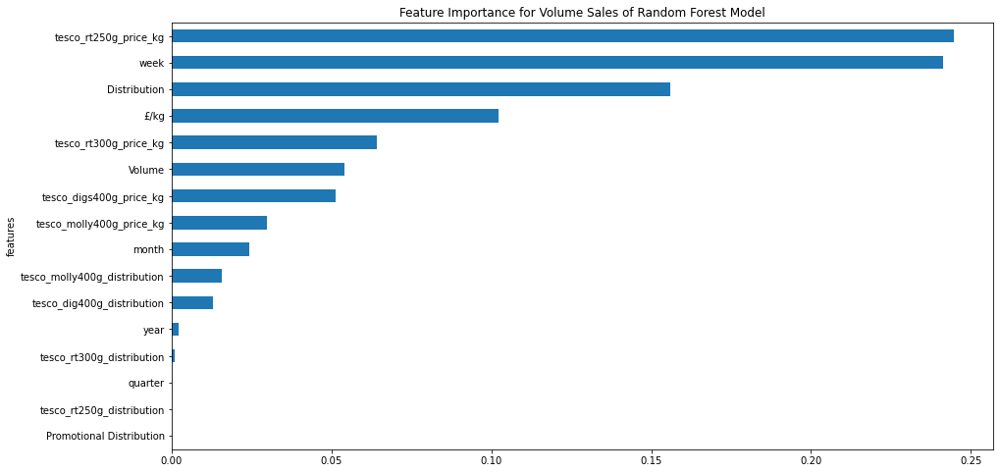

In [436]:
rf_regressor_mcv(mcv_dig_250g_input_X,mcv_dig_250g_input_Y)

### XGBoost Model

In [437]:
!pip3 install xgboost
from xgboost import XGBRegressor
import xgboost as xgb
# from sklearn.metrics import mean_squared_error



         .:::.     .::.       
        ....yy:    .yy.       
        :.  .yy.    y.        
             :y:   .:         
             .yy  .:          
              yy..:           
              :y:.            
              .y.             
             .:.              
        ....:.                
        :::.                  

• Project files and data should be stored in /project. This is shared among everyone
  in the project.
• Personal files and configuration should be stored in /home/faculty.
• Files outside /project and /home/faculty will be lost when this server is terminated.
• Create custom environments to setup your servers reproducibly.



In [438]:
def xgb_regressor_mcv(X, y):
    splits = TimeSeriesSplit(n_splits=5)
    
    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler


        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
                    max_depth = 5, alpha = 10, n_estimators = 10)
        xg_reg.fit(X_train, y_train)
        y_pred = xg_reg.predict(X_test)
        print(cross_val_score(xg_reg, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
                 'tesco_rt250g_price_kg', 'tesco_rt250g_distribution',
                   'tesco_molly400g_price_kg','tesco_molly400g_distribution',
                   'tesco_rt300g_price_kg','tesco_rt300g_distribution',
                                              'tesco_digs400g_price_kg','tesco_dig400g_distribution'], 'importance': xg_reg.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of XGBoost Model",legend=False, figsize=(20, 13))


Observations: 27
Training Observations: 16
Testing Observations: 11
[-1.85992013e+00 -9.51014437e+00 -1.43885374e+02 -7.92230468e+03
 -1.18689049e+04]
Mean Absolute Error: 2259.767316228693
Mean Squared Error: 5358632.10360087
Root Mean Squared Error: 2314.8719410802987
Observations: 38
Training Observations: 27
Testing Observations: 11
[  -4.35979856 -170.50780915 -236.07444338 -146.51261275   -9.60258976]
Mean Absolute Error: 1370.6161843039772
Mean Squared Error: 1892320.013932193
Root Mean Squared Error: 1375.6162306152805
Observations: 49
Training Observations: 38
Testing Observations: 11
[  -6.51447093 -241.32152101  -13.41878318 -122.18906833 -157.00263035]
Mean Absolute Error: 1915.711434659091
Mean Squared Error: 3853997.0162554937
Root Mean Squared Error: 1963.1599568694076
Observations: 60
Training Observations: 49
Testing Observations: 11
[ -28.42424776  -21.23761025 -136.7430077  -122.13405136  -34.16008508]
Mean Absolute Error: 796.0937100497159
Mean Squared Error: 799986

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide



Observations: 71
Training Observations: 60
Testing Observations: 11
[ -66.26321823  -14.1479833  -114.78380435  -26.31005273   -4.00613476]
Mean Absolute Error: 1558.2298473011363
Mean Squared Error: 3415285.8385281046
Root Mean Squared Error: 1848.049198081075


<Figure size 432x288 with 0 Axes>

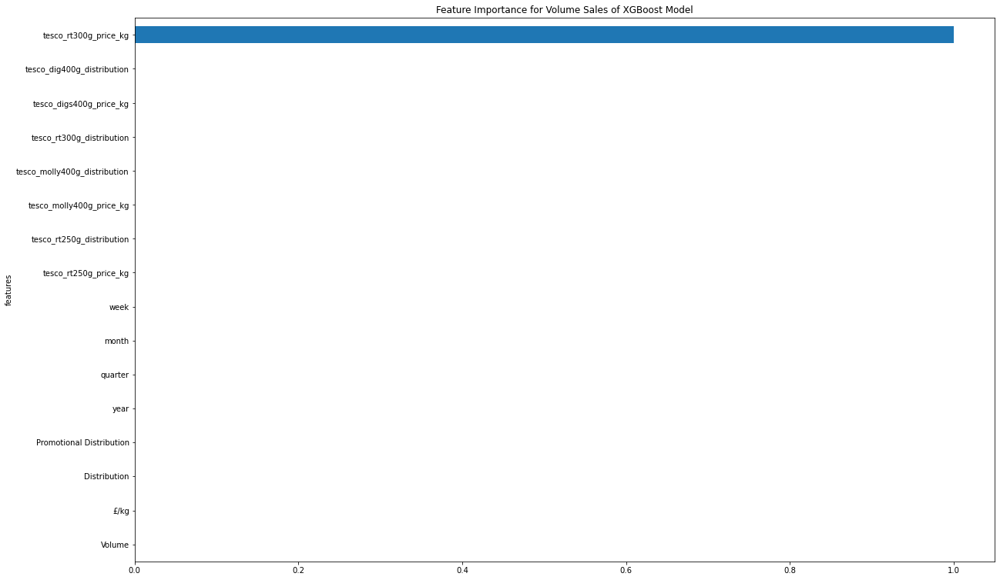

<Figure size 432x288 with 0 Axes>

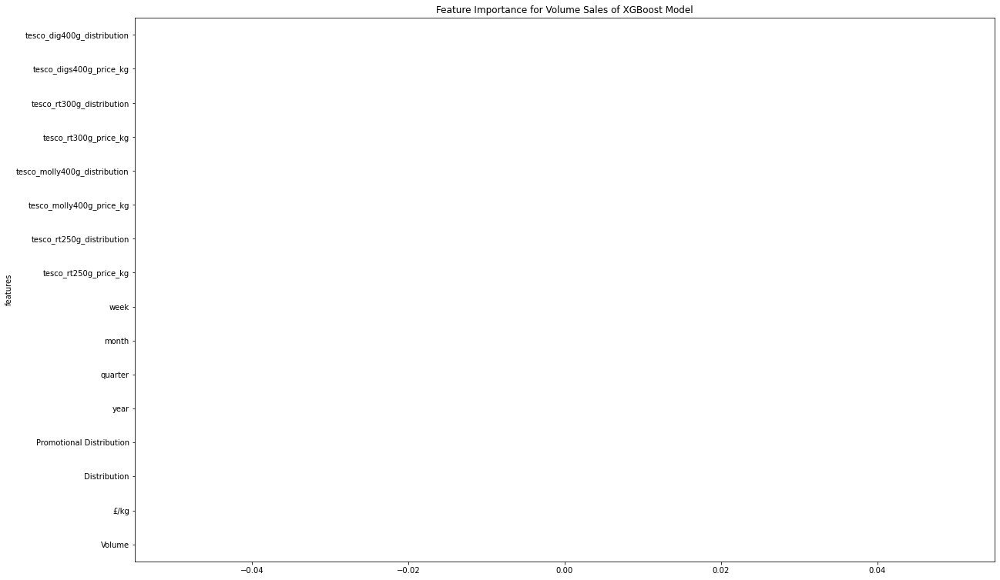

<Figure size 432x288 with 0 Axes>

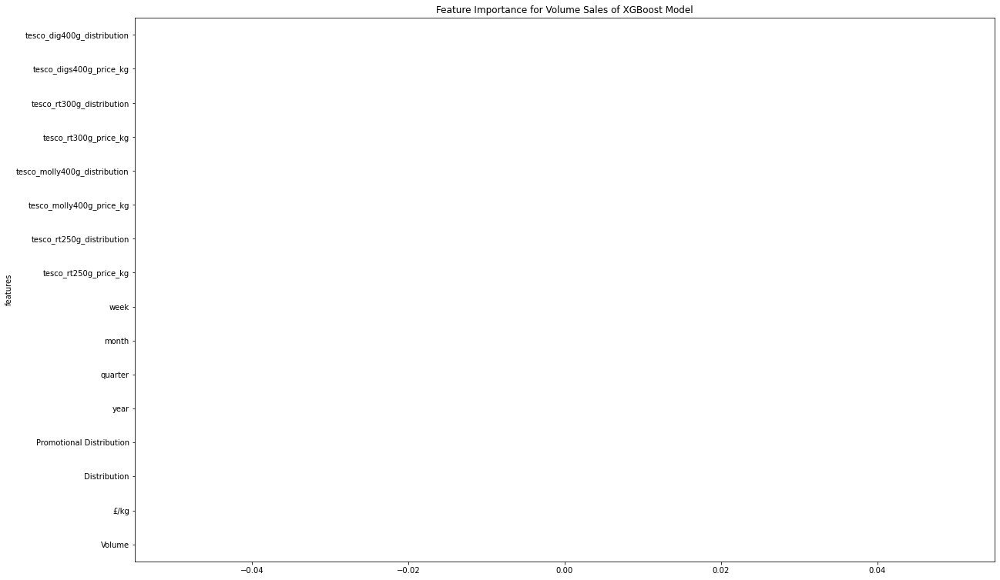

<Figure size 432x288 with 0 Axes>

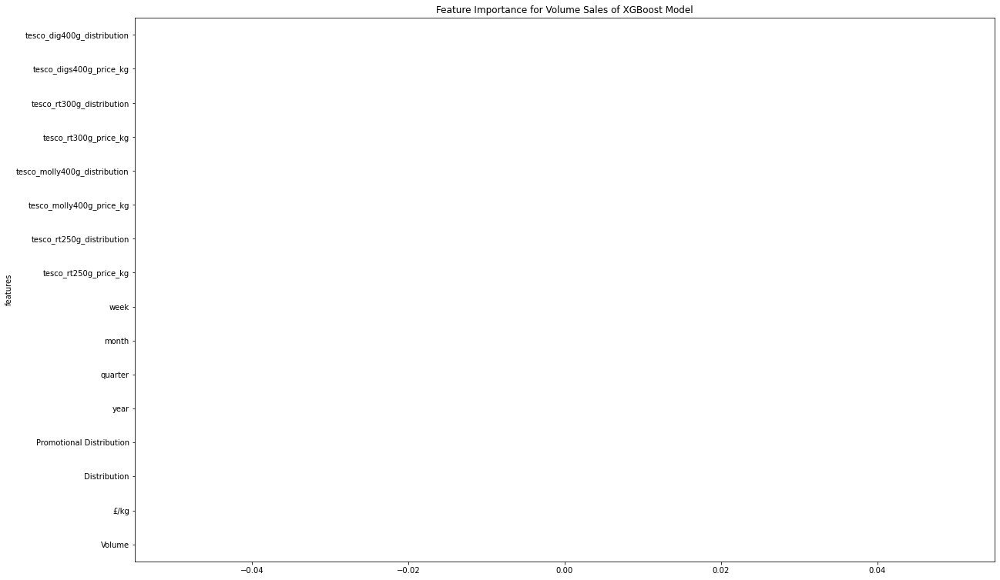

<Figure size 432x288 with 0 Axes>

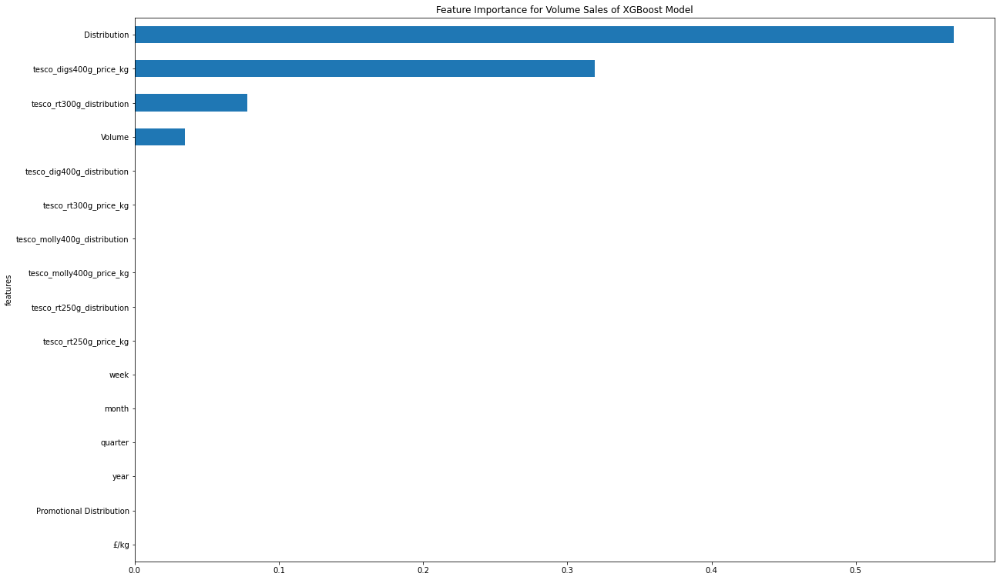

In [439]:
#dropna
xgb_regressor_mcv(mcv_dig_250g_input_X,mcv_dig_250g_input_Y)

### LSTM model

#### Univariate LSTM - Baseline Model

In [105]:
import numpy
import matplotlib.pyplot as plt
import pandas
import math
from pandas import DataFrame
from pandas import concat
!pip install tensorflow
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense,Dropout
from tensorflow.keras.callbacks import EarlyStopping
from tensorflow.keras.layers import LSTM
from sklearn.preprocessing import MinMaxScaler
from sklearn.metrics import mean_squared_error

     |████████████████████████████████| 803 kB 566 kB/s eta 0:00:01
  Attempting uninstall: setuptools
    Found existing installation: setuptools 40.8.0
    Uninstalling setuptools-40.8.0:
      Successfully uninstalled setuptools-40.8.0
You should consider upgrading via the '/anaconda3/bin/python -m pip install --upgrade pip' command.


In [99]:
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler

In [106]:
# convert series to supervised learning

def series_to_supervised(data, n_in=4, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -4):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
    if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
    else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
  # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg

In [103]:
#def function version
def lstm_univariate(dataset):
    
    # load dataset
    values = dataset.values
    # integer encode direction
    #encoder = LabelEncoder()
    #values[:,4] = encoder.fit_transform(values[:,4])
    # ensure all data is float
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict
    print(reframed.head())
    
    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]
    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    # design network
    model = Sequential()
    model.add(LSTM(50, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM univariate model loss vs. val loss',loc='center')
    plt.legend()
    plt.show()
    
    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)

In [445]:
series_to_supervised(mcv_dig_250g_volume)

,var1(t-4),var1(t)
Date,,
2015-01-10,6563.0,4856.0
2015-01-17,7179.8,5394.5
2015-01-24,6617.0,6052.5
2015-01-31,4842.8,6581.5
2015-02-07,4856.0,6609.3
...,...,...
2020-02-15,3320.0,4527.5
2020-02-22,3530.0,4350.5
2020-02-29,3616.3,4605.0


   var1(t-4)   var1(t)
4   0.667107  0.405096
5   0.761780  0.487751
6   0.675395  0.588749
7   0.403070  0.669946
8   0.405096  0.674213
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 25s - loss: 0.4652 - val_loss: 0.3552
Epoch 2/50
216/216 - 0s - loss: 0.4538 - val_loss: 0.3444
Epoch 3/50
216/216 - 0s - loss: 0.4424 - val_loss: 0.3335
Epoch 4/50
216/216 - 0s - loss: 0.4309 - val_loss: 0.3223
Epoch 5/50
216/216 - 0s - loss: 0.4189 - val_loss: 0.3107
Epoch 6/50
216/216 - 0s - loss: 0.4066 - val_loss: 0.2986
Epoch 7/50
216/216 - 0s - loss: 0.3937 - val_loss: 0.2857
Epoch 8/50
216/216 - 0s - loss: 0.3800 - val_loss: 0.2721
Epoch 9/50
216/216 - 0s - loss: 0.3653 - val_loss: 0.2579
Epoch 10/50
216/216 - 0s - loss: 0.3495 - val_loss: 0.2426
Epoch 11/50
216/216 - 0s - loss: 0.3325 - val_loss: 0.2260
Epoch 12/50
216/216 - 0s - loss: 0.3141 - val_loss: 0.2084
Epoch 13/50
216/216 - 0s - loss: 0.2942 - val_loss: 0.1900
Epoch 14/50
216/216 - 

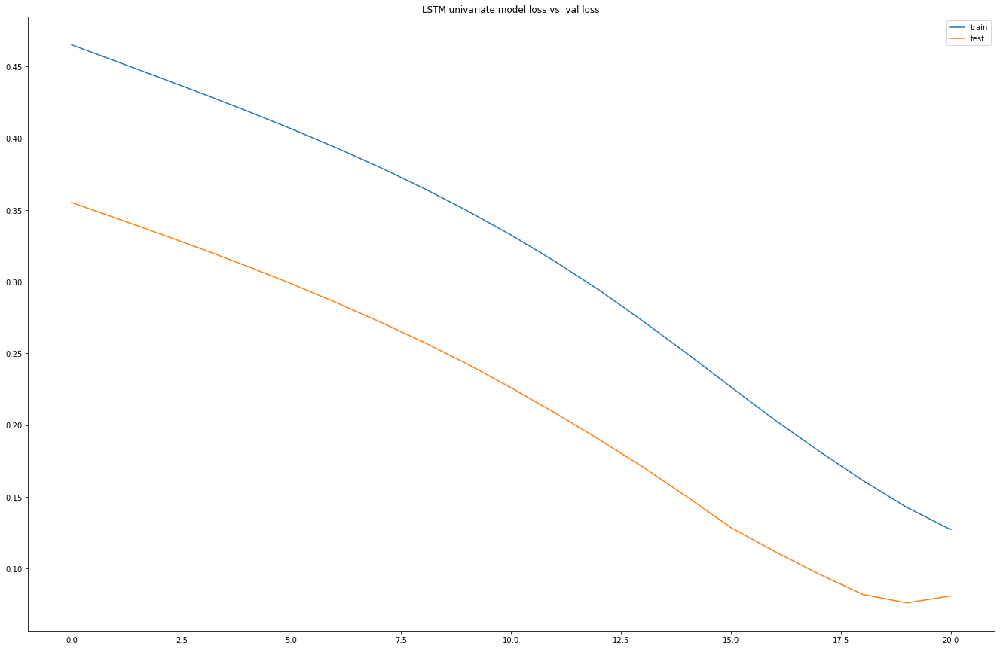

Test RMSE: 682.650


In [446]:
lstm_univariate(mcv_dig_250g_volume)

#### Multivariate LSTM - Without Competitors' Variables

In [123]:
# prepare data for lstm
from pandas import read_csv
from pandas import DataFrame
from pandas import concat
from sklearn.preprocessing import LabelEncoder
from sklearn.preprocessing import MinMaxScaler
# convert series to supervised learning
def series_to_supervised(data, n_in=4, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -4):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
    if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
    else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
  # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg


In [124]:
def multivariate_lstm_without_competitor(df):
    values = df.values
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict

    reframed.drop(reframed.columns[[9,10,11,12,13,14,15]], axis=1, inplace=True)
    print(reframed.head())

    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]

    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    # design network
    model = Sequential()
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(LSTM(100, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM multivariate model without competitors variables loss vs. val loss',loc='center')
    plt.legend()
    plt.show()

    # make a prediction
    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)

In [449]:
series_to_supervised(mcv_dig_250g_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,6563.0,3.560262,97.0,0.0,2014.0,4.0,12.0,50.0,4856.0,3.559761,97,0,2015,1,1,2
2015-01-17,7179.8,3.560043,97.0,0.0,2014.0,4.0,12.0,51.0,5394.5,3.556789,97,0,2015,1,1,3
2015-01-24,6617.0,3.560118,97.0,0.0,2014.0,4.0,12.0,52.0,6052.5,3.555143,97,0,2015,1,1,4
2015-01-31,4842.8,3.560110,97.0,0.0,2015.0,1.0,1.0,1.0,6581.5,3.559082,97,0,2015,1,1,5
2015-02-07,4856.0,3.559761,97.0,0.0,2015.0,1.0,1.0,2.0,6609.3,3.555369,97,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,3320.0,3.595392,58.0,0.0,2020.0,1.0,1.0,3.0,4527.5,3.999050,58,0,2020,1,2,7
2020-02-22,3530.0,3.599547,58.0,0.0,2020.0,1.0,1.0,4.0,4350.5,3.999678,58,0,2020,1,2,8
2020-02-29,3616.3,3.599397,58.0,0.0,2020.0,1.0,2.0,5.0,4605.0,3.998827,58,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.667107   0.227363   0.951219        0.0   0.000000        1.0   
5   0.761780   0.226979   0.951219        0.0   0.000000        1.0   
6   0.675395   0.227110   0.951219        0.0   0.000000        1.0   
7   0.403070   0.227096   0.951219        0.0   0.166656        0.0   
8   0.405096   0.226483   0.951219        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.405096  
5        1.0   0.961538  0.487751  
6        1.0   0.980769  0.588749  
7        0.0   0.000000  0.669946  
8        0.0   0.019231  0.674213  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 26s - loss: 0.4531 - val_loss: 0.3344
Epoch 2/50
216/216 - 0s - loss: 0.4282 - val_loss: 0.3097
Epoch 3/50
216/216 - 0s - loss: 0.4025 - val_loss: 0.2838
Epoch 4/50
216/216 - 0s - loss: 0.3747 - val_loss: 0.2559
Epoch 5/50
216/216 - 0s - loss: 0.3443 - va

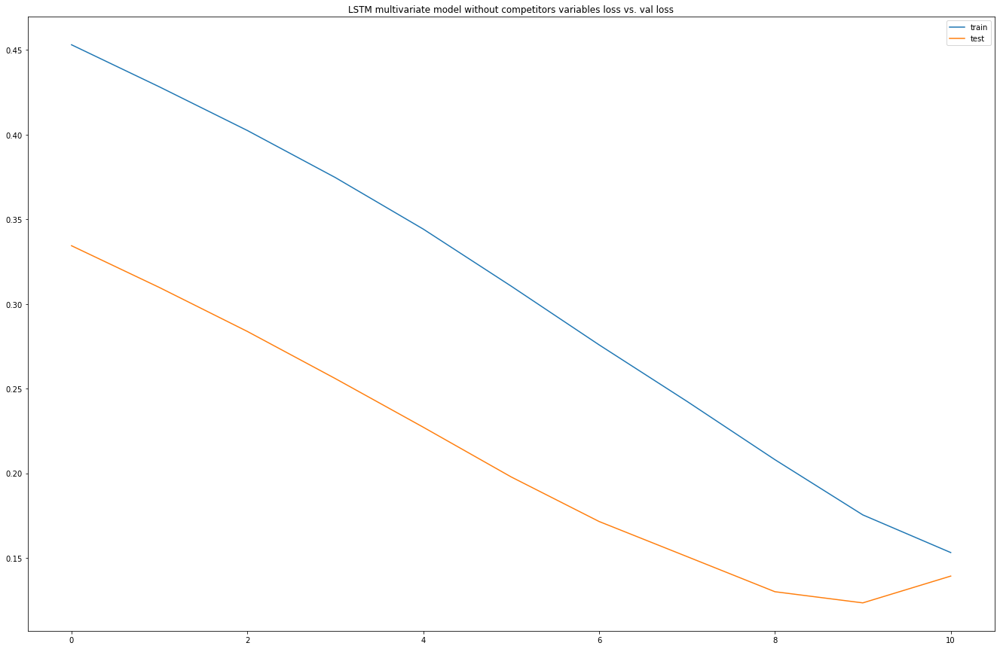

Test RMSE: 1189.137


In [450]:
multivariate_lstm_without_competitor(mcv_dig_250g_own_variable)

### LSTM Multivariate with Competitors'

In [451]:
mcv_dig_250g_with_comp.head()

,Original_Volume,year,quarter,month,week,Volume,£/kg,Distribution,Promotional Distribution,tesco_rt250g_price_kg,tesco_rt250g_distribution,tesco_molly400g_price_kg,tesco_molly400g_distribution,tesco_rt300g_price_kg,tesco_rt300g_distribution,tesco_digs400g_price_kg,tesco_dig400g_distribution
Date,,,,,,,,,,,,,,,,,
2018-11-10,5111.3,2018,4,11,45,4850.3,3.559244,69.0,0.0,2.241567,100.0,0.775123,14.0,0.999896,83.0,1.125344,99.0
2018-11-17,5140.5,2018,4,11,46,5179.0,3.558718,69.0,0.0,2.241541,100.0,0.775011,57.0,0.999892,83.0,1.125224,99.0
2018-11-24,5248.8,2018,4,11,47,5293.5,3.557684,68.0,0.0,2.241566,100.0,0.774954,57.0,0.999978,83.0,1.125292,99.0
2018-12-01,5186.0,2018,4,12,48,5335.8,3.558061,68.0,0.0,2.241457,100.0,0.775021,57.0,0.999962,83.0,1.125552,99.0
2018-12-08,5098.3,2018,4,12,49,5111.3,3.557921,68.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0


In [452]:
def series_to_supervised(data, n_in=4, n_out=1, dropnan=True):
    n_vars = 1 if type(data) is list else data.shape[1]
    df = DataFrame(data)
    cols, names = list(), list()
    # input sequence (t-n, ... t-1)
    for i in range(n_in, 0, -4):
        cols.append(df.shift(i))
        names += [('var%d(t-%d)' % (j+1, i)) for j in range(n_vars)]
    # forecast sequence (t, t+1, ... t+n)
    for i in range(0, n_out):
        cols.append(df.shift(-i))
    if i == 0:
        names += [('var%d(t)' % (j+1)) for j in range(n_vars)]
    else:
        names += [('var%d(t+%d)' % (j+1, i)) for j in range(n_vars)]
  # put it all together
    agg = concat(cols, axis=1)
    agg.columns = names
    # drop rows with NaN values
    if dropnan:
        agg.dropna(inplace=True)
    return agg


In [456]:
def multivariate_with_competitor(df):
    values = df.values
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict
    reframed.drop(reframed.columns[[18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33]], axis=1, inplace=True)
    print(reframed.head())

    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]
    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    model = Sequential()
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(LSTM(100, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM multivariate model with competitors variables loss vs. val loss',loc='center')
    plt.legend()
    plt.show()

    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)


In [457]:
series_to_supervised(mcv_dig_250g_with_comp)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-08,5111.3,2018.0,4.0,11.0,45.0,4850.3,3.559244,69.0,0.0,2.241567,...,68.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0
2018-12-15,5140.5,2018.0,4.0,11.0,46.0,5179.0,3.558718,69.0,0.0,2.241541,...,68.0,0.0,2.241440,100.0,0.774977,58.0,0.999939,83.0,1.125797,99.0
2018-12-22,5248.8,2018.0,4.0,11.0,47.0,5293.5,3.557684,68.0,0.0,2.241566,...,68.0,0.0,2.241489,100.0,0.774914,58.0,0.999886,83.0,1.125535,99.0
2018-12-29,5186.0,2018.0,4.0,12.0,48.0,5335.8,3.558061,68.0,0.0,2.241457,...,69.0,0.0,2.241464,100.0,0.774983,58.0,0.999433,83.0,1.125242,99.0
2019-01-05,5098.3,2018.0,4.0,12.0,49.0,5111.3,3.557921,68.0,0.0,2.241417,...,68.0,0.0,2.241518,100.0,0.774887,58.0,0.999955,83.0,1.125299,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,3320.0,2020.0,1.0,1.0,3.0,4676.5,3.599914,58.0,0.0,2.241395,...,58.0,0.0,2.241691,100.0,0.774992,93.0,0.999908,83.0,1.250209,98.0
2020-02-22,3530.0,2020.0,1.0,1.0,4.0,3255.3,3.599945,58.0,0.0,2.241631,...,58.0,0.0,2.241683,100.0,0.774985,93.0,0.999957,83.0,1.250202,98.0
2020-02-29,3616.3,2020.0,1.0,2.0,5.0,2746.3,3.599752,58.0,0.0,2.241635,...,58.0,0.0,2.241582,100.0,0.774998,93.0,0.999954,83.0,1.250188,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.539031        0.0        1.0   0.909091   0.862745   0.479544   
5   0.545687        0.0        1.0   0.909091   0.882353   0.554461   
6   0.570370        0.0        1.0   0.909091   0.901961   0.580558   
7   0.556057        0.0        1.0   1.000000   0.921569   0.590199   
8   0.536068        0.0        1.0   1.000000   0.941177   0.539031   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.009902   1.000000        0.0    0.994400         1.0    0.980005   
5   0.008719   1.000000        0.0    0.993778         1.0    0.979163   
6   0.006395   0.909091        0.0    0.994396         1.0    0.978738   
7   0.007242   0.909091        0.0    0.991779         1.0    0.979244   
8   0.006927   0.909091        0.0    0.990829         1.0    0.978948   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.136842    0.982941         0.5    0.760128     

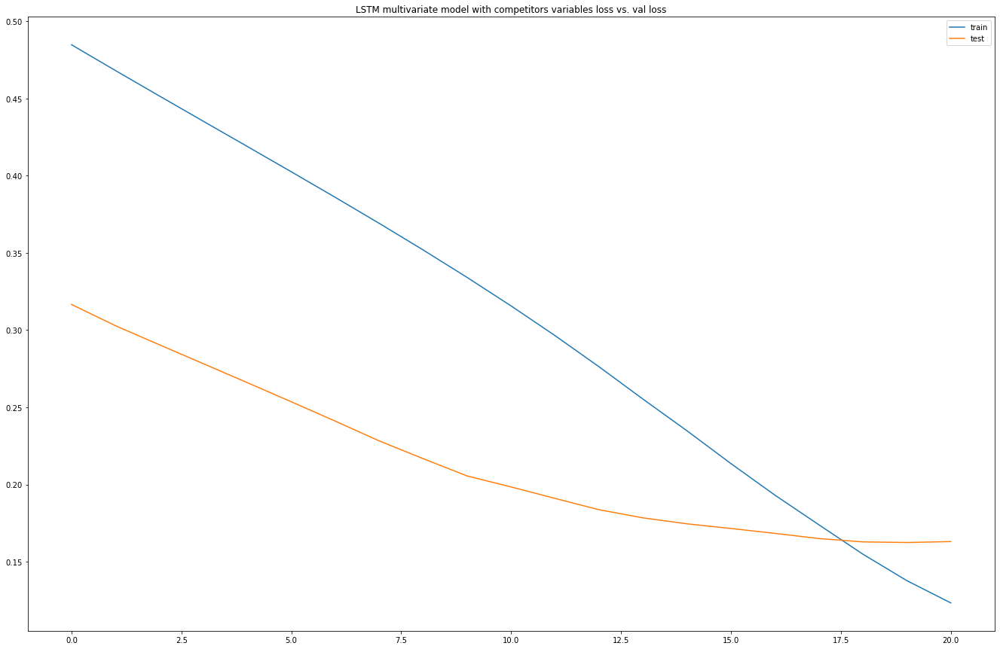

Test RMSE: 897.429


In [458]:
multivariate_with_competitor(mcv_dig_250g_with_comp)

### Tesco Large - McVitie's Digestives 400g

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,78347,39173.5,79616.2,100,0,1.016200,2.032399,2014,4,12,50
1,2014-12-20,83568,41784.0,84988.2,100,0,1.016995,2.033989,2014,4,12,51
2,2014-12-27,68893,34446.5,70350.9,100,0,1.021162,2.042324,2014,4,12,52
3,2015-01-03,51032,25516.0,52059.5,100,0,1.020134,2.040269,2015,1,1,1
4,2015-01-10,57749,28874.5,58890.2,100,0,1.019761,2.039523,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,75168.345455,34708.030182,76682.187636,99.418182,0.0,1.019348,2.219072,2017.083636,2.469091,6.414545,26.043636
std,12253.884201,5818.124410,12669.131085,4.666588,0.0,0.055092,0.260179,1.534371,1.140635,3.547767,15.490223
min,11859.000000,5929.500000,8659.900000,32.000000,0.0,0.688175,1.376351,2014.000000,1.000000,1.000000,1.000000
25%,68407.000000,31948.000000,70161.900000,100.000000,0.0,1.000520,2.001226,2016.000000,1.000000,3.000000,12.000000
50%,74856.000000,34194.500000,77097.200000,100.000000,0.0,1.000696,2.201081,2017.000000,2.000000,6.000000,26.000000
75%,81863.000000,37139.250000,83212.100000,100.000000,0.0,1.030717,2.501570,2018.000000,3.500000,9.500000,39.500000
95%,95479.400000,46621.200000,95618.290000,100.000000,0.0,1.100870,2.501947,2019.000000,4.000000,12.000000,50.000000
99%,103800.840000,48888.840000,107197.874000,100.000000,0.0,1.190843,2.977107,2020.000000,4.000000,12.000000,52.000000
max,111030.000000,53374.000000,112421.200000,100.000000,0.0,1.191022,2.977555,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

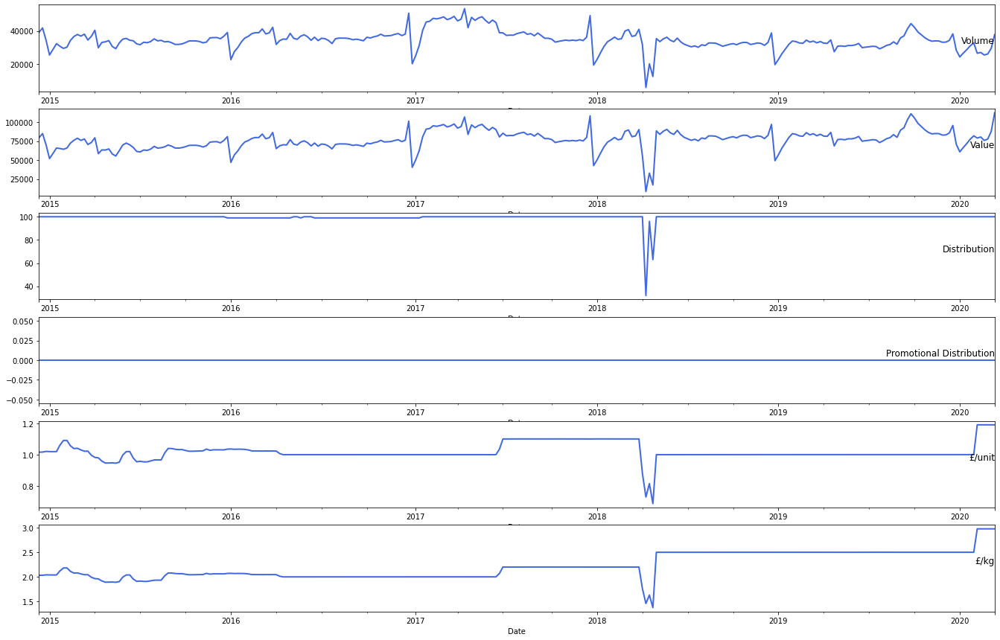

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5353587908>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5353505cc0>)

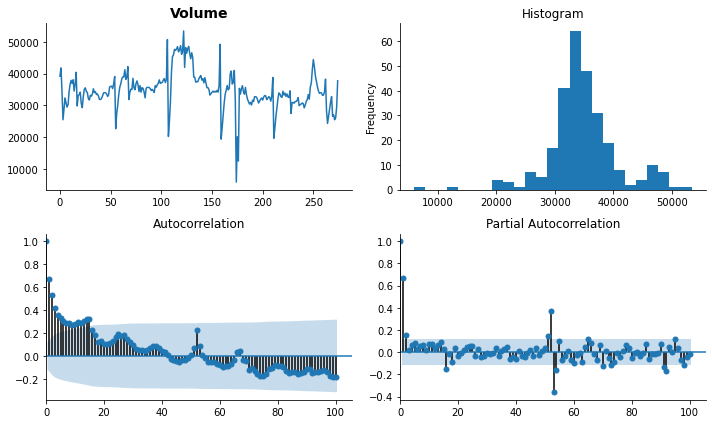

In [459]:
basic_info(mcv_dig_400g_origin)
plot_data(mcv_dig_400g_origin)
tsplot(mcv_dig_400g_origin['Volume'].dropna(), title=mcv_dig_400g_origin.columns[2], lags=100)


Test Statistic                -5.782802e+00
p-value                        5.079624e-07
#Lags Used                     1.000000e+00
Number of Observations Used    2.730000e+02
Critical Value (1%)           -3.454533e+00
Critical Value (5%)           -2.872186e+00
Critical Value (10%)          -2.572443e+00
dtype: float64


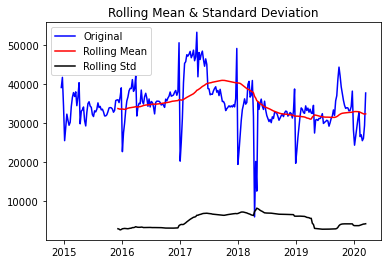

In [460]:
plot(mcv_dig_400g_origin)


(<matplotlib.axes._subplots.AxesSubplot at 0x7f53533b8780>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53532d0c18>)

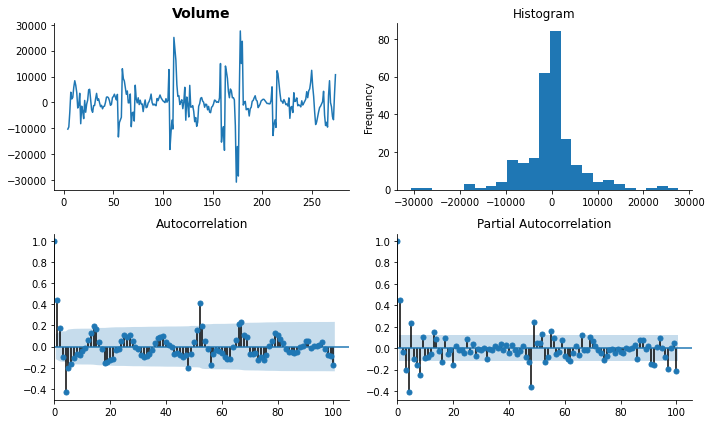

In [461]:
series_transformed=mcv_dig_400g_origin.copy()
series_transformed['Volume_transformed']=mcv_dig_400g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_dig_400g_origin.columns[2], lags=100)


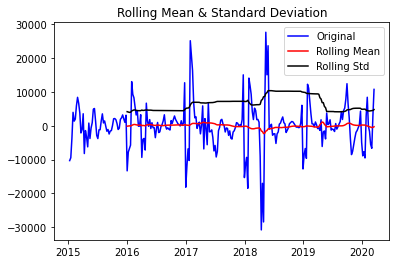

Results of Dickey-Fuller Test:
Test Statistic                  -4.204195
p-value                          0.000648
#Lags Used                      16.000000
Number of Observations Used    254.000000
Critical Value (1%)             -3.456360
Critical Value (5%)             -2.872987
Critical Value (10%)            -2.572870
dtype: float64


In [462]:
plot_transform(mcv_dig_400g_origin)

       t-4      t+1
0      NaN  39173.5
1      NaN  41784.0
2      NaN  34446.5
3      NaN  25516.0
4  39173.5  28874.5
Test MSE: 21256610.700
Test RMSE: 4610.489


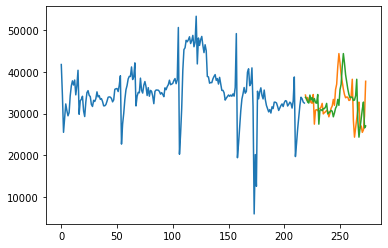

Observations: 271
Training Observations: 216
Testing Observations: 55


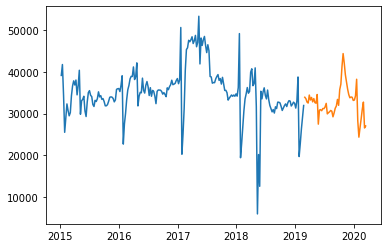

RMSE for Simple Exponential Smoothing α= 0.1 is: 4457.08
RMSE for Simple Exponential Smoothing α= 0.2 is: 5019.66
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 5213.61
RMSE for Simple Exponential Smoothing α= 0.4 is: 5097.04
RMSE for Simple Exponential Smoothing α= 0.5 is: 4815.19
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 4496.78
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 4223.07
RMSE for Simple Exponential Smoothing α= 0.8 is: 4024.97
RMSE for Simple Exponential Smoothing α= 0.9 is: 3897.46


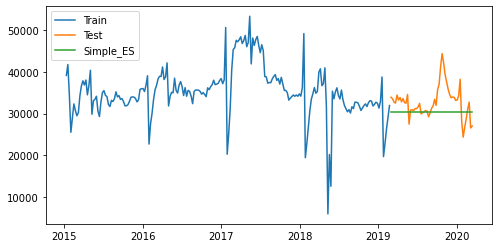

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.7000000000000001 and β= 0.1 is: 3936.74


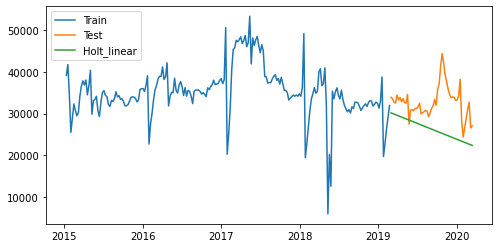

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/holtwinters.py:744: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/

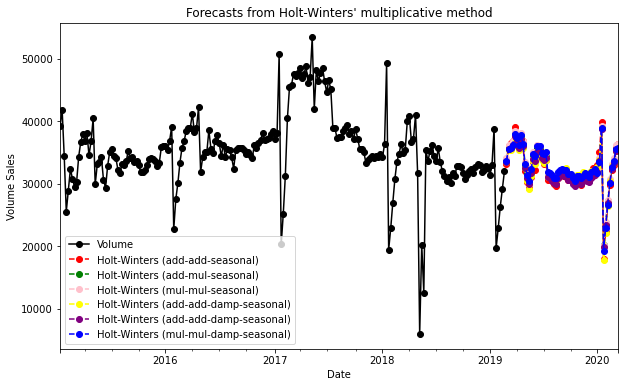

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
4740.254302263319
4688.694204401072
4746.067553672114
4378.859902874493
4647.796074966063
4552.730591435354


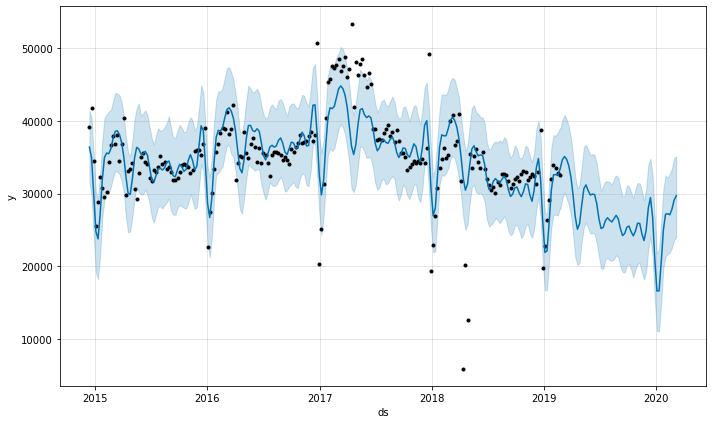

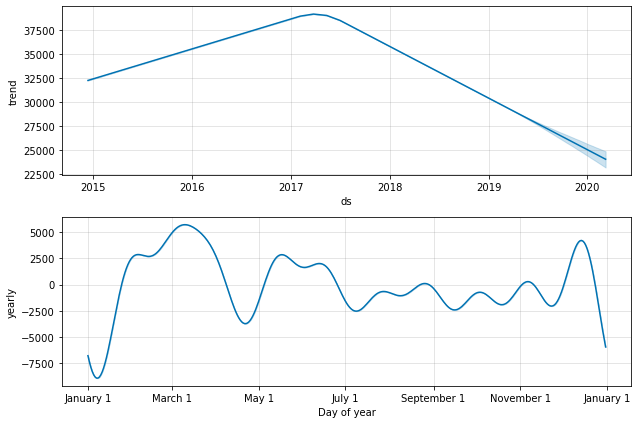

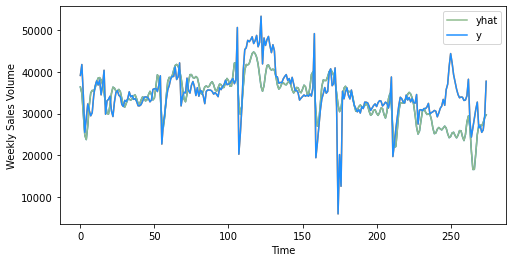

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 5048.407437410792
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

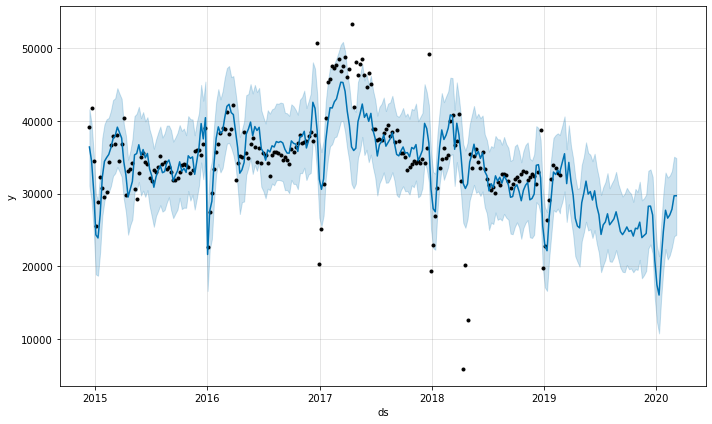

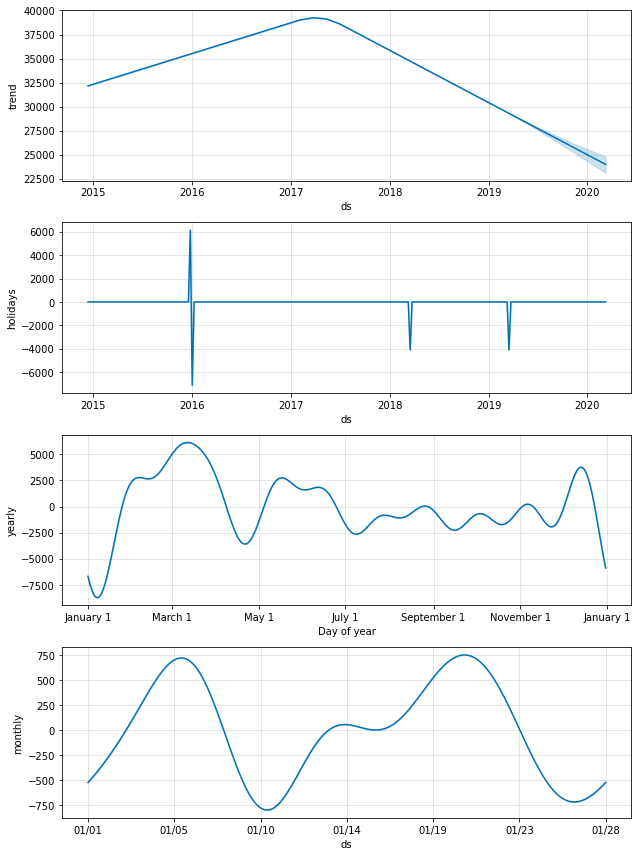

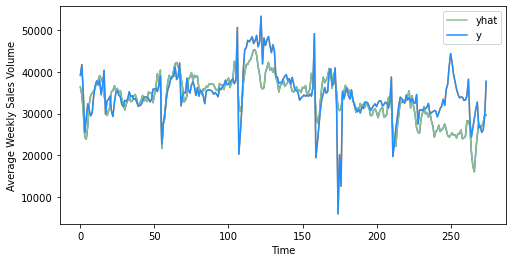

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 5018.66605801729


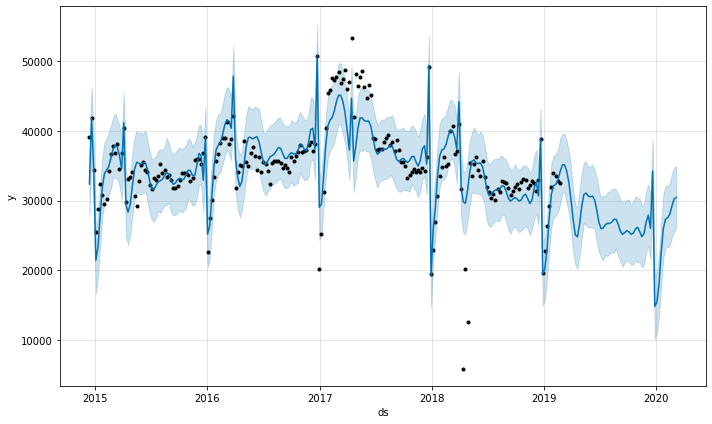

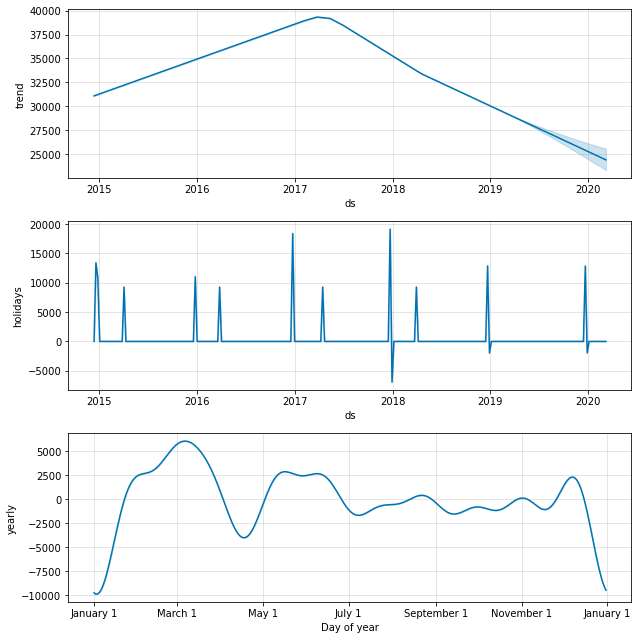

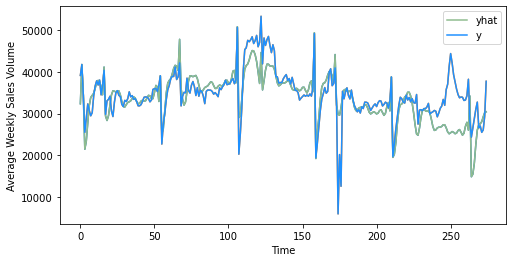

RMSE for prophet with only Christmas and Easter week is: 4539.676911106004


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [463]:
#time series models
baseline_model(mcv_dig_400g_origin)
ses_model(mcv_dig_400g_origin)
holt_linear_model(mcv_dig_400g_origin)
holt_winter_model(mcv_dig_400g_origin)
prophet_model(mcv_dig_400g_origin)
prophet_all_holidays(mcv_dig_400g_origin)
prophet_two_holiday(mcv_dig_400g_origin)


Observations: 27
Training Observations: 16
Testing Observations: 11
[-8.41846676e-02 -2.40844408e+01 -8.15495892e+00 -4.40488250e+02
 -4.03632030e+01]
Mean Absolute Error: 3018.4454545454555
Mean Squared Error: 10613060.989345469
Root Mean Squared Error: 3257.7693272153983
Observations: 38
Training Observations: 27
Testing Observations: 11
[ -6.40904298 -76.03210956 -15.81560672   0.3930883   -0.45645954]
Mean Absolute Error: 726.2636363636349
Mean Squared Error: 800893.6773454524
Root Mean Squared Error: 894.9266323813658
Observations: 49
Training Observations: 38
Testing Observations: 11
[ -0.67196859 -14.5925147   -0.35996943  -1.43669971 -17.84089077]
Mean Absolute Error: 5885.39090909091
Mean Squared Error: 54865112.44214547
Root Mean Squared Error: 7407.098787119385
Observations: 60
Training Observations: 49
Testing Observations: 11
[-4.80540681 -0.47036256 -1.36277962  0.08665018 -3.09411012]
Mean Absolute Error: 3464.792727272728
Mean Squared Error: 18749945.98000002
Root Mean 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide



,var1(t-4),var1(t)
Date,,
2015-01-10,39173.5,28874.5
2015-01-17,41784.0,32329.0
2015-01-24,34446.5,30754.0
2015-01-31,25516.0,29475.5
2015-02-07,28874.5,30237.0
...,...,...
2020-02-15,28730.4,27026.8
2020-02-22,31036.0,25507.2
2020-02-29,32767.6,26099.6


   var1(t-4)   var1(t)
4   0.700692  0.483618
5   0.755715  0.556429
6   0.601060  0.523232
7   0.412830  0.496285
8   0.483618  0.512336
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 26s - loss: 0.6195 - val_loss: 0.5523
Epoch 2/50
216/216 - 0s - loss: 0.6066 - val_loss: 0.5395
Epoch 3/50
216/216 - 0s - loss: 0.5936 - val_loss: 0.5265
Epoch 4/50
216/216 - 0s - loss: 0.5802 - val_loss: 0.5131
Epoch 5/50
216/216 - 0s - loss: 0.5663 - val_loss: 0.4989
Epoch 6/50
216/216 - 0s - loss: 0.5516 - val_loss: 0.4840
Epoch 7/50
216/216 - 0s - loss: 0.5361 - val_loss: 0.4680
Epoch 8/50
216/216 - 0s - loss: 0.5195 - val_loss: 0.4509
Epoch 9/50
216/216 - 0s - loss: 0.5016 - val_loss: 0.4325
Epoch 10/50
216/216 - 0s - loss: 0.4824 - val_loss: 0.4125
Epoch 11/50
216/216 - 0s - loss: 0.4616 - val_loss: 0.3908
Epoch 12/50
216/216 - 0s - loss: 0.4389 - val_loss: 0.3670
Epoch 13/50
216/216 - 0s - loss: 0.4142 - val_loss: 0.3410
Epoch 14/50
216/216 - 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:46: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

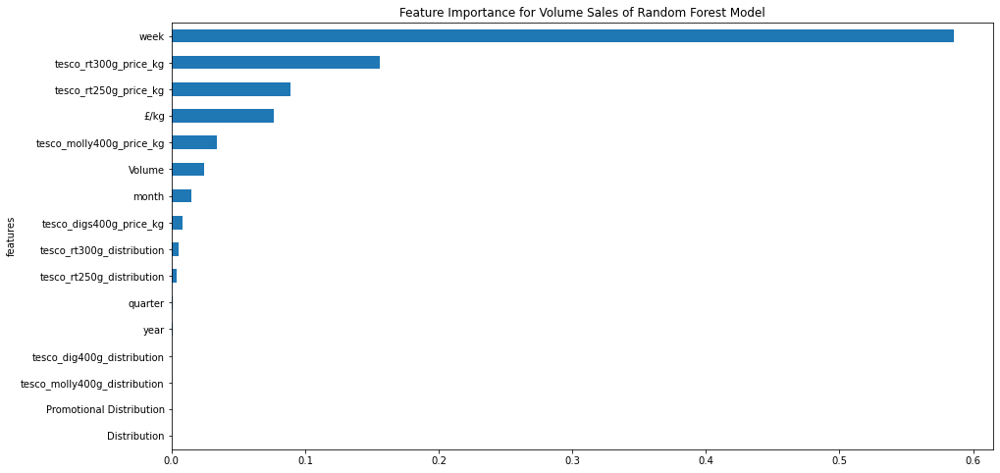

<Figure size 432x288 with 0 Axes>

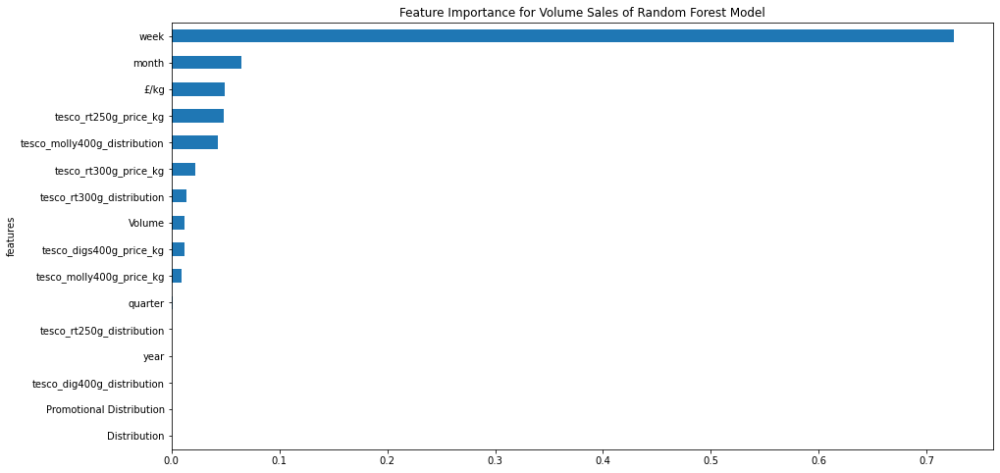

<Figure size 432x288 with 0 Axes>

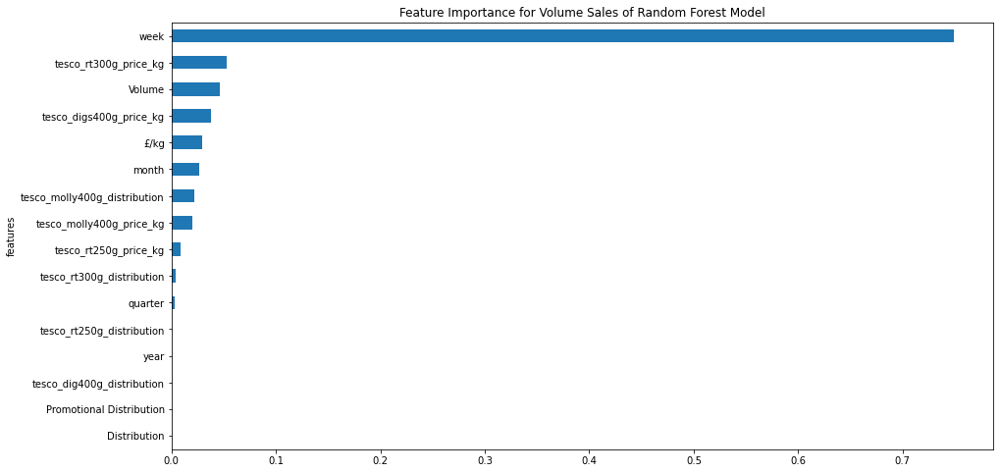

<Figure size 432x288 with 0 Axes>

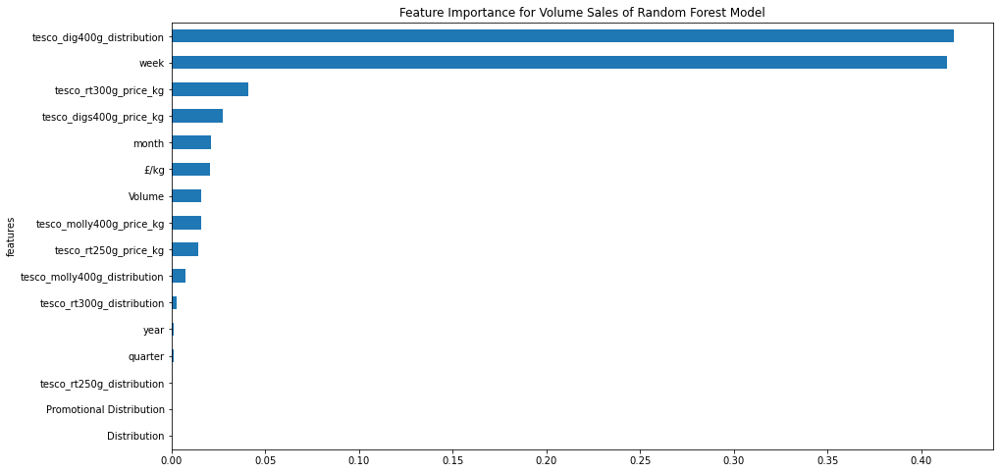

<Figure size 432x288 with 0 Axes>

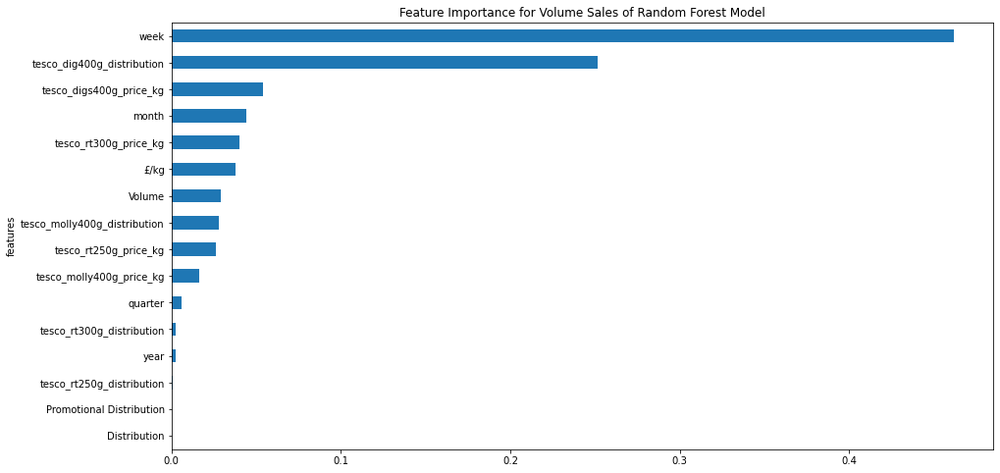

<Figure size 432x288 with 0 Axes>

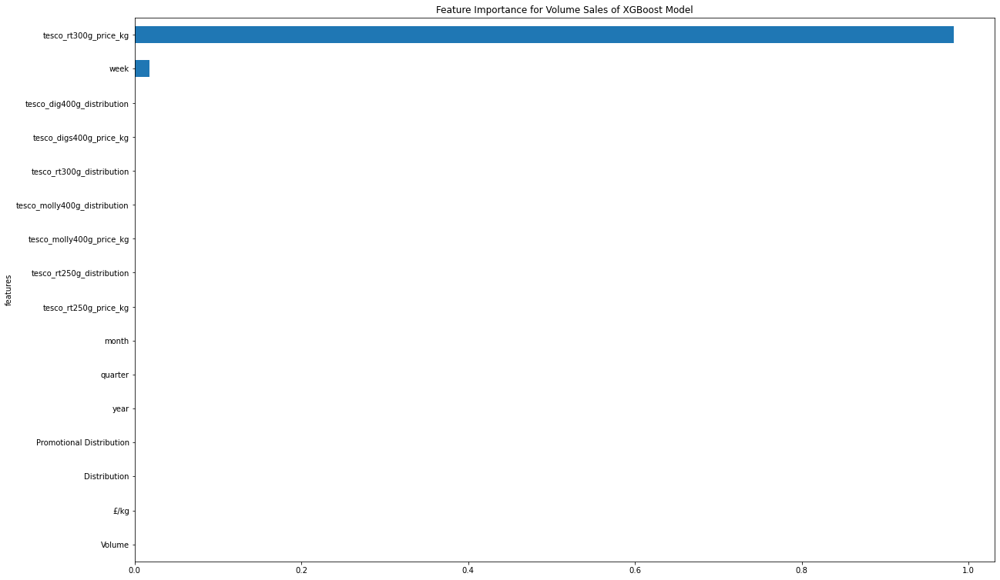

<Figure size 432x288 with 0 Axes>

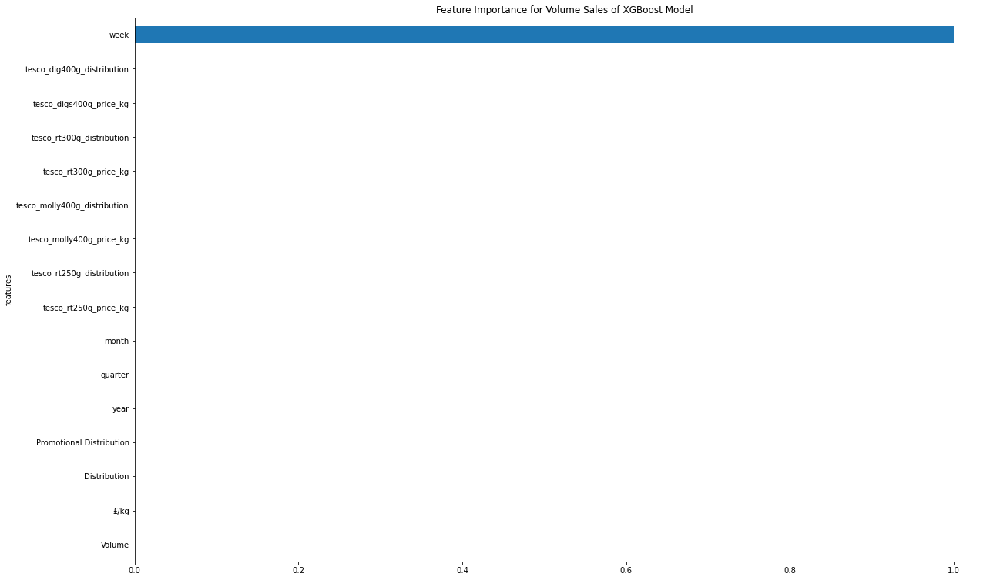

<Figure size 432x288 with 0 Axes>

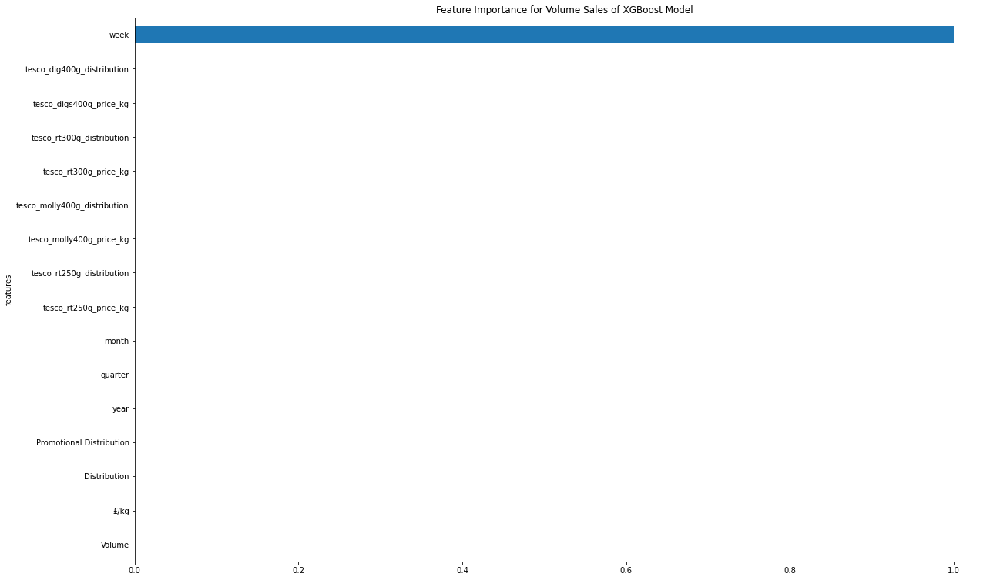

<Figure size 432x288 with 0 Axes>

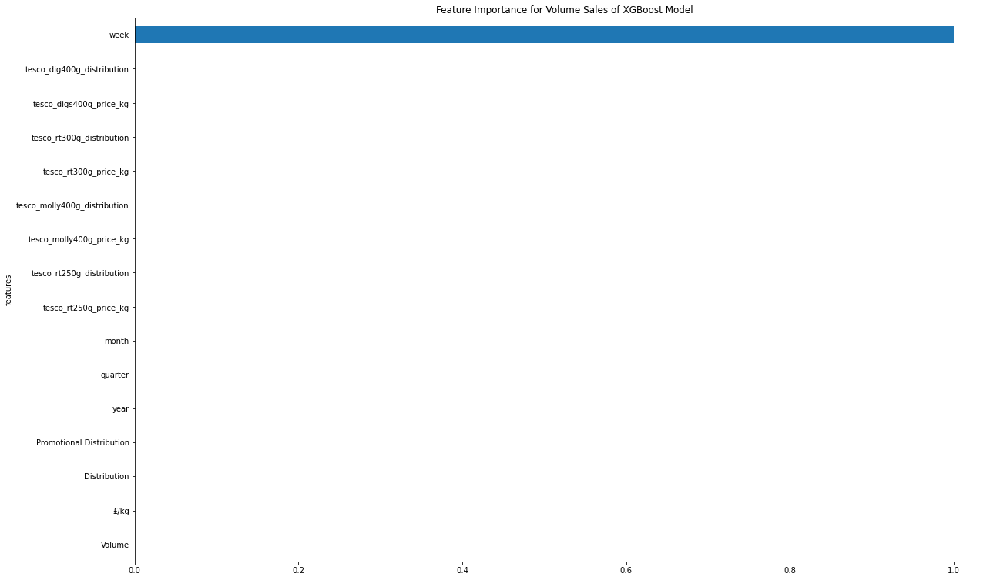

<Figure size 432x288 with 0 Axes>

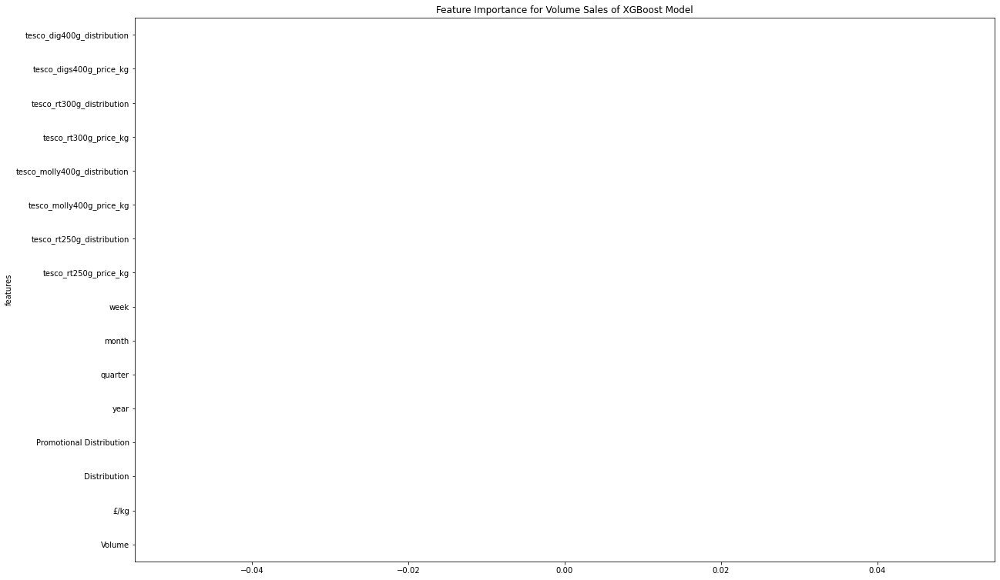

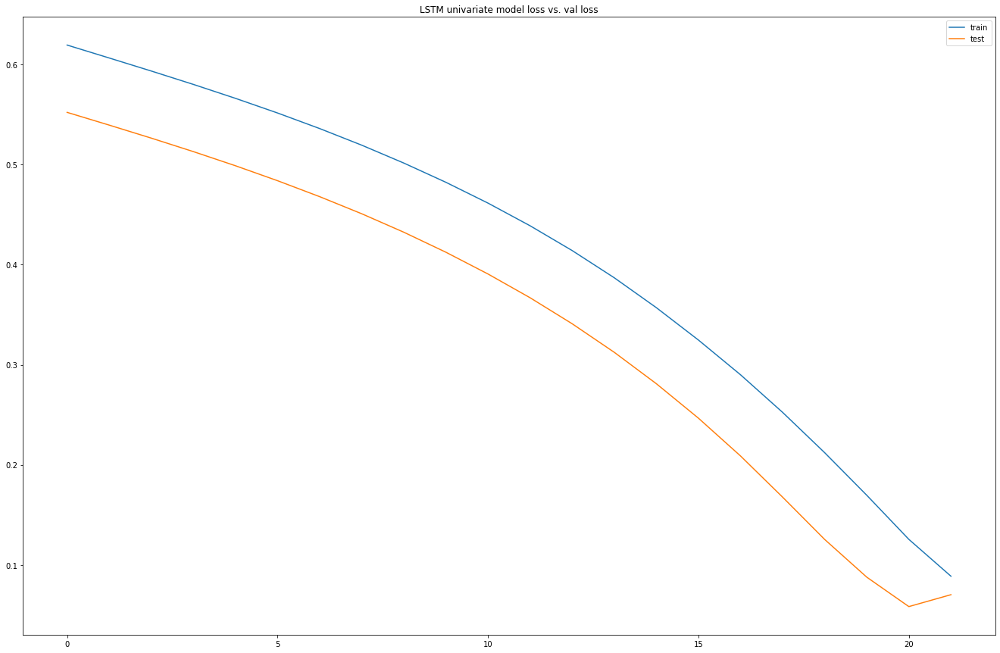

Test RMSE: 4204.189


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,39173.5,2.032399,100.0,0.0,2014.0,4.0,12.0,50.0,28874.5,2.039523,100,0,2015,1,1,2
2015-01-17,41784.0,2.033989,100.0,0.0,2014.0,4.0,12.0,51.0,32329.0,2.040478,100,0,2015,1,1,3
2015-01-24,34446.5,2.042324,100.0,0.0,2014.0,4.0,12.0,52.0,30754.0,2.123438,100,0,2015,1,1,4
2015-01-31,25516.0,2.040269,100.0,0.0,2015.0,1.0,1.0,1.0,29475.5,2.182389,100,0,2015,1,1,5
2015-02-07,28874.5,2.039523,100.0,0.0,2015.0,1.0,1.0,2.0,30237.0,2.182429,100,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,28730.4,2.502099,100.0,0.0,2020.0,1.0,1.0,3.0,27026.8,2.977519,100,0,2020,1,2,7
2020-02-22,31036.0,2.501775,100.0,0.0,2020.0,1.0,1.0,4.0,25507.2,2.977555,100,0,2020,1,2,8
2020-02-29,32767.6,2.501675,100.0,0.0,2020.0,1.0,2.0,5.0,26099.6,2.977099,100,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.700692   0.409722        1.0        0.0   0.000000        1.0   
5   0.755715   0.410715        1.0        0.0   0.000000        1.0   
6   0.601060   0.415920        1.0        0.0   0.000000        1.0   
7   0.412830   0.414637        1.0        0.0   0.166656        0.0   
8   0.483618   0.414171        1.0        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.483618  
5        1.0   0.961538  0.556429  
6        1.0   0.980769  0.523232  
7        0.0   0.000000  0.496285  
8        0.0   0.019231  0.512336  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 26s - loss: 0.5996 - val_loss: 0.5182
Epoch 2/50
216/216 - 0s - loss: 0.5711 - val_loss: 0.4858
Epoch 3/50
216/216 - 0s - loss: 0.5406 - val_loss: 0.4502
Epoch 4/50
216/216 - 0s - loss: 0.5071 - val_loss: 0.4102
Epoch 5/50
216/216 - 0s - loss: 0.4693 - va

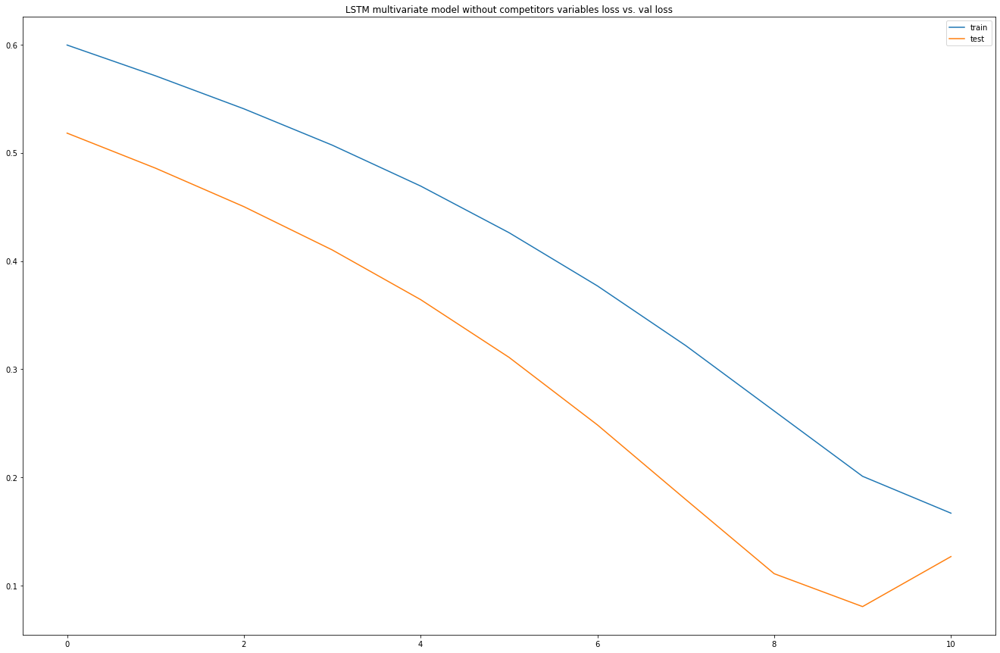

Test RMSE: 7481.971


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-08,31830.0,2018.0,4.0,11.0,45.0,31698.0,2.501574,100.0,0.0,2.241567,...,100.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0
2018-12-15,32221.6,2018.0,4.0,11.0,46.0,32629.2,2.501698,100.0,0.0,2.241541,...,100.0,0.0,2.241440,100.0,0.774977,58.0,0.999939,83.0,1.125797,99.0
2018-12-22,32756.0,2018.0,4.0,11.0,47.0,33110.0,2.501824,100.0,0.0,2.241566,...,100.0,0.0,2.241489,100.0,0.774914,58.0,0.999886,83.0,1.125535,99.0
2018-12-29,32465.6,2018.0,4.0,12.0,48.0,33014.8,2.501599,100.0,0.0,2.241457,...,100.0,0.0,2.241464,100.0,0.774983,58.0,0.999433,83.0,1.125242,99.0
2019-01-05,31333.2,2018.0,4.0,12.0,49.0,31830.0,2.501929,100.0,0.0,2.241417,...,100.0,0.0,2.241518,100.0,0.774887,58.0,0.999955,83.0,1.125299,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,28730.4,2020.0,1.0,1.0,3.0,38250.4,2.501561,100.0,0.0,2.241395,...,100.0,0.0,2.241691,100.0,0.774992,93.0,0.999908,83.0,1.250209,98.0
2020-02-22,31036.0,2020.0,1.0,1.0,4.0,28294.0,2.501633,100.0,0.0,2.241631,...,100.0,0.0,2.241683,100.0,0.774985,93.0,0.999957,83.0,1.250202,98.0
2020-02-29,32767.6,2020.0,1.0,2.0,5.0,24353.6,2.502004,100.0,0.0,2.241635,...,100.0,0.0,2.241582,100.0,0.774998,93.0,0.999954,83.0,1.250188,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.490978        0.0        1.0   0.909091   0.862745   0.485638   
5   0.506821        0.0        1.0   0.909091   0.882353   0.523311   
6   0.528441        0.0        1.0   0.909091   0.901961   0.542762   
7   0.516692        0.0        1.0   1.000000   0.921569   0.538911   
8   0.470879        0.0        1.0   1.000000   0.941177   0.490978   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.000514        0.0        0.0    0.994400         1.0    0.980005   
5   0.000773        0.0        0.0    0.993778         1.0    0.979163   
6   0.001039        0.0        0.0    0.994396         1.0    0.978738   
7   0.000566        0.0        0.0    0.991779         1.0    0.979244   
8   0.001259        0.0        0.0    0.990829         1.0    0.978948   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.136842    0.982941         0.5    0.760128     

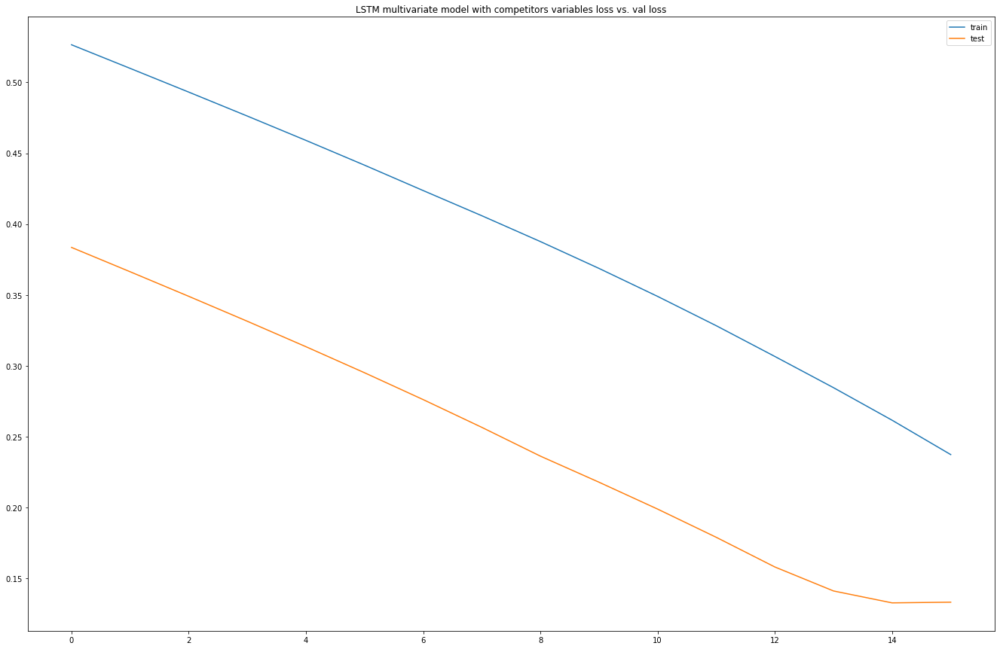

Test RMSE: 4492.536


In [464]:
#ml models
mcv_dig_400g_with_comp=variable_lag(mcv_dig_400g_with_comp)
mcv_dig_400g_input_X,mcv_dig_400g_input_Y=input_var(mcv_dig_400g_with_comp)
rf_regressor_mcv(mcv_dig_400g_input_X,mcv_dig_400g_input_Y)

mcv_dig_400g_input_X,mcv_dig_400g_input_Y=input_var(mcv_dig_400g_with_comp)
xgb_regressor_mcv(mcv_dig_400g_input_X,mcv_dig_400g_input_Y)

#lstm models
series_to_supervised(mcv_dig_400g_volume)
lstm_univariate(mcv_dig_400g_volume)

series_to_supervised(mcv_dig_400g_own_variable)
multivariate_lstm_without_competitor(mcv_dig_400g_own_variable)

series_to_supervised(mcv_dig_400g_with_comp)
multivariate_with_competitor(mcv_dig_400g_with_comp)

### Tesco Large - McVitie's Digestives 400g Twin Pack

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,40945,40945.0,77372.6,96,0,1.889672,1.889672,2014,4,12,50
1,2014-12-20,43265,43265.0,81754.1,96,0,1.889613,1.889613,2014,4,12,51
2,2014-12-27,34195,34195.0,64618.4,96,0,1.889703,1.889703,2014,4,12,52
3,2015-01-03,26667,26667.0,50390.0,96,0,1.889601,1.889601,2015,1,1,1
4,2015-01-10,31957,31957.0,60388.8,96,0,1.889689,1.889689,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,36779.381818,33916.016727,69716.069455,94.858182,0.0,1.896369,2.067643,2017.083636,2.469091,6.414545,26.043636
std,6871.435738,6245.329915,12820.214358,8.254941,0.0,0.082345,0.250159,1.534371,1.140635,3.547767,15.490223
min,6129.000000,6129.000000,8001.000000,23.000000,0.0,1.305433,1.305433,2014.000000,1.000000,1.000000,1.000000
25%,33385.500000,30186.900000,62796.650000,97.000000,0.0,1.889671,1.889799,2016.000000,1.000000,3.000000,12.000000
50%,37153.000000,33301.000000,70816.300000,98.000000,0.0,1.889863,1.890073,2017.000000,2.000000,6.000000,26.000000
75%,39870.500000,37904.500000,75634.250000,98.000000,0.0,1.890003,2.362057,2018.000000,3.500000,9.500000,39.500000
95%,45736.900000,42645.840000,85332.960000,98.000000,0.0,1.989909,2.362570,2019.000000,4.000000,12.000000,50.000000
99%,61387.080000,54761.120000,101580.580000,98.000000,0.0,1.989997,2.487385,2020.000000,4.000000,12.000000,52.000000
max,78414.000000,63655.000000,156042.300000,98.000000,0.0,2.612341,3.265426,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

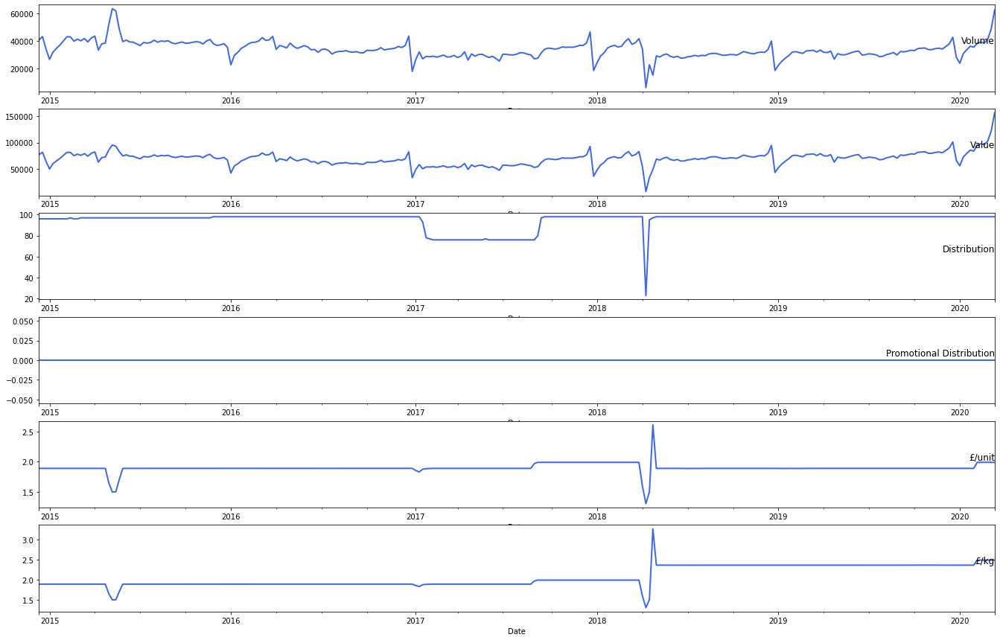

(<matplotlib.axes._subplots.AxesSubplot at 0x7f534dae27f0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f534da4f908>)

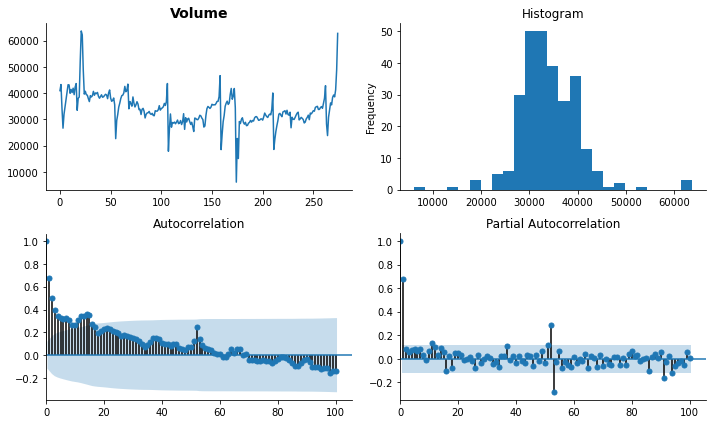

In [465]:
basic_info(mcv_dig_400g_twin_origin)
plot_data(mcv_dig_400g_twin_origin)
tsplot(mcv_dig_400g_twin_origin['Volume'].dropna(), title=mcv_dig_400g_twin_origin.columns[2], lags=100)


Test Statistic                  -4.984032
p-value                          0.000024
#Lags Used                       1.000000
Number of Observations Used    273.000000
Critical Value (1%)             -3.454533
Critical Value (5%)             -2.872186
Critical Value (10%)            -2.572443
dtype: float64


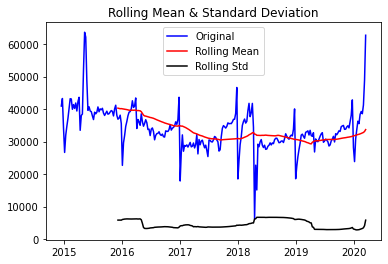

(<matplotlib.axes._subplots.AxesSubplot at 0x7f534d8ebfd0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f534d81bcf8>)

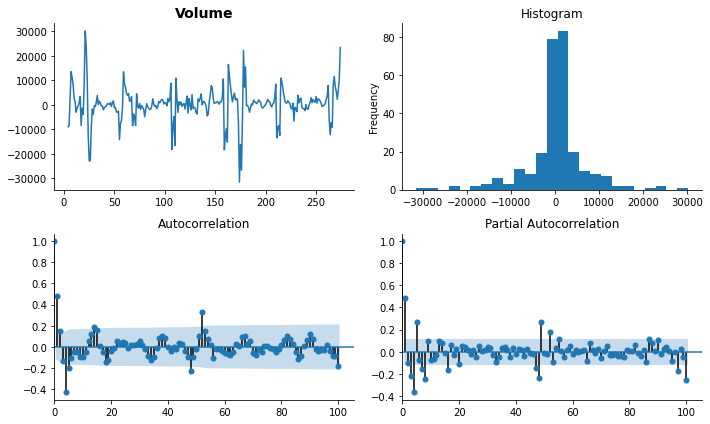

In [466]:
plot(mcv_dig_400g_twin_origin)
series_transformed=mcv_dig_400g_twin_origin.copy()
series_transformed['Volume_transformed']=mcv_dig_400g_twin_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_dig_400g_twin_origin.columns[2], lags=100)


       t-4      t+1
0      NaN  40945.0
1      NaN  43265.0
2      NaN  34195.0
3      NaN  26667.0
4  40945.0  31957.0
Test MSE: 28107875.025
Test RMSE: 5301.686


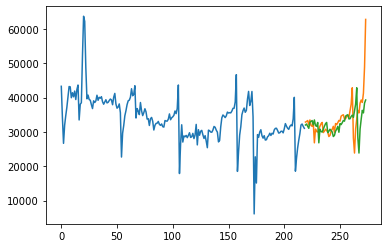

Observations: 271
Training Observations: 216
Testing Observations: 55


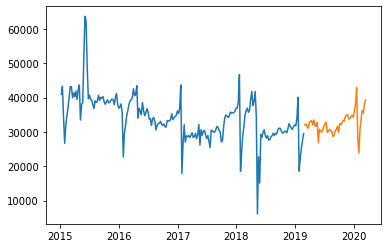

RMSE for Simple Exponential Smoothing α= 0.1 is: 4456.27
RMSE for Simple Exponential Smoothing α= 0.2 is: 5147.54
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 5569.53
RMSE for Simple Exponential Smoothing α= 0.4 is: 5644.07
RMSE for Simple Exponential Smoothing α= 0.5 is: 5475.02
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 5189.69
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 4886.86
RMSE for Simple Exponential Smoothing α= 0.8 is: 4623.2
RMSE for Simple Exponential Smoothing α= 0.9 is: 4417.18


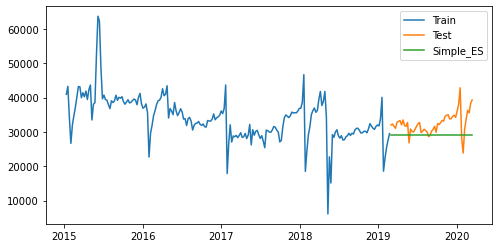

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.8 and β= 0.2 is: 3515.79


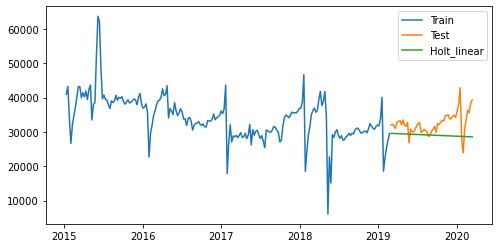

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

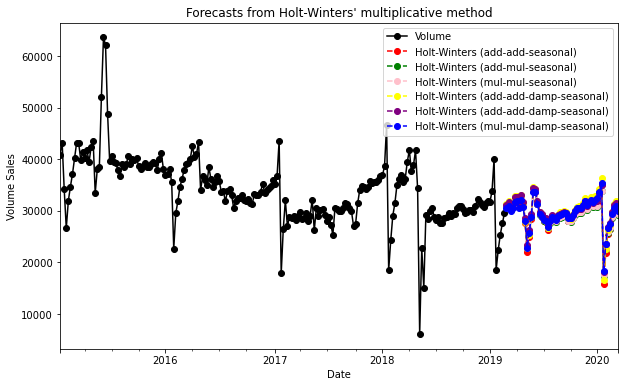

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
4346.697423285409
4435.403778979445
4340.611526047391
3801.284710608994
3790.337945842033
3924.05542609741


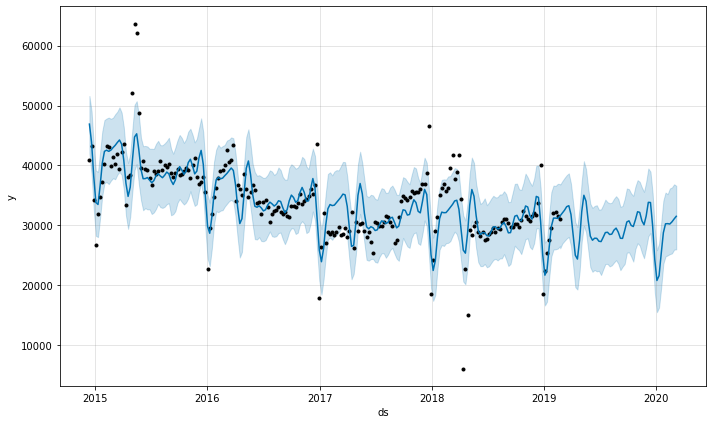

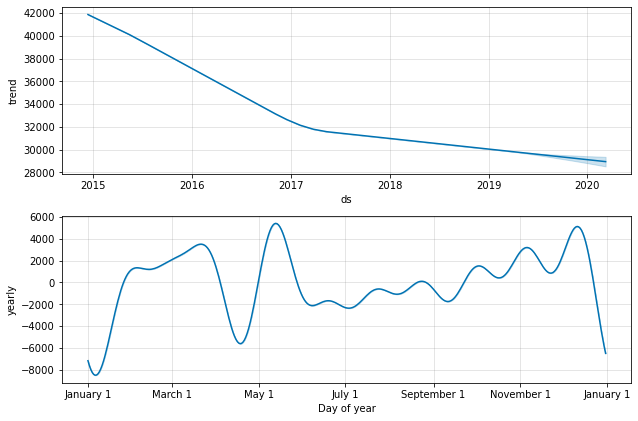

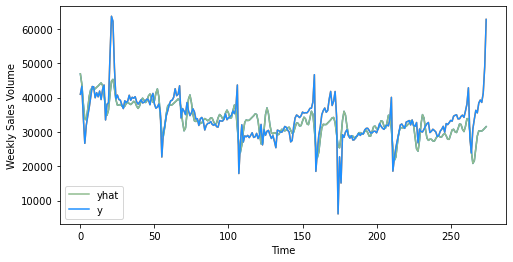

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 4809.125119002391
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

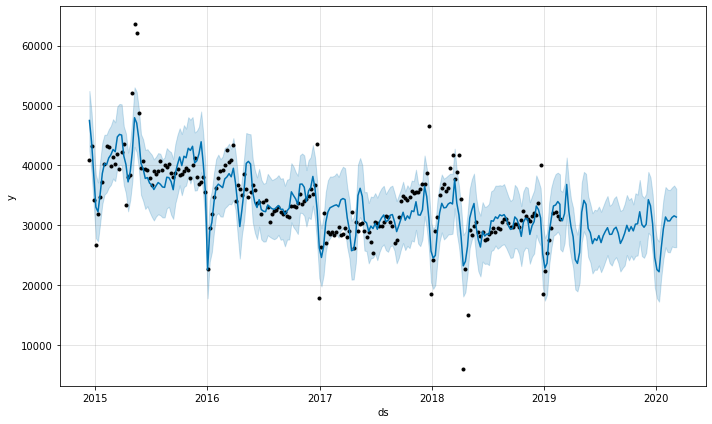

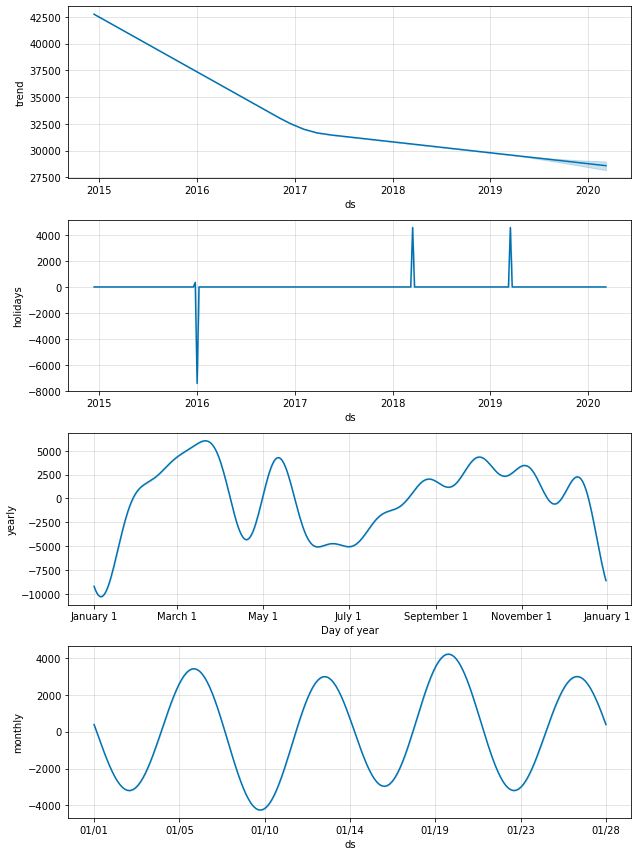

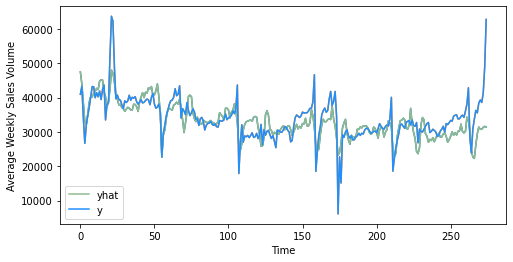

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 4660.077417121858


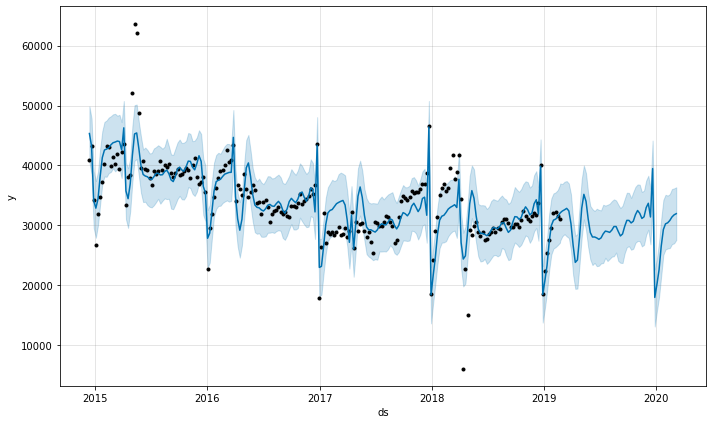

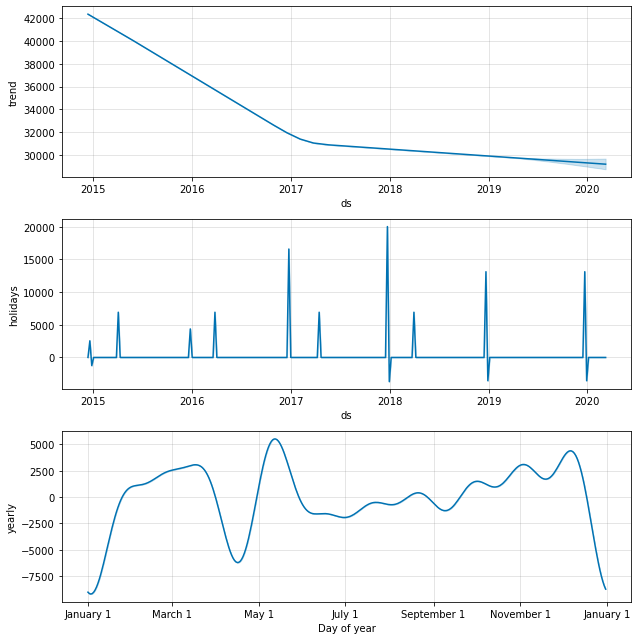

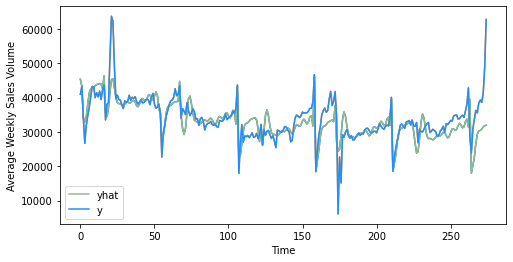

RMSE for prophet with only Christmas and Easter week is: 4469.4766106058


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [467]:
#time series models
baseline_model(mcv_dig_400g_twin_origin)
ses_model(mcv_dig_400g_twin_origin)
holt_linear_model(mcv_dig_400g_twin_origin)
holt_winter_model(mcv_dig_400g_twin_origin)
prophet_model(mcv_dig_400g_twin_origin)
prophet_all_holidays(mcv_dig_400g_twin_origin)
prophet_two_holiday(mcv_dig_400g_twin_origin)

Observations: 27
Training Observations: 16
Testing Observations: 11
[-3.13091734e-02 -3.84407944e+01 -1.22847487e+01 -3.13869685e+02
 -6.72735458e+00]
Mean Absolute Error: 5188.4436363636405
Mean Squared Error: 34920478.50560005
Root Mean Squared Error: 5909.355168341132
Observations: 38
Training Observations: 27
Testing Observations: 11
[ -9.96300828  -6.99710384 -36.86825352 -11.99107066  -0.4762059 ]
Mean Absolute Error: 1522.6618181818171
Mean Squared Error: 2962374.5864727255
Root Mean Squared Error: 1721.1550152362004
Observations: 49
Training Observations: 38
Testing Observations: 11
[ -1.95114416 -26.12739926   0.10870102  -0.06749964 -14.50357447]
Mean Absolute Error: 1674.279999999999
Mean Squared Error: 3696108.6869818154
Root Mean Squared Error: 1922.5266414231598
Observations: 60
Training Observations: 49
Testing Observations: 11
[-3.0244139  -1.95439915 -1.09319649 -4.33545319 -2.02036279]
Mean Absolute Error: 4789.392727272727
Mean Squared Error: 26286910.295418177
Root 

,var1(t-4),var1(t)
Date,,
2015-01-10,40945.0,31957.0
2015-01-17,43265.0,34705.0
2015-01-24,34195.0,37172.0
2015-01-31,26667.0,40222.0
2015-02-07,31957.0,43199.0
...,...,...
2020-02-15,33702.4,39277.6
2020-02-22,36274.4,38577.6
2020-02-29,35528.8,41269.6


   var1(t-4)   var1(t)
4   0.605222  0.448980
5   0.645552  0.496749
6   0.487884  0.539634
7   0.357021  0.592654
8   0.448980  0.644404
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 27s - loss: 0.4745 - val_loss: 0.4612
Epoch 2/50
216/216 - 0s - loss: 0.4615 - val_loss: 0.4481
Epoch 3/50
216/216 - 0s - loss: 0.4483 - val_loss: 0.4347
Epoch 4/50
216/216 - 0s - loss: 0.4346 - val_loss: 0.4208
Epoch 5/50
216/216 - 0s - loss: 0.4204 - val_loss: 0.4062
Epoch 6/50
216/216 - 0s - loss: 0.4055 - val_loss: 0.3908
Epoch 7/50
216/216 - 0s - loss: 0.3897 - val_loss: 0.3745
Epoch 8/50
216/216 - 0s - loss: 0.3728 - val_loss: 0.3569
Epoch 9/50
216/216 - 0s - loss: 0.3547 - val_loss: 0.3380
Epoch 10/50
216/216 - 0s - loss: 0.3353 - val_loss: 0.3175
Epoch 11/50
216/216 - 0s - loss: 0.3143 - val_loss: 0.2953
Epoch 12/50
216/216 - 0s - loss: 0.2914 - val_loss: 0.2710
Epoch 13/50
216/216 - 0s - loss: 0.2669 - val_loss: 0.2446
Epoch 14/50
216/216 - 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:46: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

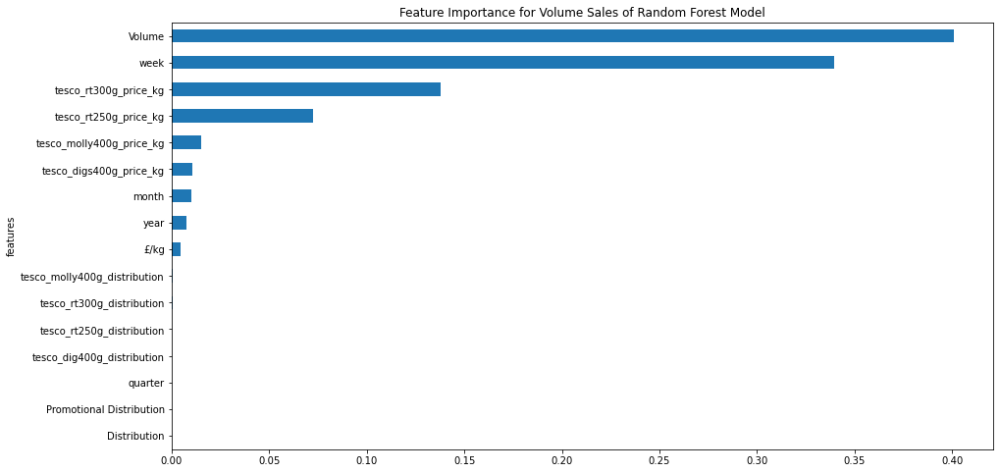

<Figure size 432x288 with 0 Axes>

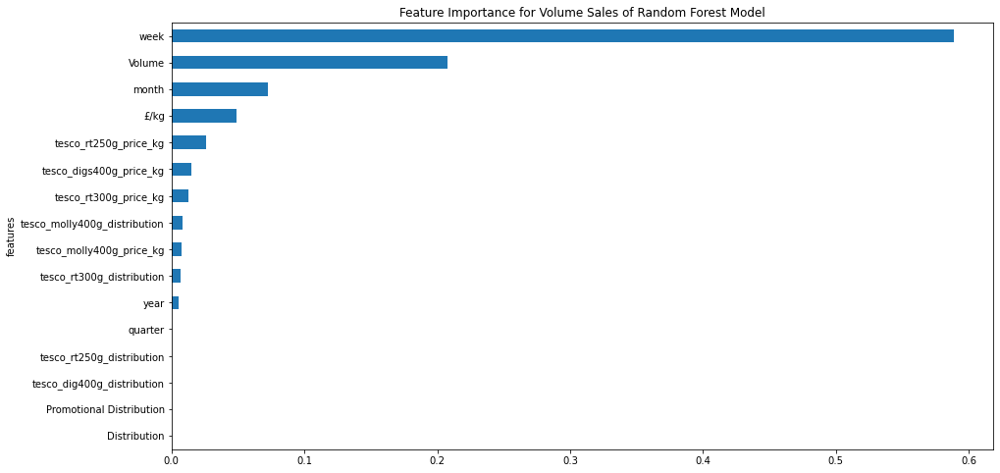

<Figure size 432x288 with 0 Axes>

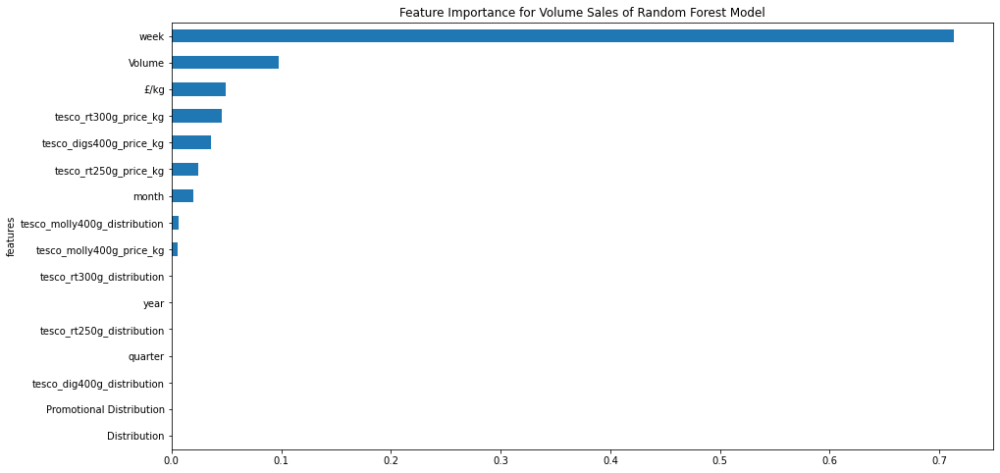

<Figure size 432x288 with 0 Axes>

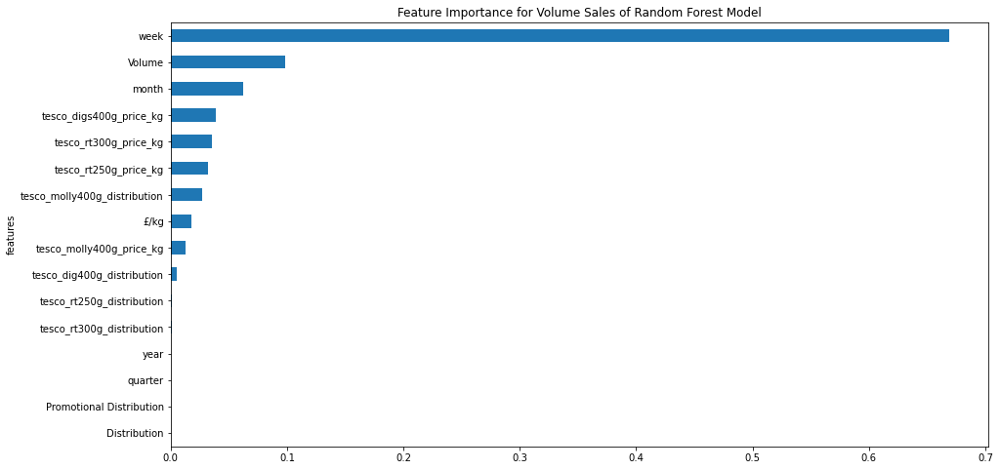

<Figure size 432x288 with 0 Axes>

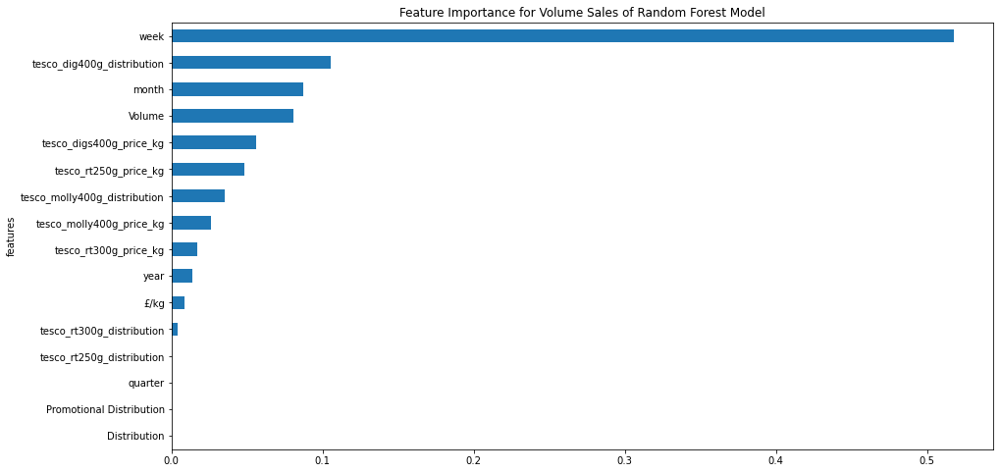

<Figure size 432x288 with 0 Axes>

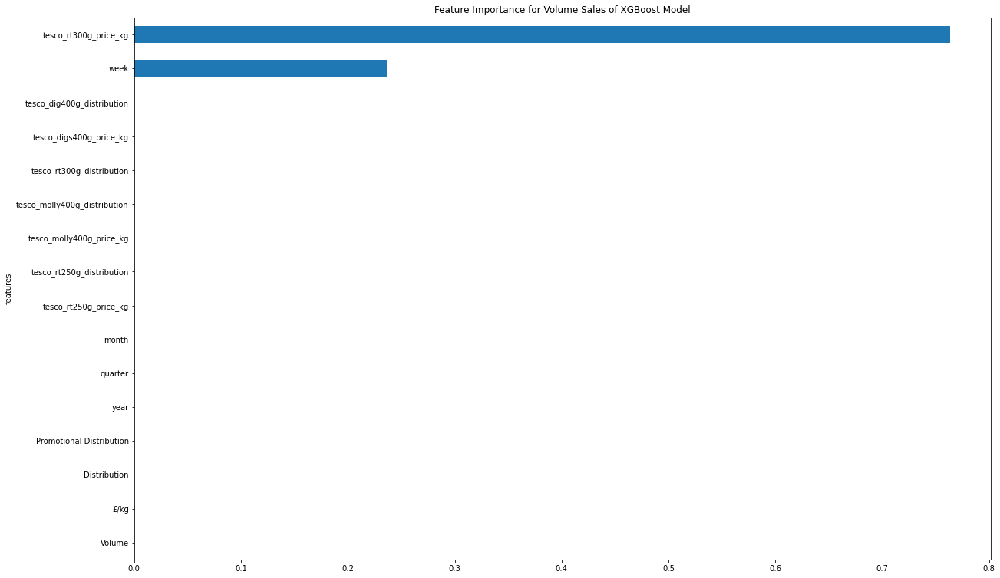

<Figure size 432x288 with 0 Axes>

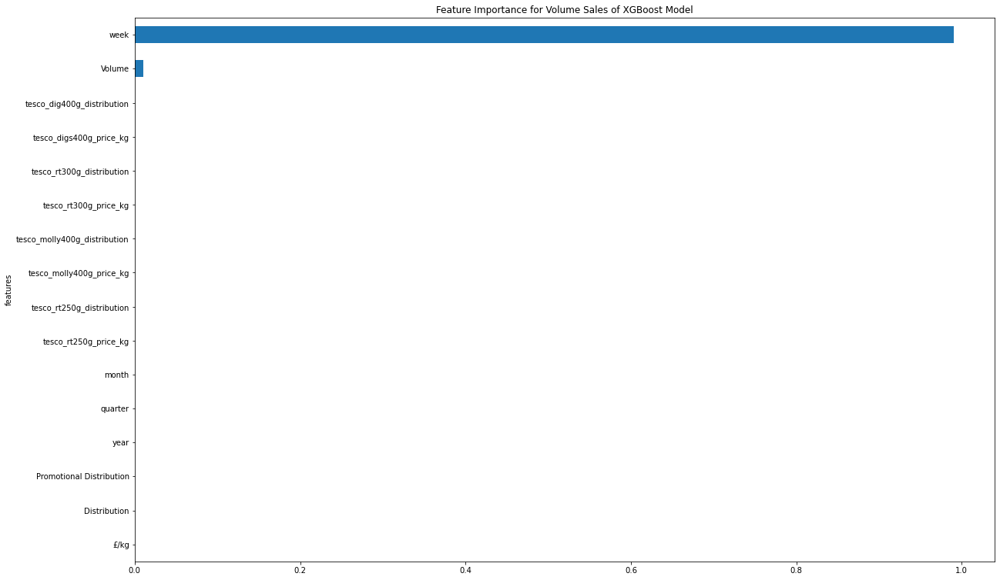

<Figure size 432x288 with 0 Axes>

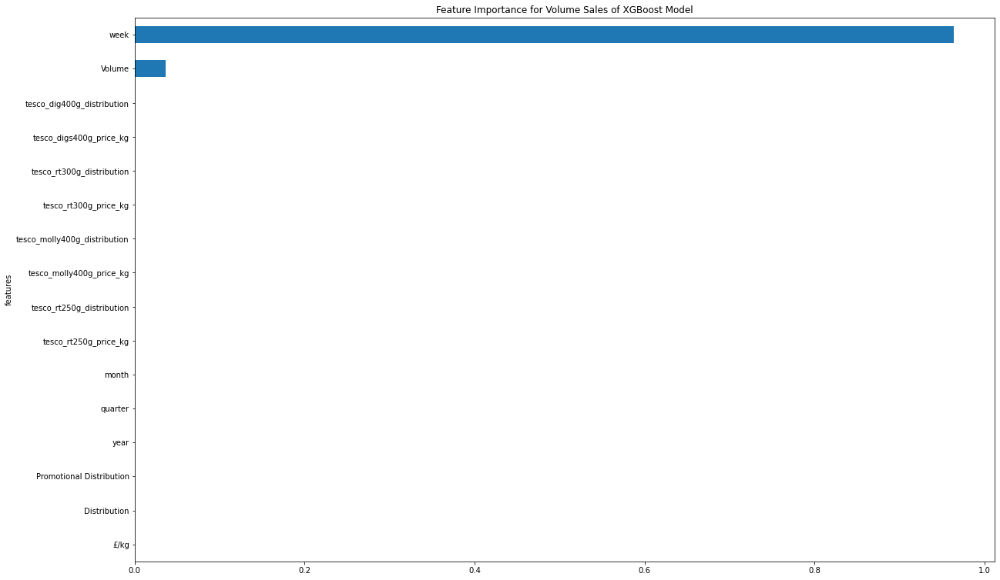

<Figure size 432x288 with 0 Axes>

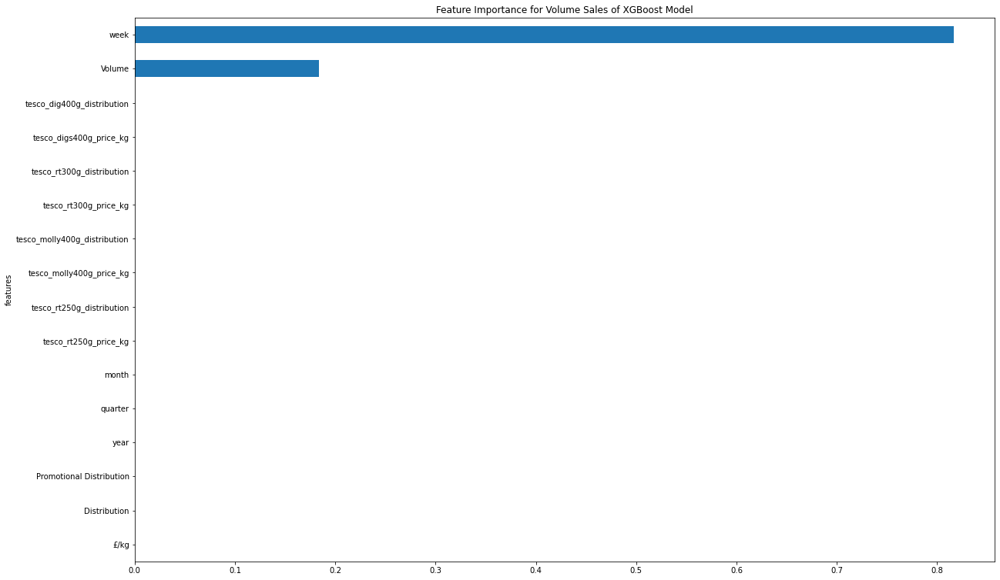

<Figure size 432x288 with 0 Axes>

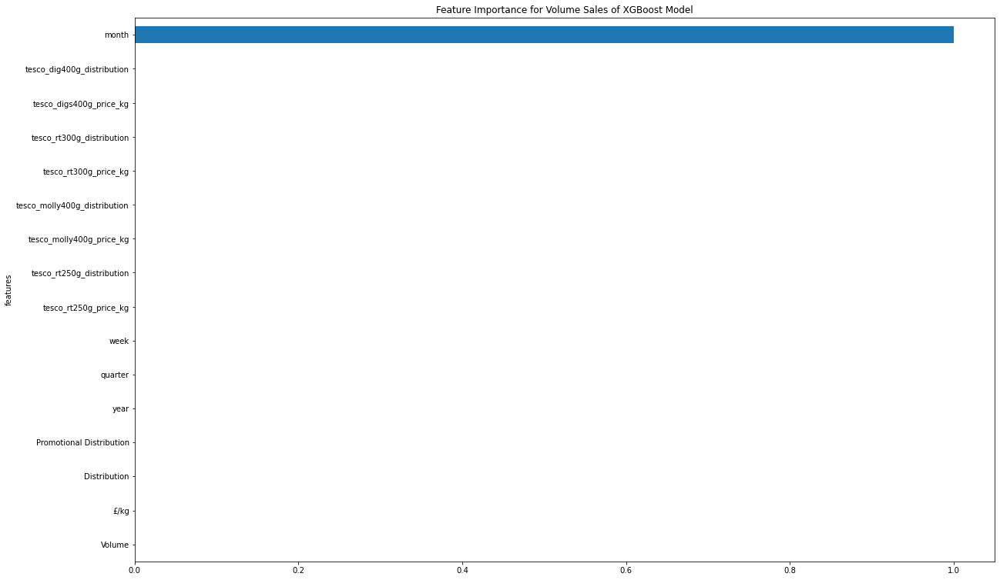

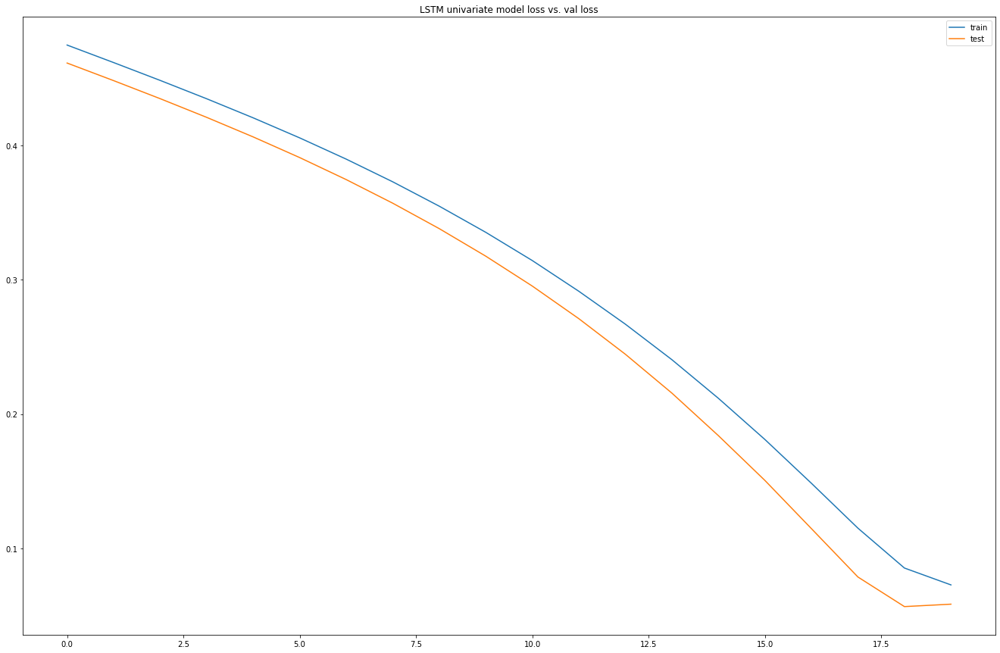

Test RMSE: 5265.698


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,40945.0,1.889672,96.0,0.0,2014.0,4.0,12.0,50.0,31957.0,1.889689,96,0,2015,1,1,2
2015-01-17,43265.0,1.889613,96.0,0.0,2014.0,4.0,12.0,51.0,34705.0,1.889442,96,0,2015,1,1,3
2015-01-24,34195.0,1.889703,96.0,0.0,2014.0,4.0,12.0,52.0,37172.0,1.889339,96,0,2015,1,1,4
2015-01-31,26667.0,1.889601,96.0,0.0,2015.0,1.0,1.0,1.0,40222.0,1.889769,96,0,2015,1,1,5
2015-02-07,31957.0,1.889689,96.0,0.0,2015.0,1.0,1.0,2.0,43199.0,1.889773,96,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,33702.4,2.362428,98.0,0.0,2020.0,1.0,1.0,3.0,39277.6,2.487499,98,0,2020,1,2,7
2020-02-22,36274.4,2.362101,98.0,0.0,2020.0,1.0,1.0,4.0,38577.6,2.487350,98,0,2020,1,2,8
2020-02-29,35528.8,2.362396,98.0,0.0,2020.0,1.0,2.0,5.0,41269.6,2.487354,98,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.605222   0.298082   0.973333        0.0   0.000000        1.0   
5   0.645552   0.298052   0.973333        0.0   0.000000        1.0   
6   0.487884   0.298098   0.973333        0.0   0.000000        1.0   
7   0.357021   0.298046   0.973333        0.0   0.166656        0.0   
8   0.448980   0.298091   0.973333        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.448980  
5        1.0   0.961538  0.496749  
6        1.0   0.980769  0.539634  
7        0.0   0.000000  0.592654  
8        0.0   0.019231  0.644404  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 29s - loss: 0.4700 - val_loss: 0.4399
Epoch 2/50
216/216 - 0s - loss: 0.4403 - val_loss: 0.4062
Epoch 3/50
216/216 - 0s - loss: 0.4091 - val_loss: 0.3700
Epoch 4/50
216/216 - 0s - loss: 0.3752 - val_loss: 0.3298
Epoch 5/50
216/216 - 0s - loss: 0.3375 - va

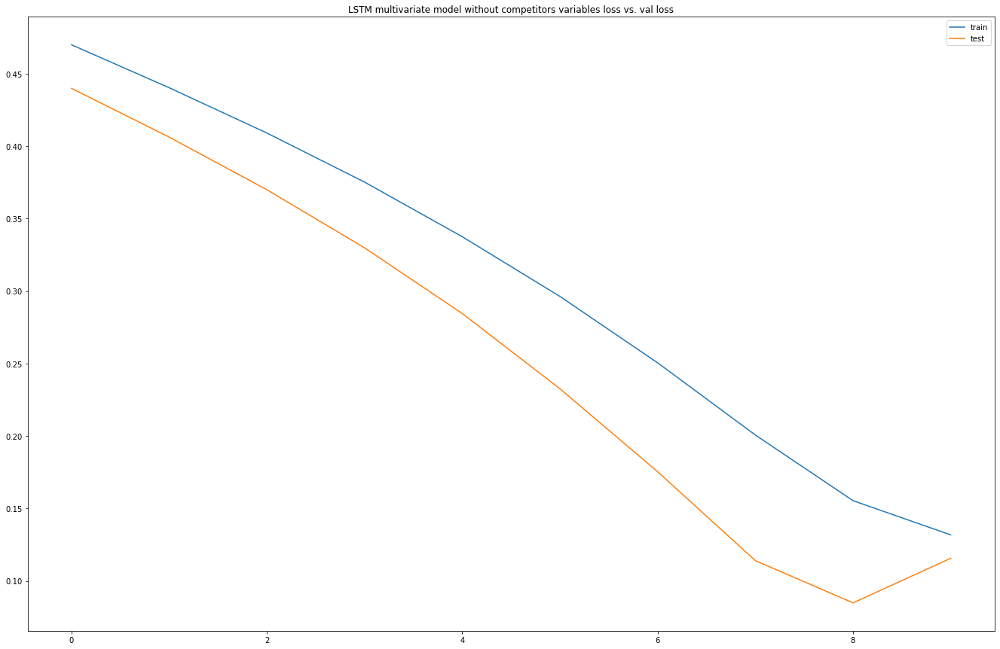

Test RMSE: 8440.060


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-08,31065.6,2018.0,4.0,11.0,45.0,29722.4,2.361640,98.0,0.0,2.241567,...,98.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0
2018-12-15,30734.4,2018.0,4.0,11.0,46.0,30899.2,2.362333,98.0,0.0,2.241541,...,98.0,0.0,2.241440,100.0,0.774977,58.0,0.999939,83.0,1.125797,99.0
2018-12-22,31600.0,2018.0,4.0,11.0,47.0,32409.6,2.362053,98.0,0.0,2.241566,...,98.0,0.0,2.241489,100.0,0.774914,58.0,0.999886,83.0,1.125535,99.0
2018-12-29,31998.4,2018.0,4.0,12.0,48.0,31647.2,2.362421,98.0,0.0,2.241457,...,98.0,0.0,2.241464,100.0,0.774983,58.0,0.999433,83.0,1.125242,99.0
2019-01-05,31740.8,2018.0,4.0,12.0,49.0,31065.6,2.361049,98.0,0.0,2.241417,...,98.0,0.0,2.241518,100.0,0.774887,58.0,0.999955,83.0,1.125299,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,33702.4,2020.0,1.0,1.0,3.0,42836.8,2.362550,98.0,0.0,2.241395,...,98.0,0.0,2.241691,100.0,0.774992,93.0,0.999908,83.0,1.250209,98.0
2020-02-22,36274.4,2020.0,1.0,1.0,4.0,28252.0,2.362406,98.0,0.0,2.241631,...,98.0,0.0,2.241683,100.0,0.774985,93.0,0.999957,83.0,1.250202,98.0
2020-02-29,35528.8,2020.0,1.0,2.0,5.0,23846.4,2.362273,98.0,0.0,2.241635,...,98.0,0.0,2.241582,100.0,0.774998,93.0,0.999954,83.0,1.250188,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.283026        0.0        1.0   0.909091   0.862745   0.459672   
5   0.275527        0.0        1.0   0.909091   0.882353   0.508158   
6   0.295126        0.0        1.0   0.909091   0.901961   0.570388   
7   0.304146        0.0        1.0   1.000000   0.921569   0.538976   
8   0.298314        0.0        1.0   1.000000   0.941177   0.515014   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.008791        0.0        0.0    0.994400         1.0    0.980005   
5   0.014252        0.0        0.0    0.993778         1.0    0.979163   
6   0.012047        0.0        0.0    0.994396         1.0    0.978738   
7   0.014942        0.0        0.0    0.991779         1.0    0.979244   
8   0.004137        0.0        0.0    0.990829         1.0    0.978948   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.136842    0.982941         0.5    0.760128     

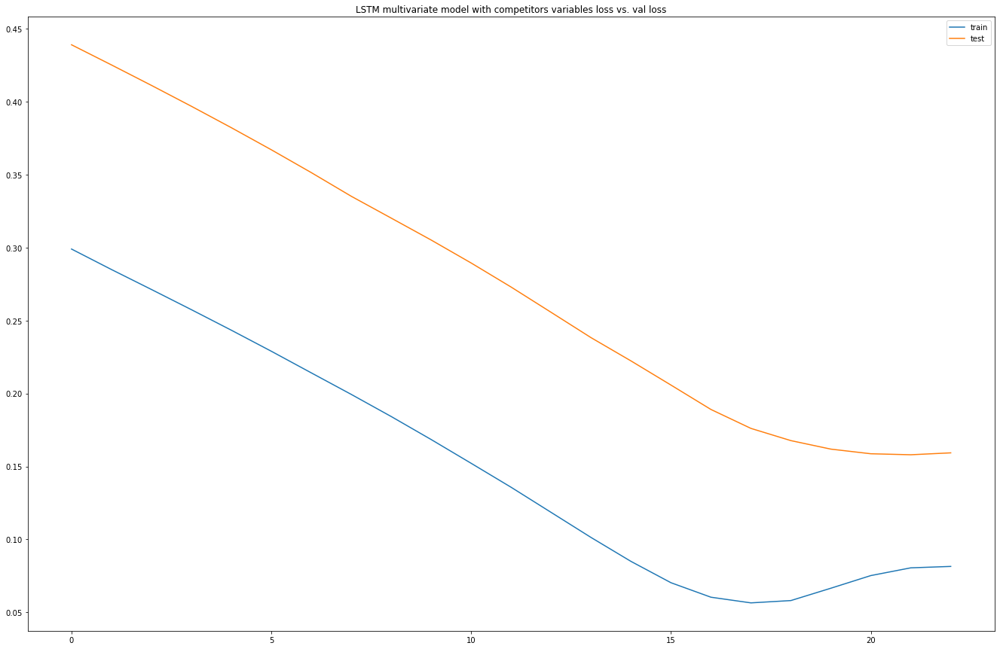

Test RMSE: 9769.876


In [468]:
#ml models
mcv_dig_400g_twin_with_comp=variable_lag(mcv_dig_400g_twin_with_comp)
mcv_dig_400g_twin_input_X,mcv_dig_400g_twin_input_Y=input_var(mcv_dig_400g_twin_with_comp)
rf_regressor_mcv(mcv_dig_400g_twin_input_X,mcv_dig_400g_twin_input_Y)

mcv_dig_400g_twin_input_X,mcv_dig_400g_twin_input_Y=input_var(mcv_dig_400g_twin_with_comp)
xgb_regressor_mcv(mcv_dig_400g_twin_input_X,mcv_dig_400g_twin_input_Y)

#lstm models
series_to_supervised(mcv_dig_400g_twin_volume)
lstm_univariate(mcv_dig_400g_twin_volume)

series_to_supervised(mcv_dig_400g_twin_own_variable)
multivariate_lstm_without_competitor(mcv_dig_400g_twin_own_variable)

series_to_supervised(mcv_dig_400g_twin_with_comp)
multivariate_with_competitor(mcv_dig_400g_twin_with_comp)

### Tesco Large - McVitie's Digestives Rich Tea 300g

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,57531,17259.3,58416.3,100,0,1.015388,3.384627,2014,4,12,50
1,2014-12-20,56103,16830.9,57004.8,100,0,1.016074,3.386913,2014,4,12,51
2,2014-12-27,38403,11520.9,39167.2,100,0,1.019899,3.399665,2014,4,12,52
3,2015-01-03,38308,11492.4,39034.1,100,0,1.018954,3.396514,2015,1,1,1
4,2015-01-10,50283,15084.9,51242.8,100,0,1.019088,3.396960,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,53297.174545,16001.358545,53642.773091,98.647273,0.0,1.007279,3.355066,2017.083636,2.469091,6.414545,26.043636
std,7029.099821,2111.164423,6974.649766,2.031491,0.0,0.032892,0.109373,1.534371,1.140635,3.547767,15.490223
min,22252.000000,6675.600000,22264.700000,94.000000,0.0,0.940687,3.135623,2014.000000,1.000000,1.000000,1.000000
25%,48920.500000,14689.500000,49196.050000,98.000000,0.0,1.000430,3.328587,2016.000000,1.000000,3.000000,12.000000
50%,54834.000000,16462.200000,54877.300000,100.000000,0.0,1.000639,3.333905,2017.000000,2.000000,6.000000,26.000000
75%,57466.500000,17249.700000,58015.300000,100.000000,0.0,1.000832,3.335557,2018.000000,3.500000,9.500000,39.500000
95%,63412.900000,19023.870000,63635.850000,100.000000,0.0,1.036534,3.455112,2019.000000,4.000000,12.000000,50.000000
99%,65649.020000,19694.706000,65800.988000,100.000000,0.0,1.191097,3.963430,2020.000000,4.000000,12.000000,52.000000
max,67015.000000,20130.900000,70512.700000,100.000000,0.0,1.191153,3.967342,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

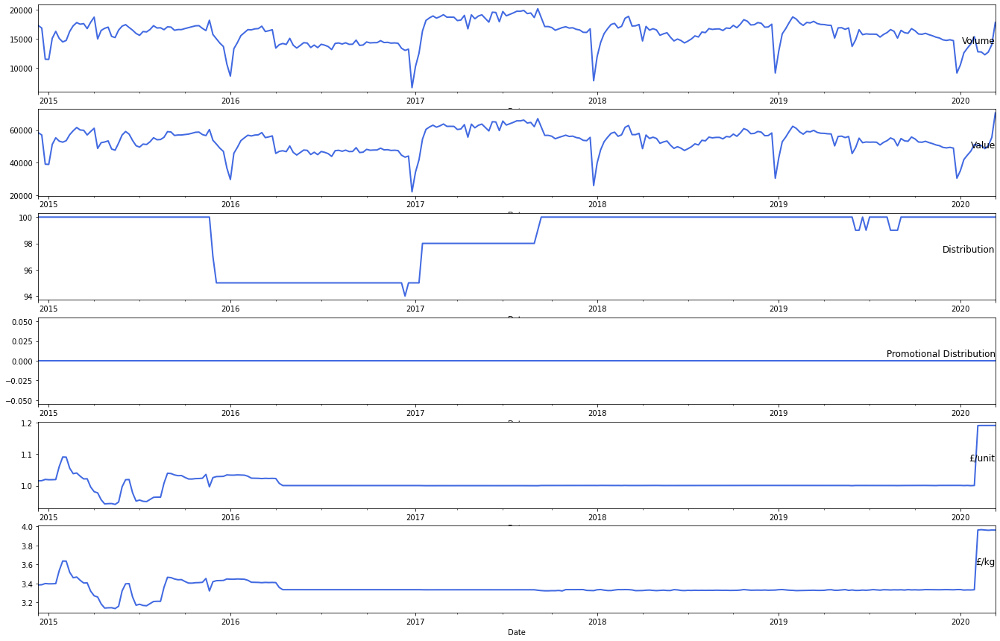

(<matplotlib.axes._subplots.AxesSubplot at 0x7f53592d6c18>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f535940fc50>)

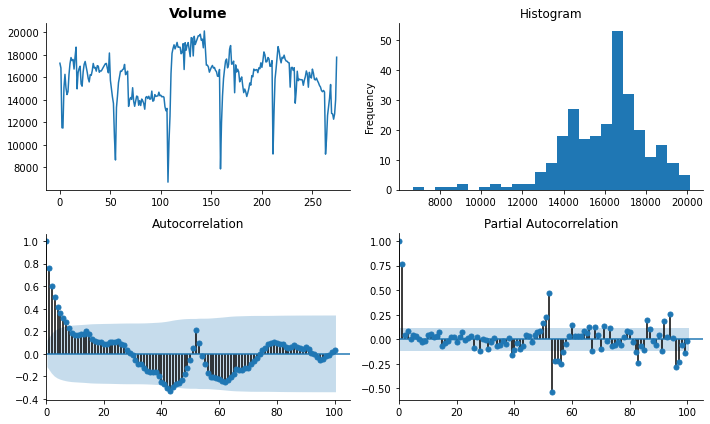

In [469]:
basic_info(mcv_rt_300g_origin)
plot_data(mcv_rt_300g_origin)
tsplot(mcv_rt_300g_origin['Volume'].dropna(), title=mcv_rt_300g_origin.columns[2], lags=100)


Test Statistic                -5.996790e+00
p-value                        1.694113e-07
#Lags Used                     0.000000e+00
Number of Observations Used    2.740000e+02
Critical Value (1%)           -3.454444e+00
Critical Value (5%)           -2.872147e+00
Critical Value (10%)          -2.572422e+00
dtype: float64


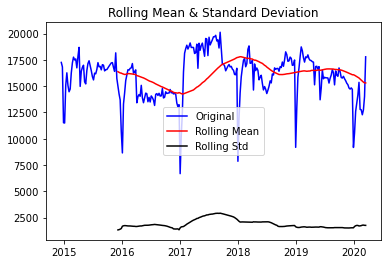

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f5359bc4eb8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5359deb7f0>)

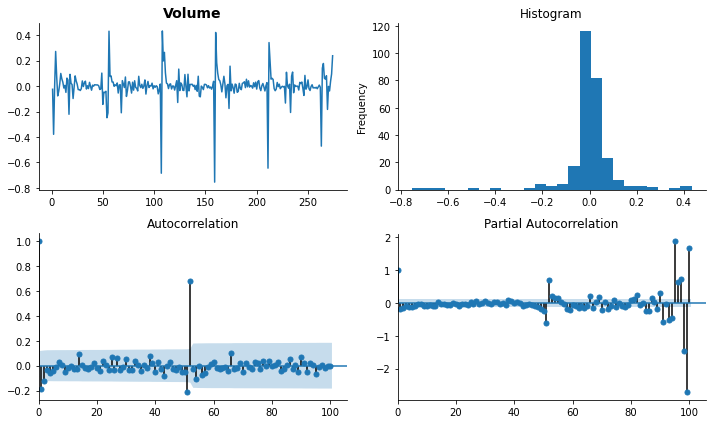

In [470]:
plot(mcv_rt_300g_origin)
series_transformed=mcv_rt_300g_origin.copy()
series_transformed['Volume_transformed']=np.log(mcv_rt_300g_origin.Volume).diff(1)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_rt_300g_origin.columns[2], lags=100)


       t-4      t+1
0      NaN  17259.3
1      NaN  16830.9
2      NaN  11520.9
3      NaN  11492.4
4  17259.3  15084.9
Test MSE: 3353758.881
Test RMSE: 1831.327


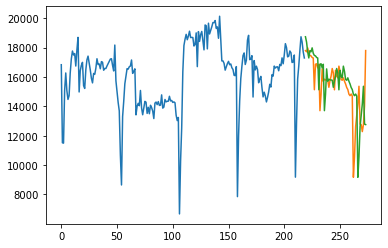

Observations: 271
Training Observations: 216
Testing Observations: 55


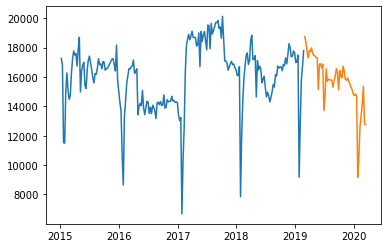

RMSE for Simple Exponential Smoothing α= 0.1 is: 1841.18
RMSE for Simple Exponential Smoothing α= 0.2 is: 1802.09
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 1814.66
RMSE for Simple Exponential Smoothing α= 0.4 is: 1886.75
RMSE for Simple Exponential Smoothing α= 0.5 is: 2026.89
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2205.11
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 2379.96
RMSE for Simple Exponential Smoothing α= 0.8 is: 2526.12
RMSE for Simple Exponential Smoothing α= 0.9 is: 2638.78


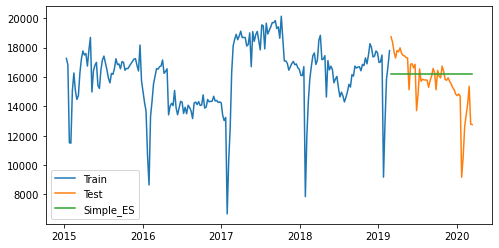

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.1 and β= 0.1 is: 1616.53


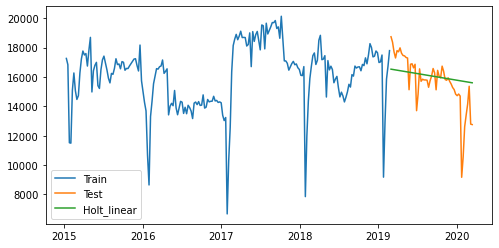

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

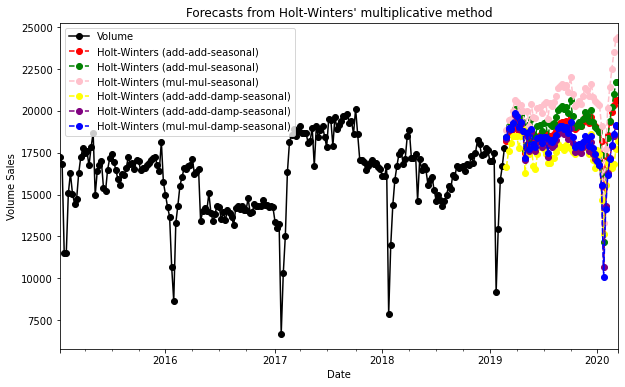

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
3653.631563963609
3943.026391979925
5270.784271231085
2235.2864686868134
2534.2197960860426
2697.4957022444246


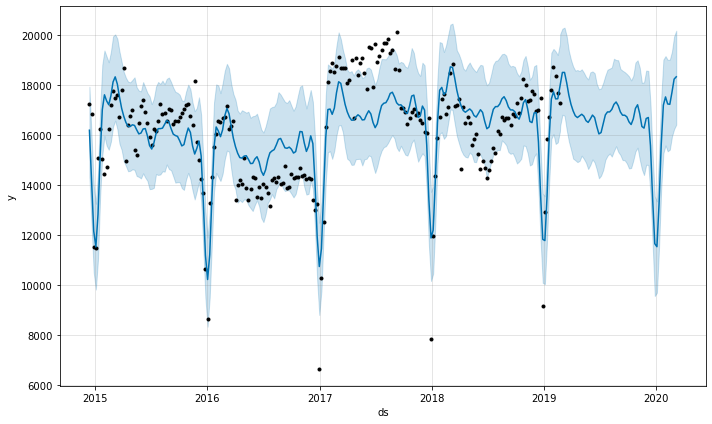

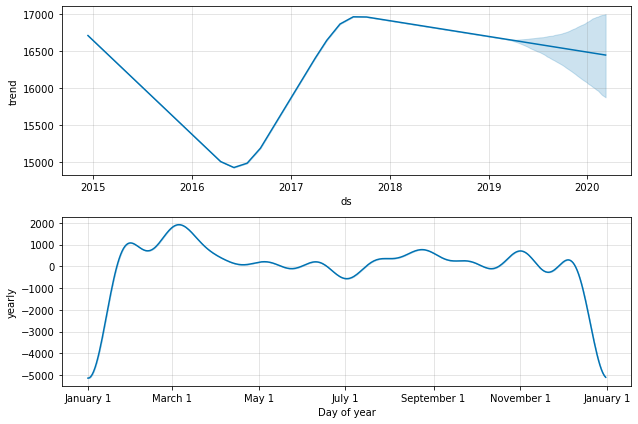

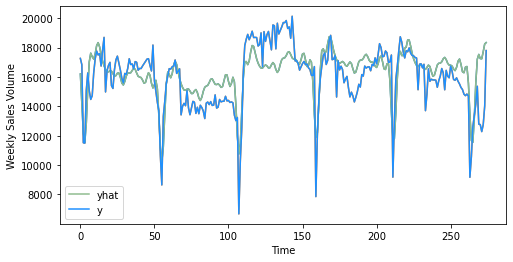

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 1482.0211478032347
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17

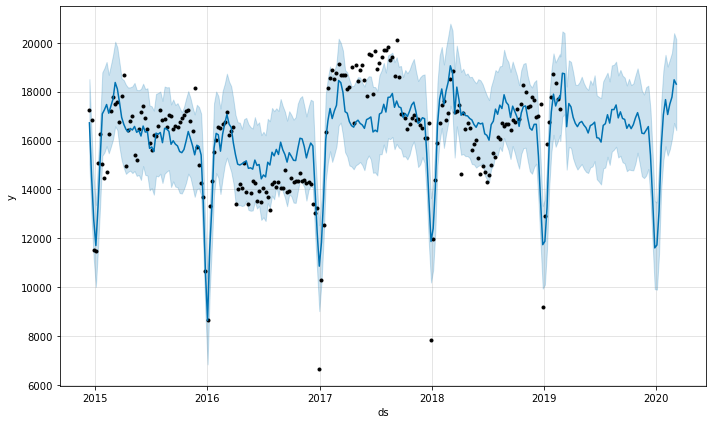

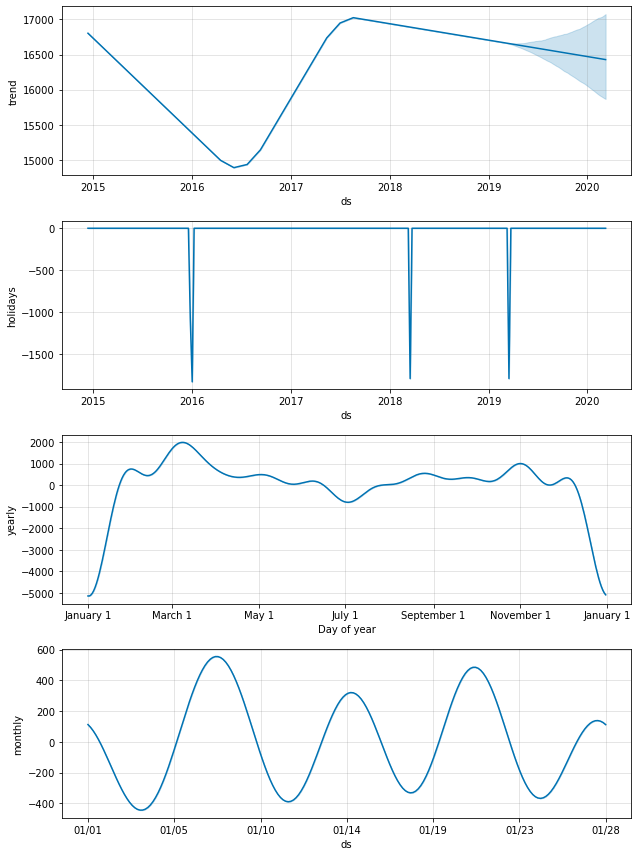

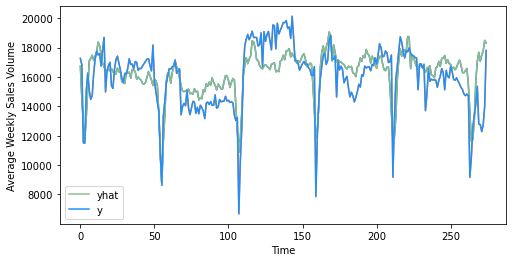

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 1461.1122626909314


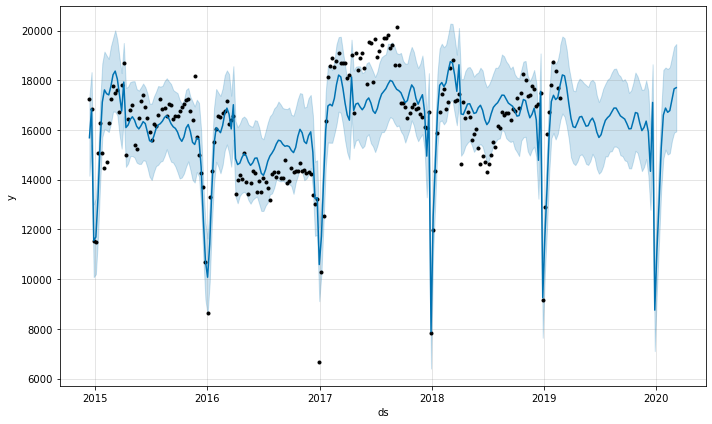

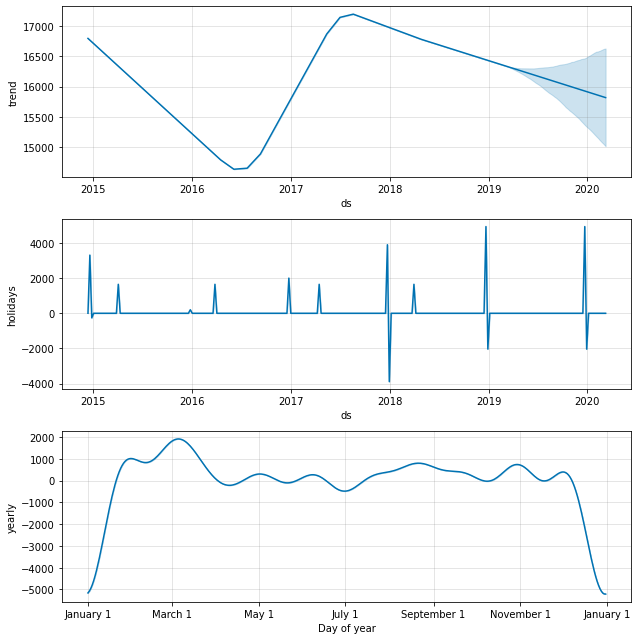

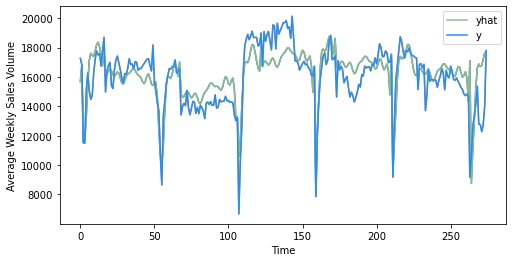

RMSE for prophet with only Christmas and Easter week is: 1343.7111421338172


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [471]:
#time series models
baseline_model(mcv_rt_300g_origin)
ses_model(mcv_rt_300g_origin)
holt_linear_model(mcv_rt_300g_origin)
holt_winter_model(mcv_rt_300g_origin)
prophet_model(mcv_rt_300g_origin)
prophet_all_holidays(mcv_rt_300g_origin)
prophet_two_holiday(mcv_rt_300g_origin)


Observations: 27
Training Observations: 16
Testing Observations: 11
[ -0.84067403  -2.88385512 -22.87834723 -97.76119799  -1.68183137]
Mean Absolute Error: 3774.897272727272
Mean Squared Error: 17742587.790027265
Root Mean Squared Error: 4212.195127249836
Observations: 38
Training Observations: 27
Testing Observations: 11
[  -1.46517938  -29.28095521 -227.1406383    -4.46388323   -1.19125813]
Mean Absolute Error: 801.2904545454544
Mean Squared Error: 1120319.8137613635
Root Mean Squared Error: 1058.4516114406758
Observations: 49
Training Observations: 38
Testing Observations: 11
[ 1.76135322e-02 -1.77406702e+02 -6.35718174e-01 -2.23303033e-01
 -3.00276087e+00]
Mean Absolute Error: 763.539545454545
Mean Squared Error: 762918.508002273
Root Mean Squared Error: 873.4520639407025
Observations: 60
Training Observations: 49
Testing Observations: 11
[-17.99777932  -3.06785581  -0.33606883  -1.86581875  -1.13903125]
Mean Absolute Error: 1136.3427272727283
Mean Squared Error: 1709151.819218182


,var1(t-4),var1(t)
Date,,
2015-01-10,17259.3,15084.9
2015-01-17,16830.9,16269.3
2015-01-24,11520.9,15061.2
2015-01-31,11492.4,14468.4
2015-02-07,15084.9,14725.2
...,...,...
2020-02-15,13409.1,12756.6
2020-02-22,14161.5,12278.4
2020-02-29,15364.2,12749.4


   var1(t-4)   var1(t)
4   0.786582  0.624980
5   0.754743  0.713005
6   0.360103  0.623219
7   0.357985  0.579162
8   0.624980  0.598247
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 30s - loss: 0.7046 - val_loss: 0.6426
Epoch 2/50
216/216 - 0s - loss: 0.6928 - val_loss: 0.6307
Epoch 3/50
216/216 - 0s - loss: 0.6807 - val_loss: 0.6184
Epoch 4/50
216/216 - 0s - loss: 0.6683 - val_loss: 0.6056
Epoch 5/50
216/216 - 0s - loss: 0.6552 - val_loss: 0.5922
Epoch 6/50
216/216 - 0s - loss: 0.6414 - val_loss: 0.5778
Epoch 7/50
216/216 - 0s - loss: 0.6266 - val_loss: 0.5625
Epoch 8/50
216/216 - 0s - loss: 0.6109 - val_loss: 0.5459
Epoch 9/50
216/216 - 0s - loss: 0.5939 - val_loss: 0.5279
Epoch 10/50
216/216 - 0s - loss: 0.5755 - val_loss: 0.5083
Epoch 11/50
216/216 - 0s - loss: 0.5553 - val_loss: 0.4868
Epoch 12/50
216/216 - 0s - loss: 0.5333 - val_loss: 0.4632
Epoch 13/50
216/216 - 0s - loss: 0.5095 - val_loss: 0.4381
Epoch 14/50
216/216 - 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:46: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

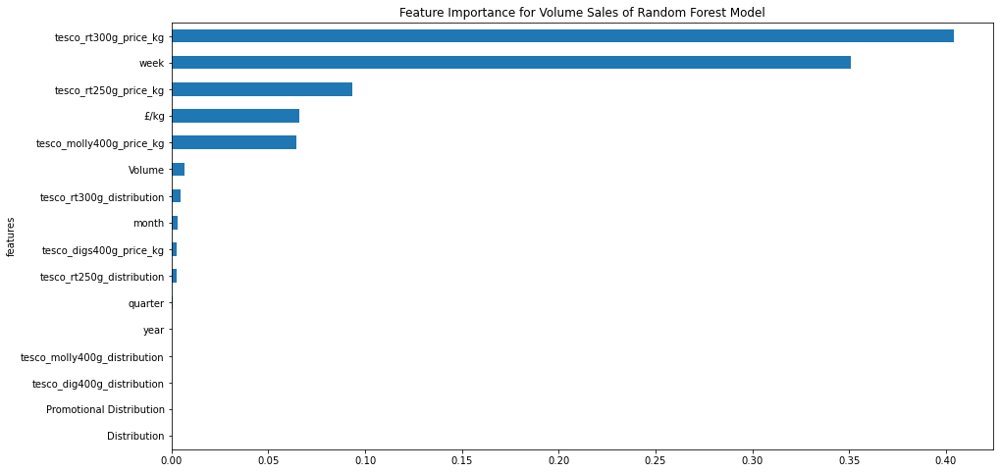

<Figure size 432x288 with 0 Axes>

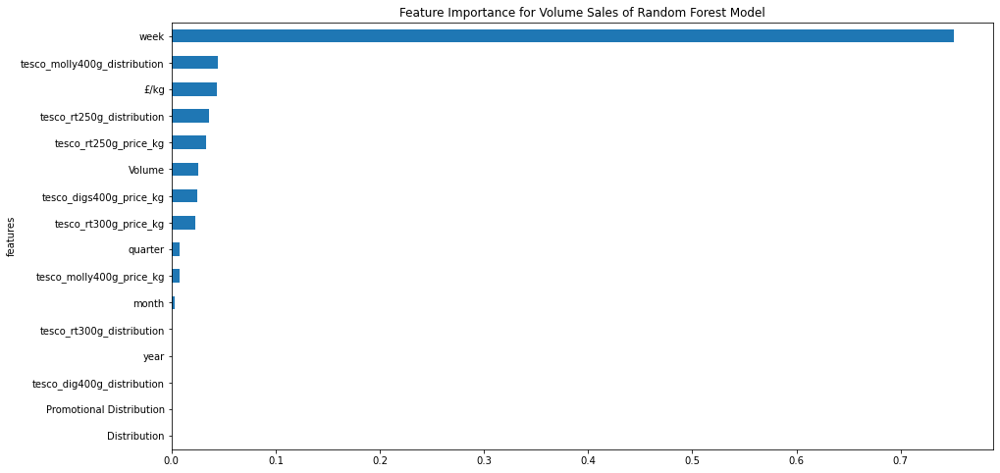

<Figure size 432x288 with 0 Axes>

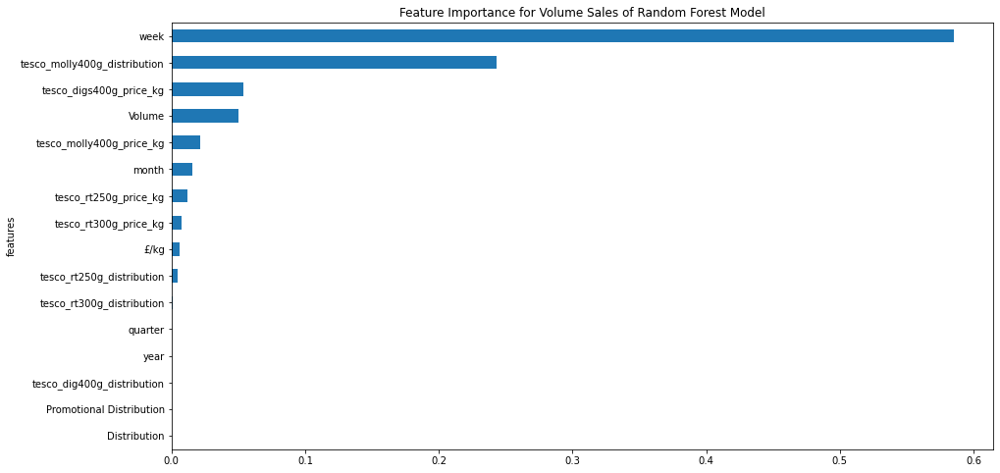

<Figure size 432x288 with 0 Axes>

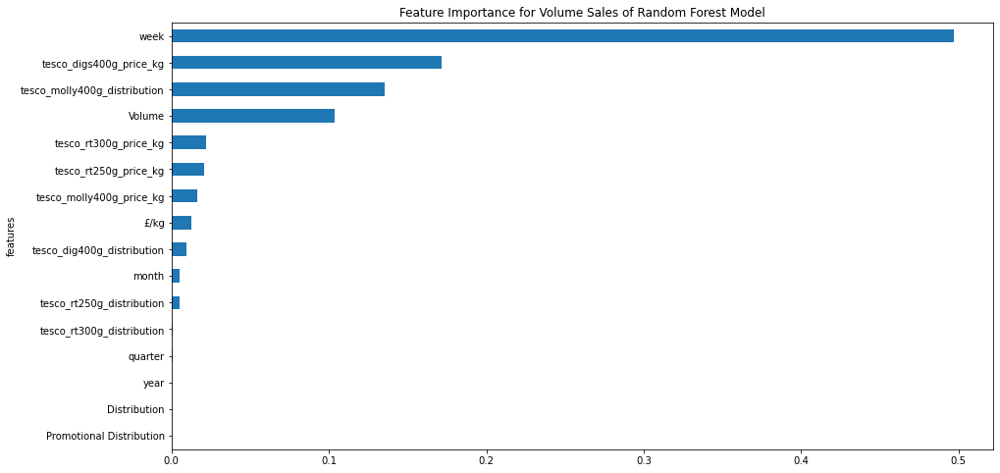

<Figure size 432x288 with 0 Axes>

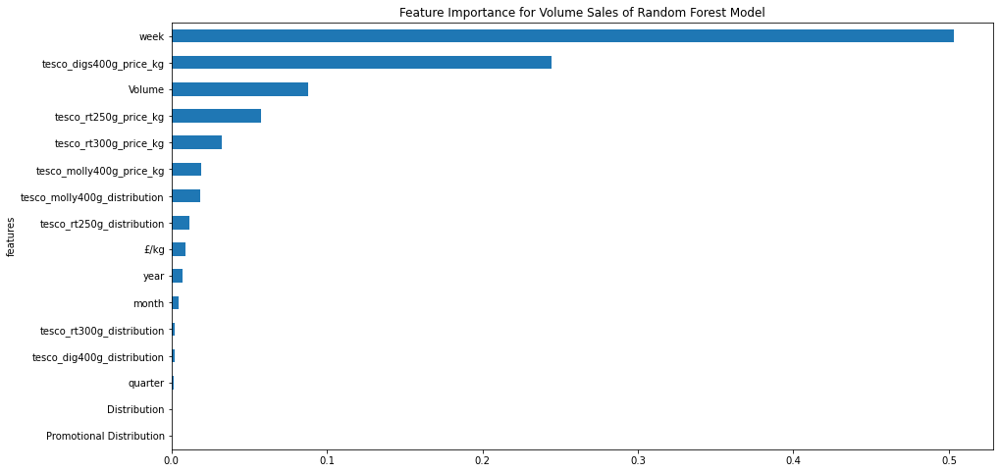

<Figure size 432x288 with 0 Axes>

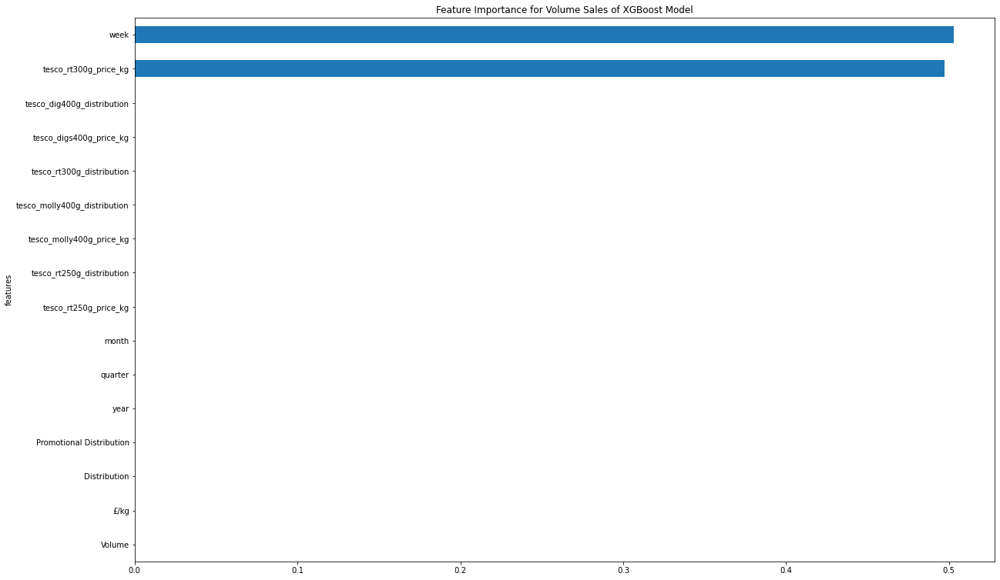

<Figure size 432x288 with 0 Axes>

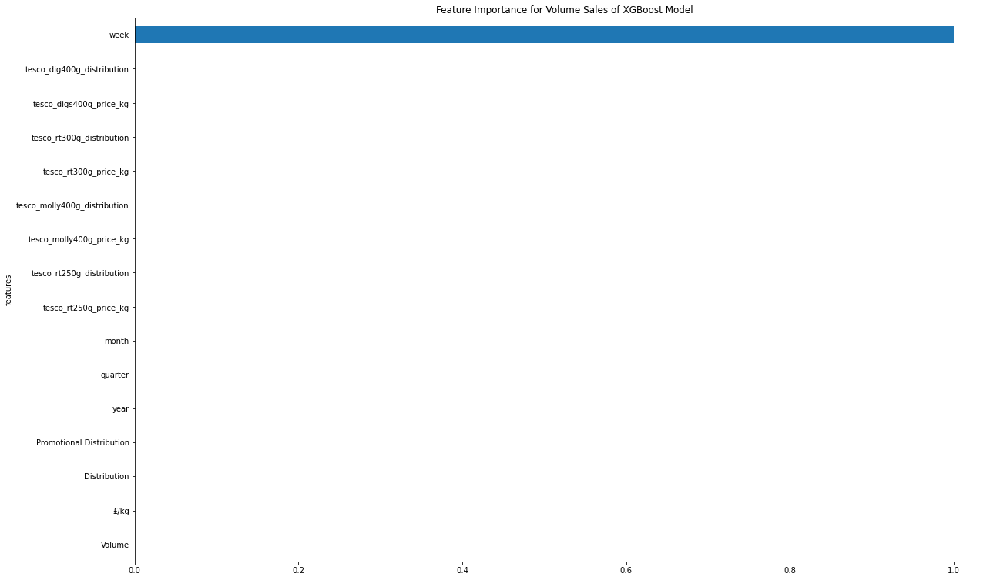

<Figure size 432x288 with 0 Axes>

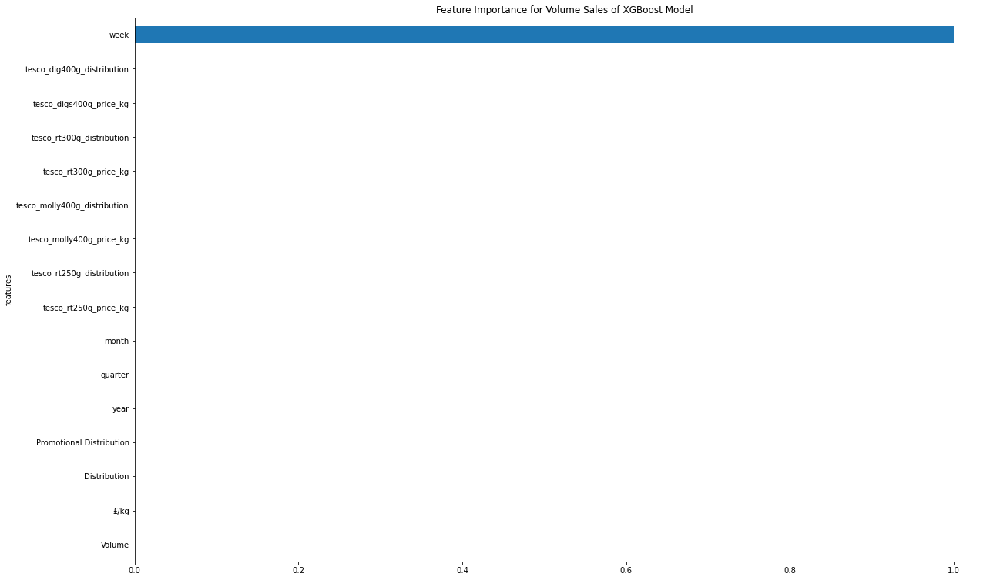

<Figure size 432x288 with 0 Axes>

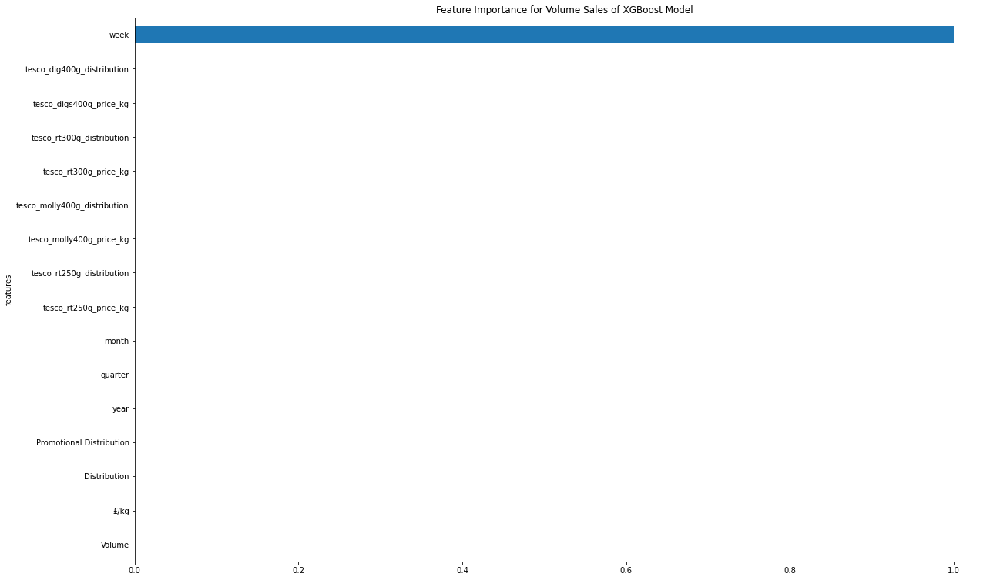

<Figure size 432x288 with 0 Axes>

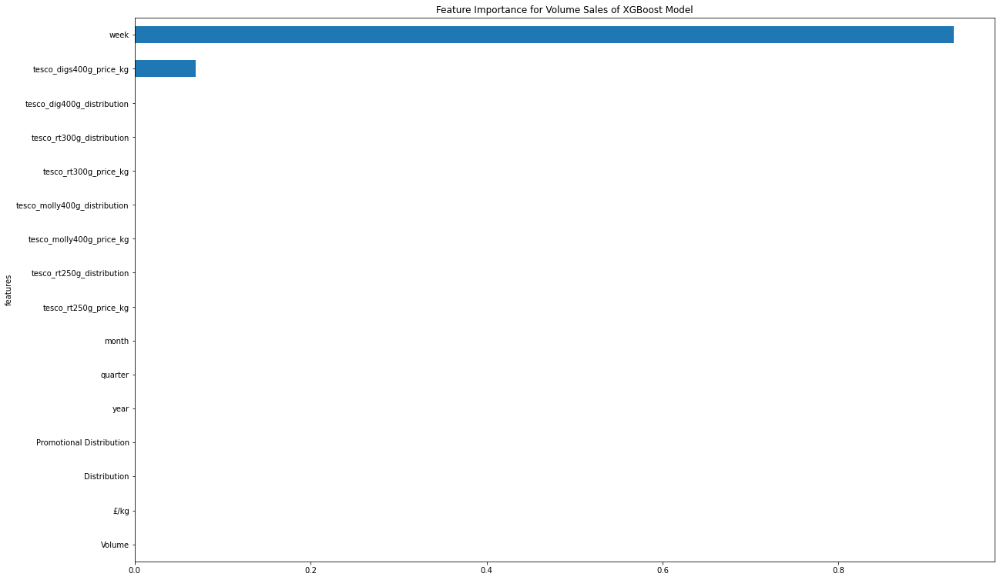

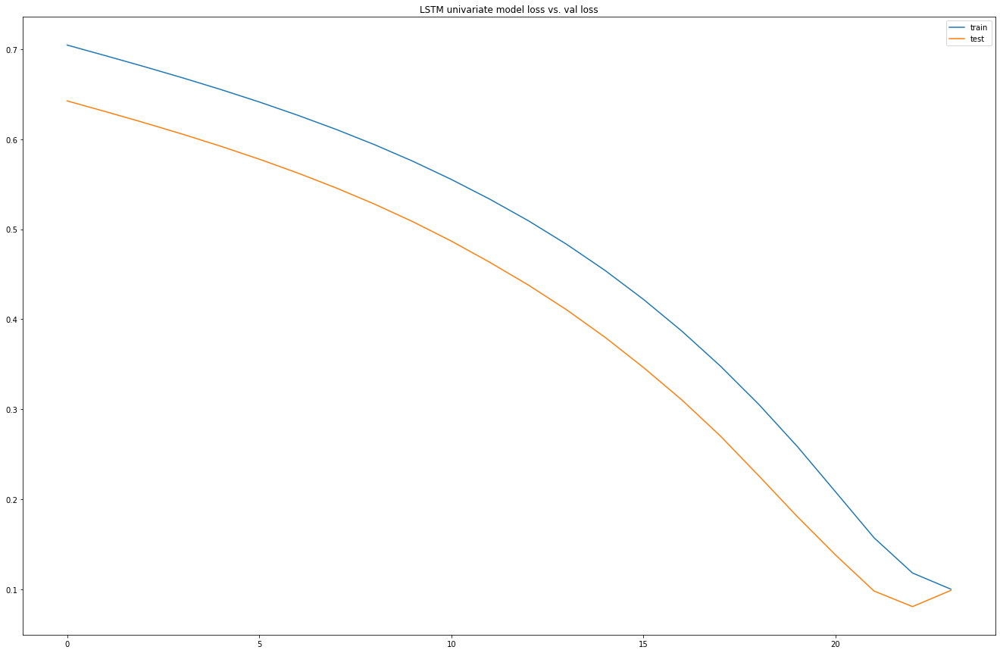

Test RMSE: 1892.620


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,17259.3,3.384627,100.0,0.0,2014.0,4.0,12.0,50.0,15084.9,3.396960,100,0,2015,1,1,2
2015-01-17,16830.9,3.386913,100.0,0.0,2014.0,4.0,12.0,51.0,16269.3,3.398573,100,0,2015,1,1,3
2015-01-24,11520.9,3.399665,100.0,0.0,2014.0,4.0,12.0,52.0,15061.2,3.536073,100,0,2015,1,1,4
2015-01-31,11492.4,3.396514,100.0,0.0,2015.0,1.0,1.0,1.0,14468.4,3.636788,100,0,2015,1,1,5
2015-02-07,15084.9,3.396960,100.0,0.0,2015.0,1.0,1.0,2.0,14725.2,3.635421,100,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,13409.1,3.332535,100.0,0.0,2020.0,1.0,1.0,3.0,12756.6,3.967342,100,0,2020,1,2,7
2020-02-22,14161.5,3.331737,100.0,0.0,2020.0,1.0,1.0,4.0,12278.4,3.963619,100,0,2020,1,2,8
2020-02-29,15364.2,3.334121,100.0,0.0,2020.0,1.0,2.0,5.0,12749.4,3.960884,100,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.786582   0.299385   1.000001        0.0   0.000000        1.0   
5   0.754743   0.302134   1.000001        0.0   0.000000        1.0   
6   0.360103   0.317465   1.000001        0.0   0.000000        1.0   
7   0.357985   0.313677   1.000001        0.0   0.166656        0.0   
8   0.624980   0.314213   1.000001        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.624980  
5        1.0   0.961538  0.713005  
6        1.0   0.980769  0.623219  
7        0.0   0.000000  0.579162  
8        0.0   0.019231  0.598247  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 29s - loss: 0.6933 - val_loss: 0.6193
Epoch 2/50
216/216 - 0s - loss: 0.6692 - val_loss: 0.5924
Epoch 3/50
216/216 - 0s - loss: 0.6442 - val_loss: 0.5635
Epoch 4/50
216/216 - 0s - loss: 0.6175 - val_loss: 0.5318
Epoch 5/50
216/216 - 0s - loss: 0.5881 - va

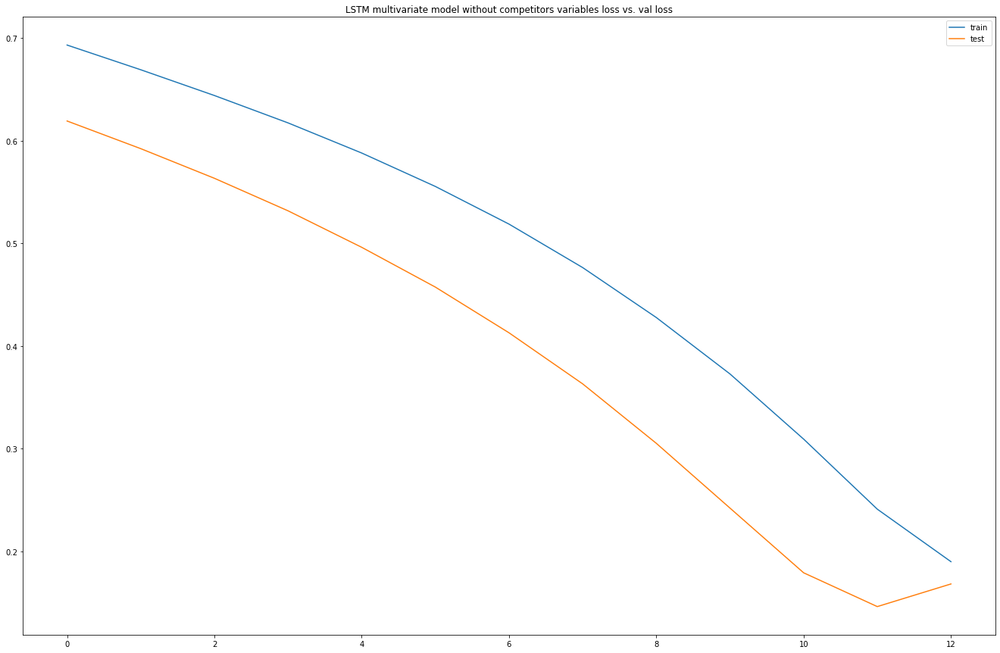

Test RMSE: 2977.702


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-08,17365.2,2018.0,4.0,11.0,45.0,16893.0,3.328089,100.0,0.0,2.241567,...,100.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0
2018-12-15,17411.1,2018.0,4.0,11.0,46.0,17493.9,3.330738,100.0,0.0,2.241541,...,100.0,0.0,2.241440,100.0,0.774977,58.0,0.999939,83.0,1.125797,99.0
2018-12-22,17767.5,2018.0,4.0,11.0,47.0,18264.9,3.335835,100.0,0.0,2.241566,...,100.0,0.0,2.241489,100.0,0.774914,58.0,0.999886,83.0,1.125535,99.0
2018-12-29,17646.9,2018.0,4.0,12.0,48.0,18000.0,3.332644,100.0,0.0,2.241457,...,100.0,0.0,2.241464,100.0,0.774983,58.0,0.999433,83.0,1.125242,99.0
2019-01-05,16981.2,2018.0,4.0,12.0,49.0,17365.2,3.329135,100.0,0.0,2.241417,...,100.0,0.0,2.241518,100.0,0.774887,58.0,0.999955,83.0,1.125299,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,13409.1,2020.0,1.0,1.0,3.0,14697.3,3.333592,100.0,0.0,2.241395,...,100.0,0.0,2.241691,100.0,0.774992,93.0,0.999908,83.0,1.250209,98.0
2020-02-22,14161.5,2020.0,1.0,1.0,4.0,9168.6,3.335907,100.0,0.0,2.241631,...,100.0,0.0,2.241683,100.0,0.774985,93.0,0.999957,83.0,1.250202,98.0
2020-02-29,15364.2,2020.0,1.0,2.0,5.0,10560.9,3.335956,100.0,0.0,2.241635,...,100.0,0.0,2.241582,100.0,0.774998,93.0,0.999954,83.0,1.250188,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.856784        0.0        1.0   0.909091   0.862745   0.807426   
5   0.861582        0.0        1.0   0.909091   0.882353   0.870237   
6   0.898837        0.0        1.0   0.909091   0.901961   0.950829   
7   0.886230        0.0        1.0   1.000000   0.921569   0.923140   
8   0.816645        0.0        1.0   1.000000   0.941177   0.856784   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.004945        1.0        0.0    0.994400         1.0    0.980005   
5   0.009069        1.0        0.0    0.993778         1.0    0.979163   
6   0.017004        1.0        0.0    0.994396         1.0    0.978738   
7   0.012037        1.0        0.0    0.991779         1.0    0.979244   
8   0.006575        1.0        0.0    0.990829         1.0    0.978948   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.136842    0.982941         0.5    0.760128     

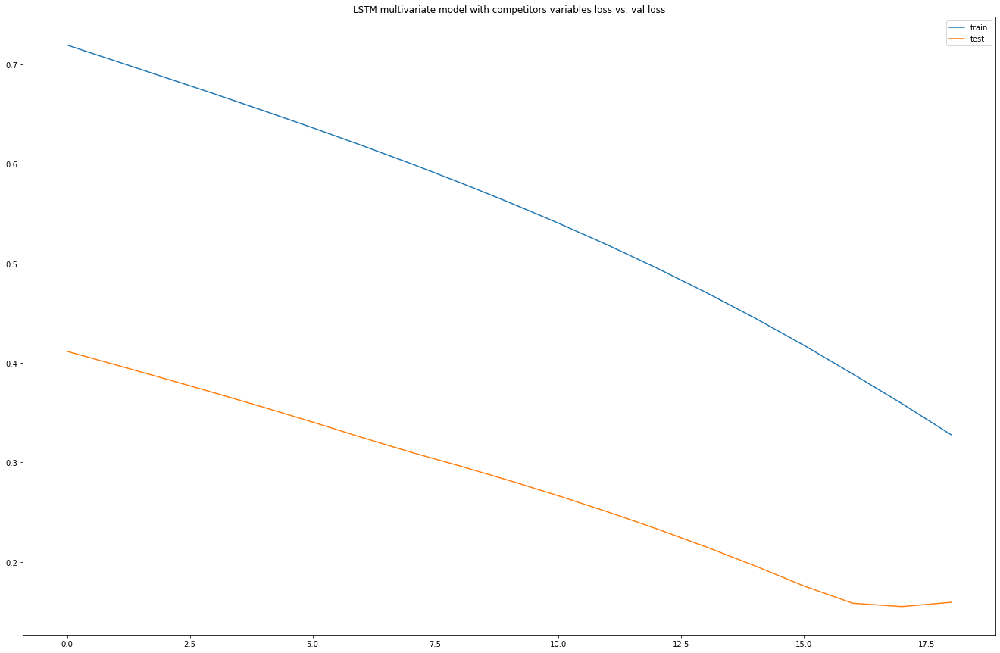

Test RMSE: 2022.446


In [472]:
#ml models
mcv_rt_300g_with_comp=variable_lag(mcv_rt_300g_with_comp)
mcv_rt_300g_input_X,mcv_rt_300g_input_Y=input_var(mcv_rt_300g_with_comp)
rf_regressor_mcv(mcv_rt_300g_input_X,mcv_rt_300g_input_Y)

mcv_rt_300g_input_X,mcv_rt_300g_input_Y=input_var(mcv_rt_300g_with_comp)
xgb_regressor_mcv(mcv_rt_300g_input_X,mcv_rt_300g_input_Y)

#lstm models
series_to_supervised(mcv_rt_300g_volume)
lstm_univariate(mcv_rt_300g_volume)

series_to_supervised(mcv_rt_300g_own_variable)
multivariate_lstm_without_competitor(mcv_rt_300g_own_variable)

series_to_supervised(mcv_rt_300g_with_comp)
multivariate_with_competitor(mcv_rt_300g_with_comp)

### Tesco Large - McVitie's Digestives Rich Tea 300g Twin Pack

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,29186,17512,55159,96,0,1.89,3.15,2014,4,12,50
1,2014-12-20,29296,17578,55368,96,0,1.89,3.15,2014,4,12,51
2,2014-12-27,19627,11776,37097,96,0,1.89,3.15,2014,4,12,52
3,2015-01-03,20399,12239,38553,96,0,1.89,3.15,2015,1,1,1
4,2015-01-10,26463,15878,50015,96,0,1.89,3.15,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                               int64
Value                                int64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.00000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,30580.287273,18348.160000,57701.327273,93.810909,0.0,1.88720,3.145345,2017.083636,2.469091,6.414545,26.043636
std,5783.902741,3470.324743,11033.581557,11.254548,0.0,0.04098,0.068520,1.534371,1.140635,3.547767,15.490223
min,16518.000000,9911.000000,31211.000000,62.000000,0.0,1.50000,2.500000,2014.000000,1.000000,1.000000,1.000000
25%,28326.000000,16995.500000,53532.500000,97.000000,0.0,1.89000,3.150000,2016.000000,1.000000,3.000000,12.000000
50%,31847.000000,19108.000000,60114.000000,98.000000,0.0,1.89000,3.150000,2017.000000,2.000000,6.000000,26.000000
75%,33942.000000,20365.500000,64057.500000,98.000000,0.0,1.89000,3.150000,2018.000000,3.500000,9.500000,39.500000
95%,37289.300000,22373.700000,69994.900000,99.000000,0.0,1.89000,3.150000,2019.000000,4.000000,12.000000,50.000000
99%,41694.480000,25016.340000,77315.800000,99.000000,0.0,1.99000,3.320000,2020.000000,4.000000,12.000000,52.000000
max,61037.000000,36622.000000,121479.000000,99.000000,0.0,1.99000,3.320000,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

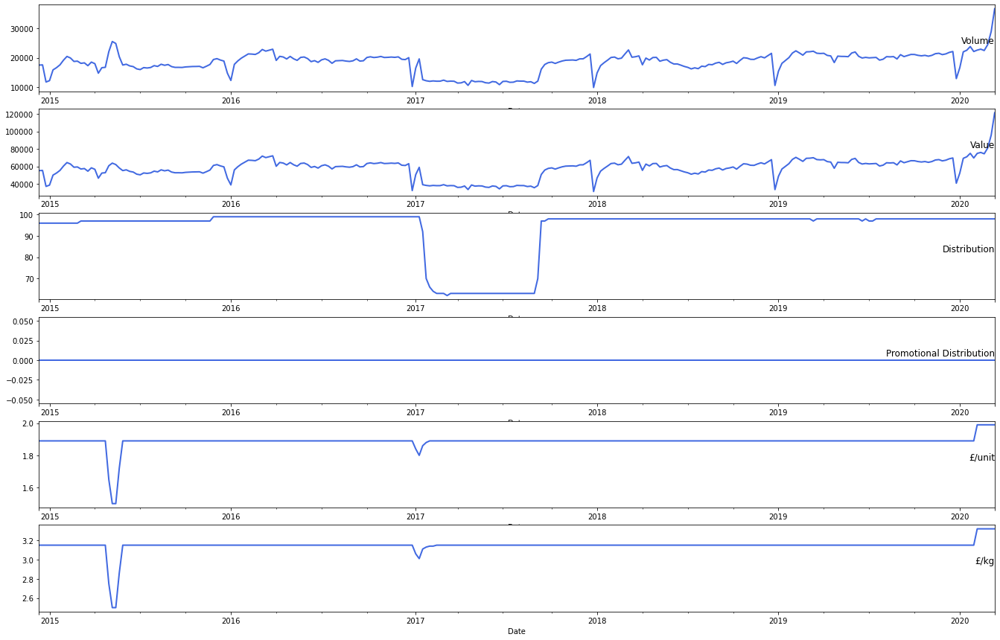

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5347e921d0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5347e7aa90>)

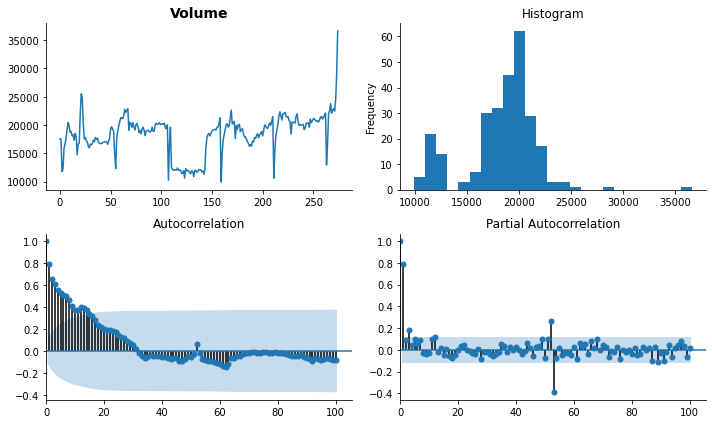

In [473]:
basic_info(mcv_rt_300g_twin_origin)
plot_data(mcv_rt_300g_twin_origin)
tsplot(mcv_rt_300g_twin_origin['Volume'].dropna(), title=mcv_rt_300g_twin_origin.columns[2], lags=100)


Test Statistic                  -2.115810
p-value                          0.238205
#Lags Used                       2.000000
Number of Observations Used    272.000000
Critical Value (1%)             -3.454622
Critical Value (5%)             -2.872225
Critical Value (10%)            -2.572464
dtype: float64


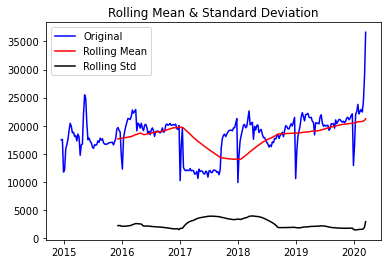

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5347d65b70>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5347bd17f0>)

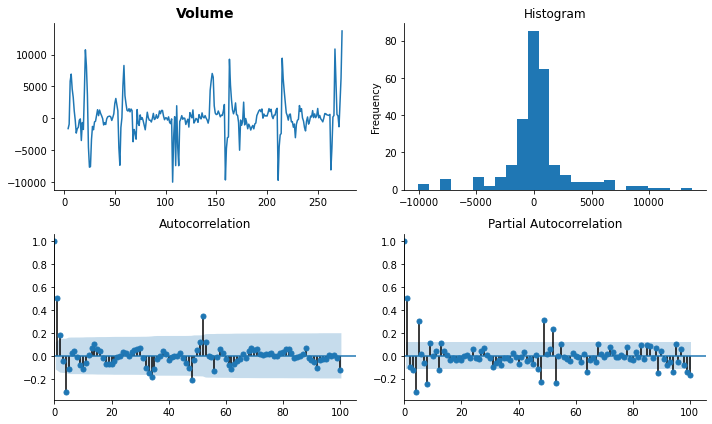

In [474]:
plot(mcv_rt_300g_twin_origin)
series_transformed=mcv_rt_300g_twin_origin.copy()
series_transformed['Volume_transformed']=mcv_rt_300g_twin_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_rt_300g_twin_origin.columns[2], lags=100)


       t-4    t+1
0      NaN  17512
1      NaN  17578
2      NaN  11776
3      NaN  12239
4  17512.0  15878
Test MSE: 9255843.855
Test RMSE: 3042.342


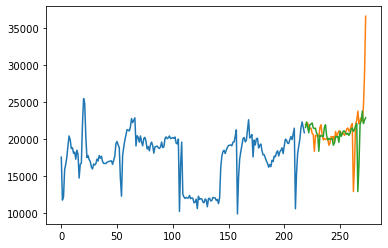

Observations: 271
Training Observations: 216
Testing Observations: 55


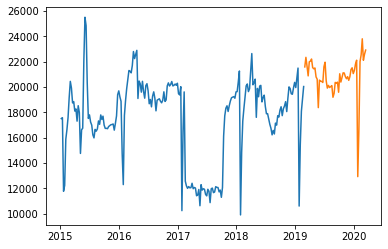

RMSE for Simple Exponential Smoothing α= 0.1 is: 2804.78
RMSE for Simple Exponential Smoothing α= 0.2 is: 2856.96
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2813.88
RMSE for Simple Exponential Smoothing α= 0.4 is: 2634.98
RMSE for Simple Exponential Smoothing α= 0.5 is: 2397.24
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2172.25
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 1996.97
RMSE for Simple Exponential Smoothing α= 0.8 is: 1876.88
RMSE for Simple Exponential Smoothing α= 0.9 is: 1799.67


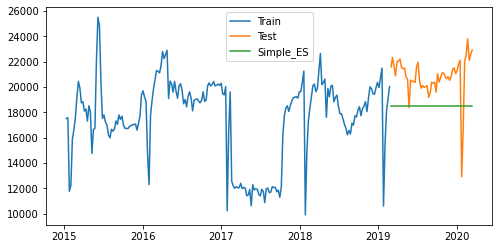

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.1 and β= 0.2 is: 1849.33


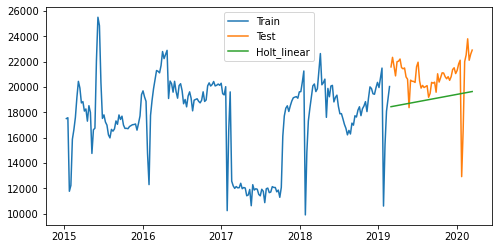

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/holtwinters.py:744: ConvergenceWarning:

Optimization failed to converge. Check mle_retvals.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/

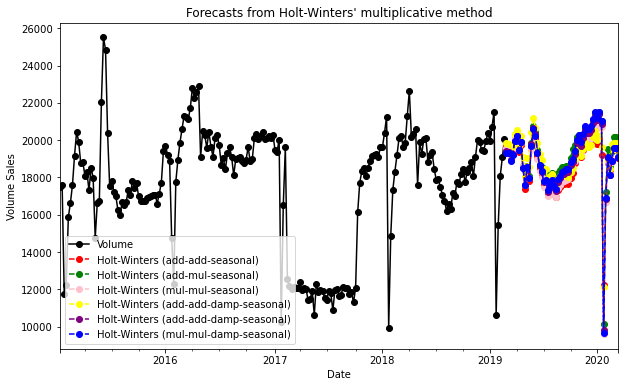

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
2430.1528699865894
2014.3240433910987
2402.574111515291
2071.562748203051
2267.6445712201876
2228.043185142992


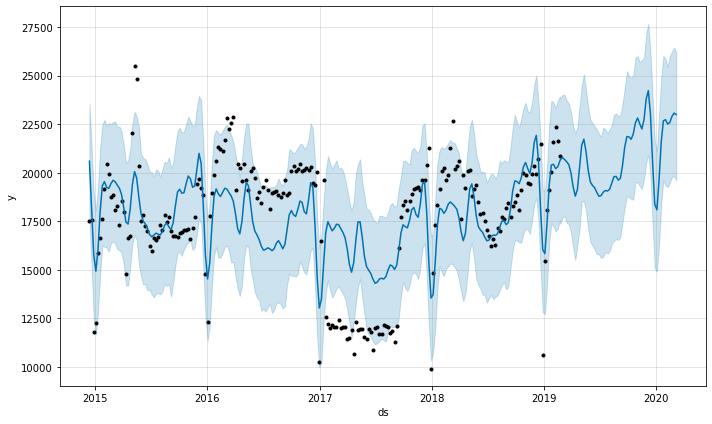

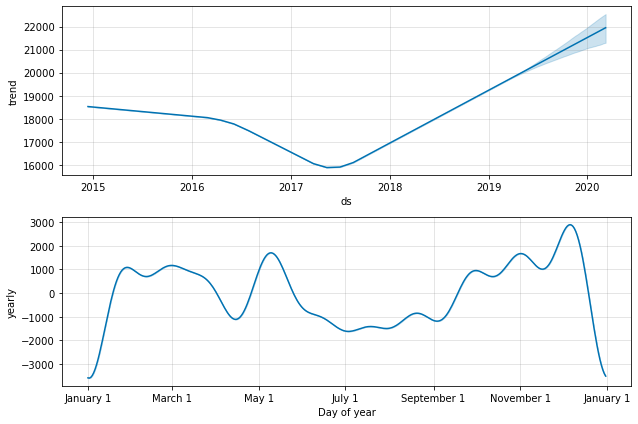

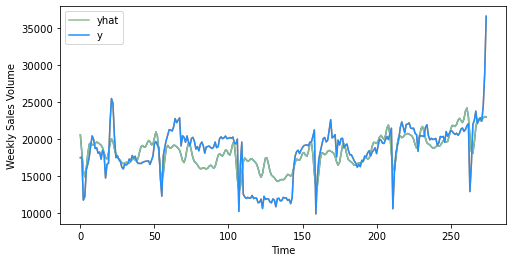

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 2504.930588969978
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

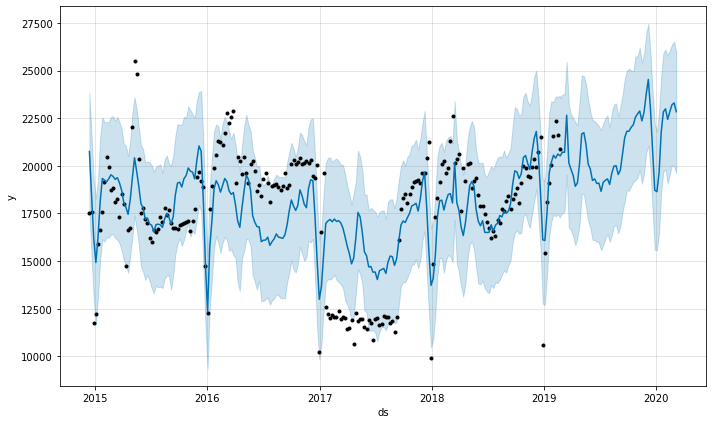

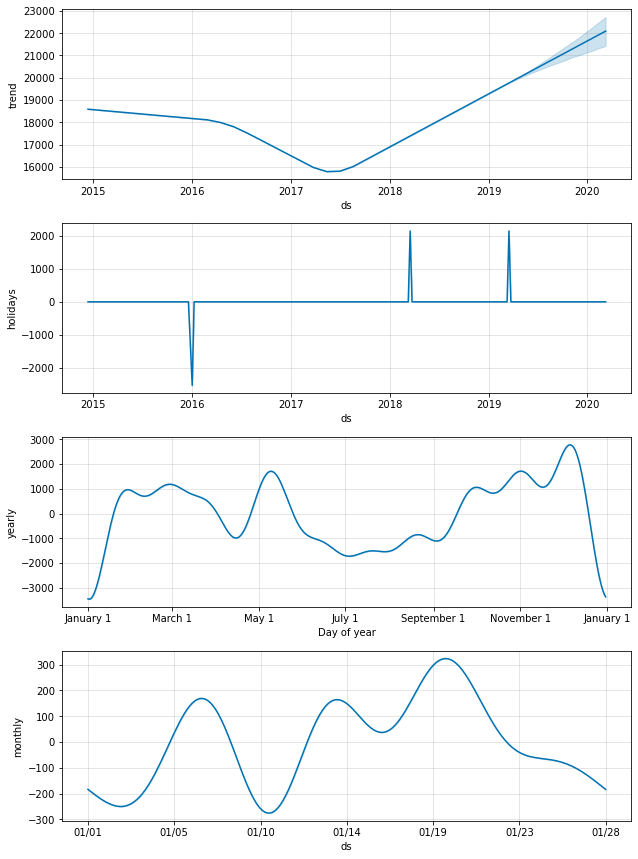

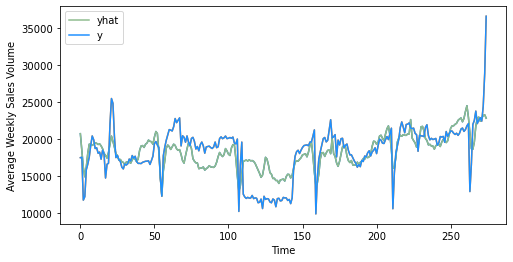

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 2485.7785064267873


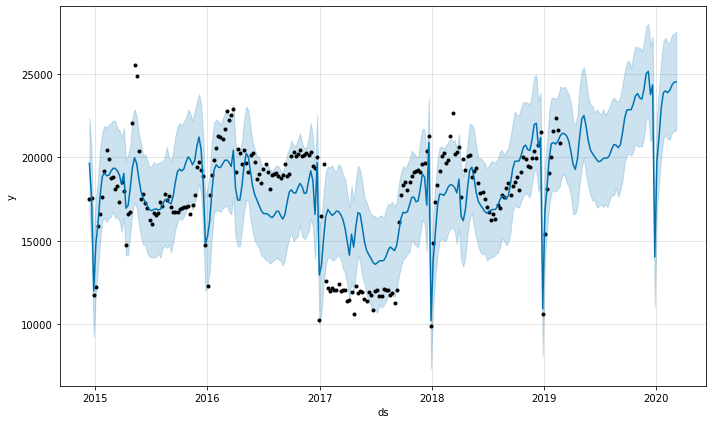

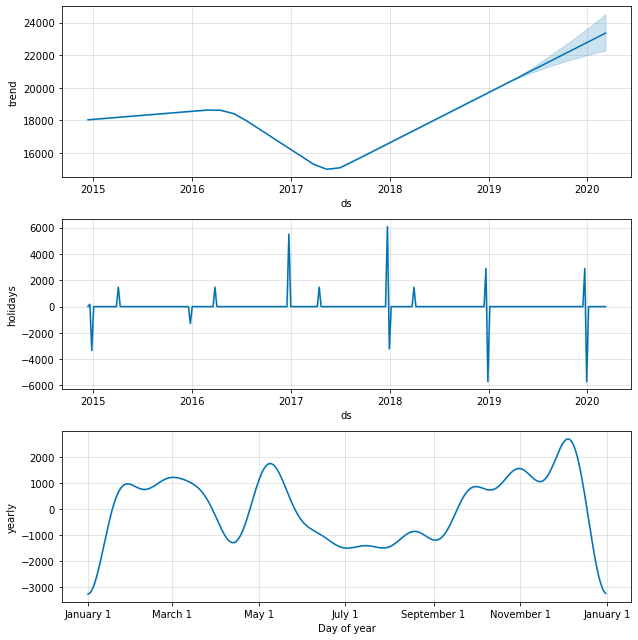

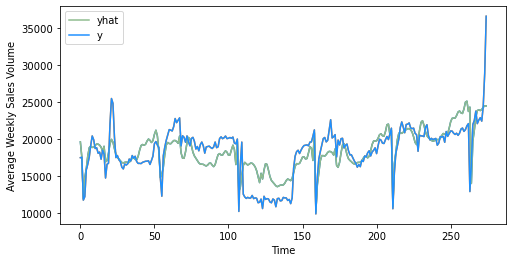

RMSE for prophet with only Christmas and Easter week is: 2273.983004161741


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [475]:
#time series models
baseline_model(mcv_rt_300g_twin_origin)
ses_model(mcv_rt_300g_twin_origin)
holt_linear_model(mcv_rt_300g_twin_origin)
holt_winter_model(mcv_rt_300g_twin_origin)
prophet_model(mcv_rt_300g_twin_origin)
prophet_all_holidays(mcv_rt_300g_twin_origin)
prophet_two_holiday(mcv_rt_300g_twin_origin)

Observations: 27
Training Observations: 16
Testing Observations: 11
[ -0.55239987  -5.41605406 -17.39163423 -32.50986718 -10.47115143]
Mean Absolute Error: 3427.049999999999
Mean Squared Error: 14953433.97931818
Root Mean Squared Error: 3866.967025889693
Observations: 38
Training Observations: 27
Testing Observations: 11
[ -1.91759839  -9.48115223 -67.9212879   -0.25213266  -1.99421427]
Mean Absolute Error: 590.3136363636357
Mean Squared Error: 786448.2829545442
Root Mean Squared Error: 886.8191940607421
Observations: 49
Training Observations: 38
Testing Observations: 11
[ -0.15314175 -92.55627349  -1.27224194  -2.1335719   -8.18358788]
Mean Absolute Error: 509.6000000000002
Mean Squared Error: 314676.427727273
Root Mean Squared Error: 560.9602728600958
Observations: 60
Training Observations: 49
Testing Observations: 11
[-7.95275094 -1.72550892 -2.24719463 -4.02933409 -0.40419567]
Mean Absolute Error: 999.0045454545453
Mean Squared Error: 1538633.265681818
Root Mean Squared Error: 1240

,var1(t-4),var1(t)
Date,,
2015-01-10,17512.0,15878
2015-01-17,17578.0,16634
2015-01-24,11776.0,17597
2015-01-31,12239.0,19168
2015-02-07,15878.0,20446
...,...,...
2020-02-15,22543.0,22913
2020-02-22,23803.0,22450
2020-02-29,22112.0,24445


   var1(t-4)   var1(t)
4   0.284564  0.223391
5   0.287035  0.251694
6   0.069821  0.287747
7   0.087155  0.346561
8   0.223391  0.394407
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 30s - loss: 0.2892 - val_loss: 0.4180
Epoch 2/50
216/216 - 0s - loss: 0.2785 - val_loss: 0.4064
Epoch 3/50
216/216 - 0s - loss: 0.2679 - val_loss: 0.3947
Epoch 4/50
216/216 - 0s - loss: 0.2572 - val_loss: 0.3826
Epoch 5/50
216/216 - 0s - loss: 0.2462 - val_loss: 0.3700
Epoch 6/50
216/216 - 0s - loss: 0.2348 - val_loss: 0.3568
Epoch 7/50
216/216 - 0s - loss: 0.2231 - val_loss: 0.3428
Epoch 8/50
216/216 - 0s - loss: 0.2112 - val_loss: 0.3281
Epoch 9/50
216/216 - 0s - loss: 0.2007 - val_loss: 0.3129
Epoch 10/50
216/216 - 0s - loss: 0.1908 - val_loss: 0.2978
Epoch 11/50
216/216 - 0s - loss: 0.1807 - val_loss: 0.2820
Epoch 12/50
216/216 - 0s - loss: 0.1702 - val_loss: 0.2652
Epoch 13/50
216/216 - 0s - loss: 0.1589 - val_loss: 0.2473
Epoch 14/50
216/216 - 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:46: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

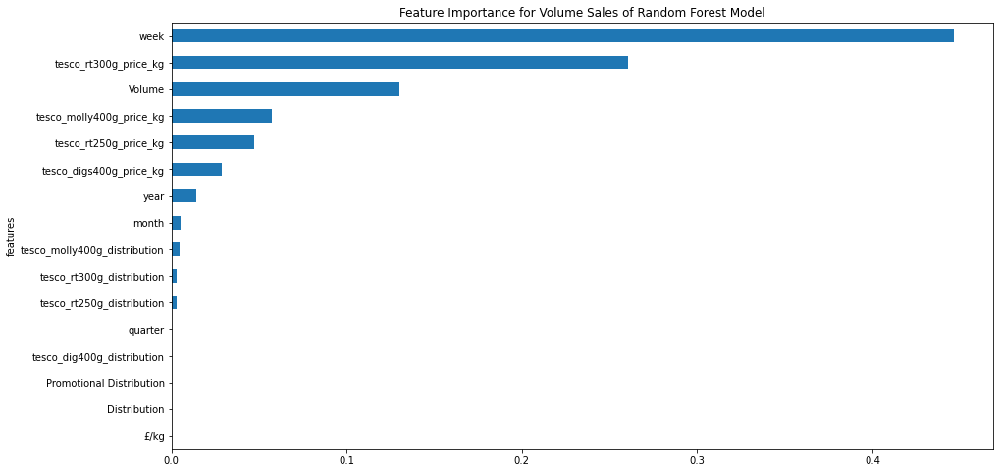

<Figure size 432x288 with 0 Axes>

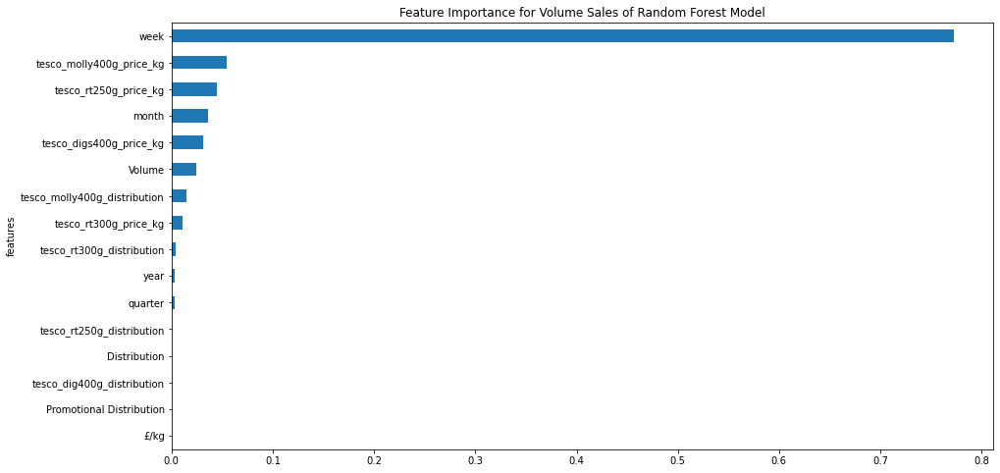

<Figure size 432x288 with 0 Axes>

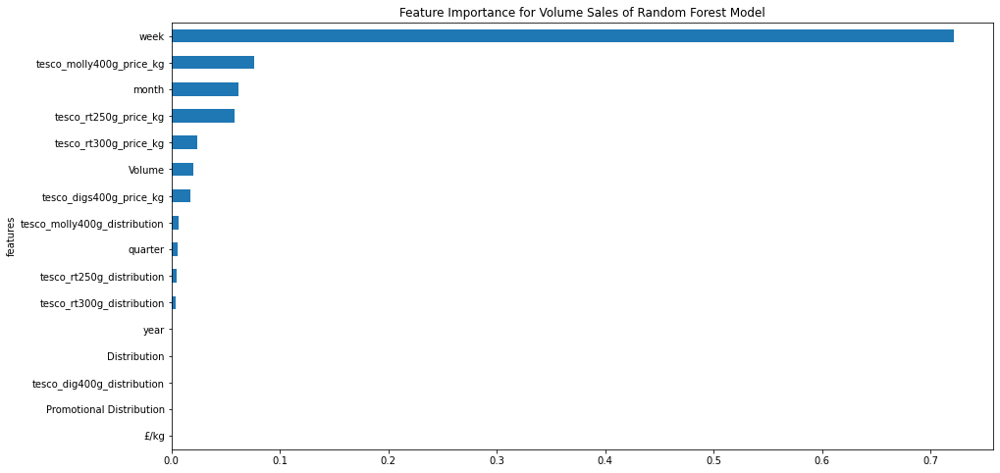

<Figure size 432x288 with 0 Axes>

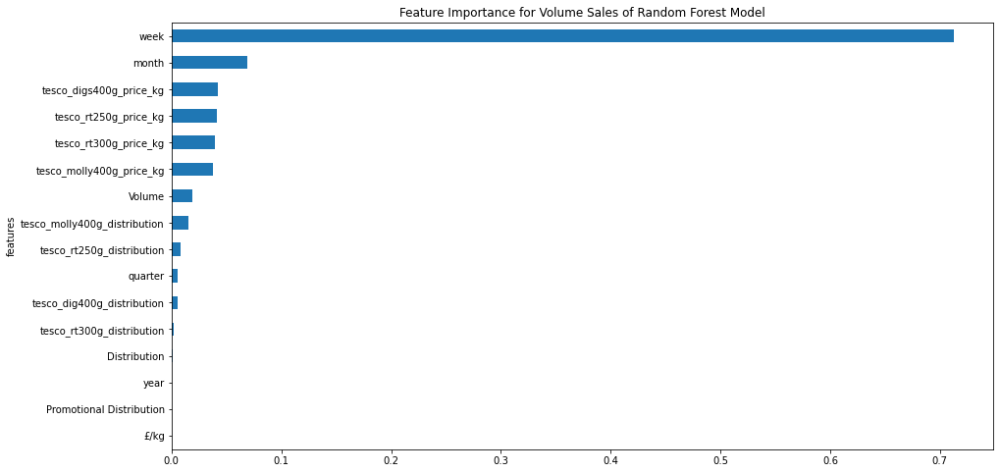

<Figure size 432x288 with 0 Axes>

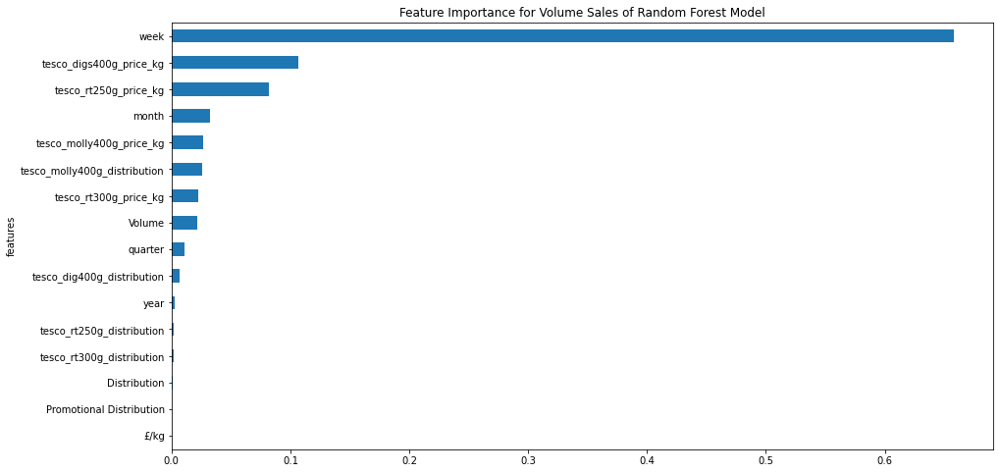

<Figure size 432x288 with 0 Axes>

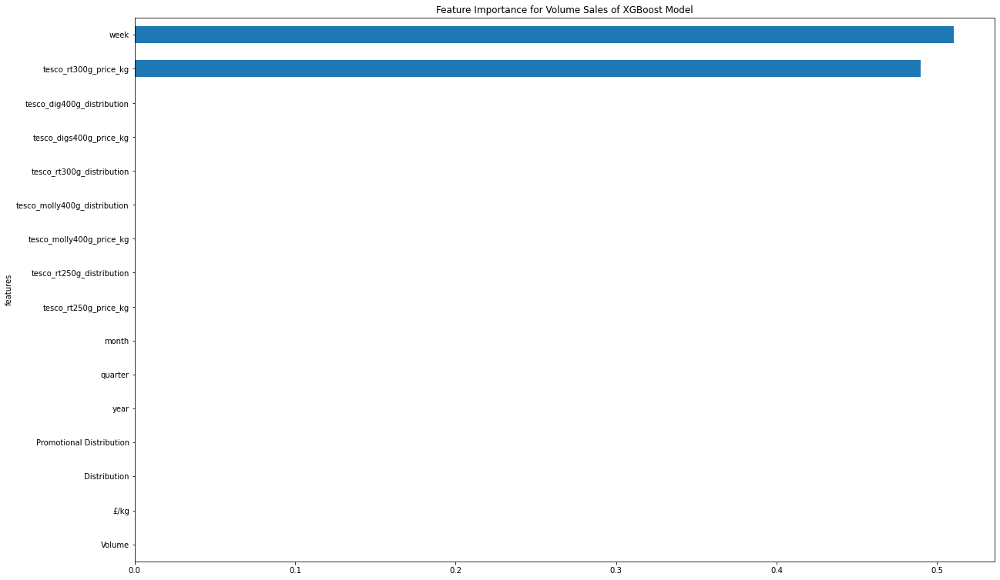

<Figure size 432x288 with 0 Axes>

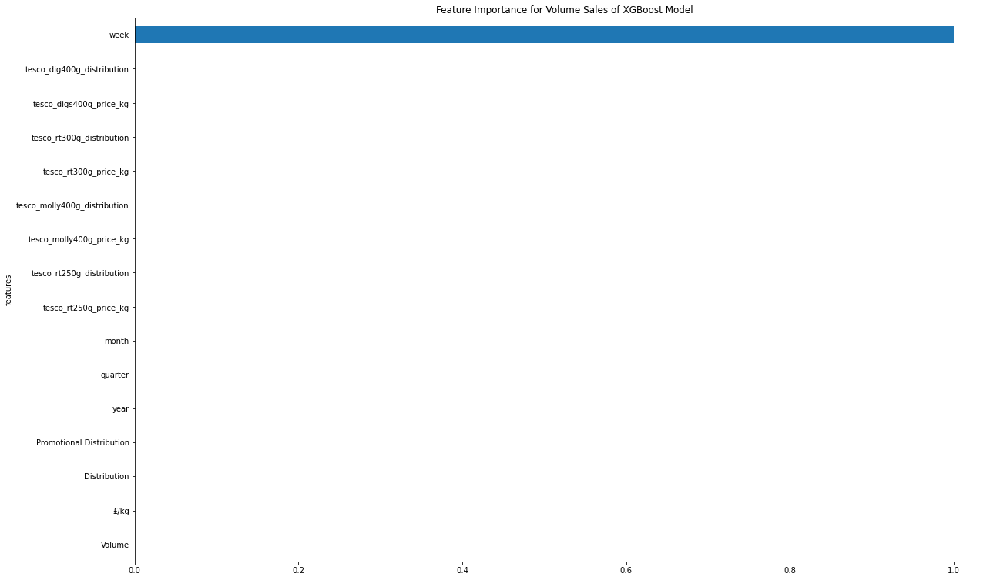

<Figure size 432x288 with 0 Axes>

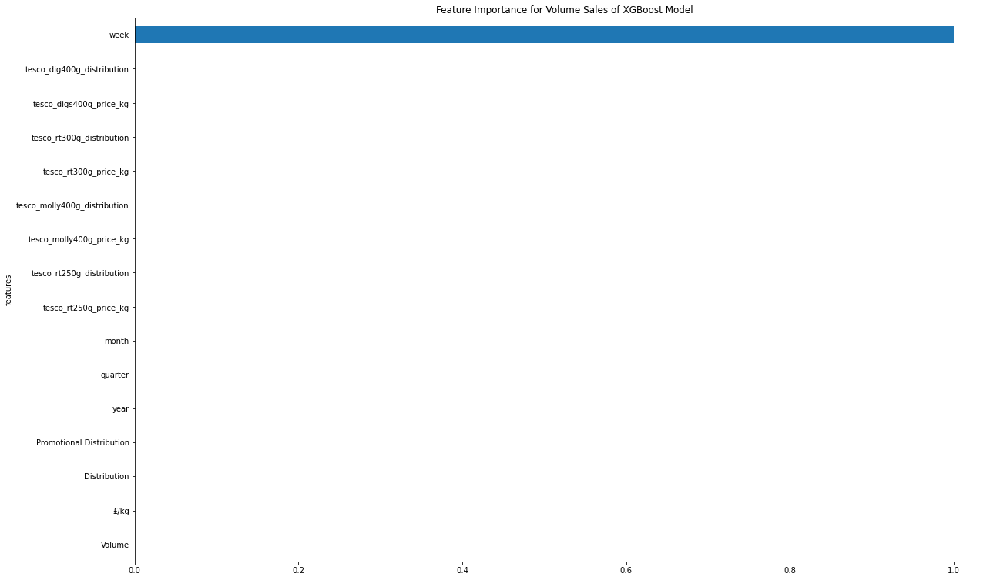

<Figure size 432x288 with 0 Axes>

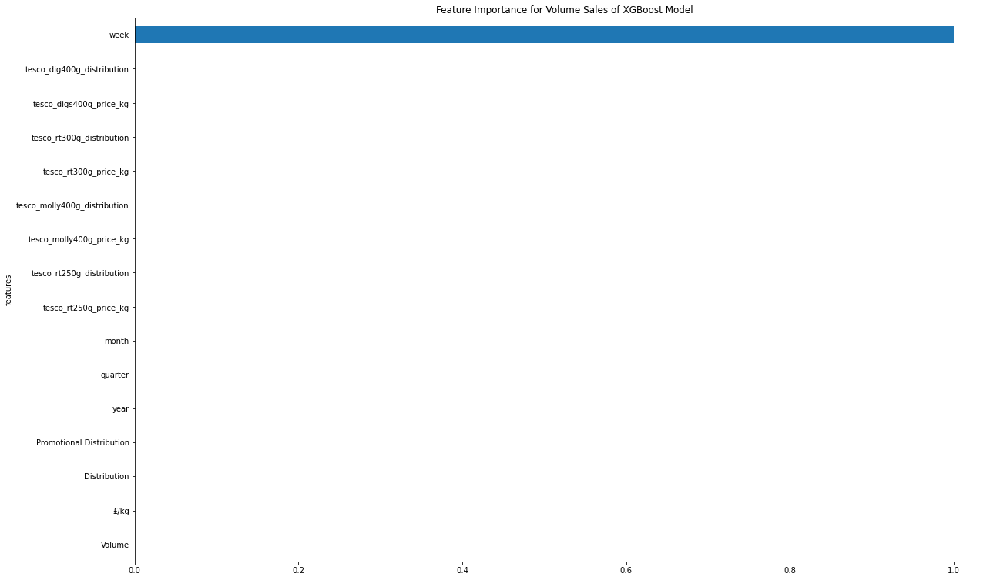

<Figure size 432x288 with 0 Axes>

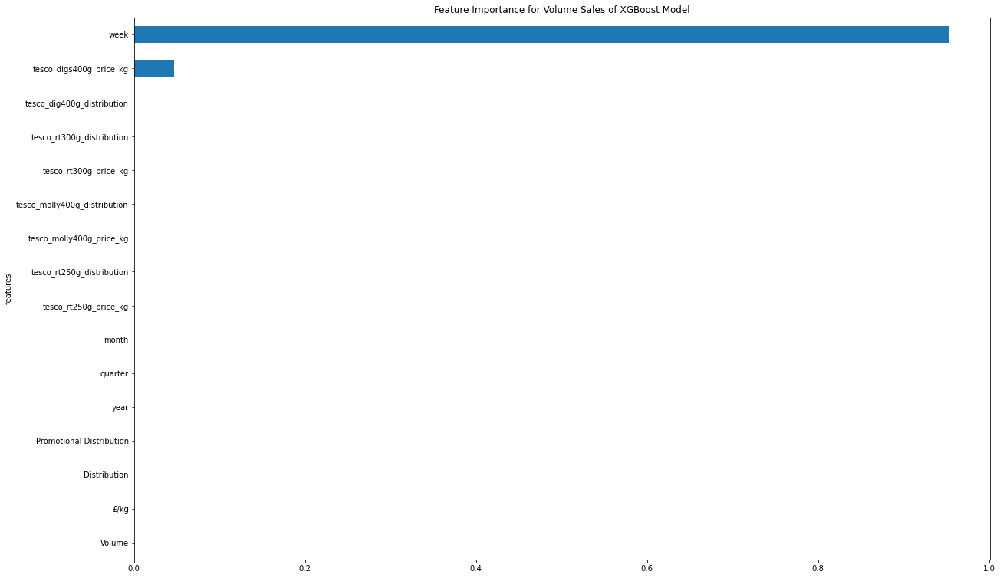

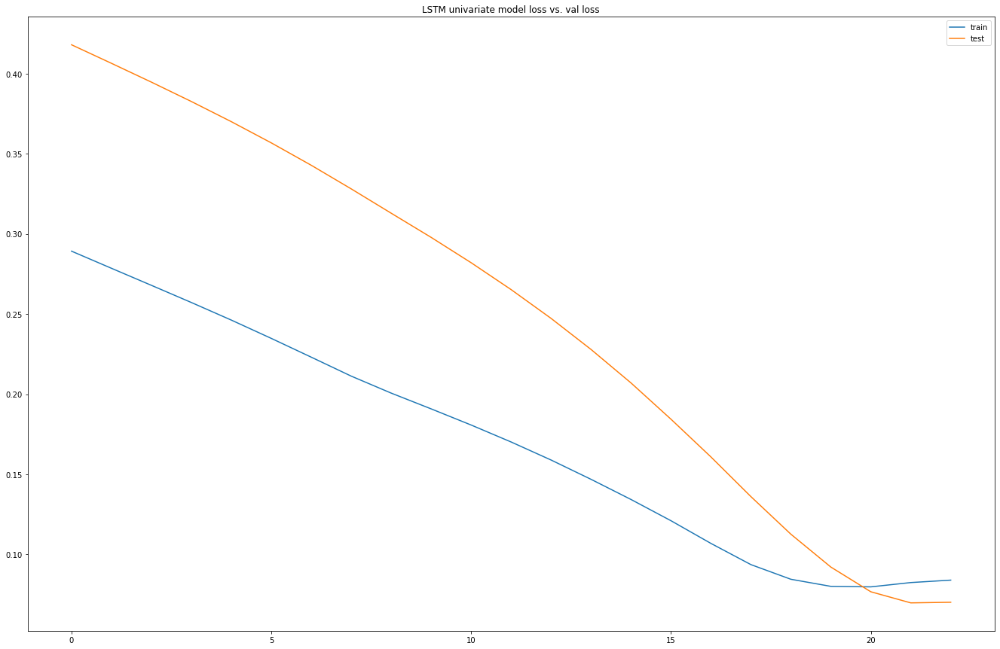

Test RMSE: 3142.935


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,17512.0,3.15,96.0,0.0,2014.0,4.0,12.0,50.0,15878,3.15,96,0,2015,1,1,2
2015-01-17,17578.0,3.15,96.0,0.0,2014.0,4.0,12.0,51.0,16634,3.15,96,0,2015,1,1,3
2015-01-24,11776.0,3.15,96.0,0.0,2014.0,4.0,12.0,52.0,17597,3.15,96,0,2015,1,1,4
2015-01-31,12239.0,3.15,96.0,0.0,2015.0,1.0,1.0,1.0,19168,3.15,96,0,2015,1,1,5
2015-02-07,15878.0,3.15,96.0,0.0,2015.0,1.0,1.0,2.0,20446,3.15,96,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,22543.0,3.15,98.0,0.0,2020.0,1.0,1.0,3.0,22913,3.32,98,0,2020,1,2,7
2020-02-22,23803.0,3.15,98.0,0.0,2020.0,1.0,1.0,4.0,22450,3.32,98,0,2020,1,2,8
2020-02-29,22112.0,3.15,98.0,0.0,2020.0,1.0,2.0,5.0,24445,3.32,98,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.284564   0.792683   0.918919        0.0   0.000000        1.0   
5   0.287035   0.792683   0.918919        0.0   0.000000        1.0   
6   0.069821   0.792683   0.918919        0.0   0.000000        1.0   
7   0.087155   0.792683   0.918919        0.0   0.166656        0.0   
8   0.223391   0.792683   0.918919        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.223391  
5        1.0   0.961538  0.251694  
6        1.0   0.980769  0.287747  
7        0.0   0.000000  0.346561  
8        0.0   0.019231  0.394407  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 30s - loss: 0.2930 - val_loss: 0.4067
Epoch 2/50
216/216 - 0s - loss: 0.2692 - val_loss: 0.3797
Epoch 3/50
216/216 - 0s - loss: 0.2456 - val_loss: 0.3512
Epoch 4/50
216/216 - 0s - loss: 0.2208 - val_loss: 0.3201
Epoch 5/50
216/216 - 0s - loss: 0.1962 - va

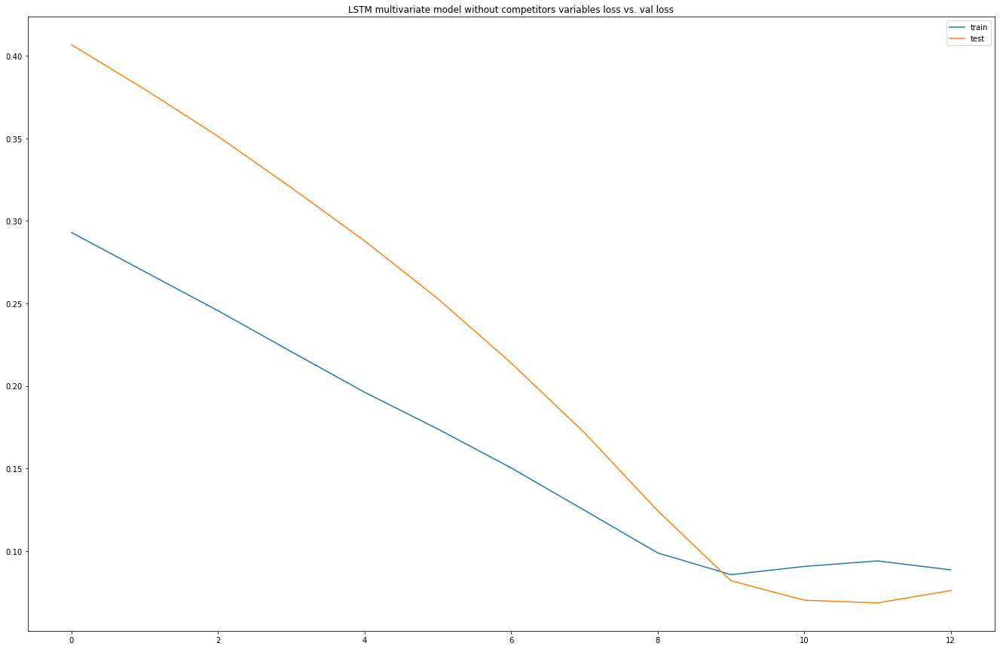

Test RMSE: 3486.862


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2018-12-08,19467.0,2018.0,4.0,11.0,45.0,18062.0,3.15,98.0,0.0,2.241567,...,98.0,0.0,2.241417,100.0,0.774982,58.0,0.999921,83.0,1.125193,99.0
2018-12-15,19428.0,2018.0,4.0,11.0,46.0,19108.0,3.15,98.0,0.0,2.241541,...,98.0,0.0,2.241440,100.0,0.774977,58.0,0.999939,83.0,1.125797,99.0
2018-12-22,19941.0,2018.0,4.0,11.0,47.0,20010.0,3.15,98.0,0.0,2.241566,...,98.0,0.0,2.241489,100.0,0.774914,58.0,0.999886,83.0,1.125535,99.0
2018-12-29,20365.0,2018.0,4.0,12.0,48.0,19879.0,3.15,98.0,0.0,2.241457,...,98.0,0.0,2.241464,100.0,0.774983,58.0,0.999433,83.0,1.125242,99.0
2019-01-05,19958.0,2018.0,4.0,12.0,49.0,19467.0,3.15,98.0,0.0,2.241417,...,98.0,0.0,2.241518,100.0,0.774887,58.0,0.999955,83.0,1.125299,99.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,22543.0,2020.0,1.0,1.0,3.0,22114.0,3.15,98.0,0.0,2.241395,...,98.0,0.0,2.241691,100.0,0.774992,93.0,0.999908,83.0,1.250209,98.0
2020-02-22,23803.0,2020.0,1.0,1.0,4.0,12931.0,3.15,98.0,0.0,2.241631,...,98.0,0.0,2.241683,100.0,0.774985,93.0,0.999957,83.0,1.250202,98.0
2020-02-29,22112.0,2020.0,1.0,2.0,5.0,16623.0,3.15,98.0,0.0,2.241635,...,98.0,0.0,2.241582,100.0,0.774998,93.0,0.999954,83.0,1.250188,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.340522        0.0        1.0   0.909091   0.862745   0.564878   
5   0.339023        0.0        1.0   0.909091   0.882353   0.644156   
6   0.358744        0.0        1.0   0.909091   0.901961   0.712521   
7   0.375043        0.0        1.0   1.000000   0.921569   0.702592   
8   0.359397        0.0        1.0   1.000000   0.941177   0.671366   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4        0.0        1.0        0.0    0.994400         1.0    0.980005   
5        0.0        1.0        0.0    0.993778         1.0    0.979163   
6        0.0        1.0        0.0    0.994396         1.0    0.978738   
7        0.0        1.0        0.0    0.991779         1.0    0.979244   
8        0.0        1.0        0.0    0.990829         1.0    0.978948   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.136842    0.982941         0.5    0.760128     

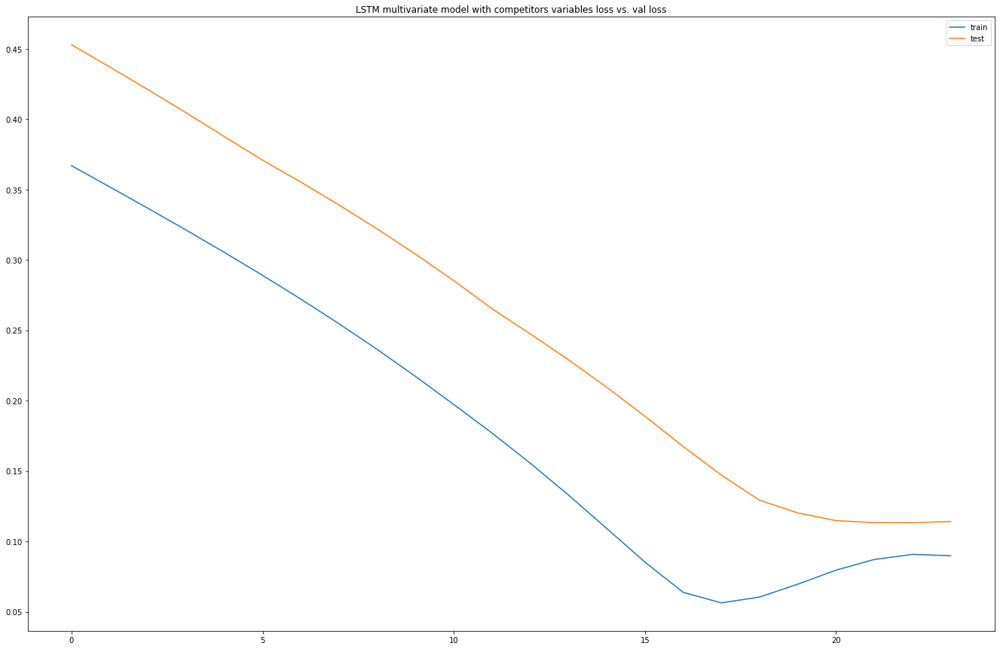

Test RMSE: 5016.641


In [476]:
#ml models
mcv_rt_300g_twin_with_comp=variable_lag(mcv_rt_300g_twin_with_comp)
mcv_rt_300g_twin_input_X,mcv_rt_300g_twin_input_Y=input_var(mcv_rt_300g_twin_with_comp)
rf_regressor_mcv(mcv_rt_300g_twin_input_X,mcv_rt_300g_twin_input_Y)

mcv_rt_300g_twin_input_X,mcv_rt_300g_twin_input_Y=input_var(mcv_rt_300g_twin_with_comp)
xgb_regressor_mcv(mcv_rt_300g_twin_input_X,mcv_rt_300g_twin_input_Y)

#lstm models
series_to_supervised(mcv_rt_300g_twin_volume)
lstm_univariate(mcv_rt_300g_twin_volume)

series_to_supervised(mcv_rt_300g_twin_own_variable)
multivariate_lstm_without_competitor(mcv_rt_300g_twin_own_variable)

series_to_supervised(mcv_rt_300g_twin_with_comp)
multivariate_with_competitor(mcv_rt_300g_twin_with_comp)

## Tesco Large - Tesco Rich Tea 250g (Competitor)

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,54378,13594.5,27201.2,98,0,0.500224,2.000897,2014,4,12,50
1,2014-12-20,51398,12849.5,25709.2,98,0,0.500198,2.000794,2014,4,12,51
2,2014-12-27,35281,8820.3,17648.5,98,0,0.500227,2.000896,2014,4,12,52
3,2015-01-03,35677,8919.3,17847.5,98,0,0.500252,2.000998,2015,1,1,1
4,2015-01-10,48619,12154.8,24322.0,98,0,0.500257,2.001020,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.00000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,56206.12000,14051.554182,27940.253818,95.465455,0.0,0.492309,1.969162,2017.083636,2.469091,6.414545,26.043636
std,13731.15737,3432.792086,7969.553785,18.323972,0.0,0.067310,0.269348,1.534371,1.140635,3.547767,15.490223
min,2.00000,0.500000,0.800000,0.000000,0.0,0.389474,1.541667,2014.000000,1.000000,1.000000,1.000000
25%,54871.00000,13717.800000,24597.800000,98.000000,0.0,0.400055,1.600222,2016.000000,1.000000,3.000000,12.000000
50%,59591.00000,14897.800000,29419.500000,100.000000,0.0,0.500217,2.000870,2017.000000,2.000000,6.000000,26.000000
75%,62805.50000,15701.400000,33396.050000,100.000000,0.0,0.560321,2.241278,2018.000000,3.500000,9.500000,39.500000
95%,67047.70000,16761.940000,36391.630000,100.000000,0.0,0.560395,2.241577,2019.000000,4.000000,12.000000,50.000000
99%,70972.94000,17743.272000,39030.728000,100.000000,0.0,0.560431,2.241716,2020.000000,4.000000,12.000000,52.000000
max,94573.00000,23643.300000,52998.200000,100.000000,0.0,0.560452,2.241802,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

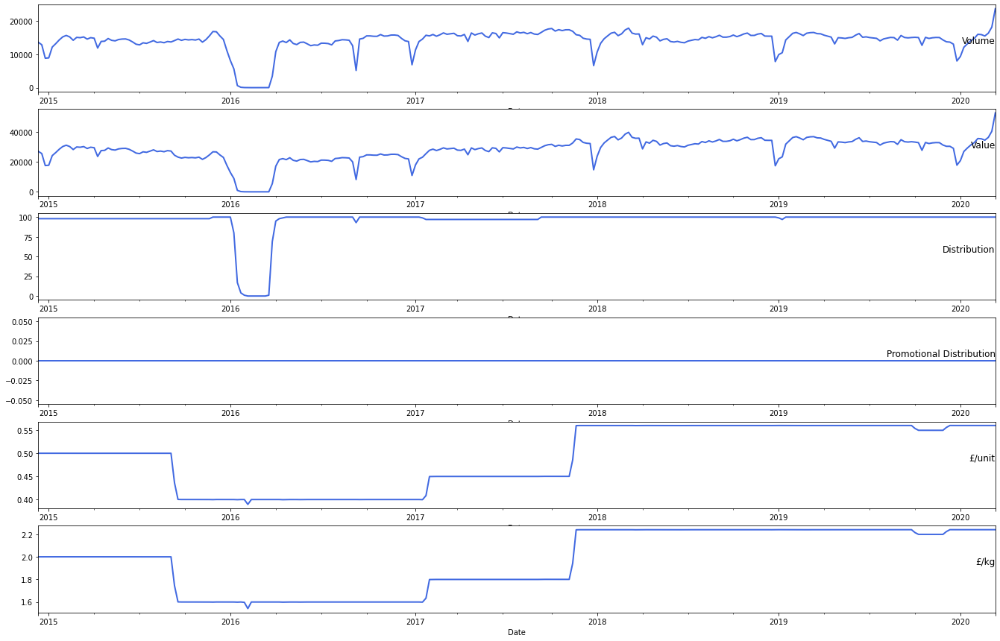

(<matplotlib.axes._subplots.AxesSubplot at 0x7f53397977b8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53396bd630>)

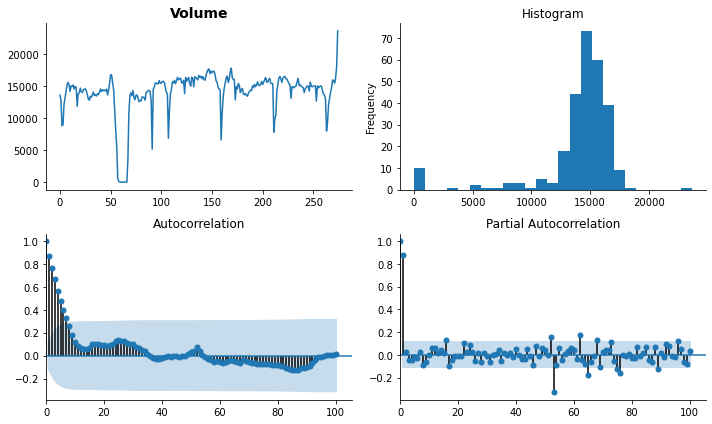

In [506]:
basic_info(tes_rt_250g_origin)
plot_data(tes_rt_250g_origin)
tsplot(tes_rt_250g_origin['Volume'].dropna(), title=tes_rt_250g_origin.columns[2], lags=100)


Test Statistic                  -3.567857
p-value                          0.006406
#Lags Used                       0.000000
Number of Observations Used    274.000000
Critical Value (1%)             -3.454444
Critical Value (5%)             -2.872147
Critical Value (10%)            -2.572422
dtype: float64


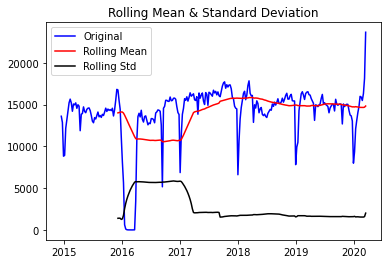

(<matplotlib.axes._subplots.AxesSubplot at 0x7f53394e5710>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5339404400>)

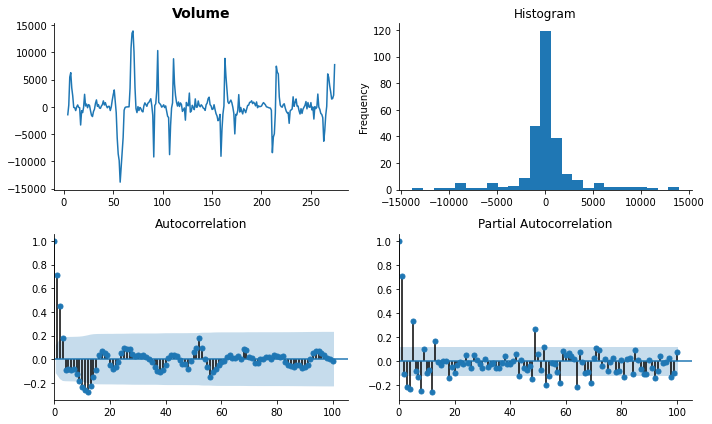

In [507]:
plot(tes_rt_250g_origin)
series_transformed=tes_rt_250g_origin.copy()
series_transformed['Volume_transformed']=tes_rt_250g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=tes_rt_250g_origin.columns[2], lags=100)
# plot_transform(tes_rt_250g_origin)


       t-4      t+1
0      NaN  13594.5
1      NaN  12849.5
2      NaN   8820.3
3      NaN   8919.3
4  13594.5  12154.8
Test MSE: 4803236.685
Test RMSE: 2191.629


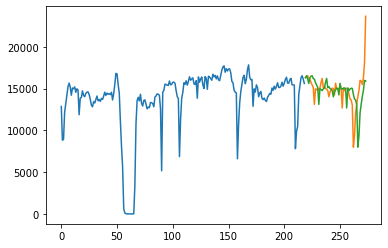

Observations: 271
Training Observations: 216
Testing Observations: 55


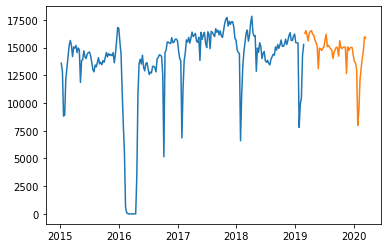

RMSE for Simple Exponential Smoothing α= 0.1 is: 1682.49
RMSE for Simple Exponential Smoothing α= 0.2 is: 1996.59
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2082.4
RMSE for Simple Exponential Smoothing α= 0.4 is: 1957.99
RMSE for Simple Exponential Smoothing α= 0.5 is: 1760.86
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 1602.75
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 1533.41
RMSE for Simple Exponential Smoothing α= 0.8 is: 1539.9
RMSE for Simple Exponential Smoothing α= 0.9 is: 1580.92


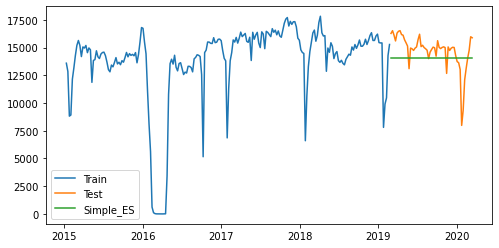

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.6000000000000001 and β= 0.1 is: 1678.67


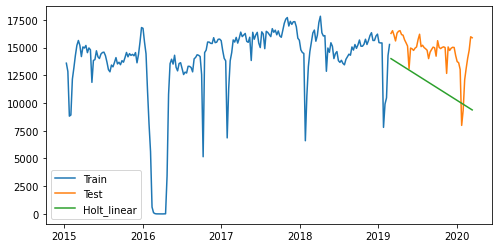

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

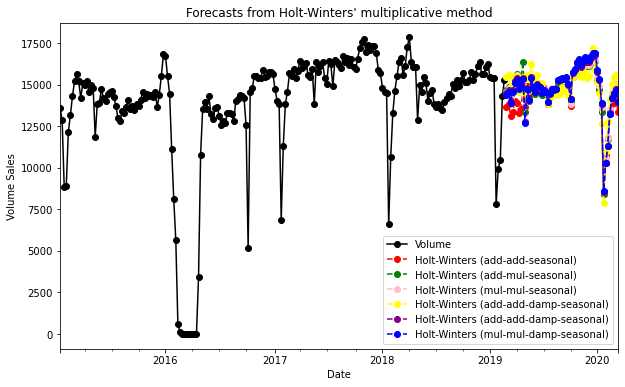

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
1577.1161324806146
1170.125034624273
1234.5069781389673
1106.4054525209729
1338.3054056240962
1398.8848211383574


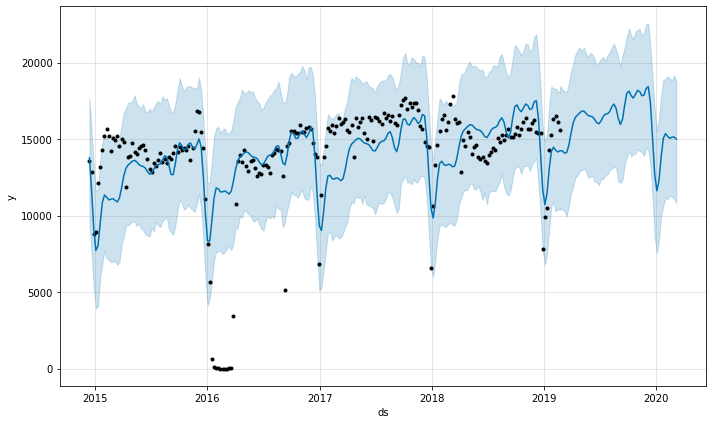

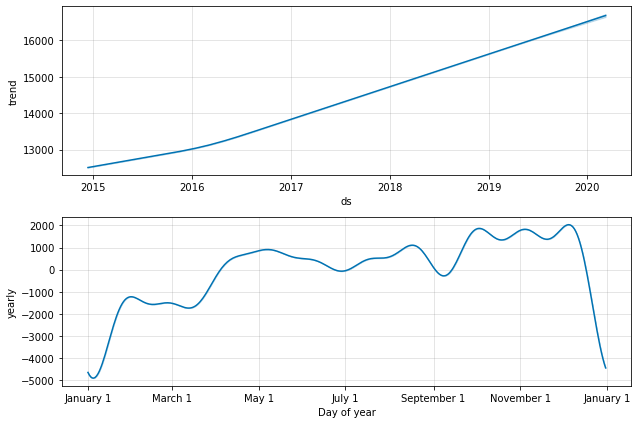

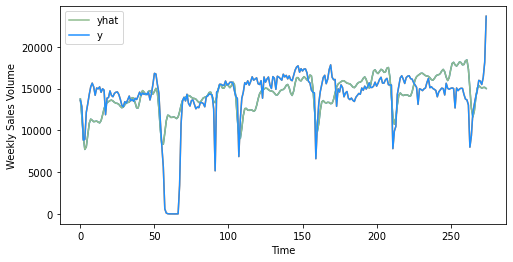

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 3019.956152313255
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

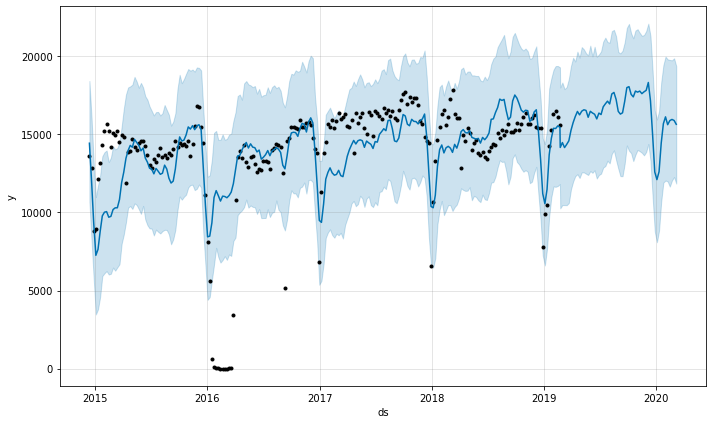

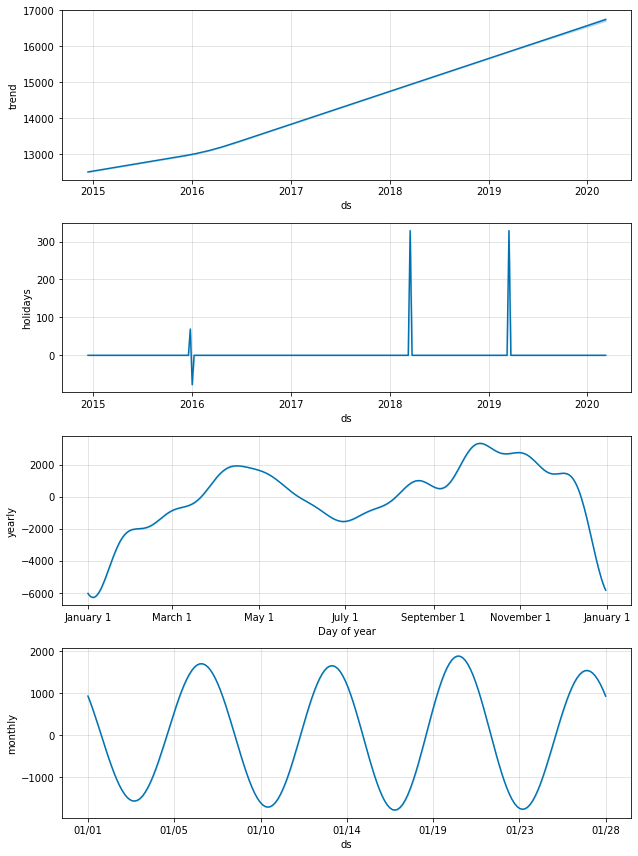

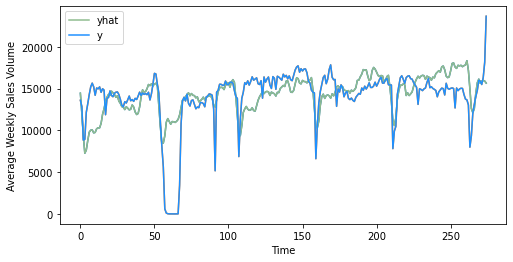

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 2945.8006697363635


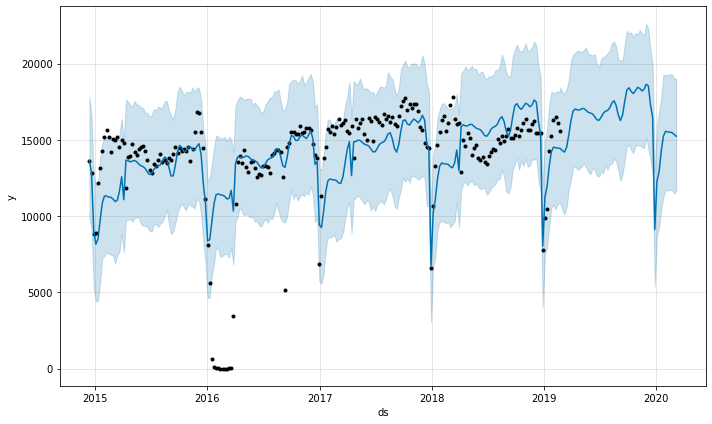

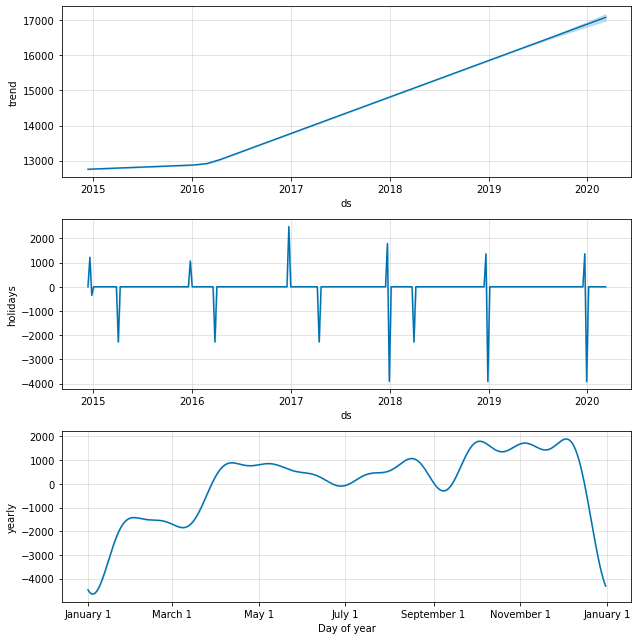

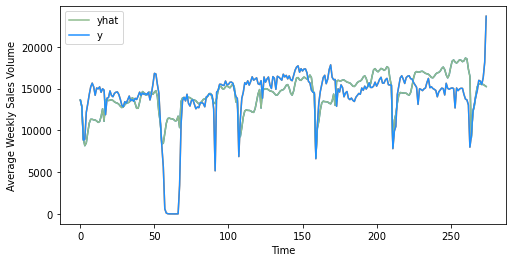

RMSE for prophet with only Christmas and Easter week is: 2987.544262094129


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [508]:
#time series models
baseline_model(tes_rt_250g_origin)
ses_model(tes_rt_250g_origin)
holt_linear_model(tes_rt_250g_origin)
holt_winter_model(tes_rt_250g_origin)
prophet_model(tes_rt_250g_origin)
prophet_all_holidays(tes_rt_250g_origin)
prophet_two_holiday(tes_rt_250g_origin)

## trend comparison


<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_volume')

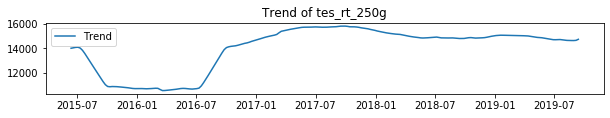

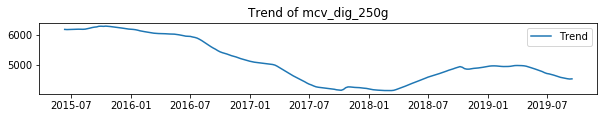

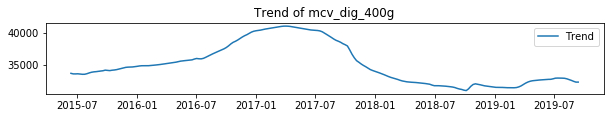

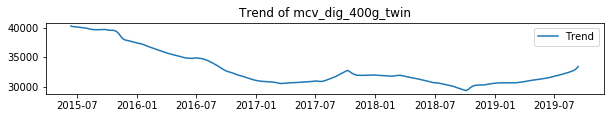

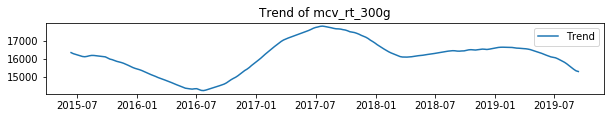

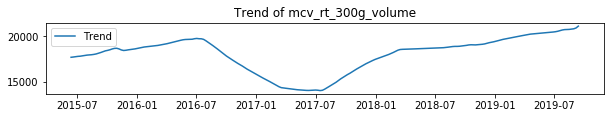

In [133]:
tes_rt_250g_competitor=[tes_rt_250g_volume, mcv_dig_250g_volume, mcv_dig_400g_volume, mcv_dig_400g_twin_volume, mcv_rt_300g_volume, mcv_rt_300g_twin_volume]
tes_rt_250g_competitor_list=['tes_rt_250g','mcv_dig_250g','mcv_dig_400g','mcv_dig_400g_twin','mcv_rt_300g','mcv_rt_300g_volume']
tes_dig_400g_competitor=[tes_dig_400g_volume,mcv_dig_250g_volume,mcv_dig_400g_volume,mcv_dig_400g_twin_volume, mcv_rt_300g_volume, mcv_rt_300g_twin_volume]
tes_dig_400g_competitor_list=['tes_dig_400g','mcv_dig_250g','mcv_dig_400g','mcv_dig_400g_twin','mcv_rt_300g','mcv_rt_300g_volume']
tes_rt_300g_competitor=[tes_rt_300g_volume,mcv_dig_250g_volume,mcv_dig_400g_volume,mcv_dig_400g_twin_volume, mcv_rt_300g_volume, mcv_rt_300g_twin_volume]
tes_rt_300g_competitor_list=['tes_rt_300g','mcv_dig_250g','mcv_dig_400g','mcv_dig_400g_twin','mcv_rt_300g','mcv_rt_300g_volume']
tes_molly_400g_competitor=[tes_molly_400g_volume,mcv_dig_250g_volume,mcv_dig_400g_volume,mcv_dig_400g_twin_volume, mcv_rt_300g_volume, mcv_rt_300g_twin_volume]
tes_molly_400g_competitor_list=['tes_molly_400g','mcv_dig_250g','mcv_dig_400g','mcv_dig_400g_twin','mcv_rt_300g','mcv_rt_300g_volume']


i=0
for product in tes_rt_250g_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + tes_rt_250g_competitor_list[i] )
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_volume')

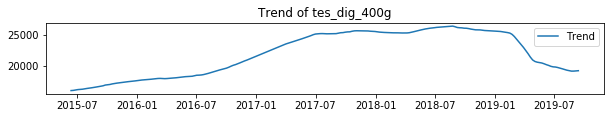

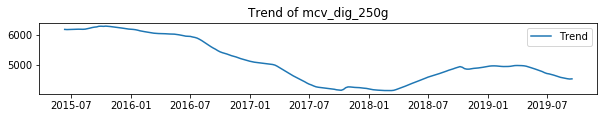

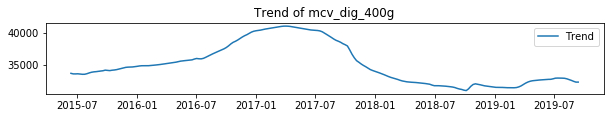

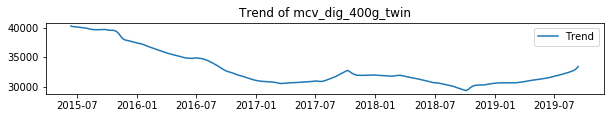

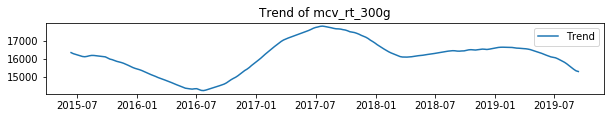

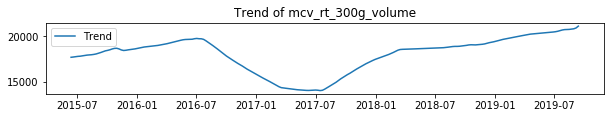

In [134]:
i=0
for product in tes_dig_400g_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + tes_dig_400g_competitor_list[i] )
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of tes_rt_300g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_volume')

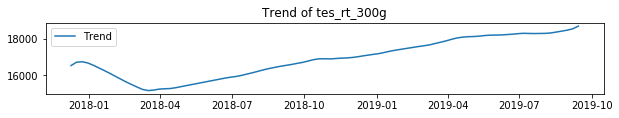

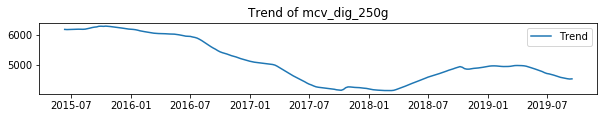

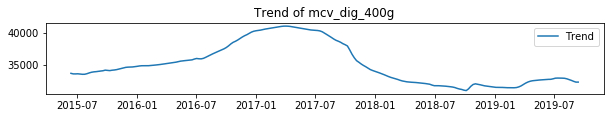

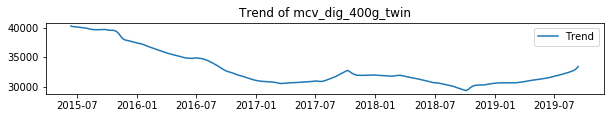

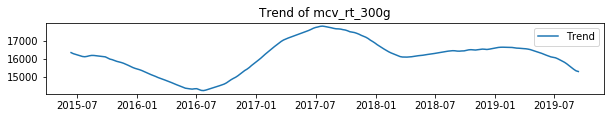

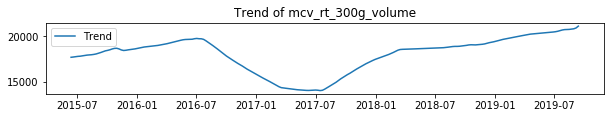

In [135]:
i=0
for product in tes_rt_300g_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + tes_rt_300g_competitor_list[i] )
    i=i+1

Tesco molly400g does not contain enough datapoints to capture the trends.

In [512]:
# i=0
# for product in tes_molly_400g_competitor:
#     decomposition=seasonal_decompose(product)
#     trend_1=decomposition.trend

#     plt.figure(figsize=(10,6))
#     plt.subplot(412)
#     plt.plot(trend_1, label='Trend')
#     plt.legend(loc='best')
#     plt.title('Trend of ' + tes_molly_400g_competitor_list[i] )
#     i=i+1

plot trend comparisons graphs

,tes_rt_250g_trend,mcv_dig_250g_trend,mcv_dig_400g_trend,mcv_dig_400g_twin_trend,mcv_rt_300g_trend,mcv_rt_300g_twin_trend
tes_rt_250g_trend,1.000000,-0.886110,0.073859,-0.767722,0.760581,-0.394315
mcv_dig_250g_trend,-0.886110,1.000000,-0.000553,0.815187,-0.665818,0.284689
mcv_dig_400g_trend,0.073859,-0.000553,1.000000,-0.057685,0.122796,-0.833973
mcv_dig_400g_twin_trend,-0.767722,0.815187,-0.057685,1.000000,-0.426095,0.183894
mcv_rt_300g_trend,0.760581,-0.665818,0.122796,-0.426095,1.000000,-0.563714
mcv_rt_300g_twin_trend,-0.394315,0.284689,-0.833973,0.183894,-0.563714,1.000000


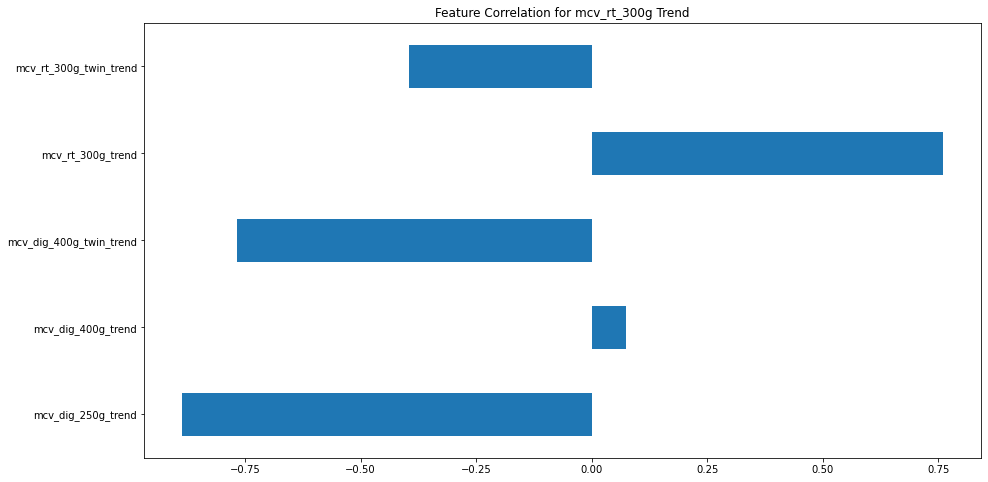

In [513]:
decomposition_1=seasonal_decompose(tes_rt_250g_volume)
trend_1=decomposition_1.trend
trend_1=trend_1.to_frame()

comp_decomposition_1=seasonal_decompose(mcv_dig_250g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(mcv_dig_400g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(mcv_dig_400g_twin_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(mcv_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

comp_decomposition_5=seasonal_decompose(mcv_rt_300g_twin_volume)
comp_trend5=comp_decomposition_5.trend
comp_trend5=comp_trend5.to_frame()

tes_rt_250g_comp=pd.merge(trend_1,comp_trend1, how='left', on='Date')
tes_rt_250g_comp=pd.merge(tes_rt_250g_comp,comp_trend2, how='left', on='Date')
tes_rt_250g_comp=pd.merge(tes_rt_250g_comp,comp_trend3, how='left', on='Date')
tes_rt_250g_comp=pd.merge(tes_rt_250g_comp,comp_trend4, how='left', on='Date')
tes_rt_250g_comp=pd.merge(tes_rt_250g_comp,comp_trend5, how='left', on='Date')
tes_rt_250g_comp.columns=['tes_rt_250g_trend', 'mcv_dig_250g_trend','mcv_dig_400g_trend','mcv_dig_400g_twin_trend','mcv_rt_300g_trend','mcv_rt_300g_twin_trend']

tes_rt_250g_comp.corr()

#correlation graph
tes_rt_250g_comp_corr=tes_rt_250g_comp.corr()
# mcv_rt_300g_twin_comp_corr.iloc[0][1:]
tes_rt_250g_comp_corr.iloc[0][1:].plot(kind='barh', x='features', y='Correlation', title="Feature Correlation for mcv_rt_300g Trend",legend=False, figsize=(15, 8))



In [514]:
decomposition_2=seasonal_decompose(tes_dig_400g_volume)
trend_2=decomposition_2.trend
trend_2=trend_2.to_frame()

comp_decomposition_1=seasonal_decompose(mcv_dig_250g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(mcv_dig_400g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(mcv_dig_400g_twin_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(mcv_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

comp_decomposition_5=seasonal_decompose(mcv_rt_300g_twin_volume)
comp_trend5=comp_decomposition_5.trend
comp_trend5=comp_trend5.to_frame()

tes_dig_400g_comp=pd.merge(trend_2,comp_trend1, how='left', on='Date')
tes_dig_400g_comp=pd.merge(tes_dig_400g_comp,comp_trend2, how='left', on='Date')
tes_dig_400g_comp=pd.merge(tes_dig_400g_comp,comp_trend3, how='left', on='Date')
tes_dig_400g_comp=pd.merge(tes_dig_400g_comp,comp_trend4, how='left', on='Date')
tes_dig_400g_comp=pd.merge(tes_dig_400g_comp,comp_trend5, how='left', on='Date')
tes_dig_400g_comp.columns=['tes_dig_400g_trend', 'mcv_dig_250g_trend','mcv_dig_400g_trend','mcv_dig_400g_twin_trend','mcv_rt_300g_trend','mcv_rt_300g_twin_trend']

tes_dig_400g_comp.corr()


,tes_dig_400g_trend,mcv_dig_250g_trend,mcv_dig_400g_trend,mcv_dig_400g_twin_trend,mcv_rt_300g_trend,mcv_rt_300g_twin_trend
tes_dig_400g_trend,1.000000,-0.866579,-0.079756,-0.838641,0.675009,-0.299945
mcv_dig_250g_trend,-0.866579,1.000000,-0.000553,0.815187,-0.665818,0.284689
mcv_dig_400g_trend,-0.079756,-0.000553,1.000000,-0.057685,0.122796,-0.833973
mcv_dig_400g_twin_trend,-0.838641,0.815187,-0.057685,1.000000,-0.426095,0.183894
mcv_rt_300g_trend,0.675009,-0.665818,0.122796,-0.426095,1.000000,-0.563714
mcv_rt_300g_twin_trend,-0.299945,0.284689,-0.833973,0.183894,-0.563714,1.000000


In [515]:
decomposition_3=seasonal_decompose(tes_rt_300g_volume)
trend_3=decomposition_3.trend
trend_3=trend_3.to_frame()

comp_decomposition_1=seasonal_decompose(mcv_dig_250g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(mcv_dig_400g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(mcv_dig_400g_twin_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(mcv_rt_300g_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

comp_decomposition_5=seasonal_decompose(mcv_rt_300g_twin_volume)
comp_trend5=comp_decomposition_5.trend
comp_trend5=comp_trend5.to_frame()

tes_rt_300g_comp=pd.merge(trend_3,comp_trend1, how='left', on='Date')
tes_rt_300g_comp=pd.merge(tes_rt_300g_comp,comp_trend2, how='left', on='Date')
tes_rt_300g_comp=pd.merge(tes_rt_300g_comp,comp_trend3, how='left', on='Date')
tes_rt_300g_comp=pd.merge(tes_rt_300g_comp,comp_trend4, how='left', on='Date')
tes_rt_300g_comp=pd.merge(tes_rt_300g_comp,comp_trend5, how='left', on='Date')
tes_rt_300g_comp.columns=['tes_rt_300g_trend', 'mcv_dig_250g_trend','mcv_dig_400g_trend','mcv_dig_400g_twin_trend','mcv_rt_300g_trend','mcv_rt_300g_twin_trend']

tes_rt_300g_comp.corr()


,tes_rt_300g_trend,mcv_dig_250g_trend,mcv_dig_400g_trend,mcv_dig_400g_twin_trend,mcv_rt_300g_trend,mcv_rt_300g_twin_trend
tes_rt_300g_trend,1.000000,0.609020,0.013966,0.159325,-0.195562,0.843504
mcv_dig_250g_trend,0.609020,1.000000,-0.603819,-0.660605,-0.369204,0.665707
mcv_dig_400g_trend,0.013966,-0.603819,1.000000,0.338117,0.825617,-0.895918
mcv_dig_400g_twin_trend,0.159325,-0.660605,0.338117,1.000000,-0.027466,-0.115013
mcv_rt_300g_trend,-0.195562,-0.369204,0.825617,-0.027466,1.000000,-0.889759
mcv_rt_300g_twin_trend,0.843504,0.665707,-0.895918,-0.115013,-0.889759,1.000000


In [516]:
# decomposition_4=seasonal_decompose(tes_molly_400g_volume)
# trend_4=decomposition_4.trend
# trend_4=trend_4.to_frame()

# comp_decomposition_1=seasonal_decompose(mcv_dig_250g_volume)
# comp_trend1=comp_decomposition_1.trend
# comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(mcv_dig_400g_volume)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

# comp_decomposition_3=seasonal_decompose(mcv_dig_400g_twin_volume)
# comp_trend3=comp_decomposition_3.trend
# comp_trend3=comp_trend3.to_frame()

# comp_decomposition_4=seasonal_decompose(mcv_rt_300g_volume)
# comp_trend4=comp_decomposition_4.trend
# comp_trend4=comp_trend4.to_frame()

# comp_decomposition_5=seasonal_decompose(mcv_rt_300g_twin_volume)
# comp_trend5=comp_decomposition_5.trend
# comp_trend5=comp_trend5.to_frame()

# tes_molly_400g_comp=pd.merge(trend_4,comp_trend1, how='left', on='Date')
# tes_molly_400g_comp=pd.merge(tes_molly_400g_comp,comp_trend2, how='left', on='Date')
# tes_molly_400g_comp=pd.merge(tes_molly_400g_comp,comp_trend3, how='left', on='Date')
# tes_molly_400g_comp=pd.merge(tes_molly_400g_comp,comp_trend4, how='left', on='Date')
# tes_molly_400g_comp=pd.merge(tes_molly_400g_comp,comp_trend5, how='left', on='Date')
# tes_molly_400g_comp.columns=['trend', 'competitor_trend1','competitor_trend2','competitor_trend3','competitor_trend4','competitor_trend5']


# tes_molly_400g_comp.corr()

In [517]:
#extract own product variables: sales price distribution promotional week month quarter
def own_product_variables(x):
    x=x.set_index('Date')
    x=x[['Volume','£/kg','Distribution','Promotional Distribution','year','quarter','month','week']]
    return x

tes_rt_250g_own_variable=own_product_variables(tes_rt_250g_origin)
tes_dig_400g_own_variable=own_product_variables(tes_dig_400g_origin)
tes_rt_300g_own_variable=own_product_variables(tes_rt_300g_origin)
tes_molly_400g_own_variable=own_product_variables(tes_molly_400g_origin)

tes_rt_250g_with_comp_1=tes_rt_250g_own_variable
tes_dig_400g_with_comp_1=tes_dig_400g_own_variable
tes_rt_300g_with_comp1=tes_rt_300g_own_variable
tes_molly_400g_with_comp1=tes_molly_400g_own_variable


In [518]:
def comp_variables(x):
#     x=x[:275]
#     date_time = x['SDESC'].str[3:]
#     date_time=pd.to_datetime(date_time, format='%d.%m.%y')
#     x['SDESC']=date_time
#     x.rename(columns={'SDESC':'Date'}, inplace=True)
    x=x.set_index('Date')
#     x=x.dropna(subset=['Volume'])
    x=x[['£/kg','Distribution']]
    return x

mcv_dig_250g_price_dis=comp_variables(mcv_dig_250g_origin)
mcv_dig_400g_price_dis=comp_variables(mcv_dig_400g_origin)
mcv_dig_400g_twin_price_dis=comp_variables(mcv_dig_400g_twin_origin)
mcv_rt_300g_price_dis=comp_variables(mcv_rt_300g_origin)
mcv_rt_300g_twin_price_dis=comp_variables(mcv_rt_300g_twin_origin)


In [519]:
# compose competitors' variables as a list
competitor_list=[mcv_dig_250g_price_dis, mcv_dig_400g_price_dis, mcv_dig_400g_twin_price_dis, mcv_rt_300g_price_dis,mcv_rt_300g_twin_price_dis]

variable_columns=['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'mcv_dig_250g_price_kg', 'mcv_dig_250g_distribution',
                   'mcv_dig_400g_price_kg','mcv_dig_400g_distribution',
                   'mcv_dig_400g_twin_price_kg','mcv_dig_400g_twin_distribution',
                   'mcv_rt_300g_price_kg','mcv_rt_300g_distribution',
                  'mcv_rt_300g_twin_price_kg','mcv_rt_300g_twin_distribution'
                  ]

In [520]:
# each variable with their competitors
# merge own product variables with four competitors' variables
#tesco rich tea 250g
for variable in competitor_list:
    tes_rt_250g_with_comp_1=tes_rt_250g_with_comp_1.merge(variable, how='left', on='Date')
    tes_rt_250g_with_comp=tes_rt_250g_with_comp_1
    
#drop all missing values
tes_rt_250g_with_comp.columns=variable_columns
tes_rt_250g_with_comp=tes_rt_250g_with_comp.dropna()
tes_rt_250g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,
2014-12-13,13594.5,2.000897,98,0,2014,4,12,50,3.560262,97,2.032399,100,1.889672,96,3.384627,100,3.15,96
2014-12-20,12849.5,2.000794,98,0,2014,4,12,51,3.560043,97,2.033989,100,1.889613,96,3.386913,100,3.15,96
2014-12-27,8820.3,2.000896,98,0,2014,4,12,52,3.560118,97,2.042324,100,1.889703,96,3.399665,100,3.15,96
2015-01-03,8919.3,2.000998,98,0,2015,1,1,1,3.560110,97,2.040269,100,1.889601,96,3.396514,100,3.15,96
2015-01-10,12154.8,2.001020,98,0,2015,1,1,2,3.559761,97,2.039523,100,1.889689,96,3.396960,100,3.15,96


In [521]:
# tes_dig_400g product
for variable in competitor_list:
    tes_dig_400g_with_comp_1=tes_dig_400g_with_comp_1.merge(variable, how='left', on='Date')
    tes_dig_400g_with_comp=tes_dig_400g_with_comp_1
    
tes_dig_400g_with_comp.columns=variable_columns
tes_dig_400g_with_comp=tes_dig_400g_with_comp.dropna()
tes_dig_400g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,
2014-12-13,16038.4,1.475527,99,0,2014,4,12,50,3.560262,97,2.032399,100,1.889672,96,3.384627,100,3.15,96
2014-12-20,17876.4,1.475431,99,0,2014,4,12,51,3.560043,97,2.033989,100,1.889613,96,3.386913,100,3.15,96
2014-12-27,14999.6,1.475346,99,0,2014,4,12,52,3.560118,97,2.042324,100,1.889703,96,3.399665,100,3.15,96
2015-01-03,10573.2,1.475504,99,0,2015,1,1,1,3.560110,97,2.040269,100,1.889601,96,3.396514,100,3.15,96
2015-01-10,11548.8,1.475625,99,0,2015,1,1,2,3.559761,97,2.039523,100,1.889689,96,3.396960,100,3.15,96


In [522]:
#tes_rt_300g_twin product
for variable in competitor_list:
    tes_rt_300g_with_comp1=tes_rt_300g_with_comp1.merge(variable, how='left', on='Date')
    tes_rt_300g_with_comp=tes_rt_300g_with_comp1
    
tes_rt_300g_with_comp.columns=variable_columns
tes_rt_300g_with_comp=tes_rt_300g_with_comp.dropna()
tes_rt_300g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,
2017-06-10,1102.2,1.001270,56.0,0.0,2017,2,6,23,3.558804,76,2.001012,100,1.889756,76,3.333901,98,3.15,63
2017-06-17,13431.3,1.000834,98.0,0.0,2017,2,6,24,3.560043,75,2.001368,100,1.889877,76,3.333698,98,3.15,63
2017-06-24,17079.3,1.000790,100.0,0.0,2017,2,6,25,3.559407,75,2.070402,100,1.889621,76,3.333970,98,3.15,63
2017-07-01,22086.0,1.000756,100.0,0.0,2017,3,7,26,3.556533,76,2.201208,100,1.889670,76,3.333684,98,3.15,63
2017-07-08,21796.2,1.000807,100.0,0.0,2017,3,7,27,3.559703,75,2.201493,100,1.889815,76,3.333788,98,3.15,63


In [523]:
#tesco molly 400g
for variable in competitor_list:
    tes_molly_400g_with_comp1=tes_molly_400g_with_comp1.merge(variable, how='left', on='Date')
    tes_molly_400g_with_comp=tes_molly_400g_with_comp1
    
tes_molly_400g_with_comp.columns=variable_columns
tes_molly_400g_with_comp=tes_molly_400g_with_comp.dropna()
tes_molly_400g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,
2018-10-13,163.2,0.775123,14.0,0.0,2018,4,10,41,3.559244,69,2.501574,100,2.361640,98,3.328089,100,3.15,98
2018-10-20,6549.2,0.775011,57.0,0.0,2018,4,10,42,3.558718,69,2.501698,100,2.362333,98,3.330738,100,3.15,98
2018-10-27,9401.2,0.774954,57.0,0.0,2018,4,10,43,3.557684,68,2.501824,100,2.362053,98,3.335835,100,3.15,98
2018-11-03,10259.2,0.775021,57.0,0.0,2018,4,11,44,3.558061,68,2.501599,100,2.362421,98,3.332644,100,3.15,98
2018-11-10,10667.6,0.774982,58.0,0.0,2018,4,11,45,3.557921,68,2.501929,100,2.361049,98,3.329135,100,3.15,98


In [524]:
def variable_lag_tesco(df):
    df=pd.DataFrame(df)
    df['Original_Volume']=df['Volume'].copy()
    X_lag=df[['Volume','£/kg','Distribution','Promotional Distribution',
                   'mcv_dig_250g_price_kg', 'mcv_dig_250g_distribution',
                   'mcv_dig_400g_price_kg','mcv_dig_400g_distribution',
                   'mcv_dig_400g_twin_price_kg','mcv_dig_400g_twin_distribution',
                   'mcv_rt_300g_price_kg','mcv_rt_300g_distribution',
                  'mcv_rt_300g_twin_price_kg','mcv_rt_300g_twin_distribution'
             ]]
    X_lagged=X_lag.shift(4)
    non_lag=df[['Original_Volume','year','quarter','month','week']]
    final_df=pd.merge(non_lag,X_lagged,left_index=True, right_index=True)
    final_df=final_df.dropna()
    return final_df

In [525]:
tes_rt_250g_with_comp=variable_lag_tesco(tes_rt_250g_with_comp)
tes_rt_250g_with_comp.head()

,Original_Volume,year,quarter,month,week,Volume,£/kg,Distribution,Promotional Distribution,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,,
2015-01-10,12154.8,2015,1,1,2,13594.5,2.000897,98.0,0.0,3.560262,97.0,2.032399,100.0,1.889672,96.0,3.384627,100.0,3.15,96.0
2015-01-17,13175.5,2015,1,1,3,12849.5,2.000794,98.0,0.0,3.560043,97.0,2.033989,100.0,1.889613,96.0,3.386913,100.0,3.15,96.0
2015-01-24,14290.8,2015,1,1,4,8820.3,2.000896,98.0,0.0,3.560118,97.0,2.042324,100.0,1.889703,96.0,3.399665,100.0,3.15,96.0
2015-01-31,15203.0,2015,1,1,5,8919.3,2.000998,98.0,0.0,3.560110,97.0,2.040269,100.0,1.889601,96.0,3.396514,100.0,3.15,96.0
2015-02-07,15643.5,2015,1,2,6,12154.8,2.001020,98.0,0.0,3.559761,97.0,2.039523,100.0,1.889689,96.0,3.396960,100.0,3.15,96.0


In [526]:
def input_var_tesco(var):
#     for var in final_var_list:
    X=var[['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'mcv_dig_250g_price_kg', 'mcv_dig_250g_distribution',
                   'mcv_dig_400g_price_kg','mcv_dig_400g_distribution',
                   'mcv_dig_400g_twin_price_kg','mcv_dig_400g_twin_distribution',
                   'mcv_rt_300g_price_kg','mcv_rt_300g_distribution',
                  'mcv_rt_300g_twin_price_kg','mcv_rt_300g_twin_distribution'
              ]].values
    y=var['Original_Volume'].values
    return X,y


In [527]:
#train test split
from sklearn.model_selection import TimeSeriesSplit

def rf_regressor_tesco(X, y):
    splits = TimeSeriesSplit(n_splits=5)

    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler

        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        regressor = RandomForestRegressor(n_estimators=20, random_state=0)
        regressor.fit(X_train, y_train)
        y_pred = regressor.predict(X_test)
        print(cross_val_score(regressor, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','month','quarter','week',
                   'mcv_dig_250g_price_kg', 'mcv_dig_250g_distribution',
                   'mcv_dig_400g_price_kg','mcv_dig_400g_distribution',
                   'mcv_dig_400g_twin_price_kg','mcv_dig_400g_twin_distribution',
                   'mcv_rt_300g_price_kg','mcv_rt_300g_distribution',
                  'mcv_rt_300g_twin_price_kg','mcv_rt_300g_twin_distribution'
], 'importance': regressor.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of Random Forest Model",legend=False, figsize=(15, 8))

In [528]:
def xgb_regressor_tesco(X, y):
    splits = TimeSeriesSplit(n_splits=5)
    
    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler


        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
                    max_depth = 5, alpha = 10, n_estimators = 10)
        xg_reg.fit(X_train, y_train)
        y_pred = xg_reg.predict(X_test)
        print(cross_val_score(xg_reg, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'mcv_dig_250g_price_kg', 'mcv_dig_250g_distribution',
                   'mcv_dig_400g_price_kg','mcv_dig_400g_distribution',
                   'mcv_dig_400g_twin_price_kg','mcv_dig_400g_twin_distribution',
                   'mcv_rt_300g_price_kg','mcv_rt_300g_distribution',
                  'mcv_rt_300g_twin_price_kg','mcv_rt_300g_twin_distribution'],'importance': xg_reg.feature_importances_})

        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of XGBoost Model",legend=False, figsize=(20, 13))


Observations: 91
Training Observations: 47
Testing Observations: 44
[-0.65883761 -0.44123639 -0.32072116 -5.59362401 -0.44381636]
Mean Absolute Error: 4536.124318181816
Mean Squared Error: 51875769.111362465
Root Mean Squared Error: 7202.483537736304
Observations: 135
Training Observations: 91
Testing Observations: 44
[-0.71670329 -0.50480343 -1.32340965 -2.99548284 -0.00921067]
Mean Absolute Error: 3305.41181818182
Mean Squared Error: 13065759.795446604
Root Mean Squared Error: 3614.6590151004016
Observations: 179
Training Observations: 135
Testing Observations: 44
[-0.04651122 -1.35289764 -0.06288822 -2.92889633 -7.26568422]
Mean Absolute Error: 2633.0736363636374
Mean Squared Error: 9791590.489120463
Root Mean Squared Error: 3129.1517203741437
Observations: 223
Training Observations: 179
Testing Observations: 44
[ -0.48468053 -23.44130338  -2.67268814 -12.7153554   -0.0561061 ]
Mean Absolute Error: 756.1812500000001
Mean Squared Error: 1052328.0665187503
Root Mean Squared Error: 102

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide



Observations: 179
Training Observations: 135
Testing Observations: 44
[ -38.69326932   -0.17028661   -9.80729904  -11.80437728 -109.39269887]
Mean Absolute Error: 6952.122492009943
Mean Squared Error: 51544626.78782454
Root Mean Squared Error: 7179.458669553335
Observations: 223
Training Observations: 179
Testing Observations: 44
[-6.78501699e-11 -2.12238369e+01 -1.32349074e+01 -1.16713382e+02
 -6.93260343e+00]
Mean Absolute Error: 5400.935076349431
Mean Squared Error: 31143751.88224465
Root Mean Squared Error: 5580.658731928037
Observations: 267
Training Observations: 223
Testing Observations: 44
[-6.83661875e-03 -8.44328110e+00 -9.35996647e+01 -7.72876664e+00
 -9.58861075e+00]
Mean Absolute Error: 5832.941384055397
Mean Squared Error: 36169519.12831782
Root Mean Squared Error: 6014.11000301107


,var1(t-4),var1(t)
Date,,
2015-01-10,13594.5,12154.8
2015-01-17,12849.5,13175.5
2015-01-24,8820.3,14290.8
2015-01-31,8919.3,15203.0
2015-02-07,12154.8,15643.5
...,...,...
2020-02-15,13123.8,15888.8
2020-02-22,14044.0,15479.0
2020-02-29,14768.5,16310.8


   var1(t-4)   var1(t)
4   0.574974  0.514080
5   0.543464  0.557252
6   0.373044  0.604425
7   0.377231  0.643008
8   0.514080  0.661639
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 33s - loss: 0.5830 - val_loss: 0.6179
Epoch 2/50
216/216 - 0s - loss: 0.5718 - val_loss: 0.6058
Epoch 3/50
216/216 - 0s - loss: 0.5607 - val_loss: 0.5935
Epoch 4/50
216/216 - 0s - loss: 0.5494 - val_loss: 0.5808
Epoch 5/50
216/216 - 0s - loss: 0.5376 - val_loss: 0.5675
Epoch 6/50
216/216 - 0s - loss: 0.5254 - val_loss: 0.5535
Epoch 7/50
216/216 - 0s - loss: 0.5124 - val_loss: 0.5387
Epoch 8/50
216/216 - 0s - loss: 0.4986 - val_loss: 0.5228
Epoch 9/50
216/216 - 0s - loss: 0.4837 - val_loss: 0.5057
Epoch 10/50
216/216 - 0s - loss: 0.4677 - val_loss: 0.4872
Epoch 11/50
216/216 - 0s - loss: 0.4504 - val_loss: 0.4671
Epoch 12/50
216/216 - 0s - loss: 0.4316 - val_loss: 0.4452
Epoch 13/50
216/216 - 0s - loss: 0.4110 - val_loss: 0.4213
Epoch 14/50
216/216 - 

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:46: RuntimeWarning:

More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).



<Figure size 432x288 with 0 Axes>

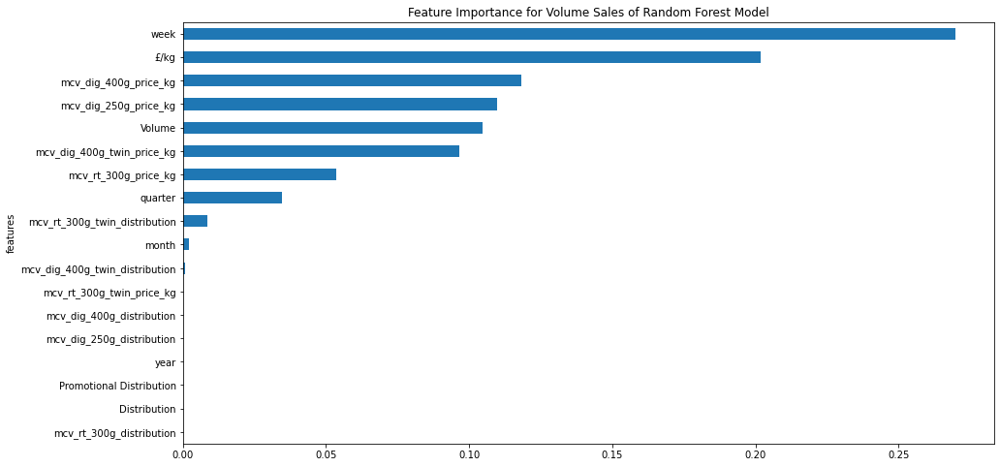

<Figure size 432x288 with 0 Axes>

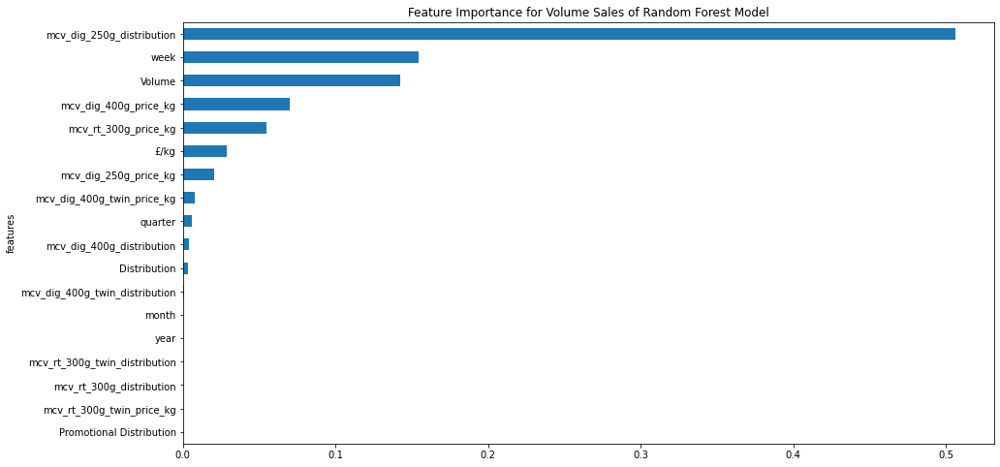

<Figure size 432x288 with 0 Axes>

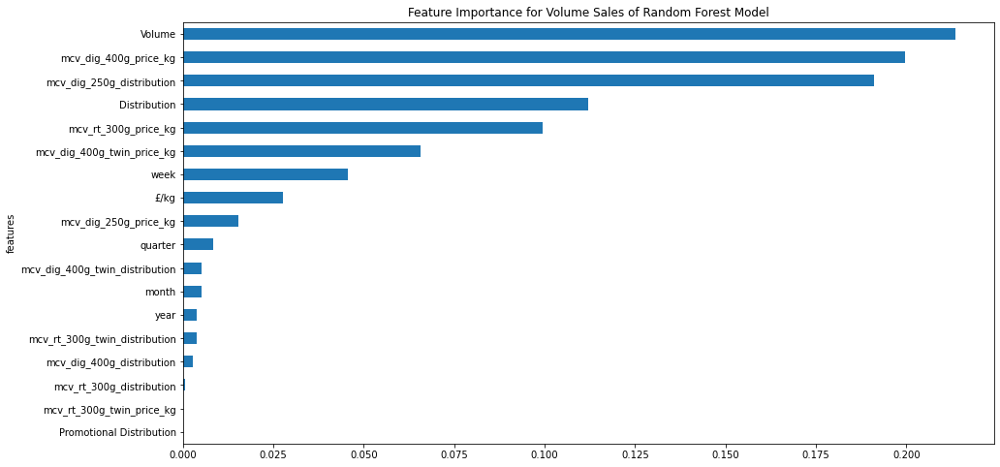

<Figure size 432x288 with 0 Axes>

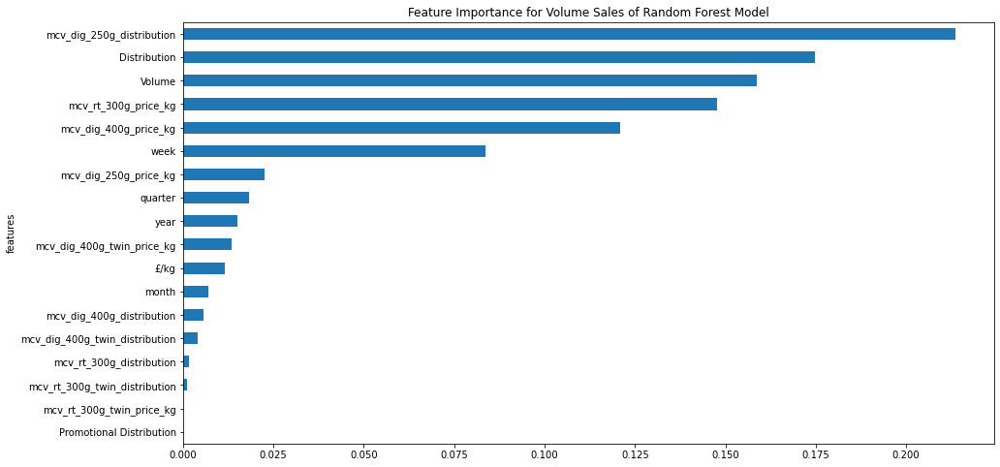

<Figure size 432x288 with 0 Axes>

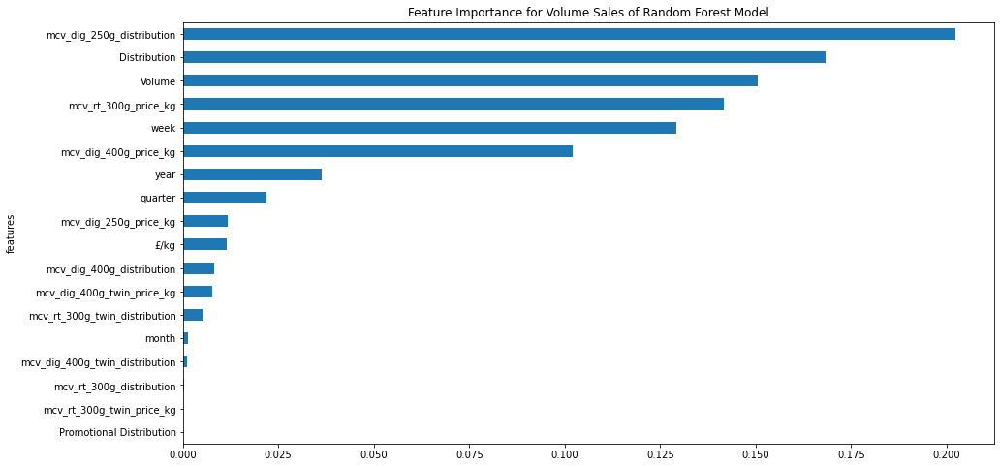

<Figure size 432x288 with 0 Axes>

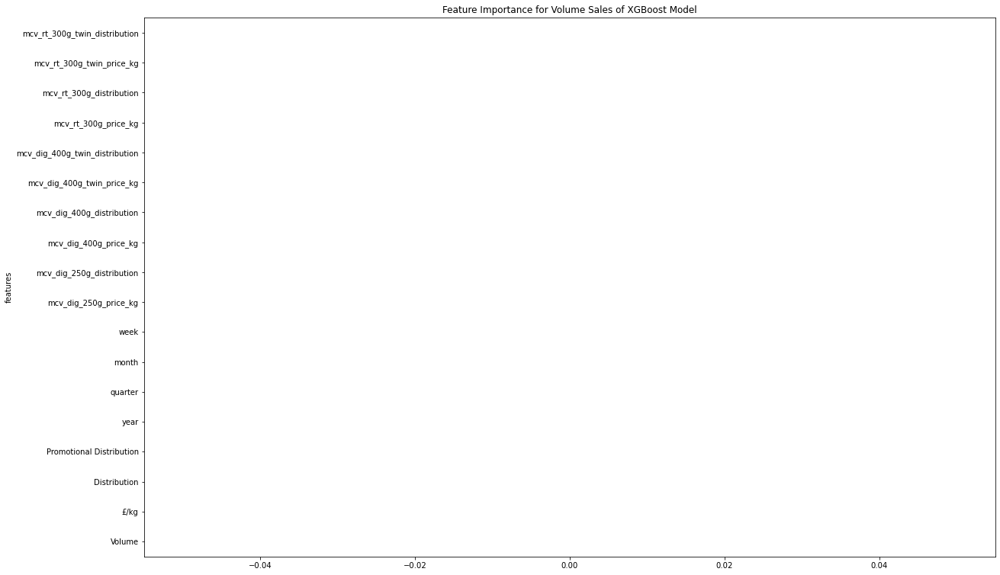

<Figure size 432x288 with 0 Axes>

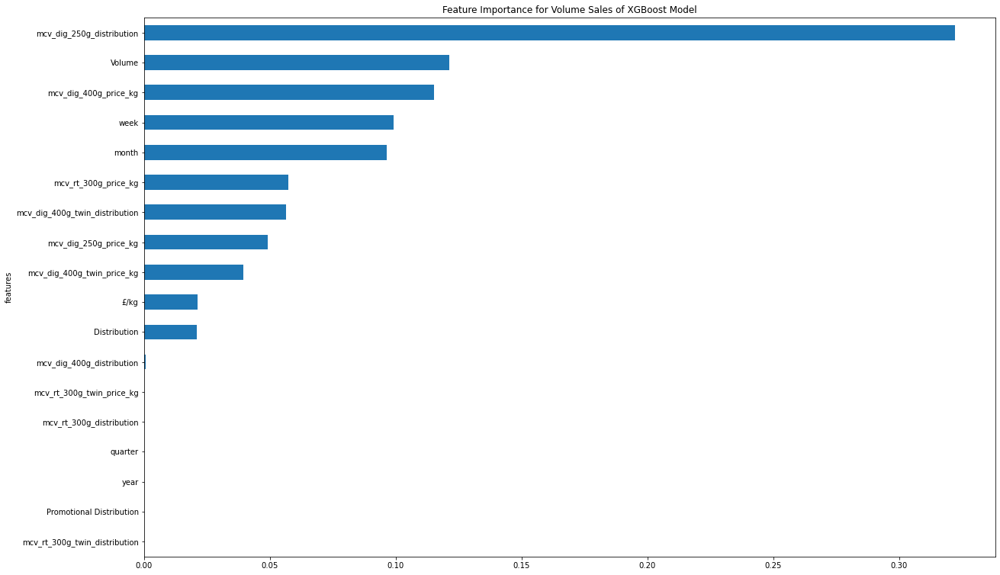

<Figure size 432x288 with 0 Axes>

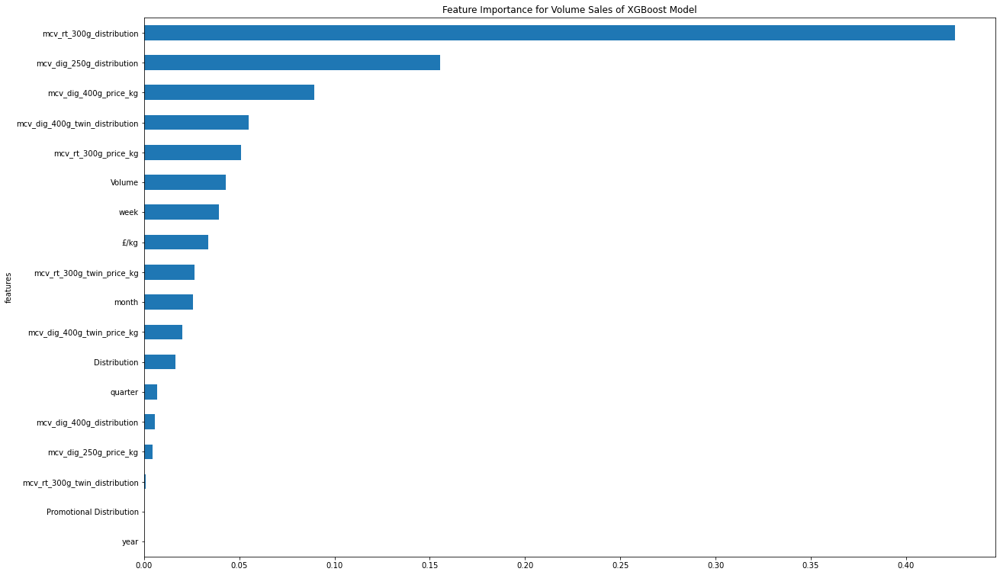

<Figure size 432x288 with 0 Axes>

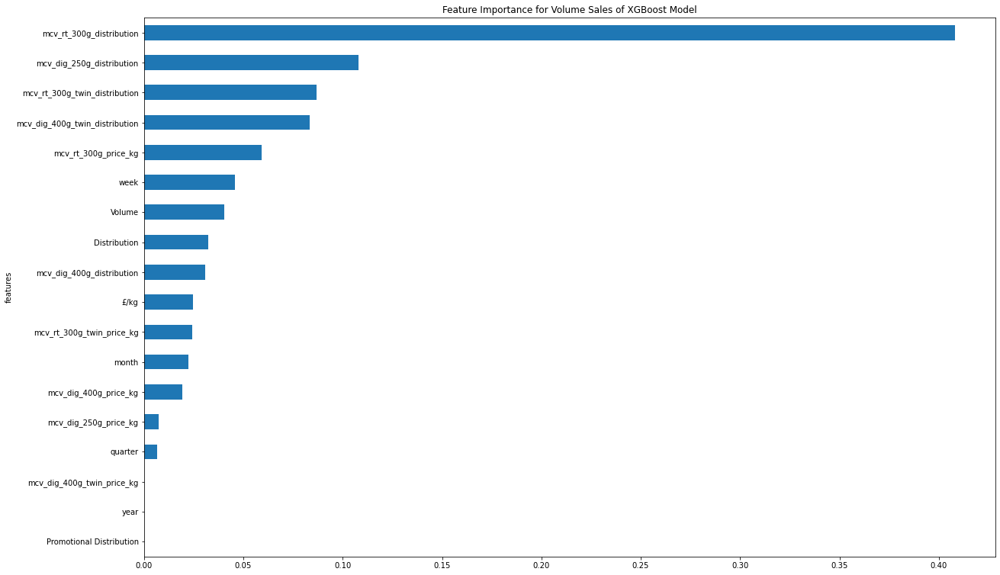

<Figure size 432x288 with 0 Axes>

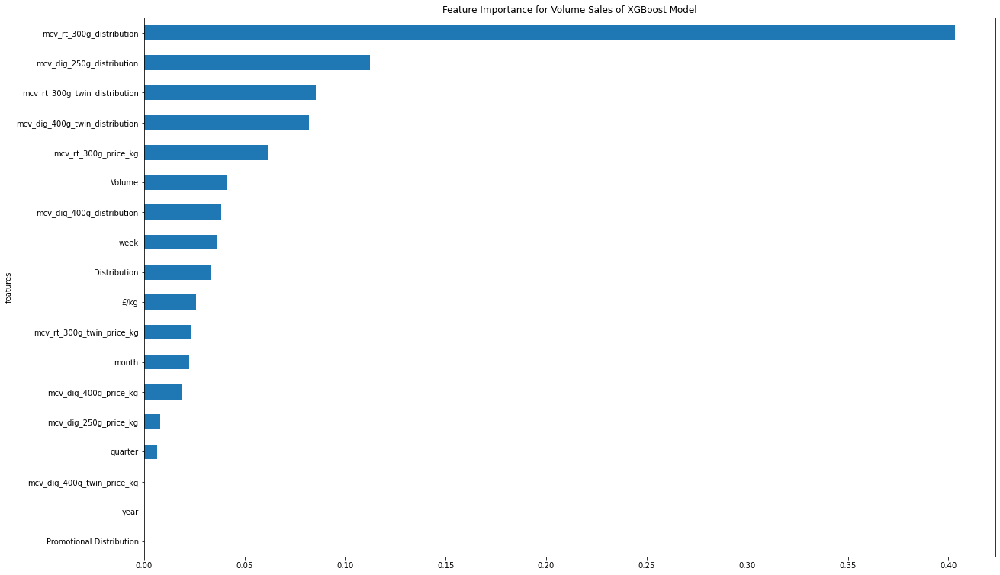

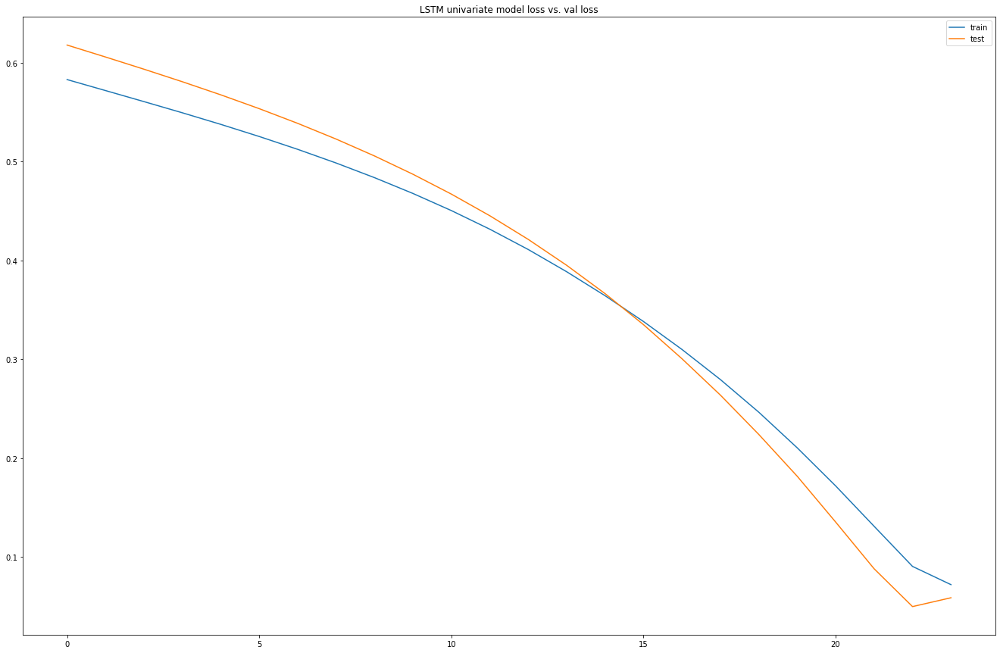

Test RMSE: 2085.346


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,13594.5,2.000897,98.0,0.0,2014.0,4.0,12.0,50.0,12154.8,2.001020,98,0,2015,1,1,2
2015-01-17,12849.5,2.000794,98.0,0.0,2014.0,4.0,12.0,51.0,13175.5,2.000934,98,0,2015,1,1,3
2015-01-24,8820.3,2.000896,98.0,0.0,2014.0,4.0,12.0,52.0,14290.8,2.001008,98,0,2015,1,1,4
2015-01-31,8919.3,2.000998,98.0,0.0,2015.0,1.0,1.0,1.0,15203.0,2.001026,98,0,2015,1,1,5
2015-02-07,12154.8,2.001020,98.0,0.0,2015.0,1.0,1.0,2.0,15643.5,2.001048,98,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,13123.8,2.241691,100.0,0.0,2020.0,1.0,1.0,3.0,15888.8,2.241447,100,0,2020,1,2,7
2020-02-22,14044.0,2.241683,100.0,0.0,2020.0,1.0,1.0,4.0,15479.0,2.241482,100,0,2020,1,2,8
2020-02-29,14768.5,2.241582,100.0,0.0,2020.0,1.0,2.0,5.0,16310.8,2.241656,100,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.574974   0.655917       0.98        0.0   0.000000        1.0   
5   0.543464   0.655769       0.98        0.0   0.000000        1.0   
6   0.373044   0.655915       0.98        0.0   0.000000        1.0   
7   0.377231   0.656060       0.98        0.0   0.166656        0.0   
8   0.514080   0.656092       0.98        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.514080  
5        1.0   0.961538  0.557252  
6        1.0   0.980769  0.604425  
7        0.0   0.000000  0.643008  
8        0.0   0.019231  0.661639  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 35s - loss: 0.5694 - val_loss: 0.5874
Epoch 2/50
216/216 - 0s - loss: 0.5406 - val_loss: 0.5535
Epoch 3/50
216/216 - 0s - loss: 0.5111 - val_loss: 0.5172
Epoch 4/50
216/216 - 0s - loss: 0.4793 - val_loss: 0.4773
Epoch 5/50
216/216 - 0s - loss: 0.4441 - va

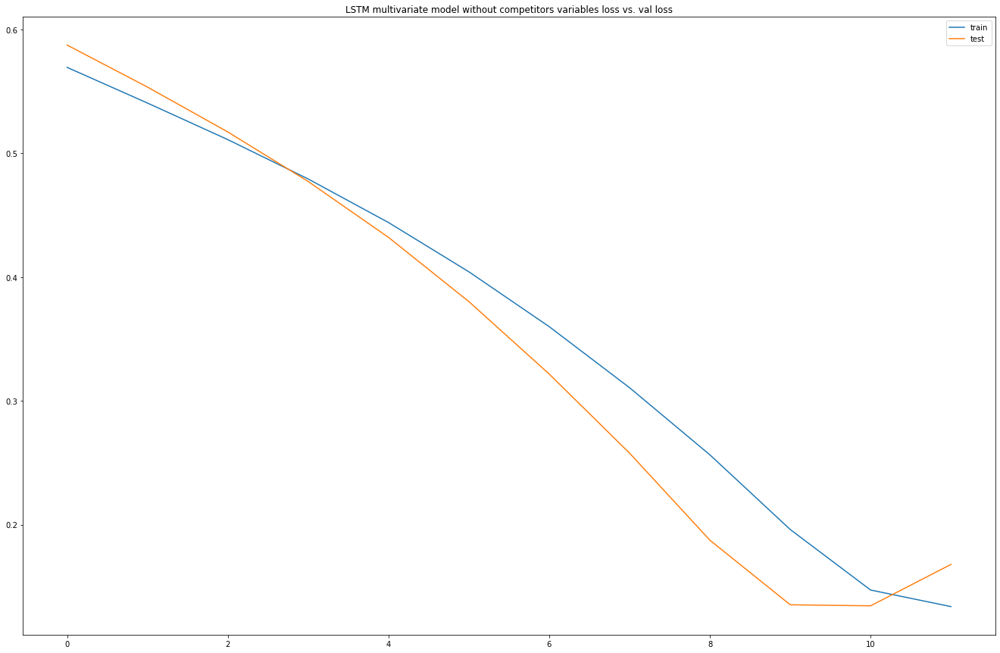

Test RMSE: 4956.124


In [529]:
#ml models
tes_rt_250g_with_comp=variable_lag_tesco(tes_rt_250g_with_comp)
tes_rt_250g_input_X,tes_rt_250g_input_Y=input_var_tesco(tes_rt_250g_with_comp)
rf_regressor_tesco(tes_rt_250g_input_X,tes_rt_250g_input_Y)

tes_rt_250g_input_X,tes_rt_250g_input_Y=input_var_tesco(tes_rt_250g_with_comp)
xgb_regressor_tesco(tes_rt_250g_input_X,tes_rt_250g_input_Y)

#lstm models
series_to_supervised(tes_rt_250g_volume)
lstm_univariate(tes_rt_250g_volume)

series_to_supervised(tes_rt_250g_own_variable)
multivariate_lstm_without_competitor(tes_rt_250g_own_variable)


In [536]:
def multivariate_with_competitor_tesco(df):
    values = df.values
    # integer encode direction
    #encoder = LabelEncoder()
    #values[:,4] = encoder.fit_transform(values[:,4])
    # ensure all data is float
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict
    reframed.drop(reframed.columns[[20,21,22,23,24,25,26,27,28,29,30,31,32,33,34,35,36,37]], axis=1, inplace=True)
    print(reframed.head())

    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]
    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    model = Sequential()
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(LSTM(100, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM multivariate model with competitors variables loss vs. val loss',loc='center')
    plt.legend()
    plt.show()

    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t),var18(t),var19(t)
Date,,,,,,,,,,,,,,,,,,,,,
2015-03-07,12154.8,2015.0,1.0,2.0,6.0,13594.5,2.000897,98.0,0.0,3.560262,...,3.559761,97.0,2.039523,100.0,1.889689,96.0,3.396960,100.0,3.15,96.0
2015-03-14,13175.5,2015.0,1.0,2.0,7.0,12849.5,2.000794,98.0,0.0,3.560043,...,3.556789,97.0,2.040478,100.0,1.889442,96.0,3.398573,100.0,3.15,96.0
2015-03-21,14290.8,2015.0,1.0,2.0,8.0,8820.3,2.000896,98.0,0.0,3.560118,...,3.555143,97.0,2.123438,100.0,1.889339,96.0,3.536073,100.0,3.15,96.0
2015-03-28,15203.0,2015.0,1.0,2.0,9.0,8919.3,2.000998,98.0,0.0,3.560110,...,3.559082,97.0,2.182389,100.0,1.889769,96.0,3.636788,100.0,3.15,96.0
2015-04-04,15643.5,2015.0,1.0,3.0,10.0,12154.8,2.001020,98.0,0.0,3.559761,...,3.555369,97.0,2.182429,100.0,1.889773,96.0,3.635421,100.0,3.15,96.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,13030.5,2020.0,1.0,1.0,3.0,15011.5,2.199967,100.0,0.0,3.598154,...,3.599914,58.0,2.501561,100.0,2.362550,98.0,3.333592,100.0,3.15,98.0
2020-02-22,7984.5,2020.0,1.0,1.0,4.0,14290.5,2.199853,100.0,0.0,3.598744,...,3.599945,58.0,2.501633,100.0,2.362406,98.0,3.335907,100.0,3.15,98.0
2020-02-29,9348.8,2020.0,1.0,2.0,5.0,13740.8,2.224783,100.0,0.0,3.600000,...,3.599752,58.0,2.502004,100.0,2.362273,98.0,3.335956,100.0,3.15,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.681696        0.0        0.0   0.090909   0.096154   0.762444   
5   0.738944        0.0        0.0   0.090909   0.115385   0.720660   
6   0.801498        0.0        0.0   0.090909   0.134615   0.494675   
7   0.852660        0.0        0.0   0.090909   0.153846   0.500227   
8   0.877366        0.0        0.0   0.181818   0.173077   0.681696   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.655917       0.98        0.0    0.755651    0.951219    0.582741   
5   0.655769       0.98        0.0    0.754375    0.951219    0.584154   
6   0.655915       0.98        0.0    0.754810    0.951219    0.591557   
7   0.656060       0.98        0.0    0.754763    0.951219    0.589732   
8   0.656092       0.98        0.0    0.752726    0.951219    0.589069   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)  var18(t-4)  \
4         1.0    0.298082    0.973333    0.496851  

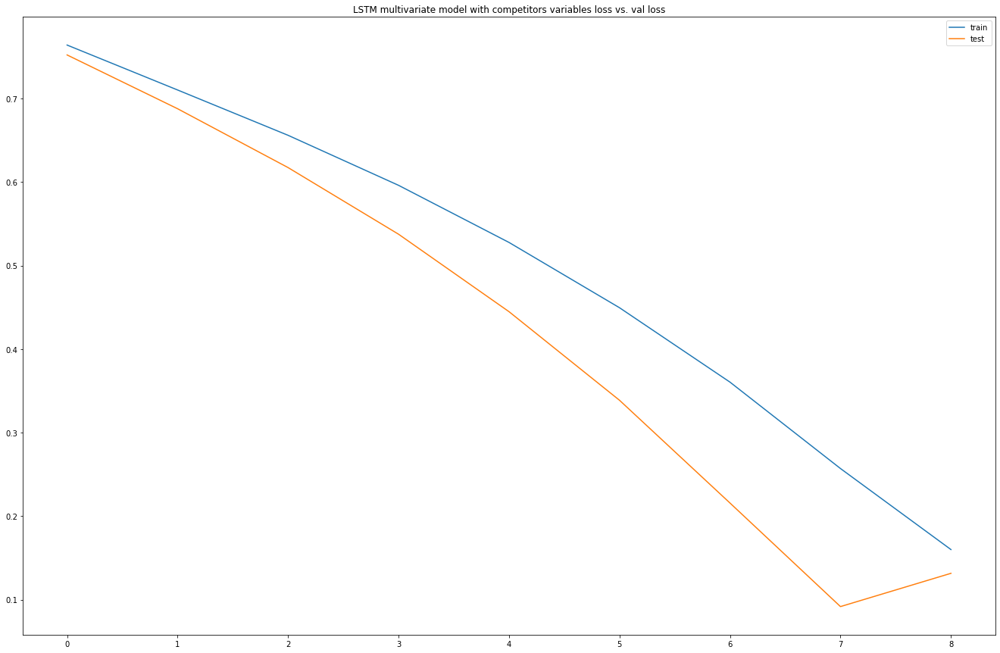

Test RMSE: 2899.778


In [537]:
series_to_supervised(tes_rt_250g_with_comp)
multivariate_with_competitor_tesco(tes_rt_250g_with_comp)

## Tesco Large - Tesco Rich Tea 300g

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
130,2017-06-10,3674.0,1102.2,1103.6,56.0,0.0,0.300381,1.001270,2017,2,6,23
131,2017-06-17,44771.0,13431.3,13442.5,98.0,0.0,0.300250,1.000834,2017,2,6,24
132,2017-06-24,56931.0,17079.3,17092.8,100.0,0.0,0.300237,1.000790,2017,2,6,25
133,2017-07-01,73620.0,22086.0,22102.7,100.0,0.0,0.300227,1.000756,2017,3,7,26
134,2017-07-08,72654.0,21796.2,21813.8,100.0,0.0,0.300242,1.000807,2017,3,7,27


(145, 12)

Date                        datetime64[ns]
Units                              float64
Volume                             float64
Value                              float64
Distribution                       float64
Promotional Distribution           float64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,145.000000,145.000000,145.000000,145.000000,145.0,145.000000,145.000000,145.000000,145.000000,145.000000,145.000000
mean,57743.137931,17322.941379,17311.932414,84.972414,0.0,0.299813,0.999378,2018.303448,2.558621,6.731034,27.220690
std,11198.189350,3359.456805,3358.554155,5.291430,0.0,0.000744,0.002479,0.884466,1.141854,3.526202,15.357078
min,3674.000000,1102.200000,1103.600000,56.000000,0.0,0.294626,0.982088,2017.000000,1.000000,1.000000,1.000000
25%,51606.000000,15481.800000,15478.100000,83.000000,0.0,0.299945,0.999816,2018.000000,1.000000,3.000000,13.000000
50%,59044.000000,17713.200000,17712.600000,84.000000,0.0,0.299982,0.999939,2018.000000,3.000000,7.000000,28.000000
75%,63315.000000,18994.500000,18884.900000,85.000000,0.0,0.299993,0.999977,2019.000000,4.000000,10.000000,40.000000
95%,75982.600000,22794.780000,22667.460000,100.000000,0.0,0.300271,1.000904,2020.000000,4.000000,12.000000,50.000000
99%,80742.360000,24222.708000,24233.152000,100.000000,0.0,0.300314,1.001048,2020.000000,4.000000,12.000000,52.000000
max,97197.000000,29159.100000,29156.000000,100.000000,0.0,0.300381,1.001270,2020.000000,4.000000,12.000000,52.000000


Dataset has: 145rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

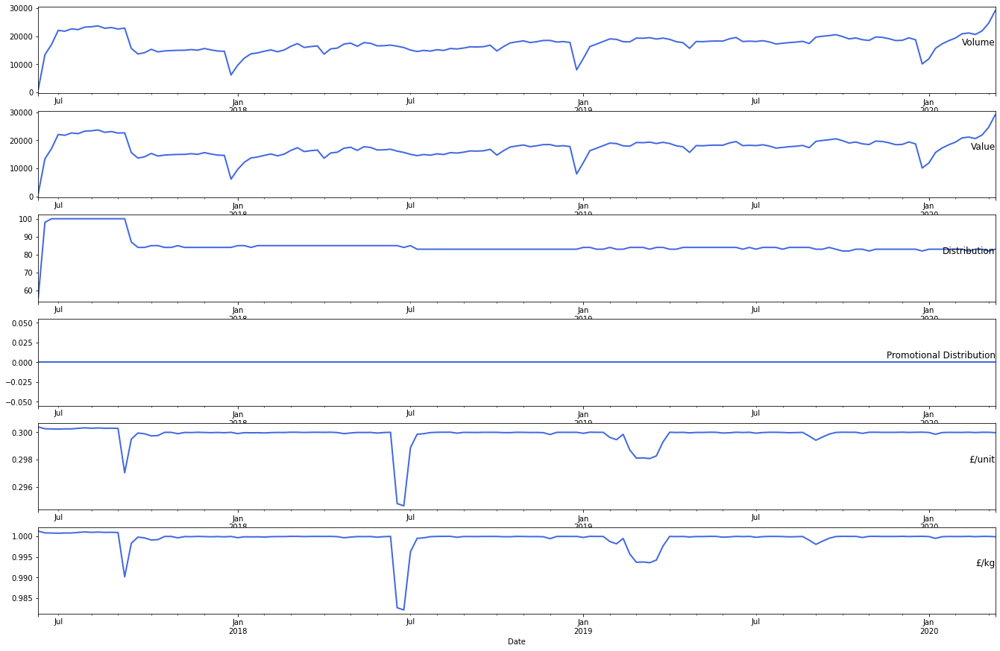

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f535a1dc9e8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53592f2048>)

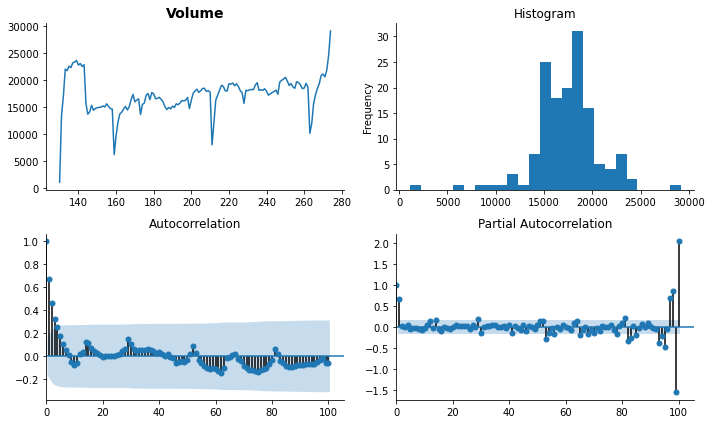

In [538]:
basic_info(tes_rt_300g_origin)
plot_data(tes_rt_300g_origin)
tsplot(tes_rt_300g_origin['Volume'].dropna(), title=tes_rt_300g_origin.columns[2], lags=100)


Test Statistic                  -5.156102
p-value                          0.000011
#Lags Used                       0.000000
Number of Observations Used    144.000000
Critical Value (1%)             -3.476598
Critical Value (5%)             -2.881829
Critical Value (10%)            -2.577589
dtype: float64


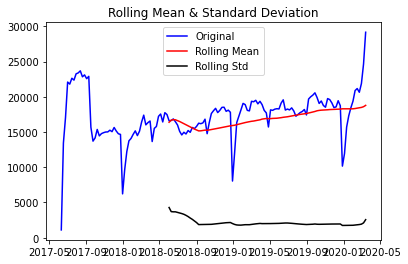

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f5354eb9208>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53533c3e10>)

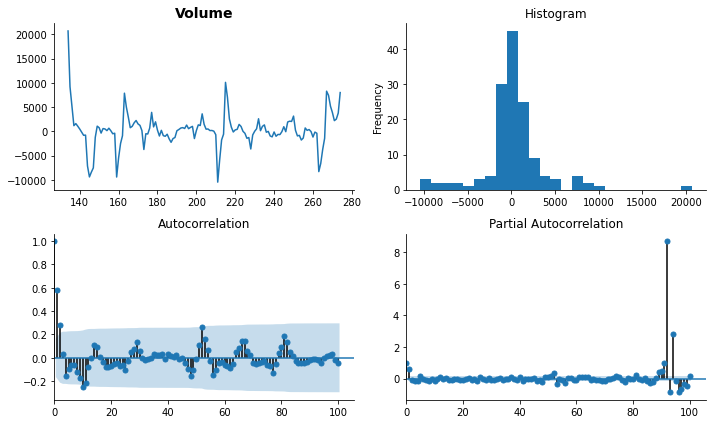

In [539]:
plot(tes_rt_300g_origin)
#plot stationary graph
series_transformed=tes_rt_300g_origin.copy()
series_transformed['Volume_transformed']=tes_rt_300g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=tes_rt_300g_origin.columns[2], lags=100)


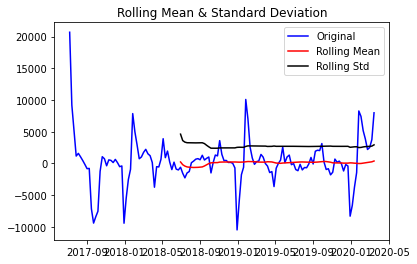

Results of Dickey-Fuller Test:
Test Statistic                  -4.657691
p-value                          0.000101
#Lags Used                       8.000000
Number of Observations Used    132.000000
Critical Value (1%)             -3.480888
Critical Value (5%)             -2.883697
Critical Value (10%)            -2.578586
dtype: float64


In [540]:
plot_transform(tes_rt_300g_origin)

In [541]:
tes_rt_300g_origin

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
130,2017-06-10,3674.0,1102.2,1103.6,56.0,0.0,0.300381,1.001270,2017,2,6,23
131,2017-06-17,44771.0,13431.3,13442.5,98.0,0.0,0.300250,1.000834,2017,2,6,24
132,2017-06-24,56931.0,17079.3,17092.8,100.0,0.0,0.300237,1.000790,2017,2,6,25
133,2017-07-01,73620.0,22086.0,22102.7,100.0,0.0,0.300227,1.000756,2017,3,7,26
134,2017-07-08,72654.0,21796.2,21813.8,100.0,0.0,0.300242,1.000807,2017,3,7,27
...,...,...,...,...,...,...,...,...,...,...,...,...
270,2020-02-15,70561.0,21168.3,21168.1,82.0,0.0,0.299997,0.999991,2020,1,2,7
271,2020-02-22,68802.0,20640.6,20638.7,83.0,0.0,0.299972,0.999908,2020,1,2,8
272,2020-02-29,72956.0,21886.8,21886.4,83.0,0.0,0.299995,0.999982,2020,1,2,9
273,2020-03-07,82164.0,24649.2,24648.6,82.0,0.0,0.299993,0.999976,2020,1,3,10


      t-4      t+1
0     NaN   1102.2
1     NaN  13431.3
2     NaN  17079.3
3     NaN  22086.0
4  1102.2  21796.2
Test MSE: 14294831.437
Test RMSE: 3780.851


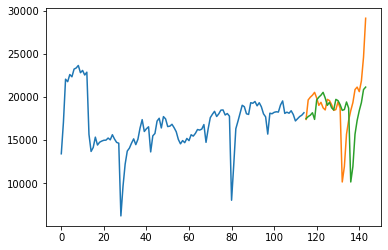

Observations: 141
Training Observations: 112
Testing Observations: 29


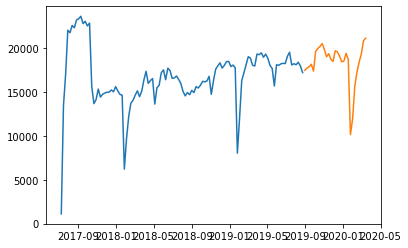

RMSE for Simple Exponential Smoothing α= 0.1 is: 2339.09
RMSE for Simple Exponential Smoothing α= 0.2 is: 2341.82
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2362.43
RMSE for Simple Exponential Smoothing α= 0.4 is: 2390.59
RMSE for Simple Exponential Smoothing α= 0.5 is: 2422.42
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2455.66
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 2489.7
RMSE for Simple Exponential Smoothing α= 0.8 is: 2524.38
RMSE for Simple Exponential Smoothing α= 0.9 is: 2559.15


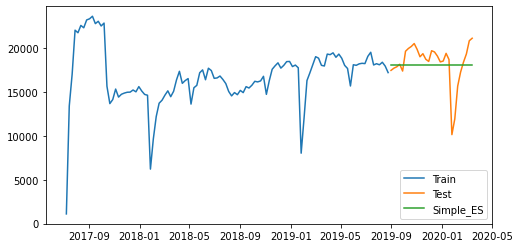

Observations: 141
Training Observations: 112
Testing Observations: 29
Min RMSE for Holt Linear Forecasting α= 0.1 and β= 0.1 is: 2319.22


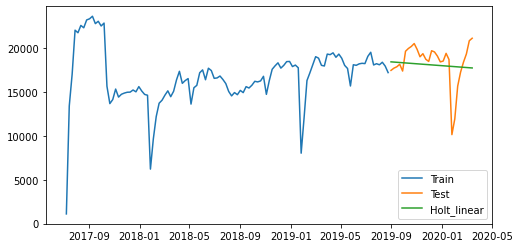

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

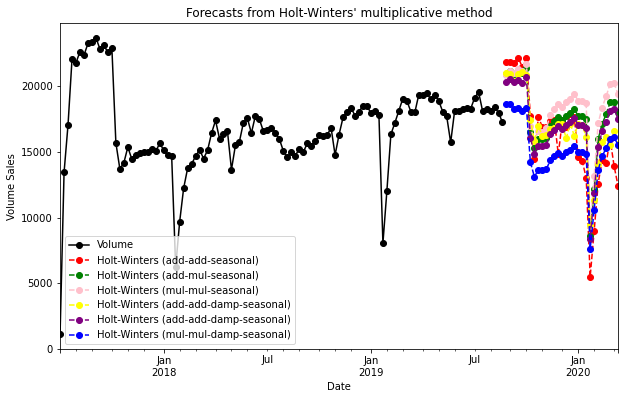

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
3993.2209854122757
2500.92729030215
2184.0381459220544
2896.0836275704637
2704.262119107391
4053.7397283304244


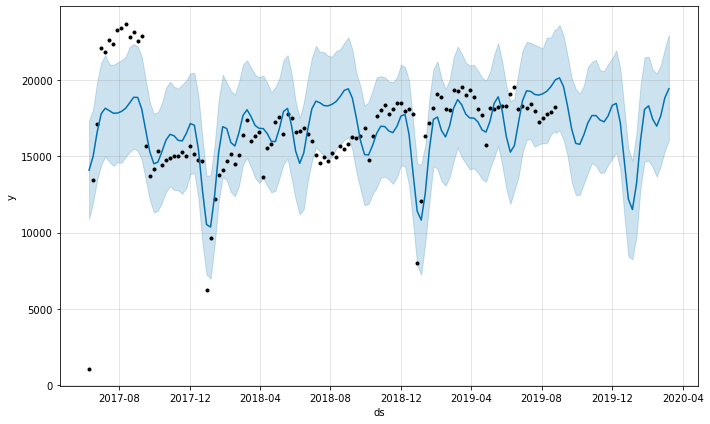

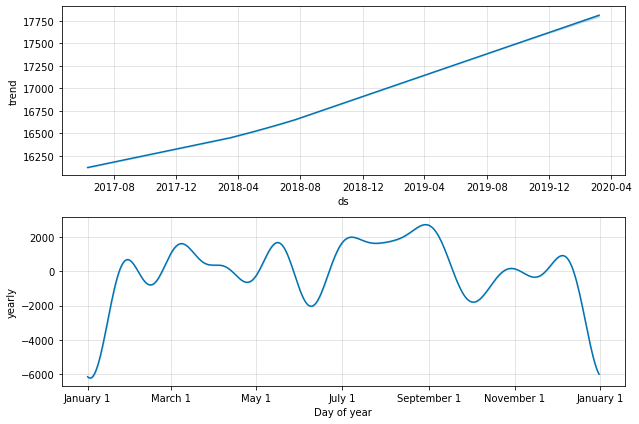

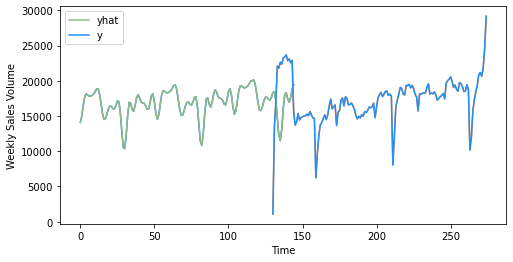

RMSE for prophet model is: 2744.8697404536765


In [542]:
#time series models
baseline_model(tes_rt_300g_origin)
ses_model(tes_rt_300g_origin)
holt_linear_model(tes_rt_300g_origin)
holt_winter_model(tes_rt_300g_origin)
prophet_model(tes_rt_300g_origin)


In [93]:
# prophet_all_holidays(tes_rt_300g_origin)
# prophet_two_holiday(tes_rt_300g_origin)

Observations: 49
Training Observations: 26
Testing Observations: 23
[-10.77753433 -97.7856743   -0.58046388  -1.90371513  -0.34975116]
Mean Absolute Error: 6154.991739130436
Mean Squared Error: 41175606.89050436
Root Mean Squared Error: 6416.822180059563
Observations: 72
Training Observations: 49
Testing Observations: 23
[ -6.53235746 -13.45226284  -7.45577471  -1.38830442  -6.18699131]
Mean Absolute Error: 1056.140217391305
Mean Squared Error: 1710315.9266576094
Root Mean Squared Error: 1307.7904750599805
Observations: 95
Training Observations: 72
Testing Observations: 23
[-2.70437655e+01 -5.38273607e+00 -1.59992133e+00 -2.68894676e-02
 -1.44182160e+00]
Mean Absolute Error: 2469.021521739129
Mean Squared Error: 8050726.537464125
Root Mean Squared Error: 2837.3802243379587
Observations: 118
Training Observations: 95
Testing Observations: 23
[-5.00099042 -1.72765289 -0.8665038   0.05629957 -7.10927155]
Mean Absolute Error: 2452.609565217392
Mean Squared Error: 7289753.386950002
Root Mea

<Figure size 432x288 with 0 Axes>

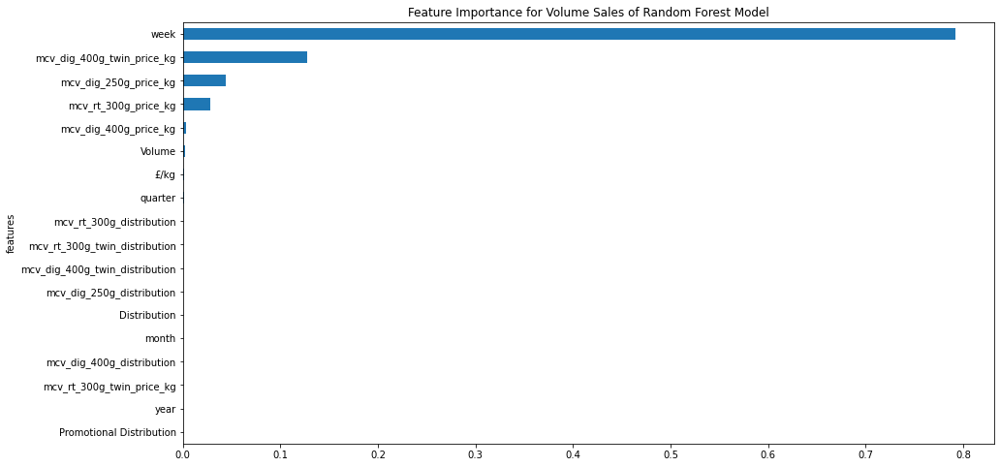

<Figure size 432x288 with 0 Axes>

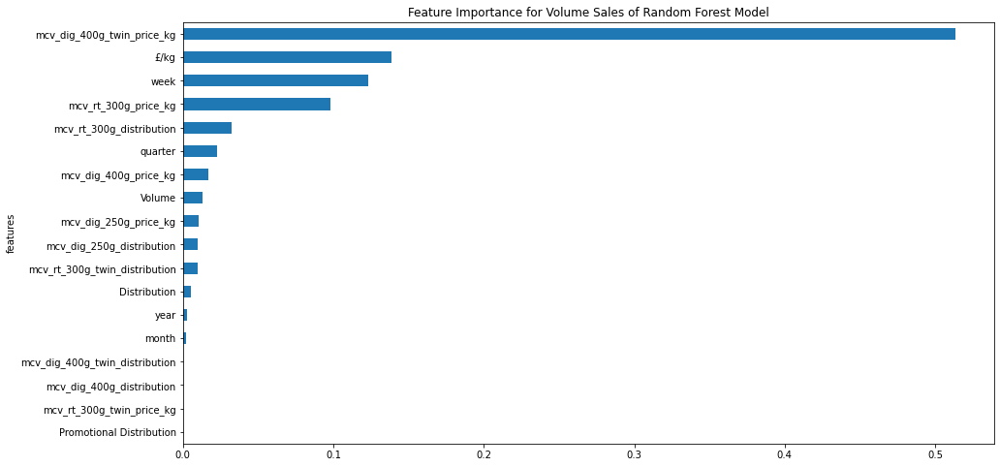

<Figure size 432x288 with 0 Axes>

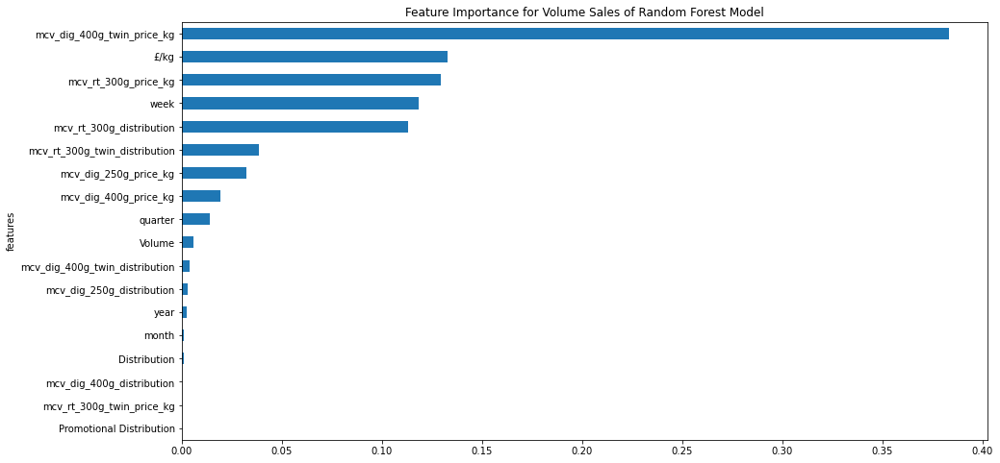

<Figure size 432x288 with 0 Axes>

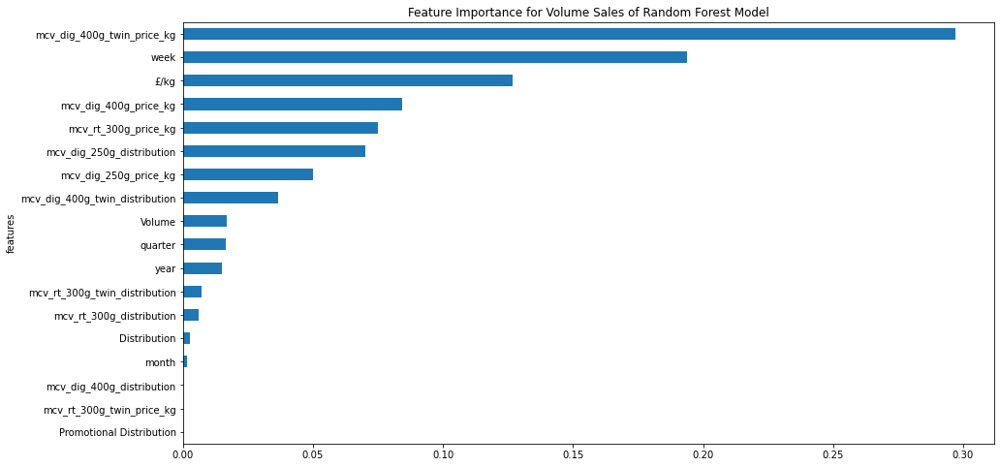

<Figure size 432x288 with 0 Axes>

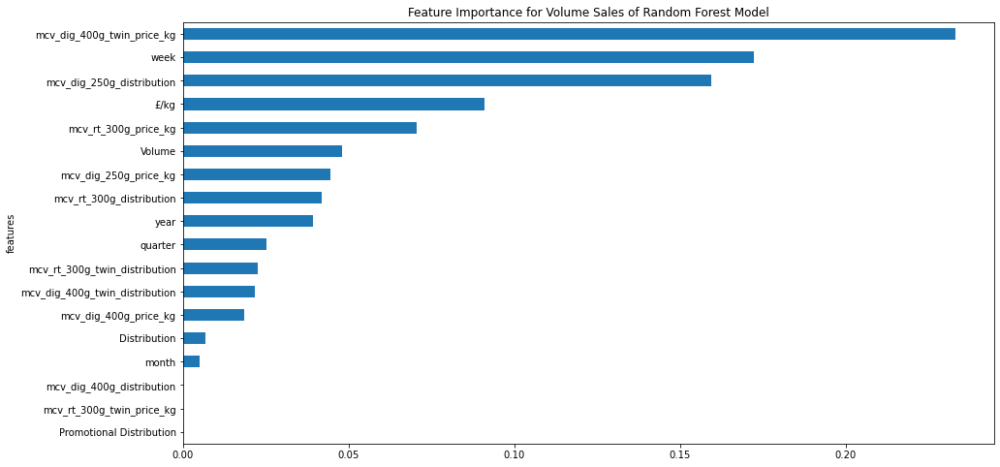

<Figure size 432x288 with 0 Axes>

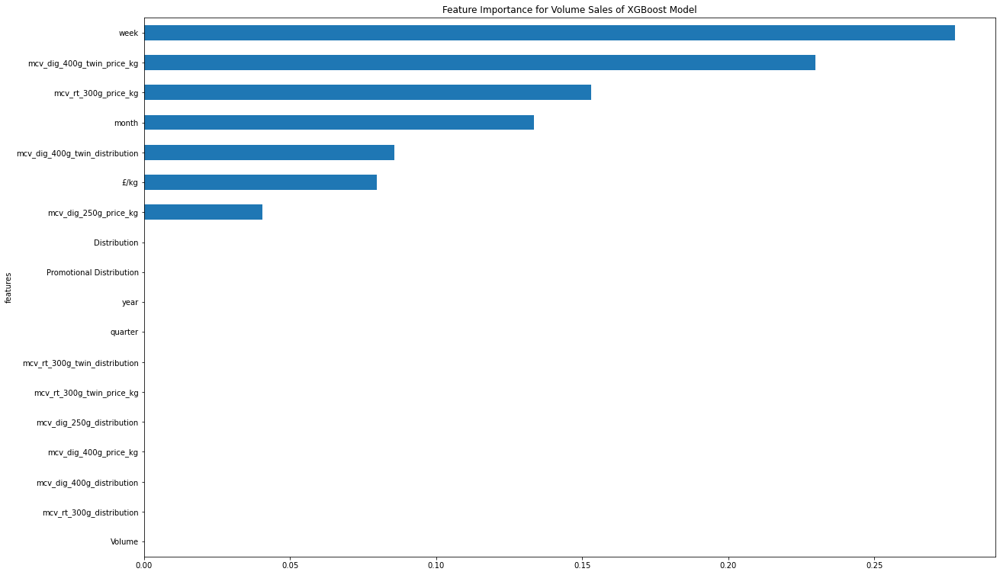

<Figure size 432x288 with 0 Axes>

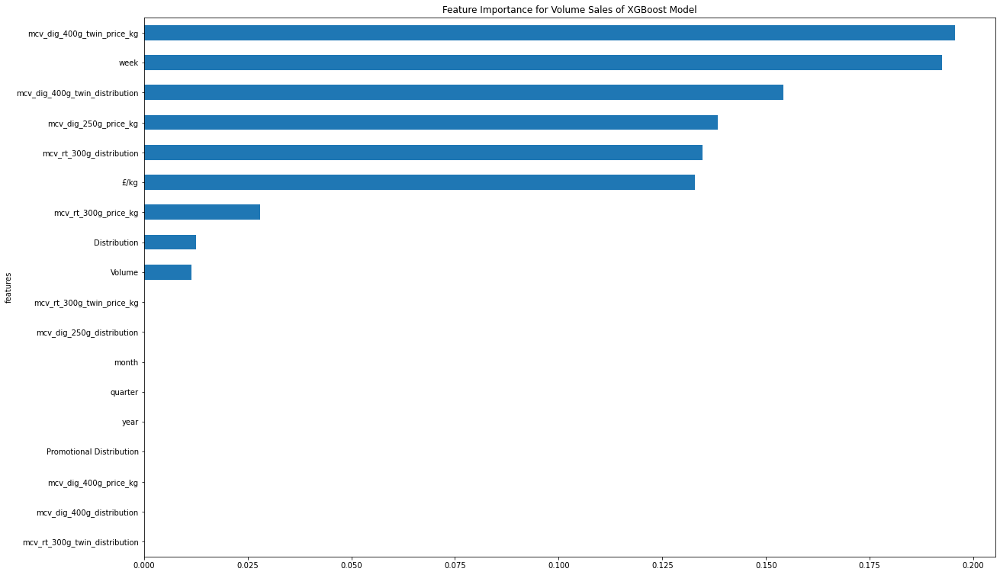

<Figure size 432x288 with 0 Axes>

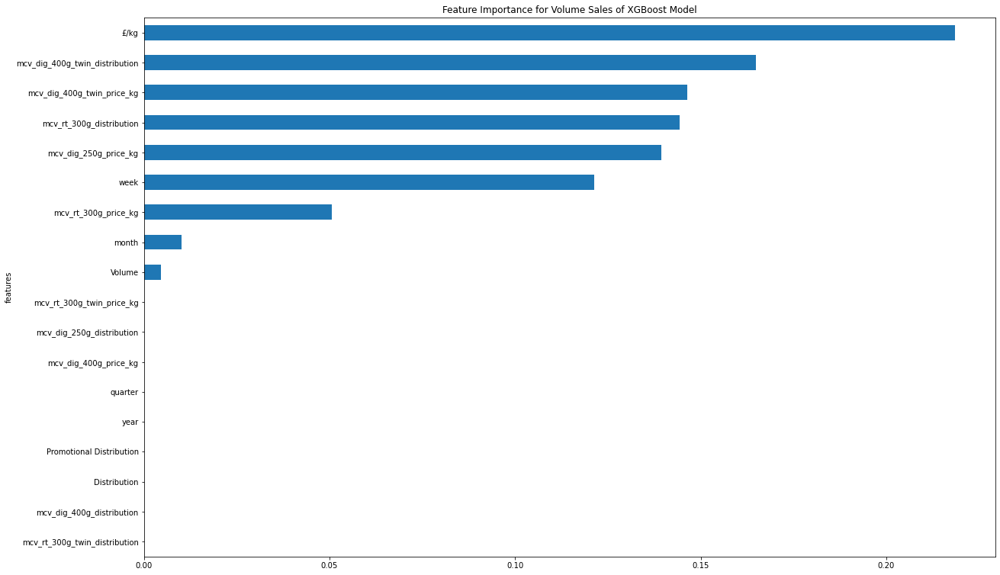

<Figure size 432x288 with 0 Axes>

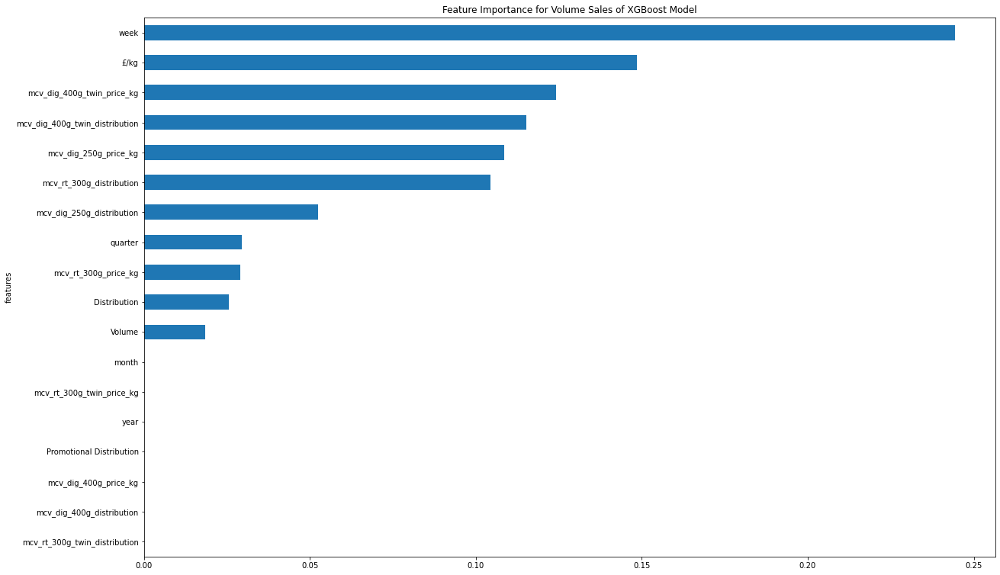

<Figure size 432x288 with 0 Axes>

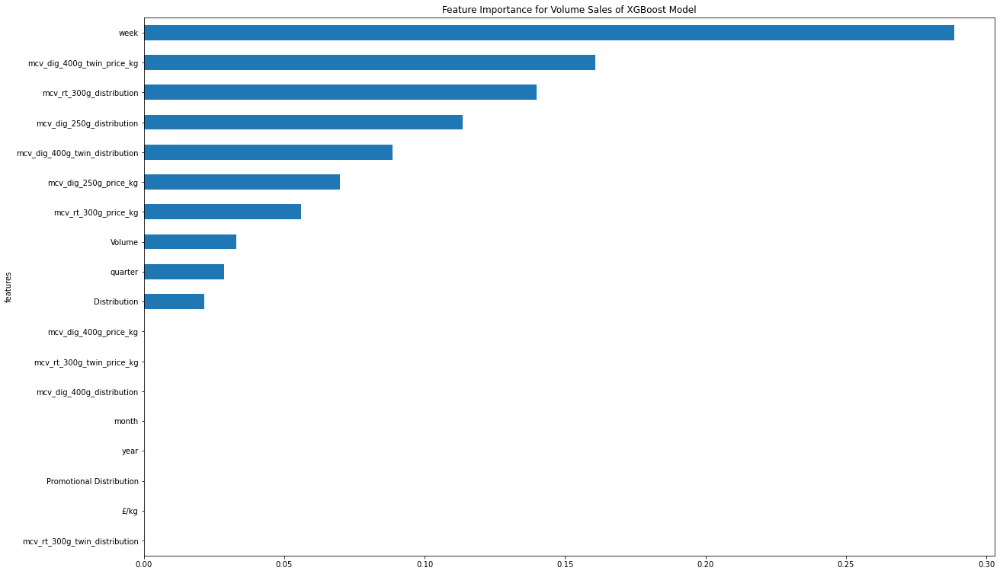

In [543]:
#machine learning model
tes_rt_300g_with_comp=variable_lag_tesco(tes_rt_300g_with_comp)
tes_rt_300g_input_X,tes_rt_300g_input_Y=input_var_tesco(tes_rt_300g_with_comp)
rf_regressor_tesco(tes_rt_300g_input_X,tes_rt_300g_input_Y)

tes_rt_300g_input_X,tes_rt_300g_input_Y=input_var_tesco(tes_rt_300g_with_comp)
xgb_regressor_tesco(tes_rt_300g_input_X,tes_rt_300g_input_Y)



,var1(t-4),var1(t)
Date,,
2017-07-08,1102.2,21796.2
2017-07-15,13431.3,22628.7
2017-07-22,17079.3,22363.5
2017-07-29,22086.0,23256.3
2017-08-05,21796.2,23386.8
...,...,...
2020-02-15,17299.5,21168.3
2020-02-22,18436.8,20640.6
2020-02-29,19370.7,21886.8


   var1(t-4)   var1(t)
4   0.000000  0.737573
5   0.439432  0.767244
6   0.569454  0.757792
7   0.747902  0.789613
8   0.737573  0.794265
(112, 1, 1) (112,) (29, 1, 1) (29,)
Train on 112 samples, validate on 29 samples
Epoch 1/50
112/112 - 37s - loss: 0.5678 - val_loss: 0.6433
Epoch 2/50
112/112 - 0s - loss: 0.5598 - val_loss: 0.6350
Epoch 3/50
112/112 - 0s - loss: 0.5517 - val_loss: 0.6267
Epoch 4/50
112/112 - 0s - loss: 0.5436 - val_loss: 0.6183
Epoch 5/50
112/112 - 0s - loss: 0.5355 - val_loss: 0.6097
Epoch 6/50
112/112 - 0s - loss: 0.5272 - val_loss: 0.6010
Epoch 7/50
112/112 - 0s - loss: 0.5187 - val_loss: 0.5921
Epoch 8/50
112/112 - 0s - loss: 0.5100 - val_loss: 0.5829
Epoch 9/50
112/112 - 0s - loss: 0.5010 - val_loss: 0.5734
Epoch 10/50
112/112 - 0s - loss: 0.4917 - val_loss: 0.5635
Epoch 11/50
112/112 - 0s - loss: 0.4821 - val_loss: 0.5532
Epoch 12/50
112/112 - 0s - loss: 0.4720 - val_loss: 0.5425
Epoch 13/50
112/112 - 0s - loss: 0.4616 - val_loss: 0.5312
Epoch 14/50
112/112 - 

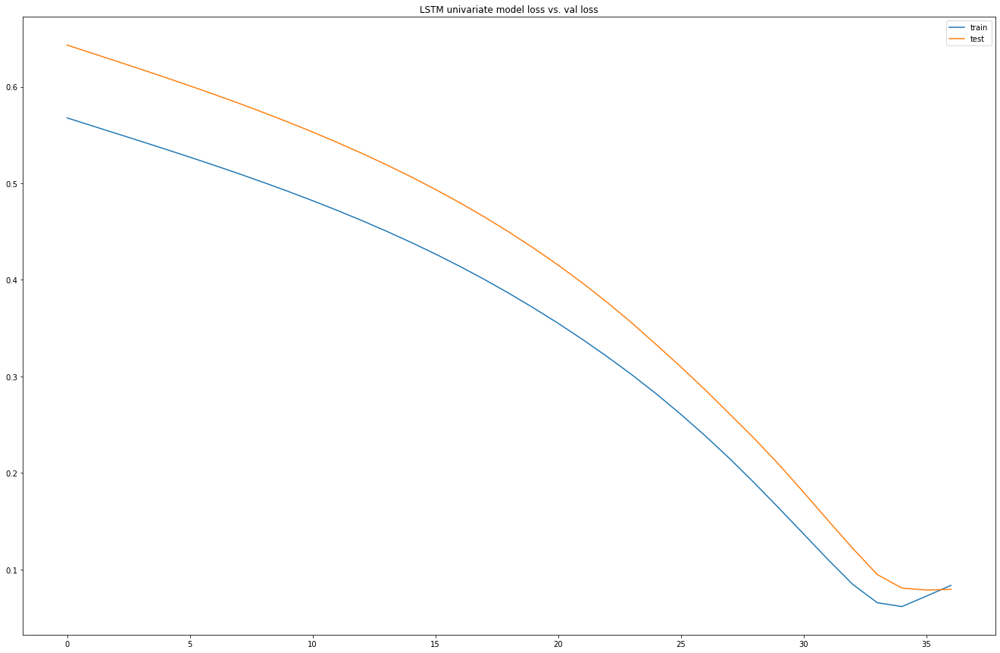

Test RMSE: 3245.307


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2017-07-08,1102.2,1.001270,56.0,0.0,2017.0,2.0,6.0,23.0,21796.2,1.000807,100.0,0.0,2017,3,7,27
2017-07-15,13431.3,1.000834,98.0,0.0,2017.0,2.0,6.0,24.0,22628.7,1.000804,100.0,0.0,2017,3,7,28
2017-07-22,17079.3,1.000790,100.0,0.0,2017.0,2.0,6.0,25.0,22363.5,1.000948,100.0,0.0,2017,3,7,29
2017-07-29,22086.0,1.000756,100.0,0.0,2017.0,3.0,7.0,26.0,23256.3,1.001058,100.0,0.0,2017,3,7,30
2017-08-05,21796.2,1.000807,100.0,0.0,2017.0,3.0,7.0,27.0,23386.8,1.000962,100.0,0.0,2017,3,8,31
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,17299.5,0.999908,83.0,0.0,2020.0,1.0,1.0,3.0,21168.3,0.999991,82.0,0.0,2020,1,2,7
2020-02-22,18436.8,0.999957,83.0,0.0,2020.0,1.0,1.0,4.0,20640.6,0.999908,83.0,0.0,2020,1,2,8
2020-02-29,19370.7,0.999954,83.0,0.0,2020.0,1.0,2.0,5.0,21886.8,0.999982,83.0,0.0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.000000   1.000000   0.000000        0.0        0.0   0.333333   
5   0.439432   0.977257   0.954545        0.0        0.0   0.333333   
6   0.569454   0.974995   1.000000        0.0        0.0   0.333333   
7   0.747902   0.973206   1.000000        0.0        0.0   0.666667   
8   0.737573   0.975883   1.000000        0.0        0.0   0.666667   

   var7(t-4)  var8(t-4)   var1(t)  
4   0.454545   0.431373  0.737573  
5   0.454545   0.450980  0.767244  
6   0.454545   0.470588  0.757792  
7   0.545455   0.490196  0.789613  
8   0.545455   0.509804  0.794265  
(112, 1, 8) (112,) (29, 1, 8) (29,)
Train on 112 samples, validate on 29 samples
Epoch 1/50
112/112 - 36s - loss: 0.5674 - val_loss: 0.6343
Epoch 2/50
112/112 - 0s - loss: 0.5487 - val_loss: 0.6136
Epoch 3/50
112/112 - 0s - loss: 0.5301 - val_loss: 0.5927
Epoch 4/50
112/112 - 0s - loss: 0.5111 - val_loss: 0.5712
Epoch 5/50
112/112 - 0s - loss: 0.4915 - va

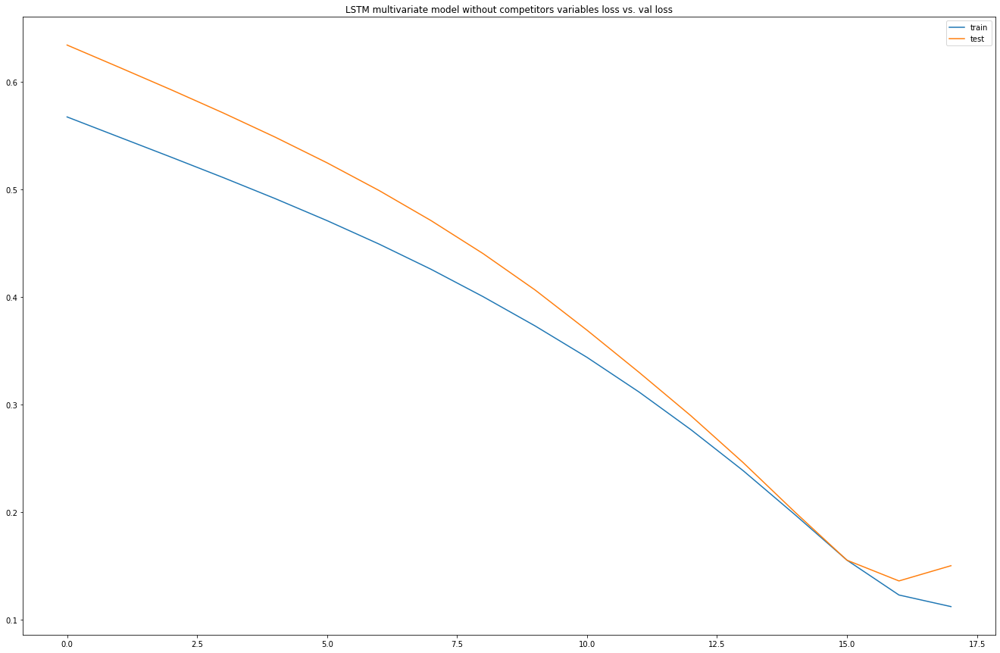

Test RMSE: 5478.589


In [544]:
#lstm models
series_to_supervised(tes_rt_300g_volume)
lstm_univariate(tes_rt_300g_volume)

series_to_supervised(tes_rt_300g_own_variable)
multivariate_lstm_without_competitor(tes_rt_300g_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t),var18(t),var19(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-08-05,21796.2,2017.0,3.0,7.0,27.0,1102.2,1.001270,56.0,0.0,3.558804,...,3.559703,75.0,2.201493,100.0,1.889815,76.0,3.333788,98.0,3.15,63.0
2017-08-12,22628.7,2017.0,3.0,7.0,28.0,13431.3,1.000834,98.0,0.0,3.560043,...,3.558920,75.0,2.201500,100.0,1.889798,76.0,3.333980,98.0,3.15,63.0
2017-08-19,22363.5,2017.0,3.0,7.0,29.0,17079.3,1.000790,100.0,0.0,3.559407,...,3.558666,75.0,2.201702,100.0,1.889875,76.0,3.333967,98.0,3.15,63.0
2017-08-26,23256.3,2017.0,3.0,7.0,30.0,22086.0,1.000756,100.0,0.0,3.556533,...,3.560133,75.0,2.201724,100.0,1.889852,76.0,3.334044,98.0,3.15,63.0
2017-09-02,23386.8,2017.0,3.0,8.0,31.0,21796.2,1.000807,100.0,0.0,3.559703,...,3.558772,75.0,2.201595,100.0,1.889851,76.0,3.333958,98.0,3.15,63.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,17299.5,2020.0,1.0,1.0,3.0,18732.6,0.999984,83.0,0.0,3.599914,...,3.595392,58.0,2.502099,100.0,2.362428,98.0,3.332535,100.0,3.15,98.0
2020-02-22,18436.8,2020.0,1.0,1.0,4.0,10158.3,1.000000,82.0,0.0,3.599945,...,3.599547,58.0,2.501775,100.0,2.362101,98.0,3.331737,100.0,3.15,98.0
2020-02-29,19370.7,2020.0,1.0,2.0,5.0,11951.1,0.999933,83.0,0.0,3.599752,...,3.599397,58.0,2.501675,100.0,2.362396,98.0,3.334121,100.0,3.15,98.0


,Original_Volume,year,quarter,month,week,Volume,£/kg,Distribution,Promotional Distribution,mcv_dig_250g_price_kg,mcv_dig_250g_distribution,mcv_dig_400g_price_kg,mcv_dig_400g_distribution,mcv_dig_400g_twin_price_kg,mcv_dig_400g_twin_distribution,mcv_rt_300g_price_kg,mcv_rt_300g_distribution,mcv_rt_300g_twin_price_kg,mcv_rt_300g_twin_distribution
Date,,,,,,,,,,,,,,,,,,,
2017-07-08,21796.2,2017,3,7,27,1102.2,1.001270,56.0,0.0,3.558804,76.0,2.001012,100.0,1.889756,76.0,3.333901,98.0,3.15,63.0
2017-07-15,22628.7,2017,3,7,28,13431.3,1.000834,98.0,0.0,3.560043,75.0,2.001368,100.0,1.889877,76.0,3.333698,98.0,3.15,63.0
2017-07-22,22363.5,2017,3,7,29,17079.3,1.000790,100.0,0.0,3.559407,75.0,2.070402,100.0,1.889621,76.0,3.333970,98.0,3.15,63.0
2017-07-29,23256.3,2017,3,7,30,22086.0,1.000756,100.0,0.0,3.556533,76.0,2.201208,100.0,1.889670,76.0,3.333684,98.0,3.15,63.0
2017-08-05,23386.8,2017,3,8,31,21796.2,1.000807,100.0,0.0,3.559703,75.0,2.201493,100.0,1.889815,76.0,3.333788,98.0,3.15,63.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.679034        0.0   0.666667   0.545455   0.509804   0.000000   
5   0.715324        0.0   0.666667   0.545455   0.529412   0.546074   
6   0.703764        0.0   0.666667   0.545455   0.549020   0.707650   
7   0.742683        0.0   0.666667   0.545455   0.568627   0.929404   
8   0.748372        0.0   0.666667   0.636364   0.588235   0.916568   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   1.000000   0.000000        0.0    0.224941    1.000000    0.390129   
5   0.977257   0.954545        0.0    0.227121    0.944444    0.390351   
6   0.974995   1.000000        0.0    0.226003    0.944444    0.433465   
7   0.973206   1.000000        0.0    0.220949    1.000000    0.515160   
8   0.975883   1.000000        0.0    0.226522    0.944444    0.515338   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)  var18(t-4)  \
4         1.0    0.298125    0.706667    0.018699  

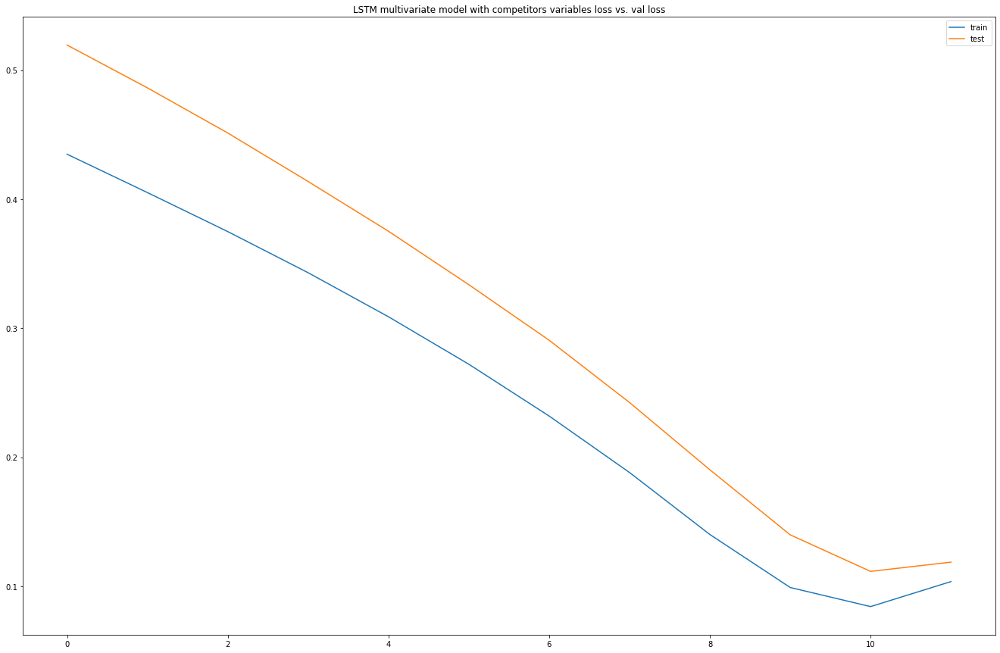

Test RMSE: 3976.501


In [679]:

series_to_supervised(tes_rt_300g_with_comp)
tes_rt_300g_with_comp.head()
multivariate_with_competitor_tesco(tes_rt_300g_with_comp)

## Tesco Large - Tesco Molly 400g

In [546]:
# basic_info(tes_molly_400g_origin)
# plot_data(tes_molly_400g_origin)
# tsplot(tes_molly_400g_origin['Volume'].dropna(), title=tes_molly_400g_origin.columns[2], lags=100)


In [547]:
# plot(tes_molly_400g_origin)
# #plot stationary graph
# series_transformed=tes_molly_400g_origin.copy()
# series_transformed['Volume_transformed']=tes_molly_400g_origin.Volume.diff(4)
# tsplot(series_transformed['Volume_transformed'].dropna(), title=tes_molly_400g_origin.columns[2], lags=100)


In [548]:
# from statsmodels.graphics.tsaplots import plot_acf, plot_pacf
# from statsmodels.tsa.stattools import adfuller

# def tsplot(y, title, lags=100, figsize=(10,6)):
#     '''Examine the patterns of ACF and PACF, along with the time series plot and histogram.
#     '''
#     fig=plt.figure(figsize=figsize)
#     layout=(2,2)
#     ts_ax=plt.subplot2grid(layout, (0,0))
#     hist_ax=plt.subplot2grid(layout, (0,1))
#     acf_ax=plt.subplot2grid(layout, (1,0))
#     pacf_ax=plt.subplot2grid(layout, (1,1))
    
#     y=y.dropna()
#     y.plot(ax=ts_ax)
#     ts_ax.set_title(title, fontsize=14, fontweight='bold')
#     y.plot(ax=hist_ax, kind='hist', bins=25)
#     hist_ax.set_title('Histogram')
#     plot_acf(y, lags=lags, ax=acf_ax)
#     plot_pacf(y, lags=lags, ax=pacf_ax)
#     [ax.set_xlim(0) for ax in [acf_ax, pacf_ax]]
#     sns.despine()
#     plt.tight_layout()
#     return ts_ax, acf_ax, pacf_ax

In [549]:
# plot_transform(tes_molly_400g_origin)

In [550]:
# #time series models
# baseline_model(tes_molly_400g_origin)
# ses_model(tes_molly_400g_origin)
# holt_linear_model(tes_molly_400g_origin)
# holt_winter_model(tes_molly_400g_origin)
# prophet_model(tes_molly_400g_origin)
# prophet_all_holidays(tes_molly_400g_origin)
# prophet_two_holiday(tes_molly_400g_origin)

In [551]:
# #machine learning model
# tes_molly_400g_with_comp=variable_lag_tesco(tes_molly_400g_with_comp)
# tes_molly_400g_input_X,tes_molly_400g_input_Y=input_var_tesco(tes_molly_400g_with_comp)
# rf_regressor_tesco(tes_molly_400g_input_X,tes_molly_400g_input_Y)

# tes_molly_400g_input_X,tes_molly_400g_input_Y=input_var_tesco(tes_molly_400g_with_comp)
# xgb_regressor_tesco(tes_molly_400g_input_X,tes_molly_400g_input_Y)



In [552]:
# #lstm models
# series_to_supervised(tes_molly_400g_volume)
# lstm_univariate(tes_molly_400g_volume)

# series_to_supervised(tes_molly_400g_own_variable)
# multivariate_lstm_without_competitor(tes_molly_400g_own_variable)


In [553]:

# series_to_supervised(tes_molly_400g_with_comp)
# multivariate_with_competitor_tesco(tes_molly_400g_with_comp)

## Tesco Large - Tesco Digestives 400g

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,40096,16038.4,23665.1,99,0,0.590211,1.475527,2014,4,12,50
1,2014-12-20,44691,17876.4,26375.4,99,0,0.590173,1.475431,2014,4,12,51
2,2014-12-27,37499,14999.6,22129.6,99,0,0.590138,1.475346,2014,4,12,52
3,2015-01-03,26433,10573.2,15600.8,99,0,0.590202,1.475504,2015,1,1,1
4,2015-01-10,28872,11548.8,17041.7,99,0,0.590250,1.475625,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.0,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,52701.738182,21080.695273,24201.065455,96.574545,0.0,0.463092,1.157731,2017.083636,2.469091,6.414545,26.043636
std,15165.360622,6066.144249,6879.243712,14.742216,0.0,0.060667,0.151669,1.534371,1.140635,3.547767,15.490223
min,17.000000,6.800000,7.000000,1.000000,0.0,0.291667,0.729167,2014.000000,1.000000,1.000000,1.000000
25%,43404.000000,17361.600000,19228.650000,99.000000,0.0,0.400079,1.000199,2016.000000,1.000000,3.000000,12.000000
50%,54744.000000,21897.600000,25862.700000,99.000000,0.0,0.450107,1.125266,2017.000000,2.000000,6.000000,26.000000
75%,63589.500000,25435.800000,28760.850000,100.000000,0.0,0.490127,1.225318,2018.000000,3.500000,9.500000,39.500000
95%,74322.700000,29729.080000,33828.860000,100.000000,0.0,0.590213,1.475533,2019.000000,4.000000,12.000000,50.000000
99%,81091.640000,32436.656000,38249.072000,100.000000,0.0,0.590246,1.475614,2020.000000,4.000000,12.000000,52.000000
max,96378.000000,38551.200000,43376.900000,100.000000,0.0,0.590250,1.475625,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

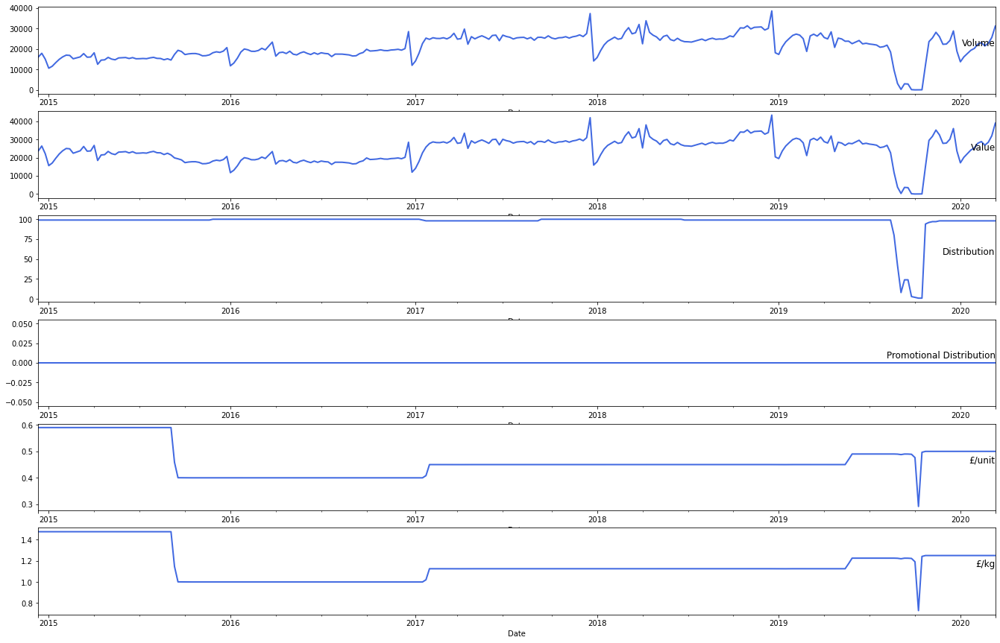

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f532f711588>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f532f69d7f0>)

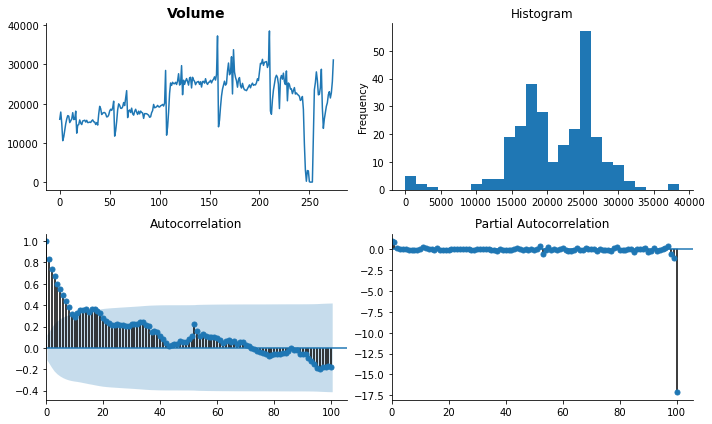

In [554]:
basic_info(tes_dig_400g_origin)
plot_data(tes_dig_400g_origin)
tsplot(tes_dig_400g_origin['Volume'].dropna(), title=tes_dig_400g_origin.columns[2], lags=100)


Test Statistic                  -2.037863
p-value                          0.270222
#Lags Used                      15.000000
Number of Observations Used    259.000000
Critical Value (1%)             -3.455853
Critical Value (5%)             -2.872765
Critical Value (10%)            -2.572752
dtype: float64


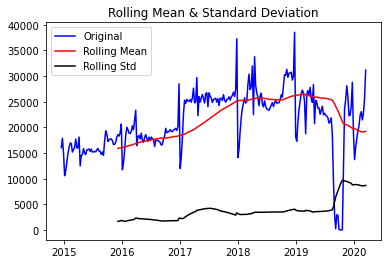

(<matplotlib.axes._subplots.AxesSubplot at 0x7f532f54feb8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f532f471f28>)

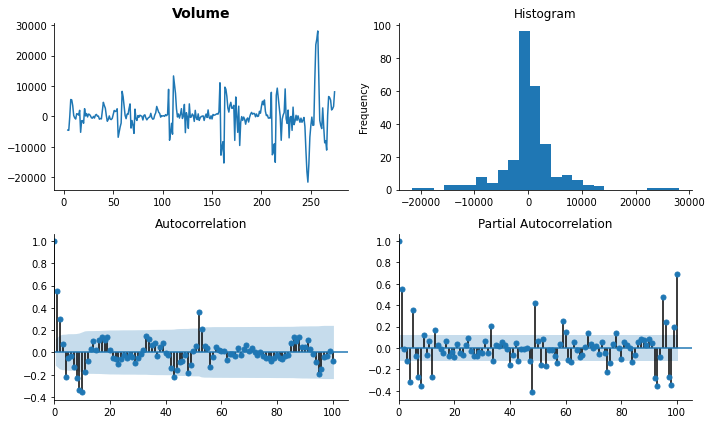

In [555]:
plot(tes_dig_400g_origin)
#plot stationary graph
series_transformed=tes_dig_400g_origin.copy()
series_transformed['Volume_transformed']=tes_dig_400g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=tes_dig_400g_origin.columns[2], lags=100)


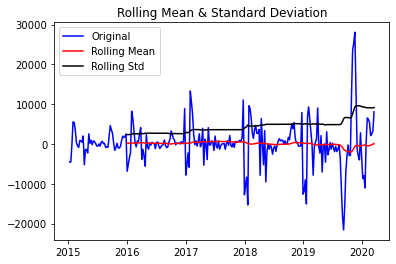

Results of Dickey-Fuller Test:
Test Statistic                  -5.575418
p-value                          0.000001
#Lags Used                      12.000000
Number of Observations Used    258.000000
Critical Value (1%)             -3.455953
Critical Value (5%)             -2.872809
Critical Value (10%)            -2.572775
dtype: float64


In [556]:
plot_transform(tes_dig_400g_origin)

       t-4      t+1
0      NaN  16038.4
1      NaN  17876.4
2      NaN  14999.6
3      NaN  10573.2
4  16038.4  11548.8
Test MSE: 78685714.153
Test RMSE: 8870.497


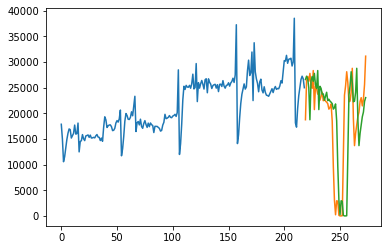

Observations: 271
Training Observations: 216
Testing Observations: 55


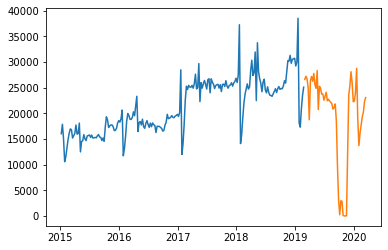

RMSE for Simple Exponential Smoothing α= 0.1 is: 10738.46
RMSE for Simple Exponential Smoothing α= 0.2 is: 10087.82
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 9629.75
RMSE for Simple Exponential Smoothing α= 0.4 is: 9461.57
RMSE for Simple Exponential Smoothing α= 0.5 is: 9474.99
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 9588.11
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 9744.21
RMSE for Simple Exponential Smoothing α= 0.8 is: 9901.74
RMSE for Simple Exponential Smoothing α= 0.9 is: 10035.65


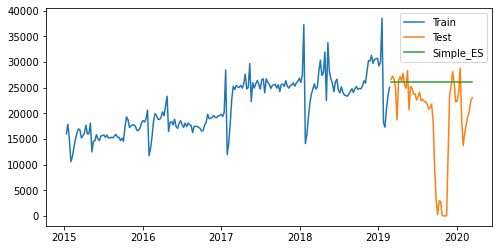

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.8 and β= 0.1 is: 7993.65


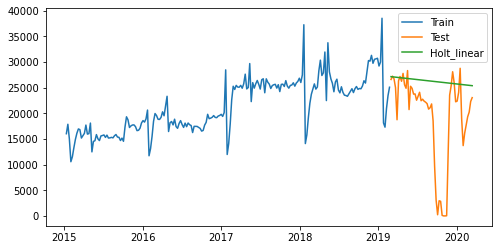

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

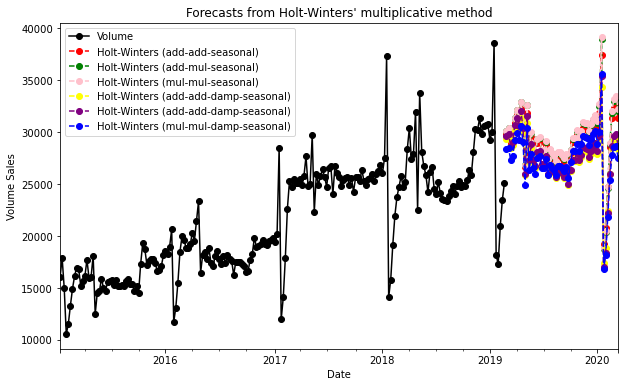

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
12642.538323536292
12926.02268445411
13000.966431047304
11317.552547823707
11462.47727382536
11694.95379187498


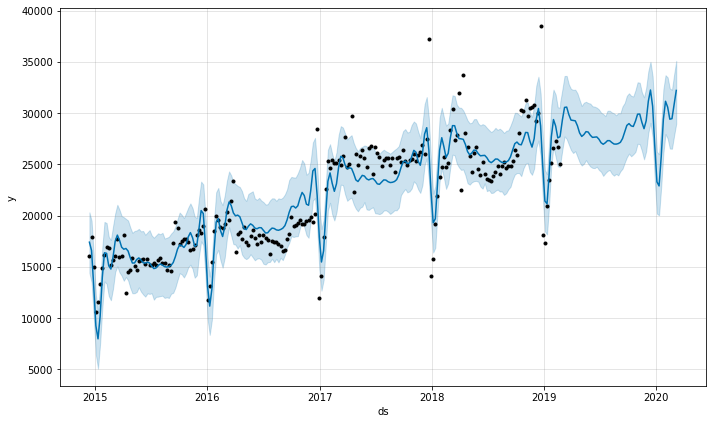

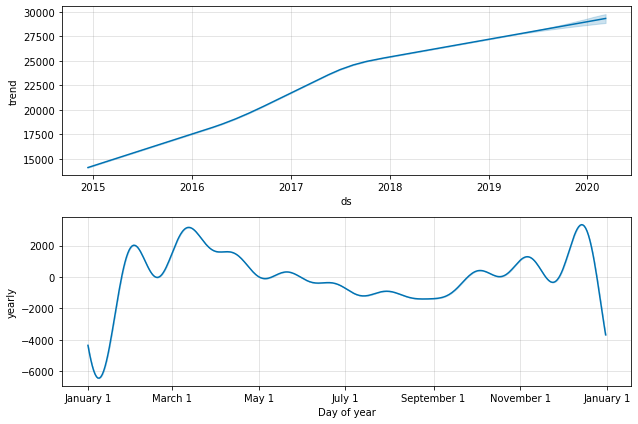

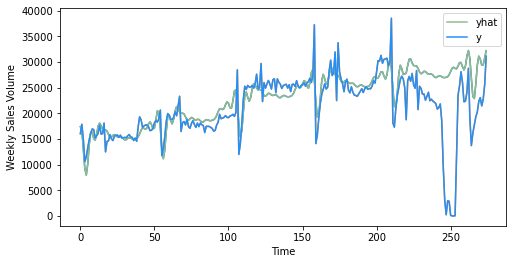

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 5765.69703150348
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17  

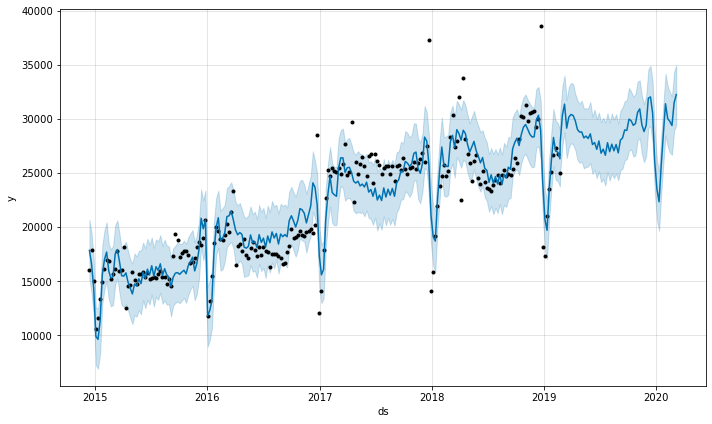

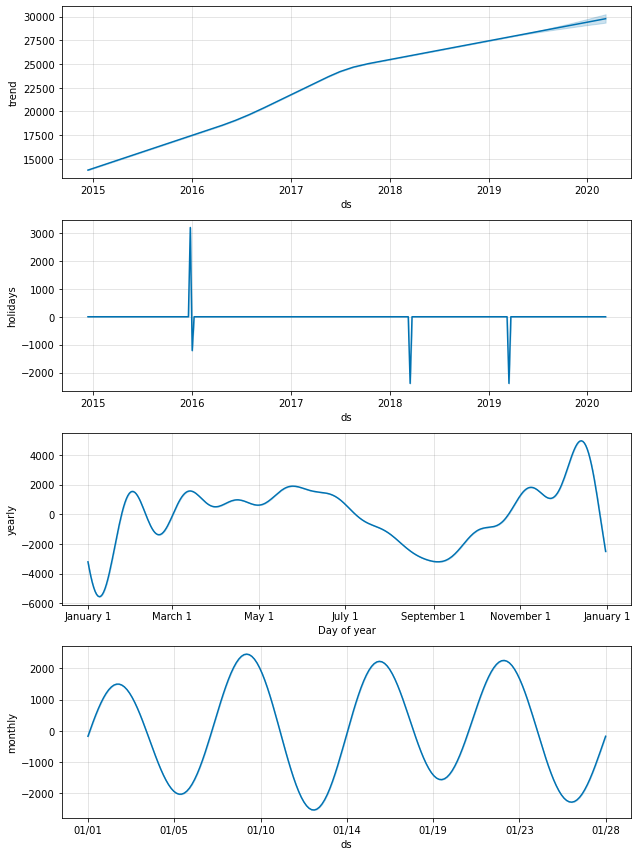

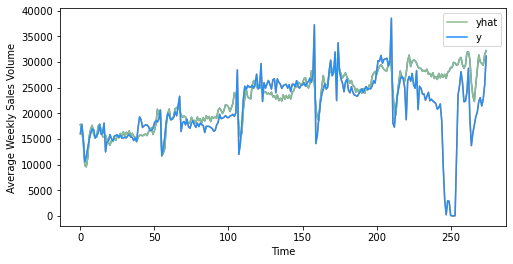

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 5823.723923675194


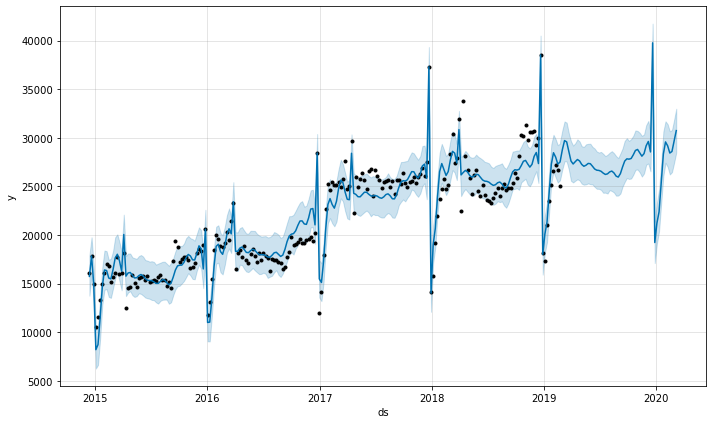

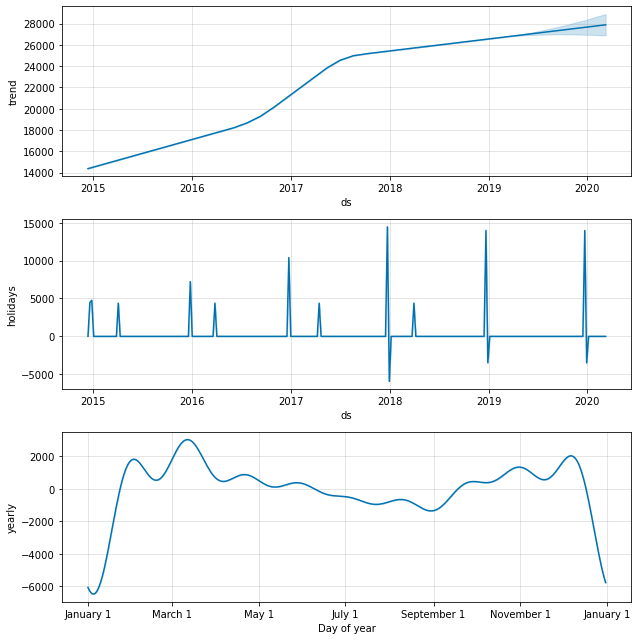

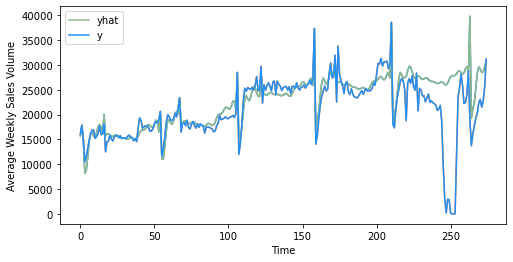

RMSE for prophet with only Christmas and Easter week is: 5359.057051962293


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [557]:
#time series models
baseline_model(tes_dig_400g_origin)
ses_model(tes_dig_400g_origin)
holt_linear_model(tes_dig_400g_origin)
holt_winter_model(tes_dig_400g_origin)
prophet_model(tes_dig_400g_origin)
prophet_all_holidays(tes_dig_400g_origin)
prophet_two_holiday(tes_dig_400g_origin)

Observations: 91
Training Observations: 46
Testing Observations: 45
[-0.2195366  -0.14305282 -1.71450855 -0.63489622 -0.46659584]
Mean Absolute Error: 3148.9328888888904
Mean Squared Error: 12145291.88201778
Root Mean Squared Error: 3485.0095956851796
Observations: 136
Training Observations: 91
Testing Observations: 45
[-4.77161097 -1.7026922  -0.98390472 -0.5536703  -0.40023135]
Mean Absolute Error: 7040.31288888889
Mean Squared Error: 62943487.85114667
Root Mean Squared Error: 7933.693203744815
Observations: 181
Training Observations: 136
Testing Observations: 45
[-1.35637007 -1.9043416  -0.53802607 -0.91601794 -7.42585256]
Mean Absolute Error: 3516.321333333331
Mean Squared Error: 20668840.500488877
Root Mean Squared Error: 4546.299649219009
Observations: 226
Training Observations: 181
Testing Observations: 45
[-1.42870391 -0.28037259 -1.74310418 -2.54847967  0.0711424 ]
Mean Absolute Error: 2540.029777777777
Mean Squared Error: 13972311.961946664
Root Mean Squared Error: 3737.95558

<Figure size 432x288 with 0 Axes>

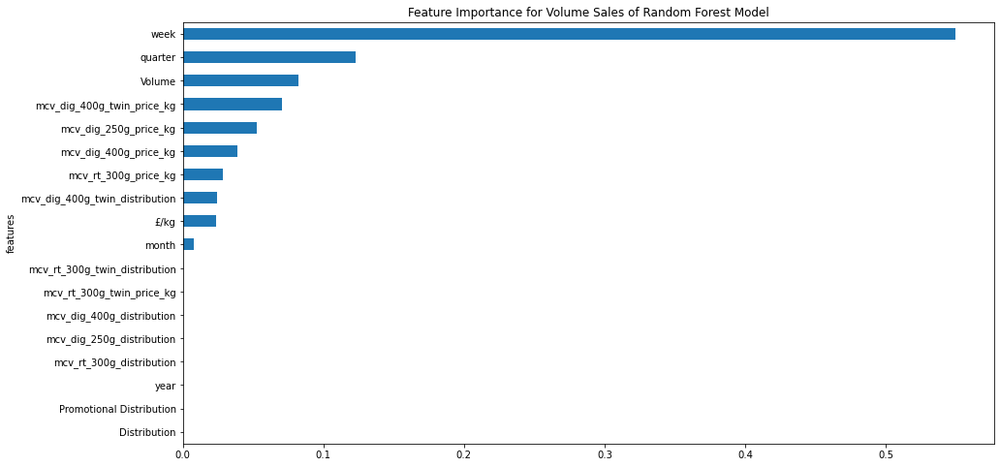

<Figure size 432x288 with 0 Axes>

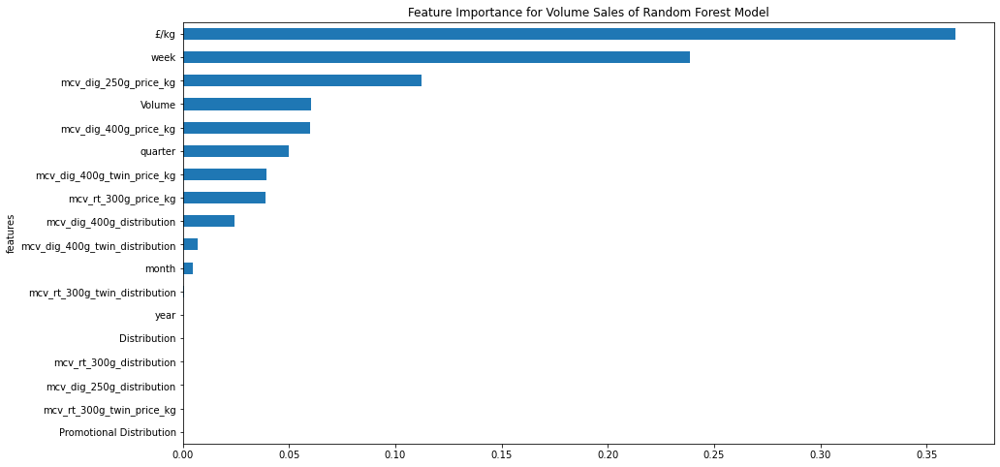

<Figure size 432x288 with 0 Axes>

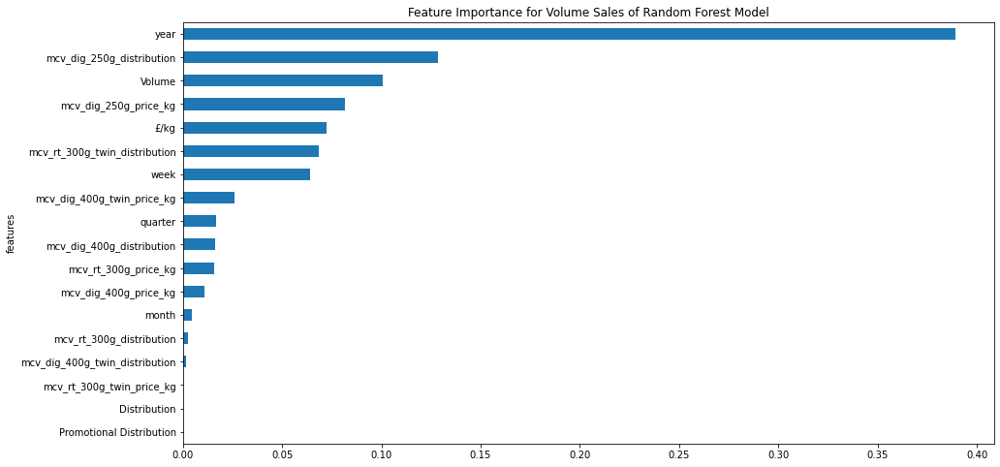

<Figure size 432x288 with 0 Axes>

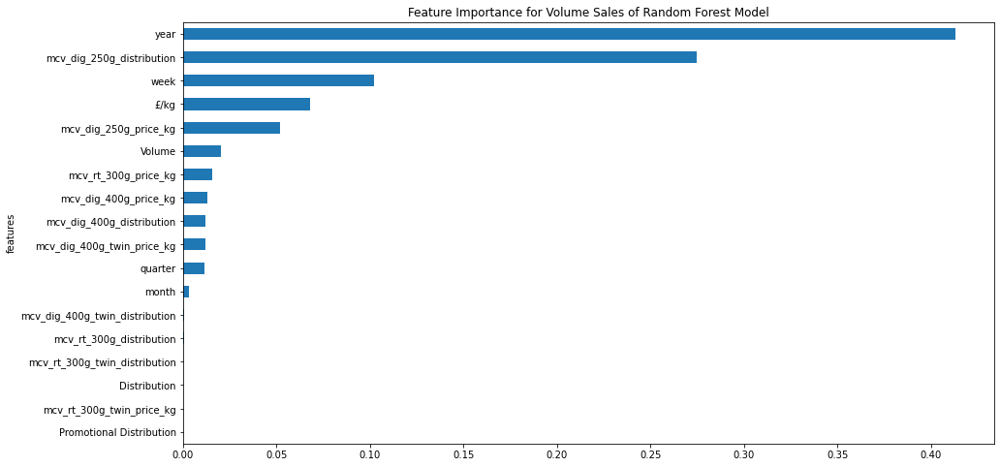

<Figure size 432x288 with 0 Axes>

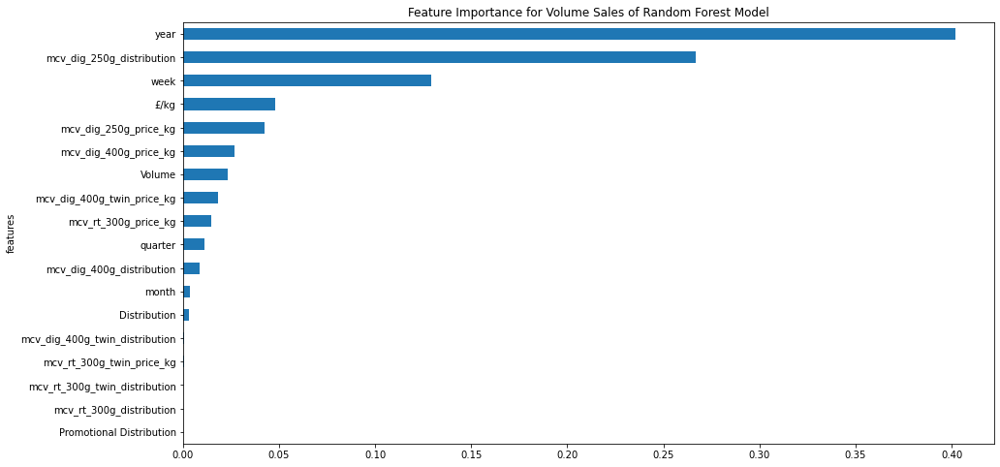

<Figure size 432x288 with 0 Axes>

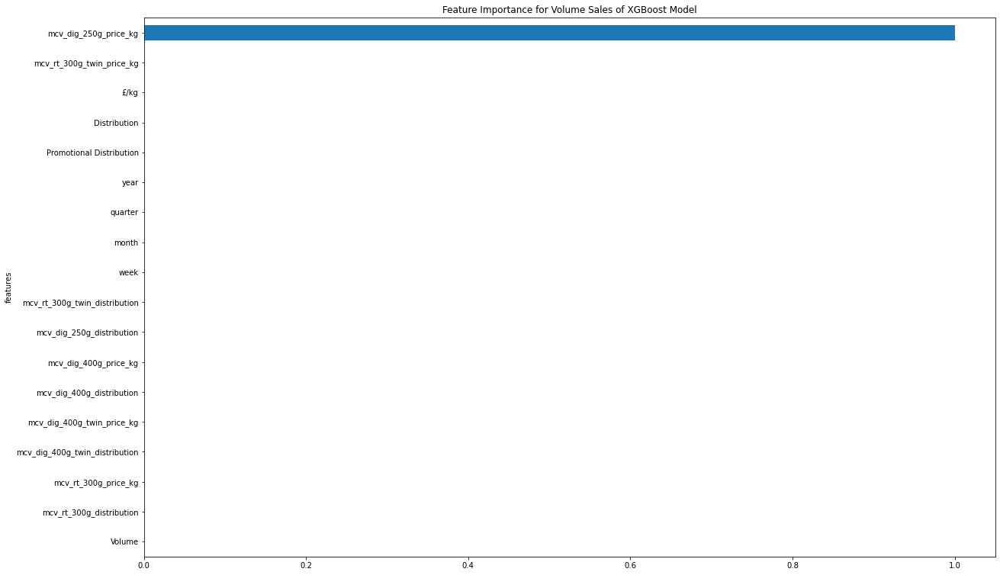

<Figure size 432x288 with 0 Axes>

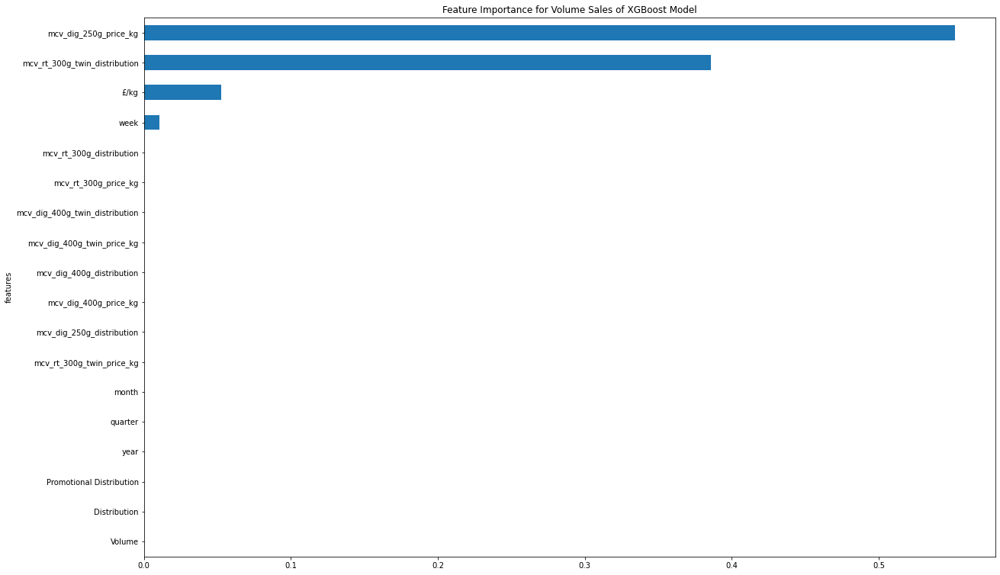

<Figure size 432x288 with 0 Axes>

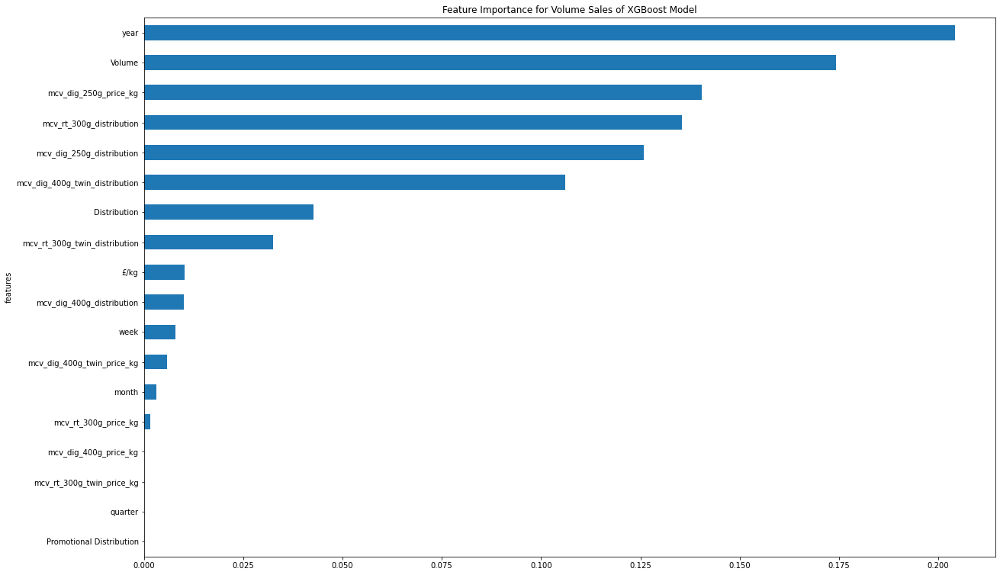

<Figure size 432x288 with 0 Axes>

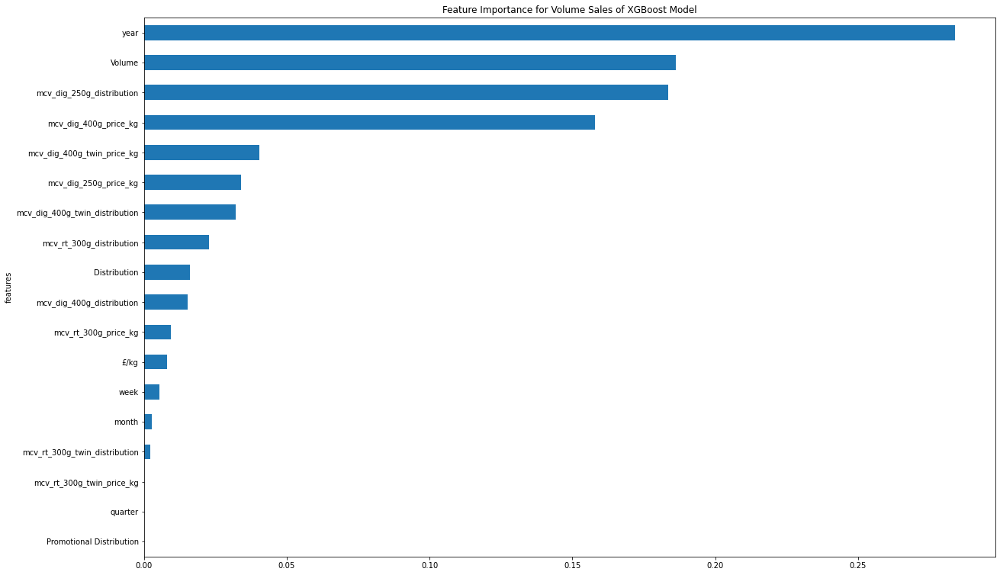

<Figure size 432x288 with 0 Axes>

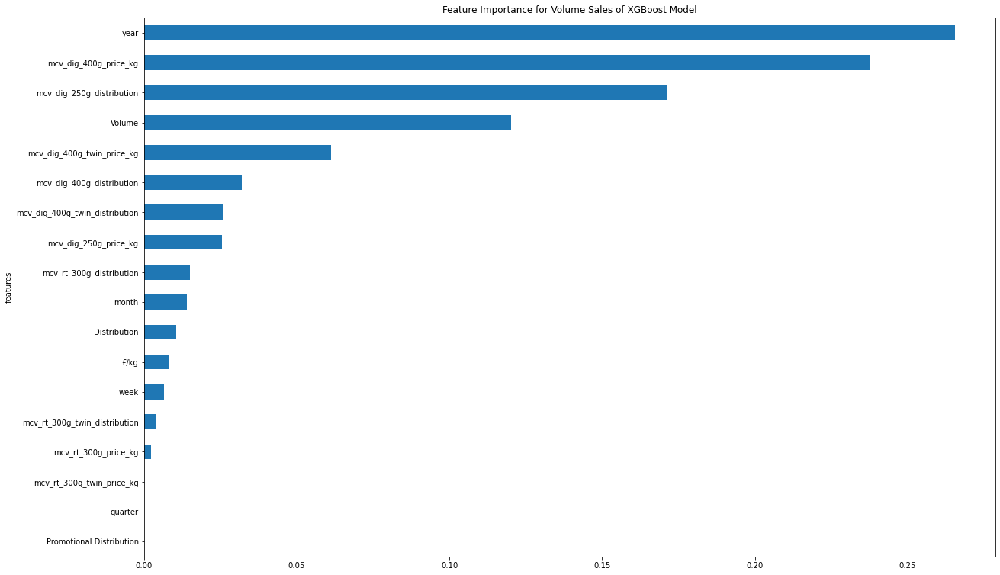

In [558]:
#machine learning model
tes_dig_400g_with_comp=variable_lag_tesco(tes_dig_400g_with_comp)
tes_dig_400g_input_X,tes_dig_400g_input_Y=input_var_tesco(tes_dig_400g_with_comp)
rf_regressor_tesco(tes_dig_400g_input_X,tes_dig_400g_input_Y)

tes_dig_400g_input_X,tes_dig_400g_input_Y=input_var_tesco(tes_dig_400g_with_comp)
xgb_regressor_tesco(tes_dig_400g_input_X,tes_dig_400g_input_Y)


,var1(t-4),var1(t)
Date,,
2015-01-10,16038.4,11548.8
2015-01-17,17876.4,13305.2
2015-01-24,14999.6,14907.6
2015-01-31,10573.2,16126.8
2015-02-07,11548.8,16966.4
...,...,...
2020-02-15,17715.2,23070.0
2020-02-22,19340.4,21459.6
2020-02-29,20247.2,22770.8


   var1(t-4)   var1(t)
4   0.415926  0.299447
5   0.463611  0.345015
6   0.388975  0.386588
7   0.274136  0.418219
8   0.299447  0.440002
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 37s - loss: 0.5548 - val_loss: 0.4932
Epoch 2/50
216/216 - 0s - loss: 0.5412 - val_loss: 0.4818
Epoch 3/50
216/216 - 0s - loss: 0.5275 - val_loss: 0.4702
Epoch 4/50
216/216 - 0s - loss: 0.5134 - val_loss: 0.4582
Epoch 5/50
216/216 - 0s - loss: 0.4986 - val_loss: 0.4455
Epoch 6/50
216/216 - 0s - loss: 0.4830 - val_loss: 0.4326
Epoch 7/50
216/216 - 0s - loss: 0.4664 - val_loss: 0.4198
Epoch 8/50
216/216 - 0s - loss: 0.4485 - val_loss: 0.4061
Epoch 9/50
216/216 - 0s - loss: 0.4293 - val_loss: 0.3913
Epoch 10/50
216/216 - 0s - loss: 0.4083 - val_loss: 0.3751
Epoch 11/50
216/216 - 0s - loss: 0.3856 - val_loss: 0.3575
Epoch 12/50
216/216 - 0s - loss: 0.3607 - val_loss: 0.3382
Epoch 13/50
216/216 - 0s - loss: 0.3335 - val_loss: 0.3170
Epoch 14/50
216/216 - 

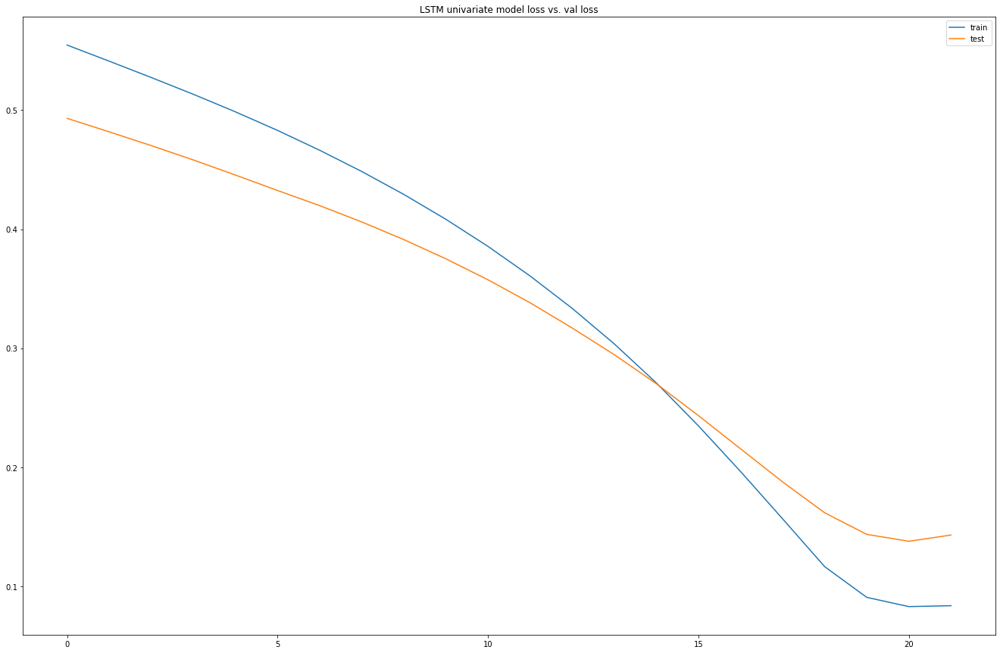

Test RMSE: 8103.780


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,16038.4,1.475527,99.0,0.0,2014.0,4.0,12.0,50.0,11548.8,1.475625,99,0,2015,1,1,2
2015-01-17,17876.4,1.475431,99.0,0.0,2014.0,4.0,12.0,51.0,13305.2,1.475558,99,0,2015,1,1,3
2015-01-24,14999.6,1.475346,99.0,0.0,2014.0,4.0,12.0,52.0,14907.6,1.475616,99,0,2015,1,1,4
2015-01-31,10573.2,1.475504,99.0,0.0,2015.0,1.0,1.0,1.0,16126.8,1.475618,99,0,2015,1,1,5
2015-02-07,11548.8,1.475625,99.0,0.0,2015.0,1.0,1.0,2.0,16966.4,1.475534,99,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,17715.2,1.250209,98.0,0.0,2020.0,1.0,1.0,3.0,23070.0,1.250139,98,0,2020,1,2,7
2020-02-22,19340.4,1.250202,98.0,0.0,2020.0,1.0,1.0,4.0,21459.6,1.250196,98,0,2020,1,2,8
2020-02-29,20247.2,1.250188,98.0,0.0,2020.0,1.0,2.0,5.0,22770.8,1.250162,98,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.415926   0.999869   0.989899        0.0   0.000000        1.0   
5   0.463611   0.999740   0.989899        0.0   0.000000        1.0   
6   0.388975   0.999626   0.989899        0.0   0.000000        1.0   
7   0.274136   0.999838   0.989899        0.0   0.166656        0.0   
8   0.299447   1.000000   0.989899        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.299447  
5        1.0   0.961538  0.345015  
6        1.0   0.980769  0.386588  
7        0.0   0.000000  0.418219  
8        0.0   0.019231  0.440002  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 37s - loss: 0.5421 - val_loss: 0.4794
Epoch 2/50
216/216 - 0s - loss: 0.5159 - val_loss: 0.4566
Epoch 3/50
216/216 - 0s - loss: 0.4886 - val_loss: 0.4341
Epoch 4/50
216/216 - 0s - loss: 0.4592 - val_loss: 0.4114
Epoch 5/50
216/216 - 0s - loss: 0.4267 - va

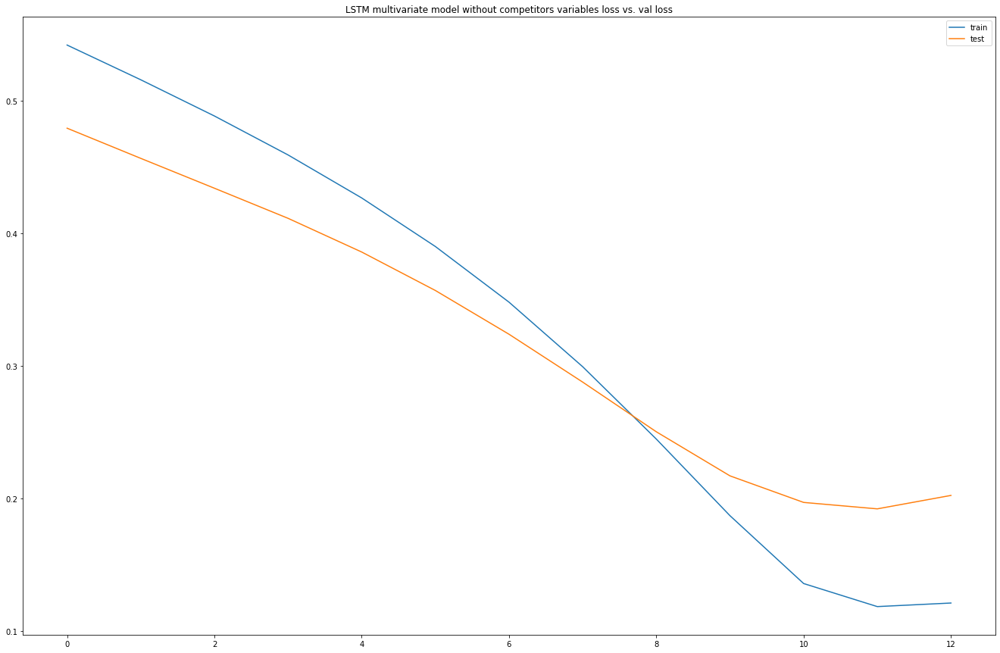

Test RMSE: 10731.083


In [559]:
#lstm models
series_to_supervised(tes_dig_400g_volume)
lstm_univariate(tes_dig_400g_volume)

series_to_supervised(tes_dig_400g_own_variable)
multivariate_lstm_without_competitor(tes_dig_400g_own_variable)


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t),var18(t),var19(t)
Date,,,,,,,,,,,,,,,,,,,,,
2015-02-07,11548.8,2015.0,1.0,1.0,2.0,16038.4,1.475527,99.0,0.0,3.560262,...,3.559761,97.0,2.039523,100.0,1.889689,96.0,3.396960,100.0,3.15,96.0
2015-02-14,13305.2,2015.0,1.0,1.0,3.0,17876.4,1.475431,99.0,0.0,3.560043,...,3.556789,97.0,2.040478,100.0,1.889442,96.0,3.398573,100.0,3.15,96.0
2015-02-21,14907.6,2015.0,1.0,1.0,4.0,14999.6,1.475346,99.0,0.0,3.560118,...,3.555143,97.0,2.123438,100.0,1.889339,96.0,3.536073,100.0,3.15,96.0
2015-02-28,16126.8,2015.0,1.0,1.0,5.0,10573.2,1.475504,99.0,0.0,3.560110,...,3.559082,97.0,2.182389,100.0,1.889769,96.0,3.636788,100.0,3.15,96.0
2015-03-07,16966.4,2015.0,1.0,2.0,6.0,11548.8,1.475625,99.0,0.0,3.559761,...,3.555369,97.0,2.182429,100.0,1.889773,96.0,3.635421,100.0,3.15,96.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,17715.2,2020.0,1.0,1.0,3.0,28790.8,1.250135,98.0,0.0,3.599914,...,3.595392,58.0,2.502099,100.0,2.362428,98.0,3.332535,100.0,3.15,98.0
2020-02-22,19340.4,2020.0,1.0,1.0,4.0,18920.4,1.250159,98.0,0.0,3.599945,...,3.599547,58.0,2.501775,100.0,2.362101,98.0,3.331737,100.0,3.15,98.0
2020-02-29,20247.2,2020.0,1.0,2.0,5.0,13715.2,1.250365,98.0,0.0,3.599752,...,3.599397,58.0,2.501675,100.0,2.362396,98.0,3.334121,100.0,3.15,98.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.299447        0.0        0.0   0.000000   0.019231   0.415926   
5   0.345015        0.0        0.0   0.000000   0.038462   0.463611   
6   0.386588        0.0        0.0   0.000000   0.057692   0.388975   
7   0.418219        0.0        0.0   0.000000   0.076923   0.274136   
8   0.440002        0.0        0.0   0.090909   0.096154   0.299447   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.999869   0.989899        0.0    0.227505    0.951219    0.409731   
5   0.999740   0.989899        0.0    0.227121    0.951219    0.410724   
6   0.999626   0.989899        0.0    0.227252    0.951219    0.415930   
7   0.999838   0.989899        0.0    0.227238    0.951219    0.414646   
8   1.000000   0.989899        0.0    0.226624    0.951219    0.414180   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)  var18(t-4)  \
4         1.0    0.298082    0.973333    0.299385  

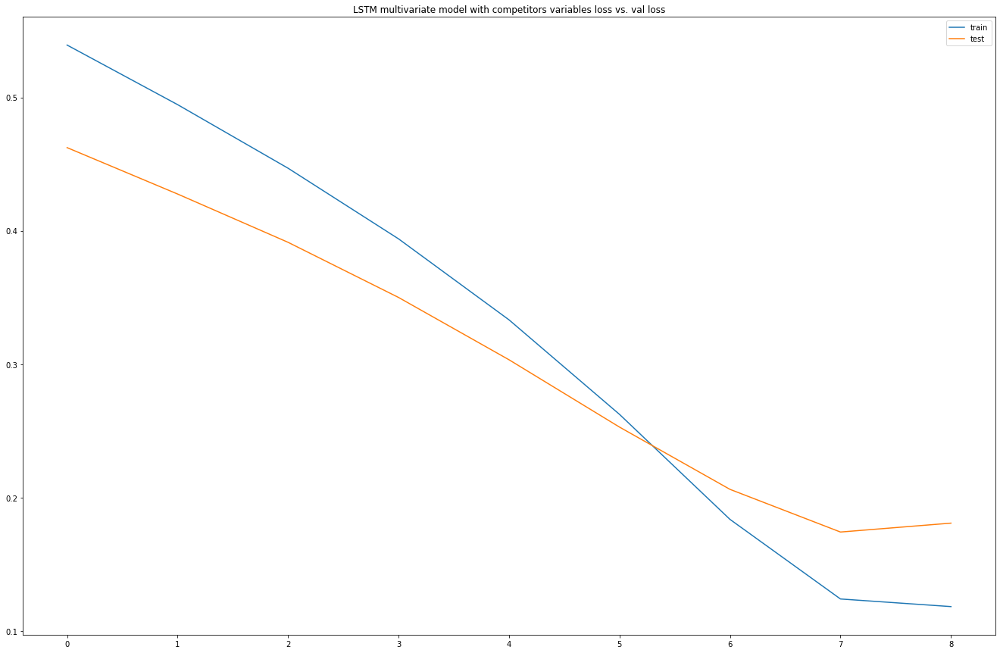

Test RMSE: 10837.874


In [560]:

series_to_supervised(tes_dig_400g_with_comp)
multivariate_with_competitor_tesco(tes_dig_400g_with_comp)

# Asda - McVitie's Digestives 400g

In [94]:
#import dataset - asda products
mcv_dig_400g_asda=pd.read_excel("Asda/Asda MCVTS DGSTVS 400G SNGL.xlsx")
mcv_dig_400g_twin_asda=pd.read_excel("Asda/Asda MCVTS DGSTVS 400G 2PACK.xlsx")
mcv_rt_300g_asda=pd.read_excel("Asda/Asda RCH T MCVTS RCH T PLN 300 GM SNGL.xlsx")
mcv_rt_300g_twin_asda=pd.read_excel("Asda/Asda RCH T MCVTS RCH T PLN 300 GM 2 PCK.xlsx")

#import dataset - competitors products
asda_dig_400g=pd.read_excel("Asda/Asda (own label) TSC DGSTVS PLN 400 GM SNGL.xlsx")
asda_rt_250g=pd.read_excel("Asda/Asda (own label) RCH T TSC RCH T FNGRS PLN 250 GM SNGL.xlsx")
asda_rt_300g=pd.read_excel("Asda/Asda (own label) RCH T TSC RCH T PLN 300 GM SNGL.xlsx")



In [95]:
#put corresponding dataset file into lists
mcv_list=[mcv_dig_400g_asda,mcv_dig_400g_twin_asda,mcv_rt_300g_asda,mcv_rt_300g_twin_asda]
asda_list=[asda_dig_400g,asda_rt_250g,asda_rt_300g]
asda_total=[mcv_dig_400g_asda,mcv_dig_400g_twin_asda,
            mcv_rt_300g_asda,mcv_rt_300g_twin_asda,
           asda_dig_400g,asda_rt_250g,asda_rt_300g]


In [96]:
#transform date format and add quarter, week and month
asda_product=[]

for df in asda_total:
#     df = DataFrame(data)
    df=df[:275]
    date_time = df['SDESC'].str[3:]
    date_time=pd.to_datetime(date_time, format='%d.%m.%y')
    df['SDESC']=date_time
    df=df.dropna()
    df.rename(columns={'SDESC':'Date'}, inplace=True)
    
    df['year'] = pd.DatetimeIndex(df['Date']).year
    df['quarter'] = pd.DatetimeIndex(df['Date']).quarter
    # month as number
    df['month'] = pd.DatetimeIndex(df['Date']).month
    # week as number
    df['week'] = pd.DatetimeIndex(df['Date']).week
#     df=df.set_index('Date')

    asda_product.append(df)
    continue


#assign list name
mcv_dig_400g_asda_origin=asda_product[0]
mcv_dig_400g_twin_asda_origin=asda_product[1]
mcv_rt_300g_asda_origin=asda_product[2]
mcv_rt_300g_twin_asda_origin=asda_product[3]
asda_dig_400g_origin=asda_product[4]
asda_rt_250g_origin=asda_product[5]
asda_rt_300g_origin=asda_product[6]


/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:9: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: http://pandas.pydata.org/pandas-docs/stable/indexing.html#indexing-view-versus-copy



,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,67468,33734.0,68223.0,100,22,1.011190,2.022381,2014,4,12,50
1,2014-12-20,70251,35125.5,71049.0,100,25,1.011359,2.022719,2014,4,12,51
2,2014-12-27,60800,30400.0,61668.2,100,25,1.014280,2.028559,2014,4,12,52
3,2015-01-03,45074,22537.0,45399.9,100,36,1.007230,2.014461,2015,1,1,1
4,2015-01-10,57355,28677.5,56019.3,100,50,0.976712,1.953423,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,64677.770909,28515.661091,64011.872364,99.854545,14.207273,0.991883,2.294104,2017.083636,2.469091,6.414545,26.043636
std,12602.014703,7615.877084,11796.188424,1.039690,25.057539,0.041887,0.262126,1.534371,1.140635,3.547767,15.490223
min,24747.000000,9898.800000,21736.400000,85.000000,0.000000,0.820686,1.641372,2014.000000,1.000000,1.000000,1.000000
25%,57330.500000,23872.200000,57348.750000,100.000000,0.000000,0.998713,1.999331,2016.000000,1.000000,3.000000,12.000000
50%,63848.000000,26470.000000,63353.200000,100.000000,0.000000,0.999516,2.496433,2017.000000,2.000000,6.000000,26.000000
75%,69958.000000,32056.350000,68804.450000,100.000000,14.500000,0.999749,2.499132,2018.000000,3.500000,9.500000,39.500000
95%,88221.500000,44110.750000,88183.210000,100.000000,69.000000,0.999910,2.499711,2019.000000,4.000000,12.000000,50.000000
99%,98159.520000,49079.760000,94590.412000,100.000000,99.260000,1.181846,2.954615,2020.000000,4.000000,12.000000,52.000000
max,117558.000000,58779.000000,96748.000000,100.000000,100.000000,1.187854,2.969636,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

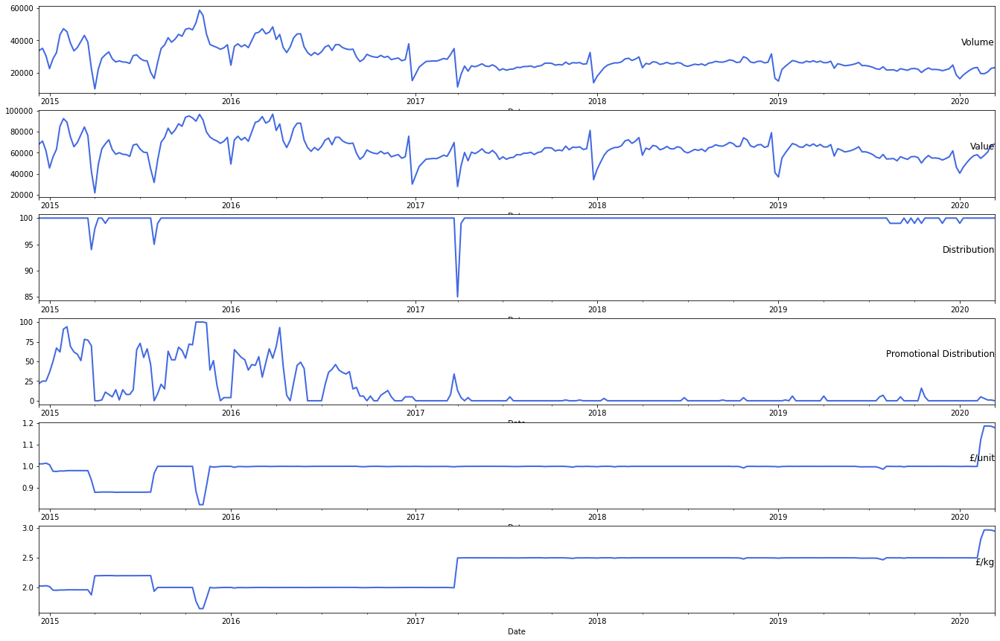

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5329bdaef0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5329b37fd0>)

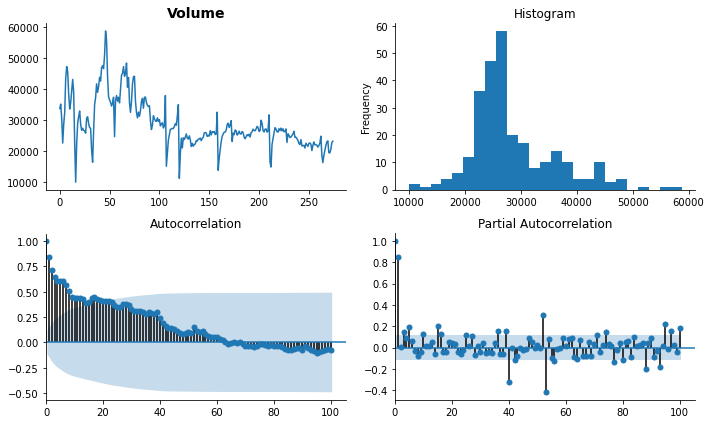

In [569]:
basic_info(mcv_dig_400g_asda_origin)
plot_data(mcv_dig_400g_asda_origin)
tsplot(mcv_dig_400g_asda_origin['Volume'].dropna(), title=mcv_dig_400g_asda_origin.columns[2], lags=100)


Test Statistic                  -2.579539
p-value                          0.097300
#Lags Used                       4.000000
Number of Observations Used    270.000000
Critical Value (1%)             -3.454804
Critical Value (5%)             -2.872305
Critical Value (10%)            -2.572506
dtype: float64


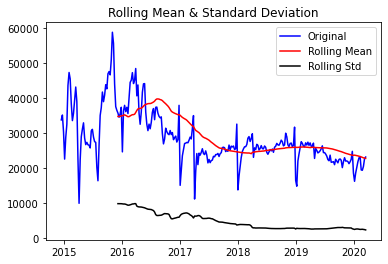

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f53299e8278>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53298932b0>)

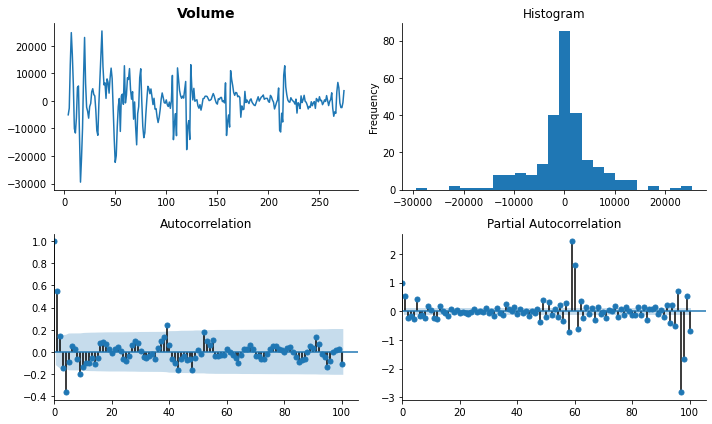

In [570]:
plot(mcv_dig_400g_asda_origin)
series_transformed=mcv_dig_400g_asda_origin.copy()
series_transformed['Volume_transformed']=mcv_dig_400g_asda_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_dig_400g_asda_origin.columns[2], lags=100)


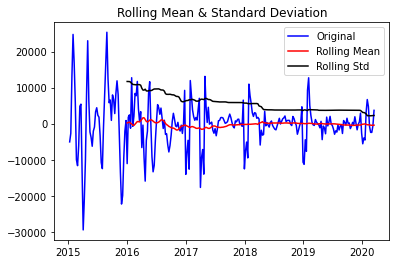

Results of Dickey-Fuller Test:
Test Statistic                -6.296919e+00
p-value                        3.487614e-08
#Lags Used                     1.200000e+01
Number of Observations Used    2.580000e+02
Critical Value (1%)           -3.455953e+00
Critical Value (5%)           -2.872809e+00
Critical Value (10%)          -2.572775e+00
dtype: float64


In [571]:
plot_transform(mcv_dig_400g_asda_origin)

       t-4      t+1
0      NaN  33734.0
1      NaN  35125.5
2      NaN  30400.0
3      NaN  22537.0
4  33734.0  28677.5
Test MSE: 4950236.902
Test RMSE: 2224.913


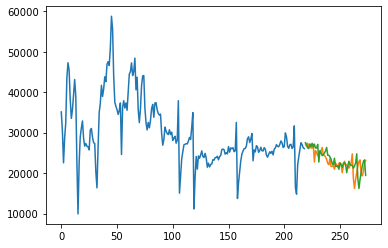

Observations: 271
Training Observations: 216
Testing Observations: 55


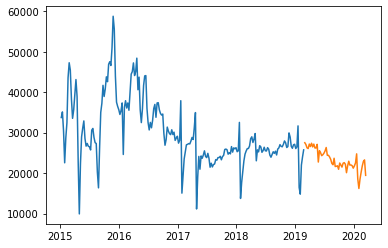

RMSE for Simple Exponential Smoothing α= 0.1 is: 2879.23
RMSE for Simple Exponential Smoothing α= 0.2 is: 2558.73
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2527.56
RMSE for Simple Exponential Smoothing α= 0.4 is: 2535.11
RMSE for Simple Exponential Smoothing α= 0.5 is: 2595.52
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2742.16
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 2946.28
RMSE for Simple Exponential Smoothing α= 0.8 is: 3153.21
RMSE for Simple Exponential Smoothing α= 0.9 is: 3326.31


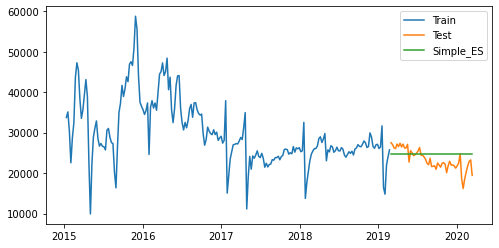

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.6000000000000001 and β= 0.1 is: 2026.92


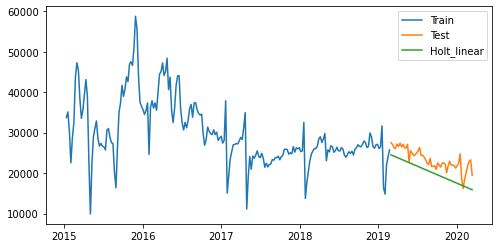

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

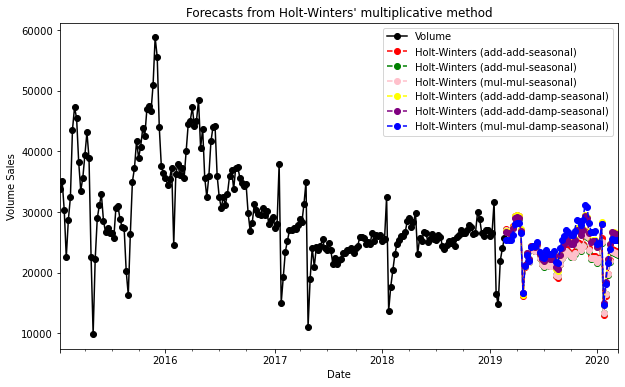

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
2970.822194902957
2791.0717792719875
2804.094346140534
3797.2117713056637
3654.164258700454
4153.692218249149


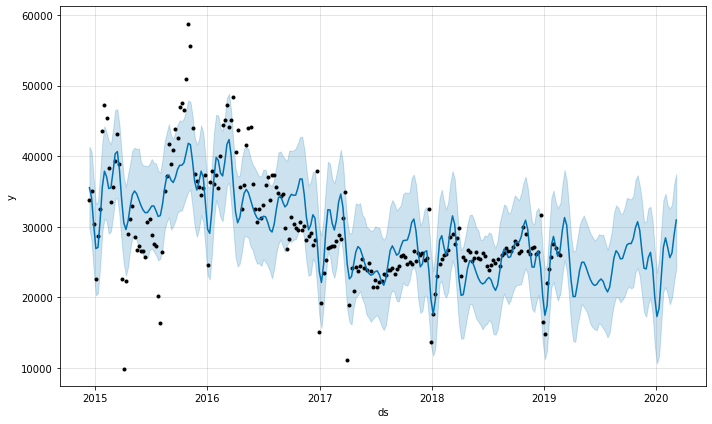

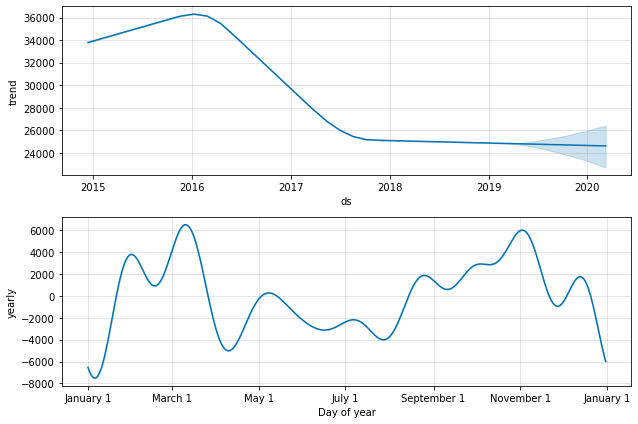

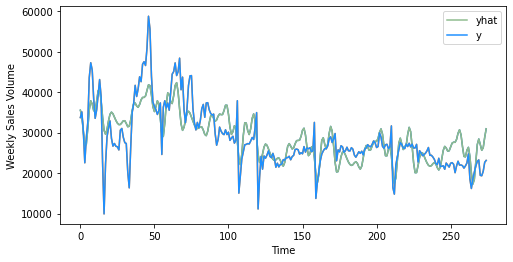

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 4820.905647014377
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

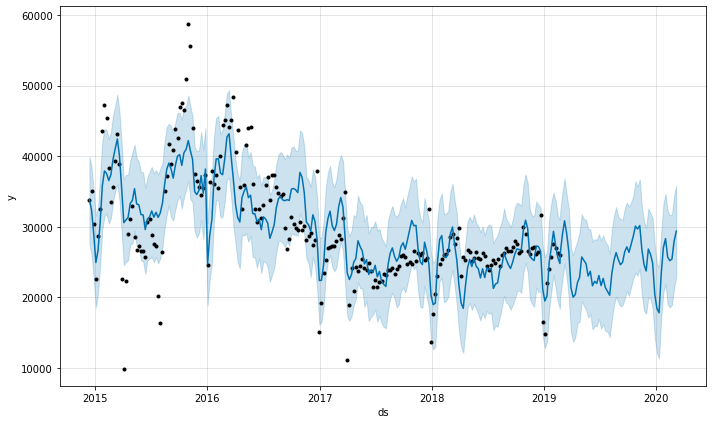

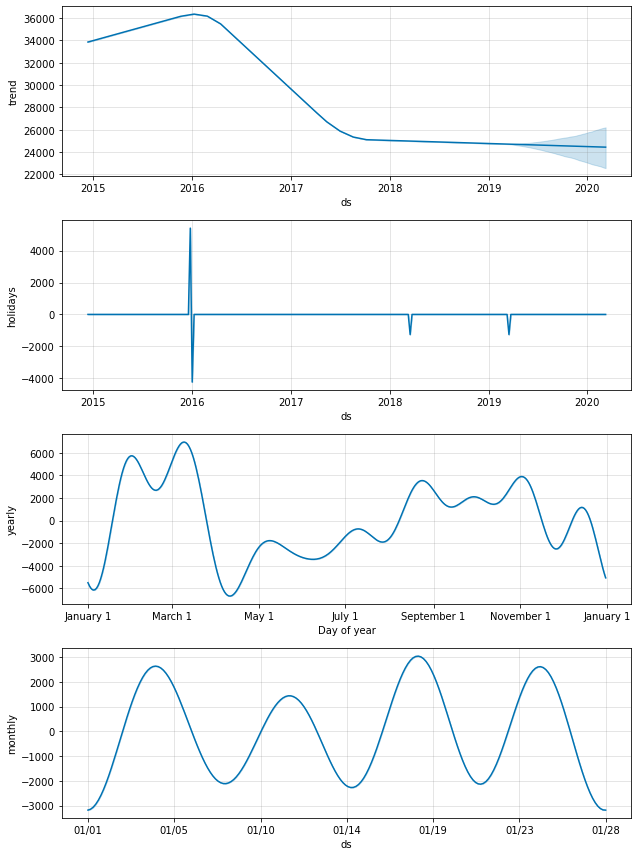

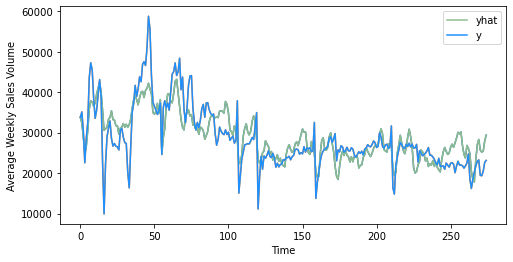

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 4695.882867095814


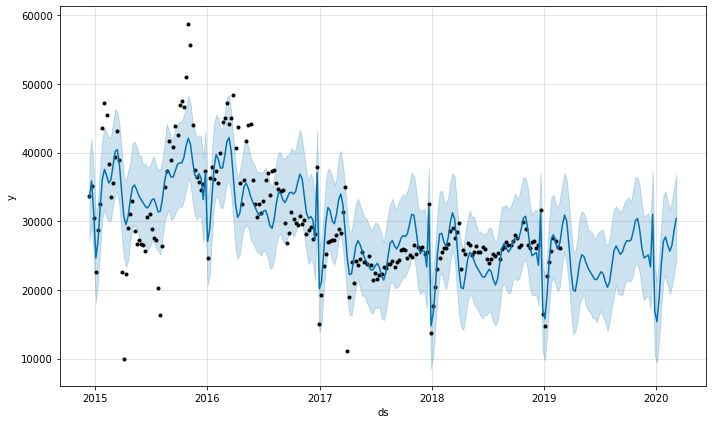

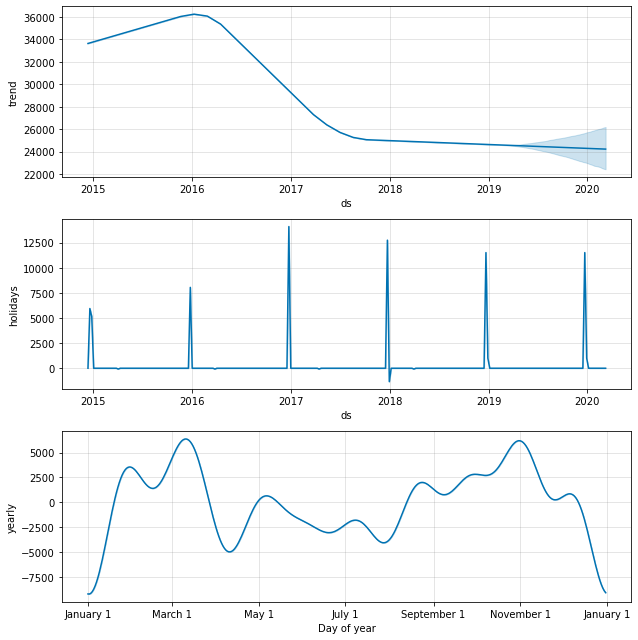

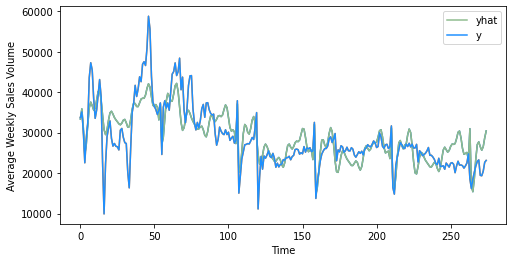

RMSE for prophet with only Christmas and Easter week is: 4670.83713843974


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [572]:
#time series models
baseline_model(mcv_dig_400g_asda_origin)
ses_model(mcv_dig_400g_asda_origin)
holt_linear_model(mcv_dig_400g_asda_origin)
holt_winter_model(mcv_dig_400g_asda_origin)
prophet_model(mcv_dig_400g_asda_origin)
prophet_all_holidays(mcv_dig_400g_asda_origin)
prophet_two_holiday(mcv_dig_400g_asda_origin)


<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_asda')

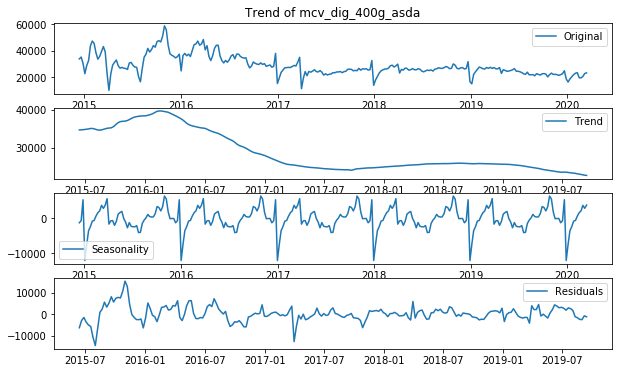

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin_asda')

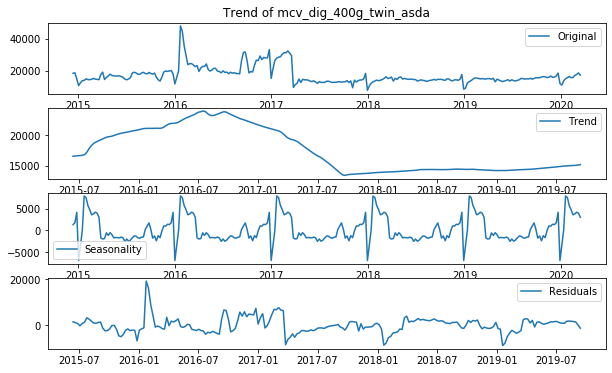

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_asda')

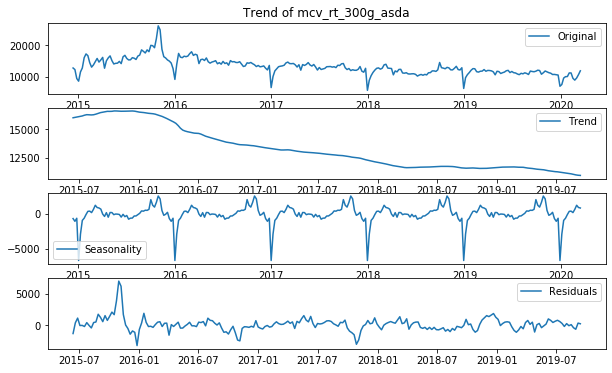

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin_asda')

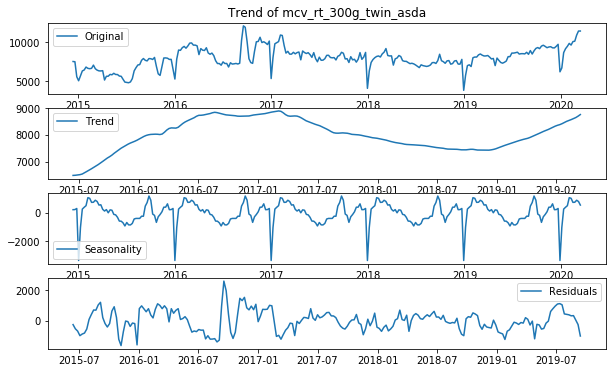

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

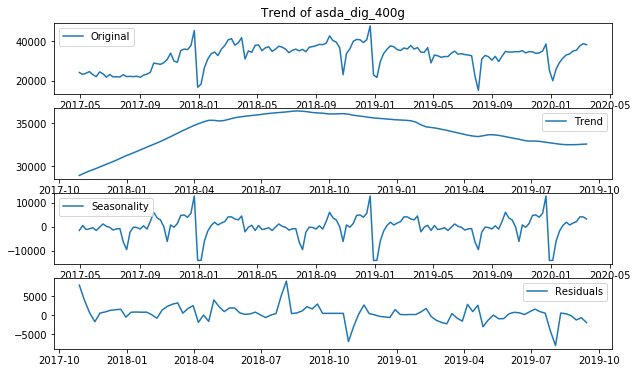

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

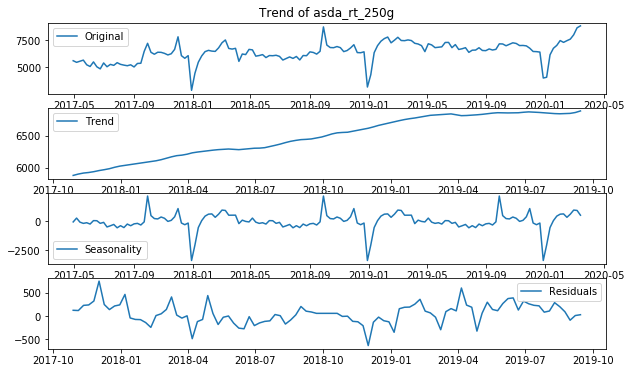

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_300g')

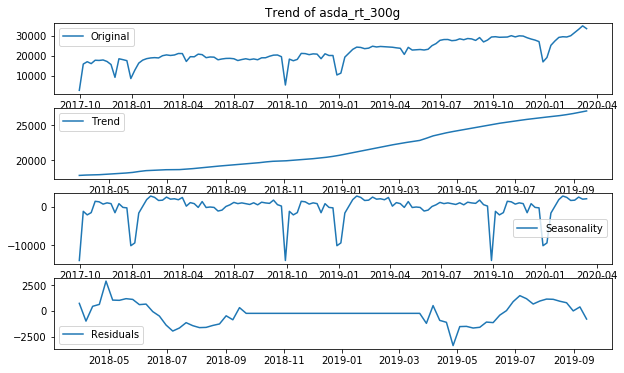

In [97]:
#variable analysis
from statsmodels.tsa.seasonal import seasonal_decompose

asda_name=['mcv_dig_400g_asda','mcv_dig_400g_twin_asda',
          'mcv_rt_300g_asda','mcv_rt_300g_twin_asda',
          'asda_dig_400g', 'asda_rt_250g','asda_rt_300g'
         ]

asda_total_2=[]
i=0
for df in asda_product:
    df=df.set_index('Date')
    df=df[['Volume']]
    df = df.dropna()
    asda_total_2.append(df)
    
    try:
        decomposition=seasonal_decompose(df)
    except ValueError:
        print('No enough datapoints for plotting the complete graphs')
   
    trend=decomposition.trend
    seasonal=decomposition.seasonal
    residual=decomposition.resid

    plt.figure(figsize=(10,6))
    plt.subplot(411)
    plt.plot(df, label='Original')
    plt.legend(loc='best')
    plt.title('Trend of ' + asda_name[i] )
    plt.subplot(412)
    plt.plot(trend, label='Trend')
    plt.legend(loc='best')
    plt.subplot(413)
    plt.plot(seasonal, label='Seasonality')
    plt.legend(loc='best')
    plt.subplot(414)
    plt.plot(residual, label='Residuals')
    plt.legend(loc='best')
    plt.show()
    i=i+1

mcv_dig_400g_asda_volume=asda_total_2[0]
mcv_dig_400g_twin_asda_volume=asda_total_2[1]
mcv_rt_300g_asda_volume=asda_total_2[2]
mcv_rt_300g_twin_asda_volume=asda_total_2[3]
asda_dig_400g_volume=asda_total_2[4]
asda_rt_250g_volume=asda_total_2[5]
asda_rt_300g_volume=asda_total_2[6]


#### Compare trends with Pladis product and competitors' product

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

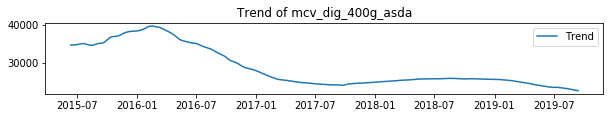

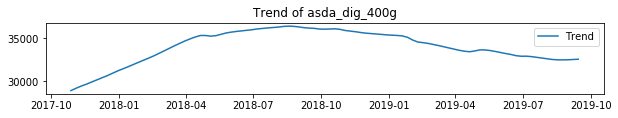

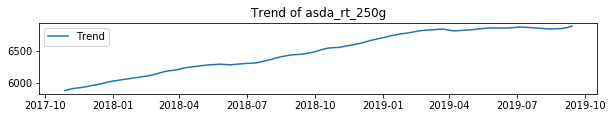

In [110]:
# mcv_dig_400g_asda_competitor=[mcv_dig_400g_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume,asda_rt_300g_volume]
# mcv_dig_400g_asda_competitor_list=['mcv_dig_400g_asda','asda_dig_400g','asda_rt_250g','asda_rt_300g']
# mcv_dig_400g_twin_asda_competitor=[mcv_dig_400g_twin_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume,asda_rt_300g_volume]
# mcv_dig_400g_twin_asda_competitor_list=['mcv_dig_400g_twin_asda','asda_dig_400g','asda_rt_250g','asda_rt_300g']
# mcv_rt_300g_asda_competitor=[asda_rt_250g_volume,asda_dig_400g_volume,asda_rt_250g_volume,asda_rt_300g_volume]
# mcv_rt_300g_asda_competitor_list=['mcv_rt_300g','asda_dig_400g','asda_rt_250g','asda_rt_300g']
# mcv_rt_300g_twin_asda_competitor=[mcv_rt_300g_twin_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume,asda_rt_300g_volume]
# mcv_rt_300g_twin_asda_competitor_list=['mcv_rt_300g_twin','asda_dig_400g','asda_rt_250g','asda_rt_300g']

mcv_dig_400g_asda_competitor=[mcv_dig_400g_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume]
mcv_dig_400g_asda_competitor_list=['mcv_dig_400g_asda','asda_dig_400g','asda_rt_250g']
mcv_dig_400g_twin_asda_competitor=[mcv_dig_400g_twin_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume]
mcv_dig_400g_twin_asda_competitor_list=['mcv_dig_400g_twin_asda','asda_dig_400g','asda_rt_250g']
mcv_rt_300g_asda_competitor=[mcv_rt_300g_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume]
mcv_rt_300g_asda_competitor_list=['mcv_rt_300g_asda','asda_dig_400g','asda_rt_250g']
mcv_rt_300g_twin_asda_competitor=[mcv_rt_300g_twin_asda_volume,asda_dig_400g_volume,asda_rt_250g_volume]
mcv_rt_300g_twin_asda_competitor_list=['mcv_rt_300g_twin','asda_dig_400g','asda_rt_250g']

i=0
for product in mcv_dig_400g_asda_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_dig_400g_asda_competitor_list[i] )
    i=i+1
    
#asda rt 300g les than 104 observations, cannot plot trend

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

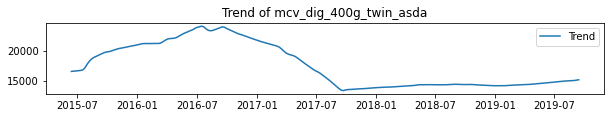

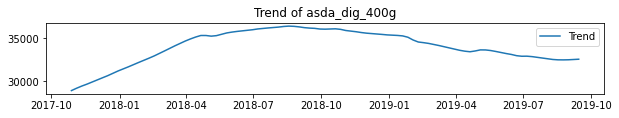

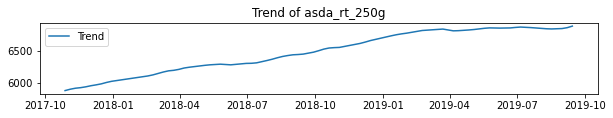

In [575]:
i=0
for product in mcv_dig_400g_twin_asda_competitor:
    decomposition=seasonal_decompose(product)
    trend_2=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_2, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_dig_400g_twin_asda_competitor_list[i])
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

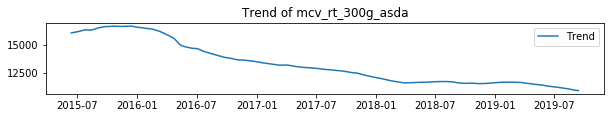

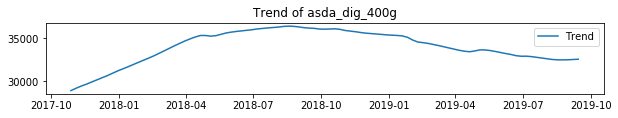

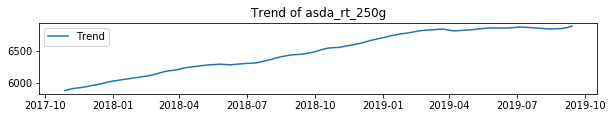

In [111]:
i=0
for product in mcv_rt_300g_asda_competitor:
    decomposition=seasonal_decompose(product)
    trend_3=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_3, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_rt_300g_asda_competitor_list[i])
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

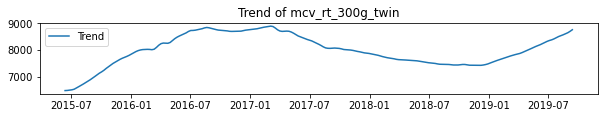

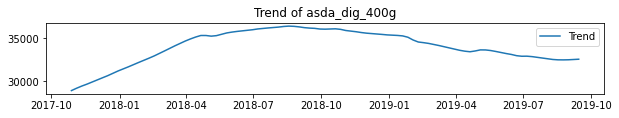

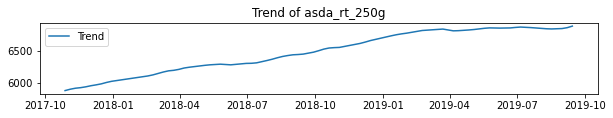

In [577]:
i=0
for product in mcv_rt_300g_twin_asda_competitor:
    decomposition=seasonal_decompose(product)
    trend_4=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_4, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + mcv_rt_300g_twin_asda_competitor_list[i])
    i=i+1

In [578]:
mcv_dig_400g_asda_volume=tes_large2[0]
mcv_dig_400g_twin_asda_volume=tes_large2[1]
mcv_rt_300g_asda_volume=tes_large2[2]
mcv_rt_300g_twin_asda_volume=tes_large2[3]
asda_dig_400g_volume=tes_large2[4]
asda_rt_250g_volume=tes_large2[5]
asda_rt_300g_volume=tes_large2[6]

In [579]:
#trend correlation
decomposition_1=seasonal_decompose(mcv_dig_400g_asda_volume)
trend_1=decomposition_1.trend
trend_1=trend_1.to_frame()

comp_decomposition_1=seasonal_decompose(asda_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(asda_rt_250g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

# # datapoints are less than 104 observations
# comp_decomposition_3=seasonal_decompose(asda_rt_300g_volume)
# comp_trend3=comp_decomposition_3.trend
# comp_trend3=comp_trend3.to_frame()

# comp_decomposition_4=seasonal_decompose(tes_rt_300g_volume)
# comp_trend4=comp_decomposition_4.trend
# comp_trend4=comp_trend4.to_frame()

mcv_dig_400g_asda_comp=pd.merge(trend_1,comp_trend1, how='left', on='Date')
mcv_dig_400g_asda_comp=pd.merge(mcv_dig_400g_asda_comp,comp_trend2, how='left', on='Date')
# mcv_dig_400g_asda_comp=pd.merge(mcv_dig_250g_comp,comp_trend3, how='left', on='Date')
# mcv_dig_250g_comp=pd.merge(mcv_dig_250g_comp,comp_trend4, how='left', on='Date')
mcv_dig_400g_asda_comp.columns=['mcv_dig_400g_asda_trend', 'asda_dig_400g','asda_rt_250g']

mcv_dig_400g_asda_comp.corr()


,mcv_dig_400g_asda_trend,asda_dig_400g,asda_rt_250g
mcv_dig_400g_asda_trend,1.000000,0.284689,-0.866579
asda_dig_400g,0.284689,1.000000,-0.299945
asda_rt_250g,-0.866579,-0.299945,1.000000


In [580]:
decomposition_2=seasonal_decompose(mcv_dig_400g_twin_asda_volume)
trend_2=decomposition_2.trend
trend_2=trend_2.to_frame()

comp_decomposition_1=seasonal_decompose(asda_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(asda_rt_250g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

mcv_dig_400g_twin_asda_comp=pd.merge(trend_2,comp_trend1, how='left', on='Date')
mcv_dig_400g_twin_asda_comp=pd.merge(mcv_dig_400g_twin_asda_comp,comp_trend2, how='left', on='Date')
# mcv_400g_comp=pd.merge(mcv_400g_comp,comp_trend3, how='left', on='Date')
# mcv_400g_comp=pd.merge(mcv_400g_comp,comp_trend4, how='left', on='Date')
mcv_dig_400g_twin_asda_comp.columns=['mcv_dig_400g_twin_asda_trend', 'asda_dig_400g','asda_rt_250g']

mcv_dig_400g_twin_asda_comp.corr()


,mcv_dig_400g_twin_asda_trend,asda_dig_400g,asda_rt_250g
mcv_dig_400g_twin_asda_trend,1.000000,-0.833973,-0.079756
asda_dig_400g,-0.833973,1.000000,-0.299945
asda_rt_250g,-0.079756,-0.299945,1.000000


In [581]:
decomposition_3=seasonal_decompose(mcv_rt_300g_asda_volume)
trend_3=decomposition_3.trend
trend_3=trend_3.to_frame()

comp_decomposition_1=seasonal_decompose(asda_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(asda_rt_250g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

mcv_rt_300g_asda_comp=pd.merge(trend_3,comp_trend1, how='left', on='Date')
mcv_rt_300g_asda_comp=pd.merge(mcv_rt_300g_asda_comp,comp_trend2, how='left', on='Date')
# mcv_dig_400g_twin_comp=pd.merge(mcv_dig_400g_twin_comp,comp_trend3, how='left', on='Date')
# mcv_dig_400g_twin_comp=pd.merge(mcv_dig_400g_twin_comp,comp_trend4, how='left', on='Date')
mcv_rt_300g_asda_comp.columns=['mcv_rt_300g_asda_trend', 'asda_dig_400g','asda_rt_250g']

mcv_rt_300g_asda_comp.corr()


,mcv_rt_300g_asda_trend,asda_dig_400g,asda_rt_250g
mcv_rt_300g_asda_trend,1.000000,0.183894,-0.838641
asda_dig_400g,0.183894,1.000000,-0.299945
asda_rt_250g,-0.838641,-0.299945,1.000000


In [582]:
decomposition_4=seasonal_decompose(mcv_rt_300g_twin_asda_volume)
trend_4=decomposition_4.trend
trend_4=trend_4.to_frame()

comp_decomposition_1=seasonal_decompose(asda_dig_400g_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(asda_rt_250g_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

mcv_rt_300g_twin_asda_comp=pd.merge(trend_4,comp_trend1, how='left', on='Date')
mcv_rt_300g_twin_asda_comp=pd.merge(mcv_rt_300g_twin_asda_comp,comp_trend2, how='left', on='Date')
# mcv_rt_300g_comp=pd.merge(mcv_rt_300g_comp,comp_trend3, how='left', on='Date')
# mcv_rt_300g_comp=pd.merge(mcv_rt_300g_comp,comp_trend4, how='left', on='Date')
mcv_rt_300g_twin_asda_comp.columns=['mcv_rt_300g_twin_asda_trend', 'asda_dig_400g','asda_rt_250g']


mcv_rt_300g_twin_asda_comp.corr()

,mcv_rt_300g_twin_asda_trend,asda_dig_400g,asda_rt_250g
mcv_rt_300g_twin_asda_trend,1.000000,-0.563714,0.675009
asda_dig_400g,-0.563714,1.000000,-0.299945
asda_rt_250g,0.675009,-0.299945,1.000000


## Machine Learning Models

In [583]:
#extract own product variables: sales price distribution promotional week month quarter
def own_product_variables(x):
    x=x.set_index('Date')
    x=x[['Volume','£/kg','Distribution','Promotional Distribution','year','quarter','month','week']]
    return x

mcv_dig_400g_asda_own_variable=own_product_variables(mcv_dig_400g_asda_origin)
mcv_dig_400g_twin_asda_own_variable=own_product_variables(mcv_dig_400g_twin_asda_origin)
mcv_rt_300g_asda_own_variable=own_product_variables(mcv_rt_300g_asda_origin)
mcv_rt_300g_twin_asda_own_variable=own_product_variables(mcv_rt_300g_twin_asda_origin)


In [584]:
mcv_dig_400g_asda_with_comp_1=mcv_dig_400g_asda_own_variable
mcv_dig_400g_twin_asda_with_comp_1=mcv_dig_400g_twin_asda_own_variable
mcv_rt_300g_asda_with_comp1=mcv_rt_300g_asda_own_variable
mcv_rt_300g_twin_asda_with_comp1=mcv_rt_300g_twin_asda_own_variable


In [585]:
def comp_variables(x):
    x=x.set_index('Date')
    x=x[['£/kg','Distribution']]
    return x

asda_dig_400g_price_dis=comp_variables(asda_dig_400g_origin)
asda_rt_250g_price_dis=comp_variables(asda_rt_250g_origin)
asda_rt_300g_price_dis=comp_variables(asda_rt_300g_origin)


In [586]:

competitor_list=[asda_dig_400g_price_dis, asda_rt_250g_price_dis, asda_rt_300g_price_dis]

variable_columns=['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'asda_dig_400g_price_kg', 'asda_dig_400g_distribution',
                   'asda_rt_250g_price_kg','asda_rt_250g_distribution',
                   'asda_rt_300g_price_kg','asda_rt_300g_distribution',
                  ]

In [587]:
# each variable with their competitors
# merge own product variables with four competitors' variables
for variable in competitor_list:
    mcv_dig_400g_asda_with_comp_1=mcv_dig_400g_asda_with_comp_1.merge(variable, how='left', on='Date')
    mcv_dig_400g_asda_with_comp=mcv_dig_400g_asda_with_comp_1
    
#drop all missing values
mcv_dig_400g_asda_with_comp.columns=variable_columns
mcv_dig_400g_asda_with_comp=mcv_dig_400g_asda_with_comp.dropna()
mcv_dig_400g_asda_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,asda_dig_400g_price_kg,asda_dig_400g_distribution,asda_rt_250g_price_kg,asda_rt_250g_distribution,asda_rt_300g_price_kg,asda_rt_300g_distribution
Date,,,,,,,,,,,,,,
2017-09-30,25932.0,2.498431,100,0,2017,3,9,39,1.124957,100.0,2.246399,100.0,1.000000,81.0
2017-10-07,25776.8,2.498840,100,0,2017,4,10,40,1.125051,100.0,2.248000,100.0,0.999994,99.0
2017-10-14,24672.8,2.499514,100,0,2017,4,10,41,1.125064,100.0,2.246524,100.0,0.999988,100.0
2017-10-21,25041.2,2.499453,100,0,2017,4,10,42,1.124475,100.0,2.246162,100.0,0.999912,99.0
2017-10-28,24755.6,2.499447,100,0,2017,4,10,43,1.008029,100.0,2.248666,100.0,1.000000,100.0


In [588]:
for variable in competitor_list:
    mcv_dig_400g_twin_asda_with_comp_1=mcv_dig_400g_twin_asda_with_comp_1.merge(variable, how='left', on='Date')
    mcv_dig_400g_twin_asda_with_comp=mcv_dig_400g_twin_asda_with_comp_1
    
mcv_dig_400g_twin_asda_with_comp.columns=variable_columns
mcv_dig_400g_twin_asda_with_comp=mcv_dig_400g_twin_asda_with_comp.dropna()
mcv_dig_400g_twin_asda_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,asda_dig_400g_price_kg,asda_dig_400g_distribution,asda_rt_250g_price_kg,asda_rt_250g_distribution,asda_rt_300g_price_kg,asda_rt_300g_distribution
Date,,,,,,,,,,,,,,
2017-09-30,13166.4,2.411411,93,4,2017,3,9,39,1.124957,100.0,2.246399,100.0,1.000000,81.0
2017-10-07,13207.2,2.357964,92,80,2017,4,10,40,1.125051,100.0,2.248000,100.0,0.999994,99.0
2017-10-14,13923.2,2.355306,92,88,2017,4,10,41,1.125064,100.0,2.246524,100.0,0.999988,100.0
2017-10-21,12684.0,2.357994,92,92,2017,4,10,42,1.124475,100.0,2.246162,100.0,0.999912,99.0
2017-10-28,13729.6,2.360666,92,90,2017,4,10,43,1.008029,100.0,2.248666,100.0,1.000000,100.0


In [589]:
for variable in competitor_list:
    mcv_rt_300g_asda_with_comp1=mcv_rt_300g_asda_with_comp1.merge(variable, how='left', on='Date')
    mcv_rt_300g_asda_with_comp=mcv_rt_300g_asda_with_comp1
    
mcv_rt_300g_asda_with_comp.columns=variable_columns
mcv_rt_300g_asda_with_comp=mcv_rt_300g_asda_with_comp.dropna()
mcv_rt_300g_asda_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,asda_dig_400g_price_kg,asda_dig_400g_distribution,asda_rt_250g_price_kg,asda_rt_250g_distribution,asda_rt_300g_price_kg,asda_rt_300g_distribution
Date,,,,,,,,,,,,,,
2017-09-30,14183.7,3.317040,100,0,2017,3,9,39,1.124957,100.0,2.246399,100.0,1.000000,81.0
2017-10-07,12827.1,3.328819,100,0,2017,4,10,40,1.125051,100.0,2.248000,100.0,0.999994,99.0
2017-10-14,12265.8,3.328735,100,0,2017,4,10,41,1.125064,100.0,2.246524,100.0,0.999988,100.0
2017-10-21,12589.5,3.310259,100,0,2017,4,10,42,1.124475,100.0,2.246162,100.0,0.999912,99.0
2017-10-28,11929.8,3.327491,100,0,2017,4,10,43,1.008029,100.0,2.248666,100.0,1.000000,100.0


In [590]:
for variable in competitor_list:
    mcv_rt_300g_twin_asda_with_comp1=mcv_rt_300g_twin_asda_with_comp1.merge(variable, how='left', on='Date')
    mcv_rt_300g_twin_asda_with_comp=mcv_rt_300g_twin_asda_with_comp1
    
mcv_rt_300g_twin_asda_with_comp.columns=variable_columns
mcv_rt_300g_twin_asda_with_comp=mcv_rt_300g_twin_asda_with_comp.dropna()
mcv_rt_300g_twin_asda_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,asda_dig_400g_price_kg,asda_dig_400g_distribution,asda_rt_250g_price_kg,asda_rt_250g_distribution,asda_rt_300g_price_kg,asda_rt_300g_distribution
Date,,,,,,,,,,,,,,
2017-09-30,8591.4,3.137649,92,0,2017,3,9,39,1.124957,100.0,2.246399,100.0,1.000000,81.0
2017-10-07,7861.2,3.141480,92,0,2017,4,10,40,1.125051,100.0,2.248000,100.0,0.999994,99.0
2017-10-14,7894.2,3.142915,92,0,2017,4,10,41,1.125064,100.0,2.246524,100.0,0.999988,100.0
2017-10-21,7408.8,3.143154,92,0,2017,4,10,42,1.124475,100.0,2.246162,100.0,0.999912,99.0
2017-10-28,8147.4,3.148870,92,0,2017,4,10,43,1.008029,100.0,2.248666,100.0,1.000000,100.0


### Random Forest Regressor

In [591]:
def variable_lag_mcv_asda(df):
    df=pd.DataFrame(df)
    df['Original_Volume']=df['Volume'].copy()
    X_lag=df[['Volume','£/kg','Distribution','Promotional Distribution',
             'asda_dig_400g_price_kg', 'asda_dig_400g_distribution',
                   'asda_rt_250g_price_kg','asda_rt_250g_distribution',
                   'asda_rt_300g_price_kg','asda_rt_300g_distribution',
             ]]
    X_lagged=X_lag.shift(4)
    non_lag=df[['Original_Volume','year','quarter','month','week']]
    final_df=pd.merge(non_lag,X_lagged,left_index=True, right_index=True)
    final_df=final_df.dropna()
    return final_df

In [592]:
def input_var_mcv_asda(var):
#     for var in final_var_list:
    X=var[['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
             'asda_dig_400g_price_kg', 'asda_dig_400g_distribution',
                   'asda_rt_250g_price_kg','asda_rt_250g_distribution',
                   'asda_rt_300g_price_kg','asda_rt_300g_distribution',
              ]].values
    y=var['Original_Volume'].values
    return X,y

In [593]:
#train test split
from sklearn.model_selection import TimeSeriesSplit

def rf_regressor_mcv_asda(X, y):
    splits = TimeSeriesSplit(n_splits=5)

    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler

        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        regressor = RandomForestRegressor(n_estimators=20, random_state=0)
        regressor.fit(X_train, y_train)
        y_pred = regressor.predict(X_test)
        print(cross_val_score(regressor, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
          'asda_dig_400g_price_kg', 'asda_dig_400g_distribution',
                   'asda_rt_250g_price_kg','asda_rt_250g_distribution',
                   'asda_rt_300g_price_kg','asda_rt_300g_distribution',
], 'importance': regressor.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of Random Forest Model",legend=False, figsize=(15, 8))

In [594]:
mcv_dig_400g_asda_with_comp=variable_lag_mcv_asda(mcv_dig_400g_asda_with_comp)


Observations: 45
Training Observations: 25
Testing Observations: 20
[ -0.29146089  -5.72954569 -61.02159178  -2.22732849  -0.24719689]
Mean Absolute Error: 1089.5240000000028
Mean Squared Error: 1781201.8336400078
Root Mean Squared Error: 1334.6167366101804
Observations: 65
Training Observations: 45
Testing Observations: 20
[-0.58813556  0.07756812 -5.14389712 -0.96658988 -0.03303005]
Mean Absolute Error: 1927.8460000000014
Mean Squared Error: 6209075.435960004
Root Mean Squared Error: 2491.801644585701
Observations: 85
Training Observations: 65
Testing Observations: 20
[-0.96640313 -2.48887032 -0.47135132 -2.35895108  0.78155166]
Mean Absolute Error: 1119.9069999999995
Mean Squared Error: 2199395.2450600015
Root Mean Squared Error: 1483.0358205586274
Observations: 105
Training Observations: 85
Testing Observations: 20
[-0.75954604 -0.7317819  -2.52269562  0.69956701 -0.87831872]
Mean Absolute Error: 2940.244
Mean Squared Error: 11177390.978040004
Root Mean Squared Error: 3343.26053098

<Figure size 432x288 with 0 Axes>

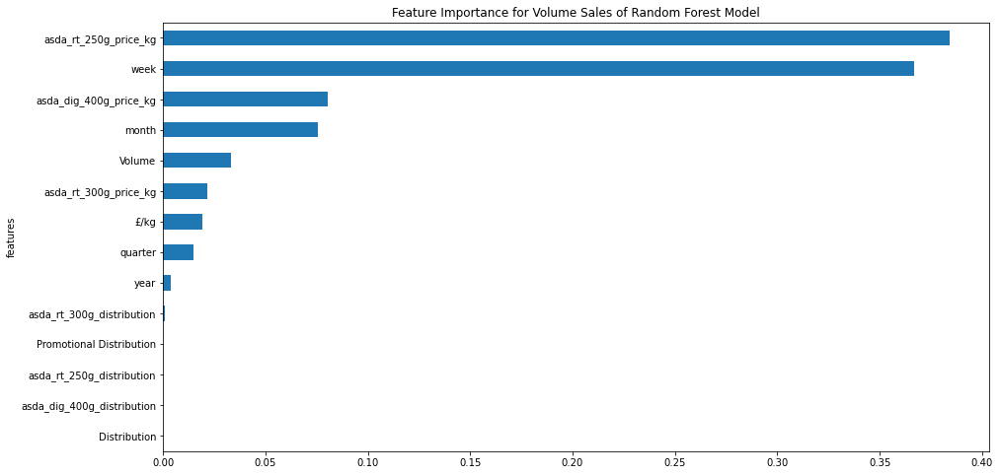

<Figure size 432x288 with 0 Axes>

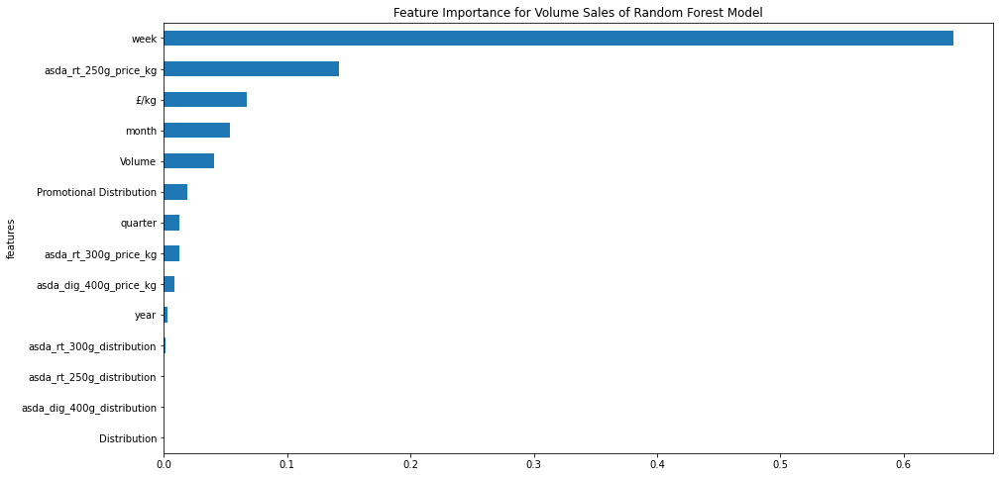

<Figure size 432x288 with 0 Axes>

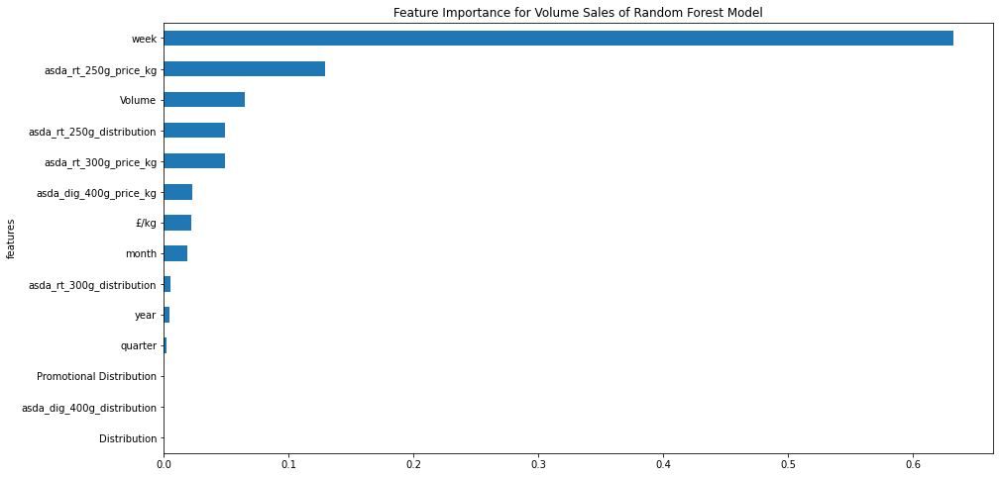

<Figure size 432x288 with 0 Axes>

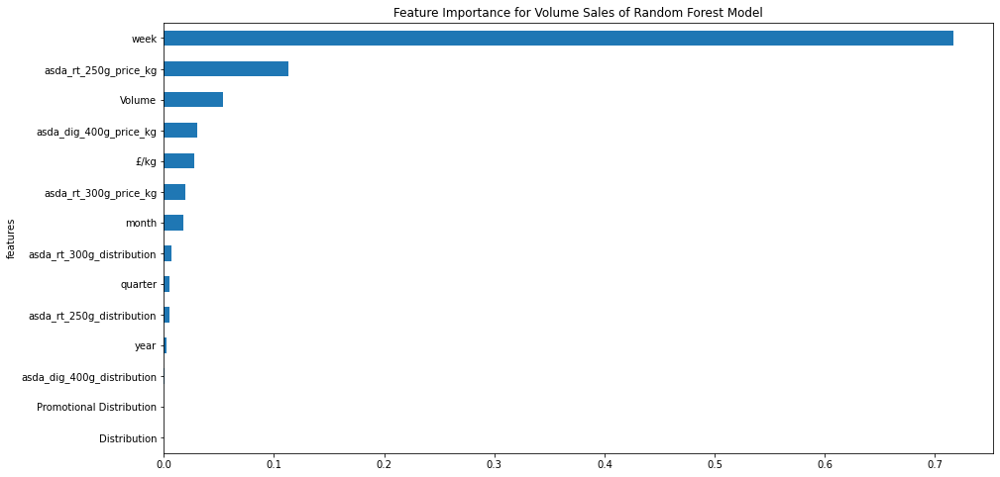

<Figure size 432x288 with 0 Axes>

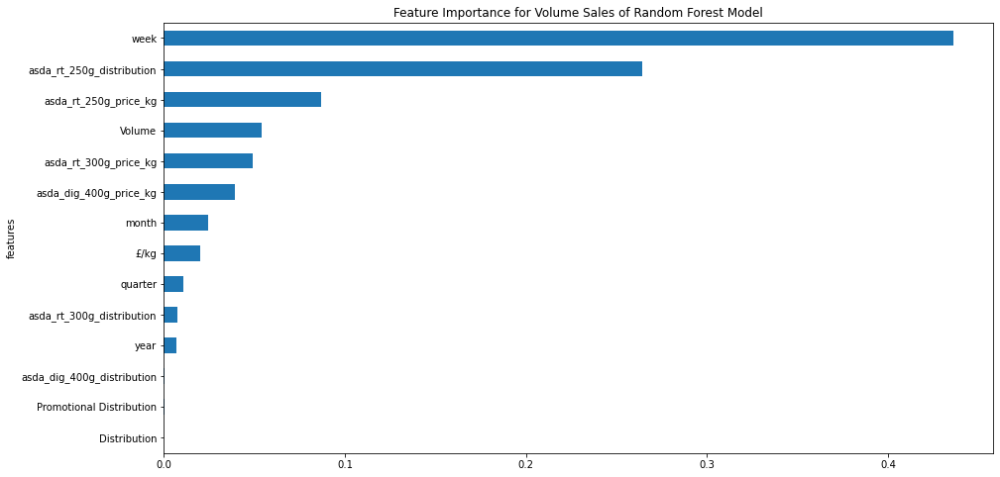

In [595]:
mcv_dig_400g_asda_input_X,mcv_dig_400g_asda_input_Y=input_var_mcv_asda(mcv_dig_400g_asda_with_comp)
rf_regressor_mcv_asda(mcv_dig_400g_asda_input_X,mcv_dig_400g_asda_input_Y)



### XGBoost Model

In [596]:
def xgb_regressor_mcv_asda(X, y):
    splits = TimeSeriesSplit(n_splits=5)
    
    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler


        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
                    max_depth = 5, alpha = 10, n_estimators = 10)
        xg_reg.fit(X_train, y_train)
        y_pred = xg_reg.predict(X_test)
        print(cross_val_score(xg_reg, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
                 'asda_dig_400g_price_kg', 'asda_dig_400g_distribution',
                   'asda_rt_250g_price_kg','asda_rt_250g_distribution',
                   'asda_rt_300g_price_kg','asda_rt_300g_distribution',], 'importance': xg_reg.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of XGBoost Model",legend=False, figsize=(20, 13))


Observations: 45
Training Observations: 25
Testing Observations: 20
[ -17.3282204    -0.54714105 -333.76778573 -198.75389088  -16.78530027]
Mean Absolute Error: 9200.581601562499
Mean Squared Error: 85313665.85941038
Root Mean Squared Error: 9236.539712436166
Observations: 65
Training Observations: 45
Testing Observations: 20
[  -6.31874398  -33.65789636 -258.39607459 -120.36290155 -131.84993687]
Mean Absolute Error: 9618.882685546876
Mean Squared Error: 102210639.94133161
Root Mean Squared Error: 10109.927791103733
Observations: 85
Training Observations: 65
Testing Observations: 20
[ -38.54926643 -309.24706725  -92.60511969  -91.28290361   -2.32589191]
Mean Absolute Error: 9435.95970703125
Mean Squared Error: 90822422.81866929
Root Mean Squared Error: 9530.079895712799
Observations: 105
Training Observations: 85
Testing Observations: 20
[ -43.42043288 -156.08162434 -103.18019196   -3.5828998   -50.27376004]
Mean Absolute Error: 5805.9711718749995
Mean Squared Error: 35624134.29024356


<Figure size 432x288 with 0 Axes>

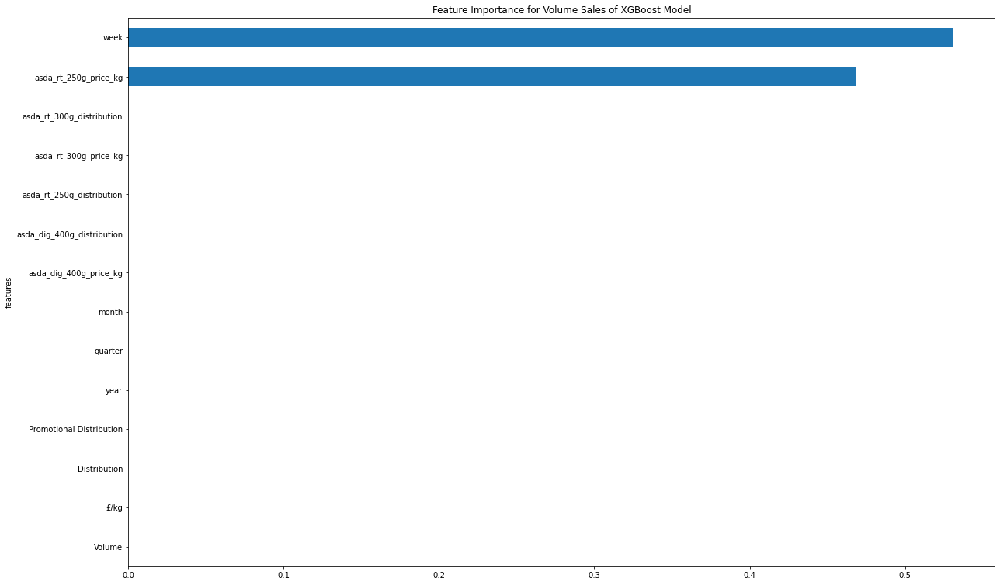

<Figure size 432x288 with 0 Axes>

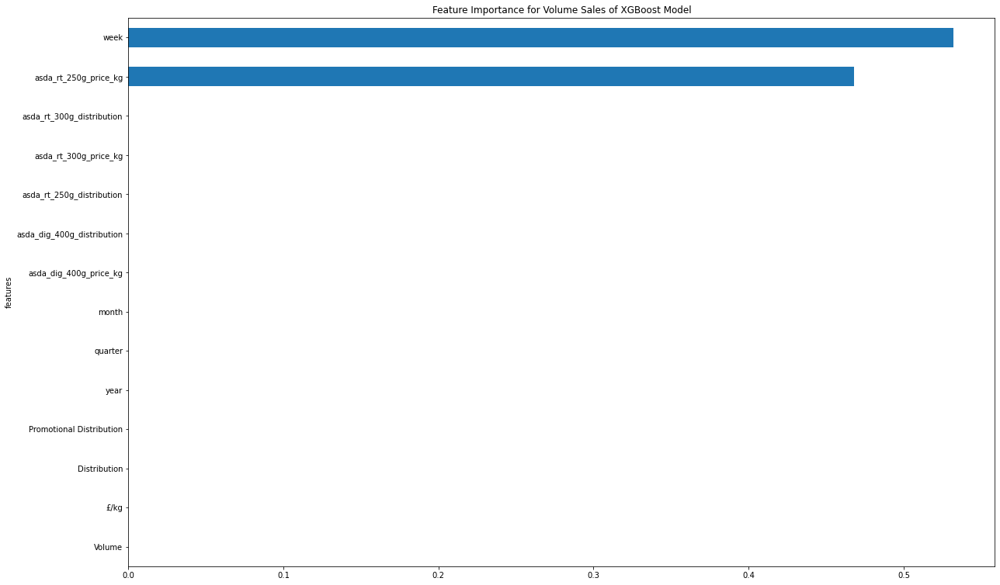

<Figure size 432x288 with 0 Axes>

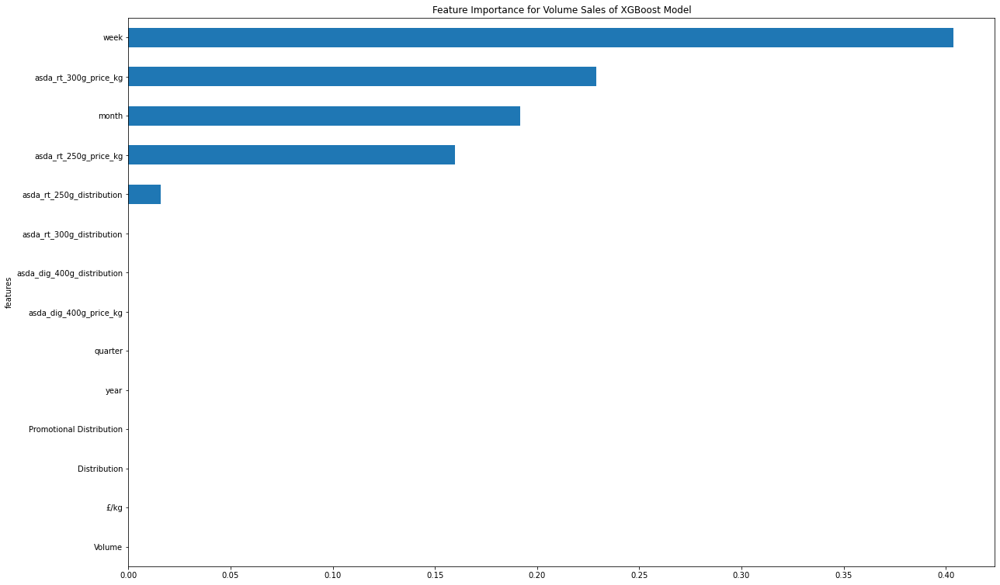

<Figure size 432x288 with 0 Axes>

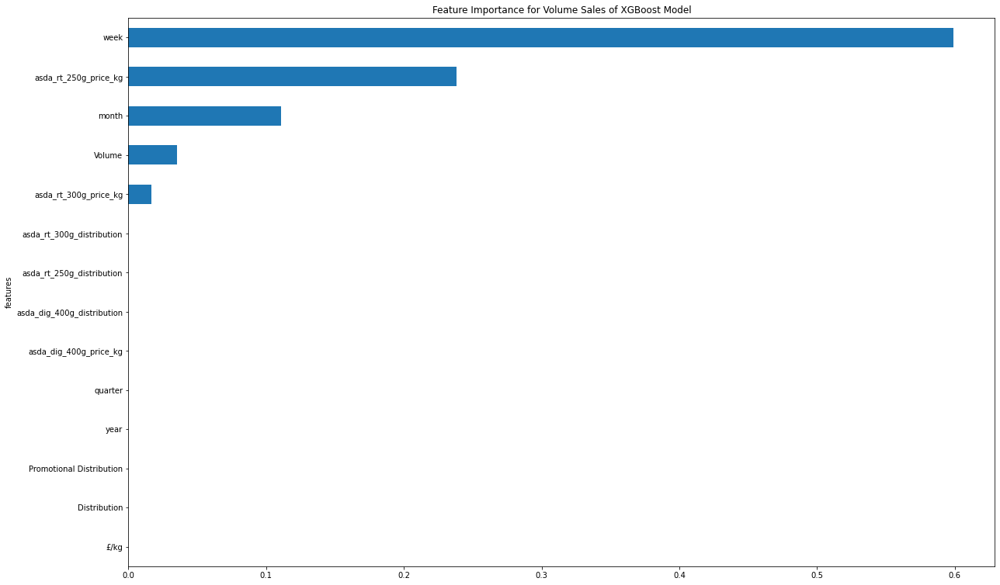

<Figure size 432x288 with 0 Axes>

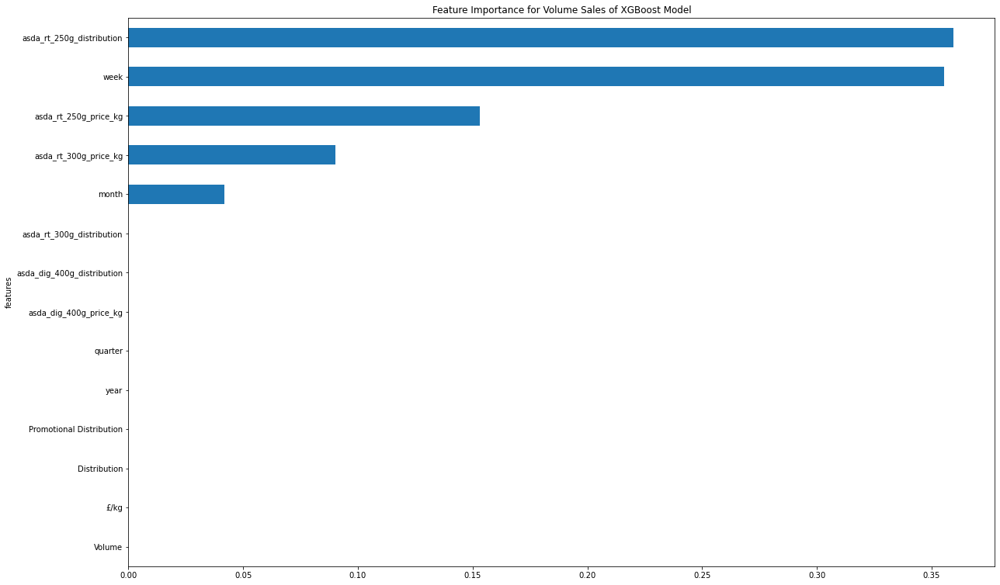

In [597]:
xgb_regressor_mcv_asda(mcv_dig_400g_asda_input_X,mcv_dig_400g_asda_input_Y)

,var1(t-4),var1(t)
Date,,
2015-01-10,33734.0,28677.5
2015-01-17,35125.5,32445.5
2015-01-24,30400.0,43570.0
2015-01-31,22537.0,47280.5
2015-02-07,28677.5,45467.5
2015-02-14,32445.5,38305.5
2015-02-21,43570.0,33531.5
2015-02-28,47280.5,35634.0
2015-03-07,45467.5,39367.5


   var1(t-4)   var1(t)
4   0.487625  0.384178
5   0.516092  0.461264
6   0.419417  0.688852
7   0.258555  0.764762
8   0.384178  0.727671
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 5s - loss: 0.4073 - val_loss: 0.2583
Epoch 2/50
216/216 - 0s - loss: 0.3959 - val_loss: 0.2476
Epoch 3/50
216/216 - 0s - loss: 0.3844 - val_loss: 0.2366
Epoch 4/50
216/216 - 0s - loss: 0.3726 - val_loss: 0.2252
Epoch 5/50
216/216 - 0s - loss: 0.3604 - val_loss: 0.2133
Epoch 6/50
216/216 - 0s - loss: 0.3474 - val_loss: 0.2006
Epoch 7/50
216/216 - 0s - loss: 0.3337 - val_loss: 0.1871
Epoch 8/50
216/216 - 0s - loss: 0.3191 - val_loss: 0.1727
Epoch 9/50
216/216 - 0s - loss: 0.3036 - val_loss: 0.1572
Epoch 10/50
216/216 - 0s - loss: 0.2870 - val_loss: 0.1404
Epoch 11/50
216/216 - 0s - loss: 0.2693 - val_loss: 0.1228
Epoch 12/50
216/216 - 0s - loss: 0.2502 - val_loss: 0.1038
Epoch 13/50
216/216 - 0s - loss: 0.2295 - val_loss: 0.0835
Epoch 14/50
216/216 - 0

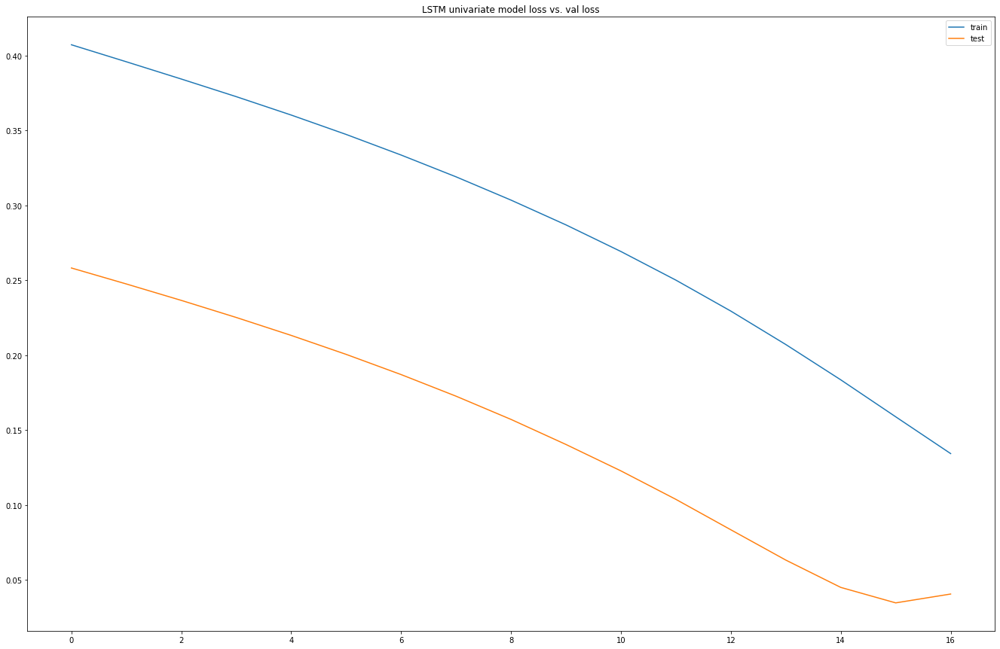

Test RMSE: 2482.014


In [109]:
#lstm models
series_to_supervised(mcv_dig_400g_asda_volume)
lstm_univariate(mcv_dig_400g_asda_volume)

# series_to_supervised(mcv_dig_400g_with_comp)
# multivariate_with_competitor(mcv_dig_400g_with_comp)

#### Multivariate LSTM - Without Competitors' Variables

In [599]:
series_to_supervised(mcv_dig_400g_asda_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,33734.0,2.022381,100.0,22.0,2014.0,4.0,12.0,50.0,28677.5,1.953423,100,50,2015,1,1,2
2015-01-17,35125.5,2.022719,100.0,25.0,2014.0,4.0,12.0,51.0,32445.5,1.951550,100,67,2015,1,1,3
2015-01-24,30400.0,2.028559,100.0,25.0,2014.0,4.0,12.0,52.0,43570.0,1.956183,100,62,2015,1,1,4
2015-01-31,22537.0,2.014461,100.0,36.0,2015.0,1.0,1.0,1.0,47280.5,1.955652,100,91,2015,1,1,5
2015-02-07,28677.5,1.953423,100.0,50.0,2015.0,1.0,1.0,2.0,45467.5,1.958735,100,94,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,20220.8,2.499238,100.0,0.0,2020.0,1.0,1.0,3.0,19436.0,2.809698,100,5,2020,1,2,7
2020-02-22,21758.8,2.498231,100.0,0.0,2020.0,1.0,1.0,4.0,19336.0,2.968225,100,3,2020,1,2,8
2020-02-29,22873.2,2.497394,100.0,0.0,2020.0,1.0,2.0,5.0,20445.2,2.969636,100,1,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.487625   0.286847        1.0       0.22   0.000000        1.0   
5   0.516092   0.287101        1.0       0.25   0.000000        1.0   
6   0.419417   0.291499        1.0       0.25   0.000000        1.0   
7   0.258555   0.280884        1.0       0.36   0.166656        0.0   
8   0.384178   0.234932        1.0       0.50   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.384178  
5        1.0   0.961538  0.461264  
6        1.0   0.980769  0.688852  
7        0.0   0.000000  0.764762  
8        0.0   0.019231  0.727671  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 38s - loss: 0.4117 - val_loss: 0.2527
Epoch 2/50
216/216 - 0s - loss: 0.3854 - val_loss: 0.2255
Epoch 3/50
216/216 - 0s - loss: 0.3589 - val_loss: 0.1971
Epoch 4/50
216/216 - 0s - loss: 0.3314 - val_loss: 0.1666
Epoch 5/50
216/216 - 0s - loss: 0.3021 - va

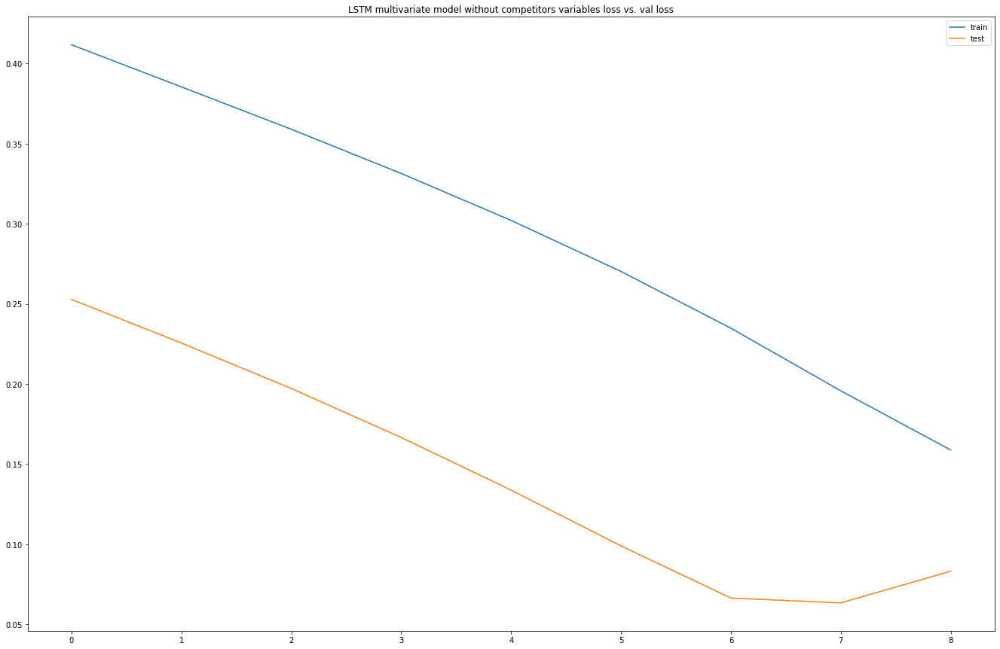

Test RMSE: 5014.096


In [600]:
multivariate_lstm_without_competitor(mcv_dig_400g_asda_own_variable)

### LSTM Multivariate with Competitors'

In [601]:
series_to_supervised(mcv_dig_400g_asda_with_comp)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var6(t),var7(t),var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-11-25,24755.6,2017.0,4.0,10.0,43.0,25932.0,2.498431,100.0,0.0,1.124957,...,24755.6,2.499447,100.0,0.0,1.008029,100.0,2.248666,100.0,1.000000,100.0
2017-12-02,26545.6,2017.0,4.0,11.0,44.0,25776.8,2.498840,100.0,0.0,1.125051,...,26545.6,2.497653,100.0,1.0,0.876991,100.0,2.247627,100.0,1.000028,100.0
2017-12-09,25176.0,2017.0,4.0,11.0,45.0,24672.8,2.499514,100.0,0.0,1.125064,...,25176.0,2.494590,100.0,0.0,0.874811,100.0,2.243993,100.0,1.000084,100.0
2017-12-16,26234.4,2017.0,4.0,11.0,46.0,25041.2,2.499453,100.0,0.0,1.124475,...,26234.4,2.489476,100.0,0.0,0.874597,100.0,2.230360,100.0,1.000035,100.0
2017-12-23,26005.6,2017.0,4.0,11.0,47.0,24755.6,2.499447,100.0,0.0,1.008029,...,26005.6,2.498089,100.0,0.0,0.874568,100.0,2.224007,100.0,0.999994,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,20220.8,2020.0,1.0,1.0,3.0,24749.6,2.498513,100.0,0.0,0.824959,...,20220.8,2.499238,100.0,0.0,0.825001,100.0,2.249541,98.0,1.000011,99.0
2020-02-22,21758.8,2020.0,1.0,1.0,4.0,18558.8,2.497888,100.0,0.0,0.825002,...,21758.8,2.498231,100.0,0.0,0.825001,100.0,2.249202,98.0,1.000083,99.0
2020-02-29,22873.2,2020.0,1.0,2.0,5.0,16186.0,2.497677,99.0,0.0,0.824996,...,22873.2,2.497394,100.0,0.0,0.825017,100.0,2.249350,98.0,1.000065,99.0


In [604]:
def multivariate_with_competitor_mcv_asda(df):
    values = df.values
    # integer encode direction
    #encoder = LabelEncoder()
    #values[:,4] = encoder.fit_transform(values[:,4])
    # ensure all data is float
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict
    reframed.drop(reframed.columns[[16,17,18,19,20,21,22,23,24,25,26,27,28,29]], axis=1, inplace=True)
    print(reframed.head())

    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]
    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    model = Sequential()
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(LSTM(100, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM multivariate model with competitors variables loss vs. val loss',loc='center')
    plt.legend()
    plt.show()

    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.586565        0.0        1.0   0.818182   0.823529   0.649125   
5   0.681755        0.0        1.0   0.909091   0.843137   0.640871   
6   0.608921        0.0        1.0   0.909091   0.862745   0.582162   
7   0.665206        0.0        1.0   0.909091   0.882353   0.601753   
8   0.653039        0.0        1.0   0.909091   0.901961   0.586565   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.095735        1.0        0.0    0.999645         1.0    0.949654   
5   0.096925        1.0        0.0    0.999957         1.0    0.969273   
6   0.098882        1.0        0.0    1.000000         1.0    0.951181   
7   0.098705        1.0        0.0    0.998047         1.0    0.946747   
8   0.098687        1.0        0.0    0.611814         1.0    0.977436   

   var13(t-4)  var14(t-4)  var15(t-4)   var1(t)  
4         1.0    0.811188    0.000000  0.653039  
5         1.0    0.809052   

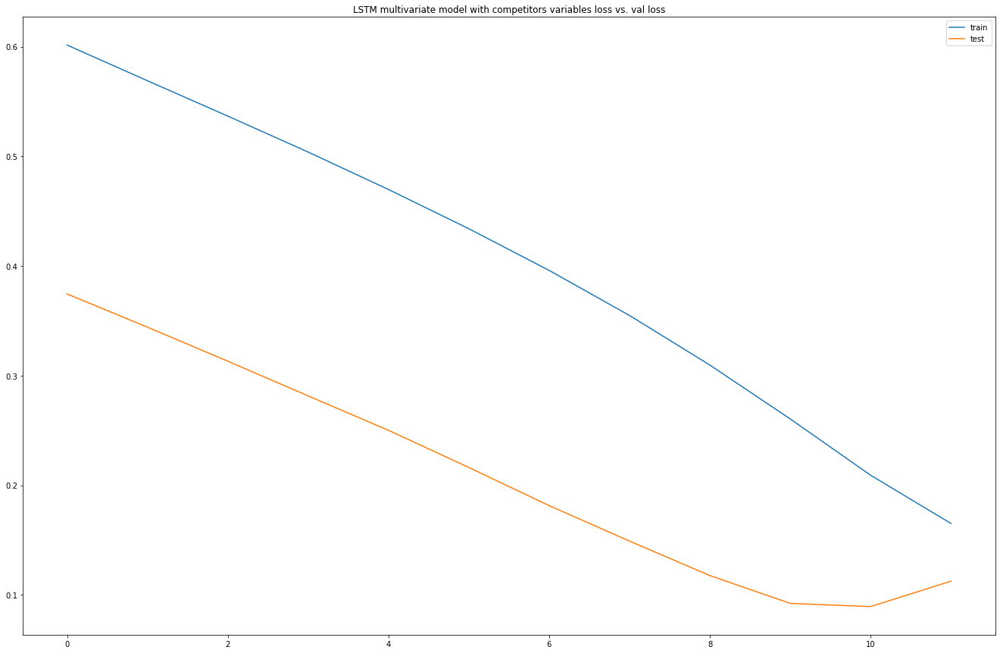

Test RMSE: 3018.913


In [605]:
multivariate_with_competitor_mcv_asda(mcv_dig_400g_asda_with_comp)

## Asda - McVitie's Digestives 400g Twin Pack

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,18486,18486.0,34919.4,94,0,1.888965,1.888965,2014,4,12,50
1,2014-12-20,18812,18812.0,35549.4,94,0,1.889719,1.889719,2014,4,12,51
2,2014-12-27,14962,14962.0,28258.0,94,0,1.888651,1.888651,2014,4,12,52
3,2015-01-03,10828,10828.0,20459.9,94,0,1.889536,1.889536,2015,1,1,1
4,2015-01-10,12561,12561.0,23702.0,94,0,1.886952,1.886952,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,19219.181818,17193.698909,35308.689455,93.349091,6.505455,1.859072,2.128010,2017.083636,2.469091,6.414545,26.043636
std,4691.390687,5426.078364,6229.600646,1.614812,23.062969,0.124648,0.314592,1.534371,1.140635,3.547767,15.490223
min,9656.000000,7861.600000,14479.500000,89.000000,0.000000,1.498614,1.498614,2014.000000,1.000000,1.000000,1.000000
25%,16923.500000,14116.400000,32333.400000,92.000000,0.000000,1.887445,1.888768,2016.000000,1.000000,3.000000,12.000000
50%,18420.000000,15267.200000,34829.000000,94.000000,0.000000,1.889094,2.358318,2017.000000,2.000000,6.000000,26.000000
75%,19870.500000,18691.000000,37403.350000,94.500000,0.000000,1.889698,2.362075,2018.000000,3.500000,9.500000,39.500000
95%,28977.700000,28977.700000,46066.690000,96.000000,92.600000,1.989119,2.486398,2019.000000,4.000000,12.000000,50.000000
99%,33937.860000,33937.860000,50891.426000,96.000000,96.000000,1.989700,2.487125,2020.000000,4.000000,12.000000,52.000000
max,48141.000000,48141.000000,72387.400000,96.000000,96.000000,1.989902,2.487377,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

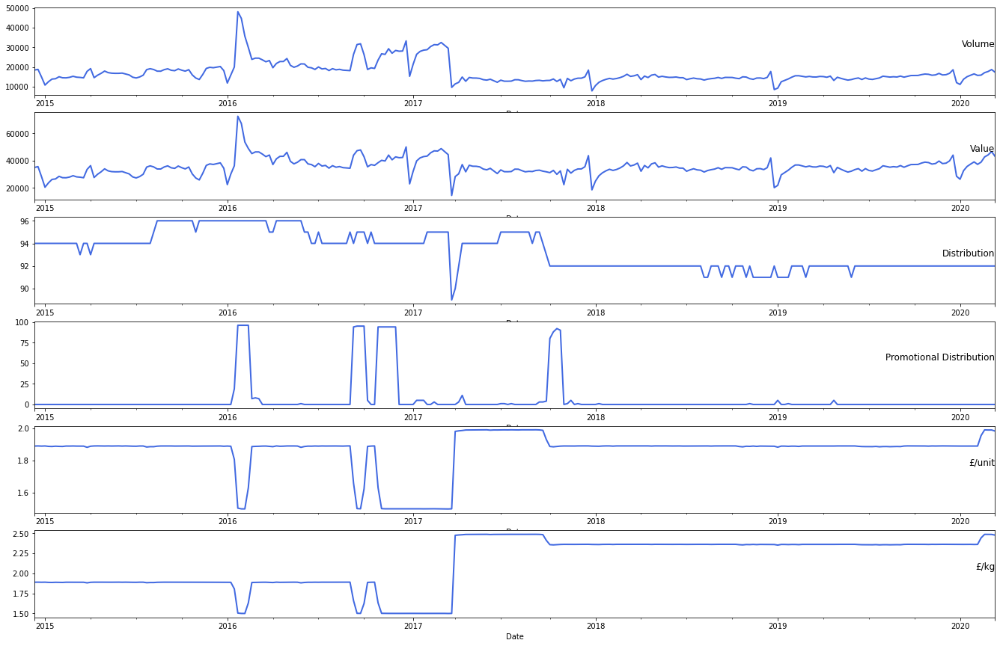

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5321d467b8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5321c753c8>)

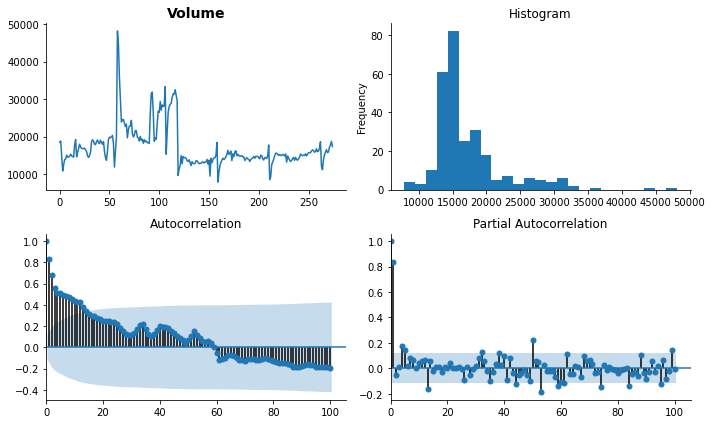

In [606]:
basic_info(mcv_dig_400g_twin_asda_origin)
plot_data(mcv_dig_400g_twin_asda_origin)
tsplot(mcv_dig_400g_twin_asda_origin['Volume'].dropna(), title=mcv_dig_400g_twin_asda_origin.columns[2], lags=100)


Test Statistic                  -3.207382
p-value                          0.019561
#Lags Used                       4.000000
Number of Observations Used    270.000000
Critical Value (1%)             -3.454804
Critical Value (5%)             -2.872305
Critical Value (10%)            -2.572506
dtype: float64


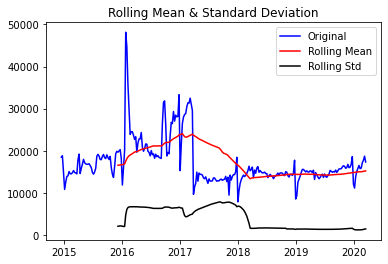

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f5321a981d0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5321a39f98>)

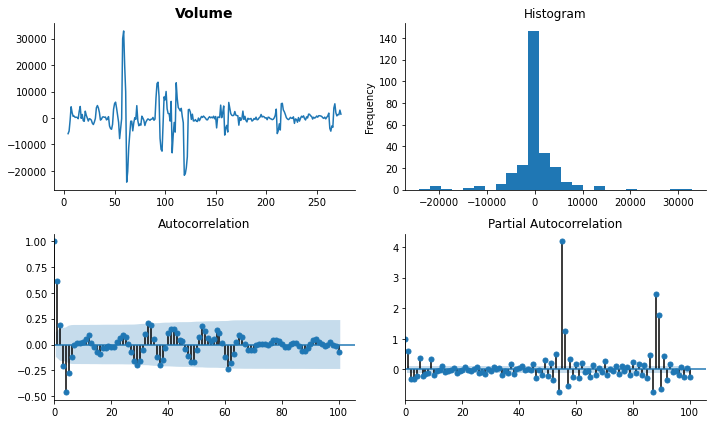

In [607]:
plot(mcv_dig_400g_twin_asda_origin)
#plot stationary graph
series_transformed=mcv_dig_400g_twin_asda_origin.copy()
series_transformed['Volume_transformed']=mcv_dig_400g_twin_asda_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_dig_400g_twin_asda_origin.columns[2], lags=100)


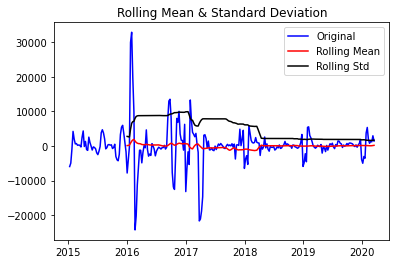

Results of Dickey-Fuller Test:
Test Statistic                -5.798528e+00
p-value                        4.689900e-07
#Lags Used                     9.000000e+00
Number of Observations Used    2.610000e+02
Critical Value (1%)           -3.455656e+00
Critical Value (5%)           -2.872678e+00
Critical Value (10%)          -2.572705e+00
dtype: float64


In [608]:
plot_transform(mcv_dig_400g_twin_asda_origin)

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.



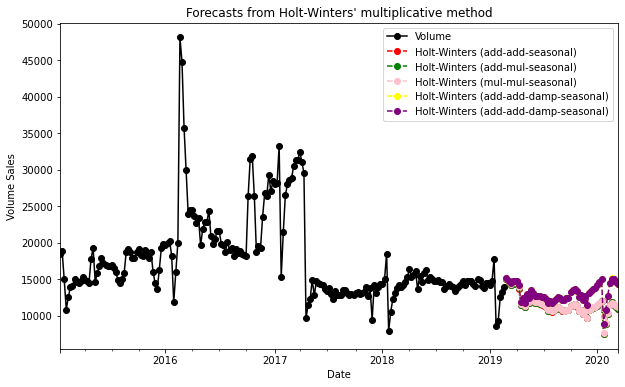

RMSE for Holt-winter are:
3902.43596269139
3879.0553660925643
3824.2069096925206
2251.439691763494
2248.659274311853


In [609]:
def holt_winter_model_five(data):
    sales=data[['Date','Volume']]
    sales=sales.set_index('Date')

    sales_origin=sales.copy()
    sales_origin=sales_origin.shift(4)
    sales_origin=sales_origin.dropna()
    train_size = int(len(sales_origin) * 0.8)
    sales_train_origin=sales_origin[:train_size]
    sales_test_origin=sales_origin[train_size:]

    fit1 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='add').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit2 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='mul').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit3 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='mul', seasonal='mul').fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit4 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='add', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
    fit5 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='add', seasonal='mul', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)
#     fit6 = ExponentialSmoothing(sales_train_origin, seasonal_periods=52, trend='mul', seasonal='mul', damped=True).fit(use_boxcox=True,smoothing_level=0.1, smoothing_slope=0.05,smoothing_seasonal=0.1)


    ax = sales_train_origin.plot(figsize=(10,6), marker='o', color='black', title="Forecasts from Holt-Winters' multiplicative method" )
    ax.set_ylabel("Volume Sales")
    ax.set_xlabel("Date")
    
    fit1.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-seasonal)').plot(ax=ax, style='--', marker='o', color='red', legend=True)
    fit2.forecast(len(sales_test_origin)).rename('Holt-Winters (add-mul-seasonal)').plot(ax=ax, style='--', marker='o', color='green', legend=True)
    fit3.forecast(len(sales_test_origin)).rename('Holt-Winters (mul-mul-seasonal)').plot(ax=ax, style='--', marker='o', color='pink', legend=True)
    fit4.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='yellow', legend=True)
    fit5.forecast(len(sales_test_origin)).rename('Holt-Winters (add-add-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='purple', legend=True)
#     fit6.forecast(len(sales_test_origin)).rename('Holt-Winters (mul-mul-damp-seasonal)').plot(ax=ax, style='--', marker='o', color='blue', legend=True)

    plt.show()

    rmse_winter1=sqrt(mean_squared_error(sales_test_origin, fit1.forecast(len(sales_test_origin))))
    rmse_winter2=sqrt(mean_squared_error(sales_test_origin, fit2.forecast(len(sales_test_origin))))
    rmse_winter3=sqrt(mean_squared_error(sales_test_origin, fit3.forecast(len(sales_test_origin))))
    rmse_winter4=sqrt(mean_squared_error(sales_test_origin, fit4.forecast(len(sales_test_origin))))
    rmse_winter5=sqrt(mean_squared_error(sales_test_origin, fit5.forecast(len(sales_test_origin))))
#     rmse_winter6=sqrt(mean_squared_error(sales_test_origin, fit6.forecast(len(sales_test_origin))))
    print("RMSE for Holt-winter are:")
    print(rmse_winter1)
    print(rmse_winter2)
    print(rmse_winter3)
    print(rmse_winter4)
    print(rmse_winter5)
#     print(rmse_winter6)
    
holt_winter_model_five(mcv_dig_400g_twin_asda_origin)
                 

       t-4      t+1
0      NaN  18486.0
1      NaN  18812.0
2      NaN  14962.0
3      NaN  10828.0
4  18486.0  12561.0
Test MSE: 2683700.515
Test RMSE: 1638.200


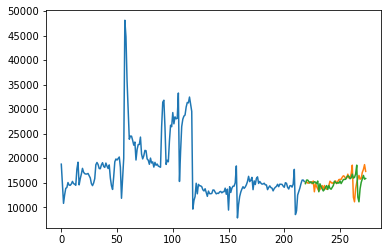

Observations: 271
Training Observations: 216
Testing Observations: 55


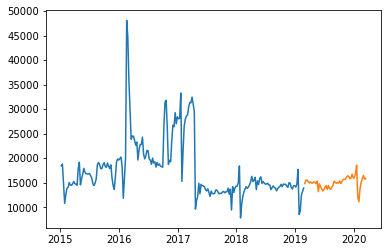

RMSE for Simple Exponential Smoothing α= 0.1 is: 1911.91
RMSE for Simple Exponential Smoothing α= 0.2 is: 2275.36
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2391.18
RMSE for Simple Exponential Smoothing α= 0.4 is: 2337.17
RMSE for Simple Exponential Smoothing α= 0.5 is: 2193.65
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2024.49
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 1871.2
RMSE for Simple Exponential Smoothing α= 0.8 is: 1752.71
RMSE for Simple Exponential Smoothing α= 0.9 is: 1669.79


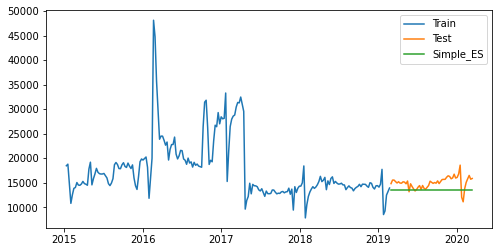

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.9 and β= 0.1 is: 1190.84


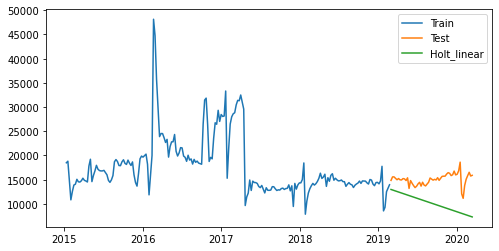

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


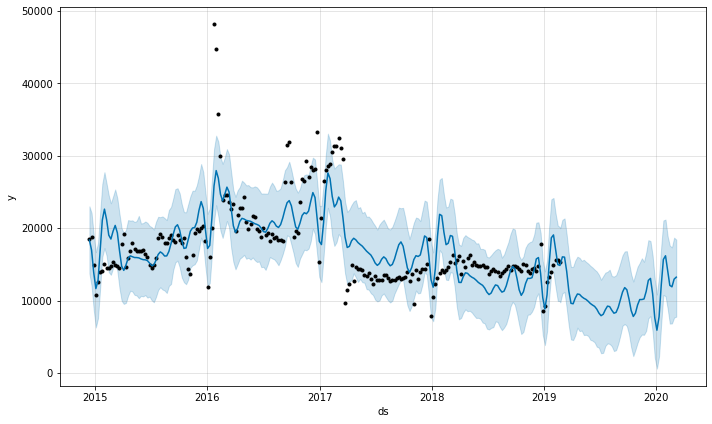

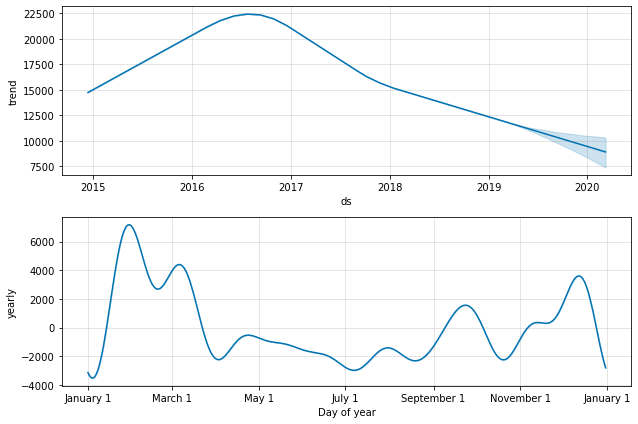

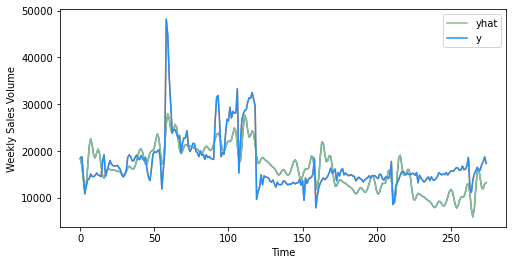

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 4199.431857410285
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

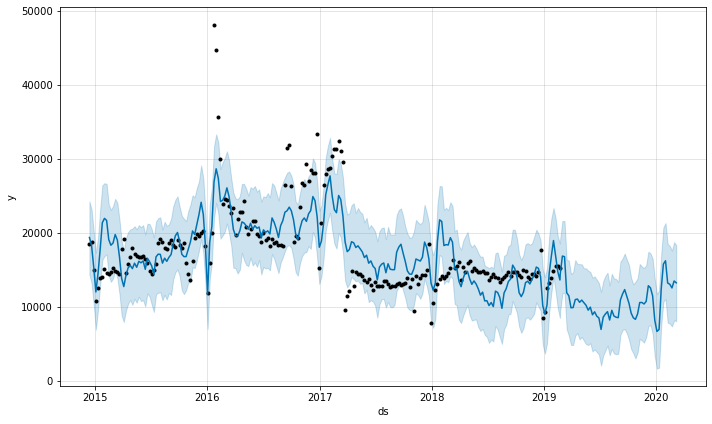

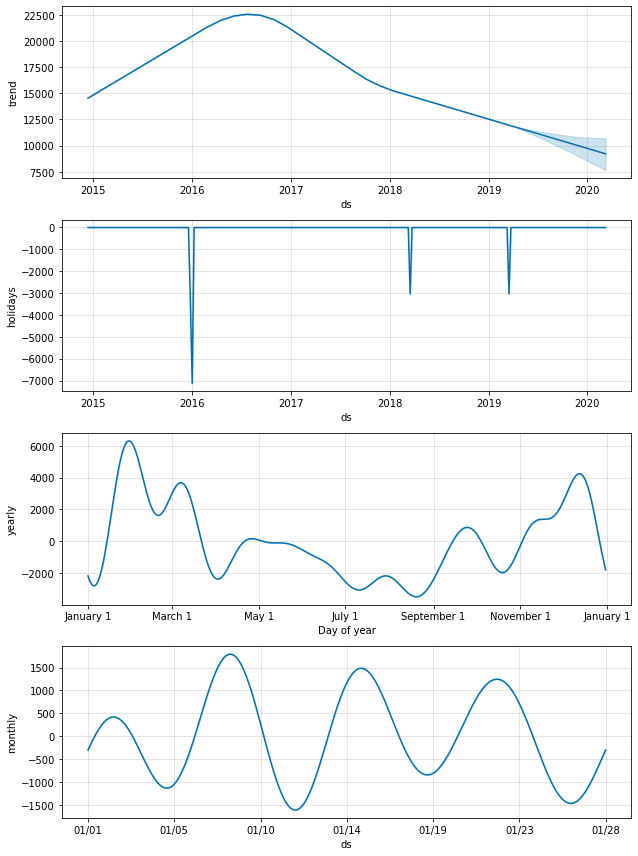

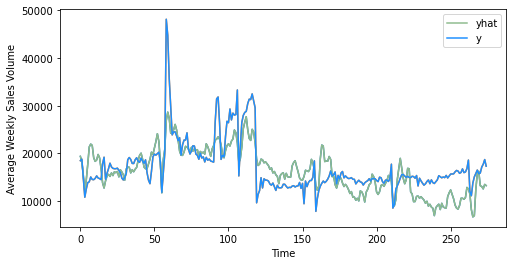

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 4103.227911545116


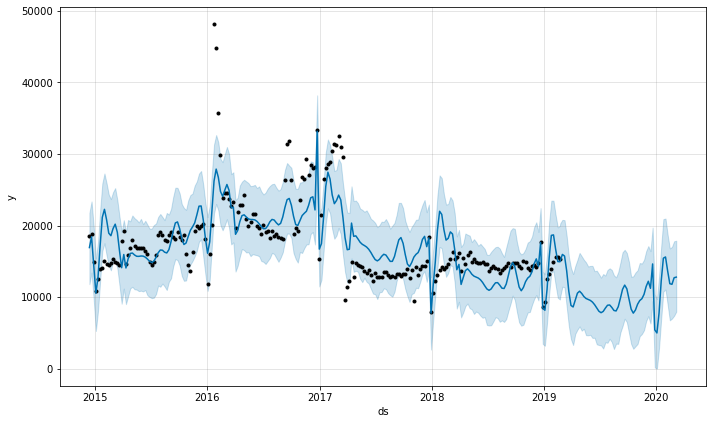

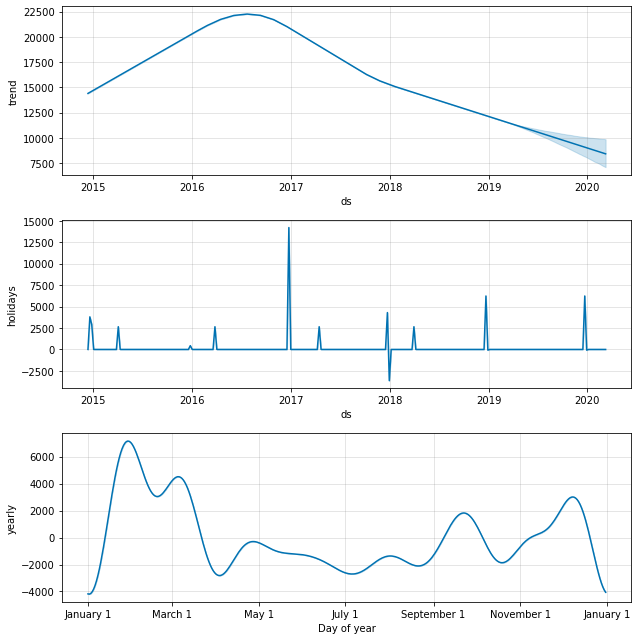

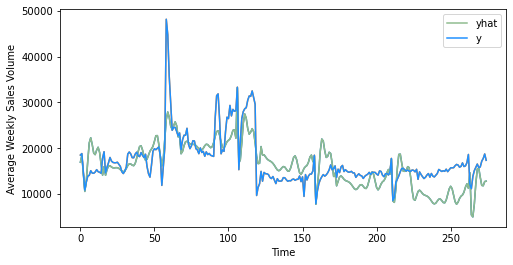

RMSE for prophet with only Christmas and Easter week is: 4182.234669697838


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [610]:
#time series models
baseline_model(mcv_dig_400g_twin_asda_origin)
ses_model(mcv_dig_400g_twin_asda_origin)
holt_linear_model(mcv_dig_400g_twin_asda_origin)
# holt_winter_model(mcv_dig_400g_twin_asda_origin)
prophet_model(mcv_dig_400g_twin_asda_origin)
prophet_all_holidays(mcv_dig_400g_twin_asda_origin)
prophet_two_holiday(mcv_dig_400g_twin_asda_origin)


Observations: 45
Training Observations: 25
Testing Observations: 20
[ -2.71452595  -3.77229667 -61.13755004  -4.45850784  -0.186504  ]
Mean Absolute Error: 935.7759999999987
Mean Squared Error: 1172998.724479997
Root Mean Squared Error: 1083.0506564699535
Observations: 65
Training Observations: 45
Testing Observations: 20
[-0.02464319 -1.52101081 -0.25365681 -3.92465504 -6.32296348]
Mean Absolute Error: 1078.6280000000002
Mean Squared Error: 3246348.698720003
Root Mean Squared Error: 1801.7626643706442
Observations: 85
Training Observations: 65
Testing Observations: 20
[ -1.93037563  -0.42422028 -10.06840104  -5.93618839   0.05995769]
Mean Absolute Error: 977.5080000000005
Mean Squared Error: 1206357.3804800021
Root Mean Squared Error: 1098.3430158561587
Observations: 105
Training Observations: 85
Testing Observations: 20
[-1.81146255 -4.45415262 -3.02834507  0.18627777 -0.35006094]
Mean Absolute Error: 1248.3180000000016
Mean Squared Error: 2042611.6732000045
Root Mean Squared Error: 

<Figure size 432x288 with 0 Axes>

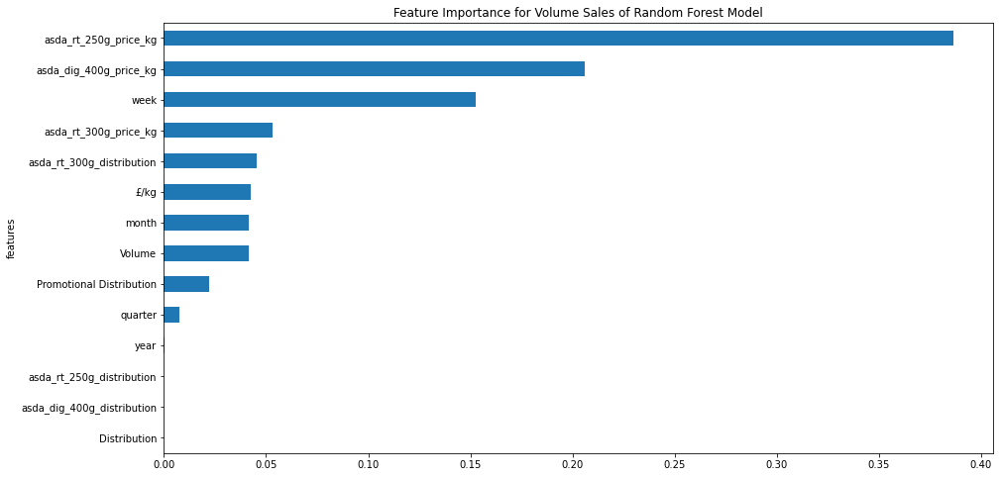

<Figure size 432x288 with 0 Axes>

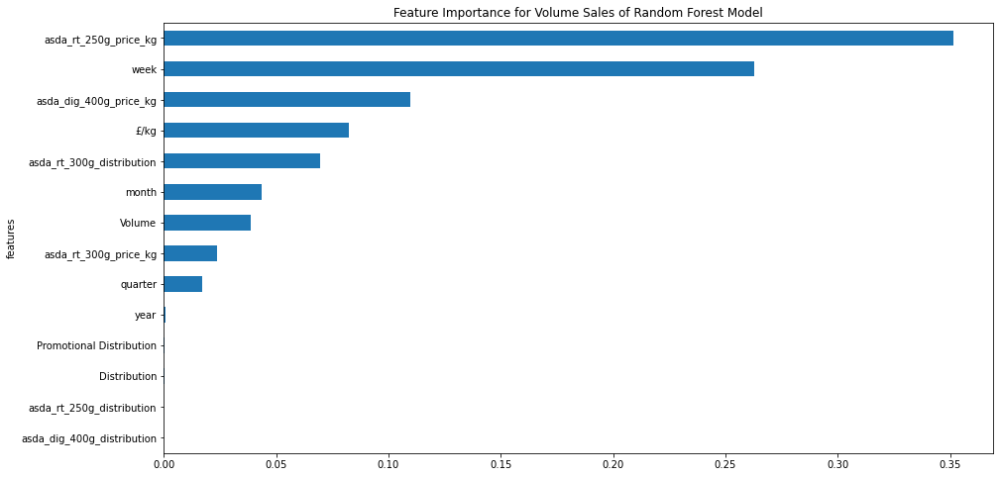

<Figure size 432x288 with 0 Axes>

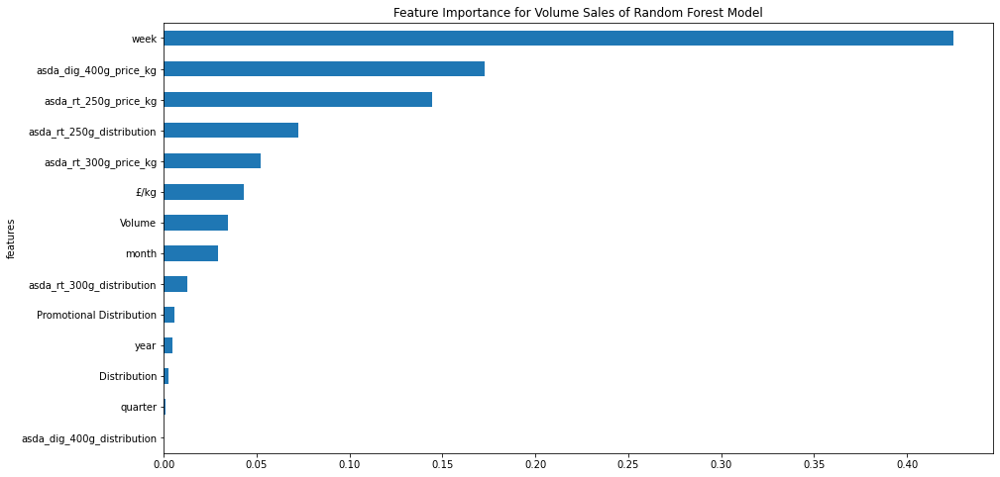

<Figure size 432x288 with 0 Axes>

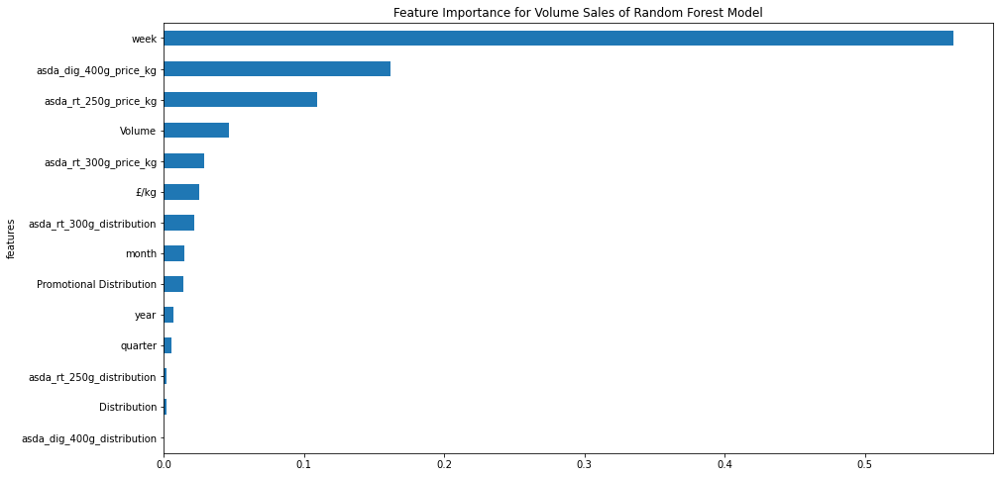

<Figure size 432x288 with 0 Axes>

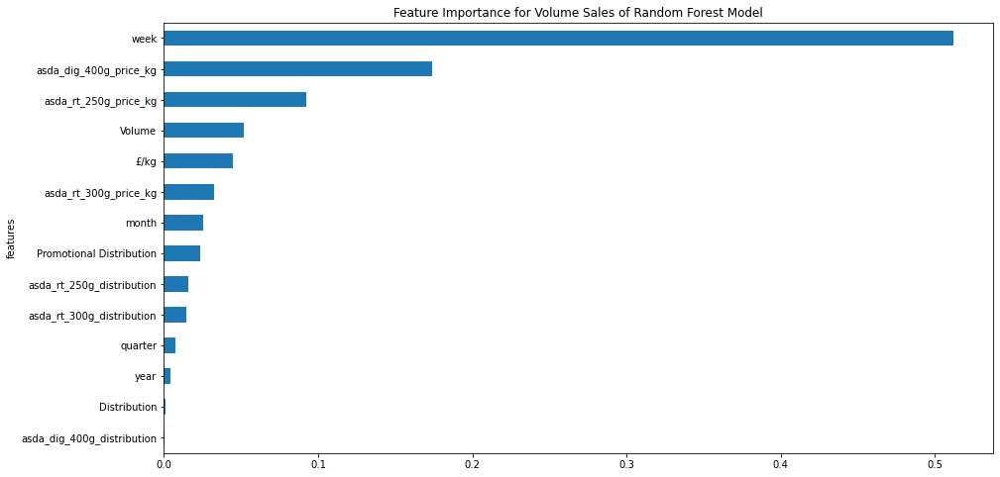

<Figure size 432x288 with 0 Axes>

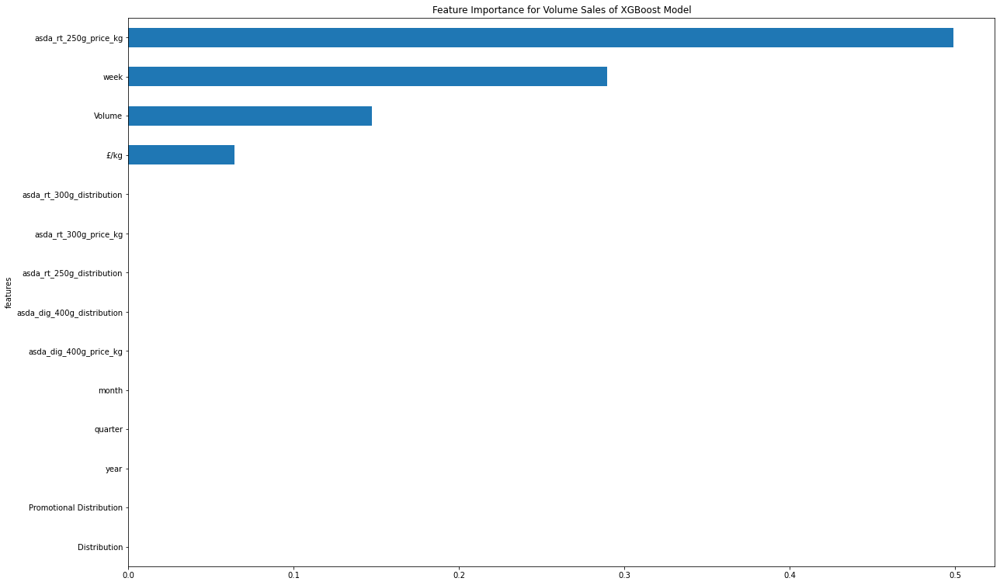

<Figure size 432x288 with 0 Axes>

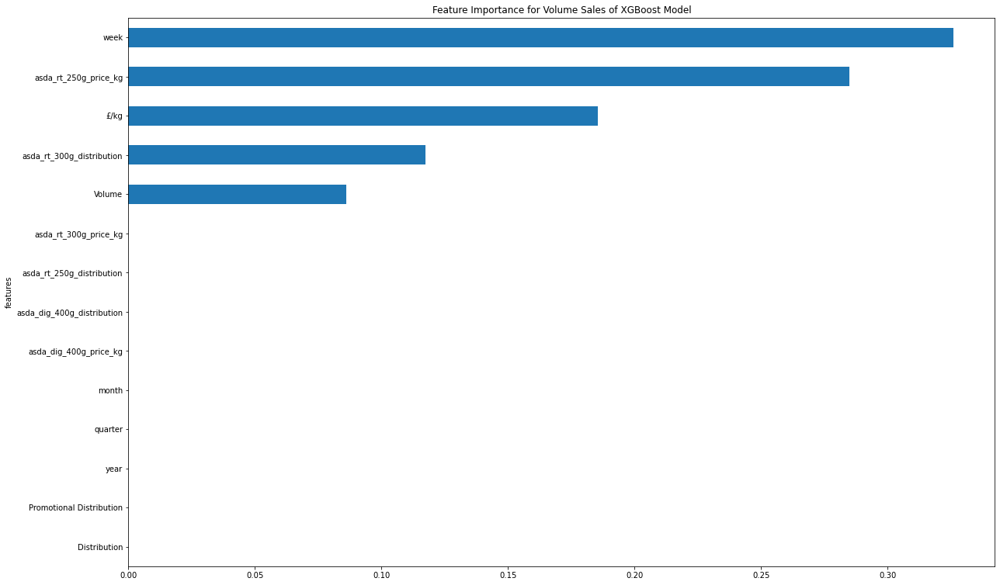

<Figure size 432x288 with 0 Axes>

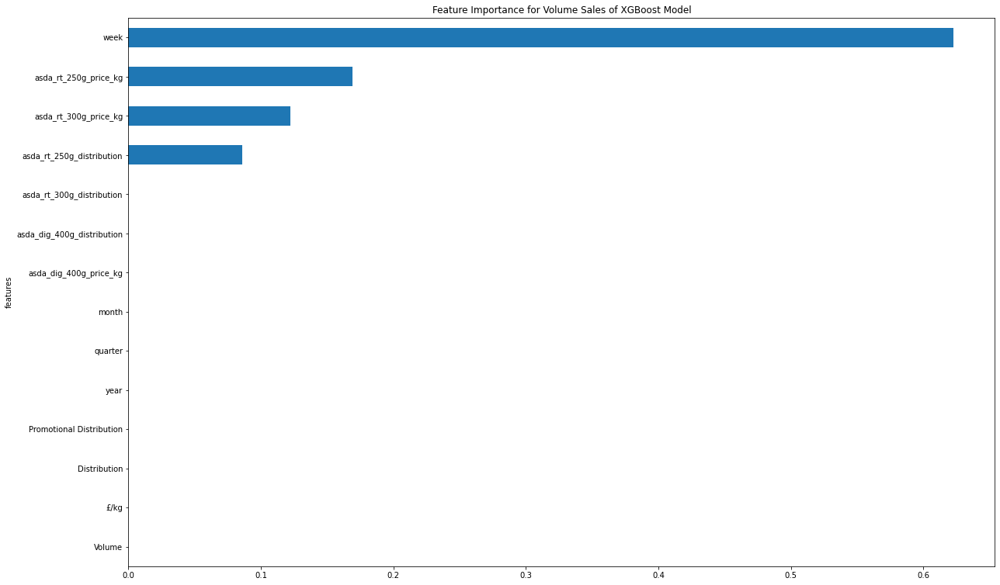

<Figure size 432x288 with 0 Axes>

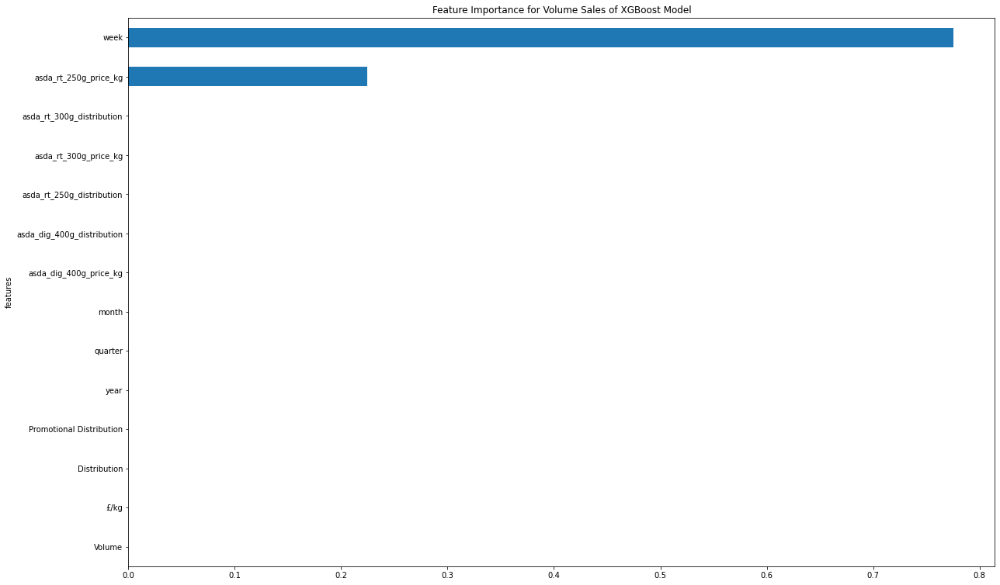

<Figure size 432x288 with 0 Axes>

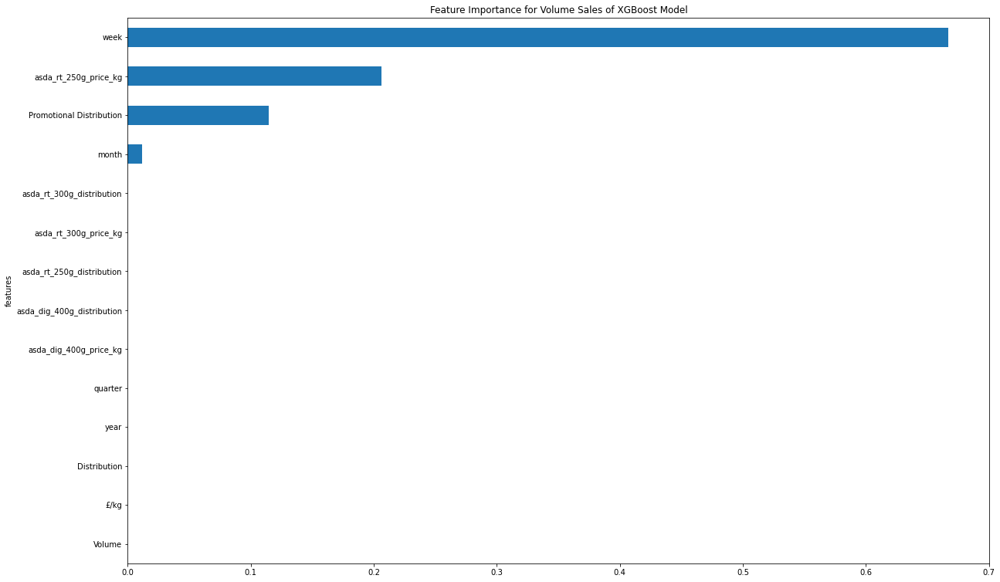

In [611]:
#machine learning models
mcv_dig_400g_twin_asda_with_comp=variable_lag_mcv_asda(mcv_dig_400g_twin_asda_with_comp)
mcv_dig_400g_twin_asda_input_X,mcv_dig_400g_twin_asda_input_Y=input_var_mcv_asda(mcv_dig_400g_twin_asda_with_comp)
rf_regressor_mcv_asda(mcv_dig_400g_twin_asda_input_X,mcv_dig_400g_twin_asda_input_Y)

mcv_dig_400g_twin_asda_input_X,mcv_dig_400g_twin_asda_input_Y=input_var_mcv_asda(mcv_dig_400g_twin_asda_with_comp)
xgb_regressor_mcv_asda(mcv_dig_400g_twin_asda_input_X,mcv_dig_400g_twin_asda_input_Y)


,var1(t-4),var1(t)
Date,,
2015-01-10,39173.5,28874.5
2015-01-17,41784.0,32329.0
2015-01-24,34446.5,30754.0
2015-01-31,25516.0,29475.5
2015-02-07,28874.5,30237.0
...,...,...
2020-02-15,28730.4,27026.8
2020-02-22,31036.0,25507.2
2020-02-29,32767.6,26099.6


   var1(t-4)   var1(t)
4   0.700692  0.483618
5   0.755715  0.556429
6   0.601060  0.523232
7   0.412830  0.496285
8   0.483618  0.512336
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 40s - loss: 0.6189 - val_loss: 0.5521
Epoch 2/50
216/216 - 0s - loss: 0.6066 - val_loss: 0.5399
Epoch 3/50
216/216 - 0s - loss: 0.5941 - val_loss: 0.5276
Epoch 4/50
216/216 - 0s - loss: 0.5815 - val_loss: 0.5149
Epoch 5/50
216/216 - 0s - loss: 0.5684 - val_loss: 0.5017
Epoch 6/50
216/216 - 0s - loss: 0.5548 - val_loss: 0.4879
Epoch 7/50
216/216 - 0s - loss: 0.5404 - val_loss: 0.4732
Epoch 8/50
216/216 - 0s - loss: 0.5251 - val_loss: 0.4575
Epoch 9/50
216/216 - 0s - loss: 0.5087 - val_loss: 0.4407
Epoch 10/50
216/216 - 0s - loss: 0.4911 - val_loss: 0.4225
Epoch 11/50
216/216 - 0s - loss: 0.4722 - val_loss: 0.4027
Epoch 12/50
216/216 - 0s - loss: 0.4517 - val_loss: 0.3812
Epoch 13/50
216/216 - 0s - loss: 0.4292 - val_loss: 0.3577
Epoch 14/50
216/216 - 

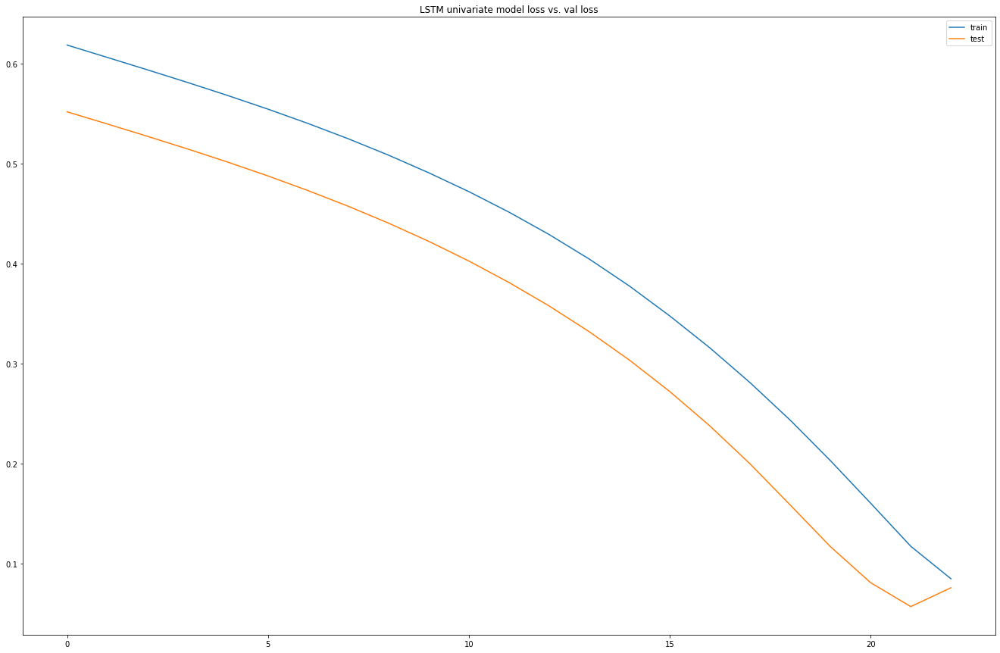

Test RMSE: 4392.453


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,18486.0,1.888965,94.0,0.0,2014.0,4.0,12.0,50.0,12561.0,1.886952,94,0,2015,1,1,2
2015-01-17,18812.0,1.889719,94.0,0.0,2014.0,4.0,12.0,51.0,13887.0,1.886217,94,0,2015,1,1,3
2015-01-24,14962.0,1.888651,94.0,0.0,2014.0,4.0,12.0,52.0,14059.0,1.888015,94,0,2015,1,1,4
2015-01-31,10828.0,1.889536,94.0,0.0,2015.0,1.0,1.0,1.0,15070.0,1.886914,94,0,2015,1,1,5
2015-02-07,12561.0,1.886952,94.0,0.0,2015.0,1.0,1.0,2.0,14554.0,1.886395,94,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,15092.0,2.361675,92.0,0.0,2020.0,1.0,1.0,3.0,15896.8,2.442775,92,0,2020,1,2,7
2020-02-22,15833.6,2.361604,92.0,0.0,2020.0,1.0,1.0,4.0,17147.2,2.486610,92,0,2020,1,2,8
2020-02-29,16520.8,2.360437,92.0,0.0,2020.0,1.0,2.0,5.0,17742.4,2.485774,92,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.263768   0.394787   0.714286        0.0   0.000000        1.0   
5   0.271861   0.395550   0.714286        0.0   0.000000        1.0   
6   0.176279   0.394470   0.714286        0.0   0.000000        1.0   
7   0.073646   0.395365   0.714286        0.0   0.166656        0.0   
8   0.116670   0.392751   0.714286        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.116670  
5        1.0   0.961538  0.149590  
6        1.0   0.980769  0.153860  
7        0.0   0.000000  0.178960  
8        0.0   0.019231  0.166149  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 41s - loss: 0.2244 - val_loss: 0.1407
Epoch 2/50
216/216 - 0s - loss: 0.2001 - val_loss: 0.1138
Epoch 3/50
216/216 - 0s - loss: 0.1755 - val_loss: 0.0870
Epoch 4/50
216/216 - 0s - loss: 0.1506 - val_loss: 0.0595
Epoch 5/50
216/216 - 0s - loss: 0.1324 - va

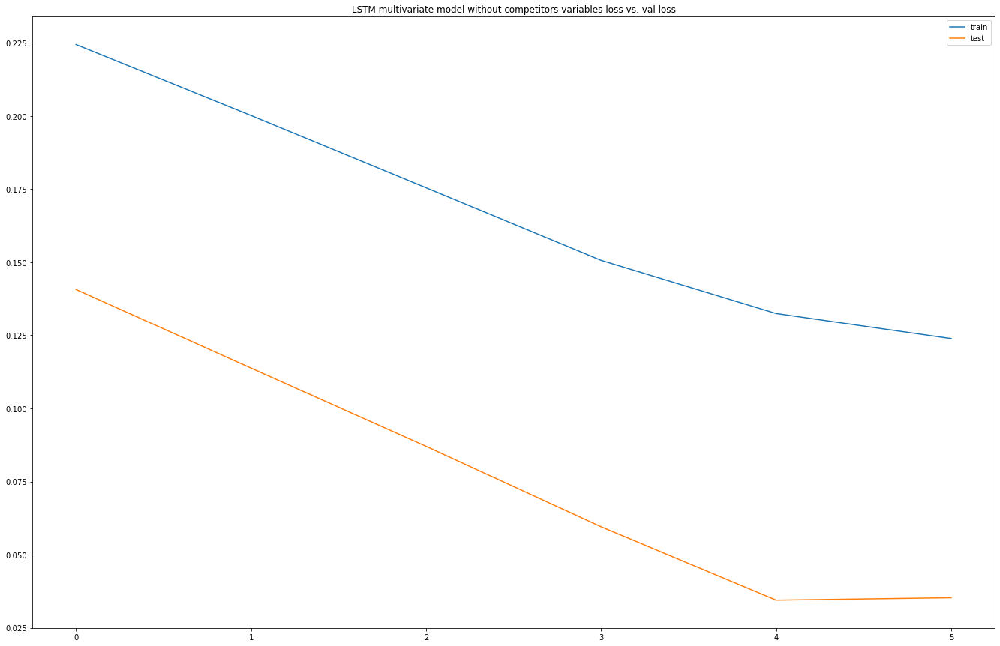

Test RMSE: 1903.183


In [612]:
series_to_supervised(mcv_dig_400g_twin_asda_volume)
lstm_univariate(mcv_dig_400g_twin_asda_volume)

series_to_supervised(mcv_dig_400g_twin_asda_own_variable)
multivariate_lstm_without_competitor(mcv_dig_400g_twin_asda_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var6(t),var7(t),var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-11-25,13729.6,2017.0,4.0,10.0,43.0,13166.4,2.411411,93.0,4.0,1.124957,...,13729.6,2.360666,92.0,90.0,1.008029,100.0,2.248666,100.0,1.000000,100.0
2017-12-02,9460.8,2017.0,4.0,11.0,44.0,13207.2,2.357964,92.0,80.0,1.125051,...,9460.8,2.361830,92.0,0.0,0.876991,100.0,2.247627,100.0,1.000028,100.0
2017-12-09,14225.6,2017.0,4.0,11.0,45.0,13923.2,2.355306,92.0,88.0,1.125064,...,14225.6,2.361552,92.0,1.0,0.874811,100.0,2.243993,100.0,1.000084,100.0
2017-12-16,13045.6,2017.0,4.0,11.0,46.0,12684.0,2.357994,92.0,92.0,1.124475,...,13045.6,2.361632,92.0,5.0,0.874597,100.0,2.230360,100.0,1.000035,100.0
2017-12-23,13905.6,2017.0,4.0,11.0,47.0,13729.6,2.360666,92.0,90.0,1.008029,...,13905.6,2.361423,92.0,0.0,0.874568,100.0,2.224007,100.0,0.999994,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,15092.0,2020.0,1.0,1.0,3.0,18616.8,2.361749,92.0,0.0,0.824959,...,15092.0,2.361675,92.0,0.0,0.825001,100.0,2.249541,98.0,1.000011,99.0
2020-02-22,15833.6,2020.0,1.0,1.0,4.0,12076.0,2.360484,92.0,0.0,0.825002,...,15833.6,2.361604,92.0,0.0,0.825001,100.0,2.249202,98.0,1.000083,99.0
2020-02-29,16520.8,2020.0,1.0,2.0,5.0,11143.2,2.361180,92.0,0.0,0.824996,...,16520.8,2.360437,92.0,0.0,0.825017,100.0,2.249350,98.0,1.000065,99.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.540292        0.0        1.0   0.818182   0.823529   0.493231   
5   0.147245        0.0        1.0   0.909091   0.843137   0.497025   
6   0.585960        0.0        1.0   0.909091   0.862745   0.563597   
7   0.477313        0.0        1.0   0.909091   0.882353   0.448378   
8   0.556497        0.0        1.0   0.909091   0.901961   0.545596   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.652077        1.0   0.043478    0.999645         1.0    0.949654   
5   0.059179        0.5   0.869565    0.999957         1.0    0.969273   
6   0.029699        0.5   0.956522    1.000000         1.0    0.951181   
7   0.059519        0.5   1.000000    0.998047         1.0    0.946747   
8   0.089157        0.5   0.978261    0.611814         1.0    0.977436   

   var13(t-4)  var14(t-4)  var15(t-4)   var1(t)  
4         1.0    0.811188    0.000000  0.556497  
5         1.0    0.809052   

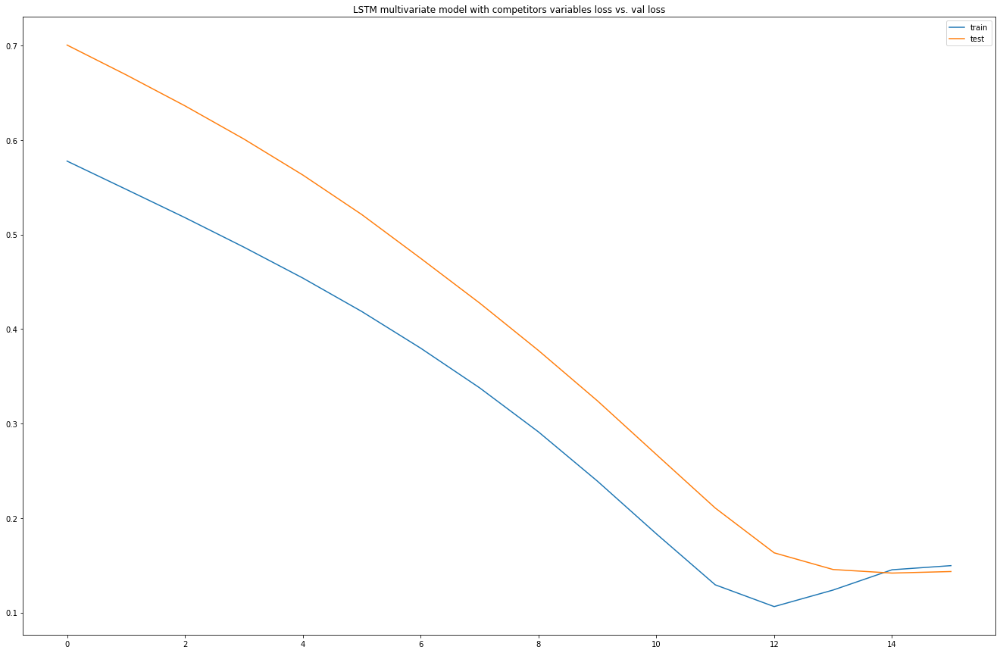

Test RMSE: 2123.527


In [613]:
series_to_supervised(mcv_dig_400g_twin_asda_with_comp)
multivariate_with_competitor_mcv_asda(mcv_dig_400g_twin_asda_with_comp)

## Asda - McVitie's Rich Tea 300g Twin Pack

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,12558,7534.8,23716.6,94,0,1.888565,3.147608,2014,4,12,50
1,2014-12-20,12508,7504.8,23635.3,94,0,1.889615,3.149358,2014,4,12,51
2,2014-12-27,9314,5588.4,17596.6,93,0,1.889263,3.148772,2014,4,12,52
3,2015-01-03,8464,5078.4,15995.4,93,0,1.889816,3.149693,2015,1,1,1
4,2015-01-10,9504,5702.4,17954.3,94,0,1.889131,3.148551,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,13245.181818,7947.109091,24576.007636,93.258182,3.694545,1.861769,3.102948,2017.083636,2.469091,6.414545,26.043636
std,2238.545812,1343.127487,3857.629982,1.543374,17.649915,0.098597,0.164329,1.534371,1.140635,3.547767,15.490223
min,6429.000000,3857.400000,12142.900000,90.000000,0.000000,1.499399,2.498998,2014.000000,1.000000,1.000000,1.000000
25%,12040.500000,7224.300000,22712.350000,92.000000,0.000000,1.886780,3.144634,2016.000000,1.000000,3.000000,12.000000
50%,13191.000000,7914.600000,24791.100000,94.000000,0.000000,1.889198,3.148663,2017.000000,2.000000,6.000000,26.000000
75%,14461.500000,8676.900000,26902.500000,94.000000,0.000000,1.889659,3.149432,2018.000000,3.500000,9.500000,39.500000
95%,16792.300000,10075.380000,30081.360000,96.000000,7.000000,1.889994,3.149990,2019.000000,4.000000,12.000000,50.000000
99%,19035.040000,11421.024000,34233.208000,96.000000,94.260000,1.987850,3.313084,2020.000000,4.000000,12.000000,52.000000
max,20137.000000,12082.200000,37867.700000,96.000000,95.000000,1.989646,3.316077,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

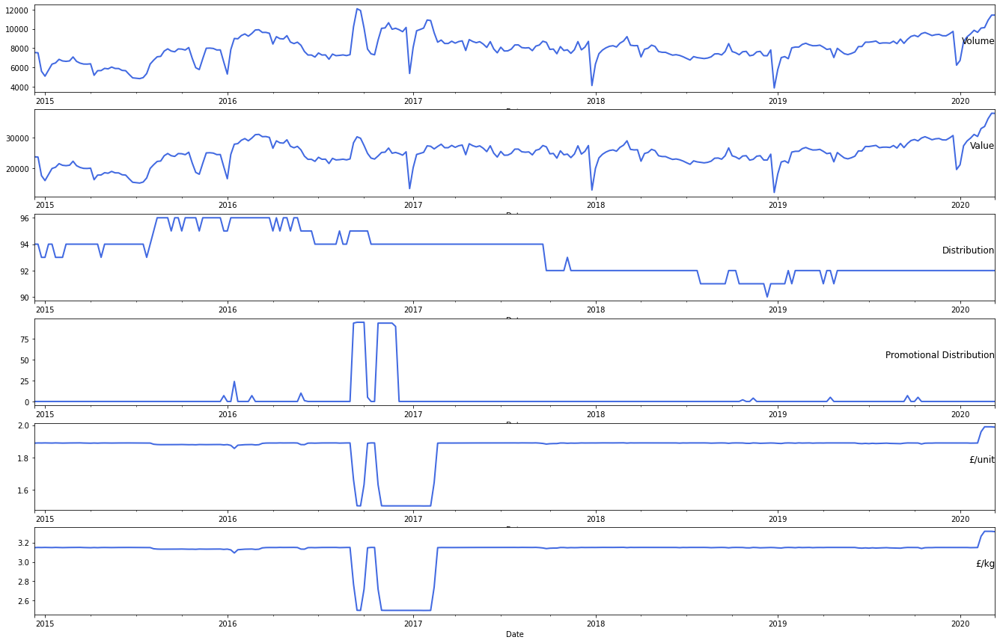

(<matplotlib.axes._subplots.AxesSubplot at 0x7f53263bc5f8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5327b3fac8>)

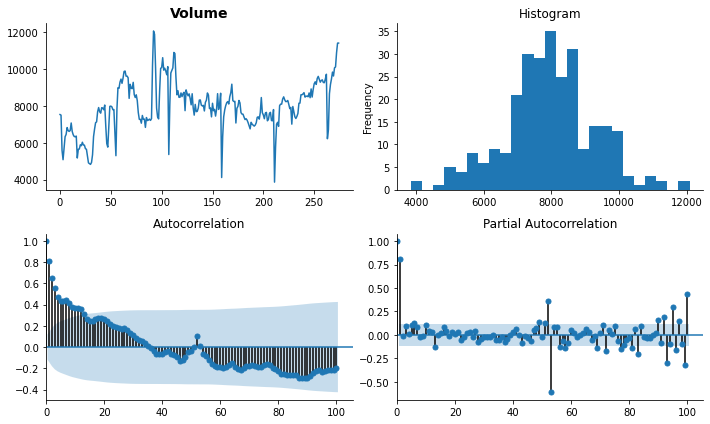

In [614]:
basic_info(mcv_rt_300g_twin_asda_origin)
plot_data(mcv_rt_300g_twin_asda_origin)
tsplot(mcv_rt_300g_twin_asda_origin['Volume'].dropna(), title=mcv_rt_300g_twin_asda_origin.columns[2], lags=100)


Test Statistic                  -2.240620
p-value                          0.191834
#Lags Used                       6.000000
Number of Observations Used    268.000000
Critical Value (1%)             -3.454988
Critical Value (5%)             -2.872386
Critical Value (10%)            -2.572549
dtype: float64


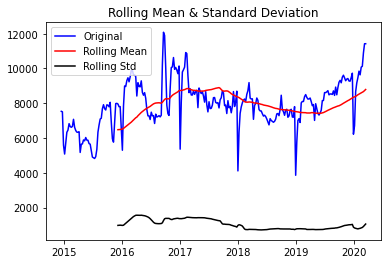

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f53280d92b0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53281f34a8>)

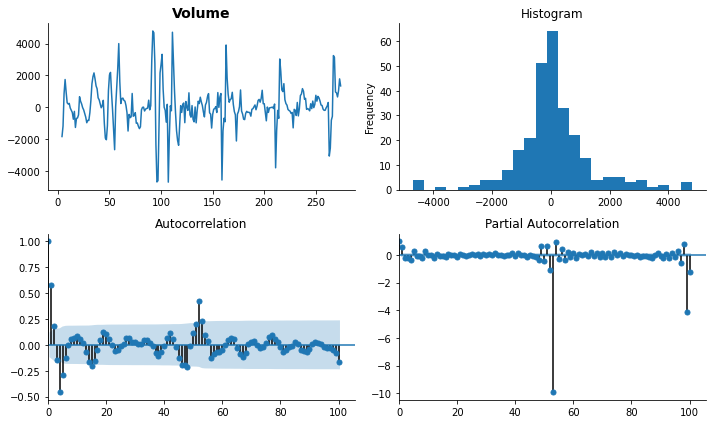

In [615]:
plot(mcv_rt_300g_twin_asda_origin)
#plot stationary graph
series_transformed=mcv_rt_300g_twin_asda_origin.copy()
series_transformed['Volume_transformed']=mcv_rt_300g_twin_asda_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_rt_300g_twin_asda_origin.columns[2], lags=100)


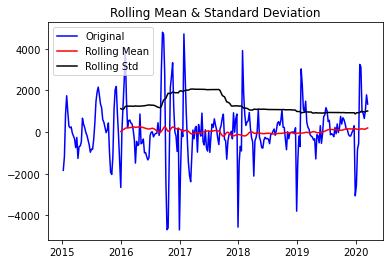

Results of Dickey-Fuller Test:
Test Statistic                -6.036355e+00
p-value                        1.379076e-07
#Lags Used                     1.100000e+01
Number of Observations Used    2.590000e+02
Critical Value (1%)           -3.455853e+00
Critical Value (5%)           -2.872765e+00
Critical Value (10%)          -2.572752e+00
dtype: float64


In [616]:
plot_transform(mcv_rt_300g_twin_asda_origin)

      t-4     t+1
0     NaN  7534.8
1     NaN  7504.8
2     NaN  5588.4
3     NaN  5078.4
4  7534.8  5702.4
Test MSE: 1001226.809
Test RMSE: 1000.613


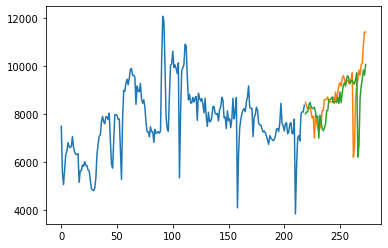

Observations: 271
Training Observations: 216
Testing Observations: 55


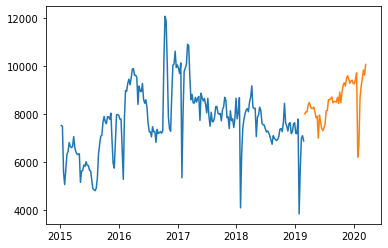

RMSE for Simple Exponential Smoothing α= 0.1 is: 1781.6
RMSE for Simple Exponential Smoothing α= 0.2 is: 1966.64
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2010.67
RMSE for Simple Exponential Smoothing α= 0.4 is: 1979.71
RMSE for Simple Exponential Smoothing α= 0.5 is: 1923.56
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 1872.25
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 1839.97
RMSE for Simple Exponential Smoothing α= 0.8 is: 1829.72
RMSE for Simple Exponential Smoothing α= 0.9 is: 1837.27


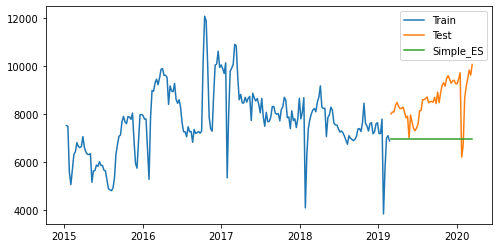

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.8 and β= 0.8 is: 746.13


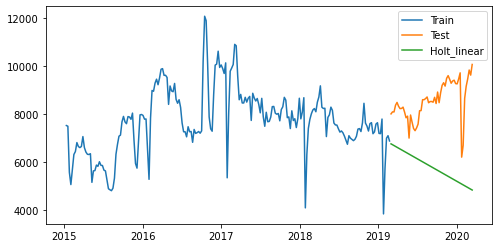

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/scipy/optimize/_numdiff.py:497: RuntimeWarning:

invalid value encountered in subtract

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162:

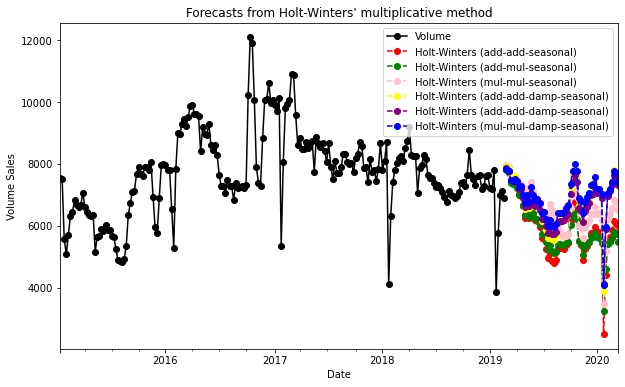

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
2933.866277069021
2925.2224277467744
2292.5651322730987
1989.959215991681
2006.3867558803474
1817.7379882430034


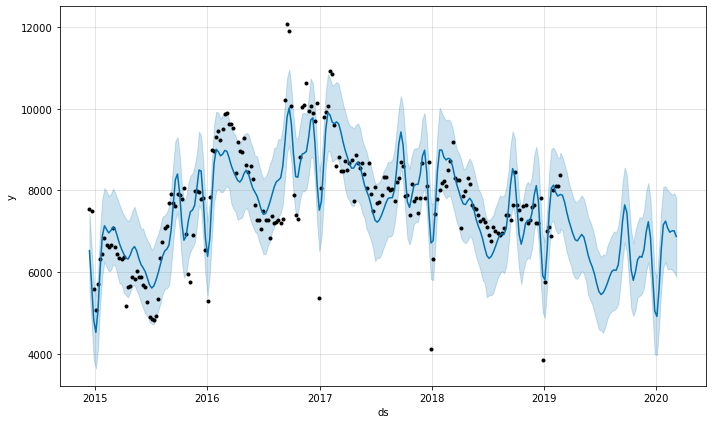

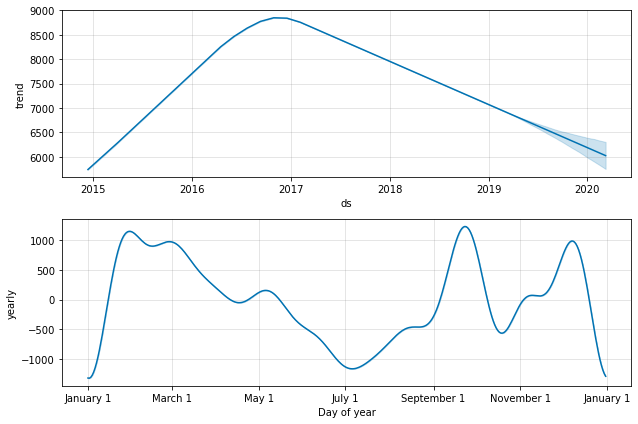

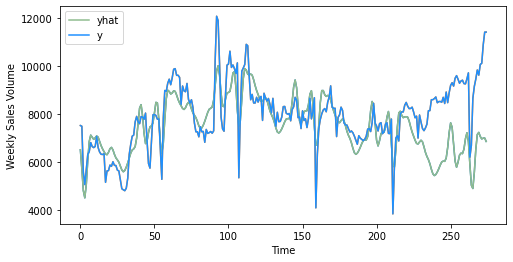

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 1293.1677798767148
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17

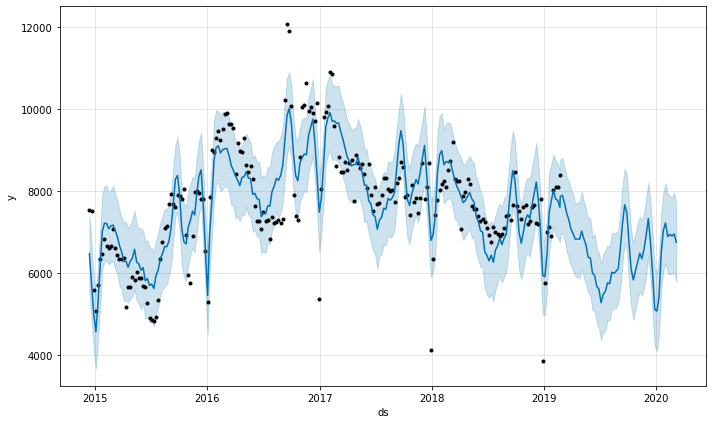

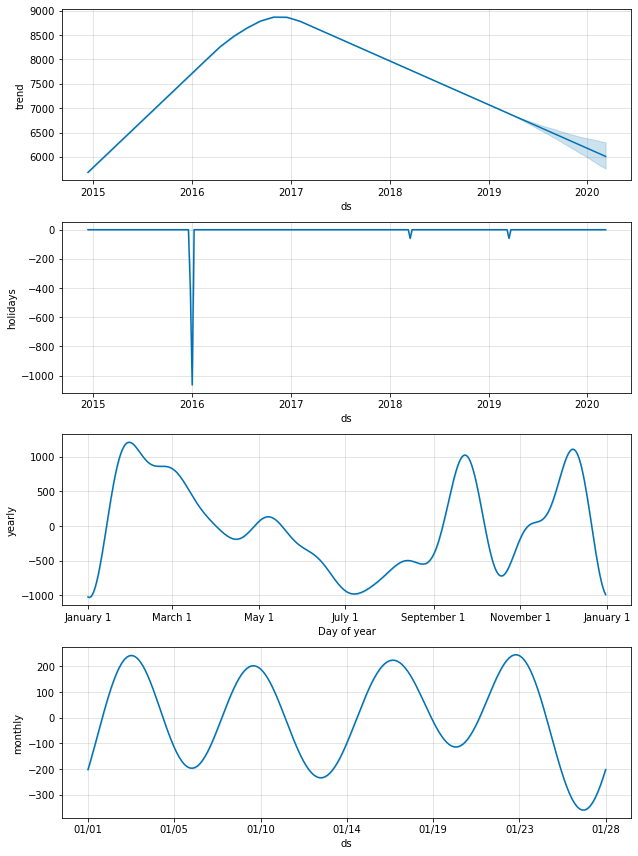

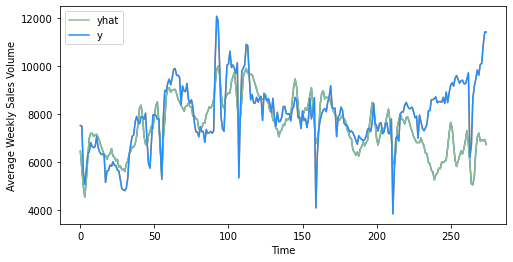

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 1298.031453140017


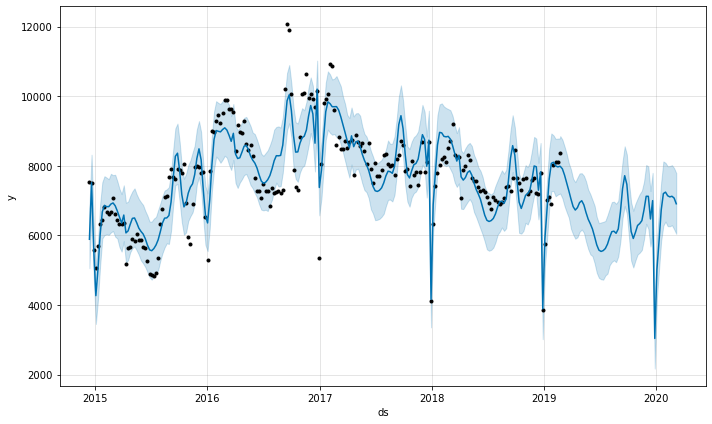

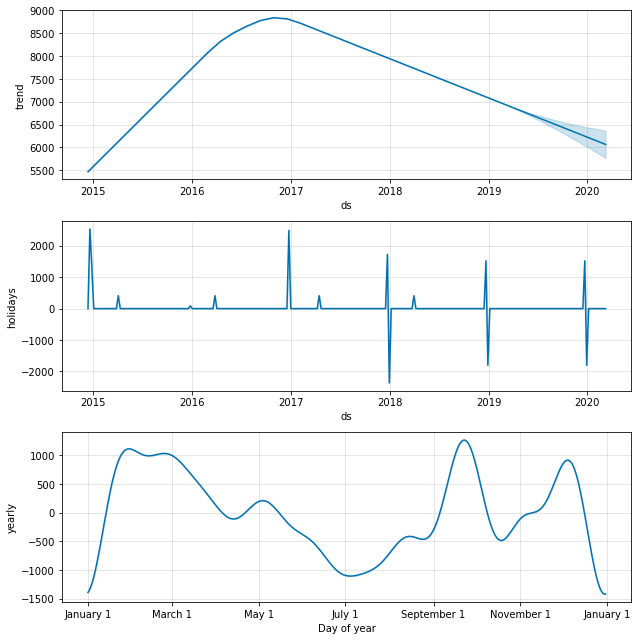

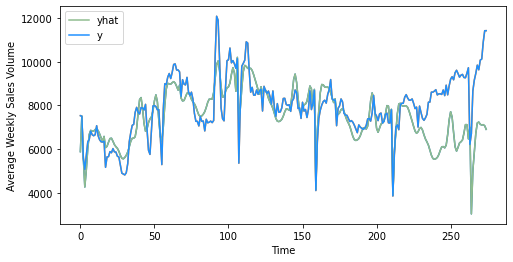

RMSE for prophet with only Christmas and Easter week is: 1255.2720227641676


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [617]:
#time series models
baseline_model(mcv_rt_300g_twin_asda_origin)
ses_model(mcv_rt_300g_twin_asda_origin)
holt_linear_model(mcv_rt_300g_twin_asda_origin)
holt_winter_model(mcv_rt_300g_twin_asda_origin)
prophet_model(mcv_rt_300g_twin_asda_origin)
prophet_all_holidays(mcv_rt_300g_twin_asda_origin)
prophet_two_holiday(mcv_rt_300g_twin_asda_origin)

Observations: 45
Training Observations: 25
Testing Observations: 20
[ -2.73829822  -1.65786993 -49.43046305  -7.67923564  -2.69523866]
Mean Absolute Error: 837.4380000000008
Mean Squared Error: 854271.5214600016
Root Mean Squared Error: 924.2681004232493
Observations: 65
Training Observations: 45
Testing Observations: 20
[ -0.84566297  -1.38865932  -2.288028   -12.6788461   -1.00945042]
Mean Absolute Error: 520.842
Mean Squared Error: 669148.9765199997
Root Mean Squared Error: 818.0152666790515
Observations: 85
Training Observations: 65
Testing Observations: 20
[ -2.38577145  -2.00476425 -12.62187289  -1.34214372  -0.13827953]
Mean Absolute Error: 607.6409999999997
Mean Squared Error: 499123.5052499996
Root Mean Squared Error: 706.4867339518836
Observations: 105
Training Observations: 85
Testing Observations: 20
[ -2.40153908 -14.30817928  -1.4781402    0.15676429   0.3860133 ]
Mean Absolute Error: 1254.1484999999998
Mean Squared Error: 1697434.8987149992
Root Mean Squared Error: 1302.

<Figure size 432x288 with 0 Axes>

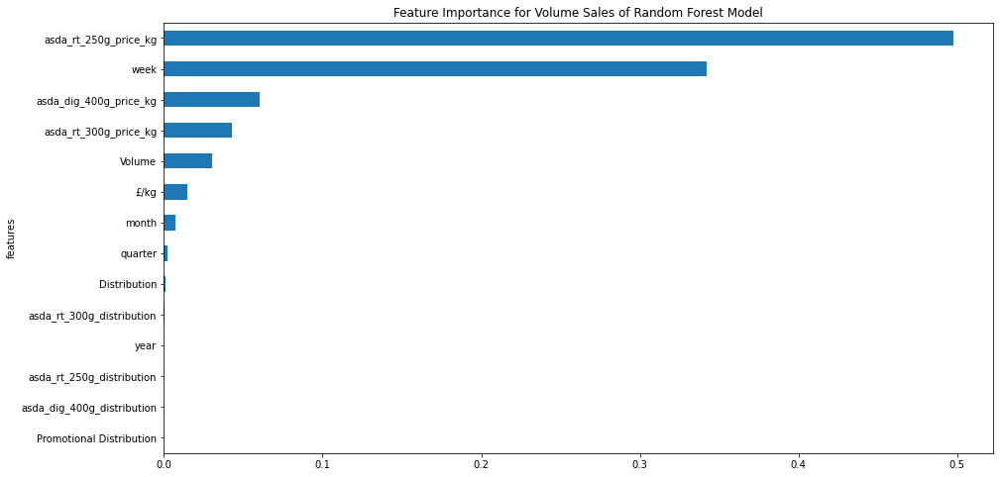

<Figure size 432x288 with 0 Axes>

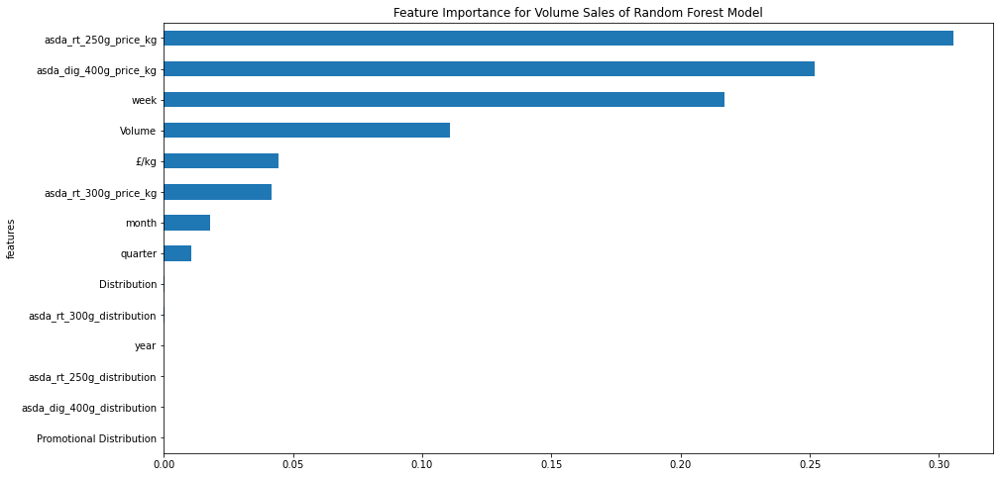

<Figure size 432x288 with 0 Axes>

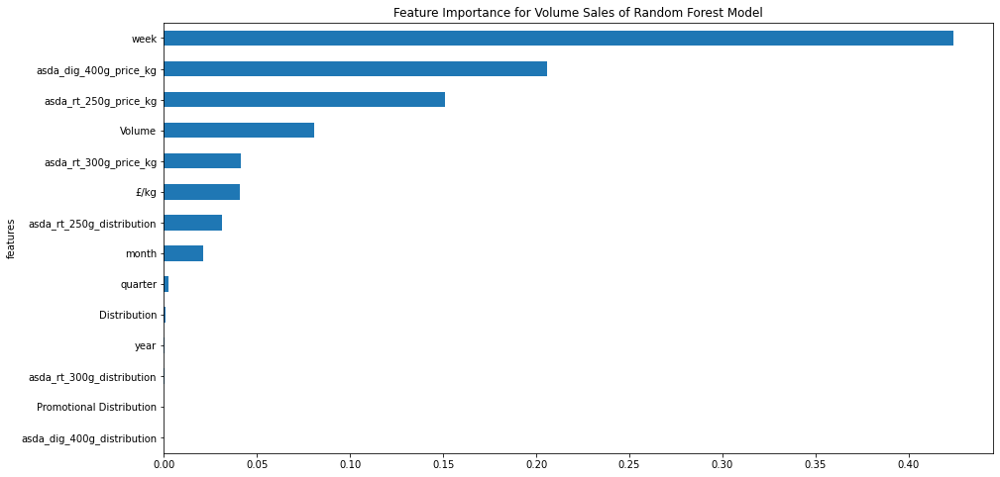

<Figure size 432x288 with 0 Axes>

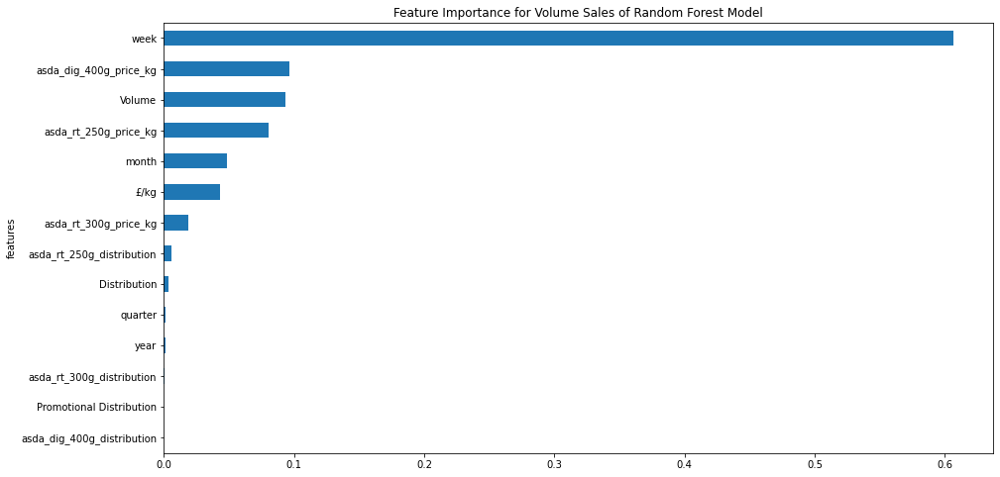

<Figure size 432x288 with 0 Axes>

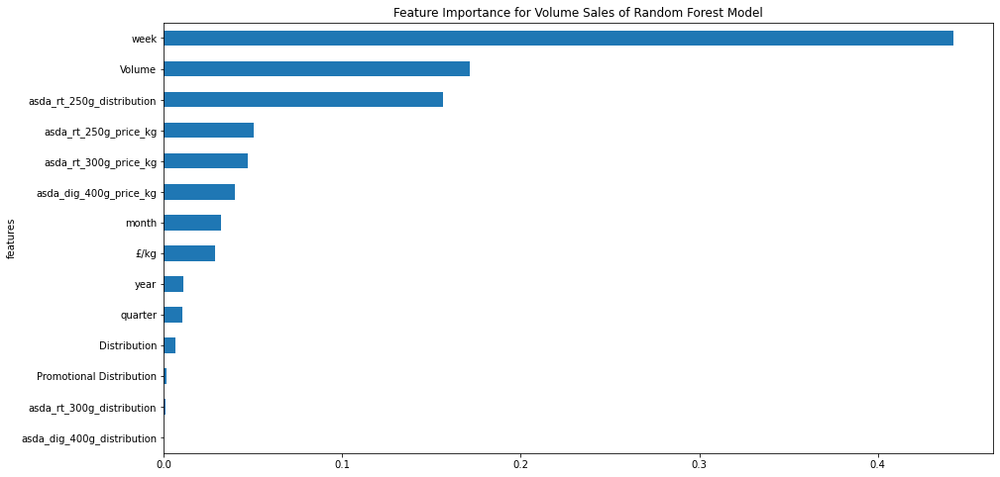

<Figure size 432x288 with 0 Axes>

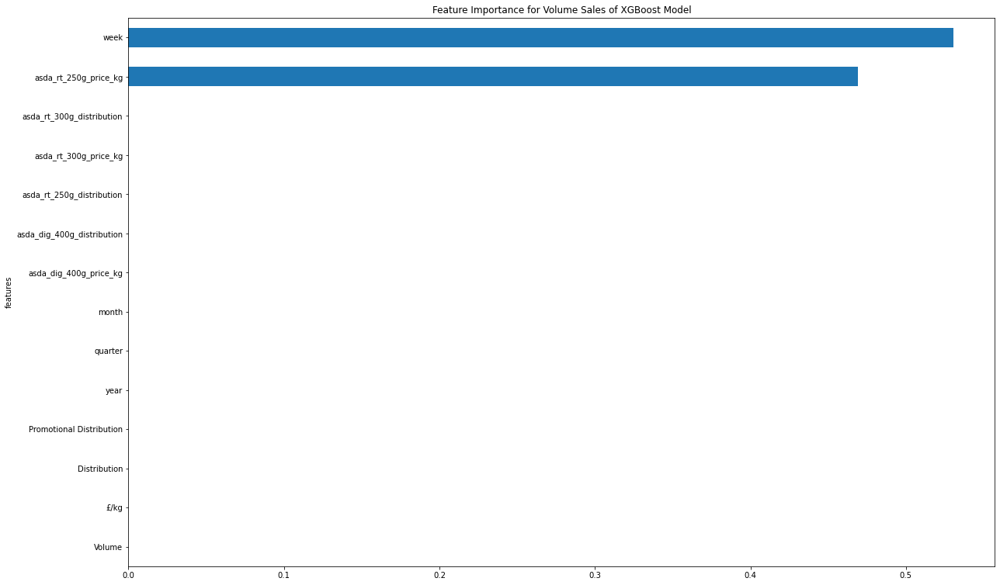

<Figure size 432x288 with 0 Axes>

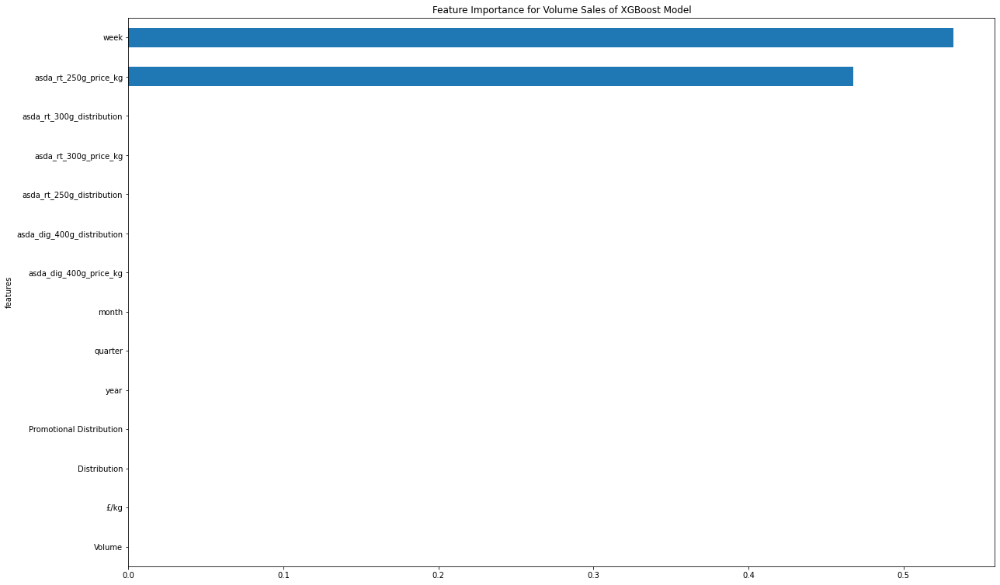

<Figure size 432x288 with 0 Axes>

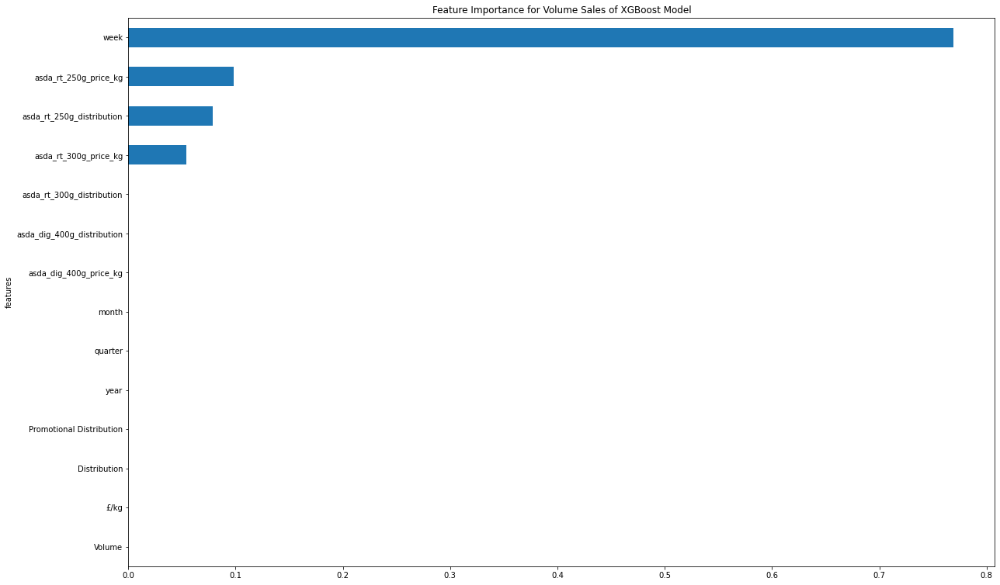

<Figure size 432x288 with 0 Axes>

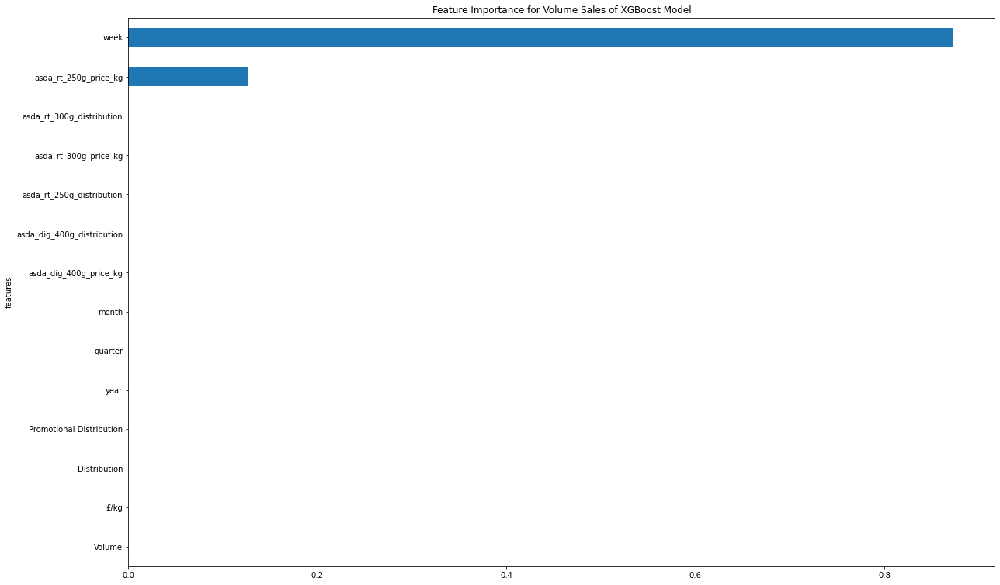

<Figure size 432x288 with 0 Axes>

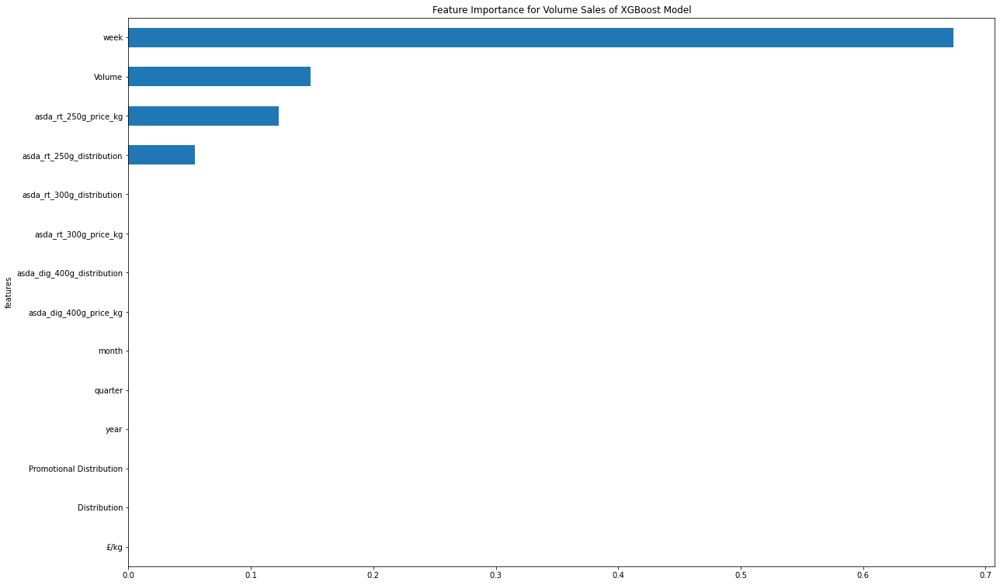

In [618]:
#machine learning models
mcv_rt_300g_twin_asda_with_comp=variable_lag_mcv_asda(mcv_rt_300g_twin_asda_with_comp)
mcv_rt_300g_twin_asda_input_X,mcv_rt_300g_twin_asda_input_Y=input_var_mcv_asda(mcv_rt_300g_twin_asda_with_comp)
rf_regressor_mcv_asda(mcv_rt_300g_twin_asda_input_X,mcv_rt_300g_twin_asda_input_Y)

mcv_rt_300g_twin_asda_input_X,mcv_rt_300g_twin_asda_input_Y=input_var_mcv_asda(mcv_rt_300g_twin_asda_with_comp)
xgb_regressor_mcv_asda(mcv_rt_300g_twin_asda_input_X,mcv_rt_300g_twin_asda_input_Y)


,var1(t-4),var1(t)
Date,,
2015-01-10,17259.3,15084.9
2015-01-17,16830.9,16269.3
2015-01-24,11520.9,15061.2
2015-01-31,11492.4,14468.4
2015-02-07,15084.9,14725.2
...,...,...
2020-02-15,13409.1,12756.6
2020-02-22,14161.5,12278.4
2020-02-29,15364.2,12749.4


   var1(t-4)   var1(t)
4   0.786582  0.624980
5   0.754743  0.713005
6   0.360103  0.623219
7   0.357985  0.579162
8   0.624980  0.598247
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 42s - loss: 0.7046 - val_loss: 0.6416
Epoch 2/50
216/216 - 0s - loss: 0.6914 - val_loss: 0.6284
Epoch 3/50
216/216 - 0s - loss: 0.6781 - val_loss: 0.6150
Epoch 4/50
216/216 - 0s - loss: 0.6645 - val_loss: 0.6012
Epoch 5/50
216/216 - 0s - loss: 0.6504 - val_loss: 0.5866
Epoch 6/50
216/216 - 0s - loss: 0.6355 - val_loss: 0.5713
Epoch 7/50
216/216 - 0s - loss: 0.6198 - val_loss: 0.5550
Epoch 8/50
216/216 - 0s - loss: 0.6032 - val_loss: 0.5375
Epoch 9/50
216/216 - 0s - loss: 0.5853 - val_loss: 0.5186
Epoch 10/50
216/216 - 0s - loss: 0.5660 - val_loss: 0.4981
Epoch 11/50
216/216 - 0s - loss: 0.5450 - val_loss: 0.4759
Epoch 12/50
216/216 - 0s - loss: 0.5225 - val_loss: 0.4519
Epoch 13/50
216/216 - 0s - loss: 0.4980 - val_loss: 0.4262
Epoch 14/50
216/216 - 

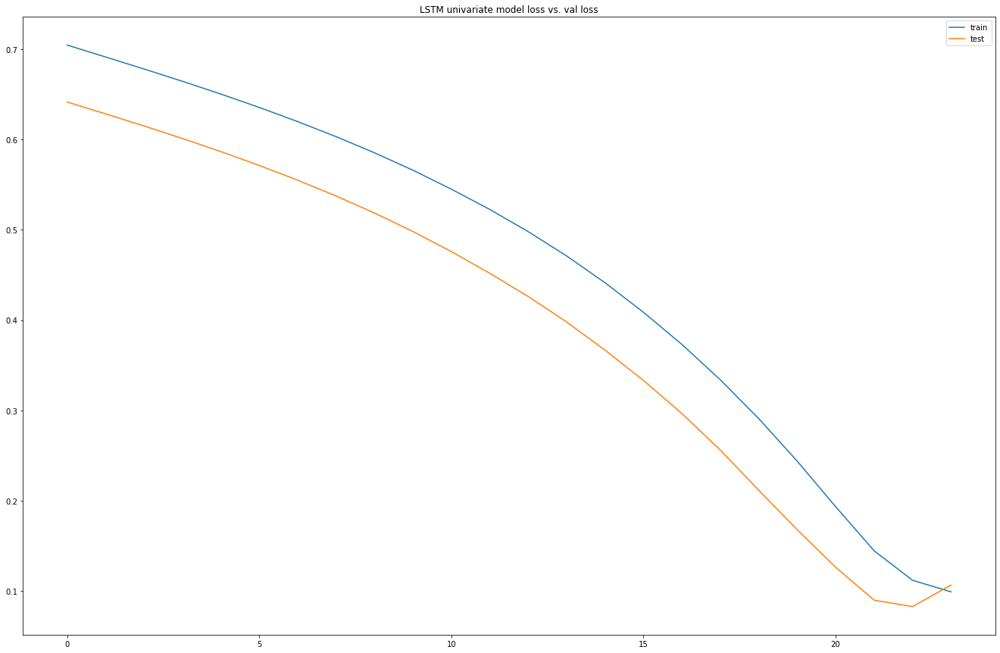

Test RMSE: 1985.977


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,7534.8,3.147608,94.0,0.0,2014.0,4.0,12.0,50.0,5702.4,3.148551,94,0,2015,1,1,2
2015-01-17,7504.8,3.149358,94.0,0.0,2014.0,4.0,12.0,51.0,6329.4,3.148213,94,0,2015,1,1,3
2015-01-24,5588.4,3.148772,93.0,0.0,2014.0,4.0,12.0,52.0,6452.4,3.149696,93,0,2015,1,1,4
2015-01-31,5078.4,3.149693,93.0,0.0,2015.0,1.0,1.0,1.0,6825.6,3.148851,93,0,2015,1,1,5
2015-02-07,5702.4,3.148551,94.0,0.0,2015.0,1.0,1.0,2.0,6660.6,3.147749,93,0,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,9165.6,3.148926,92.0,0.0,2020.0,1.0,1.0,3.0,10075.8,3.265388,92,0,2020,1,2,7
2020-02-22,9469.8,3.147405,92.0,0.0,2020.0,1.0,1.0,4.0,10123.8,3.316077,92,0,2020,1,2,8
2020-02-29,9844.8,3.147662,92.0,0.0,2020.0,1.0,2.0,5.0,10893.0,3.315625,92,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.447111   0.793816   0.666667        0.0   0.000000        1.0   
5   0.443464   0.795957   0.666667        0.0   0.000000        1.0   
6   0.210461   0.795241   0.500000        0.0   0.000000        1.0   
7   0.148453   0.796367   0.500000        0.0   0.166656        0.0   
8   0.224322   0.794970   0.666667        0.0   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.224322  
5        1.0   0.961538  0.300554  
6        1.0   0.980769  0.315509  
7        0.0   0.000000  0.360884  
8        0.0   0.019231  0.340823  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 44s - loss: 0.4786 - val_loss: 0.5824
Epoch 2/50
216/216 - 0s - loss: 0.4526 - val_loss: 0.5549
Epoch 3/50
216/216 - 0s - loss: 0.4263 - val_loss: 0.5260
Epoch 4/50
216/216 - 0s - loss: 0.3984 - val_loss: 0.4948
Epoch 5/50
216/216 - 0s - loss: 0.3680 - va

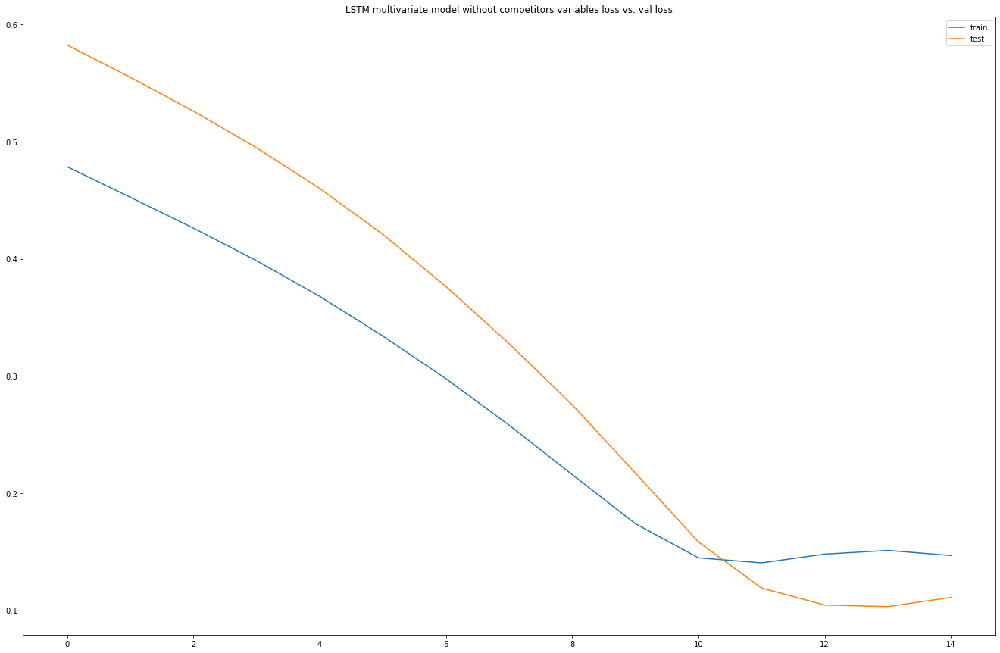

Test RMSE: 1358.314


In [621]:
series_to_supervised(mcv_rt_300g_twin_asda_volume)
lstm_univariate(mcv_rt_300g_twin_asda_volume)

series_to_supervised(mcv_rt_300g_twin_asda_own_variable)
multivariate_lstm_without_competitor(mcv_rt_300g_twin_asda_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var6(t),var7(t),var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-11-25,8147.4,2017.0,4.0,10.0,43.0,8591.4,3.137649,92.0,0.0,1.124957,...,8147.4,3.148870,92.0,0.0,1.008029,100.0,2.248666,100.0,1.000000,100.0
2017-12-02,7743.0,2017.0,4.0,11.0,44.0,7861.2,3.141480,92.0,0.0,1.125051,...,7743.0,3.148663,92.0,0.0,0.876991,100.0,2.247627,100.0,1.000028,100.0
2017-12-09,7817.4,2017.0,4.0,11.0,45.0,7894.2,3.142915,92.0,0.0,1.125064,...,7817.4,3.146033,93.0,0.0,0.874811,100.0,2.243993,100.0,1.000084,100.0
2017-12-16,7451.4,2017.0,4.0,11.0,46.0,7408.8,3.143154,92.0,0.0,1.124475,...,7451.4,3.147811,92.0,0.0,0.874597,100.0,2.230360,100.0,1.000035,100.0
2017-12-23,7824.6,2017.0,4.0,11.0,47.0,8147.4,3.148870,92.0,0.0,1.008029,...,7824.6,3.147062,92.0,0.0,0.874568,100.0,2.224007,100.0,0.999994,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,9165.6,2020.0,1.0,1.0,3.0,9727.2,3.149447,92.0,0.0,0.824959,...,9165.6,3.148926,92.0,0.0,0.825001,100.0,2.249541,98.0,1.000011,99.0
2020-02-22,9469.8,2020.0,1.0,1.0,4.0,6219.6,3.149286,92.0,0.0,0.825002,...,9469.8,3.147405,92.0,0.0,0.825001,100.0,2.249202,98.0,1.000083,99.0
2020-02-29,9844.8,2020.0,1.0,2.0,5.0,6712.8,3.148880,92.0,0.0,0.824996,...,9844.8,3.147662,92.0,0.0,0.825017,100.0,2.249350,98.0,1.000065,99.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.567055        0.0        1.0   0.818182   0.823529   0.761289   
5   0.513601        0.0        1.0   0.909091   0.843137   0.643863   
6   0.523436        0.0        1.0   0.909091   0.862745   0.649170   
7   0.475057        0.0        1.0   0.909091   0.882353   0.571112   
8   0.524387        0.0        1.0   0.909091   0.901961   0.689888   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.000000   0.666668        0.0    0.999645         1.0    0.949654   
5   0.029987   0.666668        0.0    0.999957         1.0    0.969273   
6   0.041224   0.666668        0.0    1.000000         1.0    0.951181   
7   0.043095   0.666668        0.0    0.998047         1.0    0.946747   
8   0.087837   0.666668        0.0    0.611814         1.0    0.977436   

   var13(t-4)  var14(t-4)  var15(t-4)   var1(t)  
4         1.0    0.811188    0.000000  0.524387  
5         1.0    0.809052   

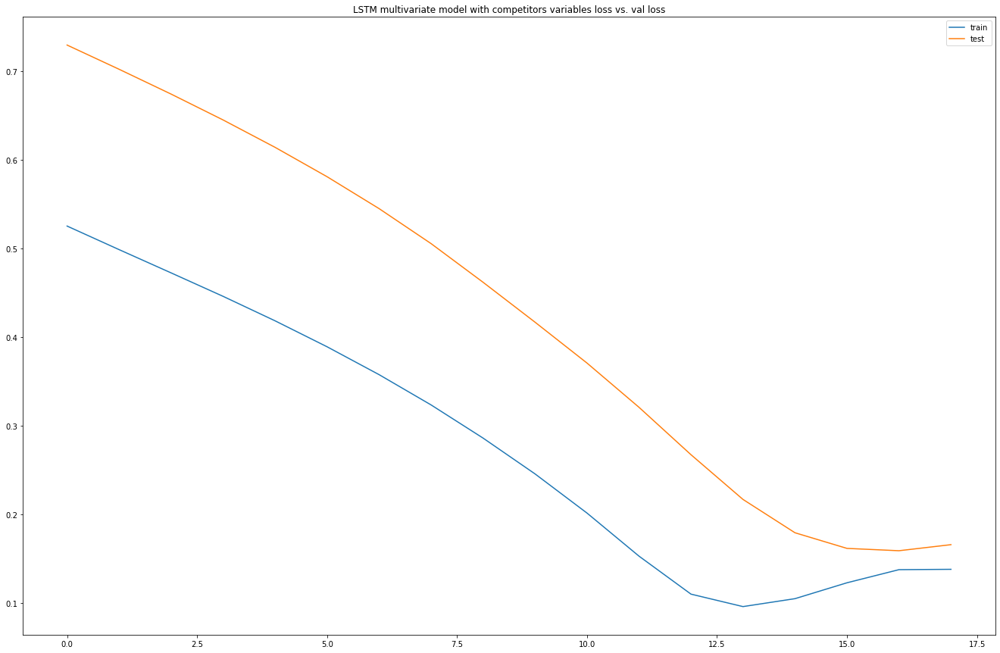

Test RMSE: 1595.138


In [622]:
series_to_supervised(mcv_rt_300g_twin_asda_with_comp)
multivariate_with_competitor_mcv_asda(mcv_rt_300g_twin_asda_with_comp)

## Asda - McVitie's Rich Tea 300g

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
0,2014-12-13,42530,12759.0,43094.6,100,11,1.013275,3.377584,2014,4,12,50
1,2014-12-20,40838,12251.4,41252.9,100,20,1.010160,3.367199,2014,4,12,51
2,2014-12-27,31329,9398.7,31504.0,99,20,1.005586,3.351953,2014,4,12,52
3,2015-01-03,28537,8561.1,28651.9,100,30,1.004026,3.346755,2015,1,1,1
4,2015-01-10,38328,11498.4,37559.3,100,46,0.979944,3.266481,2015,1,1,2


(275, 12)

Date                        datetime64[ns]
Units                                int64
Volume                             float64
Value                              float64
Distribution                         int64
Promotional Distribution             int64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000,275.000000
mean,43906.781818,13172.034545,43341.846909,99.978182,11.152727,0.990850,3.302834,2017.083636,2.469091,6.414545,26.043636
std,8639.857500,2591.957250,7695.090409,0.146356,24.663249,0.042033,0.140112,1.534371,1.140635,3.547767,15.490223
min,18813.000000,5643.900000,18790.300000,99.000000,0.000000,0.815863,2.719545,2014.000000,1.000000,1.000000,1.000000
25%,38495.000000,11548.500000,38432.700000,100.000000,0.000000,0.996582,3.321940,2016.000000,1.000000,3.000000,12.000000
50%,42624.000000,12787.200000,42318.900000,100.000000,0.000000,0.999053,3.330178,2017.000000,2.000000,6.000000,26.000000
75%,48209.500000,14462.850000,47203.150000,100.000000,5.000000,0.999800,3.332667,2018.000000,3.500000,9.500000,39.500000
95%,57840.900000,17352.270000,56891.760000,100.000000,70.200000,0.999961,3.333202,2019.000000,4.000000,12.000000,50.000000
99%,68434.960000,20530.488000,66304.776000,100.000000,100.000000,1.180831,3.936103,2020.000000,4.000000,12.000000,52.000000
max,87270.000000,26181.000000,71200.400000,100.000000,100.000000,1.187525,3.958416,2020.000000,4.000000,12.000000,53.000000


Dataset has: 275rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

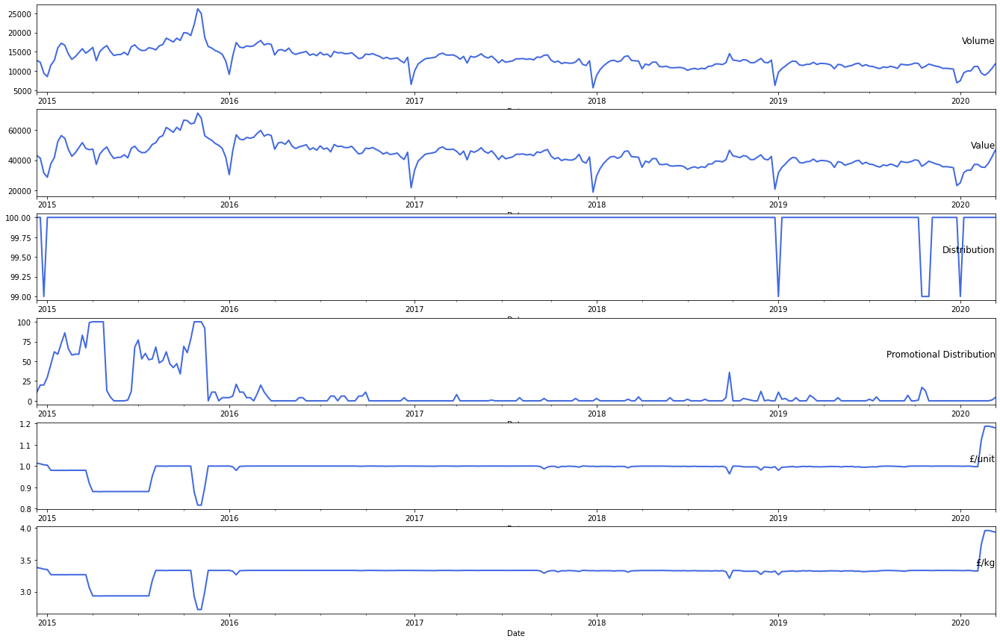

(<matplotlib.axes._subplots.AxesSubplot at 0x7f5318466518>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53183f0160>)

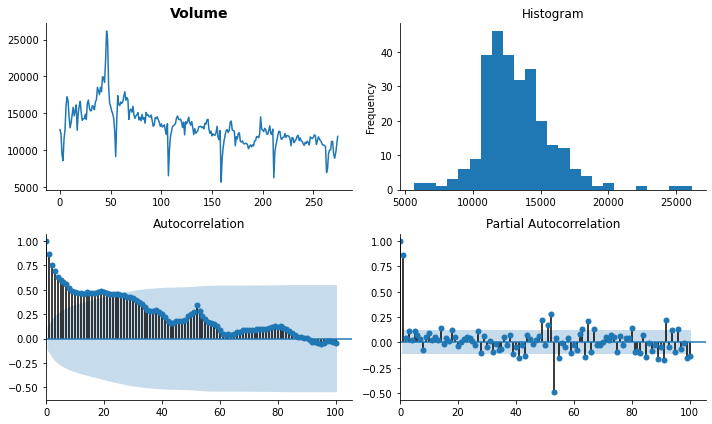

In [623]:
basic_info(mcv_rt_300g_asda_origin)
plot_data(mcv_rt_300g_asda_origin)
tsplot(mcv_rt_300g_asda_origin['Volume'].dropna(), title=mcv_rt_300g_asda_origin.columns[2], lags=100)


Test Statistic                  -3.550178
p-value                          0.006788
#Lags Used                       2.000000
Number of Observations Used    272.000000
Critical Value (1%)             -3.454622
Critical Value (5%)             -2.872225
Critical Value (10%)            -2.572464
dtype: float64


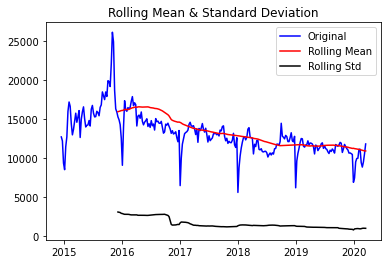

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f53182d6e48>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53181aa2b0>)

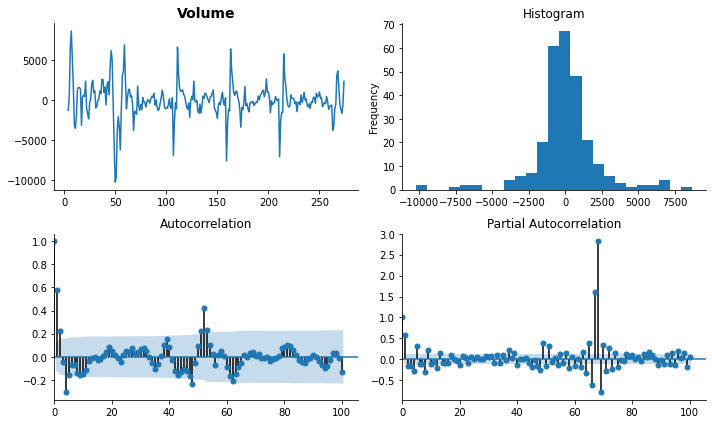

In [624]:
plot(mcv_rt_300g_asda_origin)
#plot stationary graph
series_transformed=mcv_rt_300g_asda_origin.copy()
series_transformed['Volume_transformed']=mcv_rt_300g_asda_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=mcv_rt_300g_asda_origin.columns[2], lags=100)


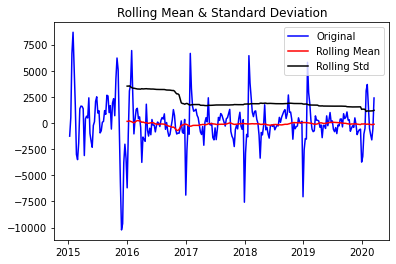

Results of Dickey-Fuller Test:
Test Statistic                  -5.446600
p-value                          0.000003
#Lags Used                      16.000000
Number of Observations Used    254.000000
Critical Value (1%)             -3.456360
Critical Value (5%)             -2.872987
Critical Value (10%)            -2.572870
dtype: float64


In [625]:
plot_transform(mcv_rt_300g_asda_origin)

       t-4      t+1
0      NaN  12759.0
1      NaN  12251.4
2      NaN   9398.7
3      NaN   8561.1
4  12759.0  11498.4
Test MSE: 1401972.789
Test RMSE: 1184.049


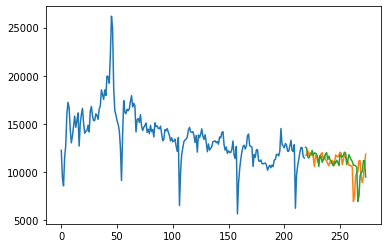

Observations: 271
Training Observations: 216
Testing Observations: 55


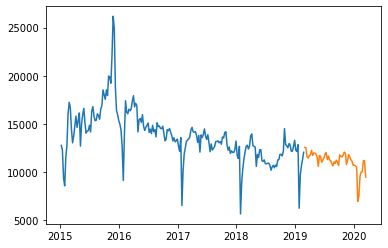

RMSE for Simple Exponential Smoothing α= 0.1 is: 1054.12
RMSE for Simple Exponential Smoothing α= 0.2 is: 1001.09
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 1000.83
RMSE for Simple Exponential Smoothing α= 0.4 is: 1001.47
RMSE for Simple Exponential Smoothing α= 0.5 is: 1024.72
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 1080.73
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 1154.42
RMSE for Simple Exponential Smoothing α= 0.8 is: 1227.43
RMSE for Simple Exponential Smoothing α= 0.9 is: 1290.96


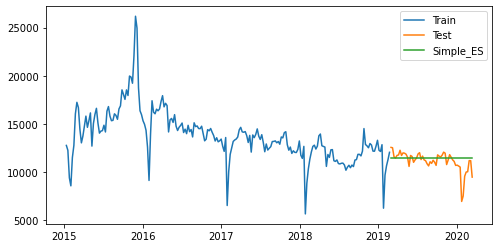

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.1 and β= 0.1 is: 840.23


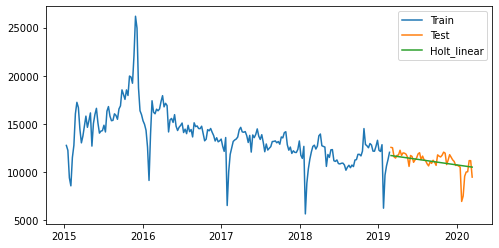

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

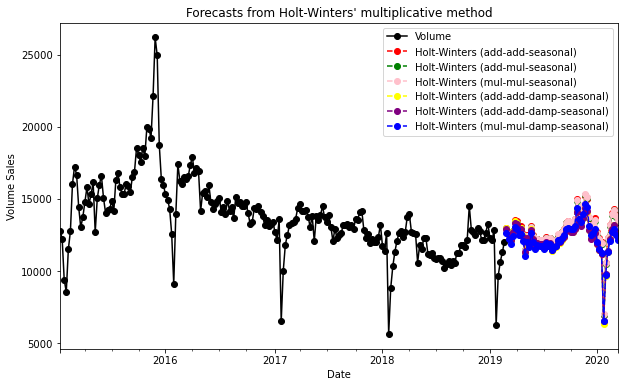

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
2032.0602687498288
1978.677183790723
2018.5685620554443
1452.761036665076
1450.1484381820133
1474.7402991160884


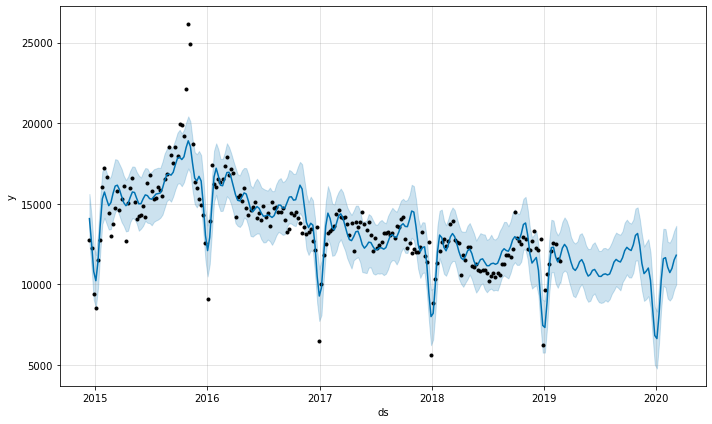

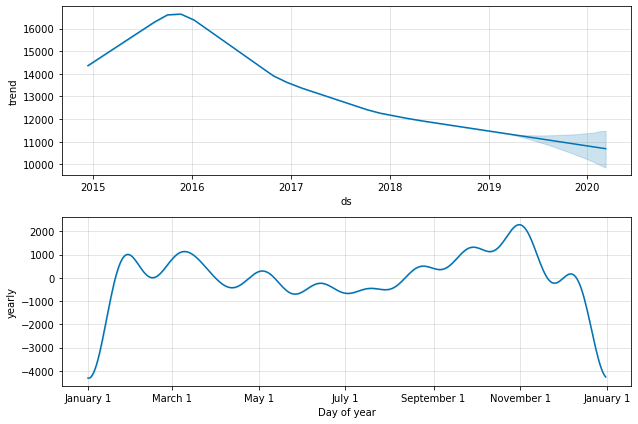

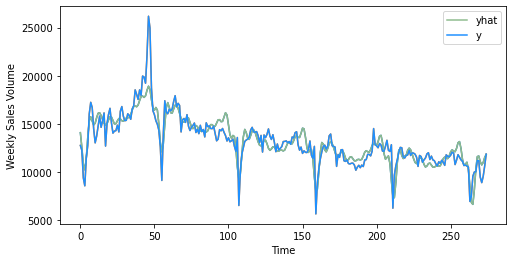

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 1199.9765217425881
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17

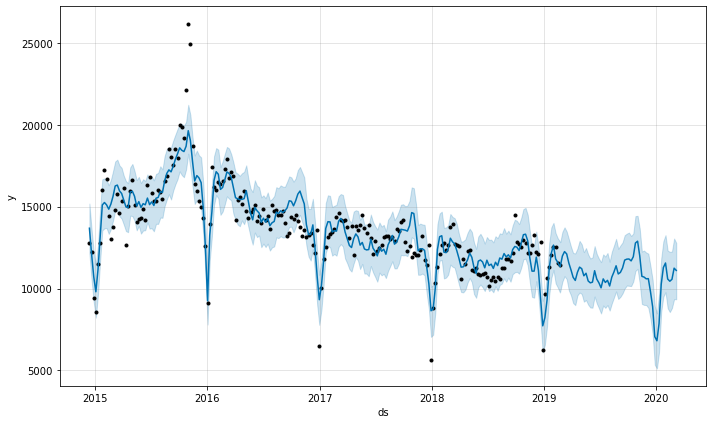

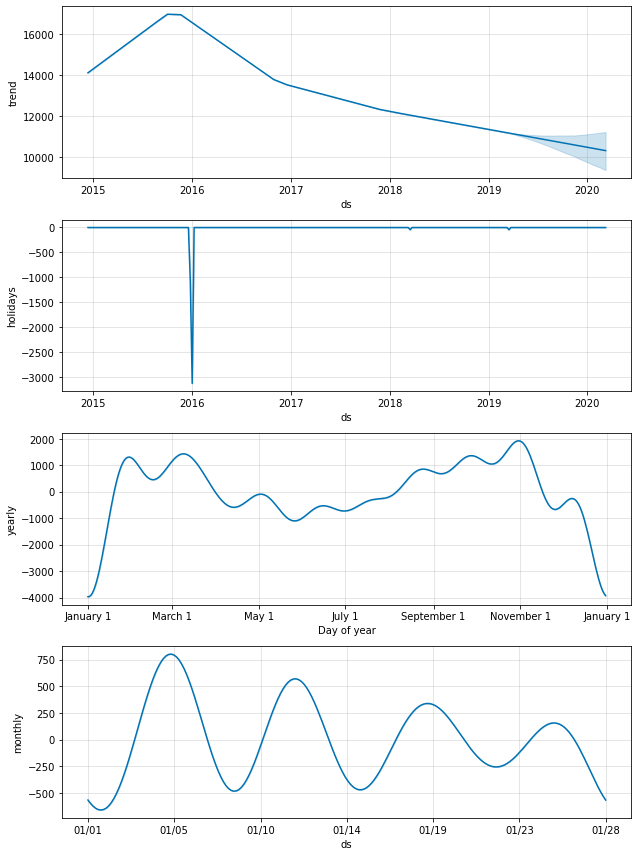

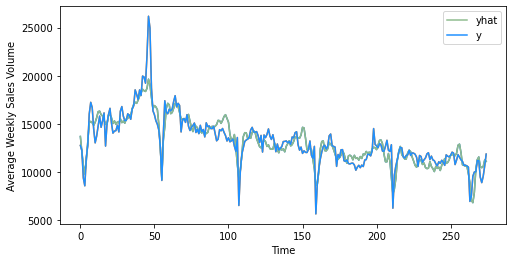

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 1136.5318769191133


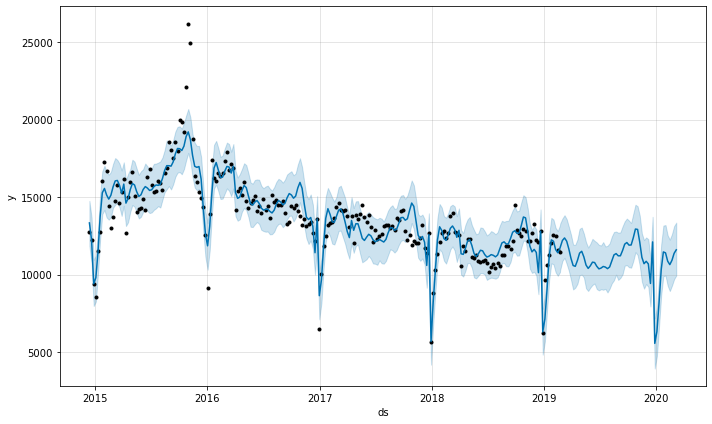

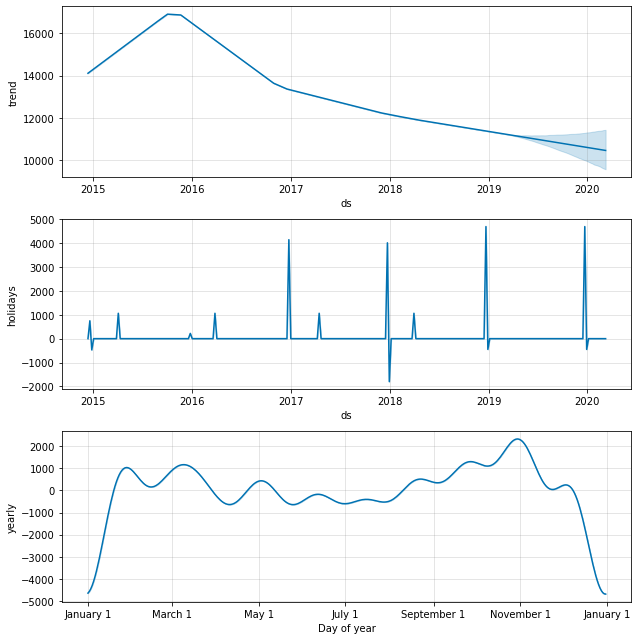

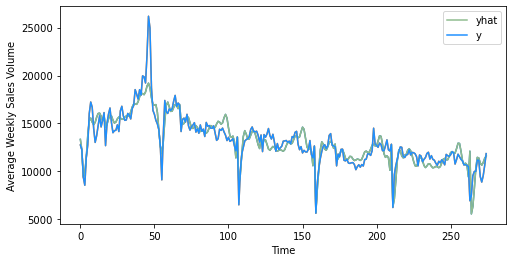

RMSE for prophet with only Christmas and Easter week is: 1132.7353717273438


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [626]:
#time series models
baseline_model(mcv_rt_300g_asda_origin)
ses_model(mcv_rt_300g_asda_origin)
holt_linear_model(mcv_rt_300g_asda_origin)
holt_winter_model(mcv_rt_300g_asda_origin)
prophet_model(mcv_rt_300g_asda_origin)
prophet_all_holidays(mcv_rt_300g_asda_origin)
prophet_two_holiday(mcv_rt_300g_asda_origin)

Observations: 45
Training Observations: 25
Testing Observations: 20
[  0.08124192  -2.23142581 -29.07580318  -3.61538535   0.63012535]
Mean Absolute Error: 1105.8765000000008
Mean Squared Error: 1601673.6226275023
Root Mean Squared Error: 1265.5724485889784
Observations: 65
Training Observations: 45
Testing Observations: 20
[ -0.31802846  -0.15635228  -2.08527088 -19.84040292  -0.354162  ]
Mean Absolute Error: 1178.5567499999995
Mean Squared Error: 1896381.414821249
Root Mean Squared Error: 1377.0916508429093
Observations: 85
Training Observations: 65
Testing Observations: 20
[-0.05627659 -1.69152594 -4.98679732 -2.37637644  0.51968442]
Mean Absolute Error: 463.8847499999996
Mean Squared Error: 316858.32788624975
Root Mean Squared Error: 562.9017035737676
Observations: 105
Training Observations: 85
Testing Observations: 20
[-1.05034281e-02 -1.89281347e+01 -3.48766193e+00  5.15441695e-01
  1.83932100e-01]
Mean Absolute Error: 423.41625000000005
Mean Squared Error: 307185.81771374994
Roo

<Figure size 432x288 with 0 Axes>

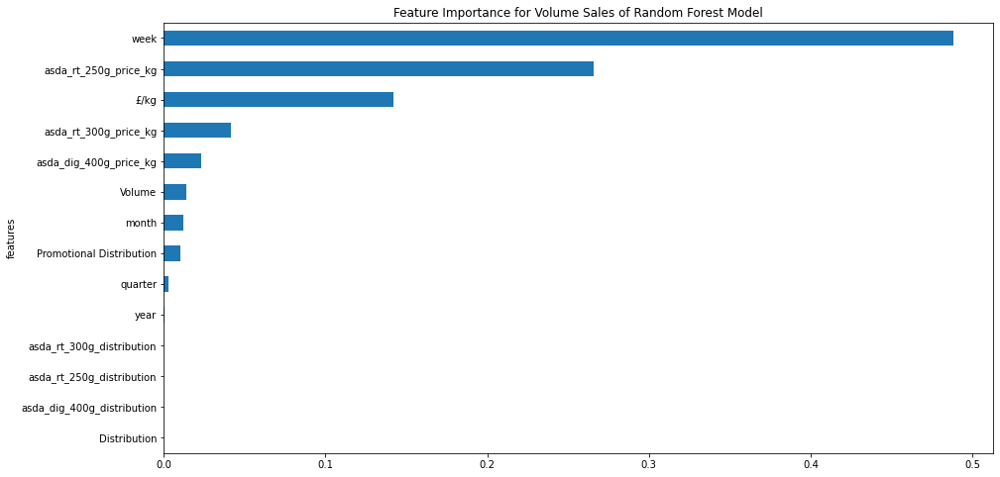

<Figure size 432x288 with 0 Axes>

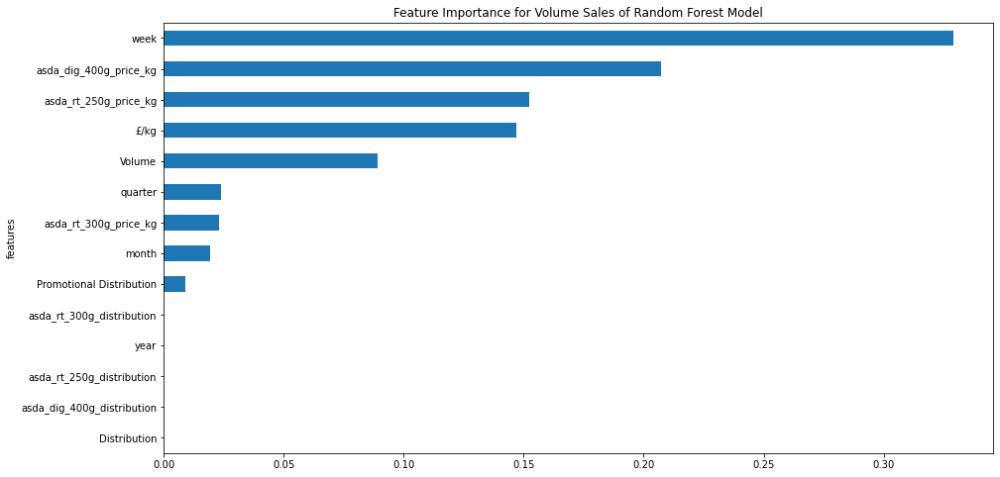

<Figure size 432x288 with 0 Axes>

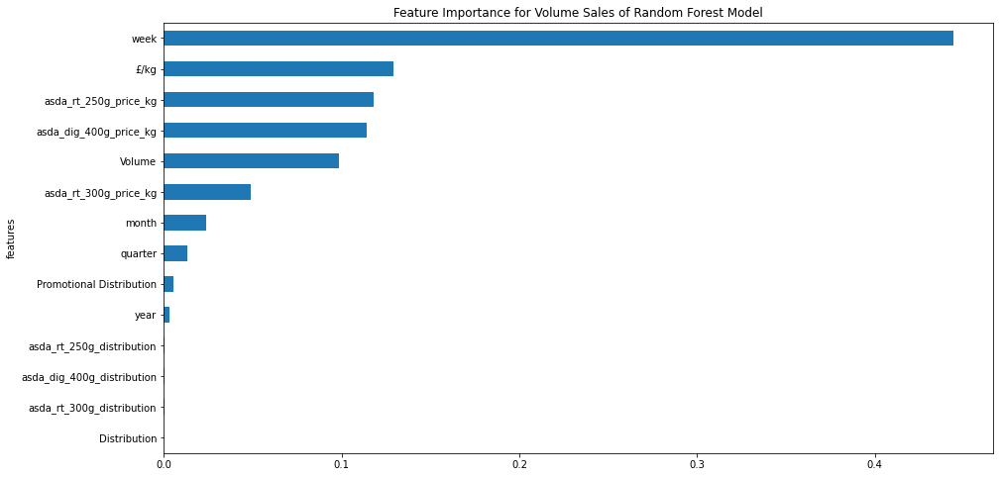

<Figure size 432x288 with 0 Axes>

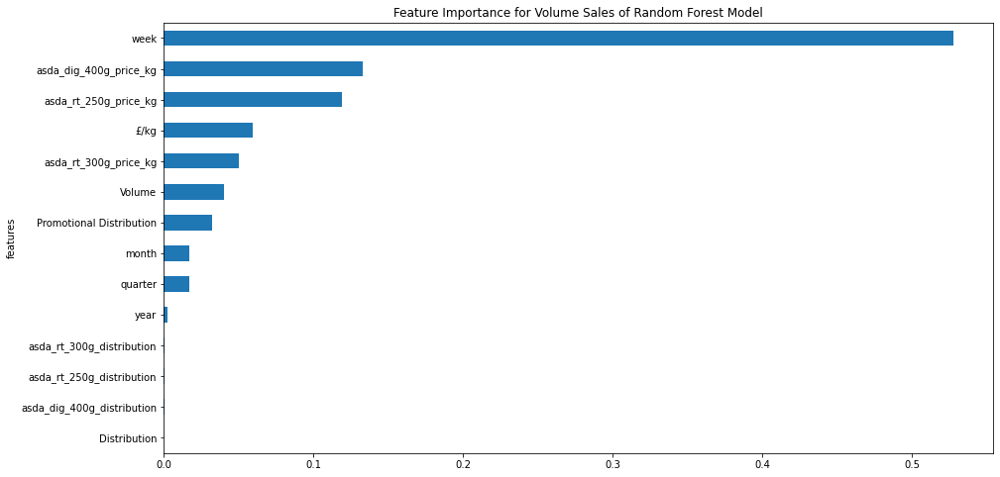

<Figure size 432x288 with 0 Axes>

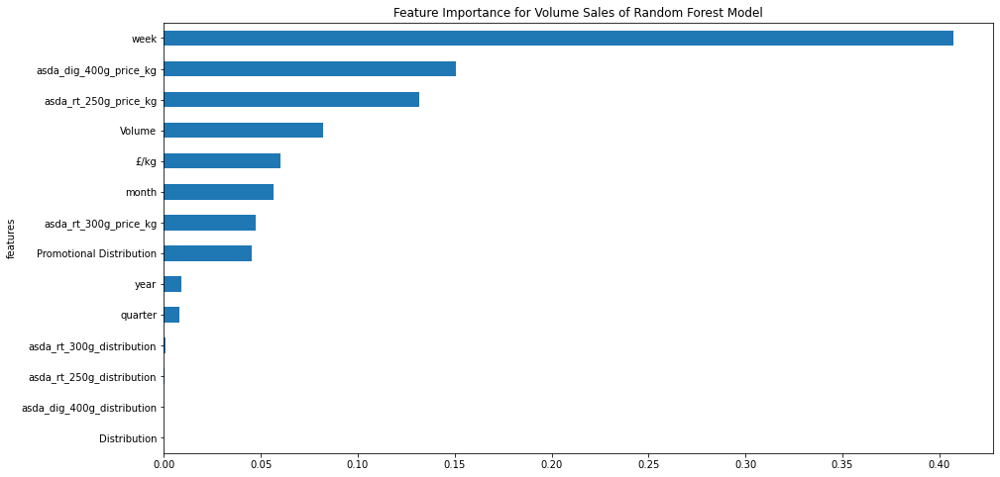

<Figure size 432x288 with 0 Axes>

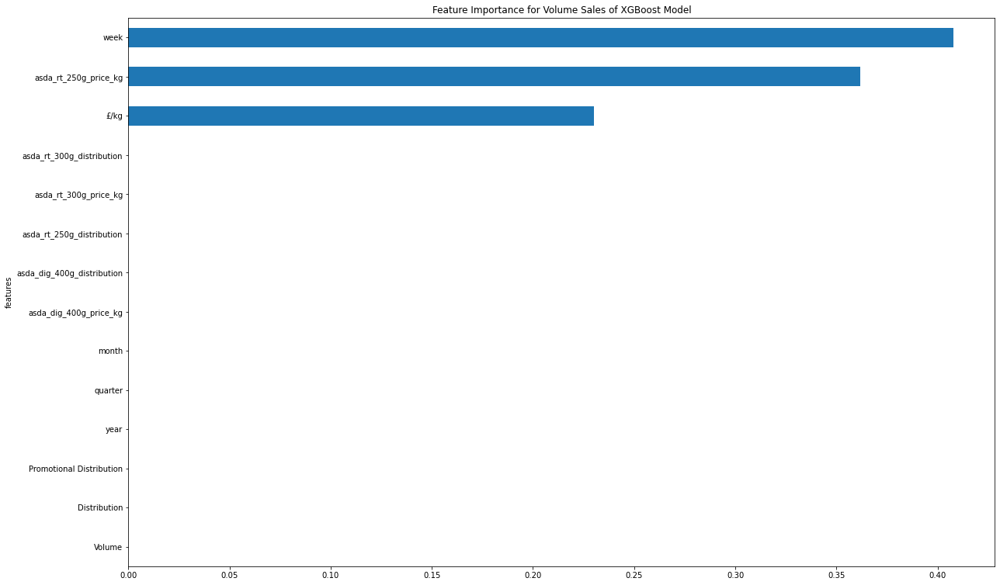

<Figure size 432x288 with 0 Axes>

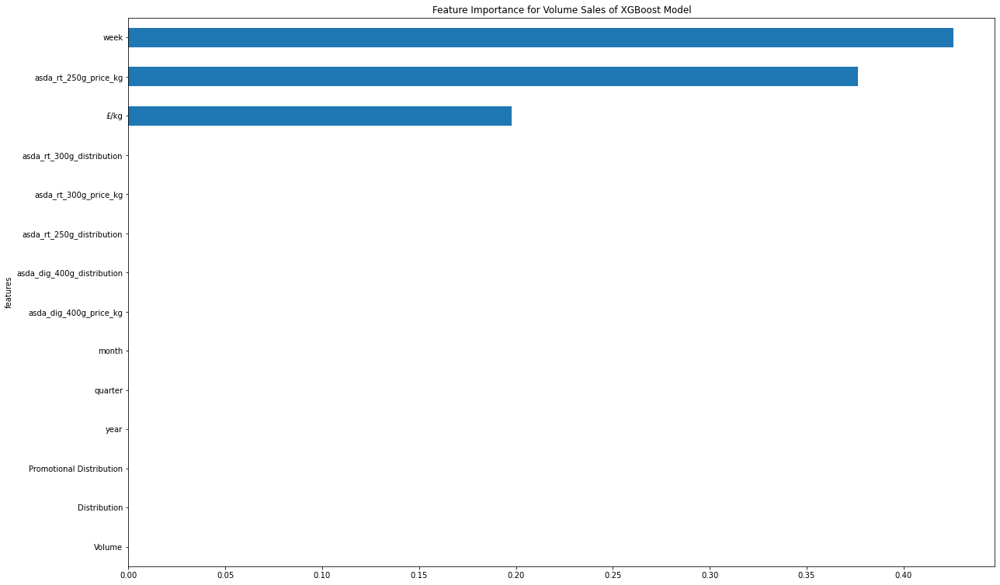

<Figure size 432x288 with 0 Axes>

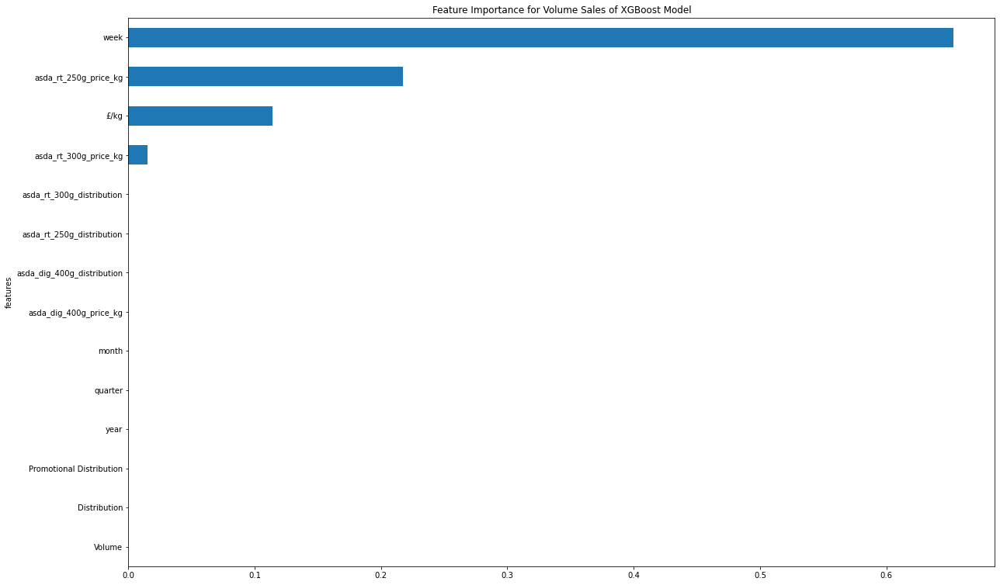

<Figure size 432x288 with 0 Axes>

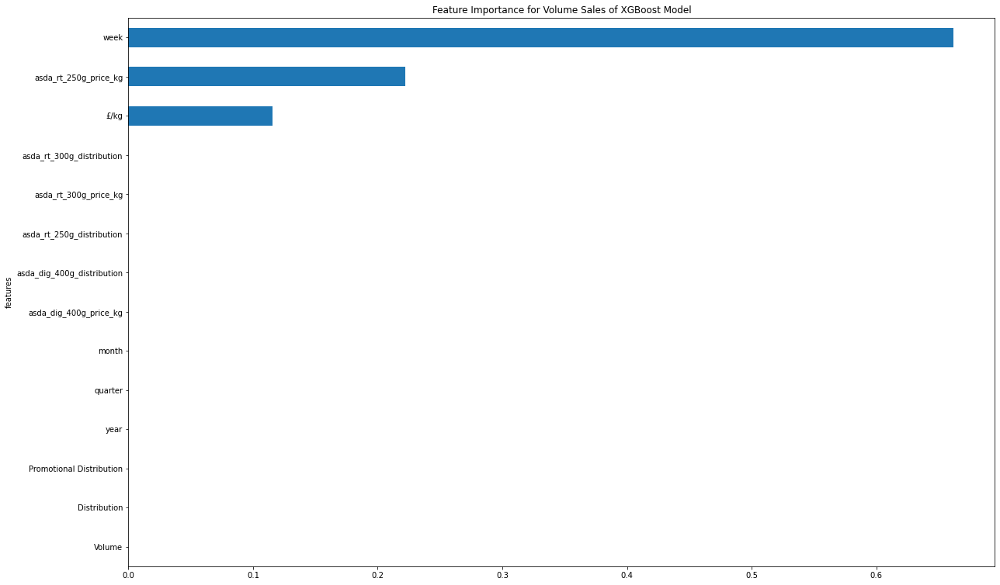

<Figure size 432x288 with 0 Axes>

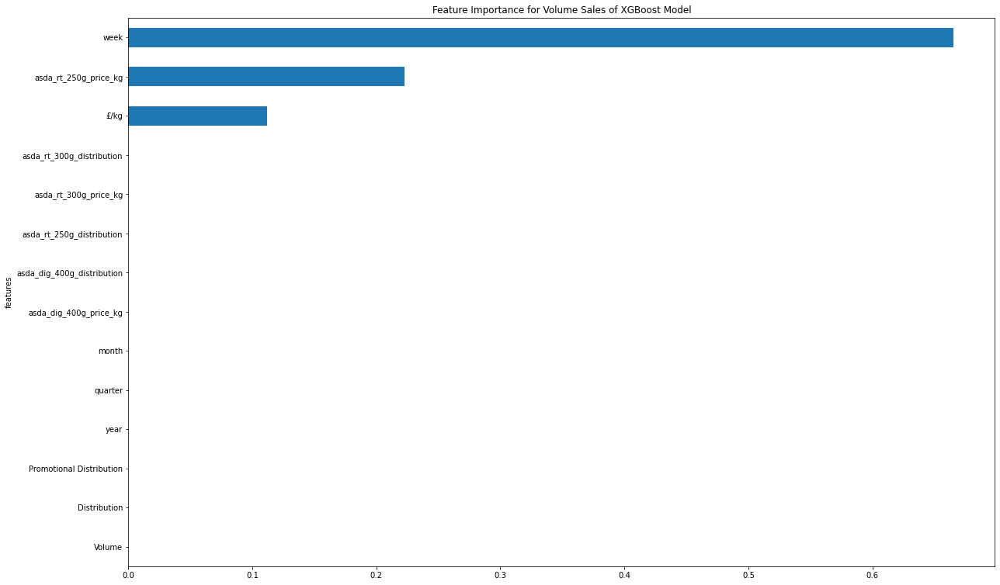

In [627]:
#machine learning models
mcv_rt_300g_asda_with_comp=variable_lag_mcv_asda(mcv_rt_300g_asda_with_comp)
mcv_rt_300g_asda_input_X,mcv_rt_300g_asda_input_Y=input_var_mcv_asda(mcv_rt_300g_asda_with_comp)
rf_regressor_mcv_asda(mcv_rt_300g_asda_input_X,mcv_rt_300g_asda_input_Y)

mcv_rt_300g_asda_input_X,mcv_rt_300g_asda_input_Y=input_var_mcv_asda(mcv_rt_300g_asda_with_comp)
xgb_regressor_mcv_asda(mcv_rt_300g_asda_input_X,mcv_rt_300g_asda_input_Y)


,var1(t-4),var1(t)
Date,,
2015-01-10,40945.0,31957.0
2015-01-17,43265.0,34705.0
2015-01-24,34195.0,37172.0
2015-01-31,26667.0,40222.0
2015-02-07,31957.0,43199.0
...,...,...
2020-02-15,33702.4,39277.6
2020-02-22,36274.4,38577.6
2020-02-29,35528.8,41269.6


   var1(t-4)   var1(t)
4   0.605222  0.448980
5   0.645552  0.496749
6   0.487884  0.539634
7   0.357021  0.592654
8   0.448980  0.644404
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 45s - loss: 0.4811 - val_loss: 0.4684
Epoch 2/50
216/216 - 0s - loss: 0.4696 - val_loss: 0.4569
Epoch 3/50
216/216 - 0s - loss: 0.4579 - val_loss: 0.4452
Epoch 4/50
216/216 - 0s - loss: 0.4461 - val_loss: 0.4331
Epoch 5/50
216/216 - 0s - loss: 0.4338 - val_loss: 0.4205
Epoch 6/50
216/216 - 0s - loss: 0.4210 - val_loss: 0.4073
Epoch 7/50
216/216 - 0s - loss: 0.4075 - val_loss: 0.3933
Epoch 8/50
216/216 - 0s - loss: 0.3931 - val_loss: 0.3783
Epoch 9/50
216/216 - 0s - loss: 0.3776 - val_loss: 0.3620
Epoch 10/50
216/216 - 0s - loss: 0.3608 - val_loss: 0.3444
Epoch 11/50
216/216 - 0s - loss: 0.3426 - val_loss: 0.3251
Epoch 12/50
216/216 - 0s - loss: 0.3229 - val_loss: 0.3041
Epoch 13/50
216/216 - 0s - loss: 0.3013 - val_loss: 0.2809
Epoch 14/50
216/216 - 

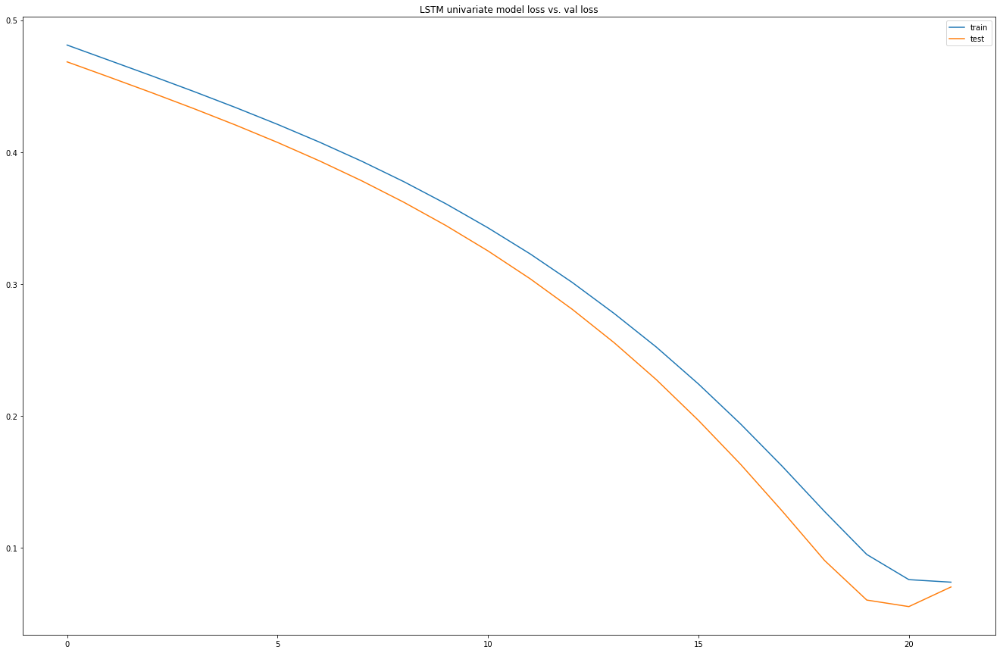

Test RMSE: 5536.295


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2015-01-10,12759.0,3.377584,100.0,11.0,2014.0,4.0,12.0,50.0,11498.4,3.266481,100,46,2015,1,1,2
2015-01-17,12251.4,3.367199,100.0,20.0,2014.0,4.0,12.0,51.0,12765.3,3.265478,100,62,2015,1,1,3
2015-01-24,9398.7,3.351953,99.0,20.0,2014.0,4.0,12.0,52.0,16037.7,3.265955,100,59,2015,1,1,4
2015-01-31,8561.1,3.346755,100.0,30.0,2015.0,1.0,1.0,1.0,17237.7,3.265320,100,73,2015,1,1,5
2015-02-07,11498.4,3.266481,100.0,46.0,2015.0,1.0,1.0,2.0,16684.8,3.264702,100,86,2015,1,2,6
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,9998.1,3.331923,100.0,0.0,2020.0,1.0,1.0,3.0,9468.3,3.741083,100,0,2020,1,2,7
2020-02-22,10024.5,3.330570,100.0,0.0,2020.0,1.0,1.0,4.0,8893.8,3.955396,100,0,2020,1,2,8
2020-02-29,11180.7,3.323531,100.0,0.0,2020.0,1.0,2.0,5.0,9563.7,3.958416,100,0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.346451   0.531161        1.0       0.11   0.000000        1.0   
5   0.321735   0.522778        1.0       0.20   0.000000        1.0   
6   0.182830   0.510472        0.0       0.20   0.000000        1.0   
7   0.142045   0.506275        1.0       0.30   0.166656        0.0   
8   0.285069   0.441479        1.0       0.46   0.166656        0.0   

   var7(t-4)  var8(t-4)   var1(t)  
4        1.0   0.942308  0.285069  
5        1.0   0.961538  0.346758  
6        1.0   0.980769  0.506099  
7        0.0   0.000000  0.564530  
8        0.0   0.019231  0.537608  
(216, 1, 8) (216,) (55, 1, 8) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 45s - loss: 0.3786 - val_loss: 0.2271
Epoch 2/50
216/216 - 0s - loss: 0.3537 - val_loss: 0.2014
Epoch 3/50
216/216 - 0s - loss: 0.3278 - val_loss: 0.1754
Epoch 4/50
216/216 - 0s - loss: 0.2998 - val_loss: 0.1476
Epoch 5/50
216/216 - 0s - loss: 0.2691 - va

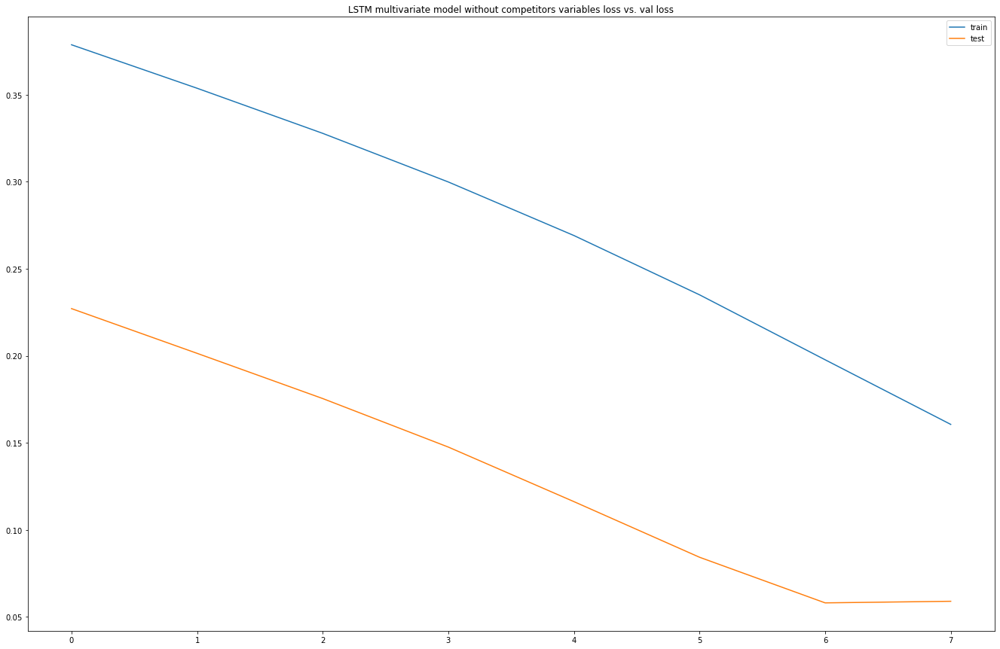

Test RMSE: 1722.182


In [628]:
series_to_supervised(mcv_rt_300g_asda_volume)
lstm_univariate(mcv_rt_300g_asda_volume)

series_to_supervised(mcv_rt_300g_asda_own_variable)
multivariate_lstm_without_competitor(mcv_rt_300g_asda_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var6(t),var7(t),var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-11-25,11929.8,2017.0,4.0,10.0,43.0,14183.7,3.317040,100.0,0.0,1.124957,...,11929.8,3.327491,100.0,0.0,1.008029,100.0,2.248666,100.0,1.000000,100.0
2017-12-02,12200.4,2017.0,4.0,11.0,44.0,12827.1,3.328819,100.0,0.0,1.125051,...,12200.4,3.325498,100.0,0.0,0.876991,100.0,2.247627,100.0,1.000028,100.0
2017-12-09,12039.6,2017.0,4.0,11.0,45.0,12265.8,3.328735,100.0,0.0,1.125064,...,12039.6,3.330941,100.0,0.0,0.874811,100.0,2.243993,100.0,1.000084,100.0
2017-12-16,12022.8,2017.0,4.0,11.0,46.0,12589.5,3.310259,100.0,0.0,1.124475,...,12022.8,3.328709,100.0,0.0,0.874597,100.0,2.230360,100.0,1.000035,100.0
2017-12-23,12342.9,2017.0,4.0,11.0,47.0,11929.8,3.327491,100.0,0.0,1.008029,...,12342.9,3.325369,100.0,3.0,0.874568,100.0,2.224007,100.0,0.999994,100.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,9998.1,2020.0,1.0,1.0,3.0,10509.0,3.332011,100.0,0.0,0.824959,...,9998.1,3.331923,100.0,0.0,0.825001,100.0,2.249541,98.0,1.000011,99.0
2020-02-22,10024.5,2020.0,1.0,1.0,4.0,6941.4,3.331893,100.0,0.0,0.825002,...,10024.5,3.330570,100.0,0.0,0.825001,100.0,2.249202,98.0,1.000083,99.0
2020-02-29,11180.7,2020.0,1.0,2.0,5.0,7500.3,3.330573,99.0,0.0,0.824996,...,11180.7,3.323531,100.0,0.0,0.825017,100.0,2.249350,98.0,1.000065,99.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.708901        0.0        1.0   0.818182   0.823529   0.963088   
5   0.739419        0.0        1.0   0.909091   0.843137   0.810096   
6   0.721284        0.0        1.0   0.909091   0.862745   0.746794   
7   0.719390        0.0        1.0   0.909091   0.882353   0.783300   
8   0.755490        0.0        1.0   0.909091   0.901961   0.708901   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.202038        1.0        0.0    0.999645         1.0    0.949654   
5   0.224205        1.0        0.0    0.999957         1.0    0.969273   
6   0.224046        1.0        0.0    1.000000         1.0    0.951181   
7   0.189277        1.0        0.0    0.998047         1.0    0.946747   
8   0.221704        1.0        0.0    0.611814         1.0    0.977436   

   var13(t-4)  var14(t-4)  var15(t-4)   var1(t)  
4         1.0    0.811188    0.000000  0.755490  
5         1.0    0.809052   

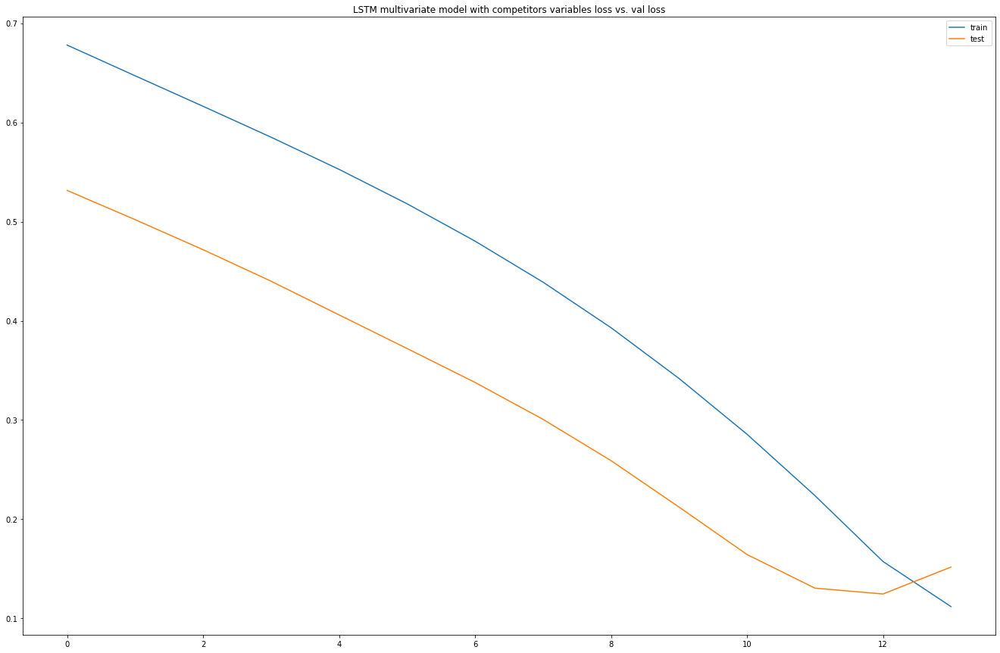

Test RMSE: 1826.200


In [629]:
series_to_supervised(mcv_rt_300g_asda_with_comp)
multivariate_with_competitor_mcv_asda(mcv_rt_300g_asda_with_comp)

## Asda -  Asda Digestives 400g (Competitor)

In [630]:
# asda_dig_400g_origin=asda_product[4]
# asda_rt_250g_origin=asda_product[5]
# asda_rt_300g_origin=asda_product[6]


,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
124,2017-04-29,60270.0,24108.0,27121.5,100.0,0.0,0.450000,1.125000,2017,2,4,17
125,2017-05-06,57789.0,23115.6,26005.4,100.0,0.0,0.450006,1.125015,2017,2,5,18
126,2017-05-13,59433.0,23773.2,26746.0,100.0,0.0,0.450019,1.125048,2017,2,5,19
127,2017-05-20,61319.0,24527.6,27594.7,100.0,0.0,0.450019,1.125047,2017,2,5,20
128,2017-05-27,57549.0,23019.6,25900.7,100.0,0.0,0.450063,1.125159,2017,2,5,21


(151, 12)

Date                        datetime64[ns]
Units                              float64
Volume                             float64
Value                              float64
Distribution                       float64
Promotional Distribution           float64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000
mean,81018.337748,32407.335099,28149.958940,99.993377,8.165563,0.353056,0.882641,2018.251656,2.536424,6.662252,26.913907
std,15512.201558,6204.880623,4048.840645,0.081379,25.439714,0.045112,0.112781,0.903464,1.124128,3.473495,15.126551
min,37759.000000,15103.600000,12449.200000,99.000000,0.000000,0.329429,0.823573,2017.000000,1.000000,1.000000,1.000000
25%,72728.500000,29091.400000,26265.100000,100.000000,0.000000,0.329997,0.824992,2018.000000,2.000000,4.000000,14.000000
50%,85645.000000,34258.000000,28524.000000,100.000000,0.000000,0.330015,0.825037,2018.000000,3.000000,7.000000,27.000000
75%,91328.000000,36531.200000,30713.600000,100.000000,0.000000,0.349919,0.874797,2019.000000,4.000000,10.000000,40.000000
95%,101432.000000,40572.800000,33478.700000,100.000000,99.000000,0.450019,1.125048,2020.000000,4.000000,12.000000,50.000000
99%,109790.500000,43916.200000,37205.300000,100.000000,100.000000,0.450035,1.125088,2020.000000,4.000000,12.000000,52.000000
max,119048.000000,47619.200000,39601.800000,100.000000,100.000000,0.450063,1.125159,2020.000000,4.000000,12.000000,52.000000


Dataset has: 151rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

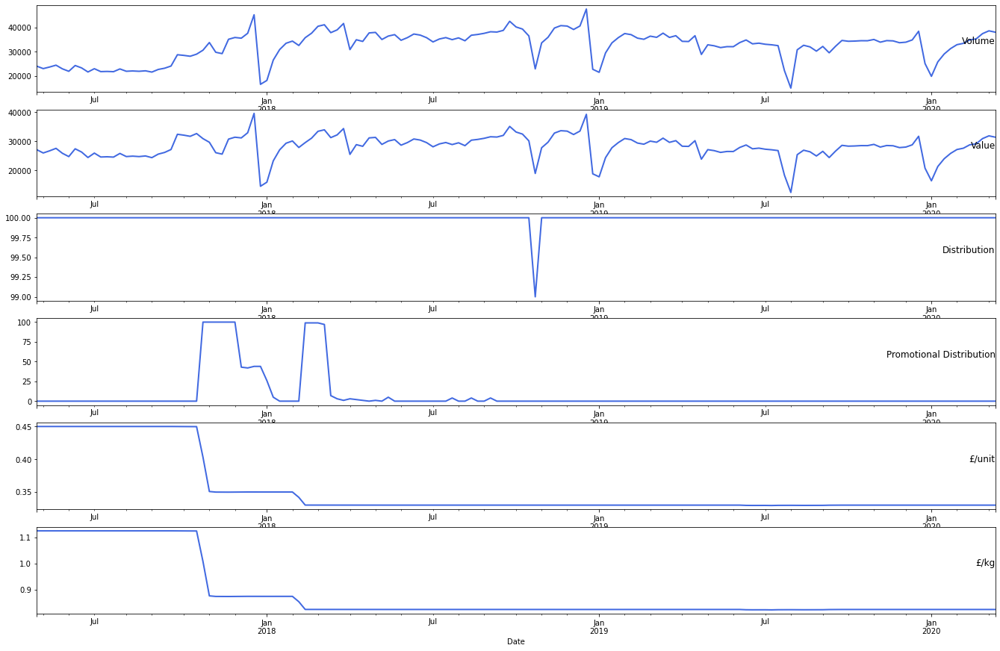

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f5312f21fd0>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5312afd588>)

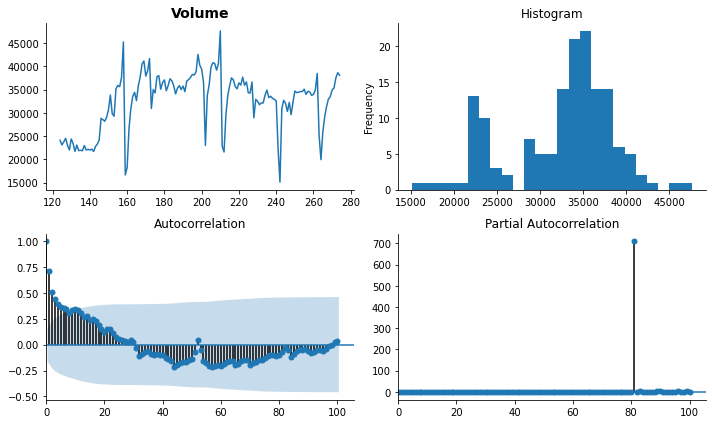

In [631]:
#asda own-labelled products
basic_info(asda_dig_400g_origin)
plot_data(asda_dig_400g_origin)
tsplot(asda_dig_400g_origin['Volume'].dropna(), title=asda_dig_400g_origin.columns[2], lags=100)


Test Statistic                  -4.993497
p-value                          0.000023
#Lags Used                       0.000000
Number of Observations Used    150.000000
Critical Value (1%)             -3.474715
Critical Value (5%)             -2.881009
Critical Value (10%)            -2.577151
dtype: float64


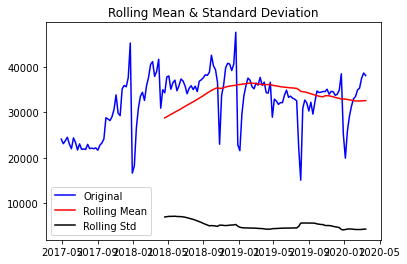

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f53129ab278>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53128529e8>)

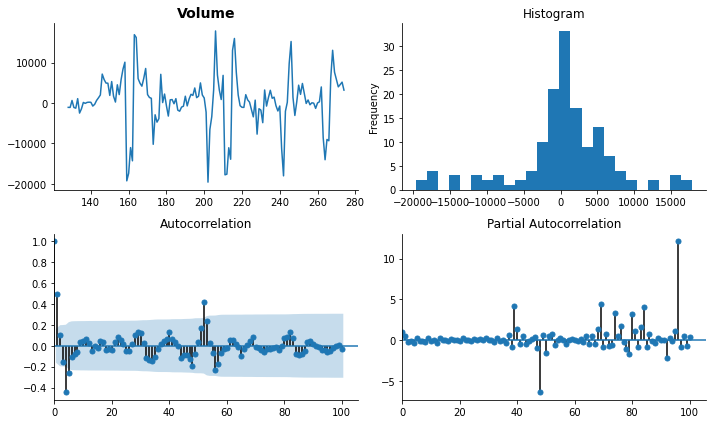

In [632]:
plot(asda_dig_400g_origin)
series_transformed=asda_dig_400g_origin.copy()
series_transformed['Volume_transformed']=asda_dig_400g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=asda_dig_400g_origin.columns[2], lags=100)


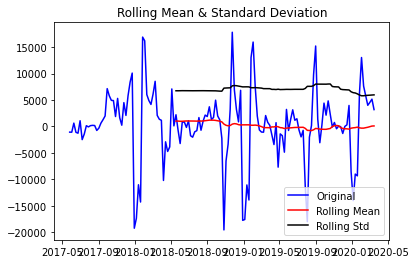

Results of Dickey-Fuller Test:
Test Statistic                  -4.033401
p-value                          0.001245
#Lags Used                      12.000000
Number of Observations Used    134.000000
Critical Value (1%)             -3.480119
Critical Value (5%)             -2.883362
Critical Value (10%)            -2.578407
dtype: float64


In [633]:
plot_transform(asda_dig_400g_origin)

       t-4      t+1
0      NaN  33734.0
1      NaN  35125.5
2      NaN  30400.0
3      NaN  22537.0
4  33734.0  28677.5
Test MSE: 4950236.902
Test RMSE: 2224.913


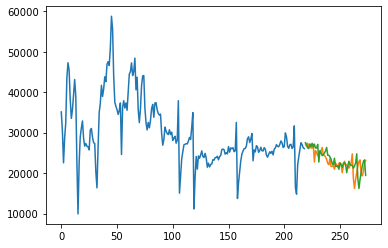

Observations: 271
Training Observations: 216
Testing Observations: 55


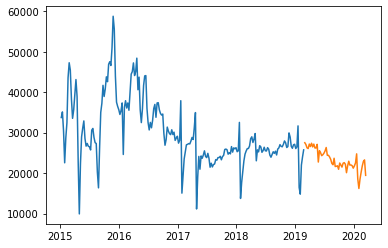

RMSE for Simple Exponential Smoothing α= 0.1 is: 2879.23
RMSE for Simple Exponential Smoothing α= 0.2 is: 2558.73
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 2527.56
RMSE for Simple Exponential Smoothing α= 0.4 is: 2535.11
RMSE for Simple Exponential Smoothing α= 0.5 is: 2595.52
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 2742.16
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 2946.28
RMSE for Simple Exponential Smoothing α= 0.8 is: 3153.21
RMSE for Simple Exponential Smoothing α= 0.9 is: 3326.31


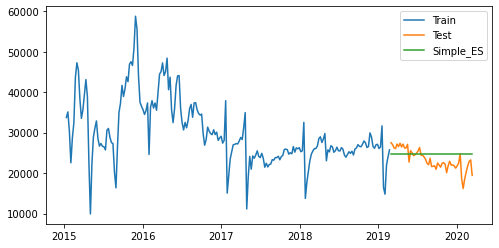

Observations: 271
Training Observations: 216
Testing Observations: 55
Min RMSE for Holt Linear Forecasting α= 0.6000000000000001 and β= 0.1 is: 2026.92


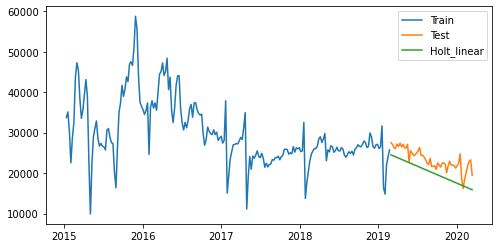

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

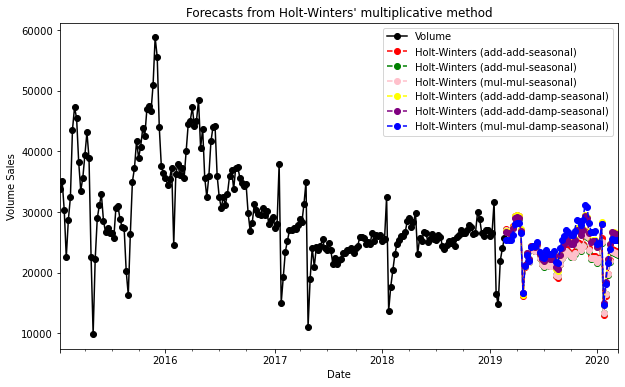

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
2970.822194902957
2791.0717792719875
2804.094346140534
3797.2117713056637
3654.164258700454
4153.692218249149


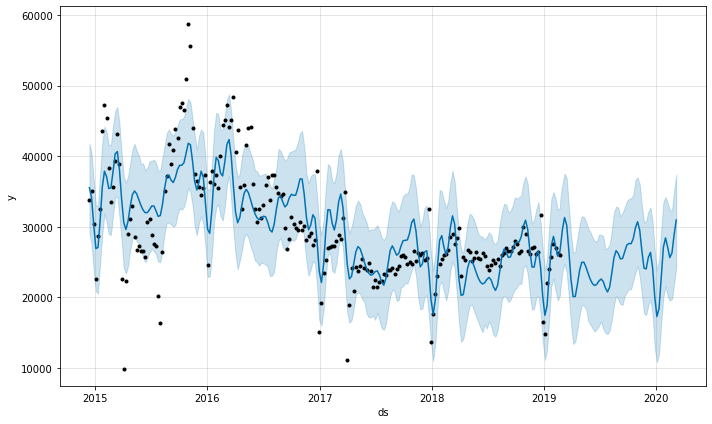

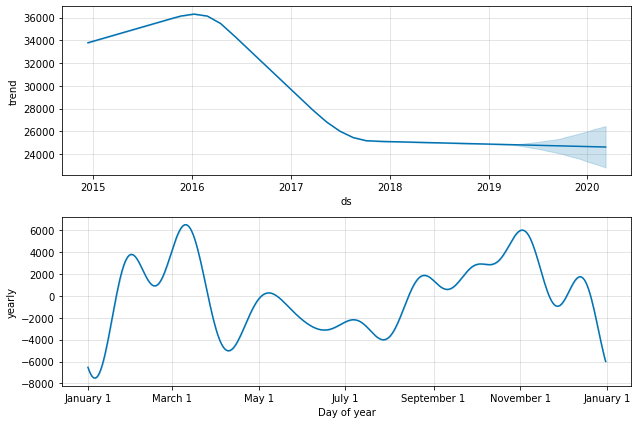

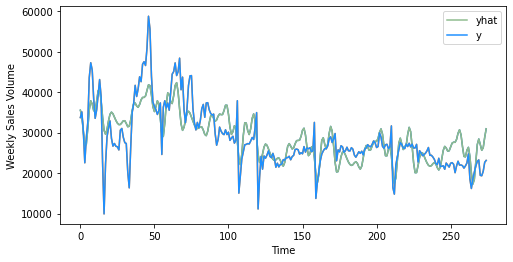

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for prophet model is: 4820.905647014377
0                                        New Year's Day
1                           New Year Holiday [Scotland]
2                New Year Holiday [Scotland] (Observed)
3                  St. Patrick's Day [Northern Ireland]
4                                           Good Friday
5      Easter Monday [England, Wales, Northern Ireland]
6                                               May Day
7                                   Spring Bank Holiday
8                Battle of the Boyne [Northern Ireland]
9                        Summer Bank Holiday [Scotland]
10    Late Summer Bank Holiday [England, Wales, Nort...
11                          St. Andrew's Day [Scotland]
12                                        Christmas Day
13                             Christmas Day (Observed)
14                                           Boxing Day
15    New Year Holiday [Scotland], New Year's Day (O...
16      St. Patrick's Day [Northern Ireland] (Observed)
17 

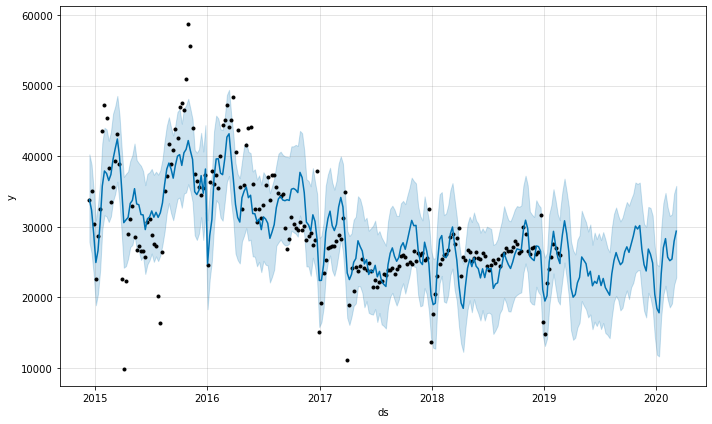

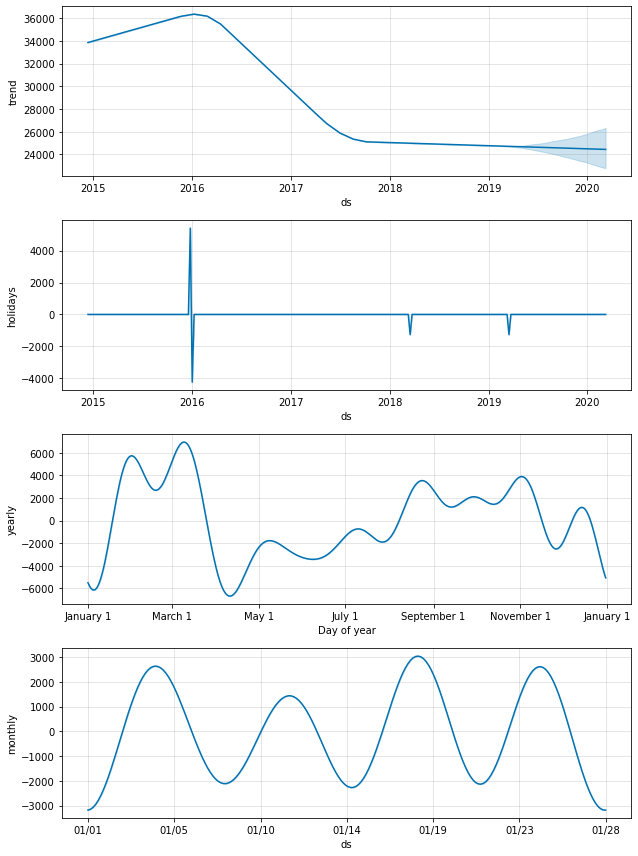

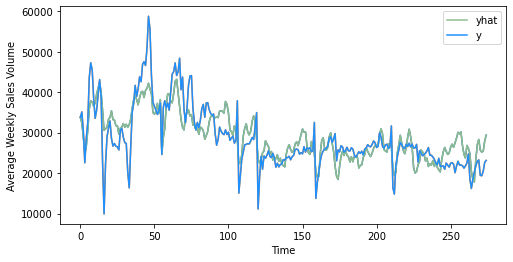

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:54: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

RMSE for prophet with all holidays is: 4695.882867095814


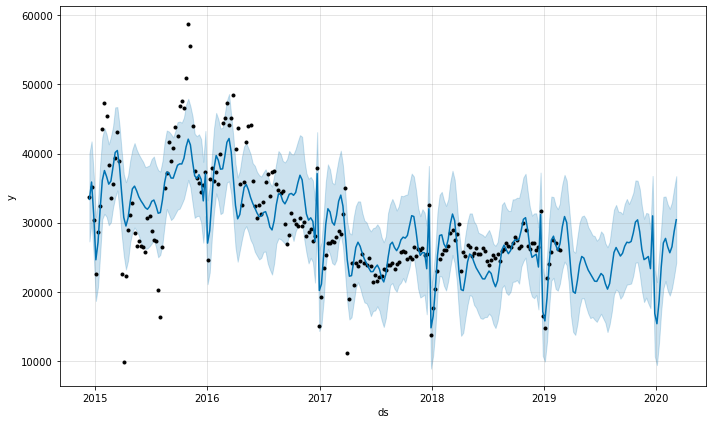

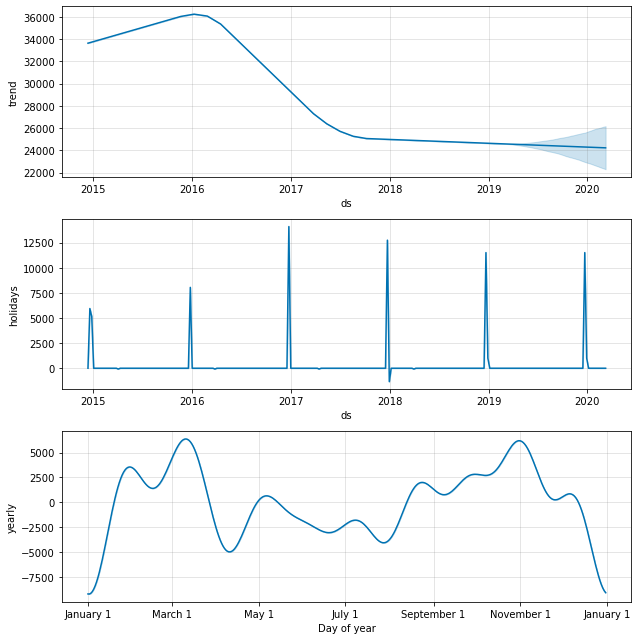

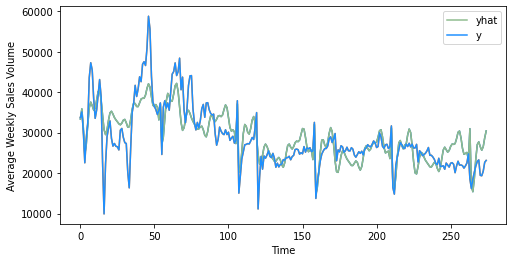

RMSE for prophet with only Christmas and Easter week is: 4670.83713843974


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:51: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:52: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/ipykernel/__main__.py:53: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the docu

In [634]:
#time series models
baseline_model(mcv_dig_400g_asda_origin)
ses_model(mcv_dig_400g_asda_origin)
holt_linear_model(mcv_dig_400g_asda_origin)
holt_winter_model(mcv_dig_400g_asda_origin)
prophet_model(mcv_dig_400g_asda_origin)
prophet_all_holidays(mcv_dig_400g_asda_origin)
prophet_two_holiday(mcv_dig_400g_asda_origin)


<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_dig_400g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin_asda')

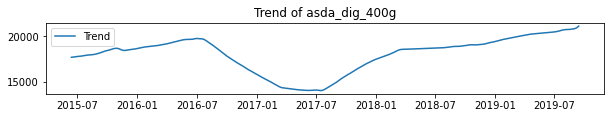

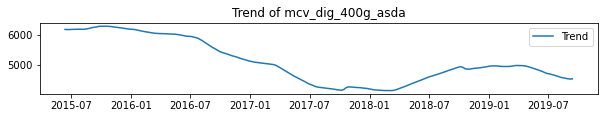

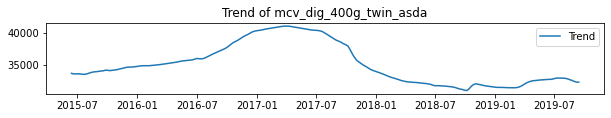

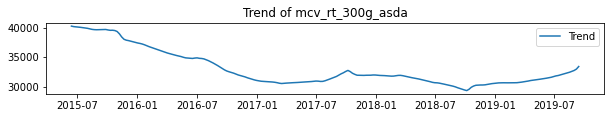

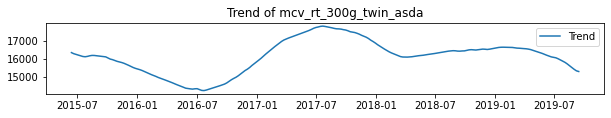

In [635]:
asda_dig_400g_competitor=[asda_dig_400g_volume,mcv_dig_400g_asda_volume,mcv_dig_400g_twin_asda_volume,mcv_rt_300g_asda_volume,mcv_rt_300g_twin_asda_volume]
asda_dig_400g_competitor_list=['asda_dig_400g','mcv_dig_400g_asda','mcv_dig_400g_twin_asda','mcv_rt_300g_asda','mcv_rt_300g_twin_asda']
asda_rt_250g_competitor=[asda_rt_250g_volume,mcv_dig_400g_asda_volume,mcv_dig_400g_twin_asda_volume,mcv_rt_300g_asda_volume,mcv_rt_300g_twin_asda_volume]
asda_rt_250g_competitor_list=['asda_rt_250g','mcv_dig_400g_asda','mcv_dig_400g_twin_asda','mcv_rt_300g_asda','mcv_rt_300g_twin_asda']
asda_rt_300g_competitor=[asda_rt_300g_volume,mcv_dig_400g_asda_volume,mcv_dig_400g_twin_asda_volume,mcv_rt_300g_asda_volume,mcv_rt_300g_twin_asda_volume]
asda_rt_300g_competitor_list=['asda_rt_300g','mcv_dig_400g_asda','mcv_dig_400g_twin_asda','mcv_rt_300g_asda','mcv_rt_300g_twin_asda']


i=0
for product in asda_dig_400g_competitor:
    decomposition=seasonal_decompose(product)
    trend_1=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_1, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + asda_dig_400g_competitor_list[i] )
    i=i+1

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of asda_rt_250g')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_dig_400g_twin_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_asda')

<Figure size 720x432 with 0 Axes>

Text(0.5, 1.0, 'Trend of mcv_rt_300g_twin_asda')

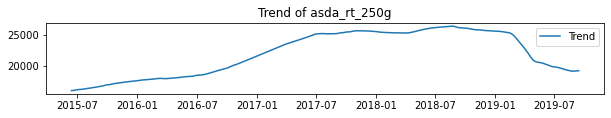

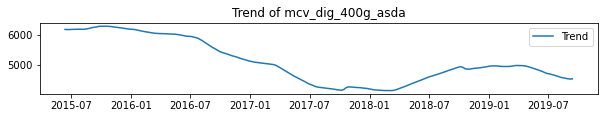

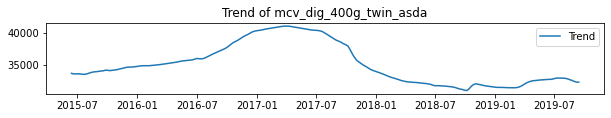

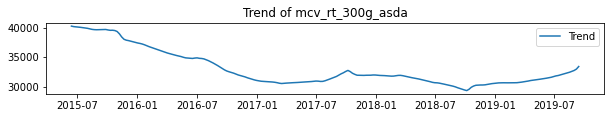

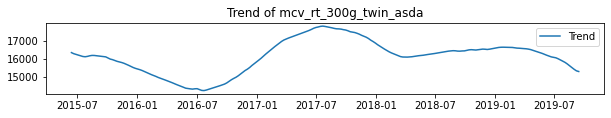

In [636]:
i=0
for product in asda_rt_250g_competitor:
    decomposition=seasonal_decompose(product)
    trend_2=decomposition.trend

    plt.figure(figsize=(10,6))
    plt.subplot(412)
    plt.plot(trend_2, label='Trend')
    plt.legend(loc='best')
    plt.title('Trend of ' + asda_rt_250g_competitor_list[i])
    i=i+1

In [637]:
# #asda rt 300g does not have enough data points to plot trend
# i=0
# for product in asda_rt_300g_competitor:
#     decomposition=seasonal_decompose(product)
#     trend_3=decomposition.trend

#     plt.figure(figsize=(10,6))
#     plt.subplot(412)
#     plt.plot(trend_3, label='Trend')
#     plt.legend(loc='best')
#     plt.title('Trend of ' + asda_rt_300g_competitor_list[i])
#     i=i+1

In [638]:
decomposition_1=seasonal_decompose(asda_dig_400g_volume)
trend_1=decomposition_1.trend
trend_1=trend_1.to_frame()

comp_decomposition_1=seasonal_decompose(mcv_dig_400g_asda_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(mcv_dig_400g_twin_asda_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(mcv_rt_300g_asda_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(mcv_rt_300g_twin_asda_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

asda_dig_400g_comp=pd.merge(trend_1,comp_trend1, how='left', on='Date')
asda_dig_400g_comp=pd.merge(asda_dig_400g_comp,comp_trend2, how='left', on='Date')
asda_dig_400g_comp=pd.merge(asda_dig_400g_comp,comp_trend3, how='left', on='Date')
asda_dig_400g_comp=pd.merge(asda_dig_400g_comp,comp_trend4, how='left', on='Date')
asda_dig_400g_comp.columns=['asda_dig_400g_trend', 'mcv_dig_400g_asda_trend','mcv_dig_400g_twin_asda_trend','mcv_rt_300g_asda_trend','mcv_rt_300g_twin_asda_trend']

asda_dig_400g_comp.corr()


,asda_dig_400g_trend,mcv_dig_400g_asda_trend,mcv_dig_400g_twin_asda_trend,mcv_rt_300g_asda_trend,mcv_rt_300g_twin_asda_trend
asda_dig_400g_trend,1.000000,0.284689,-0.833973,0.183894,-0.563714
mcv_dig_400g_asda_trend,0.284689,1.000000,-0.000553,0.815187,-0.665818
mcv_dig_400g_twin_asda_trend,-0.833973,-0.000553,1.000000,-0.057685,0.122796
mcv_rt_300g_asda_trend,0.183894,0.815187,-0.057685,1.000000,-0.426095
mcv_rt_300g_twin_asda_trend,-0.563714,-0.665818,0.122796,-0.426095,1.000000


In [639]:
decomposition_2=seasonal_decompose(asda_rt_250g_volume)
trend_2=decomposition_2.trend
trend_2=trend_2.to_frame()

comp_decomposition_1=seasonal_decompose(mcv_dig_400g_asda_volume)
comp_trend1=comp_decomposition_1.trend
comp_trend1=comp_trend1.to_frame()

comp_decomposition_2=seasonal_decompose(mcv_dig_400g_twin_asda_volume)
comp_trend2=comp_decomposition_2.trend
comp_trend2=comp_trend2.to_frame()

comp_decomposition_3=seasonal_decompose(mcv_rt_300g_asda_volume)
comp_trend3=comp_decomposition_3.trend
comp_trend3=comp_trend3.to_frame()

comp_decomposition_4=seasonal_decompose(mcv_rt_300g_twin_asda_volume)
comp_trend4=comp_decomposition_4.trend
comp_trend4=comp_trend4.to_frame()

asda_rt_250g_comp=pd.merge(trend_2,comp_trend1, how='left', on='Date')
asda_rt_250g_comp=pd.merge(asda_rt_250g_comp,comp_trend2, how='left', on='Date')
asda_rt_250g_comp=pd.merge(asda_rt_250g_comp,comp_trend3, how='left', on='Date')
asda_rt_250g_comp=pd.merge(asda_rt_250g_comp,comp_trend4, how='left', on='Date')
asda_rt_250g_comp.columns=['asda_rt_250g_trend', 'mcv_dig_400g_asda_trend','mcv_dig_400g_twin_asda_trend','mcv_rt_300g_asda_trend','mcv_rt_300g_twin_asda_trend']

asda_rt_250g_comp.corr()


,asda_rt_250g_trend,mcv_dig_400g_asda_trend,mcv_dig_400g_twin_asda_trend,mcv_rt_300g_asda_trend,mcv_rt_300g_twin_asda_trend
asda_rt_250g_trend,1.000000,-0.866579,-0.079756,-0.838641,0.675009
mcv_dig_400g_asda_trend,-0.866579,1.000000,-0.000553,0.815187,-0.665818
mcv_dig_400g_twin_asda_trend,-0.079756,-0.000553,1.000000,-0.057685,0.122796
mcv_rt_300g_asda_trend,-0.838641,0.815187,-0.057685,1.000000,-0.426095
mcv_rt_300g_twin_asda_trend,0.675009,-0.665818,0.122796,-0.426095,1.000000


In [640]:
# decomposition_3=seasonal_decompose(asda_rt_300g_volume)
# trend_3=decomposition_3.trend
# trend_3=trend_3.to_frame()

# comp_decomposition_1=seasonal_decompose(mcv_dig_400g_asda_volume)
# comp_trend1=comp_decomposition_1.trend
# comp_trend1=comp_trend1.to_frame()

# comp_decomposition_2=seasonal_decompose(mcv_dig_400g_twin_asda_volume)
# comp_trend2=comp_decomposition_2.trend
# comp_trend2=comp_trend2.to_frame()

# comp_decomposition_3=seasonal_decompose(mcv_rt_300g_asda_volume)
# comp_trend3=comp_decomposition_3.trend
# comp_trend3=comp_trend3.to_frame()

# comp_decomposition_4=seasonal_decompose(mcv_rt_300g_twin_asda_volume)
# comp_trend4=comp_decomposition_4.trend
# comp_trend4=comp_trend4.to_frame()

# asda_rt_300g_comp=pd.merge(trend_3,comp_trend1, how='left', on='Date')
# asda_rt_300g_comp=pd.merge(asda_rt_300g_comp,comp_trend2, how='left', on='Date')
# asda_rt_300g_comp=pd.merge(asda_rt_300g_comp,comp_trend3, how='left', on='Date')
# asda_rt_300g_comp=pd.merge(asda_rt_300g_comp,comp_trend4, how='left', on='Date')
# asda_rt_300g_comp.columns=['mcv_dig_400g_twin_trend', 'mcv_dig_400g_asda_trend','mcv_dig_400g_twin_asda_trend','mcv_rt_300g_asda_trend','mcv_rt_300g_twin_asda_trend']

# asda_rt_300g_comp.corr()


## Machine Learning Models

In [114]:
#extract own product variables: sales price distribution promotional week month quarter
def own_product_variables(x):
#     x=x[:275]
#     date_time = x['SDESC'].str[3:]
#     date_time=pd.to_datetime(date_time, format='%d.%m.%y')
#     x['SDESC']=date_time
#     x.rename(columns={'SDESC':'Date'}, inplace=True)
    x=x.set_index('Date')
    x=x[['Volume','£/kg','Distribution','Promotional Distribution','year','quarter','month','week']]
    return x

asda_dig_400g_own_variable=own_product_variables(asda_dig_400g_origin)
asda_rt_250g_own_variable=own_product_variables(asda_rt_250g_origin)
asda_rt_300g_own_variable=own_product_variables(asda_rt_300g_origin)


In [115]:
asda_dig_400g_with_comp_1=asda_dig_400g_own_variable
asda_rt_250g_with_comp_1=asda_rt_250g_own_variable
asda_rt_300g_with_comp_1=asda_rt_300g_own_variable


In [116]:
def comp_variables(x):
    x=x.set_index('Date')
#     x=x.dropna(subset=['Volume'])
    x=x[['£/kg','Distribution']]
    return x

mcv_dig_400g_asda_price_dis=comp_variables(mcv_dig_400g_asda_origin)
mcv_dig_400g_twin_asda_price_dis=comp_variables(mcv_dig_400g_twin_asda_origin)
mcv_rt_300g_asda_price_dis=comp_variables(mcv_rt_300g_asda_origin)
mcv_rt_300g_twin_asda_price_dis=comp_variables(mcv_rt_300g_twin_asda_origin)


In [117]:
# compose competitors' variables as a list
competitor_list=[mcv_dig_400g_asda_price_dis, mcv_dig_400g_twin_asda_price_dis, mcv_rt_300g_asda_price_dis, mcv_rt_300g_twin_asda_price_dis]

variable_columns=['Volume','£/kg','Distribution','Promotional Distribution',
                  'year','quarter','month','week',
                   'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
                   'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
                   'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
                   'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution'
                  ]

In [118]:
# each variable with their competitors
# merge own product variables with four competitors' variables
for variable in competitor_list:
    asda_dig_400g_with_comp_1=asda_dig_400g_with_comp_1.merge(variable, how='left', on='Date')
    asda_dig_400g_with_comp=asda_dig_400g_with_comp_1
    
#drop all missing values
asda_dig_400g_with_comp.columns=variable_columns
asda_dig_400g_with_comp=asda_dig_400g_with_comp.dropna()
asda_dig_400g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_400g_asda_price_kg,mcv_dig_400g_asda_distribution,mcv_dig_400g_twin_asda_price_kg,mcv_dig_400g_twin_asda_distribution,mcv_rt_300g_asda_price_kg,mcv_rt_300g_asda_distribution,mcv_rt_300g_twin_asda_price_kg,mcv_rt_300g_twin_asda_distribution
Date,,,,,,,,,,,,,,,,
2017-04-29,24108.0,1.125000,100.0,0.0,2017,2,4,17,2.499055,100,2.486059,94,3.332553,100,3.149656,94
2017-05-06,23115.6,1.125015,100.0,0.0,2017,2,5,18,2.498982,100,2.486049,94,3.332633,100,3.149193,94
2017-05-13,23773.2,1.125048,100.0,0.0,2017,2,5,19,2.498393,100,2.486099,94,3.330996,100,3.149309,94
2017-05-20,24527.6,1.125047,100.0,0.0,2017,2,5,20,2.499553,100,2.486854,94,3.332933,100,3.149276,94
2017-05-27,23019.6,1.125159,100.0,0.0,2017,2,5,21,2.499631,100,2.486928,94,3.333035,100,3.149897,94


In [119]:
for variable in competitor_list:
    asda_rt_250g_with_comp_1=asda_rt_250g_with_comp_1.merge(variable, how='left', on='Date')
    asda_rt_250g_with_comp=asda_rt_250g_with_comp_1
    
asda_rt_250g_with_comp.columns=variable_columns
asda_rt_250g_with_comp=asda_rt_250g_with_comp.dropna()
asda_rt_250g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_400g_asda_price_kg,mcv_dig_400g_asda_distribution,mcv_dig_400g_twin_asda_price_kg,mcv_dig_400g_twin_asda_distribution,mcv_rt_300g_asda_price_kg,mcv_rt_300g_asda_distribution,mcv_rt_300g_twin_asda_price_kg,mcv_rt_300g_twin_asda_distribution
Date,,,,,,,,,,,,,,,,
2017-04-29,5600.8,2.249893,100.0,0.0,2017,2,4,17,2.499055,100,2.486059,94,3.332553,100,3.149656,94
2017-05-06,5453.6,2.250000,100.0,0.0,2017,2,5,18,2.498982,100,2.486049,94,3.332633,100,3.149193,94
2017-05-13,5555.0,2.250009,100.0,0.0,2017,2,5,19,2.498393,100,2.486099,94,3.330996,100,3.149309,94
2017-05-20,5656.8,2.250000,100.0,0.0,2017,2,5,20,2.499553,100,2.486854,94,3.332933,100,3.149276,94
2017-05-27,5226.0,2.250000,100.0,0.0,2017,2,5,21,2.499631,100,2.486928,94,3.333035,100,3.149897,94


In [120]:
for variable in competitor_list:
    asda_rt_300g_with_comp_1=asda_rt_300g_with_comp_1.merge(variable, how='left', on='Date')
    asda_rt_300g_with_comp=asda_rt_300g_with_comp_1
    
asda_rt_300g_with_comp.columns=variable_columns
asda_rt_300g_with_comp=asda_rt_300g_with_comp.dropna()
asda_rt_300g_with_comp.head()


,Volume,£/kg,Distribution,Promotional Distribution,year,quarter,month,week,mcv_dig_400g_asda_price_kg,mcv_dig_400g_asda_distribution,mcv_dig_400g_twin_asda_price_kg,mcv_dig_400g_twin_asda_distribution,mcv_rt_300g_asda_price_kg,mcv_rt_300g_asda_distribution,mcv_rt_300g_twin_asda_price_kg,mcv_rt_300g_twin_asda_distribution
Date,,,,,,,,,,,,,,,,
2017-09-30,2580.3,1.000000,81.0,0.0,2017,3,9,39,2.498431,100,2.411411,93,3.317040,100,3.137649,92
2017-10-07,15739.8,0.999994,99.0,0.0,2017,4,10,40,2.498840,100,2.357964,92,3.328819,100,3.141480,92
2017-10-14,16903.2,0.999988,100.0,0.0,2017,4,10,41,2.499514,100,2.355306,92,3.328735,100,3.142915,92
2017-10-21,15953.4,0.999912,99.0,0.0,2017,4,10,42,2.499453,100,2.357994,92,3.310259,100,3.143154,92
2017-10-28,17643.6,1.000000,100.0,0.0,2017,4,10,43,2.499447,100,2.360666,92,3.327491,100,3.148870,92


In [121]:
# mcv_dig_400g_asda=pd.read_excel("Asda/Asda MCVTS DGSTVS 400G SNGL.xlsx")
# mcv_dig_400g_twin_asda=pd.read_excel("Asda/Asda MCVTS DGSTVS 400G 2PACK.xlsx")
# mcv_rt_300g_asda=pd.read_excel("Asda/Asda RCH T MCVTS RCH T PLN 300 GM SNGL.xlsx")
# mcv_rt_300g_twin_asda=pd.read_excel("Asda/Asda RCH T MCVTS RCH T PLN 300 GM 2 PCK.xlsx")

# asda_dig_400g_volume=tes_large2[4]
# asda_rt_250g_volume=tes_large2[5]
# asda_rt_300g_volume=tes_large2[6]


### Random Forest Regressor

In [136]:
def variable_lag_asda(df):
    df=pd.DataFrame(df)
    df['Original_Volume']=df['Volume'].copy()
    X_lag=df[['Volume','£/kg','Distribution','Promotional Distribution',
             'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
                'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
                'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
                'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution'
             ]]
    X_lagged=X_lag.shift(4)
    non_lag=df[['Original_Volume','year','quarter','month','week']]
    final_df=pd.merge(non_lag,X_lagged,left_index=True, right_index=True)
    final_df=final_df.dropna()
    return final_df

In [137]:
def input_var_asda(var):
#     for var in final_var_list:
    X=var[['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
            'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
                'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
                'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
                'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution'
              ]].values
    y=var['Original_Volume'].values
    return X,y

In [138]:
#train test split
from sklearn.model_selection import TimeSeriesSplit

def rf_regressor_asda(X, y):
    splits = TimeSeriesSplit(n_splits=5)

    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler

        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        regressor = RandomForestRegressor(n_estimators=20, random_state=0)
        regressor.fit(X_train, y_train)
        y_pred = regressor.predict(X_test)
        print(cross_val_score(regressor, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
         'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
                'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
                'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
                'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution'
], 'importance': regressor.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of Random Forest Model",legend=False, figsize=(15, 8))

In [652]:
asda_dig_400g_with_comp=variable_lag_asda(asda_dig_400g_with_comp)


Observations: 51
Training Observations: 27
Testing Observations: 24
[ -0.56617     -7.60547069  -0.72924298 -17.61857504  -0.92115079]
Mean Absolute Error: 11421.219166666668
Mean Squared Error: 150727976.00581667
Root Mean Squared Error: 12277.132238671076
Observations: 75
Training Observations: 51
Testing Observations: 24
[ -0.08989549  -5.3092954    0.16663618 -12.5058114   -3.07614111]
Mean Absolute Error: 2666.0933333333355
Mean Squared Error: 13887827.085600024
Root Mean Squared Error: 3726.6375039169056
Observations: 99
Training Observations: 75
Testing Observations: 24
[ -2.51980301  -0.46455034 -15.88655618 -11.69138002   0.13383279]
Mean Absolute Error: 3153.9908333333346
Mean Squared Error: 17891077.35138334
Root Mean Squared Error: 4229.784551414332
Observations: 123
Training Observations: 99
Testing Observations: 24
[ -0.78199976 -12.44342115  -7.14988858  -0.10400863  -0.29663915]
Mean Absolute Error: 4518.085000000002
Mean Squared Error: 38686859.17720003
Root Mean Squar

<Figure size 432x288 with 0 Axes>

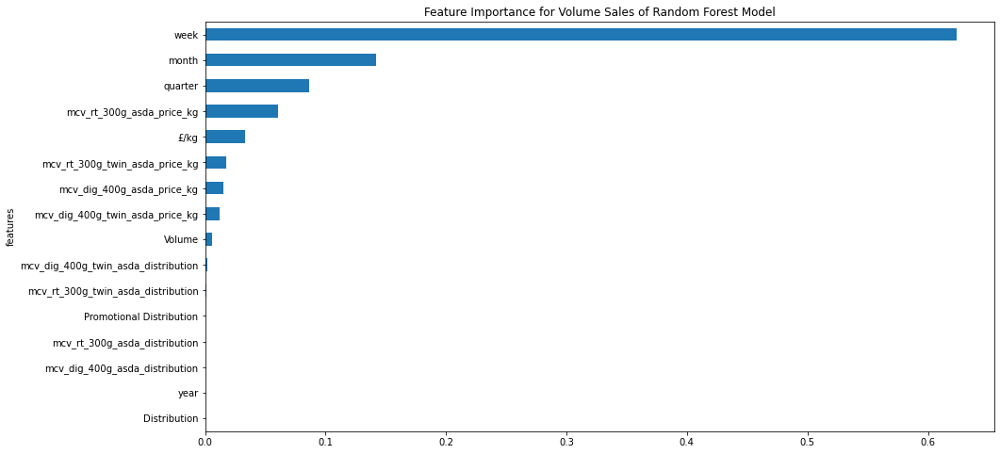

<Figure size 432x288 with 0 Axes>

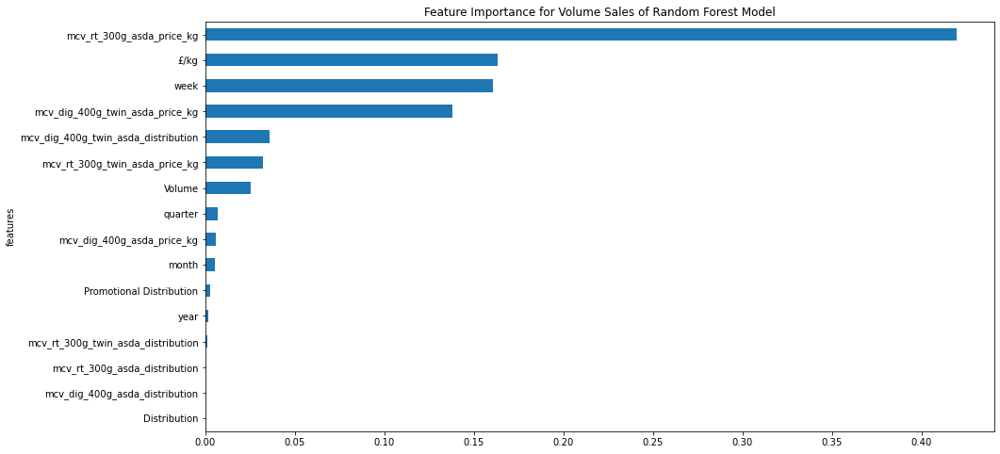

<Figure size 432x288 with 0 Axes>

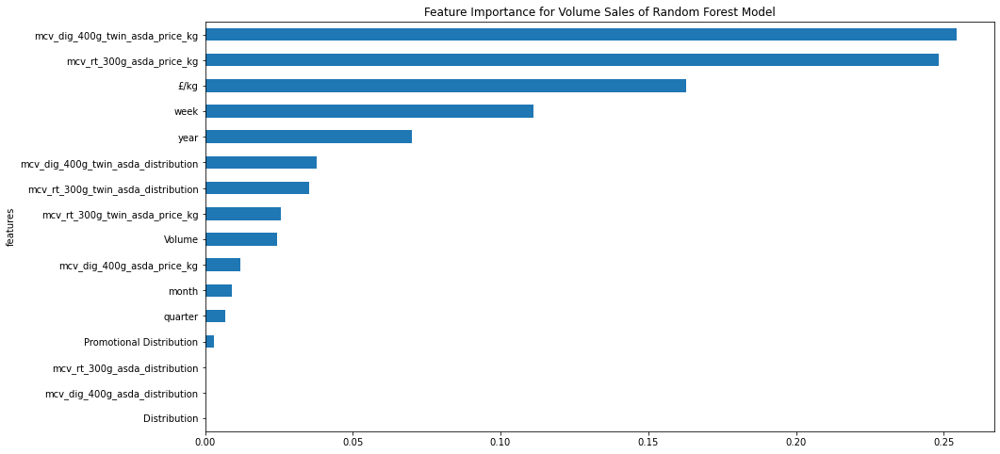

<Figure size 432x288 with 0 Axes>

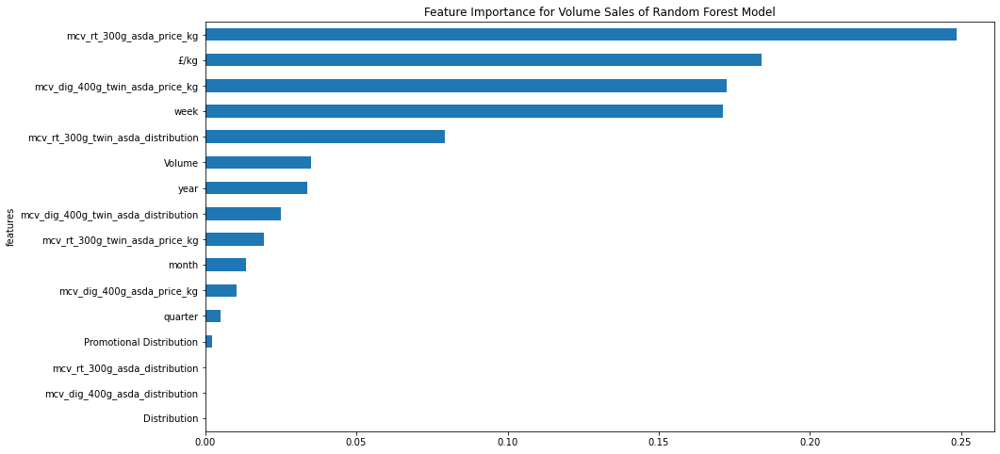

<Figure size 432x288 with 0 Axes>

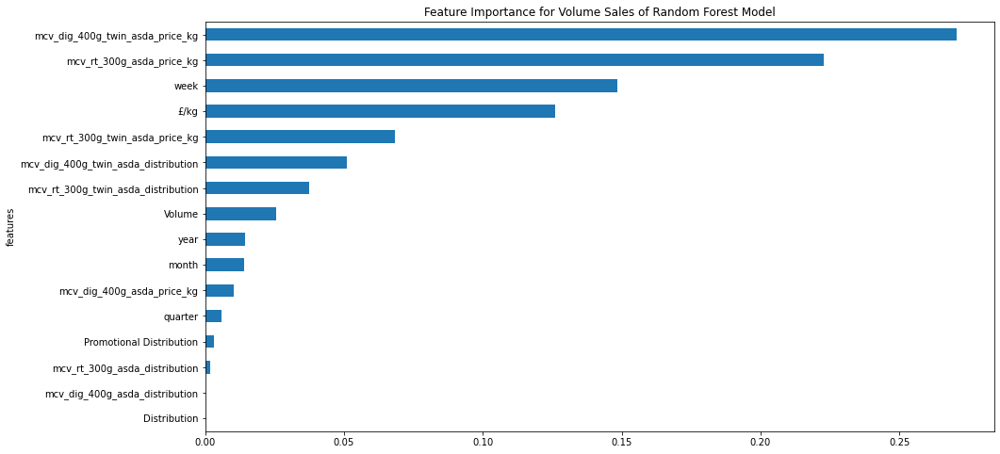

In [653]:
asda_dig_400g_input_X,asda_dig_400g_input_Y=input_var_asda(asda_dig_400g_with_comp)
rf_regressor_asda(asda_dig_400g_input_X,asda_dig_400g_input_Y)


### XGBoost Regressor

In [654]:
# def xgb_regressor_asda(X, y):
#     splits = TimeSeriesSplit(n_splits=5)
    
#     for train_index, test_index in splits.split(X):
#         X_train, X_test = X[train_index], X[test_index]
#         y_train, y_test = y[train_index], y[test_index]
#         print('Observations: %d' % (len(train_index) + len(test_index)))
#         print('Training Observations: %d' % (len(train_index))) 
#         print('Testing Observations: %d' % (len(test_index))) 
#         from sklearn.preprocessing import StandardScaler


#         sc = StandardScaler()
#         X_train = sc.fit_transform(X_train)
#         X_test = sc.transform(X_test)

#         from sklearn.ensemble import RandomForestRegressor
#         from sklearn.model_selection import cross_val_score

#         xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
#                     max_depth = 5, alpha = 10, n_estimators = 10)
#         xg_reg.fit(X_train, y_train)
#         y_pred = xg_reg.predict(X_test)
#         print(cross_val_score(xg_reg, X_train, y_train, cv=splits))

#         from sklearn import metrics

#         print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
#         print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
#         print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

#         #feature importance
#         df_featImp = pd.DataFrame({'features':['£/kg','Distribution','Promotional Distribution',
#            'year','quarter','month','week',
#         'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
#                 'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
#                 'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
#                 'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution'
#                                                ], 'importance': regressor.feature_importances_})

#         df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

#         plt.figure()
#         df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of XGBoost Model",legend=False, figsize=(20, 13))

def xgb_regressor_asda(X, y):
    splits = TimeSeriesSplit(n_splits=5)
    
    for train_index, test_index in splits.split(X):
        X_train, X_test = X[train_index], X[test_index]
        y_train, y_test = y[train_index], y[test_index]
        print('Observations: %d' % (len(train_index) + len(test_index)))
        print('Training Observations: %d' % (len(train_index))) 
        print('Testing Observations: %d' % (len(test_index))) 
        from sklearn.preprocessing import StandardScaler


        sc = StandardScaler()
        X_train = sc.fit_transform(X_train)
        X_test = sc.transform(X_test)

        from sklearn.ensemble import RandomForestRegressor
        from sklearn.model_selection import cross_val_score

        xg_reg = xgb.XGBRegressor(objective ='reg:squarederror', colsample_bytree = 0.3, learning_rate = 0.1,
                    max_depth = 5, alpha = 10, n_estimators = 10)
        xg_reg.fit(X_train, y_train)
        y_pred = xg_reg.predict(X_test)
        print(cross_val_score(xg_reg, X_train, y_train, cv=splits))

        from sklearn import metrics

        print('Mean Absolute Error:', metrics.mean_absolute_error(y_test, y_pred))
        print('Mean Squared Error:', metrics.mean_squared_error(y_test, y_pred))
        print('Root Mean Squared Error:', np.sqrt(metrics.mean_squared_error(y_test, y_pred)))

        #feature importance
        df_featImp = pd.DataFrame({'features':['Volume','£/kg','Distribution','Promotional Distribution',
           'year','quarter','month','week',
        'mcv_dig_400g_asda_price_kg', 'mcv_dig_400g_asda_distribution',
                'mcv_dig_400g_twin_asda_price_kg','mcv_dig_400g_twin_asda_distribution',
                'mcv_rt_300g_asda_price_kg','mcv_rt_300g_asda_distribution',
                'mcv_rt_300g_twin_asda_price_kg','mcv_rt_300g_twin_asda_distribution',], 'importance': xg_reg.feature_importances_})
        df_featImp = df_featImp.sort_values('importance').reset_index(drop=True)

        plt.figure()
        df_featImp.plot(kind='barh', x='features', y='importance', title="Feature Importance for Volume Sales of XGBoost Model",legend=False, figsize=(20, 13))


Observations: 51
Training Observations: 27
Testing Observations: 24
[ -356.13705196 -1594.22881006   -19.94287348  -236.53561656
   -44.17941102]
Mean Absolute Error: 18631.761604817708
Mean Squared Error: 387106962.72689915
Root Mean Squared Error: 19675.033995571626
Observations: 75
Training Observations: 51
Testing Observations: 24
[-18.64198078 -44.97583239  -2.35628161 -43.47591995 -27.51323399]
Mean Absolute Error: 14185.416357421875
Mean Squared Error: 211531228.54441348
Root Mean Squared Error: 14544.113192092995
Observations: 99
Training Observations: 75
Testing Observations: 24
[ -16.02575073   -4.05172403  -39.11792098 -214.56088875   -9.60289976]
Mean Absolute Error: 13515.681852213542
Mean Squared Error: 199701086.91593075
Root Mean Squared Error: 14131.56349863421
Observations: 123
Training Observations: 99
Testing Observations: 24
[  -5.81233482  -41.66899863 -174.31470788  -10.02589126   -5.50908314]
Mean Absolute Error: 8893.852783203125
Mean Squared Error: 84726369.42

<Figure size 432x288 with 0 Axes>

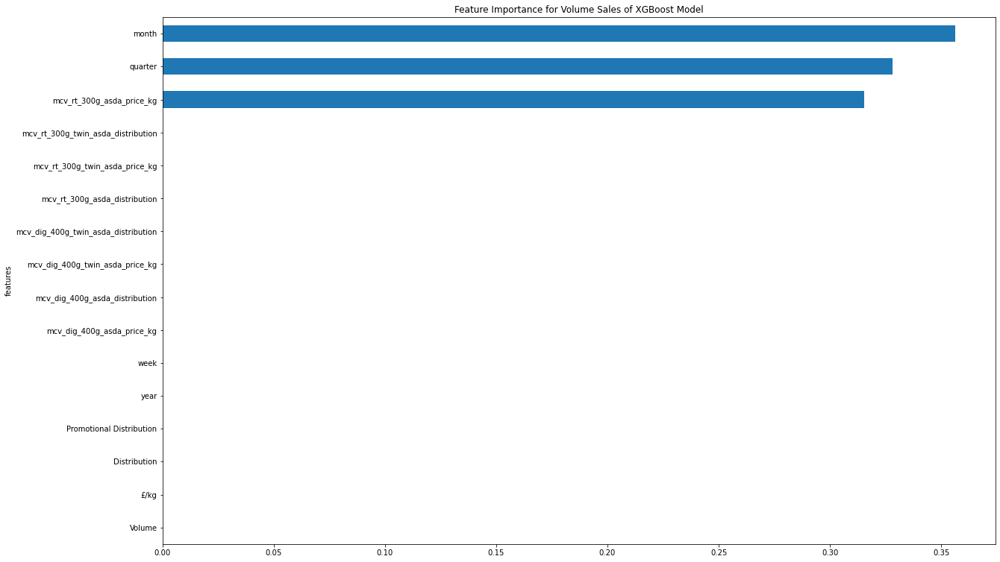

<Figure size 432x288 with 0 Axes>

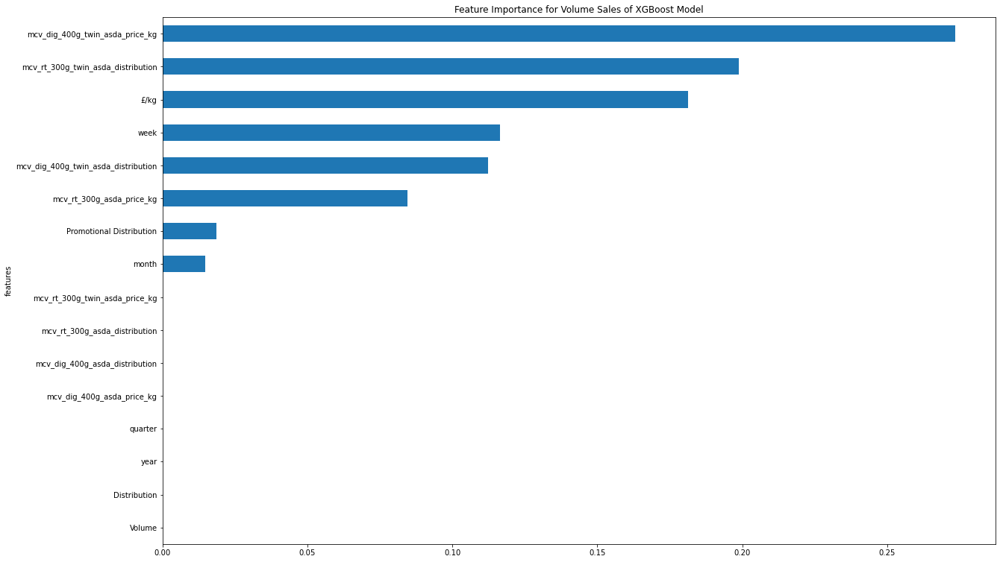

<Figure size 432x288 with 0 Axes>

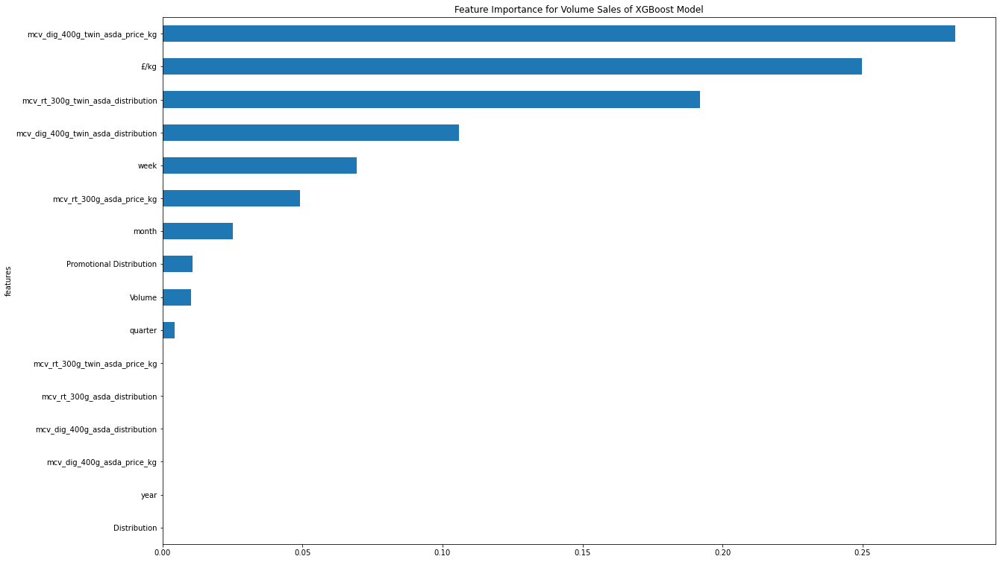

<Figure size 432x288 with 0 Axes>

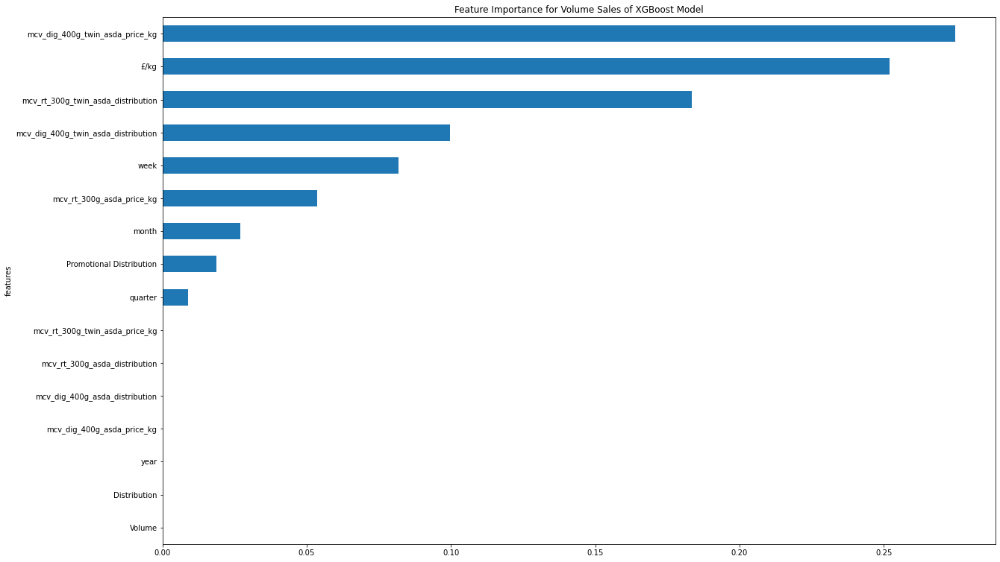

<Figure size 432x288 with 0 Axes>

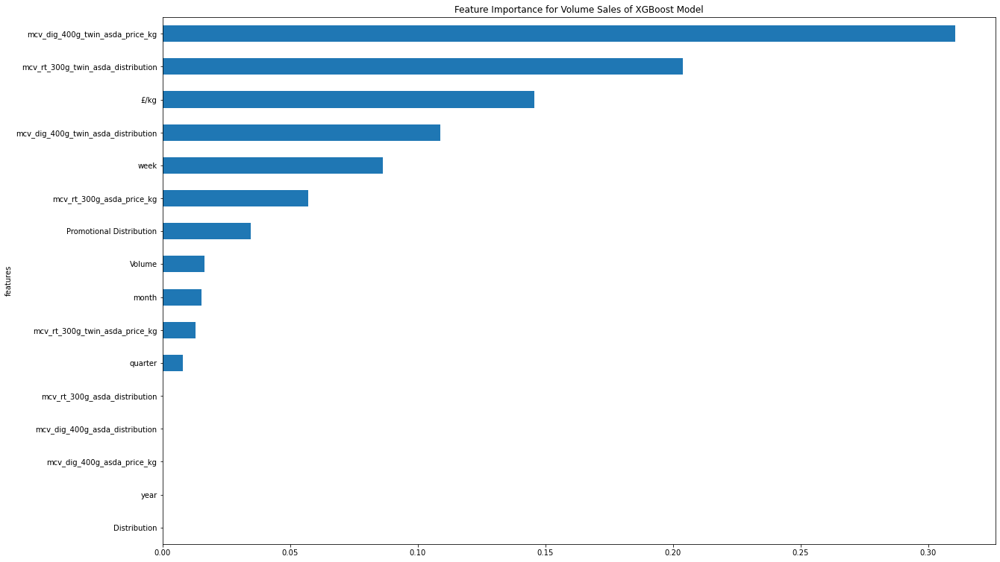

In [655]:
asda_dig_400g_input_X,asda_dig_400g_input_Y=input_var_asda(asda_dig_400g_with_comp)
xgb_regressor_asda(asda_dig_400g_input_X,asda_dig_400g_input_Y)


,var1(t-4),var1(t)
Date,,
2015-01-10,17512.0,15878
2015-01-17,17578.0,16634
2015-01-24,11776.0,17597
2015-01-31,12239.0,19168
2015-02-07,15878.0,20446
...,...,...
2020-02-15,22543.0,22913
2020-02-22,23803.0,22450
2020-02-29,22112.0,24445


   var1(t-4)   var1(t)
4   0.284564  0.223391
5   0.287035  0.251694
6   0.069821  0.287747
7   0.087155  0.346561
8   0.223391  0.394407
(216, 1, 1) (216,) (55, 1, 1) (55,)
Train on 216 samples, validate on 55 samples
Epoch 1/50
216/216 - 46s - loss: 0.2870 - val_loss: 0.4147
Epoch 2/50
216/216 - 0s - loss: 0.2762 - val_loss: 0.4029
Epoch 3/50
216/216 - 0s - loss: 0.2652 - val_loss: 0.3906
Epoch 4/50
216/216 - 0s - loss: 0.2540 - val_loss: 0.3778
Epoch 5/50
216/216 - 0s - loss: 0.2424 - val_loss: 0.3644
Epoch 6/50
216/216 - 0s - loss: 0.2302 - val_loss: 0.3502
Epoch 7/50
216/216 - 0s - loss: 0.2177 - val_loss: 0.3350
Epoch 8/50
216/216 - 0s - loss: 0.2054 - val_loss: 0.3192
Epoch 9/50
216/216 - 0s - loss: 0.1948 - val_loss: 0.3033
Epoch 10/50
216/216 - 0s - loss: 0.1843 - val_loss: 0.2870
Epoch 11/50
216/216 - 0s - loss: 0.1734 - val_loss: 0.2698
Epoch 12/50
216/216 - 0s - loss: 0.1619 - val_loss: 0.2514
Epoch 13/50
216/216 - 0s - loss: 0.1496 - val_loss: 0.2318
Epoch 14/50
216/216 - 

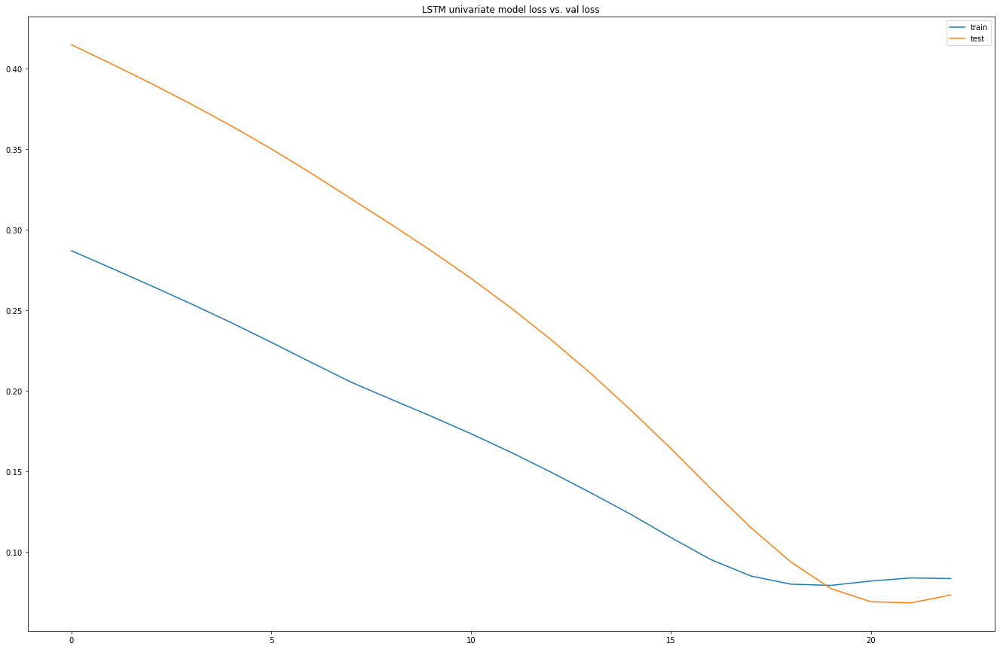

Test RMSE: 3194.626


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2017-05-27,24108.0,1.125000,100.0,0.0,2017.0,2.0,4.0,17.0,23019.6,1.125159,100.0,0.0,2017,2,5,21
2017-06-03,23115.6,1.125015,100.0,0.0,2017.0,2.0,5.0,18.0,22013.6,1.125000,100.0,0.0,2017,2,6,22
2017-06-10,23773.2,1.125048,100.0,0.0,2017.0,2.0,5.0,19.0,24388.8,1.125021,100.0,0.0,2017,2,6,23
2017-06-17,24527.6,1.125047,100.0,0.0,2017.0,2.0,5.0,20.0,23405.2,1.124895,100.0,0.0,2017,2,6,24
2017-06-24,23019.6,1.125159,100.0,0.0,2017.0,2.0,5.0,21.0,21729.6,1.124995,100.0,0.0,2017,2,6,25
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,29126.4,0.825001,100.0,0.0,2020.0,1.0,1.0,3.0,34926.8,0.825000,100.0,0.0,2020,1,2,7
2020-02-22,31346.4,0.825001,100.0,0.0,2020.0,1.0,1.0,4.0,35332.0,0.825040,100.0,0.0,2020,1,2,8
2020-02-29,32963.2,0.825017,100.0,0.0,2020.0,1.0,2.0,5.0,37504.0,0.824997,100.0,0.0,2020,1,2,9


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.276926   0.999474        1.0        0.0        0.0   0.333333   
5   0.246405   0.999525        1.0        0.0        0.0   0.333333   
6   0.266629   0.999635        1.0        0.0        0.0   0.333333   
7   0.289830   0.999630        1.0        0.0        0.0   0.333333   
8   0.243452   1.000000        1.0        0.0        0.0   0.333333   

   var7(t-4)  var8(t-4)   var1(t)  
4   0.272727   0.313726  0.243452  
5   0.363636   0.333333  0.212513  
6   0.363636   0.352941  0.285561  
7   0.363636   0.372549  0.255311  
8   0.363636   0.392157  0.203779  
(117, 1, 8) (117,) (30, 1, 8) (30,)
Train on 117 samples, validate on 30 samples
Epoch 1/50
117/117 - 47s - loss: 0.5124 - val_loss: 0.5021
Epoch 2/50
117/117 - 0s - loss: 0.4927 - val_loss: 0.4795
Epoch 3/50
117/117 - 0s - loss: 0.4728 - val_loss: 0.4557
Epoch 4/50
117/117 - 0s - loss: 0.4521 - val_loss: 0.4305
Epoch 5/50
117/117 - 0s - loss: 0.4306 - va

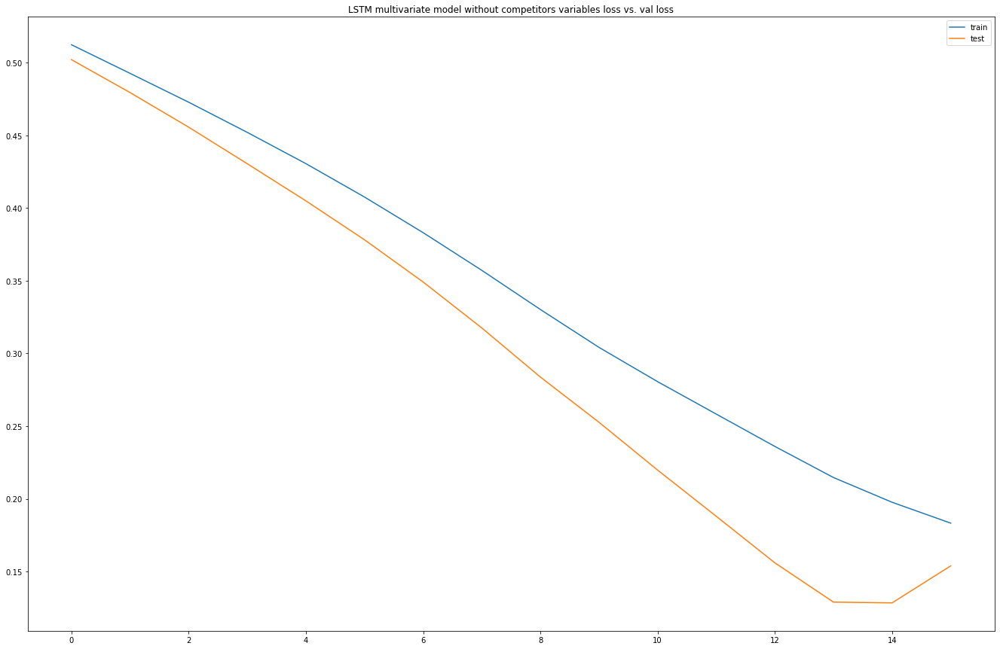

Test RMSE: 6507.218


In [656]:
#lstm models
series_to_supervised(asda_dig_400g_volume)
lstm_univariate(asda_dig_400g_volume)

series_to_supervised(asda_dig_400g_own_variable)
multivariate_lstm_without_competitor(asda_dig_400g_own_variable)


### LSTM Multivariate with Competitors'

In [657]:
series_to_supervised(asda_dig_400g_with_comp)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-06-24,23019.6,2017.0,2.0,5.0,21.0,24108.0,1.125000,100.0,0.0,2.499055,...,100.0,0.0,2.499631,100.0,2.486928,94.0,3.333035,100.0,3.149897,94.0
2017-07-01,22013.6,2017.0,2.0,6.0,22.0,23115.6,1.125015,100.0,0.0,2.498982,...,100.0,0.0,2.499715,100.0,2.487224,94.0,3.332952,100.0,3.149678,94.0
2017-07-08,24388.8,2017.0,2.0,6.0,23.0,23773.2,1.125048,100.0,0.0,2.498393,...,100.0,0.0,2.499715,100.0,2.484579,94.0,3.333031,100.0,3.149785,94.0
2017-07-15,23405.2,2017.0,2.0,6.0,24.0,24527.6,1.125047,100.0,0.0,2.499553,...,100.0,0.0,2.499392,100.0,2.486126,94.0,3.332729,100.0,3.149596,94.0
2017-07-22,21729.6,2017.0,2.0,6.0,25.0,23019.6,1.125159,100.0,0.0,2.499631,...,100.0,0.0,2.499133,100.0,2.485910,94.0,3.333135,100.0,3.149648,94.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,29126.4,2020.0,1.0,1.0,3.0,38479.6,0.824959,100.0,0.0,2.498513,...,100.0,0.0,2.499238,100.0,2.361675,92.0,3.331923,100.0,3.148926,92.0
2020-02-22,31346.4,2020.0,1.0,1.0,4.0,25192.8,0.825002,100.0,0.0,2.497888,...,100.0,0.0,2.498231,100.0,2.361604,92.0,3.330570,100.0,3.147405,92.0
2020-02-29,32963.2,2020.0,1.0,2.0,5.0,19939.6,0.824996,100.0,0.0,2.497677,...,100.0,0.0,2.497394,100.0,2.360437,92.0,3.323531,100.0,3.147662,92.0


In [660]:
def multivariate_with_competitor_asda(df):
    values = df.values
    # integer encode direction
    #encoder = LabelEncoder()
    #values[:,4] = encoder.fit_transform(values[:,4])
    # ensure all data is float
    values = values.astype('float32')
    # normalize features
    scaler = MinMaxScaler(feature_range=(0, 1))
    scaled = scaler.fit_transform(values)
    # frame as supervised learning
    reframed = series_to_supervised(scaled, 4, 1)
    # drop columns we don't want to predict
    reframed.drop(reframed.columns[[18,19,20,21,22,23,24,25,26,27,28,29,30,31,32,33]], axis=1, inplace=True)
    print(reframed.head())

    # split into train and test sets
    values = reframed.values
    train_size = int(len(values) * 0.8)
    train=values[:train_size]
    test=values[train_size:]
    # split into input and outputs
    train_X, train_y = train[:, :-1], train[:, -1]
    test_X, test_y = test[:, :-1], test[:, -1]
    # reshape input to be 3D [samples, timesteps, features]
    train_X = train_X.reshape((train_X.shape[0], 1, train_X.shape[1]))
    test_X = test_X.reshape((test_X.shape[0], 1, test_X.shape[1]))
    print(train_X.shape, train_y.shape, test_X.shape, test_y.shape)

    model = Sequential()
    earlystopping = EarlyStopping(monitor='val_loss', mode='min', verbose=1)
    model.add(LSTM(100, return_sequences=True, input_shape=(train_X.shape[1], train_X.shape[2])))
    model.add(LSTM(25))
    model.add(Dense(1))
    model.compile(loss='mae', optimizer='adam')
    # fit network
    history = model.fit(train_X, train_y, epochs=50, batch_size=72, validation_data=(test_X, test_y), verbose=2, shuffle=False, callbacks=[earlystopping])
    # plot history
    plt.figure(figsize=(23, 15))
    plt.plot(history.history['loss'], label='train')
    plt.plot(history.history['val_loss'], label='test')
    plt.title('LSTM multivariate model with competitors variables loss vs. val loss',loc='center')
    plt.legend()
    plt.show()

    from numpy import concatenate

    yhat = model.predict(test_X)
    test_X = test_X.reshape((test_X.shape[0], test_X.shape[2]))
    # invert scaling for forecast
    inv_yhat = concatenate((yhat, test_X[:, 1:]), axis=1)
    inv_yhat = scaler.inverse_transform(inv_yhat)
    inv_yhat = inv_yhat[:,0]
    # invert scaling for actual
    test_y = test_y.reshape((len(test_y), 1))
    inv_y = concatenate((test_y, test_X[:, 1:]), axis=1)
    inv_y = scaler.inverse_transform(inv_y)
    inv_y = inv_y[:,0]
    # calculate RMSE
    rmse = sqrt(mean_squared_error(inv_y, inv_yhat))
    print('Test RMSE: %.3f' % rmse)

   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.243452        0.0   0.333333   0.363636   0.392157   0.276926   
5   0.212513        0.0   0.333333   0.454545   0.411765   0.246405   
6   0.285561        0.0   0.333333   0.454545   0.431373   0.266629   
7   0.255311        0.0   0.333333   0.454545   0.450980   0.289830   
8   0.203779        0.0   0.333333   0.454545   0.470588   0.243452   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.999474        1.0        0.0    0.097549         1.0    0.990219   
5   0.999525        1.0        0.0    0.097336         1.0    0.990143   
6   0.999635        1.0        0.0    0.095625         1.0    0.990515   
7   0.999630        1.0        0.0    0.098996         1.0    0.996117   
8   1.000000        1.0        0.0    0.099222         1.0    0.996668   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4        0.75    0.231231         1.0    0.093998     

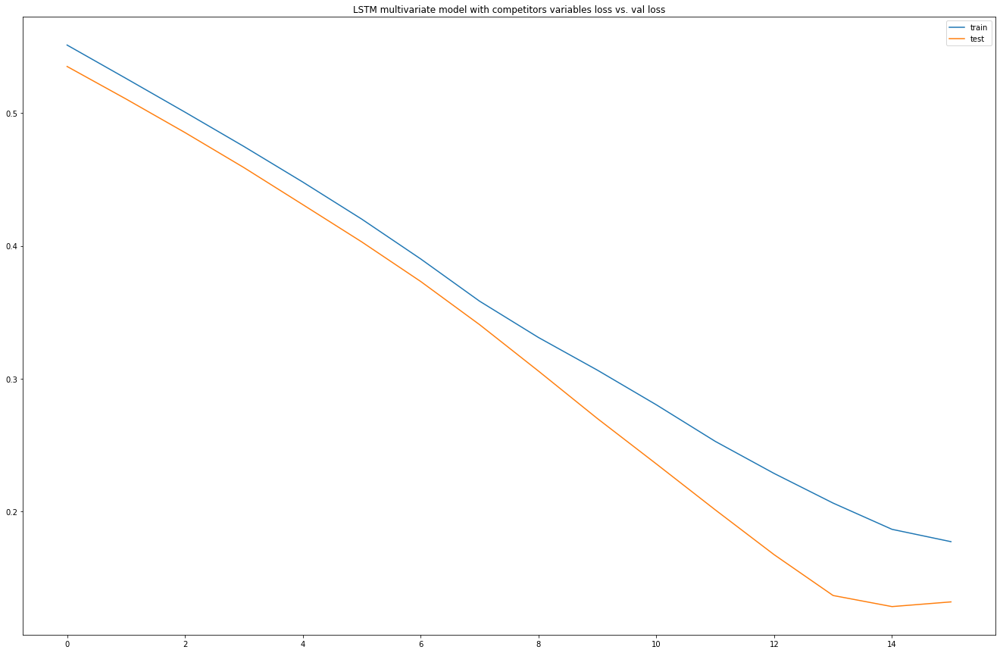

Test RMSE: 6108.179


In [661]:
multivariate_with_competitor_asda(asda_dig_400g_with_comp)

## Asda -  Asda Digestives 250g (Competitor)

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
124,2017-04-29,28004.0,5600.8,12601.2,100.0,0.0,0.449979,2.249893,2017,2,4,17
125,2017-05-06,27268.0,5453.6,12270.6,100.0,0.0,0.450000,2.250000,2017,2,5,18
126,2017-05-13,27775.0,5555.0,12498.8,100.0,0.0,0.450002,2.250009,2017,2,5,19
127,2017-05-20,28284.0,5656.8,12727.8,100.0,0.0,0.450000,2.250000,2017,2,5,20
128,2017-05-27,26130.0,5226.0,11758.5,100.0,0.0,0.450000,2.250000,2017,2,5,21


(151, 12)

Date                        datetime64[ns]
Units                              float64
Volume                             float64
Value                              float64
Distribution                       float64
Promotional Distribution           float64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000,151.000000
mean,32055.801325,6411.160265,14410.256954,99.403974,0.311258,0.449587,2.247935,2018.251656,2.536424,6.662252,26.913907
std,4655.359220,931.071844,2081.401991,0.888285,1.970399,0.001475,0.007376,0.903464,1.124128,3.473495,15.126551
min,14366.000000,2873.200000,6465.300000,97.000000,0.000000,0.433779,2.168896,2017.000000,1.000000,1.000000,1.000000
25%,30061.000000,6012.200000,13526.750000,98.000000,0.000000,0.449719,2.248595,2018.000000,2.000000,4.000000,14.000000
50%,32347.000000,6469.400000,14552.100000,100.000000,0.000000,0.449950,2.249750,2018.000000,3.000000,7.000000,27.000000
75%,35018.000000,7003.600000,15757.650000,100.000000,0.000000,0.449992,2.249958,2019.000000,4.000000,10.000000,40.000000
95%,38083.500000,7616.700000,16982.100000,100.000000,0.500000,0.450021,2.250103,2020.000000,4.000000,12.000000,50.000000
99%,43382.000000,8676.400000,19420.650000,100.000000,5.500000,0.450046,2.250231,2020.000000,4.000000,12.000000,52.000000
max,44069.000000,8813.800000,19726.900000,100.000000,22.000000,0.450102,2.250508,2020.000000,4.000000,12.000000,52.000000


Dataset has: 151rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

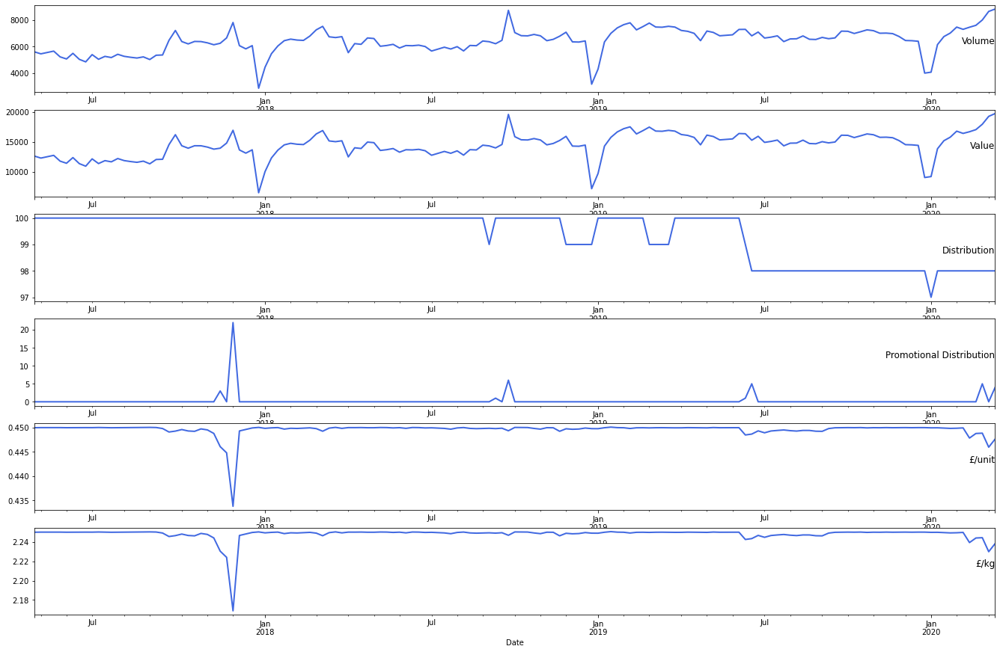

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f530b75ed68>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f530b59a898>)

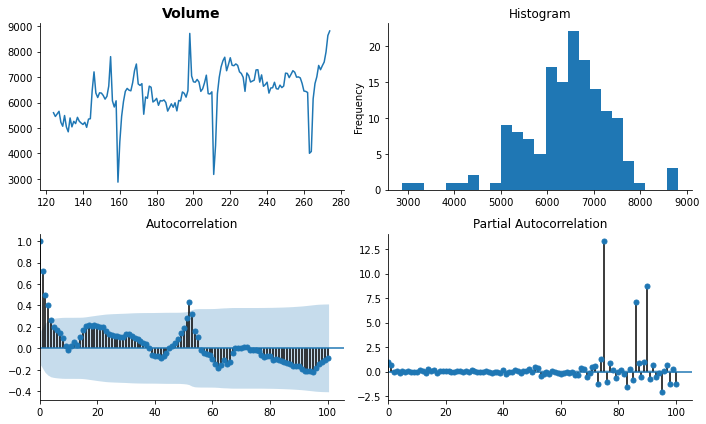

In [662]:
basic_info(asda_rt_250g_origin)
plot_data(asda_rt_250g_origin)
tsplot(asda_rt_250g_origin['Volume'].dropna(), title=asda_rt_250g_origin.columns[2], lags=100)


Test Statistic                  -4.374181
p-value                          0.000330
#Lags Used                       0.000000
Number of Observations Used    150.000000
Critical Value (1%)             -3.474715
Critical Value (5%)             -2.881009
Critical Value (10%)            -2.577151
dtype: float64


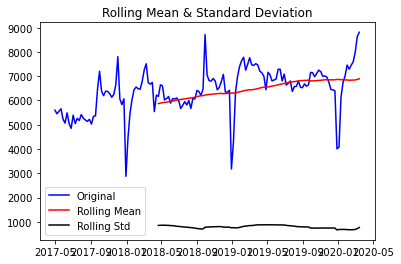

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f530b3d0630>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f530b30c3c8>)

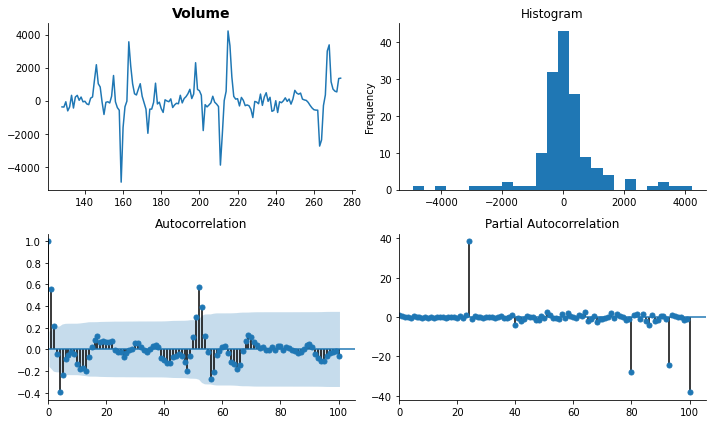

In [663]:
plot(asda_rt_250g_origin)
#plot stationary graph
series_transformed=asda_rt_250g_origin.copy()
series_transformed['Volume_transformed']=asda_rt_250g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=asda_rt_250g_origin.columns[2], lags=100)


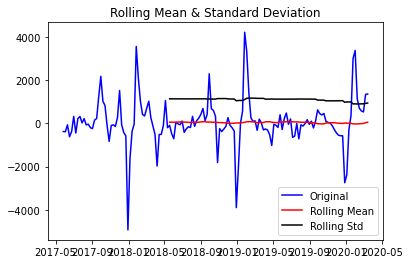

Results of Dickey-Fuller Test:
Test Statistic                -6.512026e+00
p-value                        1.094380e-08
#Lags Used                     1.100000e+01
Number of Observations Used    1.350000e+02
Critical Value (1%)           -3.479743e+00
Critical Value (5%)           -2.883198e+00
Critical Value (10%)          -2.578320e+00
dtype: float64


In [664]:
plot_transform(asda_rt_250g_origin)

      t-4     t+1
0     NaN  5600.8
1     NaN  5453.6
2     NaN  5555.0
3     NaN  5656.8
4  5600.8  5226.0
Test MSE: 1363864.143
Test RMSE: 1167.846


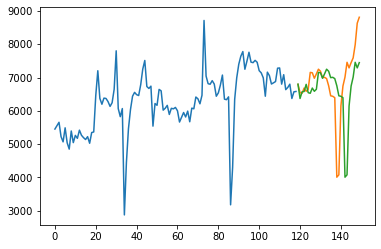

Observations: 147
Training Observations: 117
Testing Observations: 30


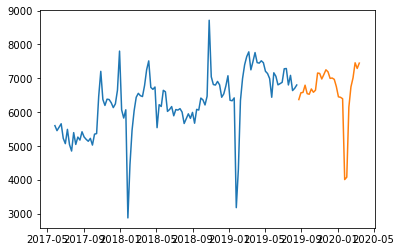

RMSE for Simple Exponential Smoothing α= 0.1 is: 824.06
RMSE for Simple Exponential Smoothing α= 0.2 is: 807.77
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 794.6
RMSE for Simple Exponential Smoothing α= 0.4 is: 787.55
RMSE for Simple Exponential Smoothing α= 0.5 is: 783.83
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 782.29
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 782.22
RMSE for Simple Exponential Smoothing α= 0.8 is: 783.17
RMSE for Simple Exponential Smoothing α= 0.9 is: 784.78


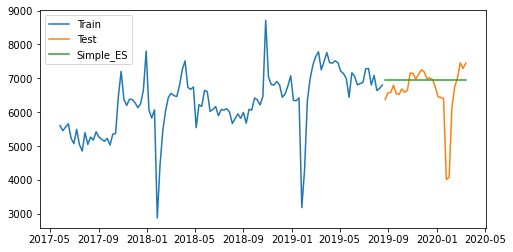

Observations: 147
Training Observations: 117
Testing Observations: 30
Min RMSE for Holt Linear Forecasting α= 0.8 and β= 0.5 is: 770.74


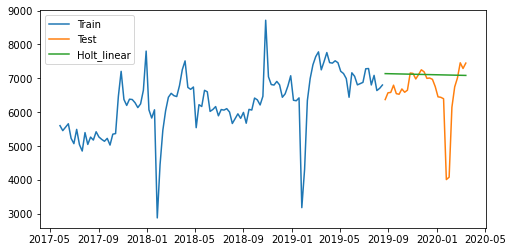

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/tsa/base/tsa_model.py:162: ValueWarning:

No frequency information was provided, so inferred frequency W-SAT will be used.

/opt/anaconda/envs/Python3/lib/python3.6/site

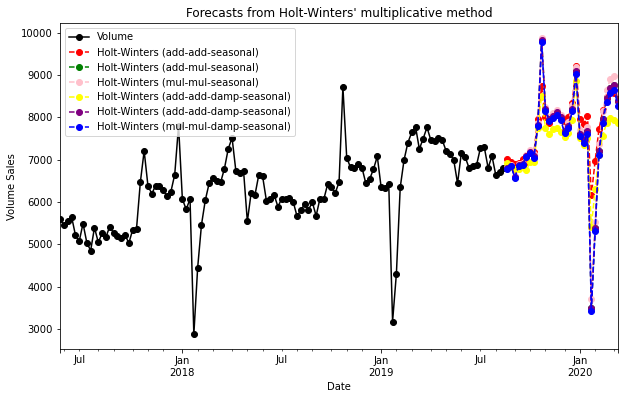

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


RMSE for Holt-winter are:
1288.1499864508753
1114.8370369211207
1199.9691002468508
907.2768575919001
1114.8320334073433
1061.43316131467


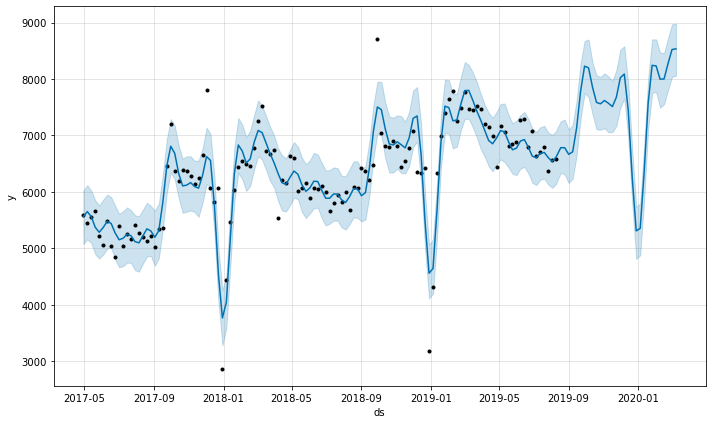

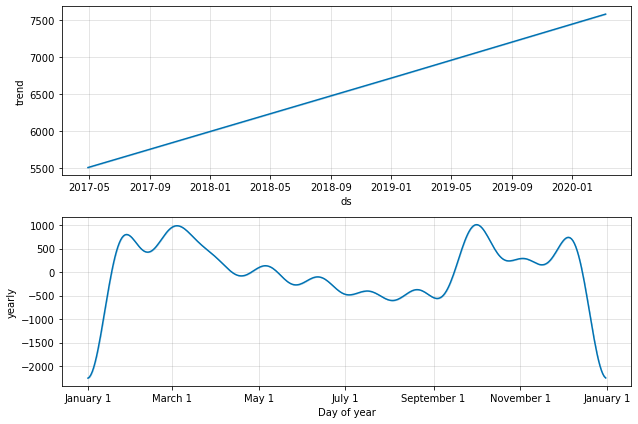

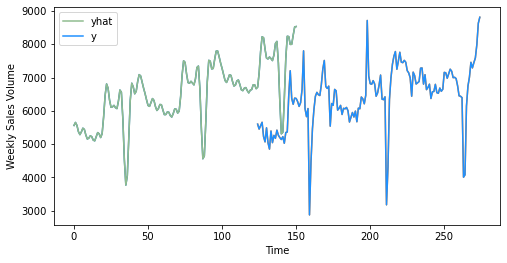

RMSE for prophet model is: 510.26684392617716


In [666]:
#time series models
baseline_model(asda_rt_250g_origin)
ses_model(asda_rt_250g_origin)
holt_linear_model(asda_rt_250g_origin)
holt_winter_model(asda_rt_250g_origin)
prophet_model(asda_rt_250g_origin)
# prophet_all_holidays(asda_rt_250g_origin)
# prophet_two_holiday(asda_rt_250g_origin)

Observations: 51
Training Observations: 27
Testing Observations: 24
[ -4.95344639  -2.4649221   -1.52380585 -32.61829865  -0.12765397]
Mean Absolute Error: 1189.2962499999992
Mean Squared Error: 1906352.1601458315
Root Mean Squared Error: 1380.7071232328135
Observations: 75
Training Observations: 51
Testing Observations: 24
[-0.46403386 -9.96992444 -0.12317283 -9.77874528 -1.15585394]
Mean Absolute Error: 480.0224999999996
Mean Squared Error: 480891.9867416665
Root Mean Squared Error: 693.4637602223107
Observations: 99
Training Observations: 75
Testing Observations: 24
[-4.75488198 -0.33051286 -1.60573331 -8.15406792 -0.76843308]
Mean Absolute Error: 770.5170833333335
Mean Squared Error: 1028263.7398375003
Root Mean Squared Error: 1014.0334017365998
Observations: 123
Training Observations: 99
Testing Observations: 24
[ 0.0530888  -5.35915818 -4.2806733  -1.09912267 -0.15501589]
Mean Absolute Error: 231.49041666666676
Mean Squared Error: 86846.15837916688
Root Mean Squared Error: 294.69

<Figure size 432x288 with 0 Axes>

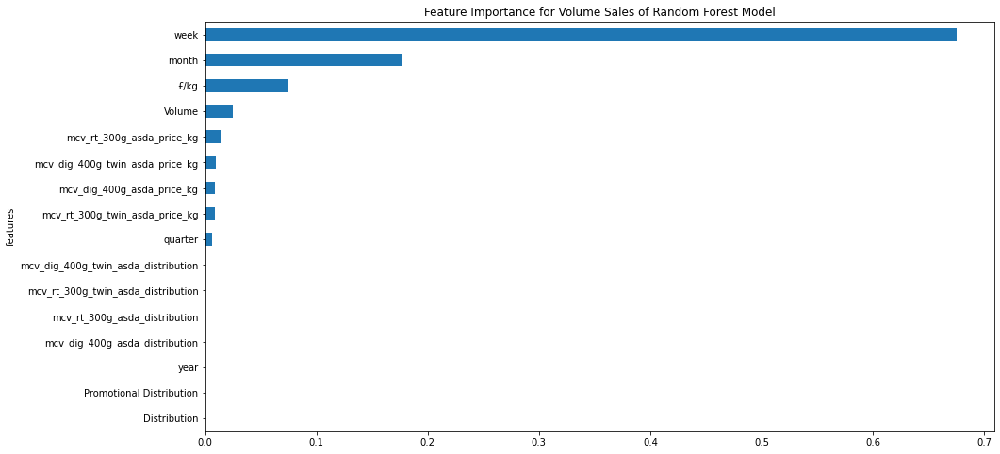

<Figure size 432x288 with 0 Axes>

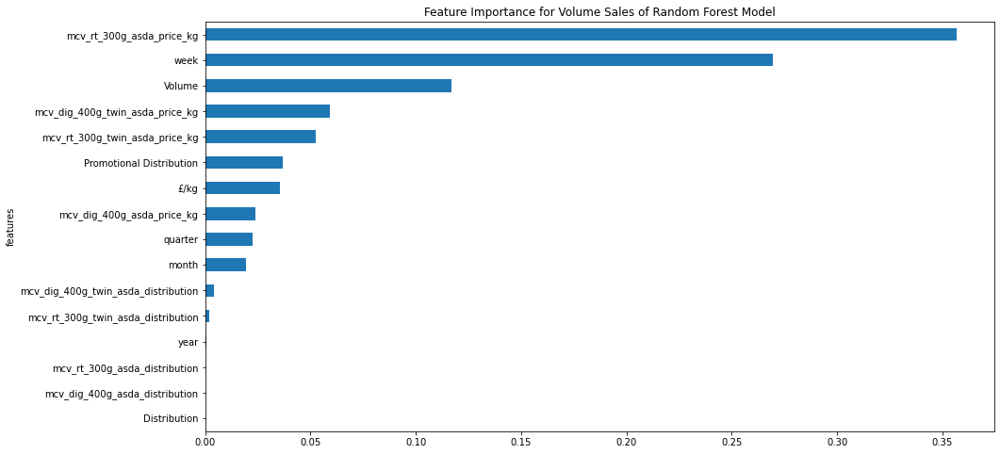

<Figure size 432x288 with 0 Axes>

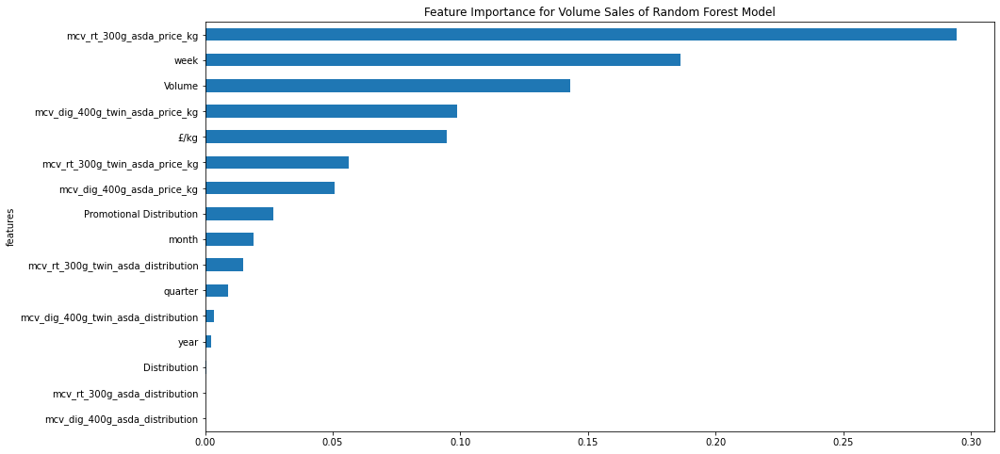

<Figure size 432x288 with 0 Axes>

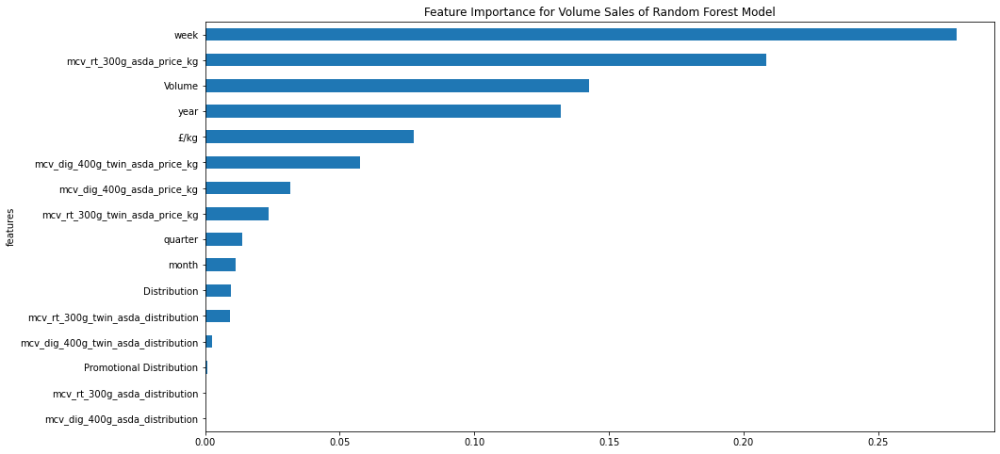

<Figure size 432x288 with 0 Axes>

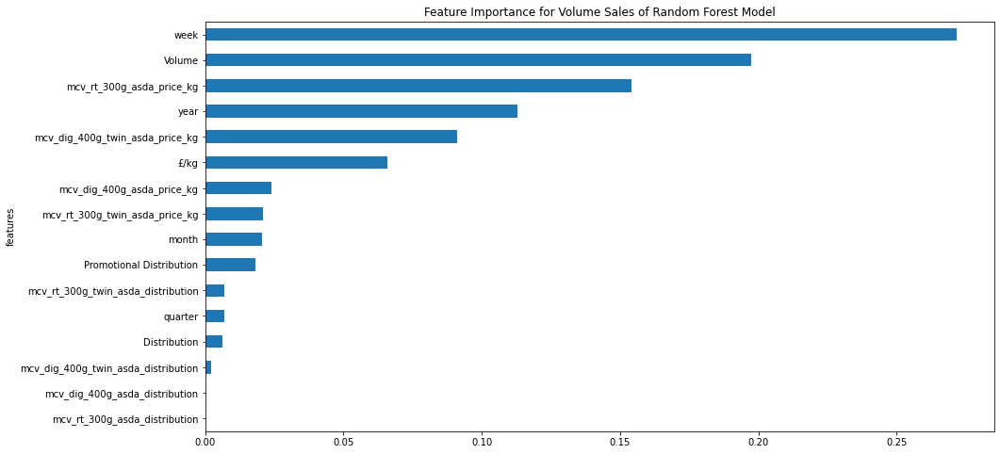

In [667]:
asda_rt_250g_with_comp=variable_lag_asda(asda_rt_250g_with_comp)
asda_rt_250g_input_X,asda_rt_250g_input_Y=input_var_asda(asda_rt_250g_with_comp)
rf_regressor_asda(asda_rt_250g_input_X,asda_rt_250g_input_Y)


Observations: 51
Training Observations: 27
Testing Observations: 24
[ -612.79642432  -651.01580238   -13.18497207 -1441.14142005
  -211.25586127]
Mean Absolute Error: 2680.622273763021
Mean Squared Error: 7802496.834442936
Root Mean Squared Error: 2793.294978057802
Observations: 75
Training Observations: 51
Testing Observations: 24
[ -10.81548236 -397.49922154   -2.16137972  -67.78864226  -47.83538221]
Mean Absolute Error: 2451.1746053059896
Mean Squared Error: 6579182.12436447
Root Mean Squared Error: 2564.991642162693
Observations: 99
Training Observations: 75
Testing Observations: 24
[ -38.95386708   -3.74034425  -33.56918866 -217.66670109  -15.39449869]
Mean Absolute Error: 2842.395579020182
Mean Squared Error: 8839312.799257828
Root Mean Squared Error: 2973.098181906852


/opt/anaconda/envs/Python3/lib/python3.6/site-packages/xgboost/sklearn.py:691: RuntimeWarning:

invalid value encountered in true_divide



Observations: 123
Training Observations: 99
Testing Observations: 24
[  -6.22695064  -44.3384586  -129.11625407  -27.12089751   -5.12510813]
Mean Absolute Error: 2641.8758707682296
Mean Squared Error: 7042809.35570427
Root Mean Squared Error: 2653.8291873638495
Observations: 147
Training Observations: 123
Testing Observations: 24
[  -6.72321504  -55.82114522  -22.44063353   -6.34480896 -111.46904149]
Mean Absolute Error: 2759.429644775391
Mean Squared Error: 8430170.112870384
Root Mean Squared Error: 2903.4755230362084


<Figure size 432x288 with 0 Axes>

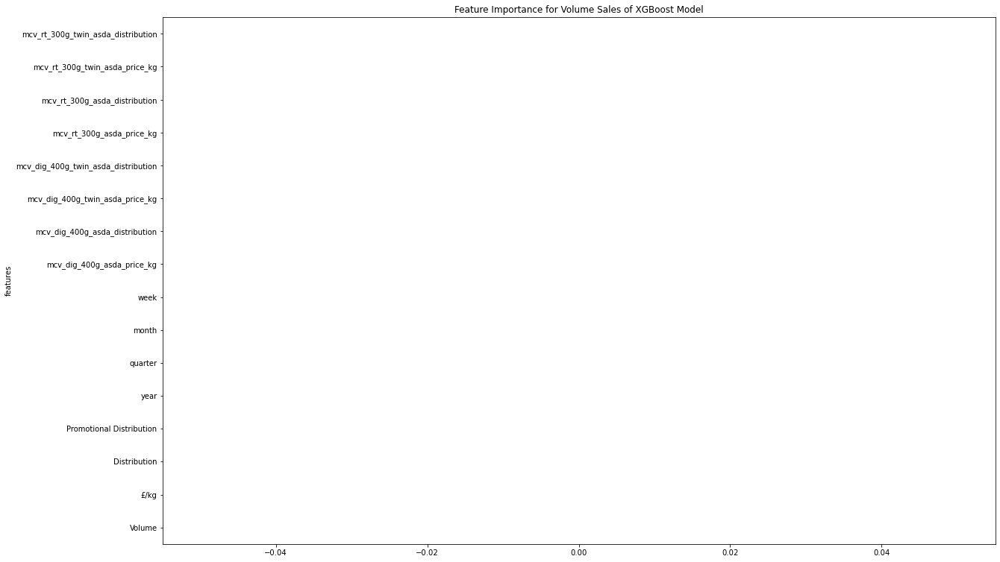

<Figure size 432x288 with 0 Axes>

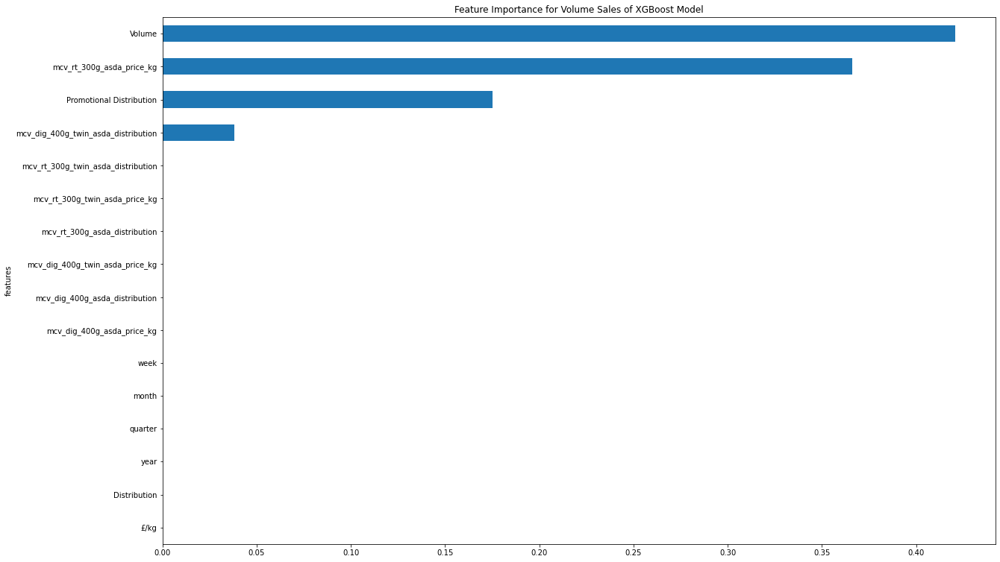

<Figure size 432x288 with 0 Axes>

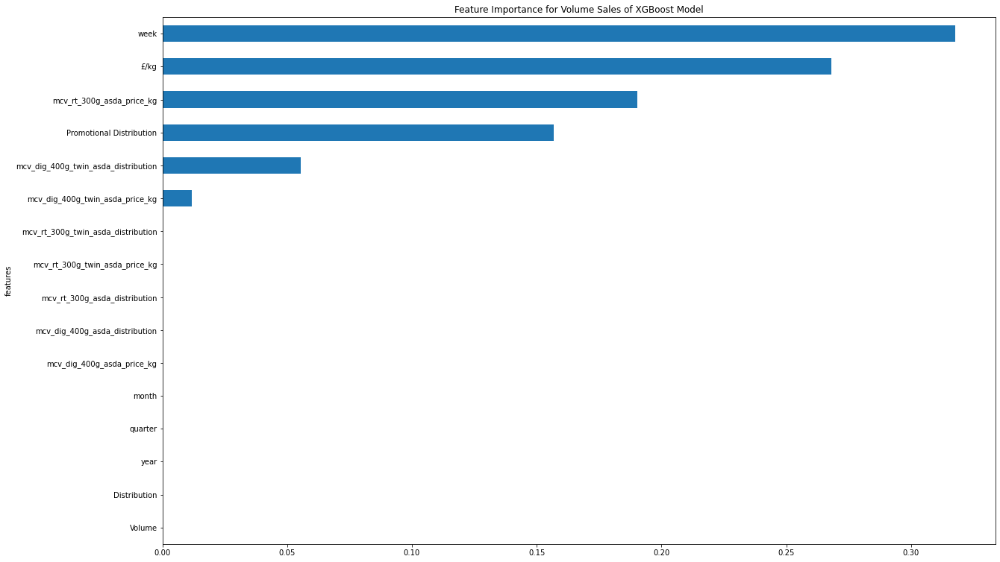

<Figure size 432x288 with 0 Axes>

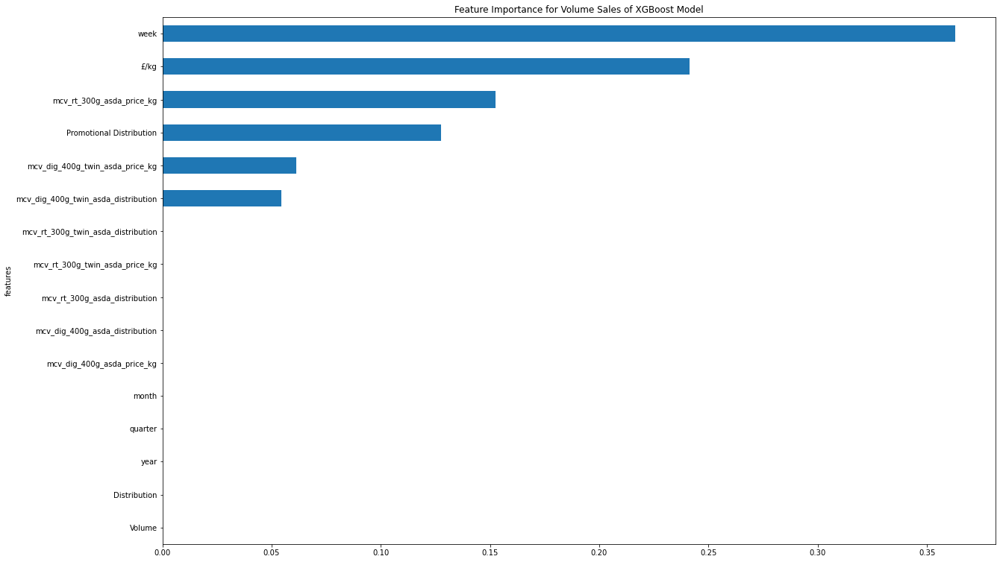

<Figure size 432x288 with 0 Axes>

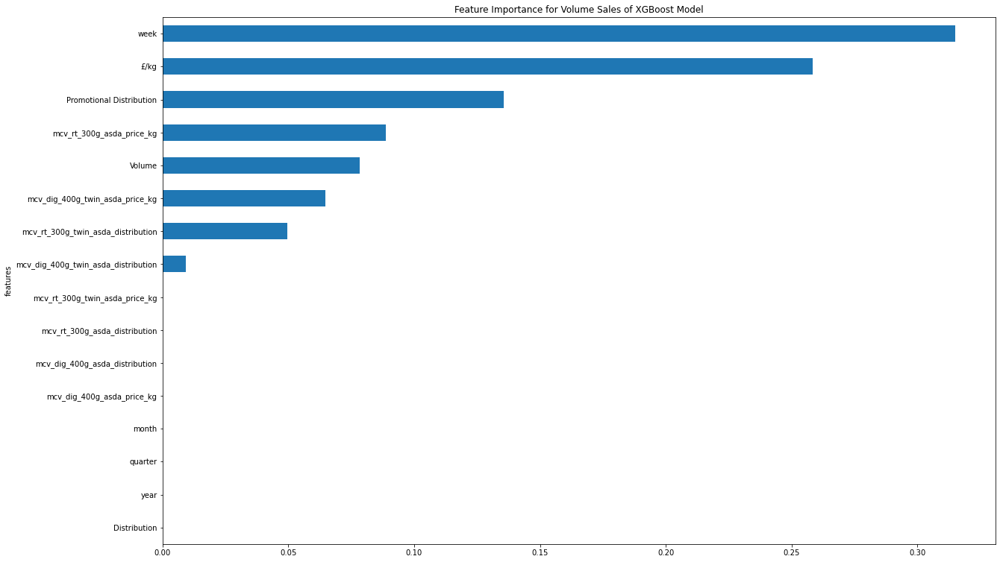

In [668]:
asda_rt_250g_input_X,asda_rt_250g_input_Y=input_var_asda(asda_rt_250g_with_comp)
xgb_regressor_asda(asda_rt_250g_input_X,asda_rt_250g_input_Y)


,var1(t-4),var1(t)
Date,,
2017-05-27,5600.8,5226.0
2017-06-03,5453.6,5068.8
2017-06-10,5555.0,5490.8
2017-06-17,5656.8,5040.2
2017-06-24,5226.0,4850.6
2017-07-01,5068.8,5395.0
2017-07-08,5490.8,5045.6
2017-07-15,5040.2,5263.0
2017-07-22,4850.6,5174.6


   var1(t-4)   var1(t)
4   0.459146  0.396054
5   0.434367  0.369592
6   0.451436  0.440629
7   0.468572  0.364778
8   0.396054  0.332862
(117, 1, 1) (117,) (30, 1, 1) (30,)
Train on 117 samples, validate on 30 samples
Epoch 1/50
117/117 - 6s - loss: 0.5723 - val_loss: 0.6568
Epoch 2/50
117/117 - 0s - loss: 0.5645 - val_loss: 0.6485
Epoch 3/50
117/117 - 0s - loss: 0.5566 - val_loss: 0.6400
Epoch 4/50
117/117 - 0s - loss: 0.5485 - val_loss: 0.6313
Epoch 5/50
117/117 - 0s - loss: 0.5402 - val_loss: 0.6223
Epoch 6/50
117/117 - 0s - loss: 0.5317 - val_loss: 0.6130
Epoch 7/50
117/117 - 0s - loss: 0.5230 - val_loss: 0.6034
Epoch 8/50
117/117 - 0s - loss: 0.5140 - val_loss: 0.5933
Epoch 9/50
117/117 - 0s - loss: 0.5045 - val_loss: 0.5827
Epoch 10/50
117/117 - 0s - loss: 0.4946 - val_loss: 0.5716
Epoch 11/50
117/117 - 0s - loss: 0.4842 - val_loss: 0.5599
Epoch 12/50
117/117 - 0s - loss: 0.4732 - val_loss: 0.5475
Epoch 13/50
117/117 - 0s - loss: 0.4616 - val_loss: 0.5343
Epoch 14/50
117/117 - 0

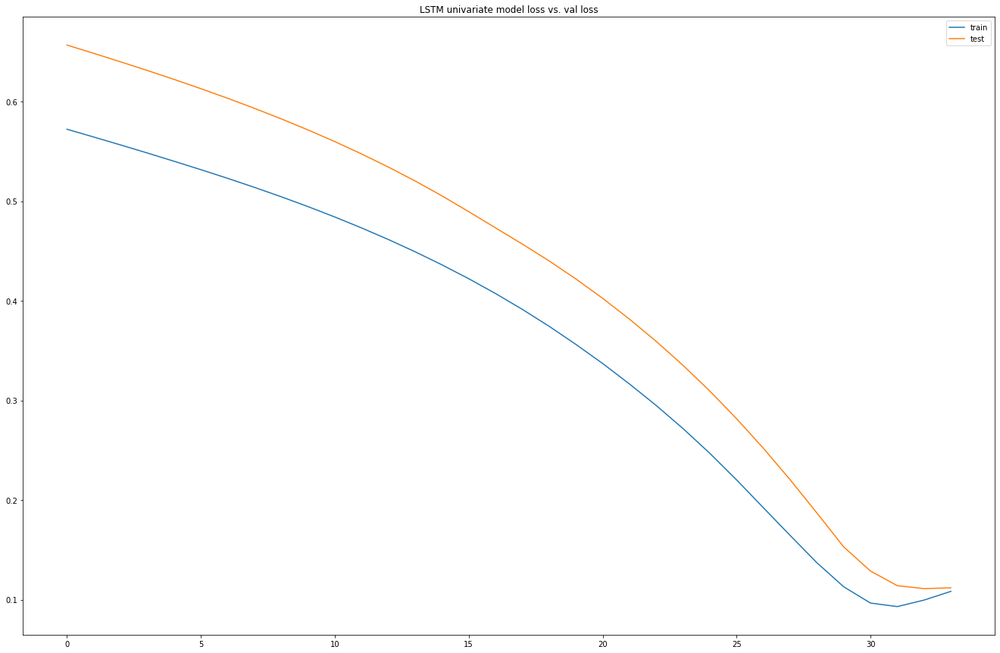

Test RMSE: 992.804


In [112]:
series_to_supervised(asda_rt_250g_volume)
lstm_univariate(asda_rt_250g_volume)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2017-05-27,5600.8,2.249893,100.0,0.0,2017.0,2.0,4.0,17.0,5226.0,2.250000,100.0,0.0,2017,2,5,21
2017-06-03,5453.6,2.250000,100.0,0.0,2017.0,2.0,5.0,18.0,5068.8,2.249901,100.0,0.0,2017,2,6,22
2017-06-10,5555.0,2.250009,100.0,0.0,2017.0,2.0,5.0,19.0,5490.8,2.249945,100.0,0.0,2017,2,6,23
2017-06-17,5656.8,2.250000,100.0,0.0,2017.0,2.0,5.0,20.0,5040.2,2.249950,100.0,0.0,2017,2,6,24
2017-06-24,5226.0,2.250000,100.0,0.0,2017.0,2.0,5.0,21.0,4850.6,2.249990,100.0,0.0,2017,2,6,25
2017-07-01,5068.8,2.249901,100.0,0.0,2017.0,2.0,6.0,22.0,5395.0,2.249972,100.0,0.0,2017,3,7,26
2017-07-08,5490.8,2.249945,100.0,0.0,2017.0,2.0,6.0,23.0,5045.6,2.250119,100.0,0.0,2017,3,7,27
2017-07-15,5040.2,2.249950,100.0,0.0,2017.0,2.0,6.0,24.0,5263.0,2.250010,100.0,0.0,2017,3,7,28
2017-07-22,4850.6,2.249990,100.0,0.0,2017.0,2.0,6.0,25.0,5174.6,2.249855,100.0,0.0,2017,3,7,29


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.459146   0.992466        1.0        0.0        0.0   0.333333   
5   0.434367   0.993778        1.0        0.0        0.0   0.333333   
6   0.451436   0.993889        1.0        0.0        0.0   0.333333   
7   0.468572   0.993778        1.0        0.0        0.0   0.333333   
8   0.396054   0.993778        1.0        0.0        0.0   0.333333   

   var7(t-4)  var8(t-4)   var1(t)  
4   0.272727   0.313726  0.396054  
5   0.363636   0.333333  0.369592  
6   0.363636   0.352941  0.440629  
7   0.363636   0.372549  0.364778  
8   0.363636   0.392157  0.332862  
(117, 1, 8) (117,) (30, 1, 8) (30,)
Train on 117 samples, validate on 30 samples
Epoch 1/50
117/117 - 5s - loss: 0.5858 - val_loss: 0.6608
Epoch 2/50
117/117 - 0s - loss: 0.5664 - val_loss: 0.6416
Epoch 3/50
117/117 - 0s - loss: 0.5473 - val_loss: 0.6222
Epoch 4/50
117/117 - 0s - loss: 0.5283 - val_loss: 0.6023
Epoch 5/50
117/117 - 0s - loss: 0.5088 - val

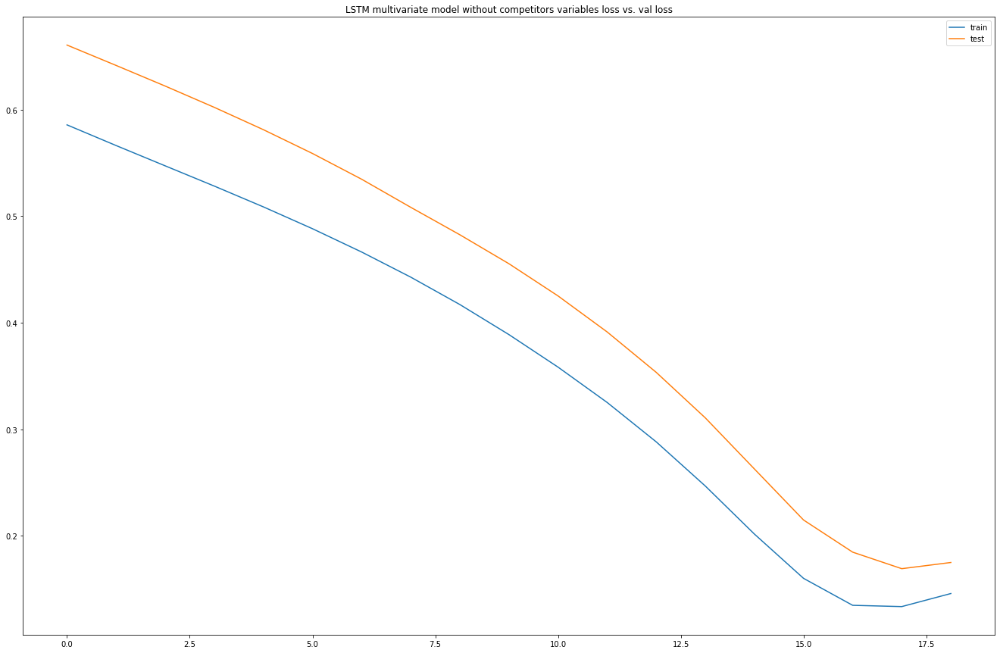

Test RMSE: 1472.914


In [125]:
series_to_supervised(asda_rt_250g_own_variable)
multivariate_lstm_without_competitor(asda_rt_250g_own_variable)


,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-06-24,5226.0,2017.0,2.0,5.0,21.0,5600.8,2.249893,100.0,0.0,2.499055,...,100.0,0.0,2.499631,100.0,2.486928,94.0,3.333035,100.0,3.149897,94.0
2017-07-01,5068.8,2017.0,2.0,6.0,22.0,5453.6,2.250000,100.0,0.0,2.498982,...,100.0,0.0,2.499715,100.0,2.487224,94.0,3.332952,100.0,3.149678,94.0
2017-07-08,5490.8,2017.0,2.0,6.0,23.0,5555.0,2.250009,100.0,0.0,2.498393,...,100.0,0.0,2.499715,100.0,2.484579,94.0,3.333031,100.0,3.149785,94.0
2017-07-15,5040.2,2017.0,2.0,6.0,24.0,5656.8,2.250000,100.0,0.0,2.499553,...,100.0,0.0,2.499392,100.0,2.486126,94.0,3.332729,100.0,3.149596,94.0
2017-07-22,4850.6,2017.0,2.0,6.0,25.0,5226.0,2.250000,100.0,0.0,2.499631,...,100.0,0.0,2.499133,100.0,2.485910,94.0,3.333135,100.0,3.149648,94.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,6746.8,2020.0,1.0,1.0,3.0,6396.8,2.250000,98.0,0.0,2.498513,...,98.0,0.0,2.499238,100.0,2.361675,92.0,3.331923,100.0,3.148926,92.0
2020-02-22,7013.6,2020.0,1.0,1.0,4.0,4007.0,2.249988,98.0,0.0,2.497888,...,98.0,0.0,2.498231,100.0,2.361604,92.0,3.330570,100.0,3.147405,92.0
2020-02-29,7459.4,2020.0,1.0,2.0,5.0,4077.8,2.249767,97.0,0.0,2.497677,...,98.0,0.0,2.497394,100.0,2.360437,92.0,3.323531,100.0,3.147662,92.0


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.396054        0.0   0.333333   0.363636   0.392157   0.466751   
5   0.369592        0.0   0.333333   0.454545   0.411765   0.441562   
6   0.440629        0.0   0.333333   0.454545   0.431373   0.458914   
7   0.364778        0.0   0.333333   0.454545   0.450980   0.476334   
8   0.332862        0.0   0.333333   0.454545   0.470588   0.402615   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.992466        1.0        0.0    0.097549         1.0    0.990219   
5   0.993778        1.0        0.0    0.097336         1.0    0.990143   
6   0.993889        1.0        0.0    0.095625         1.0    0.990515   
7   0.993778        1.0        0.0    0.098996         1.0    0.996117   
8   0.993778        1.0        0.0    0.099222         1.0    0.996668   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4        0.75    0.231231         1.0    0.093998     

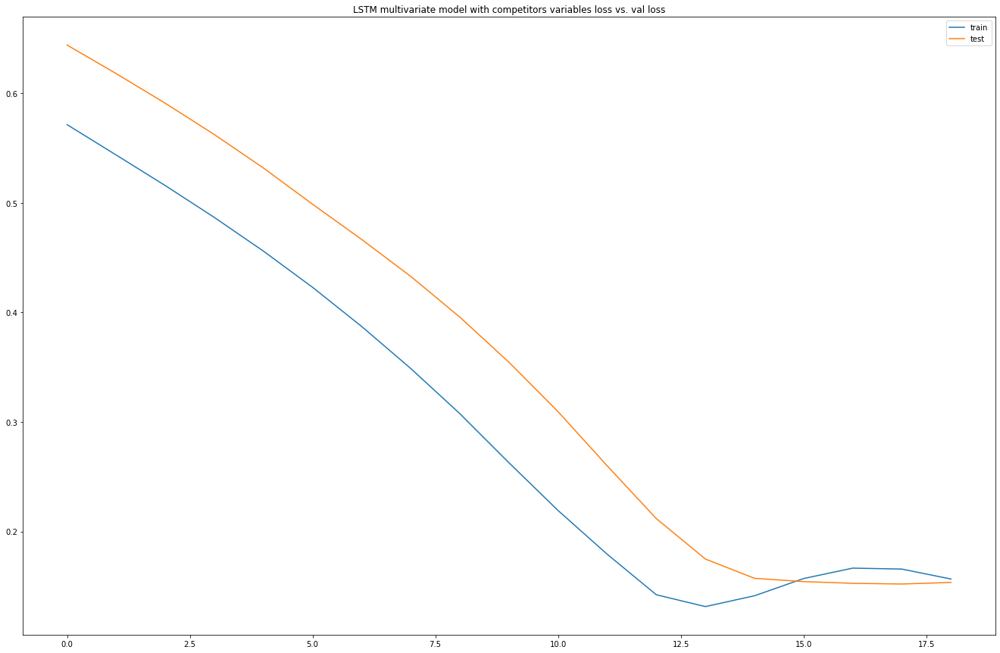

Test RMSE: 1273.937


In [670]:
series_to_supervised(asda_rt_250g_with_comp)
multivariate_with_competitor_asda(asda_rt_250g_with_comp)

## Asda -  Asda Digestives 300g (Competitor)

,Date,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
146,2017-09-30,8601.0,2580.3,2580.3,81.0,0.0,0.300000,1.000000,2017,3,9,39
147,2017-10-07,52466.0,15739.8,15739.7,99.0,0.0,0.299998,0.999994,2017,4,10,40
148,2017-10-14,56344.0,16903.2,16903.0,100.0,0.0,0.299996,0.999988,2017,4,10,41
149,2017-10-21,53178.0,15953.4,15952.0,99.0,0.0,0.299974,0.999912,2017,4,10,42
150,2017-10-28,58812.0,17643.6,17643.6,100.0,0.0,0.300000,1.000000,2017,4,10,43


(129, 12)

Date                        datetime64[ns]
Units                              float64
Volume                             float64
Value                              float64
Distribution                       float64
Promotional Distribution           float64
£/unit                             float64
£/kg                               float64
year                                 int64
quarter                              int64
month                                int64
week                                 int64
dtype: object

,Units,Volume,Value,Distribution,Promotional Distribution,£/unit,£/kg,year,quarter,month,week
count,129.000000,129.000000,129.00000,129.000000,129.000000,129.000000,129.000000,129.000000,129.000000,129.000000,129.000000
mean,73109.255814,21932.776744,21927.36124,99.434109,0.139535,0.299942,0.999807,2018.465116,2.527132,6.627907,26.813953
std,18861.398408,5658.419522,5652.69004,1.987637,0.767954,0.000186,0.000620,0.800844,1.199463,3.708246,16.160217
min,8601.000000,2580.300000,2580.30000,81.000000,0.000000,0.299269,0.997562,2017.000000,1.000000,1.000000,1.000000
25%,61296.000000,18388.800000,18388.80000,99.000000,0.000000,0.299994,0.999981,2018.000000,1.000000,3.000000,11.000000
50%,69034.000000,20710.200000,20710.50000,100.000000,0.000000,0.300000,1.000000,2018.000000,3.000000,7.000000,27.000000
75%,90888.000000,27266.400000,27266.70000,100.000000,0.000000,0.300009,1.000029,2019.000000,4.000000,10.000000,42.000000
95%,99401.600000,29820.480000,29819.92000,100.000000,1.000000,0.300036,1.000119,2020.000000,4.000000,12.000000,50.000000
99%,111252.560000,33375.768000,33379.21200,100.000000,4.600000,0.300044,1.000148,2020.000000,4.000000,12.000000,52.000000
max,116212.000000,34863.600000,34867.80000,100.000000,6.000000,0.300170,1.000568,2020.000000,4.000000,12.000000,52.000000


Dataset has: 129rows
Missing values:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out distribution>100:
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional Distribution    0
£/unit                      0
£/kg                        0
year                        0
quarter                     0
month                       0
week                        0
dtype: int64
Screen out negative data: 
Date                        0
Units                       0
Volume                      0
Value                       0
Distribution                0
Promotional

<Figure size 432x288 with 0 Axes>

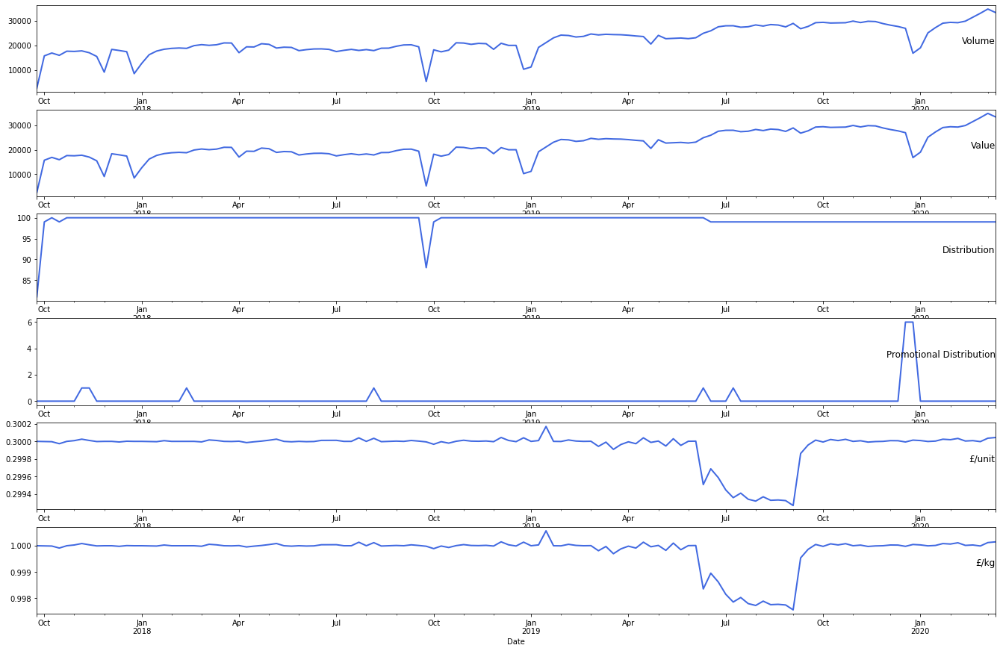

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f530b6f4cf8>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f5305a05588>)

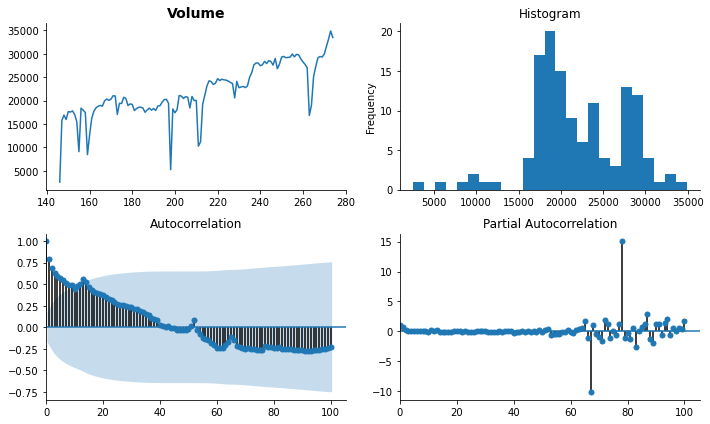

In [671]:
basic_info(asda_rt_300g_origin)
plot_data(asda_rt_300g_origin)
tsplot(asda_rt_300g_origin['Volume'].dropna(), title=asda_rt_300g_origin.columns[2], lags=100)


Test Statistic                  -2.377712
p-value                          0.148126
#Lags Used                       1.000000
Number of Observations Used    127.000000
Critical Value (1%)             -3.482920
Critical Value (5%)             -2.884580
Critical Value (10%)            -2.579058
dtype: float64


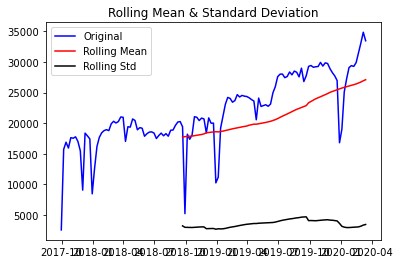

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/statsmodels/regression/linear_model.py:1406: RuntimeWarning:

invalid value encountered in sqrt



(<matplotlib.axes._subplots.AxesSubplot at 0x7f53059ef518>,
 <matplotlib.axes._subplots.AxesSubplot at 0x7f53057e0f98>)

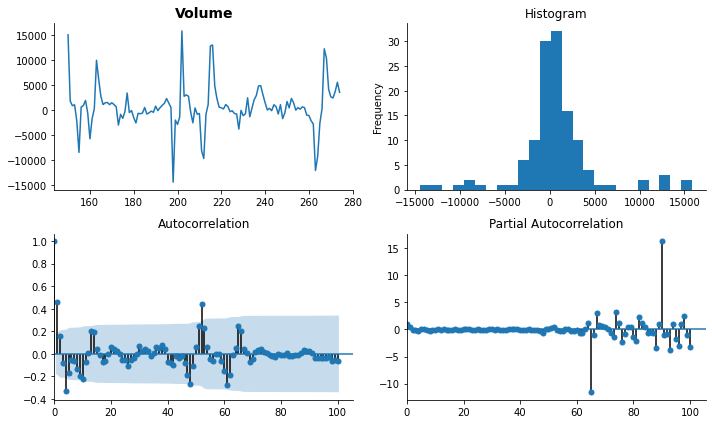

In [672]:
plot(asda_rt_300g_origin)
#plot stationary graph
series_transformed=asda_rt_300g_origin.copy()
series_transformed['Volume_transformed']=asda_rt_300g_origin.Volume.diff(4)
tsplot(series_transformed['Volume_transformed'].dropna(), title=asda_rt_300g_origin.columns[2], lags=100)


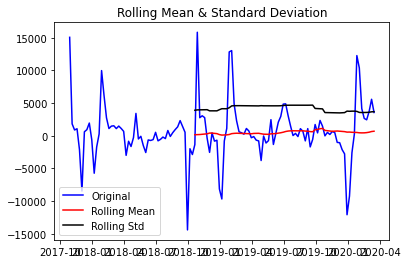

Results of Dickey-Fuller Test:
Test Statistic                  -3.270577
p-value                          0.016246
#Lags Used                      12.000000
Number of Observations Used    112.000000
Critical Value (1%)             -3.490131
Critical Value (5%)             -2.887712
Critical Value (10%)            -2.580730
dtype: float64


In [673]:
plot_transform(asda_rt_300g_origin)

      t-4      t+1
0     NaN   2580.3
1     NaN  15739.8
2     NaN  16903.2
3     NaN  15953.4
4  2580.3  17643.6
Test MSE: 23509957.763
Test RMSE: 4848.707


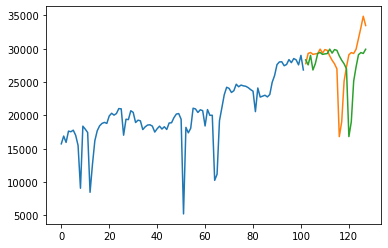

Observations: 125
Training Observations: 100
Testing Observations: 25


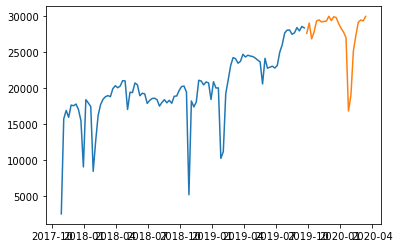

RMSE for Simple Exponential Smoothing α= 0.1 is: 3519.46
RMSE for Simple Exponential Smoothing α= 0.2 is: 3146.85
RMSE for Simple Exponential Smoothing α= 0.30000000000000004 is: 3149.73
RMSE for Simple Exponential Smoothing α= 0.4 is: 3169.2
RMSE for Simple Exponential Smoothing α= 0.5 is: 3180.46
RMSE for Simple Exponential Smoothing α= 0.6000000000000001 is: 3186.7
RMSE for Simple Exponential Smoothing α= 0.7000000000000001 is: 3190.07
RMSE for Simple Exponential Smoothing α= 0.8 is: 3191.3
RMSE for Simple Exponential Smoothing α= 0.9 is: 3190.67


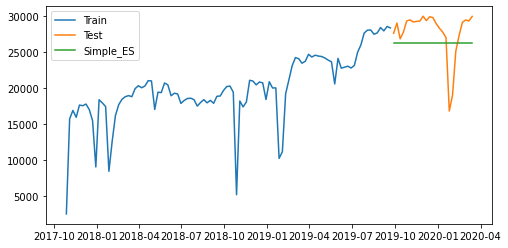

Observations: 125
Training Observations: 100
Testing Observations: 25
Min RMSE for Holt Linear Forecasting α= 0.4 and β= 0.5 is: 3083.64


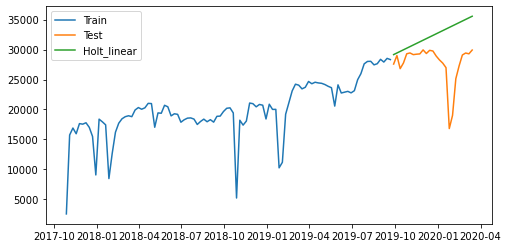

/opt/anaconda/envs/Python3/lib/python3.6/site-packages/pandas/core/frame.py:4133: SettingWithCopyWarning:


A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy

INFO:fbprophet:Disabling yearly seasonality. Run prophet with yearly_seasonality=True to override this.
INFO:fbprophet:Disabling weekly seasonality. Run prophet with weekly_seasonality=True to override this.
INFO:fbprophet:Disabling daily seasonality. Run prophet with daily_seasonality=True to override this.


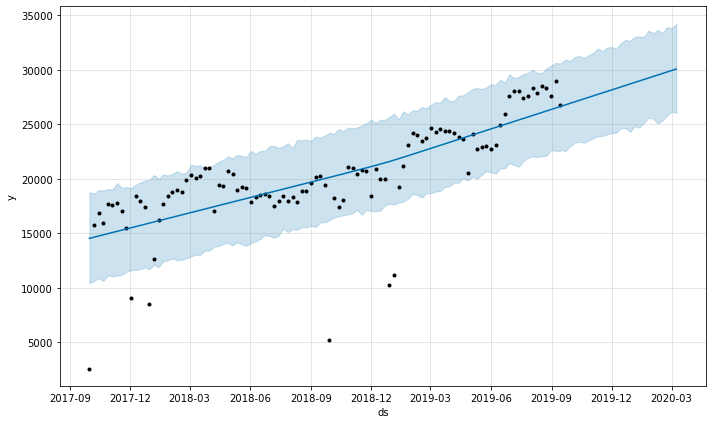

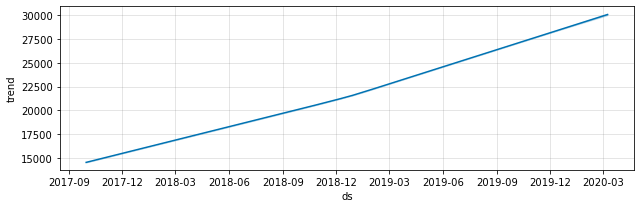

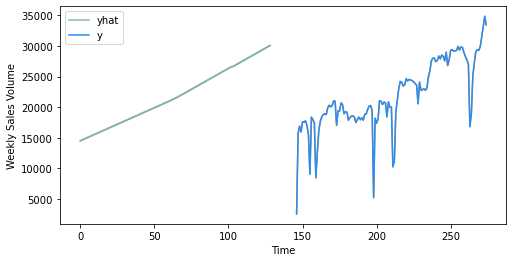

RMSE for prophet model is: 3254.891359617592


In [674]:
#time series models
baseline_model(asda_rt_300g_origin)
ses_model(asda_rt_300g_origin)
holt_linear_model(asda_rt_300g_origin)
# holt_winter_model(asda_rt_300g_origin)
prophet_model(asda_rt_300g_origin)
# prophet_all_holidays(asda_rt_300g_origin)
# prophet_two_holiday(asda_rt_300g_origin)

Observations: 41
Training Observations: 22
Testing Observations: 19
[   0.11388319   -1.97723128 -107.14786621  -47.32962921  -20.84934424]
Mean Absolute Error: 1087.2955263157885
Mean Squared Error: 2065949.7214381553
Root Mean Squared Error: 1437.341198685321
Observations: 60
Training Observations: 41
Testing Observations: 19
[ -12.44173839 -121.93036591   -1.52796846   -7.02285705   -4.64660117]
Mean Absolute Error: 3067.2521052631582
Mean Squared Error: 17735740.549768426
Root Mean Squared Error: 4211.38226117844
Observations: 79
Training Observations: 60
Testing Observations: 19
[-3.51175319 -1.57079858 -6.51245965 -0.08042092 -8.70981858]
Mean Absolute Error: 5403.717631578947
Mean Squared Error: 34528381.18191709
Root Mean Squared Error: 5876.085532215907
Observations: 98
Training Observations: 79
Testing Observations: 19
[-17.19129277  -1.61563922  -0.15344556  -1.07666127 -34.70457642]
Mean Absolute Error: 4002.3363157894714
Mean Squared Error: 20317557.526507866
Root Mean Squ

<Figure size 432x288 with 0 Axes>

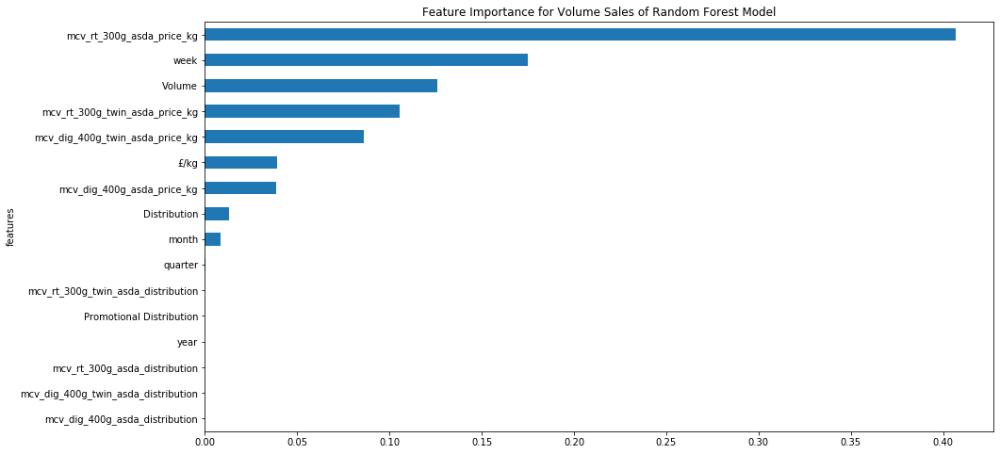

<Figure size 432x288 with 0 Axes>

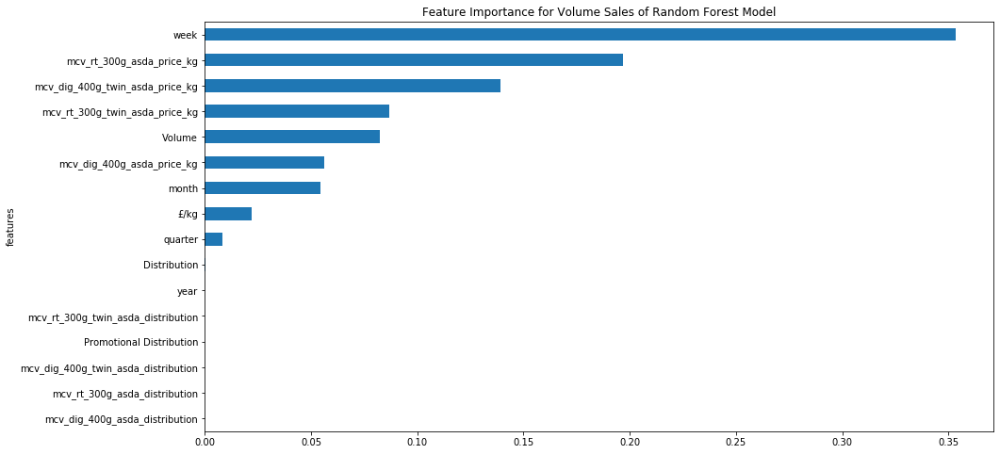

<Figure size 432x288 with 0 Axes>

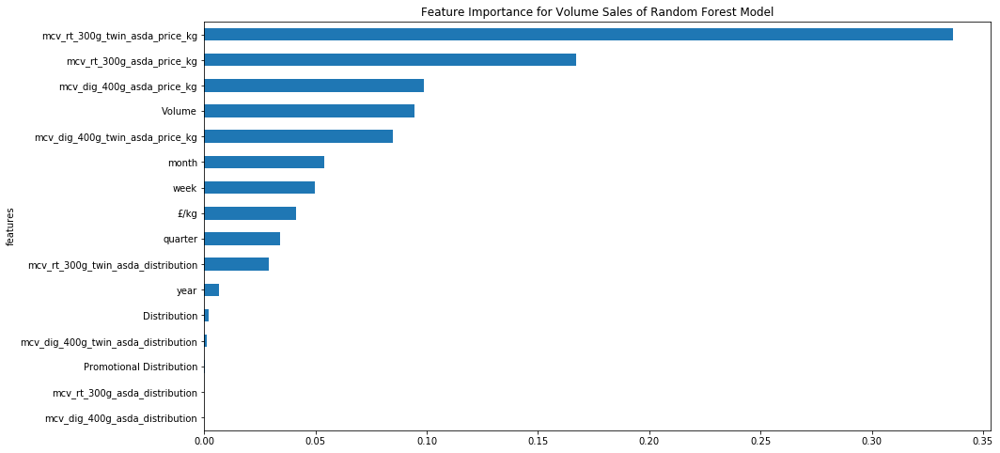

<Figure size 432x288 with 0 Axes>

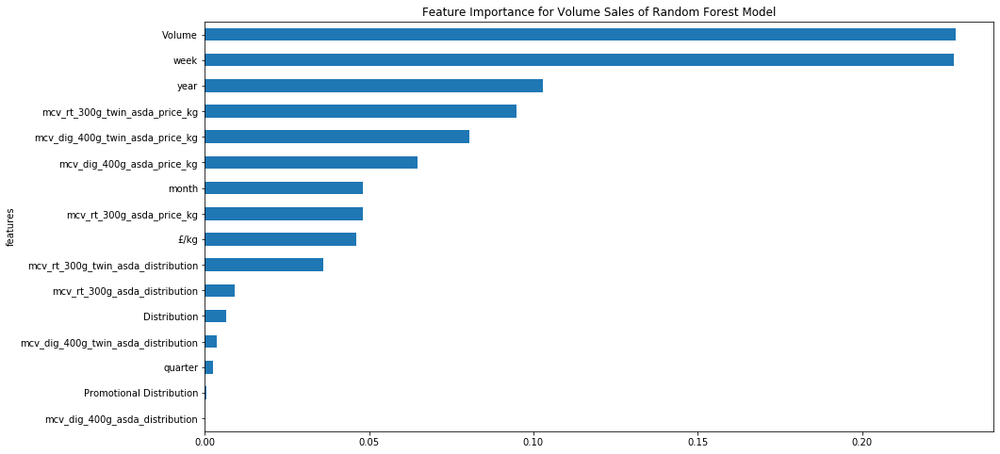

<Figure size 432x288 with 0 Axes>

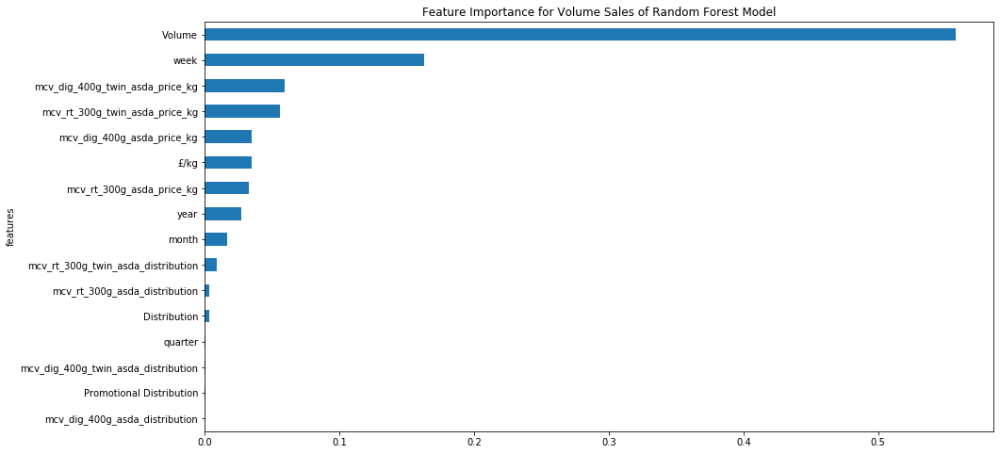

In [141]:
asda_rt_300g_with_comp=variable_lag_asda(asda_rt_300g_with_comp)
asda_rt_300g_input_X,asda_rt_300g_input_Y=input_var_asda(asda_rt_300g_with_comp)
rf_regressor_asda(asda_rt_300g_input_X,asda_rt_300g_input_Y)


Observations: 45
Training Observations: 24
Testing Observations: 21
[-907.74601515   -2.09786101   -1.83343854 -294.57952962 -250.39518775]
Mean Absolute Error: 7921.372377232141
Mean Squared Error: 64016497.889796816
Root Mean Squared Error: 8001.0310516705795
Observations: 66
Training Observations: 45
Testing Observations: 21
[  -4.07742987 -171.36404761  -45.33836825  -91.84706771 -358.90114882]
Mean Absolute Error: 7293.994526599701
Mean Squared Error: 57771757.1819538
Root Mean Squared Error: 7600.7734594548865
Observations: 87
Training Observations: 66
Testing Observations: 21
[  -6.79563638  -67.36410116 -172.37925471   -1.95437251   -6.69361314]
Mean Absolute Error: 10859.74232700893
Mean Squared Error: 122725342.0415789
Root Mean Squared Error: 11078.147049104327
Observations: 108
Training Observations: 87
Testing Observations: 21
[ -74.56427914  -96.84467669   -2.82056341   -3.79331711 -116.71639309]
Mean Absolute Error: 13811.123604910714
Mean Squared Error: 194140678.584702

<Figure size 432x288 with 0 Axes>

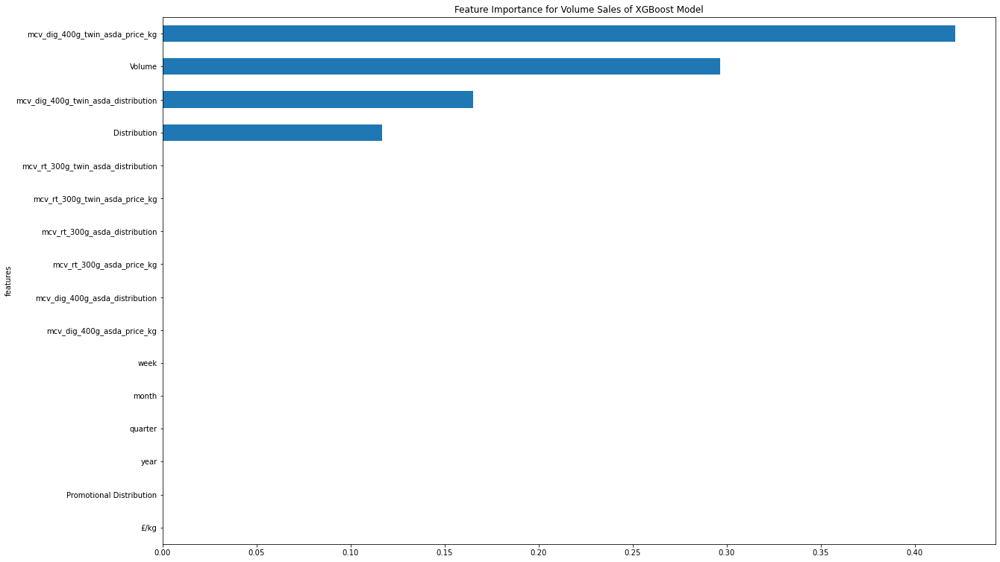

<Figure size 432x288 with 0 Axes>

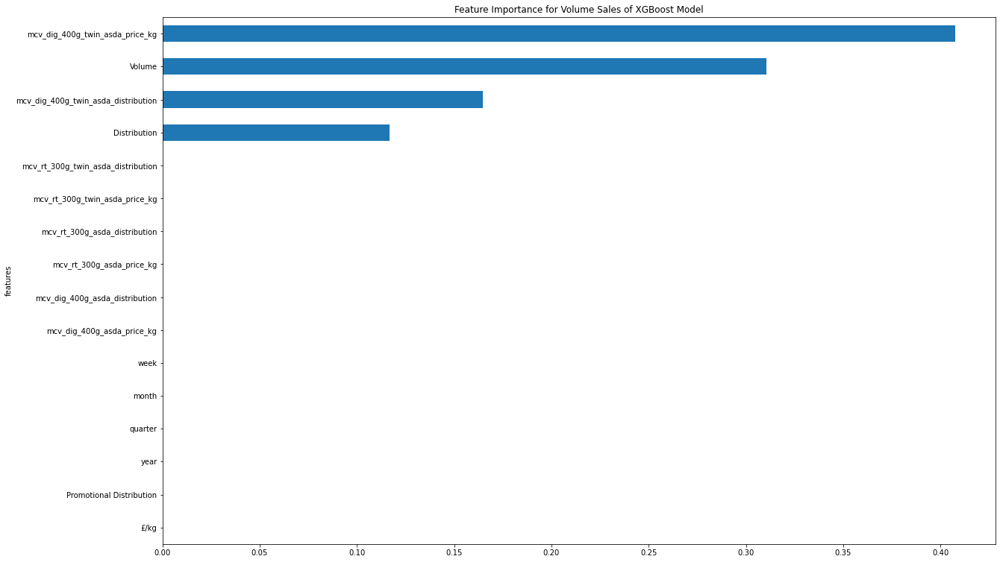

<Figure size 432x288 with 0 Axes>

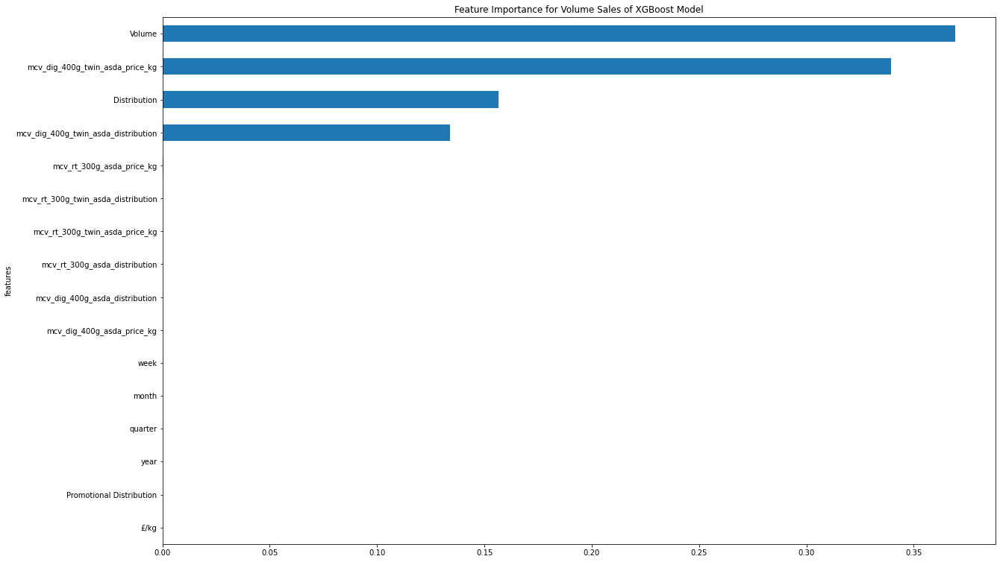

<Figure size 432x288 with 0 Axes>

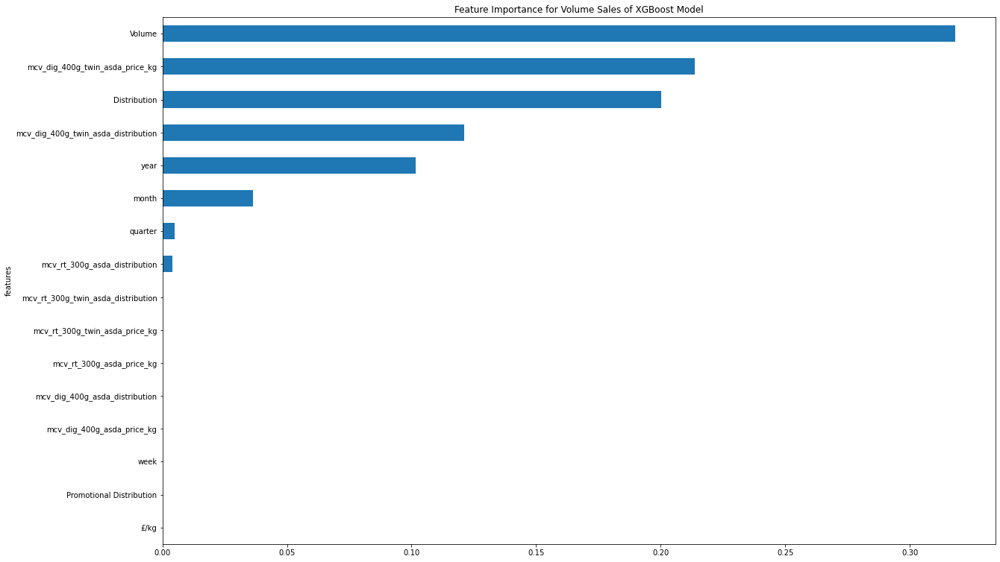

<Figure size 432x288 with 0 Axes>

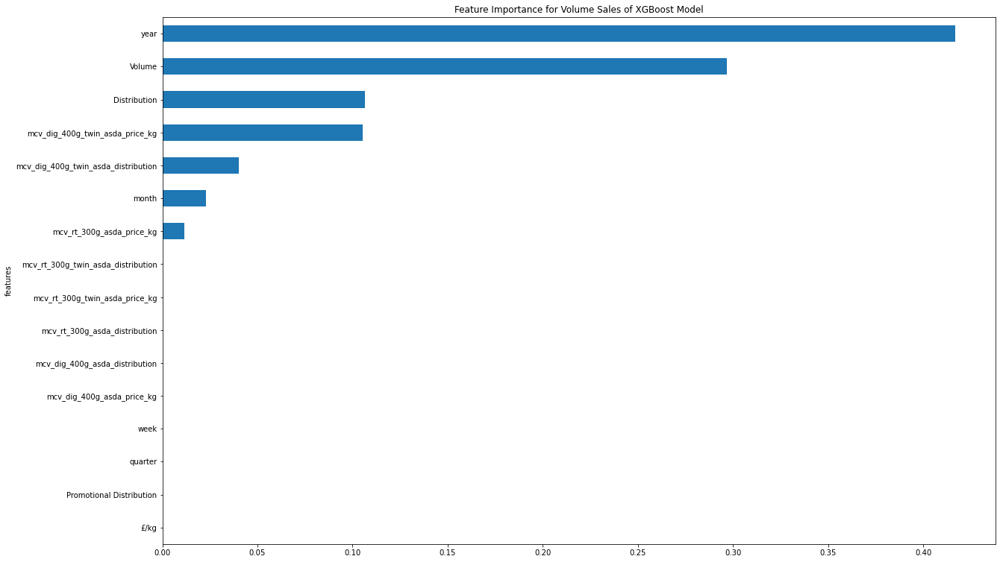

In [676]:
asda_rt_300g_input_X,asda_rt_300g_input_Y=input_var_asda(asda_rt_300g_with_comp)
xgb_regressor_asda(asda_rt_300g_input_X,asda_rt_300g_input_Y)


,var1(t-4),var1(t)
Date,,
2017-10-28,2580.3,17643.6
2017-11-04,15739.8,17552.1
2017-11-11,16903.2,17783.4
2017-11-18,15953.4,17018.1
2017-11-25,17643.6,15498.9
2017-12-02,17552.1,9081.0
2017-12-09,17783.4,18384.6
2017-12-16,17018.1,17939.7
2017-12-23,15498.9,17436.3


   var1(t-4)   var1(t)
4   0.000000  0.466597
5   0.407626  0.463763
6   0.443663  0.470928
7   0.414242  0.447222
8   0.466597  0.400164
(100, 1, 1) (100,) (25, 1, 1) (25,)
Train on 100 samples, validate on 25 samples
Epoch 1/50
100/100 - 5s - loss: 0.5586 - val_loss: 0.7989
Epoch 2/50
100/100 - 0s - loss: 0.5497 - val_loss: 0.7889
Epoch 3/50
100/100 - 0s - loss: 0.5408 - val_loss: 0.7788
Epoch 4/50
100/100 - 0s - loss: 0.5318 - val_loss: 0.7686
Epoch 5/50
100/100 - 0s - loss: 0.5228 - val_loss: 0.7582
Epoch 6/50
100/100 - 0s - loss: 0.5135 - val_loss: 0.7475
Epoch 7/50
100/100 - 0s - loss: 0.5039 - val_loss: 0.7364
Epoch 8/50
100/100 - 0s - loss: 0.4941 - val_loss: 0.7249
Epoch 9/50
100/100 - 0s - loss: 0.4839 - val_loss: 0.7130
Epoch 10/50
100/100 - 0s - loss: 0.4733 - val_loss: 0.7005
Epoch 11/50
100/100 - 0s - loss: 0.4624 - val_loss: 0.6874
Epoch 12/50
100/100 - 0s - loss: 0.4510 - val_loss: 0.6736
Epoch 13/50
100/100 - 0s - loss: 0.4390 - val_loss: 0.6590
Epoch 14/50
100/100 - 0

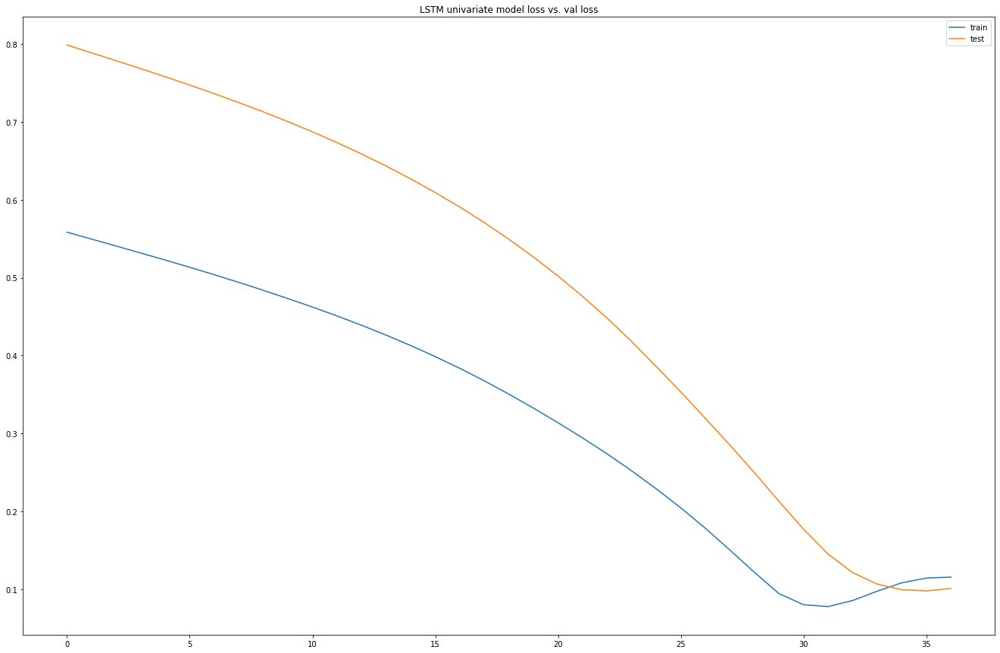

Test RMSE: 4248.600


In [126]:
#lstm models
series_to_supervised(asda_rt_300g_volume)
lstm_univariate(asda_rt_300g_volume)



,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var1(t),var2(t),var3(t),var4(t),var5(t),var6(t),var7(t),var8(t)
Date,,,,,,,,,,,,,,,,
2017-10-28,2580.3,1.000000,81.0,0.0,2017.0,3.0,9.0,39.0,17643.6,1.000000,100.0,0.0,2017,4,10,43
2017-11-04,15739.8,0.999994,99.0,0.0,2017.0,4.0,10.0,40.0,17552.1,1.000028,100.0,0.0,2017,4,11,44
2017-11-11,16903.2,0.999988,100.0,0.0,2017.0,4.0,10.0,41.0,17783.4,1.000084,100.0,1.0,2017,4,11,45
2017-11-18,15953.4,0.999912,99.0,0.0,2017.0,4.0,10.0,42.0,17018.1,1.000035,100.0,1.0,2017,4,11,46
2017-11-25,17643.6,1.000000,100.0,0.0,2017.0,4.0,10.0,43.0,15498.9,0.999994,100.0,0.0,2017,4,11,47
2017-12-02,17552.1,1.000028,100.0,0.0,2017.0,4.0,11.0,44.0,9081.0,1.000000,100.0,0.0,2017,4,12,48
2017-12-09,17783.4,1.000084,100.0,1.0,2017.0,4.0,11.0,45.0,18384.6,1.000000,100.0,0.0,2017,4,12,49
2017-12-16,17018.1,1.000035,100.0,1.0,2017.0,4.0,11.0,46.0,17939.7,0.999978,100.0,0.0,2017,4,12,50
2017-12-23,15498.9,0.999994,100.0,0.0,2017.0,4.0,11.0,47.0,17436.3,1.000006,100.0,0.0,2017,4,12,51


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.000000   0.811188   0.000000        0.0        0.0   0.666667   
5   0.407626   0.809052   0.947369        0.0        0.0   1.000000   
6   0.443663   0.807251   1.000000        0.0        0.0   1.000000   
7   0.414242   0.782013   0.947369        0.0        0.0   1.000000   
8   0.466597   0.811188   1.000000        0.0        0.0   1.000000   

   var7(t-4)  var8(t-4)   var1(t)  
4   0.727273   0.745098  0.466597  
5   0.818182   0.764706  0.463763  
6   0.818182   0.784314  0.470928  
7   0.818182   0.803922  0.447222  
8   0.818182   0.823529  0.400164  
(100, 1, 8) (100,) (25, 1, 8) (25,)
Train on 100 samples, validate on 25 samples
Epoch 1/50
100/100 - 5s - loss: 0.5551 - val_loss: 0.7780
Epoch 2/50
100/100 - 0s - loss: 0.5333 - val_loss: 0.7527
Epoch 3/50
100/100 - 0s - loss: 0.5112 - val_loss: 0.7264
Epoch 4/50
100/100 - 0s - loss: 0.4883 - val_loss: 0.6990
Epoch 5/50
100/100 - 0s - loss: 0.4646 - val

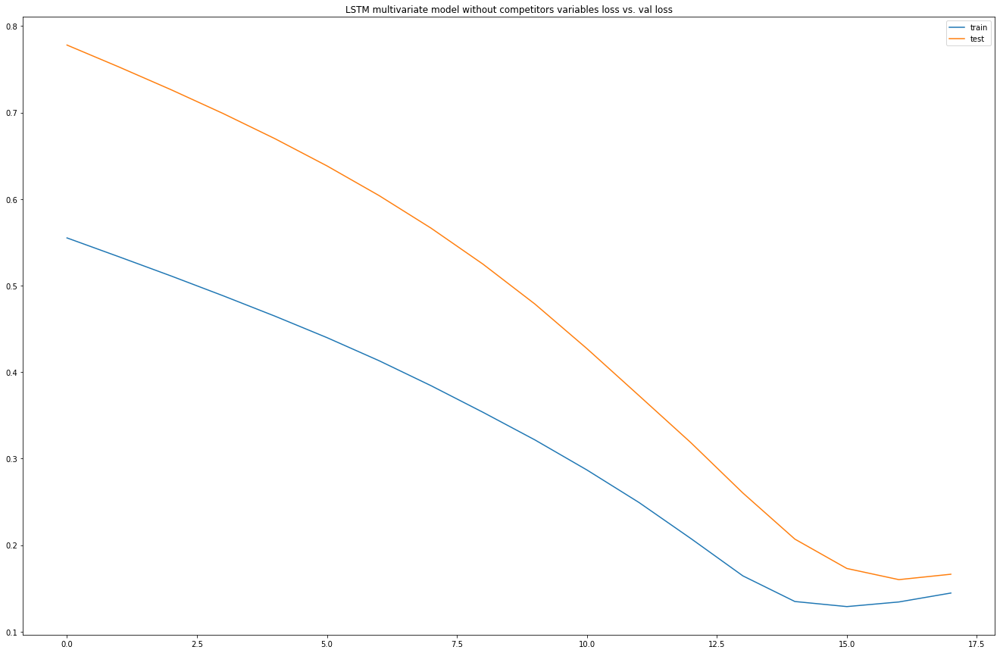

Test RMSE: 6659.629


In [128]:

series_to_supervised(asda_rt_300g_own_variable)
multivariate_lstm_without_competitor(asda_rt_300g_own_variable)

,var1(t-4),var2(t-4),var3(t-4),var4(t-4),var5(t-4),var6(t-4),var7(t-4),var8(t-4),var9(t-4),var10(t-4),...,var8(t),var9(t),var10(t),var11(t),var12(t),var13(t),var14(t),var15(t),var16(t),var17(t)
Date,,,,,,,,,,,,,,,,,,,,,
2017-10-28,2580.3,1.000000,81.0,0.0,2017.0,3.0,9.0,39.0,2.498431,100.0,...,43,2.499447,100,2.360666,92,3.327491,100,3.148870,92,17643.6
2017-11-04,15739.8,0.999994,99.0,0.0,2017.0,4.0,10.0,40.0,2.498840,100.0,...,44,2.497653,100,2.361830,92,3.325498,100,3.148663,92,17552.1
2017-11-11,16903.2,0.999988,100.0,0.0,2017.0,4.0,10.0,41.0,2.499514,100.0,...,45,2.494590,100,2.361552,92,3.330941,100,3.146033,93,17783.4
2017-11-18,15953.4,0.999912,99.0,0.0,2017.0,4.0,10.0,42.0,2.499453,100.0,...,46,2.489476,100,2.361632,92,3.328709,100,3.147811,92,17018.1
2017-11-25,17643.6,1.000000,100.0,0.0,2017.0,4.0,10.0,43.0,2.499447,100.0,...,47,2.498089,100,2.361423,92,3.325369,100,3.147062,92,15498.9
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2020-02-15,27266.4,1.000011,99.0,0.0,2020.0,1.0,1.0,3.0,2.499238,100.0,...,7,2.809698,100,2.442775,92,3.741083,100,3.265388,92,29914.8
2020-02-22,29085.6,1.000083,99.0,0.0,2020.0,1.0,1.0,4.0,2.498231,100.0,...,8,2.968225,100,2.486610,92,3.955396,100,3.316077,92,31523.1
2020-02-29,29416.5,1.000065,99.0,0.0,2020.0,1.0,2.0,5.0,2.497394,100.0,...,9,2.969636,100,2.485774,92,3.958416,100,3.315625,92,33127.8


   var1(t-4)  var2(t-4)  var3(t-4)  var4(t-4)  var5(t-4)  var6(t-4)  \
4   0.000000   0.811188   0.000000        0.0        0.0   0.666667   
5   0.407626   0.809052   0.947369        0.0        0.0   1.000000   
6   0.443663   0.807251   1.000000        0.0        0.0   1.000000   
7   0.414242   0.782013   0.947369        0.0        0.0   1.000000   
8   0.466597   0.811188   1.000000        0.0        0.0   1.000000   

   var7(t-4)  var8(t-4)  var9(t-4)  var10(t-4)  var11(t-4)  var12(t-4)  \
4   0.727273   0.745098   0.065364         1.0    0.438732         1.0   
5   0.818182   0.764706   0.066177         1.0    0.039818         0.5   
6   0.818182   0.784314   0.067513         1.0    0.019981         0.5   
7   0.818182   0.803922   0.067392         1.0    0.040045         0.5   
8   0.818182   0.823529   0.067380         1.0    0.059986         0.5   

   var13(t-4)  var14(t-4)  var15(t-4)  var16(t-4)  var17(t-4)   var1(t)  
4    0.143394         1.0    0.000000    0.666668    0

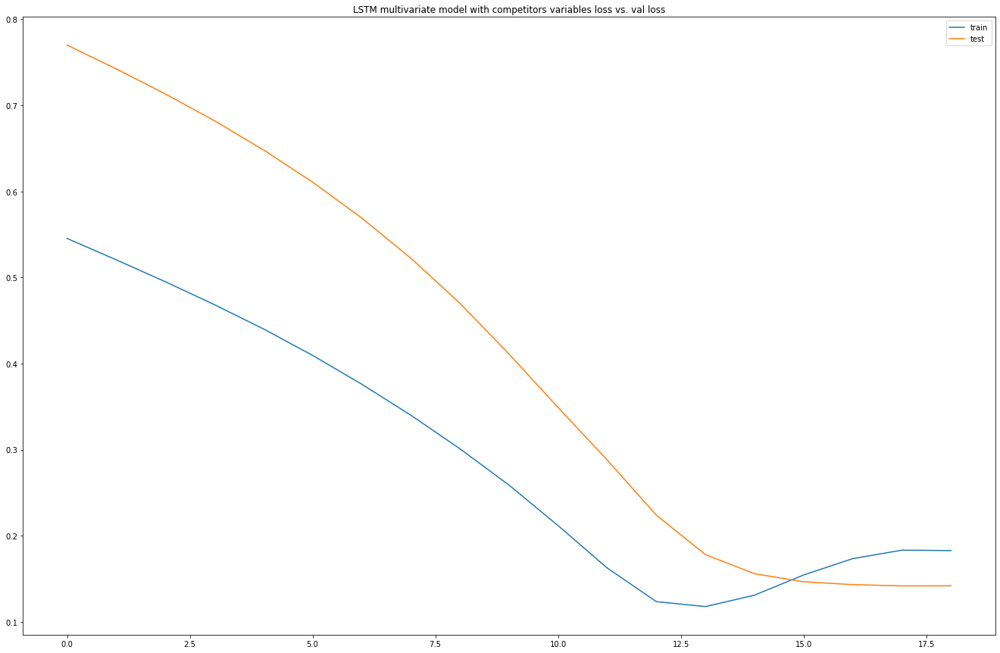

Test RMSE: 5634.686


In [678]:
series_to_supervised(asda_rt_300g_with_comp)
multivariate_with_competitor_asda(asda_rt_300g_with_comp)